# Objective - To conduct detailed data analysis on the data and record detailed conclusion(Perform detailed EDA)

# Approach - Since the dataset do not have label/dependent data column, hence an unsupervised learning model will be more suited

## Loading data from the excel file

In [1]:
# importing required libraries
import warnings
warnings.filterwarnings('ignore')
from scipy import stats

In [2]:
df_1 = pd.read_excel('customer_retention_dataset.xlsx',sheet_name='datasheet') # Loading dataset and creating dataframe

<IPython.core.display.Javascript object>

## Performing EDA

In [3]:
df_1.head() # checking dataset

,1Gender of respondent,2 How old are you?,3 Which city do you shop online from?,4 What is the Pin Code of where you shop online from?,5 Since How Long You are Shopping Online ?,6 How many times you have made an online purchase in the past 1 year?,7 How do you access the internet while shopping on-line?,8 Which device do you use to access the online shopping?,9 What is the screen size of your mobile device?\t\t\t\t\t\t,10 What is the operating system (OS) of your device?\t\t\t\t,...,"Longer time to get logged in (promotion, sales period)","Longer time in displaying graphics and photos (promotion, sales period)","Late declaration of price (promotion, sales period)","Longer page loading time (promotion, sales period)","Limited mode of payment on most products (promotion, sales period)",Longer delivery period,Change in website/Application design,Frequent disruption when moving from one page to another,Website is as efficient as before,Which of the Indian online retailer would you recommend to a friend?
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,...,Amazon.in,Amazon.in,Flipkart.com,Flipkart.com,Amazon.in,Paytm.com,Flipkart.com,Amazon.in,Amazon.in,Flipkart.com
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Amazon.in, Flipkart.com",Myntra.com,snapdeal.com,Snapdeal.com,Snapdeal.com,Snapdeal.com,Amazon.in,Myntra.com,"Amazon.in, Flipkart.com","Amazon.in, Myntra.com"
2,Female,21-30 years,Greater Noida,201308,3-4 years,41 times and above,Mobile Internet,Smartphone,5.5 inches,Android,...,Myntra.com,Myntra.com,Myntra.com,Myntra.com,Amazon.in,Paytm.com,Paytm.com,Paytm.com,Amazon.in,"Amazon.in, Paytm.com, Myntra.com"
3,Male,21-30 years,Karnal,132001,3-4 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,IOS/Mac,...,Snapdeal.com,"Myntra.com, Snapdeal.com",Myntra.com,Paytm.com,Paytm.com,Paytm.com,"Amazon.in, Flipkart.com","Amazon.in, Flipkart.com","Amazon.in, Flipkart.com, Paytm.com","Amazon.in, Flipkart.com"
4,Female,21-30 years,Bangalore,530068,2-3 years,11-20 times,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,"Flipkart.com, Paytm.com",Paytm.com,Paytm.com,Paytm.com,Snapdeal.com,Paytm.com,Amazon.in,Snapdeal.com,Paytm.com,"Amazon.in, Myntra.com"


In [4]:
df_1.columns # Dataframe columns

Index(['1Gender of respondent', '2 How old are you? ',
       '3 Which city do you shop online from?',
       '4 What is the Pin Code of where you shop online from?',
       '5 Since How Long You are Shopping Online ?',
       '6 How many times you have made an online purchase in the past 1 year?',
       '7 How do you access the internet while shopping on-line?',
       '8 Which device do you use to access the online shopping?',
       '9 What is the screen size of your mobile device?\t\t\t\t\t\t                                        ',
       '10 What is the operating system (OS) of your device?\t\t\t\t                                          ',
       '11 What browser do you run on your device to access the website?\t\t\t                                                          ',
       '12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                   ',
       '13 After first visit, how 

1. It can be seen that there is no label column in dataset

2. Some feature have significant whitespaces in feature name

In [5]:
df_1.shape # Dataframe shape

(269, 71)

Dataset has only 269 observations and  71 features

In [6]:
df_1.isin([np.nan, np.inf, -np.inf]).sum()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

1Gender of respondent                                                   0
2 How old are you?                                                      0
3 Which city do you shop online from?                                   0
4 What is the Pin Code of where you shop online from?                   0
5 Since How Long You are Shopping Online ?                              0
                                                                       ..
Longer delivery period                                                  0
Change in website/Application design                                    0
Frequent disruption when moving from one page to another                0
Website is as efficient as before                                       0
Which of the Indian online retailer would you recommend to a friend?    0
Length: 71, dtype: int64

Dataset do not have null & infinite values

In [7]:
df_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 269 entries, 0 to 268
Data columns (total 71 columns):
 #   Column                                                                                                                                                                                                          Non-Null Count  Dtype 
---  ------                                                                                                                                                                                                          --------------  ----- 
 0   1Gender of respondent                                                                                                                                                                                           269 non-null    object
 1   2 How old are you?                                                                                                                                                                    

Only 1 feature is in integer format(4 What is the Pin Code of where you shop online from?), rest 70 are in object format

In [8]:
# Function to analyse columns
def cat_ana(df = None, x = None):
    series = df[x]
    print(f"New Feature\n\n{series.name}")
    print(f'Stats summary \n{series.describe()}')
    print('+' *80)
    print(f'Series value count is \n{series.value_counts()}')
    print('+' *80)
    print(f'Unique values \n{series.unique()}')
    print('+' *80)
    
for i in df_1.columns:
    cat_ana(df_1,i)

New Feature

1Gender of respondent
Stats summary 
count        269
unique         2
top       Female
freq         181
Name: 1Gender of respondent, dtype: object
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Series value count is 
Female    181
Male       88
Name: 1Gender of respondent, dtype: int64
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Unique values 
['Male' 'Female']
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
New Feature

2 How old are you? 
Stats summary 
count             269
unique              5
top       31-40 years
freq               81
Name: 2 How old are you? , dtype: object
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Series value count is 
31-40 years           81
21-30 years           79
41-50 yaers           70
Less than 20 years    20
51 years and above    19
Name: 2 How old are you? , dtype: int64
++++++++++++++++++++++++

Unique values 
['Dis-agree (2)' 'Strongly agree (5)' 'Agree (4)' 'Strongly disagree (1)'
 'Indifferent (3)']
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
New Feature

25 Convenient Payment methods
Stats summary 
count                    269
unique                     3
top       Strongly agree (5)
freq                     159
Name: 25 Convenient Payment methods, dtype: object
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Series value count is 
Strongly agree (5)    159
Agree (4)              80
Dis-agree (2)          30
Name: 25 Convenient Payment methods, dtype: int64
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Unique values 
['Dis-agree (2)' 'Strongly agree (5)' 'Agree (4)']
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
New Feature

26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time
Stats summ

Unique values 
['Snapdeal.com' 'Amazon.in, Flipkart.com, Myntra.com'
 'Amazon.in, Paytm.com, Myntra.com' 'Amazon.in, Flipkart.com'
 'Amazon.in, Flipkart.com, Paytm.com, Myntra.com, Snapdeal.com'
 'Amazon.in, Flipkart.com, Paytm.com' 'Flipkart.com, Snapdeal.com'
 'Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com' 'Amazon.in'
 'Amazon.in, Flipkart.com, Snapdeal.com' 'Flipkart.com']
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
New Feature

Fast loading website speed of website and application
Stats summary 
count           269
unique           10
top       Amazon.in
freq             51
Name: Fast loading website speed of website and application, dtype: object
++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Series value count is 
Amazon.in                                                       51
Amazon.in, Paytm.com                                            44
Amazon.in, Flipkart.com                                     

It can be observed that:
1. Females are more active online shoppers.

2. Max shopers are from age group (31-50 yrs), people above 51 & less than 20 don't shop much in sample analysis

3. People shopping above 4 yrs are max.

4. Less than 10 times entries are more.

5. Human error in Internet spelling

6. Most of the time smartphones are used for shopping.

7. often a search engine is used to access e-retailer website.

8. Better alternative offer leads to abandoning bags.

In [9]:
# Checking ChiSquare test
crosstab = pd.crosstab(df_1['1Gender of respondent'],df_1['41 Monetary savings'])
stats.chi2_contingency(crosstab)

<IPython.core.display.Javascript object>

(24.207467461466756,
 2.2608488491857558e-05,
 3,
 array([[50.46468401, 20.85873606, 99.58364312, 10.0929368 ],
        [24.53531599, 10.14126394, 48.41635688,  4.9070632 ]]))

Since all of the expected frequencies are greater than 5, the chi2 test results can be trusted. We can reject the null hypothesis as the p-value is less than 0.05. Thus, the results indicate that there is a relationship between '1Gender of respondent' and '41 Monetary savings'.

In [10]:
# Performing chi-square test of dataset with monetary saving feature.
for i in df_1.columns:
    nl = "\n"
    
    crosstab = pd.crosstab(df_1[f"{i}"], df_1['41 Monetary savings'])
    print(crosstab, nl)
    chi2, p, dof, expected = stats.chi2_contingency(crosstab)
    print(f"Chi2 value= {chi2}{nl}p-value= {p}{nl}Degrees of freedom= {dof}{nl}frequency={expected}{nl}")

<IPython.core.display.Javascript object>

41 Monetary savings    Agree (4)  Disagree (2)  Strongly agree (5)  \
1Gender of respondent                                                
Female                        49            10                 108   
Male                          26            21                  40   

41 Monetary savings    indifferent (3)  
1Gender of respondent                   
Female                              14  
Male                                 1   

Chi2 value= 24.207467461466756
p-value= 2.2608488491857558e-05
Degrees of freedom= 3
frequency=[[50.46468401 20.85873606 99.58364312 10.0929368 ]
 [24.53531599 10.14126394 48.41635688  4.9070632 ]]



<IPython.core.display.Javascript object>

41 Monetary savings  Agree (4)  Disagree (2)  Strongly agree (5)  \
2 How old are you?                                                 
21-30 years                 13             7                  54   
31-40 years                 33            15                  30   
41-50 yaers                 13             9                  48   
51 years and above           4             0                   8   
Less than 20 years          12             0                   8   

41 Monetary savings  indifferent (3)  
2 How old are you?                    
21-30 years                        5  
31-40 years                        3  
41-50 yaers                        0  
51 years and above                 7  
Less than 20 years                 0   

Chi2 value= 76.88767871001633
p-value= 1.6132389120141085e-11
Degrees of freedom= 12
frequency=[[22.0260223   9.10408922 43.46468401  4.40520446]
 [22.58364312  9.33457249 44.56505576  4.51672862]
 [19.51672862  8.0669145  38.51301115  3.90334572]


<IPython.core.display.Javascript object>

41 Monetary savings                    Agree (4)  Disagree (2)  \
3 Which city do you shop online from?                            
Bangalore                                      9             0   
Bulandshahr                                    2             0   
Delhi                                         18             7   
Ghaziabad                                      4             0   
Greater Noida                                  9             0   
Gurgaon                                        0             0   
Karnal                                         7             3   
Merrut                                         1             2   
Moradabad                                      0             5   
Noida                                         13             9   
Solan                                         12             5   

41 Monetary savings                    Strongly agree (5)  indifferent (3)  
3 Which city do you shop online from?                           

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
4 What is the Pin Code of where you shop online...                            
110008                                                      1             3   
110009                                                      0             4   
110011                                                      5             0   
110014                                                      3             0   
110018                                                      1             0   
110030                                                      0             0   
110039                                                      4             0   
110042                                                      0             0   
110044                                                      4             0   
122009                                                      0             0   
122018                                              

<IPython.core.display.Javascript object>

41 Monetary savings                         Agree (4)  Disagree (2)  \
5 Since How Long You are Shopping Online ?                            
1-2 years                                           3             5   
2-3 years                                          17             5   
3-4 years                                          11             5   
Above 4 years                                      27            16   
Less than 1 year                                   17             0   

41 Monetary savings                         Strongly agree (5)  \
5 Since How Long You are Shopping Online ?                       
1-2 years                                                    8   
2-3 years                                                   36   
3-4 years                                                   31   
Above 4 years                                               52   
Less than 1 year                                            21   

41 Monetary savings                    

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
6 How many times you have made an online purcha...                            
11-20 times                                                12             1   
21-30 times                                                 3             5   
31-40 times                                                15             7   
41 times and above                                          5             6   
42 times and above                                          0             0   
Less than 10 times                                         40            12   

41 Monetary savings                                 Strongly agree (5)  \
6 How many times you have made an online purcha...                       
11-20 times                                                         12   
21-30 times                                                          2   
31-40 times                                                         38 

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
7 How do you access the internet while shopping...                            
Dial-up                                                     0             4   
Mobile Internet                                             6            10   
Mobile internet                                            37            17   
Wi-Fi                                                      32             0   

41 Monetary savings                                 Strongly agree (5)  \
7 How do you access the internet while shopping...                       
Dial-up                                                              0   
Mobile Internet                                                     31   
Mobile internet                                                     80   
Wi-Fi                                                               37   

41 Monetary savings                                 indifferent (3)  
7 How do y

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
8 Which device do you use to access the online ...                            
Desktop                                                     1            12   
Laptop                                                     38            10   
Smartphone                                                 25             9   
Tablet                                                     11             0   

41 Monetary savings                                 Strongly agree (5)  \
8 Which device do you use to access the online ...                       
Desktop                                                             17   
Laptop                                                              23   
Smartphone                                                         107   
Tablet                                                               1   

41 Monetary savings                                 indifferent (3)  
8 Which de

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
9 What is the screen size of your mobile device...                            
4.7 inches                                                  0             0   
5 inches                                                    5             1   
5.5 inches                                                 21             8   
Others                                                     49            22   

41 Monetary savings                                 Strongly agree (5)  \
9 What is the screen size of your mobile device...                       
4.7 inches                                                          29   
5 inches                                                             1   
5.5 inches                                                          70   
Others                                                              48   

41 Monetary savings                                 indifferent (3)  
9 What is 

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
10 What is the operating system (OS) of your de...                            
Android                                                    29             8   
IOS/Mac                                                     0             0   
Window/windows Mobile                                      46            23   

41 Monetary savings                                 Strongly agree (5)  \
10 What is the operating system (OS) of your de...                       
Android                                                             48   
IOS/Mac                                                             62   
Window/windows Mobile                                               38   

41 Monetary savings                                 indifferent (3)  
10 What is the operating system (OS) of your de...                   
Android                                                           0  
IOS/Mac                

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
11 What browser do you run on your device to ac...                            
Google chrome                                              70            23   
Mozilla Firefox                                             5             0   
Opera                                                       0             8   
Safari                                                      0             0   

41 Monetary savings                                 Strongly agree (5)  \
11 What browser do you run on your device to ac...                       
Google chrome                                                      108   
Mozilla Firefox                                                      0   
Opera                                                                0   
Safari                                                              40   

41 Monetary savings                                 indifferent (3)  
11 What br

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
12 Which channel did you follow to arrive at yo...                            
Content Marketing                                           5             0   
Display Adverts                                            11             8   
Search Engine                                              59            23   

41 Monetary savings                                 Strongly agree (5)  \
12 Which channel did you follow to arrive at yo...                       
Content Marketing                                                   15   
Display Adverts                                                      0   
Search Engine                                                      133   

41 Monetary savings                                 indifferent (3)  
12 Which channel did you follow to arrive at yo...                   
Content Marketing                                                 0  
Display Adverts        

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
13 After first visit, how do you reach the onli...                            
Direct URL                                                 25            11   
E-mail                                                      0             0   
Search Engine                                              43            12   
Social Media                                                0             8   
Via application                                             7             0   

41 Monetary savings                                 Strongly agree (5)  \
13 After first visit, how do you reach the onli...                       
Direct URL                                                          19   
E-mail                                                              18   
Search Engine                                                       32   
Social Media                                                         0   
Vi

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
14 How much time do you explore the e- retail s...                            
1-5 mins                                                   14             0   
11-15 mins                                                 11             0   
6-10 mins                                                   5            23   
Less than 1 min                                             7             0   
more than 15 mins                                          38             8   

41 Monetary savings                                 Strongly agree (5)  \
14 How much time do you explore the e- retail s...                       
1-5 mins                                                             0   
11-15 mins                                                          35   
6-10 mins                                                           43   
Less than 1 min                                                      8   
mo

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
15 What is your preferred payment Option?\t\t\t...                            
Cash on delivery (CoD)                                     45             8   
Credit/Debit cards                                         30            11   
E-wallets (Paytm, Freecharge etc.)                          0            12   

41 Monetary savings                                 Strongly agree (5)  \
15 What is your preferred payment Option?\t\t\t...                       
Cash on delivery (CoD)                                              23   
Credit/Debit cards                                                  92   
E-wallets (Paytm, Freecharge etc.)                                  33   

41 Monetary savings                                 indifferent (3)  
15 What is your preferred payment Option?\t\t\t...                   
Cash on delivery (CoD)                                            0  
Credit/Debit cards     

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
16 How frequently do you abandon (selecting an ...                            
Frequently                                                  0             0   
Never                                                       7             8   
Sometimes                                                  68            23   
Very frequently                                             0             0   

41 Monetary savings                                 Strongly agree (5)  \
16 How frequently do you abandon (selecting an ...                       
Frequently                                                          35   
Never                                                               33   
Sometimes                                                           65   
Very frequently                                                     15   

41 Monetary savings                                 indifferent (3)  
16 How fre

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
17 Why did you abandon the “Bag”, “Shopping Car...                            
Better alternative offer                                   31             8   
Change in price                                             0            11   
Lack of trust                                              19            12   
No preferred mode of payment                               14             0   
Promo code not applicable                                  11             0   

41 Monetary savings                                 Strongly agree (5)  \
17 Why did you abandon the “Bag”, “Shopping Car...                       
Better alternative offer                                            79   
Change in price                                                     26   
Lack of trust                                                        0   
No preferred mode of payment                                         0   
Pr

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
18 The content on the website must be easy to r...                            
Agree (4)                                                  35            20   
Indifferent (3)                                             7             0   
Strongly agree (5)                                         33            11   
Strongly disagree (1)                                       0             0   

41 Monetary savings                                 Strongly agree (5)  \
18 The content on the website must be easy to r...                       
Agree (4)                                                           25   
Indifferent (3)                                                      0   
Strongly agree (5)                                                 105   
Strongly disagree (1)                                               18   

41 Monetary savings                                 indifferent (3)  
18 The con

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
19 Information on similar product to the one hi...                            
Agree (4)                                                  32             8   
Dis-agree (2)                                               0             0   
Indifferent (3)                                             5            23   
Strongly agree (5)                                         38             0   

41 Monetary savings                                 Strongly agree (5)  \
19 Information on similar product to the one hi...                       
Agree (4)                                                           52   
Dis-agree (2)                                                       18   
Indifferent (3)                                                     15   
Strongly agree (5)                                                  63   

41 Monetary savings                                 indifferent (3)  
19 Informa

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
20 Complete information on listed seller and pr...                            
Agree (4)                                                  43            19   
Dis-agree (2)                                               0             0   
Indifferent (3)                                             0            12   
Strongly agree (5)                                         21             0   
Strongly disagree (1)                                      11             0   

41 Monetary savings                                 Strongly agree (5)  \
20 Complete information on listed seller and pr...                       
Agree (4)                                                           39   
Dis-agree (2)                                                       18   
Indifferent (3)                                                     40   
Strongly agree (5)                                                  51   
St

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
21 All relevant information on listed products ...                            
Agree (4)                                                  52            20   
Dis-agree (2)                                              12             0   
Strongly agree (5)                                         11            11   
Strongly disagree (1)                                       0             0   

41 Monetary savings                                 Strongly agree (5)  \
21 All relevant information on listed products ...                       
Agree (4)                                                           60   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                  70   
Strongly disagree (1)                                               18   

41 Monetary savings                                 indifferent (3)  
21 All rel

<IPython.core.display.Javascript object>

41 Monetary savings               Agree (4)  Disagree (2)  Strongly agree (5)  \
22 Ease of navigation in website                                                
Agree (4)                                32            31                  42   
Dis-agree (2)                             5             0                   0   
Strongly agree (5)                       38             0                  88   
Strongly disagree (1)                     0             0                  18   

41 Monetary savings               indifferent (3)  
22 Ease of navigation in website                   
Agree (4)                                       0  
Dis-agree (2)                                   0  
Strongly agree (5)                             15  
Strongly disagree (1)                           0   

Chi2 value= 91.75525007073944
p-value= 7.231332862546585e-16
Degrees of freedom= 9
frequency=[[29.27509294 12.10037175 57.76951673  5.85501859]
 [ 1.39405204  0.57620818  2.75092937  0.27881041]
 [39

<IPython.core.display.Javascript object>

41 Monetary savings              Agree (4)  Disagree (2)  Strongly agree (5)  \
23 Loading and processing speed                                                
Agree (4)                               33             8                  71   
Dis-agree (2)                            0             0                  18   
Indifferent (3)                         12             0                   0   
Strongly agree (5)                      30            11                  59   
Strongly disagree (1)                    0            12                   0   

41 Monetary savings              indifferent (3)  
23 Loading and processing speed                   
Agree (4)                                      0  
Dis-agree (2)                                  0  
Indifferent (3)                                0  
Strongly agree (5)                            15  
Strongly disagree (1)                          0   

Chi2 value= 159.8281272540573
p-value= 5.693530128551359e-28
Degrees of freedom=

<IPython.core.display.Javascript object>

41 Monetary savings                        Agree (4)  Disagree (2)  \
24 User friendly Interface of the website                            
Agree (4)                                         26            19   
Dis-agree (2)                                      0            12   
Indifferent (3)                                    5             0   
Strongly agree (5)                                44             0   
Strongly disagree (1)                              0             0   

41 Monetary savings                        Strongly agree (5)  indifferent (3)  
24 User friendly Interface of the website                                       
Agree (4)                                                   0                0  
Dis-agree (2)                                               0                0  
Indifferent (3)                                             0                0  
Strongly agree (5)                                        130               15  
Strongly disagree (1)  

<IPython.core.display.Javascript object>

41 Monetary savings            Agree (4)  Disagree (2)  Strongly agree (5)  \
25 Convenient Payment methods                                                
Agree (4)                             42            19                  19   
Dis-agree (2)                          0            12                  18   
Strongly agree (5)                    33             0                 111   

41 Monetary savings            indifferent (3)  
25 Convenient Payment methods                   
Agree (4)                                    0  
Dis-agree (2)                                0  
Strongly agree (5)                          15   

Chi2 value= 109.51295225238934
p-value= 2.57789299866558e-21
Degrees of freedom= 6
frequency=[[22.30483271  9.21933086 44.01486989  4.46096654]
 [ 8.36431227  3.45724907 16.50557621  1.67286245]
 [44.33085502 18.32342007 87.4795539   8.866171  ]]



<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
26 Trust that the online retail store will fulf...                            
Agree (4)                                                  19             8   
Disagree (2)                                                0            12   
Strongly agree (5)                                         51            11   
indifferent  (3)                                            5             0   

41 Monetary savings                                 Strongly agree (5)  \
26 Trust that the online retail store will fulf...                       
Agree (4)                                                           59   
Disagree (2)                                                        18   
Strongly agree (5)                                                  64   
indifferent  (3)                                                     7   

41 Monetary savings                                 indifferent (3)  
26 Trust t

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
27 Empathy (readiness to assist with queries) t...                            
Agree (4)                                                  16            19   
Strongly agree (5)                                         44            12   
Strongly disagree (1)                                       0             0   
indifferent (3)                                            15             0   

41 Monetary savings                                 Strongly agree (5)  \
27 Empathy (readiness to assist with queries) t...                       
Agree (4)                                                            7   
Strongly agree (5)                                                 123   
Strongly disagree (1)                                               18   
indifferent (3)                                                      0   

41 Monetary savings                                 indifferent (3)  
27 Empathy

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
28 Being able to guarantee the privacy of the c...                            
Agree (4)                                                  16            20   
Strongly agree (5)                                         51            11   
indifferent (3)                                             8             0   

41 Monetary savings                                 Strongly agree (5)  \
28 Being able to guarantee the privacy of the c...                       
Agree (4)                                                           22   
Strongly agree (5)                                                 108   
indifferent (3)                                                     18   

41 Monetary savings                                 indifferent (3)  
28 Being able to guarantee the privacy of the c...                   
Agree (4)                                                         0  
Strongly agree (5)     

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
29 Responsiveness, availability of several comm...                            
Agree (4)                                                  31            31   
Strongly agree (5)                                         33             0   
Strongly disagree (1)                                      11             0   
indifferent (3)                                             0             0   

41 Monetary savings                                 Strongly agree (5)  \
29 Responsiveness, availability of several comm...                       
Agree (4)                                                           32   
Strongly agree (5)                                                 116   
Strongly disagree (1)                                                0   
indifferent (3)                                                      0   

41 Monetary savings                                 indifferent (3)  
29 Respons

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
30 Online shopping gives monetary benefit and d...                            
Agree (4)                                                  38             0   
Dis-agree (2)                                               0            11   
Strongly agree (5)                                         26             0   
Strongly disagree (1)                                       0             0   
indifferent (3)                                            11            20   

41 Monetary savings                                 Strongly agree (5)  \
30 Online shopping gives monetary benefit and d...                       
Agree (4)                                                           32   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                  79   
Strongly disagree (1)                                               18   
in

<IPython.core.display.Javascript object>

41 Monetary savings                           Agree (4)  Disagree (2)  \
31 Enjoyment is derived from shopping online                            
Agree (4)                                            44             0   
Dis-agree (2)                                         0             0   
Strongly agree (5)                                    7             0   
Strongly disagree (1)                                 0            12   
indifferent (3)                                      24            19   

41 Monetary savings                           Strongly agree (5)  \
31 Enjoyment is derived from shopping online                       
Agree (4)                                                      0   
Dis-agree (2)                                                 19   
Strongly agree (5)                                            79   
Strongly disagree (1)                                         18   
indifferent (3)                                               32   

41 Monetary

<IPython.core.display.Javascript object>

41 Monetary savings                            Agree (4)  Disagree (2)  \
32 Shopping online is convenient and flexible                            
Agree (4)                                             45            11   
Dis-agree (2)                                          0            12   
Strongly agree (5)                                    30             0   
indifferent (3)                                        0             8   

41 Monetary savings                            Strongly agree (5)  \
32 Shopping online is convenient and flexible                       
Agree (4)                                                       7   
Dis-agree (2)                                                   0   
Strongly agree (5)                                            116   
indifferent (3)                                                25   

41 Monetary savings                            indifferent (3)  
32 Shopping online is convenient and flexible                   
Agree (4) 

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
33 Return and replacement policy of the e-taile...                            
Agree (4)                                                  19             0   
Dis-agree (2)                                               0            20   
Strongly agree (5)                                         56            11   

41 Monetary savings                                 Strongly agree (5)  \
33 Return and replacement policy of the e-taile...                       
Agree (4)                                                           32   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                 116   

41 Monetary savings                                 indifferent (3)  
33 Return and replacement policy of the e-taile...                   
Agree (4)                                                         0  
Dis-agree (2)          

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
34 Gaining access to loyalty programs is a bene...                            
Agree (4)                                                  33            12   
Dis-agree (2)                                               0             0   
Strongly agree (5)                                         18             0   
Strongly disagree (1)                                       0            11   
indifferent (3)                                            24             8   

41 Monetary savings                                 Strongly agree (5)  \
34 Gaining access to loyalty programs is a bene...                       
Agree (4)                                                           19   
Dis-agree (2)                                                       15   
Strongly agree (5)                                                  82   
Strongly disagree (1)                                                0   
in

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
35 Displaying quality Information on the websit...                            
Agree (4)                                                  50             0   
Strongly agree (5)                                         25             0   
indifferent (3)                                             0            31   

41 Monetary savings                                 Strongly agree (5)  \
35 Displaying quality Information on the websit...                       
Agree (4)                                                           30   
Strongly agree (5)                                                  93   
indifferent (3)                                                     25   

41 Monetary savings                                 indifferent (3)  
35 Displaying quality Information on the websit...                   
Agree (4)                                                         0  
Strongly agree (5)     

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
36 User derive satisfaction while shopping on a...                            
Agree (4)                                                  43            11   
Dis-agree (2)                                               0             8   
Strongly agree (5)                                         32            12   

41 Monetary savings                                 Strongly agree (5)  \
36 User derive satisfaction while shopping on a...                       
Agree (4)                                                           32   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                 116   

41 Monetary savings                                 indifferent (3)  
36 User derive satisfaction while shopping on a...                   
Agree (4)                                                         0  
Dis-agree (2)          

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
37 Net Benefit derived from shopping online can...                            
Agree (4)                                                  24            12   
Dis-agree (2)                                               0            11   
Strongly agree (5)                                         51             0   
indifferent (3)                                             0             8   

41 Monetary savings                                 Strongly agree (5)  \
37 Net Benefit derived from shopping online can...                       
Agree (4)                                                           18   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                  98   
indifferent (3)                                                     32   

41 Monetary savings                                 indifferent (3)  
37 Net Ben

<IPython.core.display.Javascript object>

41 Monetary savings                              Agree (4)  Disagree (2)  \
38 User satisfaction cannot exist without trust                            
Agree (4)                                               38             8   
Dis-agree (2)                                            7             0   
Strongly agree (5)                                      25            23   
Strongly disagree (1)                                    0             0   
indifferent (3)                                          5             0   

41 Monetary savings                              Strongly agree (5)  \
38 User satisfaction cannot exist without trust                       
Agree (4)                                                        71   
Dis-agree (2)                                                     0   
Strongly agree (5)                                               59   
Strongly disagree (1)                                            18   
indifferent (3)                          

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
39 Offering a wide variety of listed product in...                            
Agree (4)                                                  46             8   
Dis-agree (2)                                               7             0   
Strongly agree (5)                                         14             0   
indifferent (3)                                             8            23   

41 Monetary savings                                 Strongly agree (5)  \
39 Offering a wide variety of listed product in...                       
Agree (4)                                                           40   
Dis-agree (2)                                                        0   
Strongly agree (5)                                                  82   
indifferent (3)                                                     26   

41 Monetary savings                                 indifferent (3)  
39 Offerin

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
40 Provision of complete and relevant product i...                            
Agree (4)                                                  40            11   
Disagree (2)                                                5             0   
Strongly agree (5)                                         19             0   
indifferent (3)                                            11            20   

41 Monetary savings                                 Strongly agree (5)  \
40 Provision of complete and relevant product i...                       
Agree (4)                                                           47   
Disagree (2)                                                         0   
Strongly agree (5)                                                 101   
indifferent (3)                                                      0   

41 Monetary savings                                 indifferent (3)  
40 Provisi

<IPython.core.display.Javascript object>

41 Monetary savings  Agree (4)  Disagree (2)  Strongly agree (5)  \
41 Monetary savings                                                
Agree (4)                   75             0                   0   
Disagree (2)                 0            31                   0   
Strongly agree (5)           0             0                 148   
indifferent (3)              0             0                   0   

41 Monetary savings  indifferent (3)  
41 Monetary savings                   
Agree (4)                          0  
Disagree (2)                       0  
Strongly agree (5)                 0  
indifferent (3)                   15   

Chi2 value= 807.0
p-value= 6.618487929920873e-168
Degrees of freedom= 9
frequency=[[20.91078067  8.64312268 41.26394052  4.18215613]
 [ 8.64312268  3.57249071 17.05576208  1.72862454]
 [41.26394052 17.05576208 81.42750929  8.2527881 ]
 [ 4.18215613  1.72862454  8.2527881   0.83643123]]



<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
42 The Convenience of patronizing the online re...                            
Agree (4)                                                  63             0   
Strongly agree (5)                                          7             0   
indifferent (3)                                             5            31   

41 Monetary savings                                 Strongly agree (5)  \
42 The Convenience of patronizing the online re...                       
Agree (4)                                                           60   
Strongly agree (5)                                                  47   
indifferent (3)                                                     41   

41 Monetary savings                                 indifferent (3)  
42 The Convenience of patronizing the online re...                   
Agree (4)                                                        15  
Strongly agree (5)     

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
43 Shopping on the website gives you the sense ...                            
Agree (4)                                                  33            23   
Dis-agree (2)                                               8             8   
Strongly agree (5)                                          7             0   
Strongly disagree (1)                                       5             0   
indifferent (3)                                            22             0   

41 Monetary savings                                 Strongly agree (5)  \
43 Shopping on the website gives you the sense ...                       
Agree (4)                                                           45   
Dis-agree (2)                                                       19   
Strongly agree (5)                                                  47   
Strongly disagree (1)                                                0   
in

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
44 Shopping on your preferred e-tailer enhances...                            
Agree (4)                                                   0            20   
Dis-agree (2)                                              11            11   
Strongly agree (5)                                          7             0   
Strongly disagree (1)                                       0             0   
indifferent (3)                                            57             0   

41 Monetary savings                                 Strongly agree (5)  \
44 Shopping on your preferred e-tailer enhances...                       
Agree (4)                                                           39   
Dis-agree (2)                                                        7   
Strongly agree (5)                                                  41   
Strongly disagree (1)                                               33   
in

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
45 You feel gratification shopping on your favo...                            
Agree (4)                                                  19             0   
Disagree (2)                                               11            11   
Strongly agree (5)                                          7            12   
Strongly disagree (1)                                       0             0   
indifferent (3)                                            38             8   

41 Monetary savings                                 Strongly agree (5)  \
45 You feel gratification shopping on your favo...                       
Agree (4)                                                           44   
Disagree (2)                                                         0   
Strongly agree (5)                                                  46   
Strongly disagree (1)                                               18   
in

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
46 Shopping on the website helps you fulfill ce...                            
Agree (4)                                                  44            31   
Dis-agree (2)                                               0             0   
Strongly agree (5)                                          7             0   
Strongly disagree (1)                                       0             0   
indifferent (3)                                            24             0   

41 Monetary savings                                 Strongly agree (5)  \
46 Shopping on the website helps you fulfill ce...                       
Agree (4)                                                           13   
Dis-agree (2)                                                        7   
Strongly agree (5)                                                  31   
Strongly disagree (1)                                               33   
in

<IPython.core.display.Javascript object>

41 Monetary savings               Agree (4)  Disagree (2)  Strongly agree (5)  \
47 Getting value for money spent                                                
Agree (4)                                45             0                  89   
Strongly agree (5)                       11            12                  59   
indifferent (3)                          19            19                   0   

41 Monetary savings               indifferent (3)  
47 Getting value for money spent                   
Agree (4)                                      15  
Strongly agree (5)                              0  
indifferent (3)                                 0   

Chi2 value= 117.6470392811612
p-value= 5.082826350599002e-23
Degrees of freedom= 6
frequency=[[41.54275093 17.17100372 81.97769517  8.30855019]
 [22.86245353  9.44981413 45.11524164  4.57249071]
 [10.59479554  4.37918216 20.9070632   2.11895911]]



<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
From the following, tick any (or all) of the on...                            
Amazon.in                                                   0             8   
Amazon.in, Flipkart.com                                    24             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com                          7             0   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com           11            11   
Amazon.in, Flipkart.com, Snapdeal.com                       8             0   
Amazon.in, Paytm.com                                        0            12   
Amazon.in, Paytm.com, Myntra.com                            0             0   

41 Monetary savings                                 Strongly agree (5)  \
From the following, tick any (or all) of the on...      

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Easy to use website or application                                            
Amazon.in                                                  13             8   
Amazon.in, Flipkart.com                                    26             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com           11            11   
Amazon.in, Paytm.com                                        0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Flipkart.com                                                0             0   
Paytm.com                                                   0            12   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Visual appealing web-page layout                                              
Amazon.in                                                  20             8   
Amazon.in, Flipkart.com                                    30             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com            0            11   
Amazon.in, Myntra.com                                       0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Flipkart.com                                                0            12   
Flipkart.com, Myntra.com                                    0             0   
Myntra.com                                                  0             0   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                Agree (4)  Disagree (2)  \
Wild variety of product on offer                                             
Amazon.in                                                 19             8   
Amazon.in, Flipkart.com                                   35            11   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com         14             0   
Amazon.in, Flipkart.com, Paytm.com                         0             0   
Amazon.in, Myntra.com                                      0             0   
Flipkart.com                                               0            12   
Flipkart.com, Myntra.com                                   0             0   
Myntra.com                                                 0             0   
Paytm.com                                                  7             0   

41 Monetary savings                                Strongly agree (5)  \
Wild variety of product on offer                                    

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Complete, relevant description information of p...                            
Amazon.in                                                   8             8   
Amazon.in, Flipkart.com                                    42             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com                          0            11   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...          0             0   
Amazon.in, Flipkart.com, Snapdeal.com                       0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Flipkart.com                                                0             0   
Flipkart.com, Snapdeal.com                                 11             0   
Snapdeal.com                                        

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Fast loading website speed of website and appli...                            
Amazon.in                                                  20             8   
Amazon.in, Flipkart.com                                    30             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com                          0             0   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Snapdeal.com                       0             0   
Amazon.in, Paytm.com                                        0            11   
Flipkart.com                                                0             0   
Snapdeal.com                                                0            12   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                Agree (4)  Disagree (2)  \
Reliability of the website or application                                    
Amazon.in                                                  8             8   
Amazon.in, Flipkart.com                                   35             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com         14             0   
Amazon.in, Flipkart.com, Paytm.com                         0            11   
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com           0             0   
Amazon.in, Flipkart.com, Snapdeal.com                     11             0   
Amazon.in, Paytm.com, Myntra.com                           0             0   
Flipkart.com                                               7             0   
Myntra.com                                                 0             0   
Paytm.com                                                  0            12   

41 Monetary savings                                Strongly agr

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Quickness to complete purchase                                                
Amazon.com                                                 13             8   
Amazon.com, Flipkart.com                                   30             0   
Amazon.com, Flipkart.com, Myntra.com                        0             0   
Amazon.com, Flipkart.com, Paytm.com                        11            11   
Amazon.com, Flipkart.com, Paytm.com, Myntra.com...          0             0   
Amazon.com, Paytm.com, Myntra.com                           0             0   
Flipkart.com                                                7             0   
Flipkart.com, Myntra.com, Snapdeal                         14             0   
Paytm.com                                                   0            12   

41 Monetary savings                                 Strongly agree (5)  \
Quickness to complete purchase                          

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Availability of several payment options                                       
Amazon.in                                                   7             8   
Amazon.in, Flipkart.com                                    32             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com           0             0   
Amazon.in, Flipkart.com, Patym.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Snapdeal.com                      11             0   
Amazon.in, Patym.com                                        0            11   
Flipkart.com                                                0             0   
Flipkart.com, Myntra.com, Snapdeal.com                     14             0   
Patym.com                                                   0            12   
Patym.com, Myntra.com                               

<IPython.core.display.Javascript object>

41 Monetary savings                     Agree (4)  Disagree (2)  \
Speedy order delivery                                             
Amazon.in                                      13            20   
Amazon.in, Flipkart.com                        30            11   
Amazon.in, Flipkart.com, Myntra.com             0             0   
Amazon.in, Flipkart.com, Snapdeal.com          11             0   
Flipkart.com                                    7             0   
Flipkart.com, Myntra.com, Snapdeal.com         14             0   

41 Monetary savings                     Strongly agree (5)  indifferent (3)  
Speedy order delivery                                                        
Amazon.in                                               74                0  
Amazon.in, Flipkart.com                                 41                0  
Amazon.in, Flipkart.com, Myntra.com                      0               15  
Amazon.in, Flipkart.com, Snapdeal.com                   25               

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Privacy of customers’ information                                             
Amazon.in                                                   8            20   
Amazon.in, Flipkart.com                                    35             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com                          0            11   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         11             0   
Amazon.in, Flipkart.com, Snapdeal.com                       0             0   
Amazon.in, Paytm.com                                        0             0   
Flipkart.com                                                7             0   
Myntra.com                                                  0             0   
Paytm.com                                           

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Security of customer financial information                                    
Amazon.in                                                   8            20   
Amazon.in, Flipkart.com                                    24             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          14             0   
Amazon.in, Flipkart.com, Paytm.com                          0            11   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...         22             0   
Amazon.in, Flipkart.com, Snapdeal.com                       0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Amazon.in, Snapdeal.com                                     0             0   
Flipkart.com                                                7             0   
Myntra.com                                                  0             0   
Paytm.com                                           

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Perceived Trustworthiness                                                     
Amazon.in                                                   8             8   
Amazon.in, Flipkart.com                                    24             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com          25             0   
Amazon.in, Flipkart.com, Paytm.com                          0            11   
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...          0             0   
Amazon.in, Flipkart.com, Snapdeal.com                      11             0   
Amazon.in, Myntra.com                                       0             0   
Flipkart.com                                                7            12   
Myntra.com                                                  0             0   

41 Monetary savings                                 Strongly agree (5)  \
Perceived Trustworthiness                               

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Presence of online assistance through multi-cha...                            
Amazon.in                                                  15            19   
Amazon.in, Flipkart.com                                    24             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Flipkart.com, Myntra.com, Snapdeal              36             0   
Amazon.in, Flipkart.com, Paytm.com                          0             0   
Amazon.in, Myntra.com                                       0             0   
Amazon.in, Snapdeal                                         0             0   
Flipkart.com                                                0             0   
Myntra.com                                                  0             0   
Paytm.com                                                   0            12   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Longer time to get logged in (promotion, sales ...                            
Amazon.in                                                  29            20   
Amazon.in, Flipkart.com                                     5             0   
Amazon.in, Flipkart.com, Snapdeal.com                      22             0   
Amazon.in, Paytm.com                                        0            11   
Flipkart.com                                                0             0   
Flipkart.com, Paytm.com                                     0             0   
Flipkart.com, Paytm.com, Snapdeal.com                       0             0   
Myntra.com                                                  0             0   
Paytm.com                                                  19             0   
Snapdeal.com                                                0             0   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Longer time in displaying graphics and photos (...                            
Amazon.in                                                  11            20   
Amazon.in, Flipkart.com                                    24            11   
Amazon.in, Myntra.com, Snapdeal.com                        14             0   
Amazon.in, Paytm.com                                        0             0   
Flipkart.com                                                7             0   
Flipkart.com, Snapdeal.com                                  0             0   
Myntra.com                                                  0             0   
Myntra.com, Snapdeal.com                                    0             0   
Paytm.com                                                   0             0   
Snapdeal.com                                               19             0   

41 Monetary savings                                

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Late declaration of price (promotion, sales per...                            
Amazon.in                                                  22             8   
Amazon.in, Flipkart.com                                     5             0   
Amazon.in, Paytm.com                                        0             0   
Flipkart.com                                                7            23   
Myntra.com                                                 11             0   
Paytm.com                                                  19             0   
Paytm.com, snapdeal.com                                     0             0   
snapdeal.com                                               11             0   

41 Monetary savings                                 Strongly agree (5)  \
Late declaration of price (promotion, sales per...                       
Amazon.in                                                    

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Longer page loading time (promotion, sales period)                            
Amazon.in                                                   0             8   
Amazon.in, Flipkart.com                                     0             0   
Amazon.in, Paytm.com                                        0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Amazon.in, Snapdeal.com                                    14             0   
Flipkart.com                                               12            12   
Flipkart.com, Snapdeal.com                                  0            11   
Myntra.com                                                 22             0   
Paytm.com                                                  19             0   
Paytm.com, Snapdeal.com                                     0             0   
Snapdeal.com                                        

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Limited mode of payment on most products (promo...                            
Amazon.in                                                  14            20   
Amazon.in, Flipkart.com                                     0            11   
Amazon.in, Paytm.com                                        0             0   
Flipkart.com                                               23             0   
Myntra.com, Snapdeal.com                                    0             0   
Paytm.com                                                   0             0   
Paytm.com, Snapdeal.com                                     0             0   
Snapdeal.com                                               38             0   

41 Monetary savings                                 Strongly agree (5)  \
Limited mode of payment on most products (promo...                       
Amazon.in                                                    

<IPython.core.display.Javascript object>

41 Monetary savings      Agree (4)  Disagree (2)  Strongly agree (5)  \
Longer delivery period                                                 
Amazon.in                       21             8                   8   
Flipkart.com                     5             0                  39   
Myntra.com                       0             0                  26   
Paytm.com                        0            12                  60   
Paytm.com, Snapdeal.com          0            11                   0   
Snapdeal.com                    49             0                  15   

41 Monetary savings      indifferent (3)  
Longer delivery period                    
Amazon.in                              0  
Flipkart.com                           0  
Myntra.com                             0  
Paytm.com                              0  
Paytm.com, Snapdeal.com               15  
Snapdeal.com                           0   

Chi2 value= 348.7821488857279
p-value= 3.776515184762576e-65
Degrees of freed

<IPython.core.display.Javascript object>

41 Monetary savings                   Agree (4)  Disagree (2)  \
Change in website/Application design                            
Amazon.in                                    21            19   
Amazon.in, Flipkart.com                       5             0   
Flipkart.com                                  0            12   
Flipkart.com, Myntra.com                      0             0   
Myntra.com                                   30             0   
Paytm.com                                    11             0   
Snapdeal.com                                  8             0   

41 Monetary savings                   Strongly agree (5)  indifferent (3)  
Change in website/Application design                                       
Amazon.in                                             56                0  
Amazon.in, Flipkart.com                               25               15  
Flipkart.com                                           8                0  
Flipkart.com, Myntra.com          

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Frequent disruption when moving from one page t...                            
Amazon.in                                                   7            20   
Amazon.in, Flipkart.com                                     0             0   
Flipkart.com                                                5             0   
Flipkart.com, Snapdeal.com                                  0            11   
Myntra.com                                                 30             0   
Myntra.com, Snapdeal.com                                   14             0   
Paytm.com                                                   0             0   
Snapdeal.com                                               19             0   

41 Monetary savings                                 Strongly agree (5)  \
Frequent disruption when moving from one page t...                       
Amazon.in                                                    

<IPython.core.display.Javascript object>

41 Monetary savings                 Agree (4)  Disagree (2)  \
Website is as efficient as before                             
Amazon.in                                  15            20   
Amazon.in, Flipkart.com                    11             0   
Amazon.in, Flipkart.com, Paytm.com          0             0   
Amazon.in, Paytm.com                        0            11   
Flipkart.com                               24             0   
Myntra.com, Snapdeal.com                   14             0   
Paytm.com                                   0             0   
Snapdeal.com                               11             0   

41 Monetary savings                 Strongly agree (5)  indifferent (3)  
Website is as efficient as before                                        
Amazon.in                                           59                0  
Amazon.in, Flipkart.com                             34                0  
Amazon.in, Flipkart.com, Paytm.com                  25                0  

<IPython.core.display.Javascript object>

41 Monetary savings                                 Agree (4)  Disagree (2)  \
Which of the Indian online retailer would you r...                            
Amazon.in                                                  34            19   
Amazon.in, Flipkart.com                                    11             0   
Amazon.in, Flipkart.com, Myntra.com                         0             0   
Amazon.in, Myntra.com                                       0             0   
Amazon.in, Paytm.com                                        0             0   
Amazon.in, Paytm.com, Myntra.com                            0             0   
Flipkart.com                                               19            12   
Flipkart.com, Paytm.com, Myntra.com, snapdeal.com          11             0   

41 Monetary savings                                 Strongly agree (5)  \
Which of the Indian online retailer would you r...                       
Amazon.in                                                    

In [11]:
# Checking dataset crosstab with Getting value for money spent
for i in df_1.columns:
    print(pd.crosstab(df_1['47 Getting value for money spent'],df_1[i]))

<IPython.core.display.Javascript object>

1Gender of respondent             Female  Male
47 Getting value for money spent              
Agree (4)                            102    47
Strongly agree (5)                    63    19
indifferent (3)                       16    22


<IPython.core.display.Javascript object>

2 How old are you?                21-30 years  31-40 years  41-50 yaers  \
47 Getting value for money spent                                          
Agree (4)                                  48           34           43   
Strongly agree (5)                         19           39           20   
indifferent (3)                            12            8            7   

2 How old are you?                51 years and above  Less than 20 years  
47 Getting value for money spent                                          
Agree (4)                                         16                   8  
Strongly agree (5)                                 0                   4  
indifferent (3)                                    3                   8  


<IPython.core.display.Javascript object>

3 Which city do you shop online from?  Bangalore   Bulandshahr  Delhi  \
47 Getting value for money spent                                        
Agree (4)                                      14            0     38   
Strongly agree (5)                             20            0     17   
indifferent (3)                                 3            2      3   

3 Which city do you shop online from?  Ghaziabad  Greater Noida  Gurgaon   \
47 Getting value for money spent                                            
Agree (4)                                      5             35        12   
Strongly agree (5)                            13              7         0   
indifferent (3)                                0              1         0   

3 Which city do you shop online from?  Karnal   Merrut  Moradabad  Noida  \
47 Getting value for money spent                                           
Agree (4)                                   13       6          0     21   
Strongly agree (5)  

<IPython.core.display.Javascript object>

4 What is the Pin Code of where you shop online from?  110008  110009  110011  \
47 Getting value for money spent                                                
Agree (4)                                                   4       0       6   
Strongly agree (5)                                          0       4       1   
indifferent (3)                                             3       0       0   

4 What is the Pin Code of where you shop online from?  110014  110018  110030  \
47 Getting value for money spent                                                
Agree (4)                                                   6       6       0   
Strongly agree (5)                                          0       0       4   
indifferent (3)                                             0       0       0   

4 What is the Pin Code of where you shop online from?  110039  110042  110044  \
47 Getting value for money spent                                                
Agree (4)                 

<IPython.core.display.Javascript object>

5 Since How Long You are Shopping Online ?  1-2 years  2-3 years  3-4 years  \
47 Getting value for money spent                                              
Agree (4)                                           2         32         32   
Strongly agree (5)                                  7         17         13   
indifferent (3)                                     7         16          2   

5 Since How Long You are Shopping Online ?  Above 4 years  Less than 1 year  
47 Getting value for money spent                                             
Agree (4)                                              48                35  
Strongly agree (5)                                     40                 5  
indifferent (3)                                        10                 3  


<IPython.core.display.Javascript object>

6 How many times you have made an online purchase in the past 1 year?  11-20 times  \
47 Getting value for money spent                                                     
Agree (4)                                                                       10   
Strongly agree (5)                                                              19   
indifferent (3)                                                                  0   

6 How many times you have made an online purchase in the past 1 year?  21-30 times  \
47 Getting value for money spent                                                     
Agree (4)                                                                        3   
Strongly agree (5)                                                               2   
indifferent (3)                                                                  5   

6 How many times you have made an online purchase in the past 1 year?  31-40 times  \
47 Getting value for money spent                    

<IPython.core.display.Javascript object>

7 How do you access the internet while shopping on-line?  Dial-up  \
47 Getting value for money spent                                    
Agree (4)                                                       0   
Strongly agree (5)                                              4   
indifferent (3)                                                 0   

7 How do you access the internet while shopping on-line?  Mobile Internet  \
47 Getting value for money spent                                            
Agree (4)                                                              24   
Strongly agree (5)                                                     11   
indifferent (3)                                                        12   

7 How do you access the internet while shopping on-line?  Mobile internet  \
47 Getting value for money spent                                            
Agree (4)                                                              84   
Strongly agree (5)                   

<IPython.core.display.Javascript object>

8 Which device do you use to access the online shopping?  Desktop  Laptop  \
47 Getting value for money spent                                            
Agree (4)                                                      18      63   
Strongly agree (5)                                             12      13   
indifferent (3)                                                 0      10   

8 Which device do you use to access the online shopping?  Smartphone  Tablet  
47 Getting value for money spent                                              
Agree (4)                                                         57      11  
Strongly agree (5)                                                57       0  
indifferent (3)                                                   27       1  


<IPython.core.display.Javascript object>

9 What is the screen size of your mobile device?						                                          4.7 inches  \
47 Getting value for money spent                                                                             
Agree (4)                                                                                                0   
Strongly agree (5)                                                                                      29   
indifferent (3)                                                                                          0   

9 What is the screen size of your mobile device?						                                          5 inches  \
47 Getting value for money spent                                                                           
Agree (4)                                                                                              1   
Strongly agree (5)                                                                                     0   
indifferent (3)  

<IPython.core.display.Javascript object>

10 What is the operating system (OS) of your device?				                                            Android  \
47 Getting value for money spent                                                                              
Agree (4)                                                                                                30   
Strongly agree (5)                                                                                       28   
indifferent (3)                                                                                          27   

10 What is the operating system (OS) of your device?				                                            IOS/Mac  \
47 Getting value for money spent                                                                              
Agree (4)                                                                                                32   
Strongly agree (5)                                                                                       30   


<IPython.core.display.Javascript object>

11 What browser do you run on your device to access the website?			                                                            Google chrome  \
47 Getting value for money spent                                                                                                               
Agree (4)                                                                                                                                124   
Strongly agree (5)                                                                                                                        67   
indifferent (3)                                                                                                                           25   

11 What browser do you run on your device to access the website?			                                                            Mozilla Firefox  \
47 Getting value for money spent                                                                                                     

<IPython.core.display.Javascript object>

12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                     Content Marketing  \
47 Getting value for money spent                                                                                                                                                    
Agree (4)                                                                                                                                                                       0   
Strongly agree (5)                                                                                                                                                             15   
indifferent (3)                                                                                                                                                                 5   

12 Which channel did you follow to arrive at your favorite online store for the first time?   

<IPython.core.display.Javascript object>

13 After first visit, how do you reach the online retail store?				                                                     Direct URL  \
47 Getting value for money spent                                                                                                     
Agree (4)                                                                                                                       45   
Strongly agree (5)                                                                                                               0   
indifferent (3)                                                                                                                 25   

13 After first visit, how do you reach the online retail store?				                                                     E-mail  \
47 Getting value for money spent                                                                                                 
Agree (4)                                                            

<IPython.core.display.Javascript object>

14 How much time do you explore the e- retail store before making a purchase decision?                                                                     1-5 mins  \
47 Getting value for money spent                                                                                                                                      
Agree (4)                                                                                                                                                         0   
Strongly agree (5)                                                                                                                                                0   
indifferent (3)                                                                                                                                                  14   

14 How much time do you explore the e- retail store before making a purchase decision?                                                                     11-15 min

<IPython.core.display.Javascript object>

15 What is your preferred payment Option?					                                                                                                                                 Cash on delivery (CoD)  \
47 Getting value for money spent                                                                                                                                                                        
Agree (4)                                                                                                                                                                                          33   
Strongly agree (5)                                                                                                                                                                                 16   
indifferent (3)                                                                                                                                                                                    2

<IPython.core.display.Javascript object>

16 How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?							                                                     Frequently  \
47 Getting value for money spent                                                                                                                                                     
Agree (4)                                                                                                                                                                        7   
Strongly agree (5)                                                                                                                                                              28   
indifferent (3)                                                                                                                                                                  0   

16 How frequently do you abandon (selecting an items and leaving without making payment) 

<IPython.core.display.Javascript object>

17 Why did you abandon the “Bag”, “Shopping Cart”?					                                                                                                                                                         Better alternative offer  \
47 Getting value for money spent                                                                                                                                                                                                           
Agree (4)                                                                                                                                                                                                                             81   
Strongly agree (5)                                                                                                                                                                                                                    39   
indifferent (3)                                         

<IPython.core.display.Javascript object>

18 The content on the website must be easy to read and understand  Agree (4)  \
47 Getting value for money spent                                               
Agree (4)                                                                 55   
Strongly agree (5)                                                        12   
indifferent (3)                                                           13   

18 The content on the website must be easy to read and understand  Indifferent (3)  \
47 Getting value for money spent                                                     
Agree (4)                                                                        7   
Strongly agree (5)                                                               0   
indifferent (3)                                                                  0   

18 The content on the website must be easy to read and understand  Strongly agree (5)  \
47 Getting value for money spent                                               

<IPython.core.display.Javascript object>

19 Information on similar product to the one highlighted  is important for product comparison  Agree (4)  \
47 Getting value for money spent                                                                           
Agree (4)                                                                                             70   
Strongly agree (5)                                                                                     0   
indifferent (3)                                                                                       22   

19 Information on similar product to the one highlighted  is important for product comparison  Dis-agree (2)  \
47 Getting value for money spent                                                                               
Agree (4)                                                                                                 18   
Strongly agree (5)                                                                                         0   
indifferent

<IPython.core.display.Javascript object>

20 Complete information on listed seller and product being offered is important for purchase decision.  Agree (4)  \
47 Getting value for money spent                                                                                    
Agree (4)                                                                                                      77   
Strongly agree (5)                                                                                              0   
indifferent (3)                                                                                                24   

20 Complete information on listed seller and product being offered is important for purchase decision.  Dis-agree (2)  \
47 Getting value for money spent                                                                                        
Agree (4)                                                                                                          18   
Strongly agree (5)                                 

<IPython.core.display.Javascript object>

21 All relevant information on listed products must be stated clearly  Agree (4)  \
47 Getting value for money spent                                                   
Agree (4)                                                                     83   
Strongly agree (5)                                                            27   
indifferent (3)                                                               22   

21 All relevant information on listed products must be stated clearly  Dis-agree (2)  \
47 Getting value for money spent                                                       
Agree (4)                                                                          7   
Strongly agree (5)                                                                 0   
indifferent (3)                                                                    5   

21 All relevant information on listed products must be stated clearly  Strongly agree (5)  \
47 Getting value for money spent             

<IPython.core.display.Javascript object>

22 Ease of navigation in website  Agree (4)  Dis-agree (2)  \
47 Getting value for money spent                             
Agree (4)                                45              0   
Strongly agree (5)                       27              0   
indifferent (3)                          33              5   

22 Ease of navigation in website  Strongly agree (5)  Strongly disagree (1)  
47 Getting value for money spent                                             
Agree (4)                                         86                     18  
Strongly agree (5)                                55                      0  
indifferent (3)                                    0                      0  


<IPython.core.display.Javascript object>

23 Loading and processing speed   Agree (4)  Dis-agree (2)  Indifferent (3)  \
47 Getting value for money spent                                              
Agree (4)                                90             18                7   
Strongly agree (5)                        0              0                0   
indifferent (3)                          22              0                5   

23 Loading and processing speed   Strongly agree (5)  Strongly disagree (1)  
47 Getting value for money spent                                             
Agree (4)                                         34                      0  
Strongly agree (5)                                70                     12  
indifferent (3)                                   11                      0  


<IPython.core.display.Javascript object>

24 User friendly Interface of the website  Agree (4)  Dis-agree (2)  \
47 Getting value for money spent                                      
Agree (4)                                         26              0   
Strongly agree (5)                                 0             12   
indifferent (3)                                   19              0   

24 User friendly Interface of the website  Indifferent (3)  \
47 Getting value for money spent                             
Agree (4)                                                0   
Strongly agree (5)                                       0   
indifferent (3)                                          5   

24 User friendly Interface of the website  Strongly agree (5)  \
47 Getting value for money spent                                
Agree (4)                                                 105   
Strongly agree (5)                                         70   
indifferent (3)                                            14   

24 User

<IPython.core.display.Javascript object>

25 Convenient Payment methods     Agree (4)  Dis-agree (2)  Strongly agree (5)
47 Getting value for money spent                                              
Agree (4)                                56             18                  75
Strongly agree (5)                        0             12                  70
indifferent (3)                          24              0                  14


<IPython.core.display.Javascript object>

26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time  Agree (4)  \
47 Getting value for money spent                                                                                   
Agree (4)                                                                                                     63   
Strongly agree (5)                                                                                            15   
indifferent (3)                                                                                                8   

26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time  Disagree (2)  \
47 Getting value for money spent                                                                                      
Agree (4)                                                                                                        18   
Strongly agree (5)                                            

<IPython.core.display.Javascript object>

27 Empathy (readiness to assist with queries) towards the customers  Agree (4)  \
47 Getting value for money spent                                                 
Agree (4)                                                                   18   
Strongly agree (5)                                                           0   
indifferent (3)                                                             24   

27 Empathy (readiness to assist with queries) towards the customers  Strongly agree (5)  \
47 Getting value for money spent                                                          
Agree (4)                                                                            98   
Strongly agree (5)                                                                   82   
indifferent (3)                                                                      14   

27 Empathy (readiness to assist with queries) towards the customers  Strongly disagree (1)  \
47 Getting value for money spent       

<IPython.core.display.Javascript object>

28 Being able to guarantee the privacy of the customer  Agree (4)  \
47 Getting value for money spent                                    
Agree (4)                                                      18   
Strongly agree (5)                                             27   
indifferent (3)                                                13   

28 Being able to guarantee the privacy of the customer  Strongly agree (5)  \
47 Getting value for money spent                                             
Agree (4)                                                              105   
Strongly agree (5)                                                      55   
indifferent (3)                                                         25   

28 Being able to guarantee the privacy of the customer  indifferent (3)  
47 Getting value for money spent                                         
Agree (4)                                                            26  
Strongly agree (5)                       

<IPython.core.display.Javascript object>

29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)  Agree (4)  \
47 Getting value for money spent                                                                                        
Agree (4)                                                                                                          58   
Strongly agree (5)                                                                                                 12   
indifferent (3)                                                                                                    24   

29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)  Strongly agree (5)  \
47 Getting value for money spent                                                                                                 
Agree (4)                                                                                                                   76   
Stro

<IPython.core.display.Javascript object>

30 Online shopping gives monetary benefit and discounts  Agree (4)  \
47 Getting value for money spent                                     
Agree (4)                                                       85   
Strongly agree (5)                                               0   
indifferent (3)                                                  0   

30 Online shopping gives monetary benefit and discounts  Dis-agree (2)  \
47 Getting value for money spent                                         
Agree (4)                                                            0   
Strongly agree (5)                                                   0   
indifferent (3)                                                     11   

30 Online shopping gives monetary benefit and discounts  Strongly agree (5)  \
47 Getting value for money spent                                              
Agree (4)                                                                27   
Strongly agree (5)                       

<IPython.core.display.Javascript object>

31 Enjoyment is derived from shopping online  Agree (4)  Dis-agree (2)  \
47 Getting value for money spent                                         
Agree (4)                                            45             19   
Strongly agree (5)                                    0              0   
indifferent (3)                                      14              0   

31 Enjoyment is derived from shopping online  Strongly agree (5)  \
47 Getting value for money spent                                   
Agree (4)                                                     27   
Strongly agree (5)                                            59   
indifferent (3)                                                0   

31 Enjoyment is derived from shopping online  Strongly disagree (1)  \
47 Getting value for money spent                                      
Agree (4)                                                        18   
Strongly agree (5)                                               12   
indi

<IPython.core.display.Javascript object>

32 Shopping online is convenient and flexible  Agree (4)  Dis-agree (2)  \
47 Getting value for money spent                                          
Agree (4)                                             67              0   
Strongly agree (5)                                     0             12   
indifferent (3)                                       11              0   

32 Shopping online is convenient and flexible  Strongly agree (5)  \
47 Getting value for money spent                                    
Agree (4)                                                      57   
Strongly agree (5)                                             70   
indifferent (3)                                                19   

32 Shopping online is convenient and flexible  indifferent (3)  
47 Getting value for money spent                                
Agree (4)                                                   25  
Strongly agree (5)                                           0  
indifferent (3)   

<IPython.core.display.Javascript object>

33 Return and replacement policy of the e-tailer is important for purchase decision  Agree (4)  \
47 Getting value for money spent                                                                 
Agree (4)                                                                                   32   
Strongly agree (5)                                                                           0   
indifferent (3)                                                                             19   

33 Return and replacement policy of the e-tailer is important for purchase decision  Dis-agree (2)  \
47 Getting value for money spent                                                                     
Agree (4)                                                                                        0   
Strongly agree (5)                                                                              12   
indifferent (3)                                                                                  8   

<IPython.core.display.Javascript object>

34 Gaining access to loyalty programs is a benefit of shopping online  Agree (4)  \
47 Getting value for money spent                                                   
Agree (4)                                                                     38   
Strongly agree (5)                                                            12   
indifferent (3)                                                               14   

34 Gaining access to loyalty programs is a benefit of shopping online  Dis-agree (2)  \
47 Getting value for money spent                                                       
Agree (4)                                                                          0   
Strongly agree (5)                                                                15   
indifferent (3)                                                                    0   

34 Gaining access to loyalty programs is a benefit of shopping online  Strongly agree (5)  \
47 Getting value for money spent             

<IPython.core.display.Javascript object>

35 Displaying quality Information on the website improves satisfaction of customers  Agree (4)  \
47 Getting value for money spent                                                                 
Agree (4)                                                                                   52   
Strongly agree (5)                                                                          23   
indifferent (3)                                                                              5   

35 Displaying quality Information on the website improves satisfaction of customers  Strongly agree (5)  \
47 Getting value for money spent                                                                          
Agree (4)                                                                                            72   
Strongly agree (5)                                                                                   47   
indifferent (3)                                                                  

<IPython.core.display.Javascript object>

36 User derive satisfaction while shopping on a good quality website or application  Agree (4)  \
47 Getting value for money spent                                                                 
Agree (4)                                                                                   70   
Strongly agree (5)                                                                           0   
indifferent (3)                                                                             16   

36 User derive satisfaction while shopping on a good quality website or application  Dis-agree (2)  \
47 Getting value for money spent                                                                     
Agree (4)                                                                                        0   
Strongly agree (5)                                                                               0   
indifferent (3)                                                                                  8   

<IPython.core.display.Javascript object>

37 Net Benefit derived from shopping online can lead to users satisfaction  Agree (4)  \
47 Getting value for money spent                                                        
Agree (4)                                                                          37   
Strongly agree (5)                                                                 12   
indifferent (3)                                                                     5   

37 Net Benefit derived from shopping online can lead to users satisfaction  Dis-agree (2)  \
47 Getting value for money spent                                                            
Agree (4)                                                                               0   
Strongly agree (5)                                                                      0   
indifferent (3)                                                                        11   

37 Net Benefit derived from shopping online can lead to users satisfaction  Strongly agr

<IPython.core.display.Javascript object>

38 User satisfaction cannot exist without trust  Agree (4)  Dis-agree (2)  \
47 Getting value for money spent                                            
Agree (4)                                              109              7   
Strongly agree (5)                                       0              0   
indifferent (3)                                          8              0   

38 User satisfaction cannot exist without trust  Strongly agree (5)  \
47 Getting value for money spent                                      
Agree (4)                                                        15   
Strongly agree (5)                                               82   
indifferent (3)                                                  25   

38 User satisfaction cannot exist without trust  Strongly disagree (1)  \
47 Getting value for money spent                                         
Agree (4)                                                           18   
Strongly agree (5)                  

<IPython.core.display.Javascript object>

39 Offering a wide variety of listed product in several category  Agree (4)  \
47 Getting value for money spent                                              
Agree (4)                                                                55   
Strongly agree (5)                                                       26   
indifferent (3)                                                          13   

39 Offering a wide variety of listed product in several category  Dis-agree (2)  \
47 Getting value for money spent                                                  
Agree (4)                                                                     7   
Strongly agree (5)                                                            0   
indifferent (3)                                                               0   

39 Offering a wide variety of listed product in several category  Strongly agree (5)  \
47 Getting value for money spent                                                       
Agree (4)   

<IPython.core.display.Javascript object>

40 Provision of complete and relevant product information  Agree (4)  \
47 Getting value for money spent                                       
Agree (4)                                                         58   
Strongly agree (5)                                                15   
indifferent (3)                                                   25   

40 Provision of complete and relevant product information  Disagree (2)  \
47 Getting value for money spent                                          
Agree (4)                                                             0   
Strongly agree (5)                                                    0   
indifferent (3)                                                       5   

40 Provision of complete and relevant product information  Strongly agree (5)  \
47 Getting value for money spent                                                
Agree (4)                                                                  80   
Strongly agree (5)  

<IPython.core.display.Javascript object>

41 Monetary savings               Agree (4)  Disagree (2)  Strongly agree (5)  \
47 Getting value for money spent                                                
Agree (4)                                45             0                  89   
Strongly agree (5)                       11            12                  59   
indifferent (3)                          19            19                   0   

41 Monetary savings               indifferent (3)  
47 Getting value for money spent                   
Agree (4)                                      15  
Strongly agree (5)                              0  
indifferent (3)                                 0  


<IPython.core.display.Javascript object>

42 The Convenience of patronizing the online retailer  Agree (4)  \
47 Getting value for money spent                                   
Agree (4)                                                     98   
Strongly agree (5)                                            26   
indifferent (3)                                               14   

42 The Convenience of patronizing the online retailer  Strongly agree (5)  \
47 Getting value for money spent                                            
Agree (4)                                                              25   
Strongly agree (5)                                                     29   
indifferent (3)                                                         0   

42 The Convenience of patronizing the online retailer  indifferent (3)  
47 Getting value for money spent                                        
Agree (4)                                                           26  
Strongly agree (5)                                    

<IPython.core.display.Javascript object>

43 Shopping on the website gives you the sense of adventure  Agree (4)  \
47 Getting value for money spent                                         
Agree (4)                                                           64   
Strongly agree (5)                                                  12   
indifferent (3)                                                     25   

43 Shopping on the website gives you the sense of adventure  Dis-agree (2)  \
47 Getting value for money spent                                             
Agree (4)                                                               42   
Strongly agree (5)                                                       0   
indifferent (3)                                                          8   

43 Shopping on the website gives you the sense of adventure  Strongly agree (5)  \
47 Getting value for money spent                                                  
Agree (4)                                                               

<IPython.core.display.Javascript object>

44 Shopping on your preferred e-tailer enhances your social status  Agree (4)  \
47 Getting value for money spent                                                
Agree (4)                                                                  39   
Strongly agree (5)                                                         12   
indifferent (3)                                                             8   

44 Shopping on your preferred e-tailer enhances your social status  Dis-agree (2)  \
47 Getting value for money spent                                                    
Agree (4)                                                                       7   
Strongly agree (5)                                                             11   
indifferent (3)                                                                11   

44 Shopping on your preferred e-tailer enhances your social status  Strongly agree (5)  \
47 Getting value for money spent                                              

<IPython.core.display.Javascript object>

45 You feel gratification shopping on your favorite e-tailer  Agree (4)  \
47 Getting value for money spent                                          
Agree (4)                                                            63   
Strongly agree (5)                                                    0   
indifferent (3)                                                       0   

45 You feel gratification shopping on your favorite e-tailer  Disagree (2)  \
47 Getting value for money spent                                             
Agree (4)                                                                0   
Strongly agree (5)                                                      11   
indifferent (3)                                                         11   

45 You feel gratification shopping on your favorite e-tailer  Strongly agree (5)  \
47 Getting value for money spent                                                   
Agree (4)                                                        

<IPython.core.display.Javascript object>

46 Shopping on the website helps you fulfill certain roles  Agree (4)  \
47 Getting value for money spent                                        
Agree (4)                                                          19   
Strongly agree (5)                                                 36   
indifferent (3)                                                    33   

46 Shopping on the website helps you fulfill certain roles  Dis-agree (2)  \
47 Getting value for money spent                                            
Agree (4)                                                              22   
Strongly agree (5)                                                      0   
indifferent (3)                                                         0   

46 Shopping on the website helps you fulfill certain roles  Strongly agree (5)  \
47 Getting value for money spent                                                 
Agree (4)                                                                    7   
St

<IPython.core.display.Javascript object>

47 Getting value for money spent  Agree (4)  Strongly agree (5)  \
47 Getting value for money spent                                  
Agree (4)                               149                   0   
Strongly agree (5)                        0                  82   
indifferent (3)                           0                   0   

47 Getting value for money spent  indifferent (3)  
47 Getting value for money spent                   
Agree (4)                                       0  
Strongly agree (5)                              0  
indifferent (3)                                38  


<IPython.core.display.Javascript object>

From the following, tick any (or all) of the online retailers you have shopped from;                                                                             Amazon.in  \
47 Getting value for money spent                                                                                                                                             
Agree (4)                                                                                                                                                                0   
Strongly agree (5)                                                                                                                                                       8   
indifferent (3)                                                                                                                                                          8   

From the following, tick any (or all) of the online retailers you have shopped from;                                             

<IPython.core.display.Javascript object>

Easy to use website or application  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                         
Agree (4)                                   8                       44   
Strongly agree (5)                          8                        0   
indifferent (3)                            13                        0   

Easy to use website or application  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                          
Agree (4)                                                            19   
Strongly agree (5)                                                    0   
indifferent (3)                                                       0   

Easy to use website or application  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                        
Agree (4)                                                                  

<IPython.core.display.Javascript object>

Visual appealing web-page layout  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                       
Agree (4)                                15                       63   
Strongly agree (5)                       16                       24   
indifferent (3)                          13                        0   

Visual appealing web-page layout  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                      
Agree (4)                                                                         0   
Strongly agree (5)                                                                0   
indifferent (3)                                                                  14   

Visual appealing web-page layout  Amazon.in, Flipkart.com, Paytm.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                                 
Agree (

<IPython.core.display.Javascript object>

Wild variety of product on offer  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                       
Agree (4)                                19                      103   
Strongly agree (5)                       16                       11   
indifferent (3)                           8                       16   

Wild variety of product on offer  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                      
Agree (4)                                                                         0   
Strongly agree (5)                                                                0   
indifferent (3)                                                                  14   

Wild variety of product on offer  Amazon.in, Flipkart.com, Paytm.com  \
47 Getting value for money spent                                       
Agree (4)                                                  

<IPython.core.display.Javascript object>

Complete, relevant description information of products  Amazon.in  \
47 Getting value for money spent                                    
Agree (4)                                                      27   
Strongly agree (5)                                              8   
indifferent (3)                                                 8   

Complete, relevant description information of products  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                  
Agree (4)                                                                    84   
Strongly agree (5)                                                           11   
indifferent (3)                                                               5   

Complete, relevant description information of products  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                                              
Agree (4)                                       

<IPython.core.display.Javascript object>

Fast loading website speed of website and application  Amazon.in  \
47 Getting value for money spent                                   
Agree (4)                                                     15   
Strongly agree (5)                                            23   
indifferent (3)                                               13   

Fast loading website speed of website and application  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                 
Agree (4)                                                                   19   
Strongly agree (5)                                                          11   
indifferent (3)                                                              0   

Fast loading website speed of website and application  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                                             
Agree (4)                                                   

<IPython.core.display.Javascript object>

Reliability of the website or application  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                
Agree (4)                                         45                       34   
Strongly agree (5)                                 8                       11   
indifferent (3)                                    8                        5   

Reliability of the website or application  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                               
Agree (4)                                                                                  0   
Strongly agree (5)                                                                         0   
indifferent (3)                                                                           14   

Reliability of the website or application  Amazon.in, Flipkart.com, Paytm.com  \
47 Getting value for money spent

<IPython.core.display.Javascript object>

Quickness to complete purchase    Amazon.com  Amazon.com, Flipkart.com  \
47 Getting value for money spent                                         
Agree (4)                                 45                        26   
Strongly agree (5)                         8                        11   
indifferent (3)                           13                         0   

Quickness to complete purchase    Amazon.com, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                         
Agree (4)                                                           15   
Strongly agree (5)                                                  15   
indifferent (3)                                                      0   

Quickness to complete purchase    Amazon.com, Flipkart.com, Paytm.com  \
47 Getting value for money spent                                        
Agree (4)                                                          36   
Strongly agree (5)                     

<IPython.core.display.Javascript object>

Availability of several payment options  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                              
Agree (4)                                        7                       60   
Strongly agree (5)                               8                        0   
indifferent (3)                                  8                        5   

Availability of several payment options  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                               
Agree (4)                                                                 25   
Strongly agree (5)                                                        15   
indifferent (3)                                                            0   

Availability of several payment options  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                             
Agree (4)      

<IPython.core.display.Javascript object>

Speedy order delivery             Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                       
Agree (4)                                46                       45   
Strongly agree (5)                       48                       26   
indifferent (3)                          13                       11   

Speedy order delivery             Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                        
Agree (4)                                                          15   
Strongly agree (5)                                                  0   
indifferent (3)                                                     0   

Speedy order delivery             Amazon.in, Flipkart.com, Snapdeal.com  \
47 Getting value for money spent                                          
Agree (4)                                                            36   
Strongly agree (5)                              

<IPython.core.display.Javascript object>

Privacy of customers’ information  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                        
Agree (4)                                 43                       38   
Strongly agree (5)                        20                       11   
indifferent (3)                            8                        5   

Privacy of customers’ information  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                         
Agree (4)                                                           25   
Strongly agree (5)                                                   0   
indifferent (3)                                                      0   

Privacy of customers’ information  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                       
Agree (4)                                                                          0   

<IPython.core.display.Javascript object>

Security of customer financial information  Amazon.in  \
47 Getting value for money spent                        
Agree (4)                                          23   
Strongly agree (5)                                 20   
indifferent (3)                                     8   

Security of customer financial information  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                      
Agree (4)                                                        19   
Strongly agree (5)                                                0   
indifferent (3)                                                   5   

Security of customer financial information  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                                
Agree (4)                                                                                   0   
Strongly agree (5)                                                 

<IPython.core.display.Javascript object>

Perceived Trustworthiness         Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                       
Agree (4)                                60                       26   
Strongly agree (5)                        8                        0   
indifferent (3)                           8                        5   

Perceived Trustworthiness         Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
47 Getting value for money spent                                                      
Agree (4)                                                                         0   
Strongly agree (5)                                                               11   
indifferent (3)                                                                  14   

Perceived Trustworthiness         Amazon.in, Flipkart.com, Paytm.com  \
47 Getting value for money spent                                       
Agree (4)                                                  

<IPython.core.display.Javascript object>

Presence of online assistance through multi-channel  Amazon.in  \
47 Getting value for money spent                                 
Agree (4)                                                   33   
Strongly agree (5)                                           8   
indifferent (3)                                             19   

Presence of online assistance through multi-channel  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                               
Agree (4)                                                                 34   
Strongly agree (5)                                                         0   
indifferent (3)                                                            5   

Presence of online assistance through multi-channel  Amazon.in, Flipkart.com, Myntra.com  \
47 Getting value for money spent                                                           
Agree (4)                                                                           

<IPython.core.display.Javascript object>

Longer time to get logged in (promotion, sales period)  Amazon.in  \
47 Getting value for money spent                                    
Agree (4)                                                      15   
Strongly agree (5)                                             20   
indifferent (3)                                                22   

Longer time to get logged in (promotion, sales period)  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                  
Agree (4)                                                                    18   
Strongly agree (5)                                                           15   
indifferent (3)                                                               5   

Longer time to get logged in (promotion, sales period)  Amazon.in, Flipkart.com, Snapdeal.com  \
47 Getting value for money spent                                                                
Agree (4)                                   

<IPython.core.display.Javascript object>

Longer time in displaying graphics and photos (promotion, sales period)  Amazon.in  \
47 Getting value for money spent                                                     
Agree (4)                                                                       11   
Strongly agree (5)                                                              20   
indifferent (3)                                                                  8   

Longer time in displaying graphics and photos (promotion, sales period)  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                                   
Agree (4)                                                                                     44   
Strongly agree (5)                                                                             0   
indifferent (3)                                                                               16   

Longer time in displaying graphics and photos (promotion, sales peri

<IPython.core.display.Javascript object>

Late declaration of price (promotion, sales period)  Amazon.in  \
47 Getting value for money spent                                 
Agree (4)                                                    8   
Strongly agree (5)                                           8   
indifferent (3)                                             22   

Late declaration of price (promotion, sales period)  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                               
Agree (4)                                                                  0   
Strongly agree (5)                                                         0   
indifferent (3)                                                            5   

Late declaration of price (promotion, sales period)  Amazon.in, Paytm.com  \
47 Getting value for money spent                                            
Agree (4)                                                               0   
Strongly agree (5)                   

<IPython.core.display.Javascript object>

Longer page loading time (promotion, sales period)  Amazon.in  \
47 Getting value for money spent                                
Agree (4)                                                   0   
Strongly agree (5)                                          8   
indifferent (3)                                             8   

Longer page loading time (promotion, sales period)  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                              
Agree (4)                                                                18   
Strongly agree (5)                                                        0   
indifferent (3)                                                           0   

Longer page loading time (promotion, sales period)  Amazon.in, Paytm.com  \
47 Getting value for money spent                                           
Agree (4)                                                              0   
Strongly agree (5)                                

<IPython.core.display.Javascript object>

Limited mode of payment on most products (promotion, sales period)  Amazon.in  \
47 Getting value for money spent                                                
Agree (4)                                                                  20   
Strongly agree (5)                                                         20   
indifferent (3)                                                            22   

Limited mode of payment on most products (promotion, sales period)  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                              
Agree (4)                                                                                18   
Strongly agree (5)                                                                        0   
indifferent (3)                                                                          11   

Limited mode of payment on most products (promotion, sales period)  Amazon.in, Paytm.com  \
47 Getting value for money

<IPython.core.display.Javascript object>

Longer delivery period            Amazon.in  Flipkart.com  Myntra.com  \
47 Getting value for money spent                                        
Agree (4)                                 7            18          26   
Strongly agree (5)                        8            21           0   
indifferent (3)                          22             5           0   

Longer delivery period            Paytm.com  Paytm.com, Snapdeal.com  \
47 Getting value for money spent                                       
Agree (4)                                45                       15   
Strongly agree (5)                       27                        0   
indifferent (3)                           0                       11   

Longer delivery period            Snapdeal.com  
47 Getting value for money spent                
Agree (4)                                   38  
Strongly agree (5)                          26  
indifferent (3)                              0  


<IPython.core.display.Javascript object>

Change in website/Application design  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                           
Agree (4)                                    25                       40   
Strongly agree (5)                           38                        0   
indifferent (3)                              33                        5   

Change in website/Application design  Flipkart.com  Flipkart.com, Myntra.com  \
47 Getting value for money spent                                               
Agree (4)                                        0                         7   
Strongly agree (5)                              20                         0   
indifferent (3)                                  0                         0   

Change in website/Application design  Myntra.com  Paytm.com  Snapdeal.com  
47 Getting value for money spent                                           
Agree (4)                                     30         39       

<IPython.core.display.Javascript object>

Frequent disruption when moving from one page to another  Amazon.in  \
47 Getting value for money spent                                      
Agree (4)                                                        25   
Strongly agree (5)                                               20   
indifferent (3)                                                   8   

Frequent disruption when moving from one page to another  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                    
Agree (4)                                                                      25   
Strongly agree (5)                                                              0   
indifferent (3)                                                                 0   

Frequent disruption when moving from one page to another  Flipkart.com  \
47 Getting value for money spent                                         
Agree (4)                                                            0

<IPython.core.display.Javascript object>

Website is as efficient as before  Amazon.in  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                        
Agree (4)                                 53                       19   
Strongly agree (5)                        33                       26   
indifferent (3)                            8                        0   

Website is as efficient as before  Amazon.in, Flipkart.com, Paytm.com  \
47 Getting value for money spent                                        
Agree (4)                                                          25   
Strongly agree (5)                                                  0   
indifferent (3)                                                     0   

Website is as efficient as before  Amazon.in, Paytm.com  Flipkart.com  \
47 Getting value for money spent                                        
Agree (4)                                             7            34   
Strongly agree (5)                               

<IPython.core.display.Javascript object>

Which of the Indian online retailer would you recommend to a friend?  Amazon.in  \
47 Getting value for money spent                                                  
Agree (4)                                                                    33   
Strongly agree (5)                                                            8   
indifferent (3)                                                              38   

Which of the Indian online retailer would you recommend to a friend?  Amazon.in, Flipkart.com  \
47 Getting value for money spent                                                                
Agree (4)                                                                                  51   
Strongly agree (5)                                                                         11   
indifferent (3)                                                                             0   

Which of the Indian online retailer would you recommend to a friend?  Amazon.in, Flipkart.com, Myn

In [12]:
# Checking dataset crosstab with Monetary savings
for i in df_1.columns:
    print(pd.crosstab(df_1['41 Monetary savings'],df_1[i]))

<IPython.core.display.Javascript object>

1Gender of respondent  Female  Male
41 Monetary savings                
Agree (4)                  49    26
Disagree (2)               10    21
Strongly agree (5)        108    40
indifferent (3)            14     1


<IPython.core.display.Javascript object>

2 How old are you?   21-30 years  31-40 years  41-50 yaers  \
41 Monetary savings                                          
Agree (4)                     13           33           13   
Disagree (2)                   7           15            9   
Strongly agree (5)            54           30           48   
indifferent (3)                5            3            0   

2 How old are you?   51 years and above  Less than 20 years  
41 Monetary savings                                          
Agree (4)                             4                  12  
Disagree (2)                          0                   0  
Strongly agree (5)                    8                   8  
indifferent (3)                       7                   0  


<IPython.core.display.Javascript object>

3 Which city do you shop online from?  Bangalore   Bulandshahr  Delhi  \
41 Monetary savings                                                     
Agree (4)                                       9            2     18   
Disagree (2)                                    0            0      7   
Strongly agree (5)                             28            0     33   
indifferent (3)                                 0            0      0   

3 Which city do you shop online from?  Ghaziabad  Greater Noida  Gurgaon   \
41 Monetary savings                                                         
Agree (4)                                      4              9         0   
Disagree (2)                                   0              0         0   
Strongly agree (5)                            13             27         5   
indifferent (3)                                1              7         7   

3 Which city do you shop online from?  Karnal   Merrut  Moradabad  Noida  \
41 Monetary savings   

<IPython.core.display.Javascript object>

4 What is the Pin Code of where you shop online from?  110008  110009  110011  \
41 Monetary savings                                                             
Agree (4)                                                   1       0       5   
Disagree (2)                                                3       4       0   
Strongly agree (5)                                          3       0       2   
indifferent (3)                                             0       0       0   

4 What is the Pin Code of where you shop online from?  110014  110018  110030  \
41 Monetary savings                                                             
Agree (4)                                                   3       1       0   
Disagree (2)                                                0       0       0   
Strongly agree (5)                                          3       5       4   
indifferent (3)                                             0       0       0   

4 What is the Pin Code of 

<IPython.core.display.Javascript object>

5 Since How Long You are Shopping Online ?  1-2 years  2-3 years  3-4 years  \
41 Monetary savings                                                           
Agree (4)                                           3         17         11   
Disagree (2)                                        5          5          5   
Strongly agree (5)                                  8         36         31   
indifferent (3)                                     0          7          0   

5 Since How Long You are Shopping Online ?  Above 4 years  Less than 1 year  
41 Monetary savings                                                          
Agree (4)                                              27                17  
Disagree (2)                                           16                 0  
Strongly agree (5)                                     52                21  
indifferent (3)                                         3                 5  


<IPython.core.display.Javascript object>

6 How many times you have made an online purchase in the past 1 year?  11-20 times  \
41 Monetary savings                                                                  
Agree (4)                                                                       12   
Disagree (2)                                                                     1   
Strongly agree (5)                                                              12   
indifferent (3)                                                                  4   

6 How many times you have made an online purchase in the past 1 year?  21-30 times  \
41 Monetary savings                                                                  
Agree (4)                                                                        3   
Disagree (2)                                                                     5   
Strongly agree (5)                                                               2   
indifferent (3)                                      

<IPython.core.display.Javascript object>

7 How do you access the internet while shopping on-line?  Dial-up  \
41 Monetary savings                                                 
Agree (4)                                                       0   
Disagree (2)                                                    4   
Strongly agree (5)                                              0   
indifferent (3)                                                 0   

7 How do you access the internet while shopping on-line?  Mobile Internet  \
41 Monetary savings                                                         
Agree (4)                                                               6   
Disagree (2)                                                           10   
Strongly agree (5)                                                     31   
indifferent (3)                                                         0   

7 How do you access the internet while shopping on-line?  Mobile internet  \
41 Monetary savings                          

<IPython.core.display.Javascript object>

8 Which device do you use to access the online shopping?  Desktop  Laptop  \
41 Monetary savings                                                         
Agree (4)                                                       1      38   
Disagree (2)                                                   12      10   
Strongly agree (5)                                             17      23   
indifferent (3)                                                 0      15   

8 Which device do you use to access the online shopping?  Smartphone  Tablet  
41 Monetary savings                                                           
Agree (4)                                                         25      11  
Disagree (2)                                                       9       0  
Strongly agree (5)                                               107       1  
indifferent (3)                                                    0       0  


<IPython.core.display.Javascript object>

9 What is the screen size of your mobile device?						                                          4.7 inches  \
41 Monetary savings                                                                                          
Agree (4)                                                                                                0   
Disagree (2)                                                                                             0   
Strongly agree (5)                                                                                      29   
indifferent (3)                                                                                          0   

9 What is the screen size of your mobile device?						                                          5 inches  \
41 Monetary savings                                                                                        
Agree (4)                                                                                              5   
Disagree (2)   

<IPython.core.display.Javascript object>

10 What is the operating system (OS) of your device?				                                            Android  \
41 Monetary savings                                                                                           
Agree (4)                                                                                                29   
Disagree (2)                                                                                              8   
Strongly agree (5)                                                                                       48   
indifferent (3)                                                                                           0   

10 What is the operating system (OS) of your device?				                                            IOS/Mac  \
41 Monetary savings                                                                                           
Agree (4)                                                                                                 0   


<IPython.core.display.Javascript object>

11 What browser do you run on your device to access the website?			                                                            Google chrome  \
41 Monetary savings                                                                                                                            
Agree (4)                                                                                                                                 70   
Disagree (2)                                                                                                                              23   
Strongly agree (5)                                                                                                                       108   
indifferent (3)                                                                                                                           15   

11 What browser do you run on your device to access the website?			                                                            Mozilla 

<IPython.core.display.Javascript object>

12 Which channel did you follow to arrive at your favorite online store for the first time?                                                                     Content Marketing  \
41 Monetary savings                                                                                                                                                                 
Agree (4)                                                                                                                                                                       5   
Disagree (2)                                                                                                                                                                    0   
Strongly agree (5)                                                                                                                                                             15   
indifferent (3)                                                                                

<IPython.core.display.Javascript object>

13 After first visit, how do you reach the online retail store?				                                                     Direct URL  \
41 Monetary savings                                                                                                                  
Agree (4)                                                                                                                       25   
Disagree (2)                                                                                                                    11   
Strongly agree (5)                                                                                                              19   
indifferent (3)                                                                                                                 15   

13 After first visit, how do you reach the online retail store?				                                                     E-mail  \
41 Monetary savings                                              

<IPython.core.display.Javascript object>

14 How much time do you explore the e- retail store before making a purchase decision?                                                                     1-5 mins  \
41 Monetary savings                                                                                                                                                   
Agree (4)                                                                                                                                                        14   
Disagree (2)                                                                                                                                                      0   
Strongly agree (5)                                                                                                                                                0   
indifferent (3)                                                                                                                                                   0  

<IPython.core.display.Javascript object>

15 What is your preferred payment Option?					                                                                                                                                 Cash on delivery (CoD)  \
41 Monetary savings                                                                                                                                                                                     
Agree (4)                                                                                                                                                                                          45   
Disagree (2)                                                                                                                                                                                        8   
Strongly agree (5)                                                                                                                                                                                 2

<IPython.core.display.Javascript object>

16 How frequently do you abandon (selecting an items and leaving without making payment) your shopping cart?							                                                     Frequently  \
41 Monetary savings                                                                                                                                                                  
Agree (4)                                                                                                                                                                        0   
Disagree (2)                                                                                                                                                                     0   
Strongly agree (5)                                                                                                                                                              35   
indifferent (3)                                                                           

<IPython.core.display.Javascript object>

17 Why did you abandon the “Bag”, “Shopping Cart”?					                                                                                                                                                         Better alternative offer  \
41 Monetary savings                                                                                                                                                                                                                        
Agree (4)                                                                                                                                                                                                                             31   
Disagree (2)                                                                                                                                                                                                                           8   
Strongly agree (5)                                      

<IPython.core.display.Javascript object>

18 The content on the website must be easy to read and understand  Agree (4)  \
41 Monetary savings                                                            
Agree (4)                                                                 35   
Disagree (2)                                                              20   
Strongly agree (5)                                                        25   
indifferent (3)                                                            0   

18 The content on the website must be easy to read and understand  Indifferent (3)  \
41 Monetary savings                                                                  
Agree (4)                                                                        7   
Disagree (2)                                                                     0   
Strongly agree (5)                                                               0   
indifferent (3)                                                                  0   

18

<IPython.core.display.Javascript object>

19 Information on similar product to the one highlighted  is important for product comparison  Agree (4)  \
41 Monetary savings                                                                                        
Agree (4)                                                                                             32   
Disagree (2)                                                                                           8   
Strongly agree (5)                                                                                    52   
indifferent (3)                                                                                        0   

19 Information on similar product to the one highlighted  is important for product comparison  Dis-agree (2)  \
41 Monetary savings                                                                                            
Agree (4)                                                                                                  0   
Disagree (2)   

<IPython.core.display.Javascript object>

20 Complete information on listed seller and product being offered is important for purchase decision.  Agree (4)  \
41 Monetary savings                                                                                                 
Agree (4)                                                                                                      43   
Disagree (2)                                                                                                   19   
Strongly agree (5)                                                                                             39   
indifferent (3)                                                                                                 0   

20 Complete information on listed seller and product being offered is important for purchase decision.  Dis-agree (2)  \
41 Monetary savings                                                                                                     
Agree (4)                                              

<IPython.core.display.Javascript object>

21 All relevant information on listed products must be stated clearly  Agree (4)  \
41 Monetary savings                                                                
Agree (4)                                                                     52   
Disagree (2)                                                                  20   
Strongly agree (5)                                                            60   
indifferent (3)                                                                0   

21 All relevant information on listed products must be stated clearly  Dis-agree (2)  \
41 Monetary savings                                                                    
Agree (4)                                                                         12   
Disagree (2)                                                                       0   
Strongly agree (5)                                                                 0   
indifferent (3)                                        

<IPython.core.display.Javascript object>

22 Ease of navigation in website  Agree (4)  Dis-agree (2)  \
41 Monetary savings                                          
Agree (4)                                32              5   
Disagree (2)                             31              0   
Strongly agree (5)                       42              0   
indifferent (3)                           0              0   

22 Ease of navigation in website  Strongly agree (5)  Strongly disagree (1)  
41 Monetary savings                                                          
Agree (4)                                         38                      0  
Disagree (2)                                       0                      0  
Strongly agree (5)                                88                     18  
indifferent (3)                                   15                      0  


<IPython.core.display.Javascript object>

23 Loading and processing speed  Agree (4)  Dis-agree (2)  Indifferent (3)  \
41 Monetary savings                                                          
Agree (4)                               33              0               12   
Disagree (2)                             8              0                0   
Strongly agree (5)                      71             18                0   
indifferent (3)                          0              0                0   

23 Loading and processing speed  Strongly agree (5)  Strongly disagree (1)  
41 Monetary savings                                                         
Agree (4)                                        30                      0  
Disagree (2)                                     11                     12  
Strongly agree (5)                               59                      0  
indifferent (3)                                  15                      0  


<IPython.core.display.Javascript object>

24 User friendly Interface of the website  Agree (4)  Dis-agree (2)  \
41 Monetary savings                                                   
Agree (4)                                         26              0   
Disagree (2)                                      19             12   
Strongly agree (5)                                 0              0   
indifferent (3)                                    0              0   

24 User friendly Interface of the website  Indifferent (3)  \
41 Monetary savings                                          
Agree (4)                                                5   
Disagree (2)                                             0   
Strongly agree (5)                                       0   
indifferent (3)                                          0   

24 User friendly Interface of the website  Strongly agree (5)  \
41 Monetary savings                                             
Agree (4)                                                  44   
Disag

<IPython.core.display.Javascript object>

25 Convenient Payment methods  Agree (4)  Dis-agree (2)  Strongly agree (5)
41 Monetary savings                                                        
Agree (4)                             42              0                  33
Disagree (2)                          19             12                   0
Strongly agree (5)                    19             18                 111
indifferent (3)                        0              0                  15


<IPython.core.display.Javascript object>

26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time  Agree (4)  \
41 Monetary savings                                                                                                
Agree (4)                                                                                                     19   
Disagree (2)                                                                                                   8   
Strongly agree (5)                                                                                            59   
indifferent (3)                                                                                                0   

26 Trust that the online retail store will fulfill its part of the transaction at the stipulated time  Disagree (2)  \
41 Monetary savings                                                                                                   
Agree (4)                                                        

<IPython.core.display.Javascript object>

27 Empathy (readiness to assist with queries) towards the customers  Agree (4)  \
41 Monetary savings                                                              
Agree (4)                                                                   16   
Disagree (2)                                                                19   
Strongly agree (5)                                                           7   
indifferent (3)                                                              0   

27 Empathy (readiness to assist with queries) towards the customers  Strongly agree (5)  \
41 Monetary savings                                                                       
Agree (4)                                                                            44   
Disagree (2)                                                                         12   
Strongly agree (5)                                                                  123   
indifferent (3)                                     

<IPython.core.display.Javascript object>

28 Being able to guarantee the privacy of the customer  Agree (4)  \
41 Monetary savings                                                 
Agree (4)                                                      16   
Disagree (2)                                                   20   
Strongly agree (5)                                             22   
indifferent (3)                                                 0   

28 Being able to guarantee the privacy of the customer  Strongly agree (5)  \
41 Monetary savings                                                          
Agree (4)                                                               51   
Disagree (2)                                                            11   
Strongly agree (5)                                                     108   
indifferent (3)                                                         15   

28 Being able to guarantee the privacy of the customer  indifferent (3)  
41 Monetary savings                       

<IPython.core.display.Javascript object>

29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)  Agree (4)  \
41 Monetary savings                                                                                                     
Agree (4)                                                                                                          31   
Disagree (2)                                                                                                       31   
Strongly agree (5)                                                                                                 32   
indifferent (3)                                                                                                     0   

29 Responsiveness, availability of several communication channels (email, online rep, twitter, phone etc.)  Strongly agree (5)  \
41 Monetary savings                                                                                                              
Agree (4)    

<IPython.core.display.Javascript object>

30 Online shopping gives monetary benefit and discounts  Agree (4)  \
41 Monetary savings                                                  
Agree (4)                                                       38   
Disagree (2)                                                     0   
Strongly agree (5)                                              32   
indifferent (3)                                                 15   

30 Online shopping gives monetary benefit and discounts  Dis-agree (2)  \
41 Monetary savings                                                      
Agree (4)                                                            0   
Disagree (2)                                                        11   
Strongly agree (5)                                                   0   
indifferent (3)                                                      0   

30 Online shopping gives monetary benefit and discounts  Strongly agree (5)  \
41 Monetary savings                                    

<IPython.core.display.Javascript object>

31 Enjoyment is derived from shopping online  Agree (4)  Dis-agree (2)  \
41 Monetary savings                                                      
Agree (4)                                            44              0   
Disagree (2)                                          0              0   
Strongly agree (5)                                    0             19   
indifferent (3)                                      15              0   

31 Enjoyment is derived from shopping online  Strongly agree (5)  \
41 Monetary savings                                                
Agree (4)                                                      7   
Disagree (2)                                                   0   
Strongly agree (5)                                            79   
indifferent (3)                                                0   

31 Enjoyment is derived from shopping online  Strongly disagree (1)  \
41 Monetary savings                                                   
Agre

<IPython.core.display.Javascript object>

32 Shopping online is convenient and flexible  Agree (4)  Dis-agree (2)  \
41 Monetary savings                                                       
Agree (4)                                             45              0   
Disagree (2)                                          11             12   
Strongly agree (5)                                     7              0   
indifferent (3)                                       15              0   

32 Shopping online is convenient and flexible  Strongly agree (5)  \
41 Monetary savings                                                 
Agree (4)                                                      30   
Disagree (2)                                                    0   
Strongly agree (5)                                            116   
indifferent (3)                                                 0   

32 Shopping online is convenient and flexible  indifferent (3)  
41 Monetary savings                                             
Agre

<IPython.core.display.Javascript object>

33 Return and replacement policy of the e-tailer is important for purchase decision  Agree (4)  \
41 Monetary savings                                                                              
Agree (4)                                                                                   19   
Disagree (2)                                                                                 0   
Strongly agree (5)                                                                          32   
indifferent (3)                                                                              0   

33 Return and replacement policy of the e-tailer is important for purchase decision  Dis-agree (2)  \
41 Monetary savings                                                                                  
Agree (4)                                                                                        0   
Disagree (2)                                                                                    20   
Str

<IPython.core.display.Javascript object>

34 Gaining access to loyalty programs is a benefit of shopping online  Agree (4)  \
41 Monetary savings                                                                
Agree (4)                                                                     33   
Disagree (2)                                                                  12   
Strongly agree (5)                                                            19   
indifferent (3)                                                                0   

34 Gaining access to loyalty programs is a benefit of shopping online  Dis-agree (2)  \
41 Monetary savings                                                                    
Agree (4)                                                                          0   
Disagree (2)                                                                       0   
Strongly agree (5)                                                                15   
indifferent (3)                                        

<IPython.core.display.Javascript object>

35 Displaying quality Information on the website improves satisfaction of customers  Agree (4)  \
41 Monetary savings                                                                              
Agree (4)                                                                                   50   
Disagree (2)                                                                                 0   
Strongly agree (5)                                                                          30   
indifferent (3)                                                                              0   

35 Displaying quality Information on the website improves satisfaction of customers  Strongly agree (5)  \
41 Monetary savings                                                                                       
Agree (4)                                                                                            25   
Disagree (2)                                                                              

<IPython.core.display.Javascript object>

36 User derive satisfaction while shopping on a good quality website or application  Agree (4)  \
41 Monetary savings                                                                              
Agree (4)                                                                                   43   
Disagree (2)                                                                                11   
Strongly agree (5)                                                                          32   
indifferent (3)                                                                              0   

36 User derive satisfaction while shopping on a good quality website or application  Dis-agree (2)  \
41 Monetary savings                                                                                  
Agree (4)                                                                                        0   
Disagree (2)                                                                                     8   
Str

<IPython.core.display.Javascript object>

37 Net Benefit derived from shopping online can lead to users satisfaction  Agree (4)  \
41 Monetary savings                                                                     
Agree (4)                                                                          24   
Disagree (2)                                                                       12   
Strongly agree (5)                                                                 18   
indifferent (3)                                                                     0   

37 Net Benefit derived from shopping online can lead to users satisfaction  Dis-agree (2)  \
41 Monetary savings                                                                         
Agree (4)                                                                               0   
Disagree (2)                                                                           11   
Strongly agree (5)                                                                      0   


<IPython.core.display.Javascript object>

38 User satisfaction cannot exist without trust  Agree (4)  Dis-agree (2)  \
41 Monetary savings                                                         
Agree (4)                                               38              7   
Disagree (2)                                             8              0   
Strongly agree (5)                                      71              0   
indifferent (3)                                          0              0   

38 User satisfaction cannot exist without trust  Strongly agree (5)  \
41 Monetary savings                                                   
Agree (4)                                                        25   
Disagree (2)                                                     23   
Strongly agree (5)                                               59   
indifferent (3)                                                  15   

38 User satisfaction cannot exist without trust  Strongly disagree (1)  \
41 Monetary savings                 

<IPython.core.display.Javascript object>

39 Offering a wide variety of listed product in several category  Agree (4)  \
41 Monetary savings                                                           
Agree (4)                                                                46   
Disagree (2)                                                              8   
Strongly agree (5)                                                       40   
indifferent (3)                                                           0   

39 Offering a wide variety of listed product in several category  Dis-agree (2)  \
41 Monetary savings                                                               
Agree (4)                                                                     7   
Disagree (2)                                                                  0   
Strongly agree (5)                                                            0   
indifferent (3)                                                               0   

39 Offering a wide variety

<IPython.core.display.Javascript object>

40 Provision of complete and relevant product information  Agree (4)  \
41 Monetary savings                                                    
Agree (4)                                                         40   
Disagree (2)                                                      11   
Strongly agree (5)                                                47   
indifferent (3)                                                    0   

40 Provision of complete and relevant product information  Disagree (2)  \
41 Monetary savings                                                       
Agree (4)                                                             5   
Disagree (2)                                                          0   
Strongly agree (5)                                                    0   
indifferent (3)                                                       0   

40 Provision of complete and relevant product information  Strongly agree (5)  \
41 Monetary savings                

<IPython.core.display.Javascript object>

41 Monetary savings  Agree (4)  Disagree (2)  Strongly agree (5)  \
41 Monetary savings                                                
Agree (4)                   75             0                   0   
Disagree (2)                 0            31                   0   
Strongly agree (5)           0             0                 148   
indifferent (3)              0             0                   0   

41 Monetary savings  indifferent (3)  
41 Monetary savings                   
Agree (4)                          0  
Disagree (2)                       0  
Strongly agree (5)                 0  
indifferent (3)                   15  


<IPython.core.display.Javascript object>

42 The Convenience of patronizing the online retailer  Agree (4)  \
41 Monetary savings                                                
Agree (4)                                                     63   
Disagree (2)                                                   0   
Strongly agree (5)                                            60   
indifferent (3)                                               15   

42 The Convenience of patronizing the online retailer  Strongly agree (5)  \
41 Monetary savings                                                         
Agree (4)                                                               7   
Disagree (2)                                                            0   
Strongly agree (5)                                                     47   
indifferent (3)                                                         0   

42 The Convenience of patronizing the online retailer  indifferent (3)  
41 Monetary savings                                    

<IPython.core.display.Javascript object>

43 Shopping on the website gives you the sense of adventure  Agree (4)  \
41 Monetary savings                                                      
Agree (4)                                                           33   
Disagree (2)                                                        23   
Strongly agree (5)                                                  45   
indifferent (3)                                                      0   

43 Shopping on the website gives you the sense of adventure  Dis-agree (2)  \
41 Monetary savings                                                          
Agree (4)                                                                8   
Disagree (2)                                                             8   
Strongly agree (5)                                                      19   
indifferent (3)                                                         15   

43 Shopping on the website gives you the sense of adventure  Strongly agree (5)  \
41 

<IPython.core.display.Javascript object>

44 Shopping on your preferred e-tailer enhances your social status  Agree (4)  \
41 Monetary savings                                                             
Agree (4)                                                                   0   
Disagree (2)                                                               20   
Strongly agree (5)                                                         39   
indifferent (3)                                                             0   

44 Shopping on your preferred e-tailer enhances your social status  Dis-agree (2)  \
41 Monetary savings                                                                 
Agree (4)                                                                      11   
Disagree (2)                                                                   11   
Strongly agree (5)                                                              7   
indifferent (3)                                                                 0   

44

<IPython.core.display.Javascript object>

45 You feel gratification shopping on your favorite e-tailer  Agree (4)  \
41 Monetary savings                                                       
Agree (4)                                                            19   
Disagree (2)                                                          0   
Strongly agree (5)                                                   44   
indifferent (3)                                                       0   

45 You feel gratification shopping on your favorite e-tailer  Disagree (2)  \
41 Monetary savings                                                          
Agree (4)                                                               11   
Disagree (2)                                                            11   
Strongly agree (5)                                                       0   
indifferent (3)                                                          0   

45 You feel gratification shopping on your favorite e-tailer  Strongly agree (5)

<IPython.core.display.Javascript object>

46 Shopping on the website helps you fulfill certain roles  Agree (4)  \
41 Monetary savings                                                     
Agree (4)                                                          44   
Disagree (2)                                                       31   
Strongly agree (5)                                                 13   
indifferent (3)                                                     0   

46 Shopping on the website helps you fulfill certain roles  Dis-agree (2)  \
41 Monetary savings                                                         
Agree (4)                                                               0   
Disagree (2)                                                            0   
Strongly agree (5)                                                      7   
indifferent (3)                                                        15   

46 Shopping on the website helps you fulfill certain roles  Strongly agree (5)  \
41 Monetary savi

<IPython.core.display.Javascript object>

47 Getting value for money spent  Agree (4)  Strongly agree (5)  \
41 Monetary savings                                               
Agree (4)                                45                  11   
Disagree (2)                              0                  12   
Strongly agree (5)                       89                  59   
indifferent (3)                          15                   0   

47 Getting value for money spent  indifferent (3)  
41 Monetary savings                                
Agree (4)                                      19  
Disagree (2)                                   19  
Strongly agree (5)                              0  
indifferent (3)                                 0  


<IPython.core.display.Javascript object>

From the following, tick any (or all) of the online retailers you have shopped from;                                                                             Amazon.in  \
41 Monetary savings                                                                                                                                                          
Agree (4)                                                                                                                                                                0   
Disagree (2)                                                                                                                                                             8   
Strongly agree (5)                                                                                                                                                       8   
indifferent (3)                                                                                                                   

<IPython.core.display.Javascript object>

Easy to use website or application  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                      
Agree (4)                                  13                       26   
Disagree (2)                                8                        0   
Strongly agree (5)                          8                       18   
indifferent (3)                             0                        0   

Easy to use website or application  Amazon.in, Flipkart.com, Myntra.com  \
41 Monetary savings                                                       
Agree (4)                                                             0   
Disagree (2)                                                          0   
Strongly agree (5)                                                   19   
indifferent (3)                                                       0   

Easy to use website or application  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary sav

<IPython.core.display.Javascript object>

Visual appealing web-page layout  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                    
Agree (4)                                20                       30   
Disagree (2)                              8                        0   
Strongly agree (5)                       16                       57   
indifferent (3)                           0                        0   

Visual appealing web-page layout  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings                                                                   
Agree (4)                                                                        14   
Disagree (2)                                                                      0   
Strongly agree (5)                                                                0   
indifferent (3)                                                                   0   

Visual appealing web-page layout  Amazon.in,

<IPython.core.display.Javascript object>

Wild variety of product on offer  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                    
Agree (4)                                19                       35   
Disagree (2)                              8                       11   
Strongly agree (5)                       16                       69   
indifferent (3)                           0                       15   

Wild variety of product on offer  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings                                                                   
Agree (4)                                                                        14   
Disagree (2)                                                                      0   
Strongly agree (5)                                                                0   
indifferent (3)                                                                   0   

Wild variety of product on offer  Amazon.in,

<IPython.core.display.Javascript object>

Complete, relevant description information of products  Amazon.in  \
41 Monetary savings                                                 
Agree (4)                                                       8   
Disagree (2)                                                    8   
Strongly agree (5)                                             27   
indifferent (3)                                                 0   

Complete, relevant description information of products  Amazon.in, Flipkart.com  \
41 Monetary savings                                                               
Agree (4)                                                                    42   
Disagree (2)                                                                  0   
Strongly agree (5)                                                           43   
indifferent (3)                                                              15   

Complete, relevant description information of products  Amazon.in, Flipkart.com, Myntr

<IPython.core.display.Javascript object>

Fast loading website speed of website and application  Amazon.in  \
41 Monetary savings                                                
Agree (4)                                                     20   
Disagree (2)                                                   8   
Strongly agree (5)                                            23   
indifferent (3)                                                0   

Fast loading website speed of website and application  Amazon.in, Flipkart.com  \
41 Monetary savings                                                              
Agree (4)                                                                   30   
Disagree (2)                                                                 0   
Strongly agree (5)                                                           0   
indifferent (3)                                                              0   

Fast loading website speed of website and application  Amazon.in, Flipkart.com, Myntra.com  \
41 M

<IPython.core.display.Javascript object>

Reliability of the website or application  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                             
Agree (4)                                          8                       35   
Disagree (2)                                       8                        0   
Strongly agree (5)                                45                        0   
indifferent (3)                                    0                       15   

Reliability of the website or application  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings                                                                            
Agree (4)                                                                                 14   
Disagree (2)                                                                               0   
Strongly agree (5)                                                                         0   
indifferent (3)                  

<IPython.core.display.Javascript object>

Quickness to complete purchase  Amazon.com  Amazon.com, Flipkart.com  \
41 Monetary savings                                                    
Agree (4)                               13                        30   
Disagree (2)                             8                         0   
Strongly agree (5)                      45                         7   
indifferent (3)                          0                         0   

Quickness to complete purchase  Amazon.com, Flipkart.com, Myntra.com  \
41 Monetary savings                                                    
Agree (4)                                                          0   
Disagree (2)                                                       0   
Strongly agree (5)                                                15   
indifferent (3)                                                   15   

Quickness to complete purchase  Amazon.com, Flipkart.com, Paytm.com  \
41 Monetary savings                                            

<IPython.core.display.Javascript object>

Availability of several payment options  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                           
Agree (4)                                        7                       32   
Disagree (2)                                     8                        0   
Strongly agree (5)                               8                       18   
indifferent (3)                                  0                       15   

Availability of several payment options  Amazon.in, Flipkart.com, Myntra.com  \
41 Monetary savings                                                            
Agree (4)                                                                  0   
Disagree (2)                                                               0   
Strongly agree (5)                                                        40   
indifferent (3)                                                            0   

Availability of several payment options  Ama

<IPython.core.display.Javascript object>

Speedy order delivery   Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                          
Agree (4)                      13                       30   
Disagree (2)                   20                       11   
Strongly agree (5)             74                       41   
indifferent (3)                 0                        0   

Speedy order delivery   Amazon.in, Flipkart.com, Myntra.com  \
41 Monetary savings                                           
Agree (4)                                                 0   
Disagree (2)                                              0   
Strongly agree (5)                                        0   
indifferent (3)                                          15   

Speedy order delivery   Amazon.in, Flipkart.com, Snapdeal.com  Flipkart.com  \
41 Monetary savings                                                           
Agree (4)                                                  11             7   
Disagree (2

<IPython.core.display.Javascript object>

Privacy of customers’ information  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                     
Agree (4)                                  8                       35   
Disagree (2)                              20                        0   
Strongly agree (5)                        28                       19   
indifferent (3)                           15                        0   

Privacy of customers’ information  Amazon.in, Flipkart.com, Myntra.com  \
41 Monetary savings                                                      
Agree (4)                                                            0   
Disagree (2)                                                         0   
Strongly agree (5)                                                  25   
indifferent (3)                                                      0   

Privacy of customers’ information  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings         

<IPython.core.display.Javascript object>

Security of customer financial information  Amazon.in  \
41 Monetary savings                                     
Agree (4)                                           8   
Disagree (2)                                       20   
Strongly agree (5)                                  8   
indifferent (3)                                    15   

Security of customer financial information  Amazon.in, Flipkart.com  \
41 Monetary savings                                                   
Agree (4)                                                        24   
Disagree (2)                                                      0   
Strongly agree (5)                                                0   
indifferent (3)                                                   0   

Security of customer financial information  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings                                                                             
Agree (4)                           

<IPython.core.display.Javascript object>

Perceived Trustworthiness  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                             
Agree (4)                          8                       24   
Disagree (2)                       8                        0   
Strongly agree (5)                45                        7   
indifferent (3)                   15                        0   

Perceived Trustworthiness  Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  \
41 Monetary savings                                                            
Agree (4)                                                                 25   
Disagree (2)                                                               0   
Strongly agree (5)                                                         0   
indifferent (3)                                                            0   

Perceived Trustworthiness  Amazon.in, Flipkart.com, Paytm.com  \
41 Monetary savings                                            

<IPython.core.display.Javascript object>

Presence of online assistance through multi-channel  Amazon.in  \
41 Monetary savings                                              
Agree (4)                                                   15   
Disagree (2)                                                19   
Strongly agree (5)                                          26   
indifferent (3)                                              0   

Presence of online assistance through multi-channel  Amazon.in, Flipkart.com  \
41 Monetary savings                                                            
Agree (4)                                                                 24   
Disagree (2)                                                               0   
Strongly agree (5)                                                         0   
indifferent (3)                                                           15   

Presence of online assistance through multi-channel  Amazon.in, Flipkart.com, Myntra.com  \
41 Monetary savings           

<IPython.core.display.Javascript object>

Longer time to get logged in (promotion, sales period)  Amazon.in  \
41 Monetary savings                                                 
Agree (4)                                                      29   
Disagree (2)                                                   20   
Strongly agree (5)                                              8   
indifferent (3)                                                 0   

Longer time to get logged in (promotion, sales period)  Amazon.in, Flipkart.com  \
41 Monetary savings                                                               
Agree (4)                                                                     5   
Disagree (2)                                                                  0   
Strongly agree (5)                                                           33   
indifferent (3)                                                               0   

Longer time to get logged in (promotion, sales period)  Amazon.in, Flipkart.com, Snapd

<IPython.core.display.Javascript object>

Longer time in displaying graphics and photos (promotion, sales period)  Amazon.in  \
41 Monetary savings                                                                  
Agree (4)                                                                       11   
Disagree (2)                                                                    20   
Strongly agree (5)                                                               8   
indifferent (3)                                                                  0   

Longer time in displaying graphics and photos (promotion, sales period)  Amazon.in, Flipkart.com  \
41 Monetary savings                                                                                
Agree (4)                                                                                     24   
Disagree (2)                                                                                  11   
Strongly agree (5)                                                                 

<IPython.core.display.Javascript object>

Late declaration of price (promotion, sales period)  Amazon.in  \
41 Monetary savings                                              
Agree (4)                                                   22   
Disagree (2)                                                 8   
Strongly agree (5)                                           8   
indifferent (3)                                              0   

Late declaration of price (promotion, sales period)  Amazon.in, Flipkart.com  \
41 Monetary savings                                                            
Agree (4)                                                                  5   
Disagree (2)                                                               0   
Strongly agree (5)                                                         0   
indifferent (3)                                                            0   

Late declaration of price (promotion, sales period)  Amazon.in, Paytm.com  \
41 Monetary savings                          

<IPython.core.display.Javascript object>

Longer page loading time (promotion, sales period)  Amazon.in  \
41 Monetary savings                                             
Agree (4)                                                   0   
Disagree (2)                                                8   
Strongly agree (5)                                          8   
indifferent (3)                                             0   

Longer page loading time (promotion, sales period)  Amazon.in, Flipkart.com  \
41 Monetary savings                                                           
Agree (4)                                                                 0   
Disagree (2)                                                              0   
Strongly agree (5)                                                       18   
indifferent (3)                                                           0   

Longer page loading time (promotion, sales period)  Amazon.in, Paytm.com  \
41 Monetary savings                                       

<IPython.core.display.Javascript object>

Limited mode of payment on most products (promotion, sales period)  Amazon.in  \
41 Monetary savings                                                             
Agree (4)                                                                  14   
Disagree (2)                                                               20   
Strongly agree (5)                                                         28   
indifferent (3)                                                             0   

Limited mode of payment on most products (promotion, sales period)  Amazon.in, Flipkart.com  \
41 Monetary savings                                                                           
Agree (4)                                                                                 0   
Disagree (2)                                                                             11   
Strongly agree (5)                                                                       18   
indifferent (3)                       

<IPython.core.display.Javascript object>

Longer delivery period  Amazon.in  Flipkart.com  Myntra.com  Paytm.com  \
41 Monetary savings                                                      
Agree (4)                      21             5           0          0   
Disagree (2)                    8             0           0         12   
Strongly agree (5)              8            39          26         60   
indifferent (3)                 0             0           0          0   

Longer delivery period  Paytm.com, Snapdeal.com  Snapdeal.com  
41 Monetary savings                                            
Agree (4)                                     0            49  
Disagree (2)                                 11             0  
Strongly agree (5)                            0            15  
indifferent (3)                              15             0  


<IPython.core.display.Javascript object>

Change in website/Application design  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                        
Agree (4)                                    21                        5   
Disagree (2)                                 19                        0   
Strongly agree (5)                           56                       25   
indifferent (3)                               0                       15   

Change in website/Application design  Flipkart.com  Flipkart.com, Myntra.com  \
41 Monetary savings                                                            
Agree (4)                                        0                         0   
Disagree (2)                                    12                         0   
Strongly agree (5)                               8                         7   
indifferent (3)                                  0                         0   

Change in website/Application design  Myntra.com  Paytm.com  S

<IPython.core.display.Javascript object>

Frequent disruption when moving from one page to another  Amazon.in  \
41 Monetary savings                                                   
Agree (4)                                                         7   
Disagree (2)                                                     20   
Strongly agree (5)                                               26   
indifferent (3)                                                   0   

Frequent disruption when moving from one page to another  Amazon.in, Flipkart.com  \
41 Monetary savings                                                                 
Agree (4)                                                                       0   
Disagree (2)                                                                    0   
Strongly agree (5)                                                             25   
indifferent (3)                                                                 0   

Frequent disruption when moving from one page to another  Flip

<IPython.core.display.Javascript object>

Website is as efficient as before  Amazon.in  Amazon.in, Flipkart.com  \
41 Monetary savings                                                     
Agree (4)                                 15                       11   
Disagree (2)                              20                        0   
Strongly agree (5)                        59                       34   
indifferent (3)                            0                        0   

Website is as efficient as before  Amazon.in, Flipkart.com, Paytm.com  \
41 Monetary savings                                                     
Agree (4)                                                           0   
Disagree (2)                                                        0   
Strongly agree (5)                                                 25   
indifferent (3)                                                     0   

Website is as efficient as before  Amazon.in, Paytm.com  Flipkart.com  \
41 Monetary savings                              

<IPython.core.display.Javascript object>

Which of the Indian online retailer would you recommend to a friend?  Amazon.in  \
41 Monetary savings                                                               
Agree (4)                                                                    34   
Disagree (2)                                                                 19   
Strongly agree (5)                                                           26   
indifferent (3)                                                               0   

Which of the Indian online retailer would you recommend to a friend?  Amazon.in, Flipkart.com  \
41 Monetary savings                                                                             
Agree (4)                                                                                  11   
Disagree (2)                                                                                0   
Strongly agree (5)                                                                         51   
indifferent (3) 

### Summary:

Dataset details:

1. All features are Categorical/Nominal in nature.

2. Dataset does not have null values.


Following Human errors are noted:

1. 2 How old are you? - Spelling mistake in (41-50 yaers)

2. 7 How do you access the internet while shopping on-line? - spelling mistake ('Mobile internet') internet has capital & small letter'i'.

3. Features 48 to 71 has multiple entries with separator

## Visualization

### Univeriate

<IPython.core.display.Javascript object>

<AxesSubplot:>

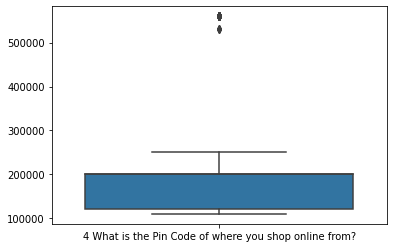

In [13]:
sns.boxplot(data= df_1)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

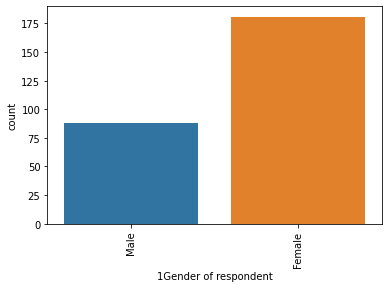

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

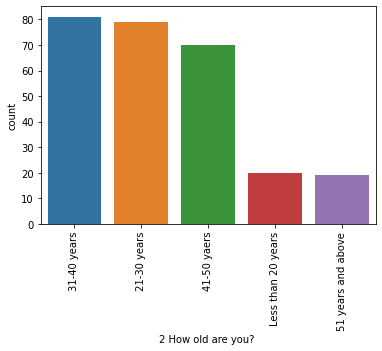

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

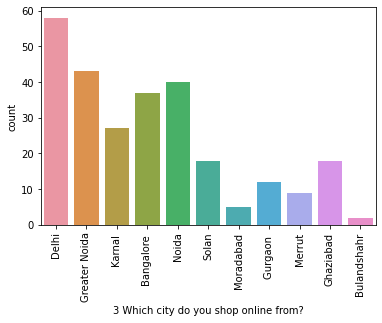

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

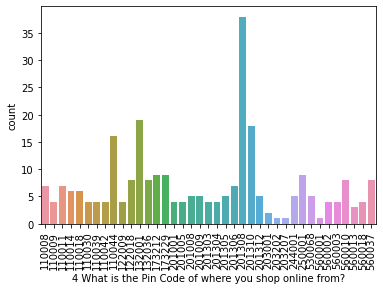

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

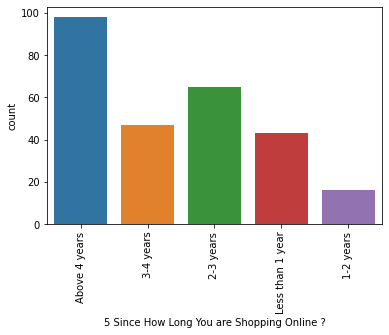

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

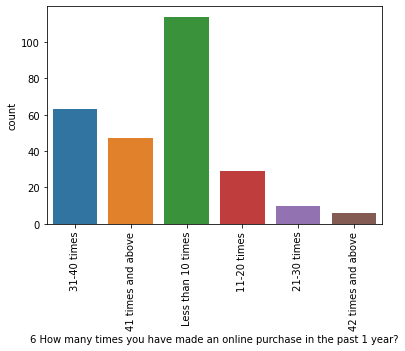

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

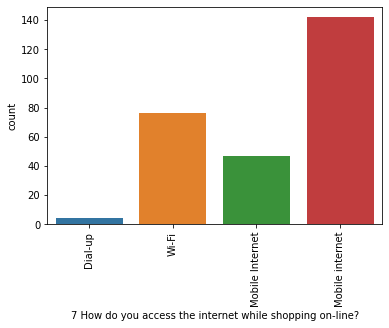

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

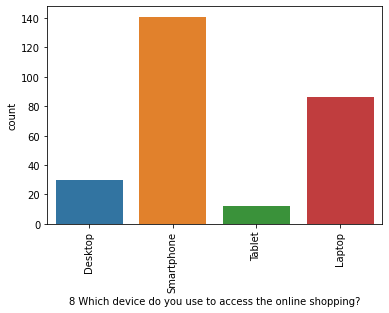

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

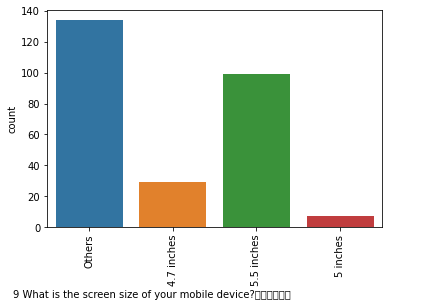

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

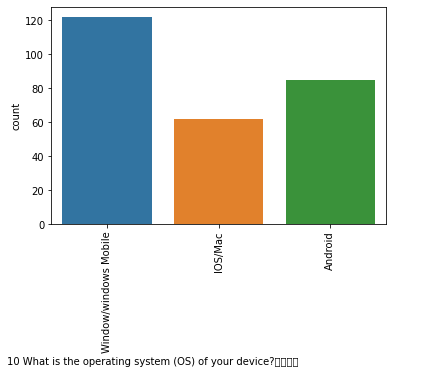

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

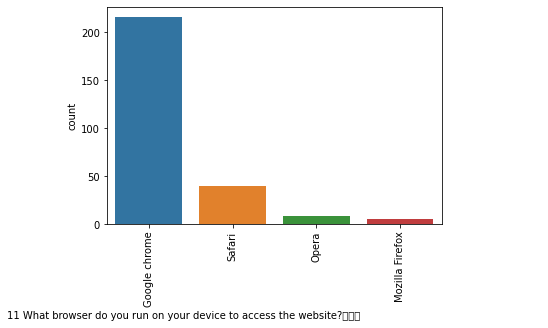

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

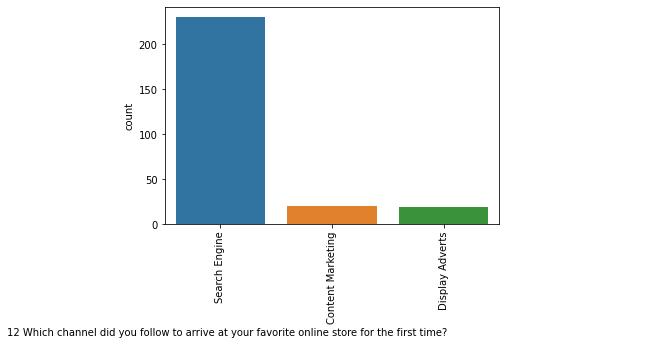

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

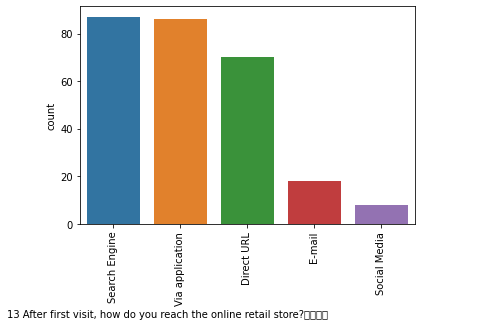

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

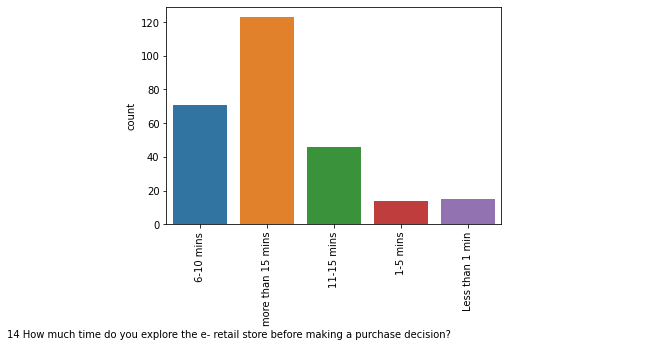

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

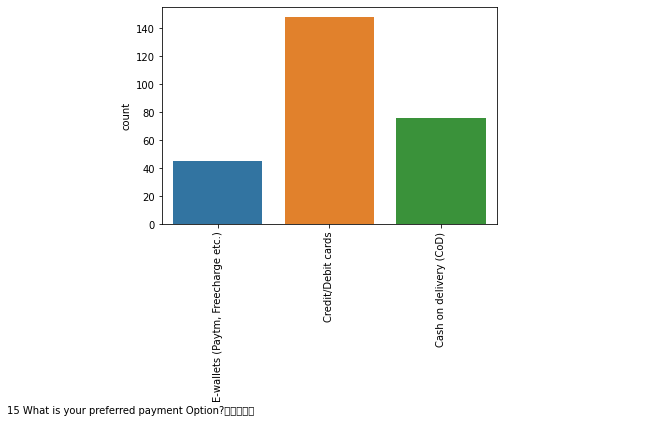

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

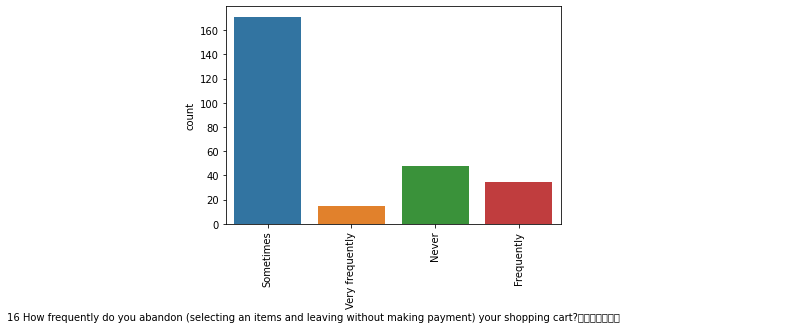

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

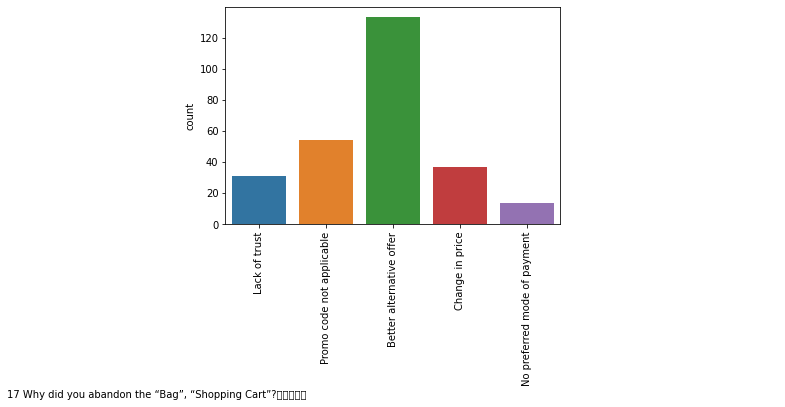

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

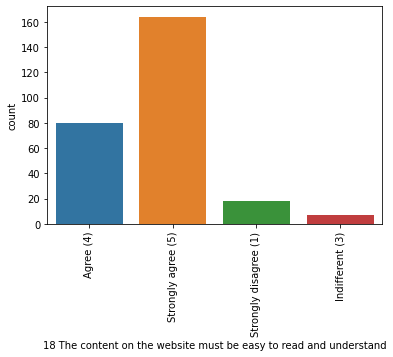

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

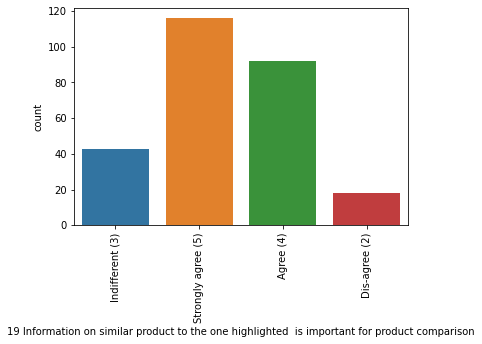

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

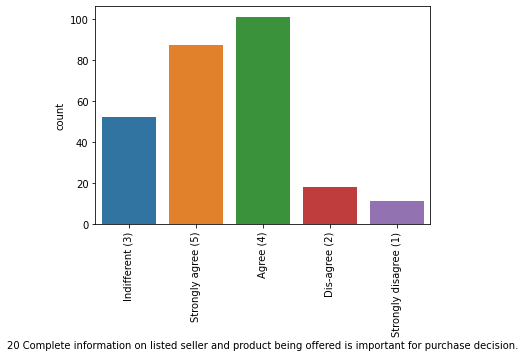

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

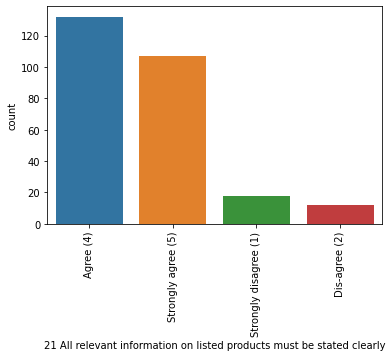

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

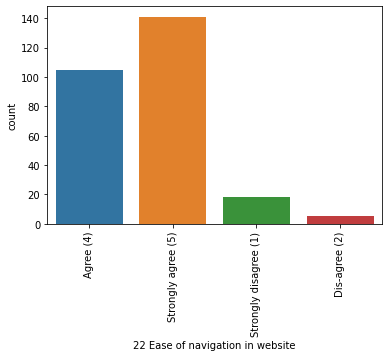

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

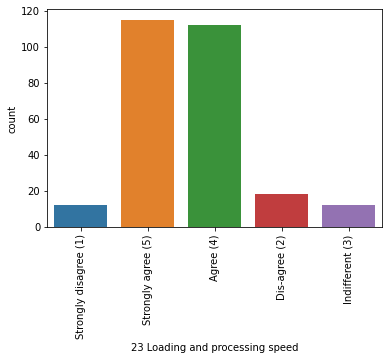

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

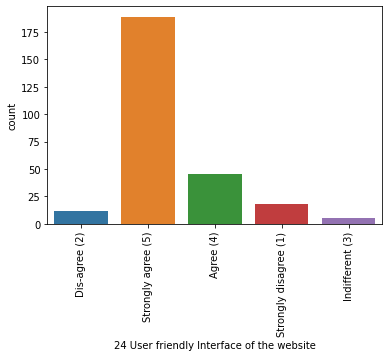

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

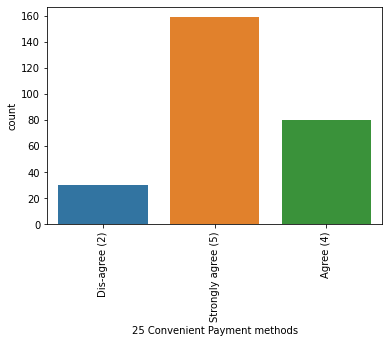

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

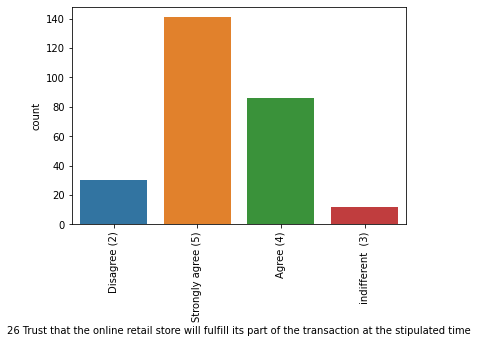

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

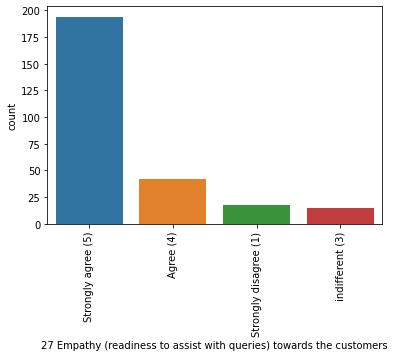

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

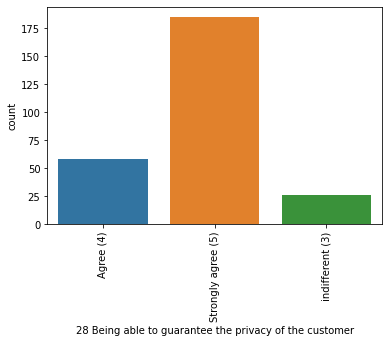

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

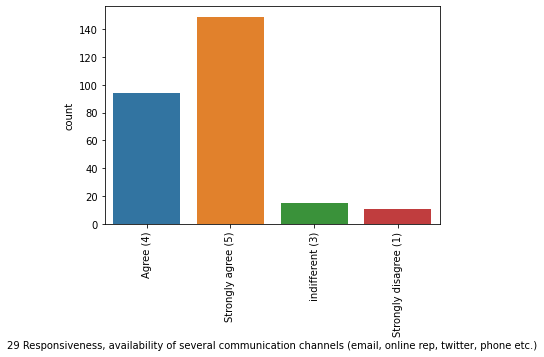

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

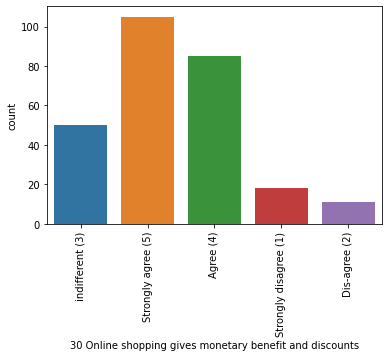

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

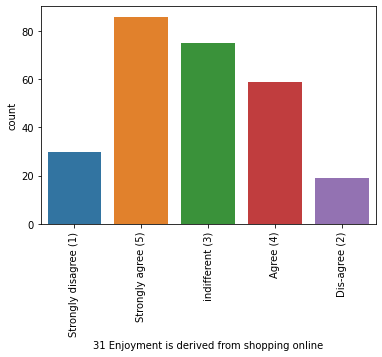

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

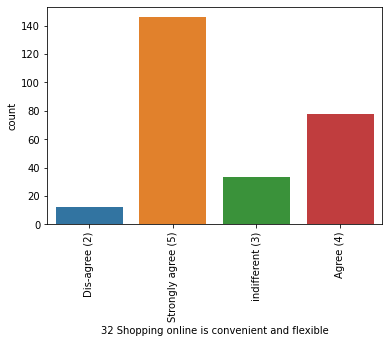

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

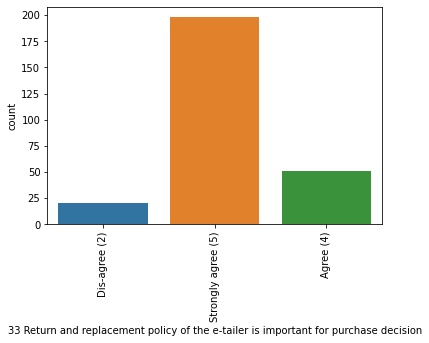

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

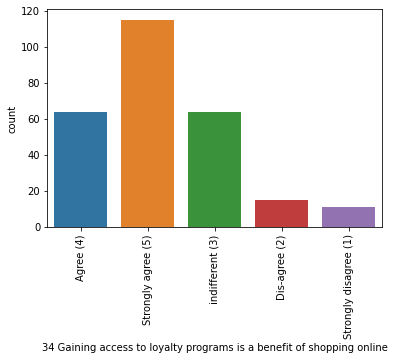

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

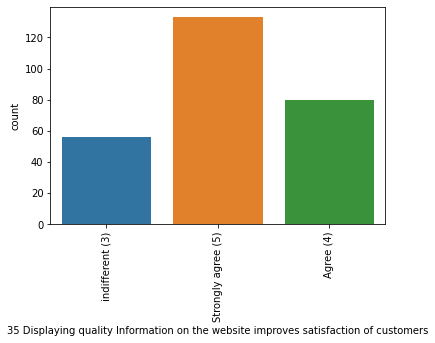

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

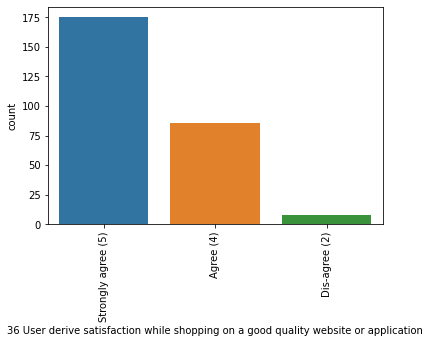

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

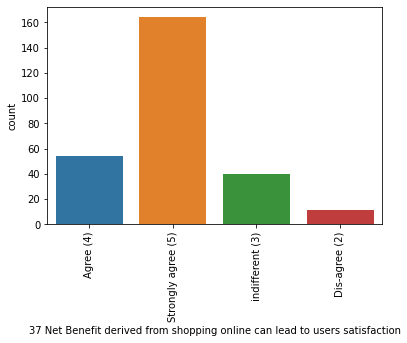

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

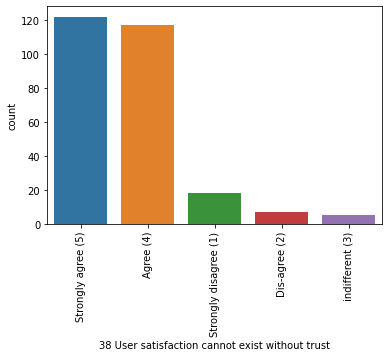

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

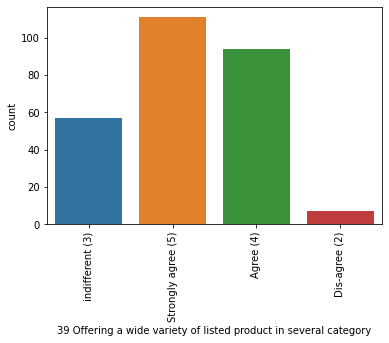

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

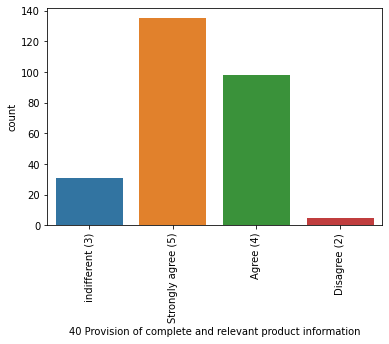

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

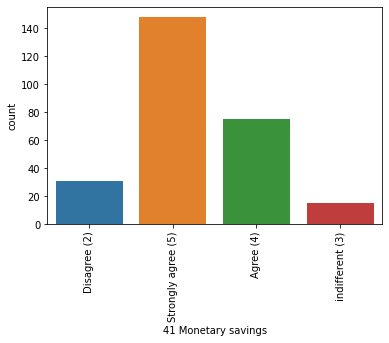

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

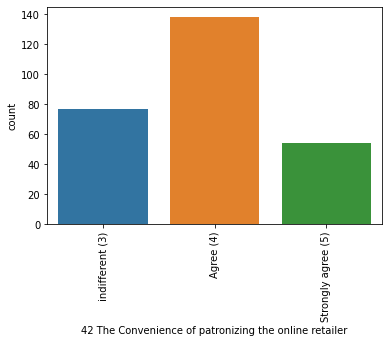

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

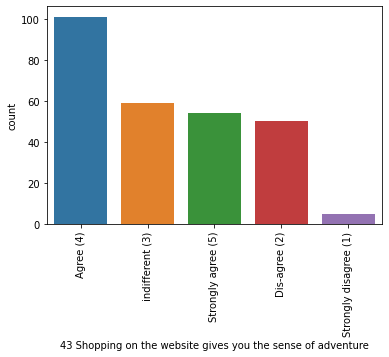

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

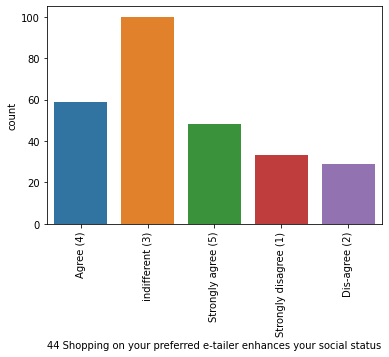

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

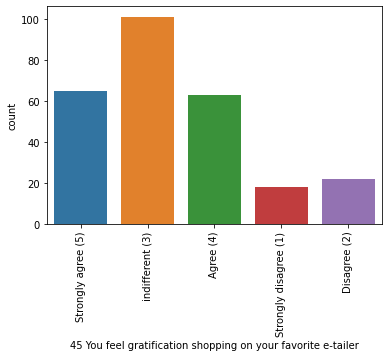

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

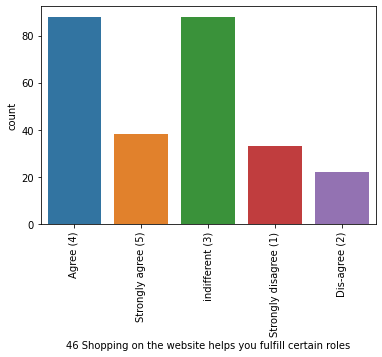

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

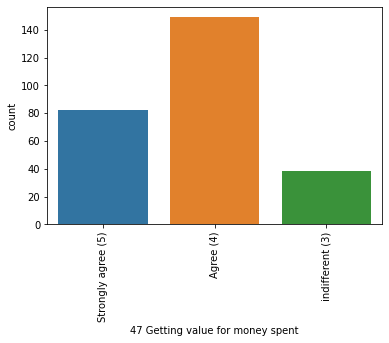

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

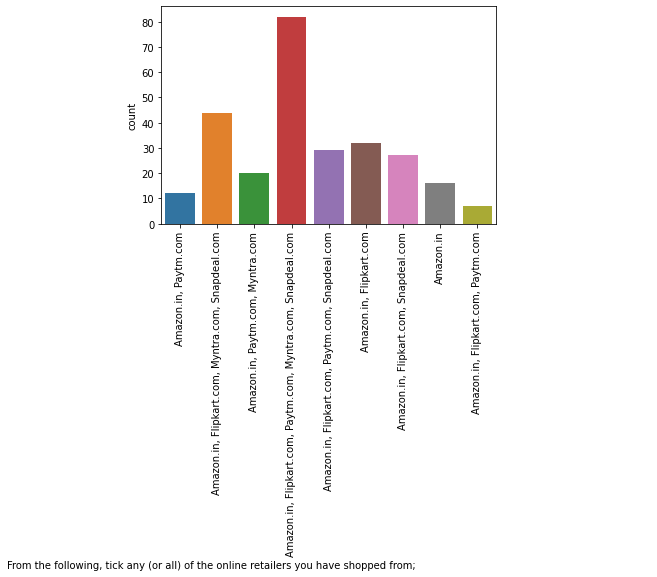

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

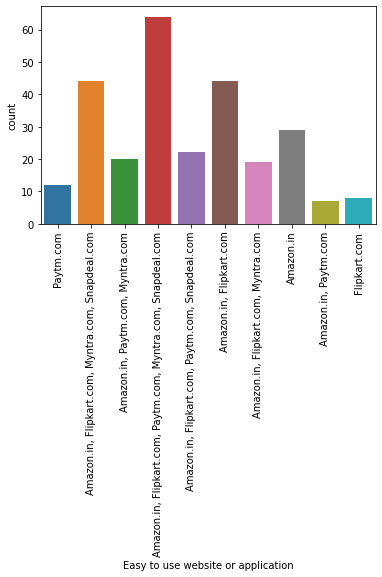

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

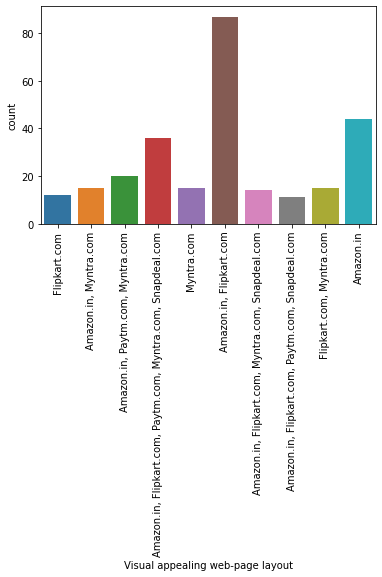

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

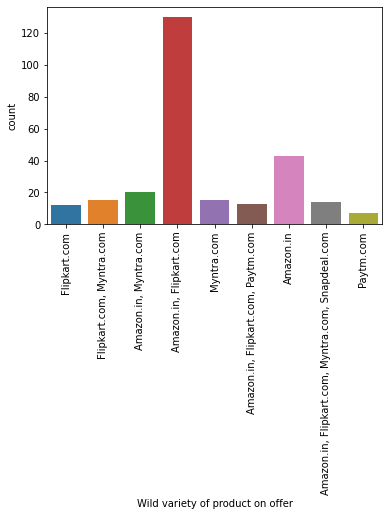

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

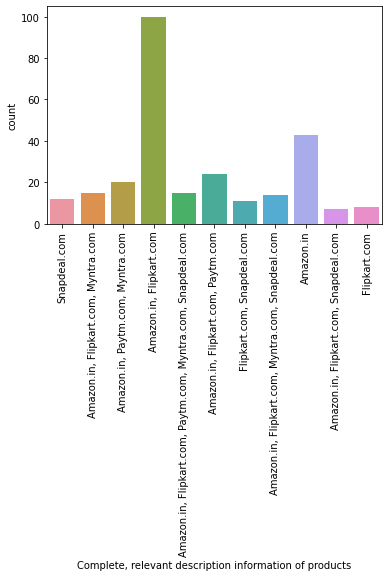

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

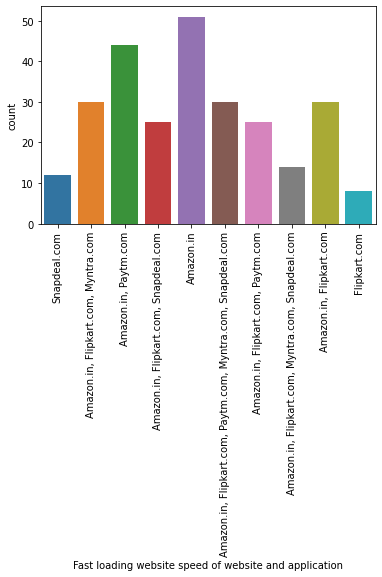

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

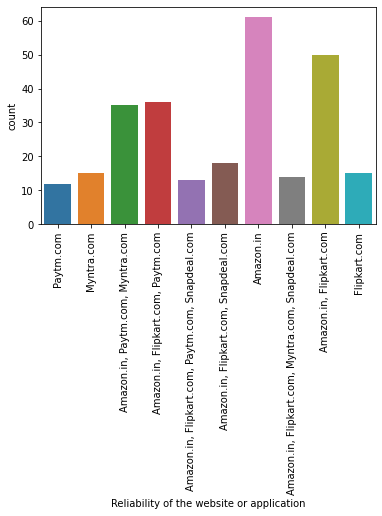

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

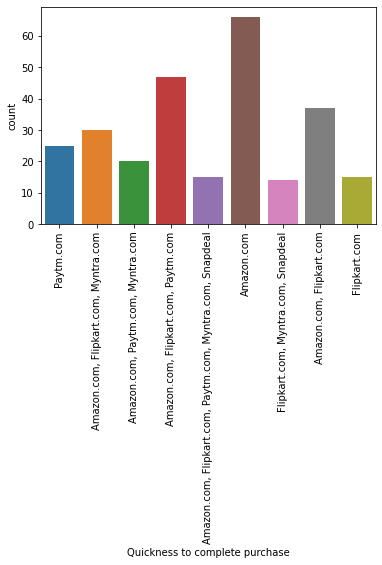

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

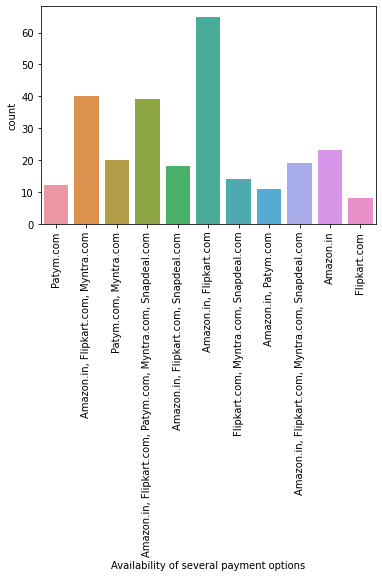

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

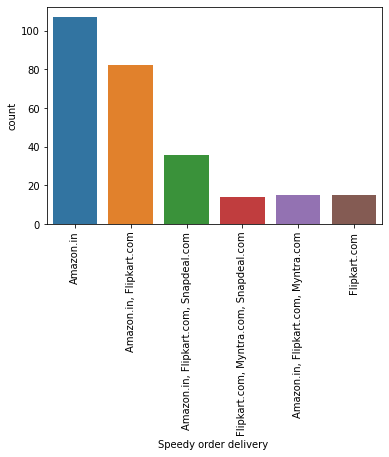

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

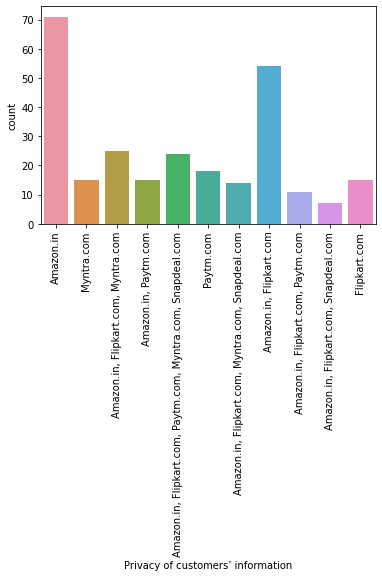

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

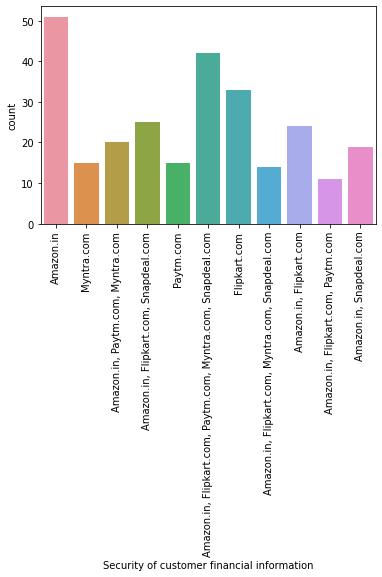

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

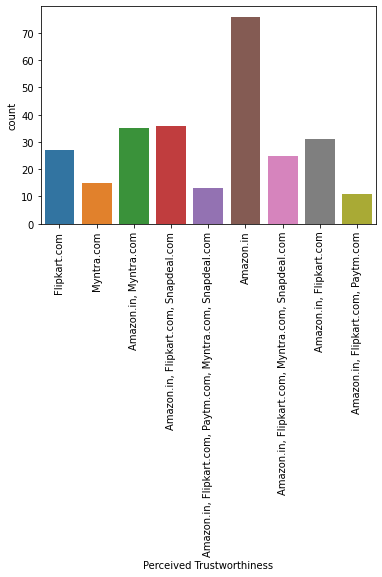

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

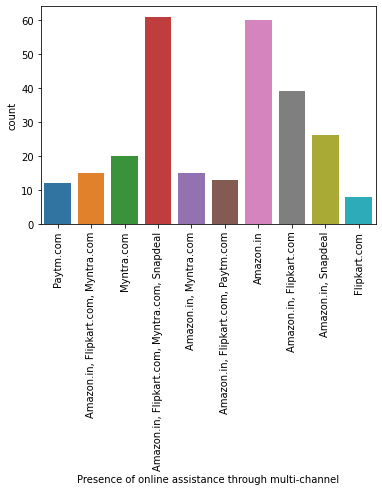

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

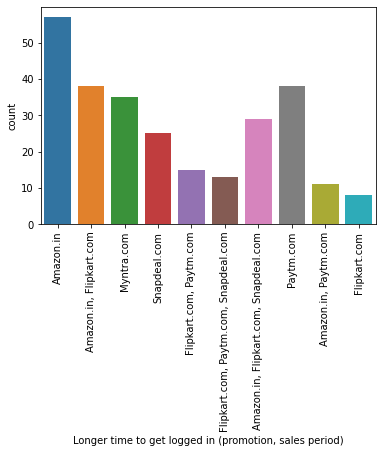

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

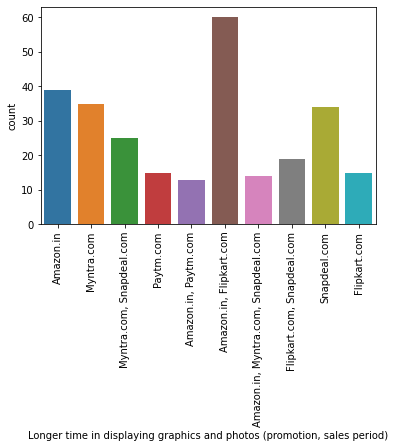

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

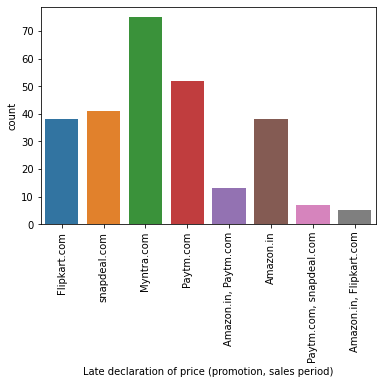

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

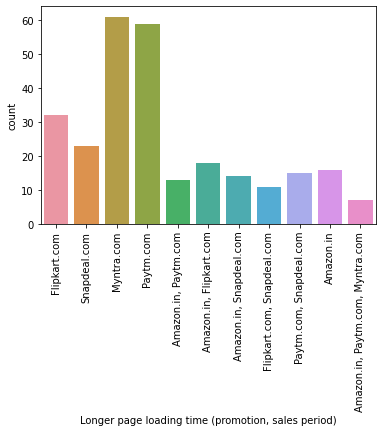

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

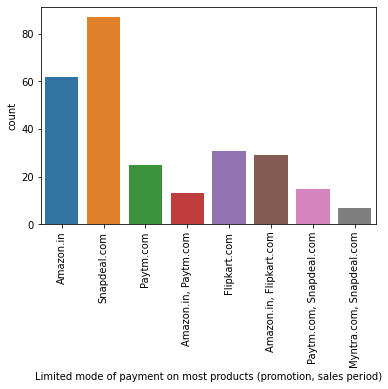

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

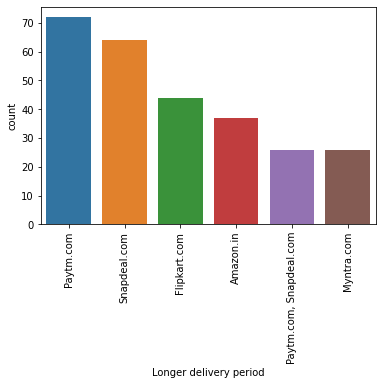

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

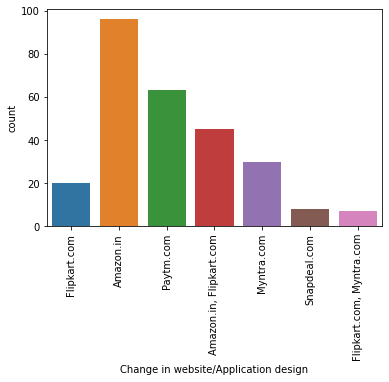

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

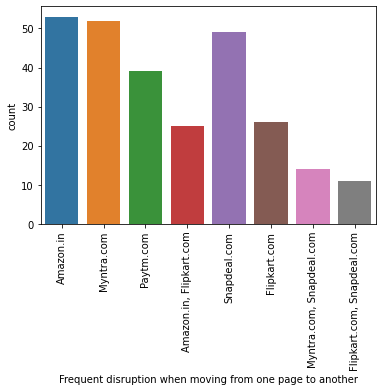

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

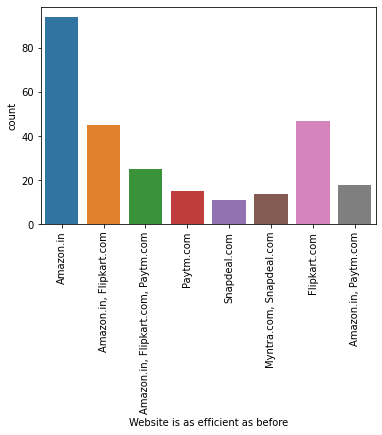

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

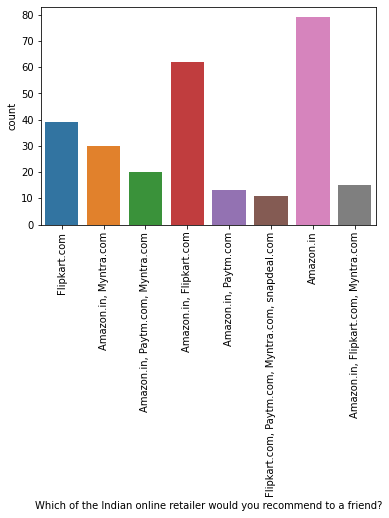

In [14]:
for i in df_1.columns:
    sns.countplot(x=i, data=df_1)
    plt.xticks(rotation ='90')
    plt.show()

Bar graph shows count of all values in dataset

### Bivariate Analysis

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

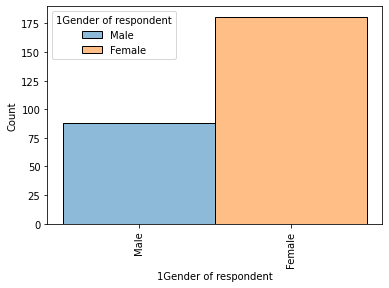

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

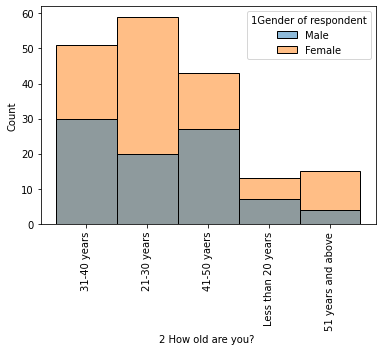

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

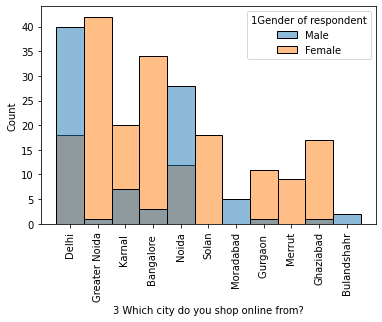

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

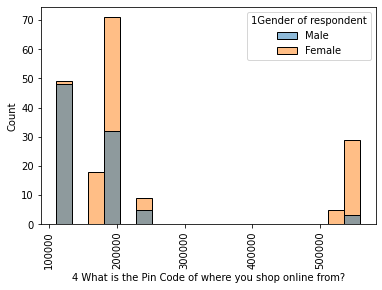

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

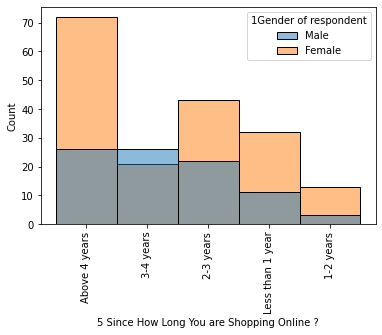

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

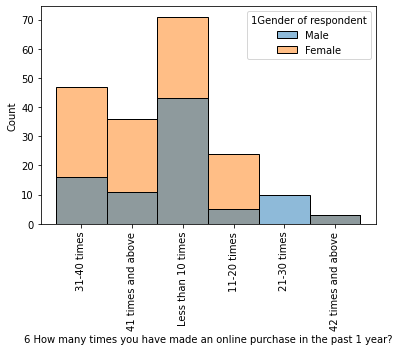

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

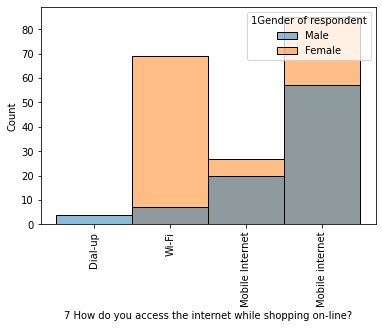

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

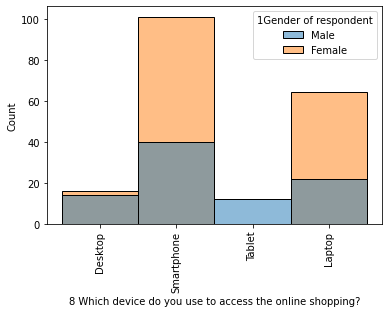

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

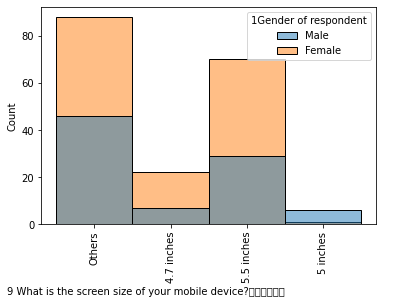

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

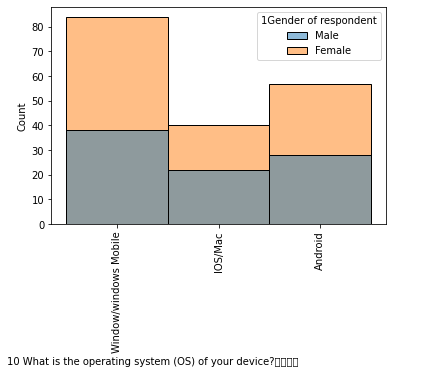

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

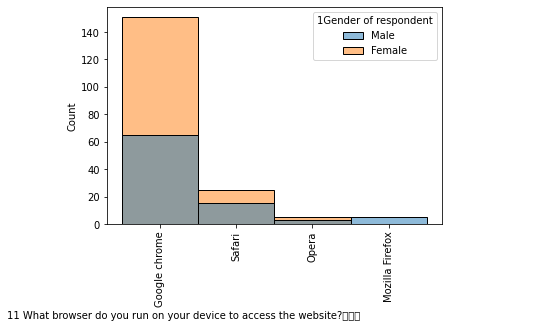

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

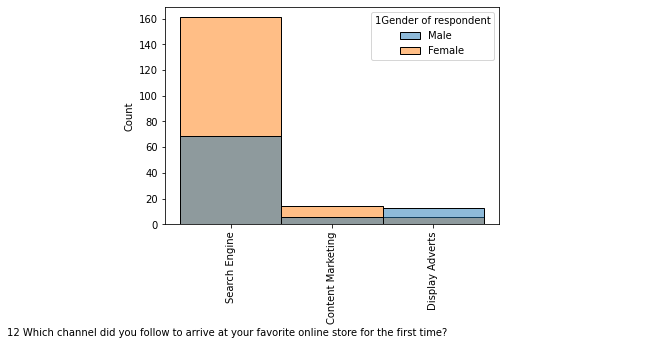

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

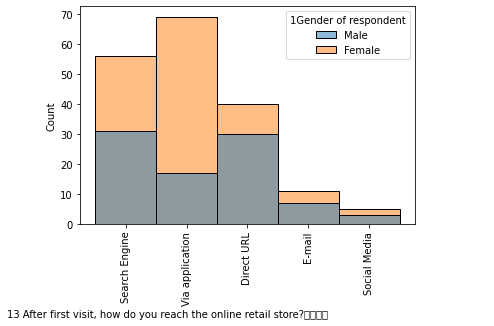

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

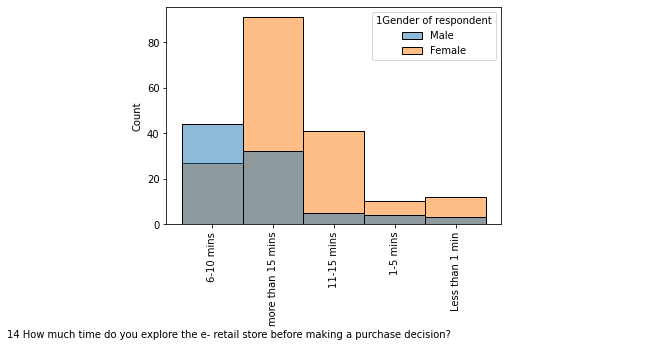

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

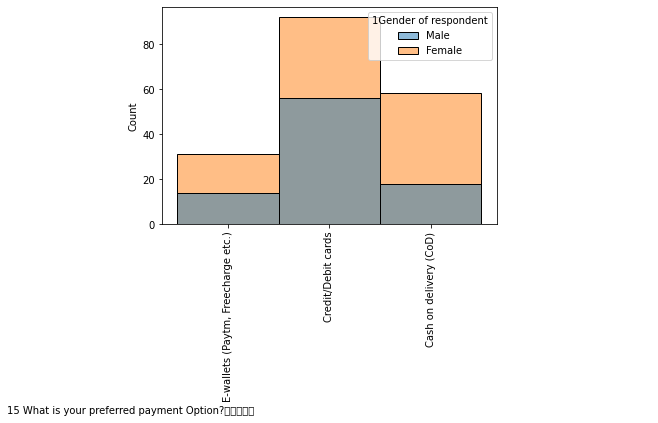

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

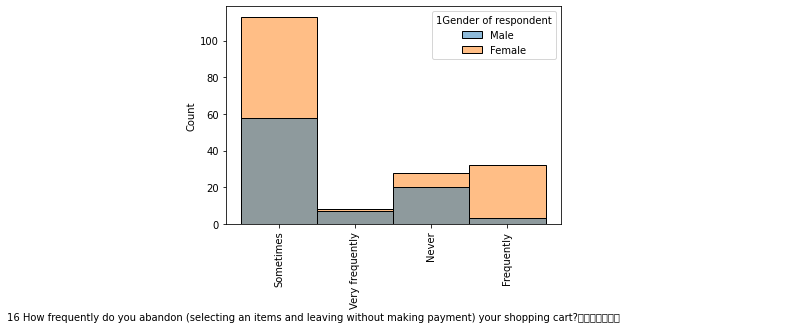

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

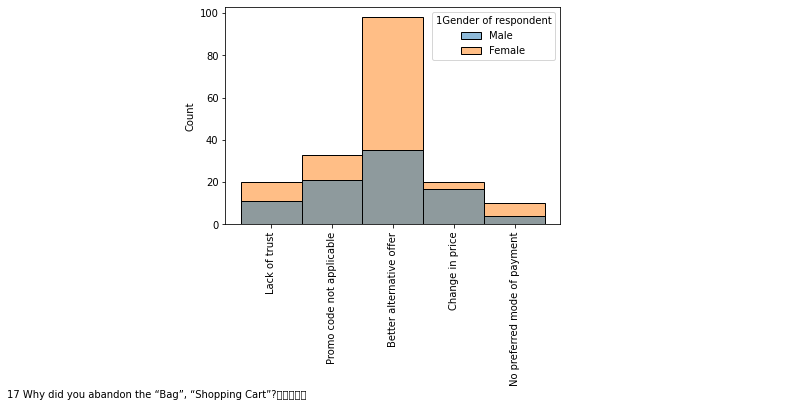

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

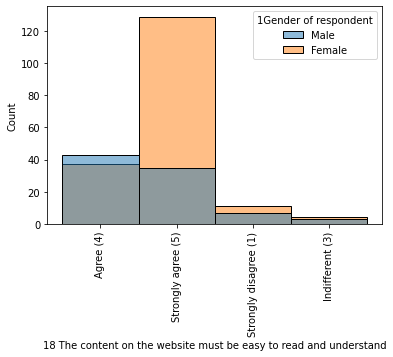

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

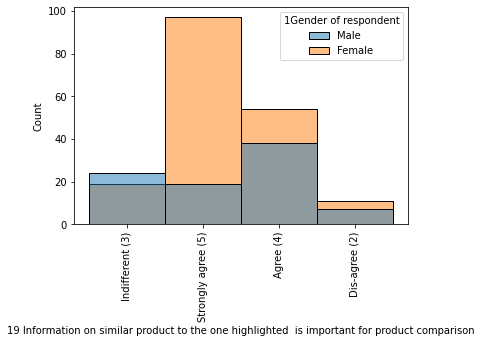

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

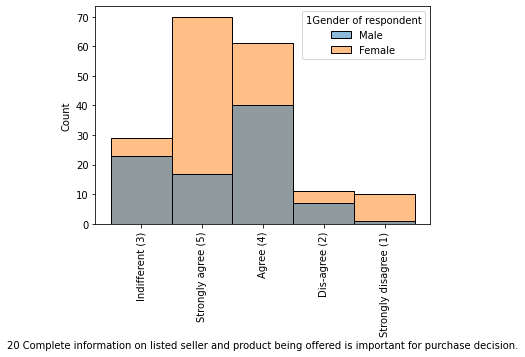

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

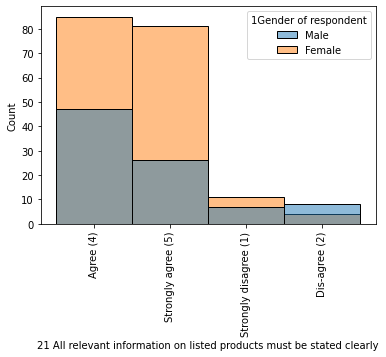

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

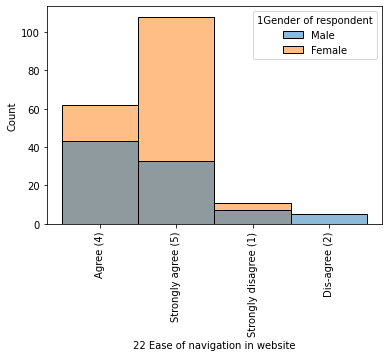

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

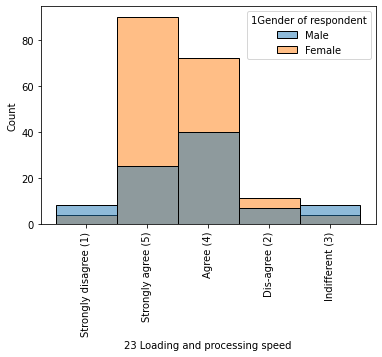

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

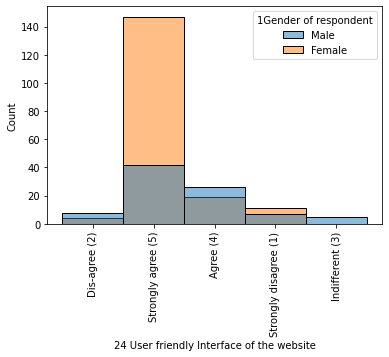

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

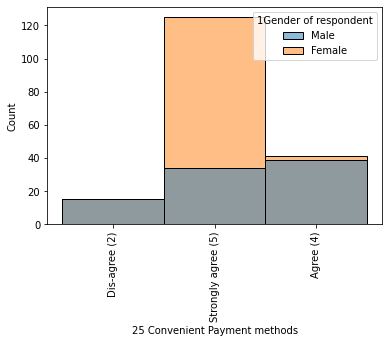

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

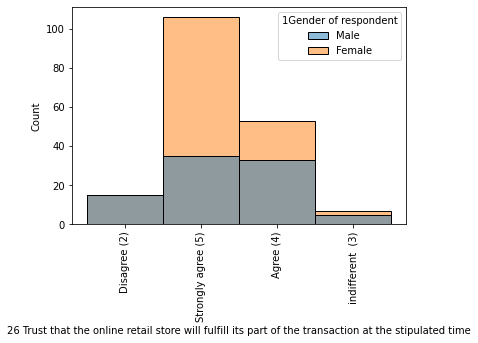

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

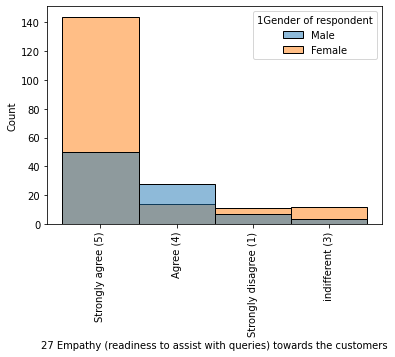

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

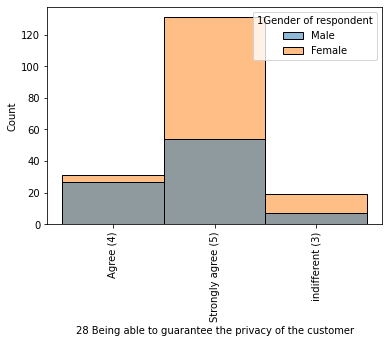

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

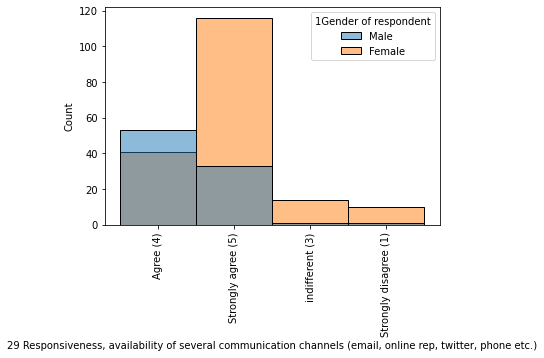

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

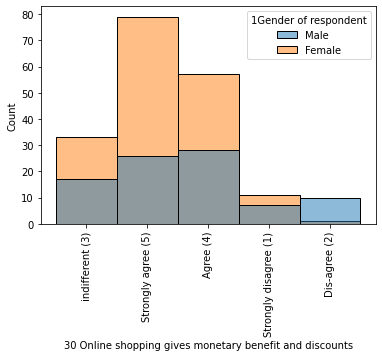

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

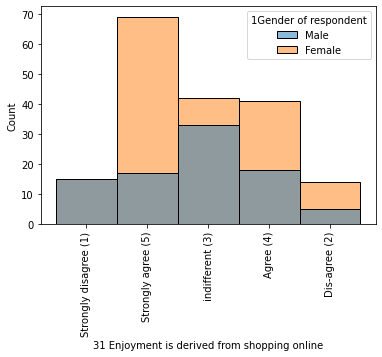

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

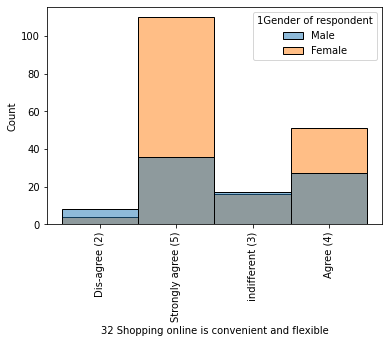

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

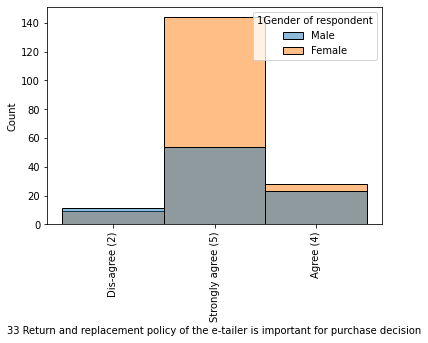

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

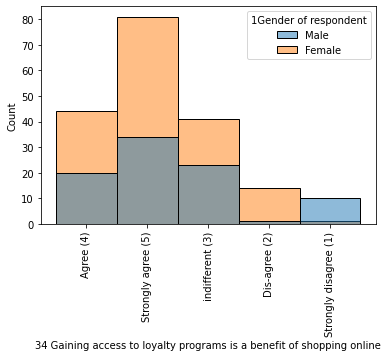

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

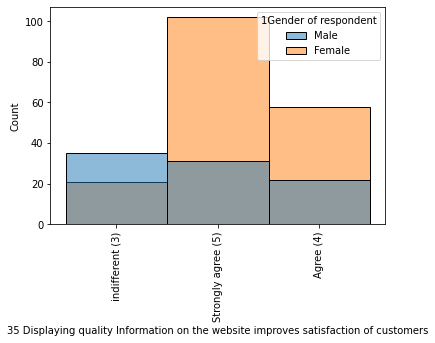

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

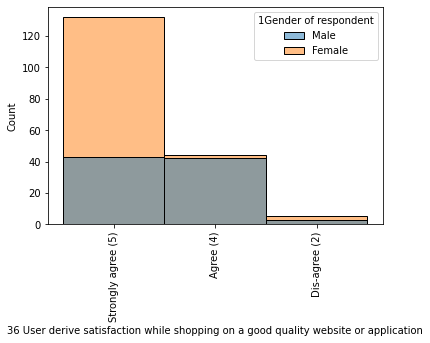

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

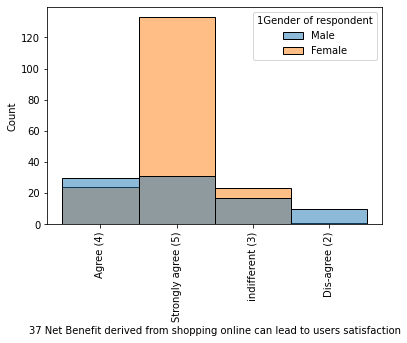

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

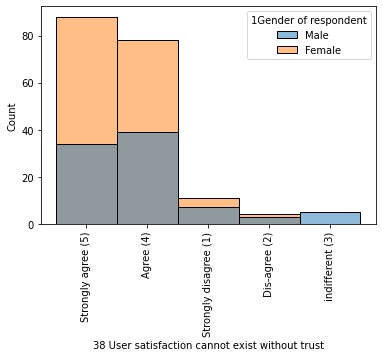

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

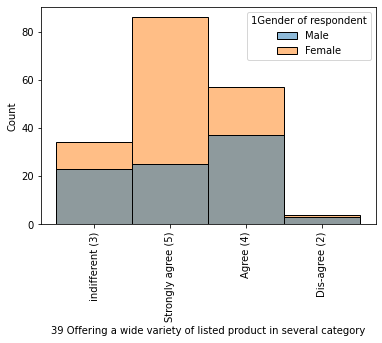

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

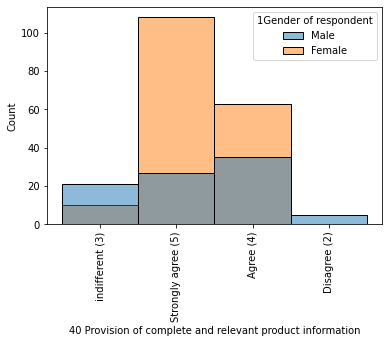

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

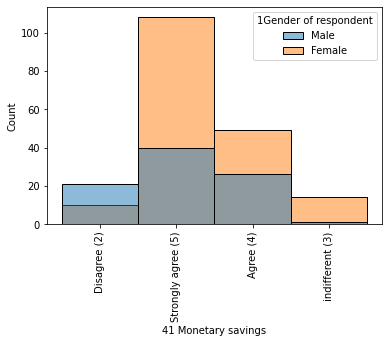

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

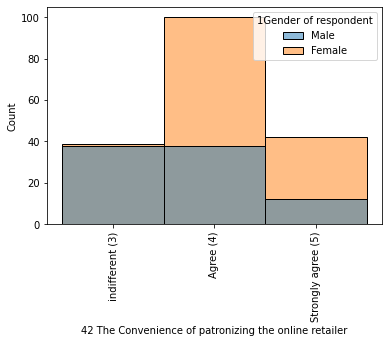

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

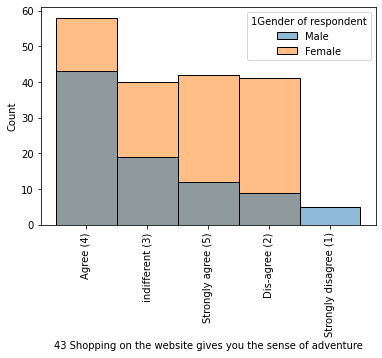

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

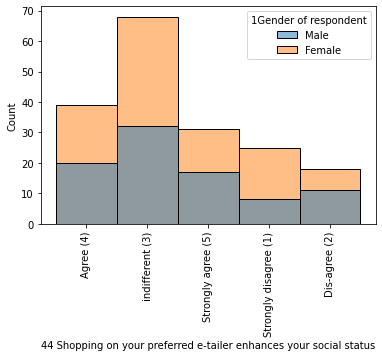

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

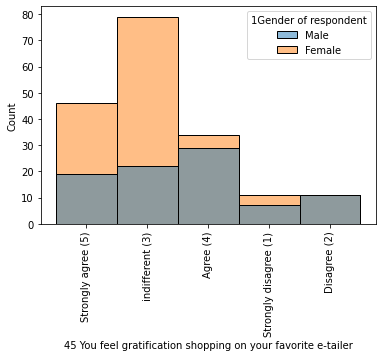

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

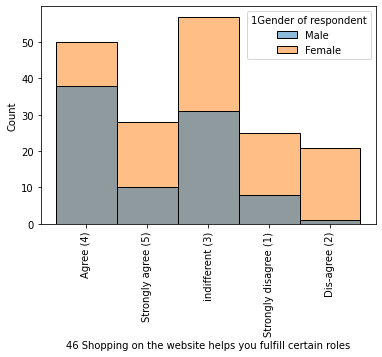

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

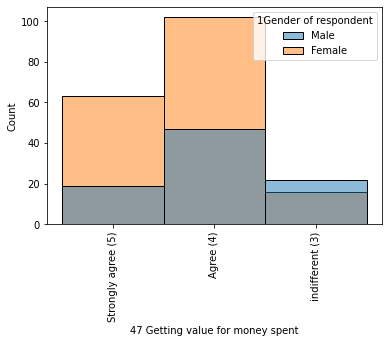

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

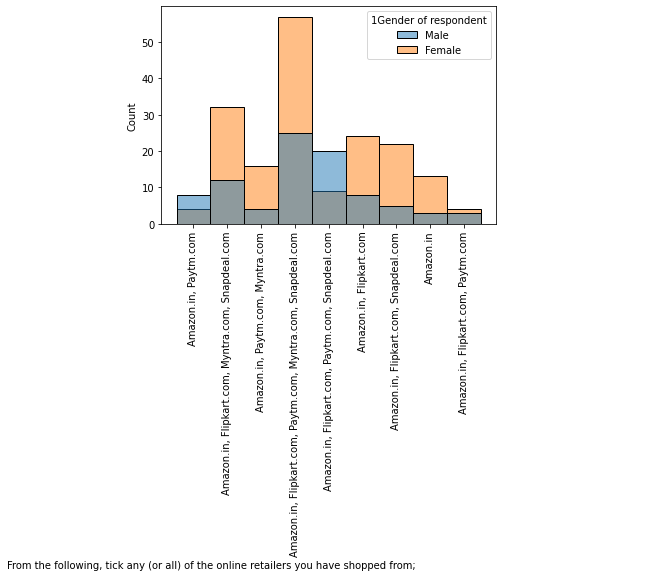

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

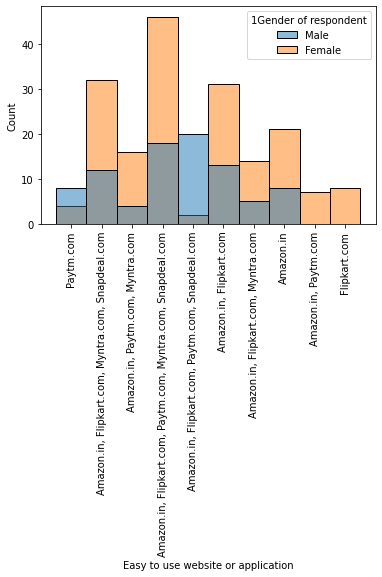

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

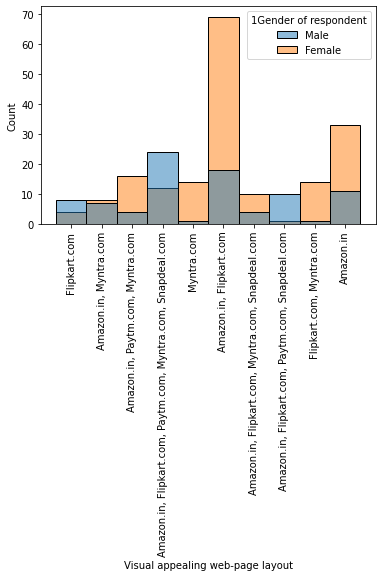

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

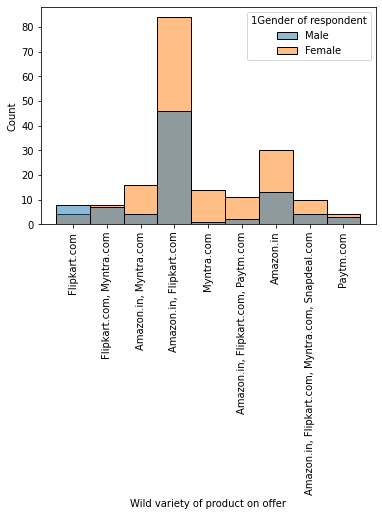

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

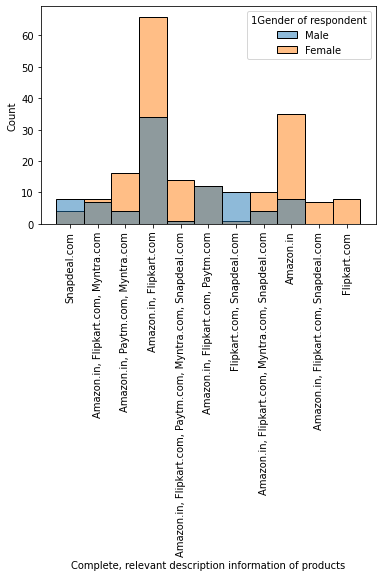

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

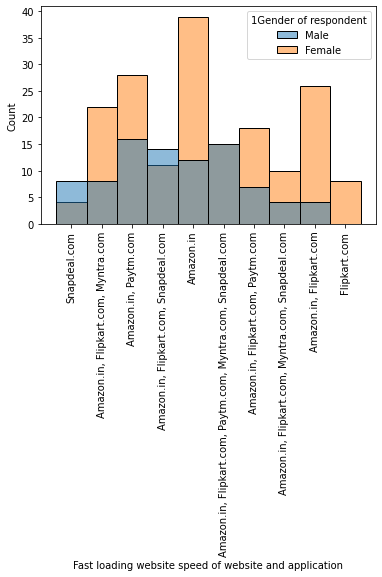

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

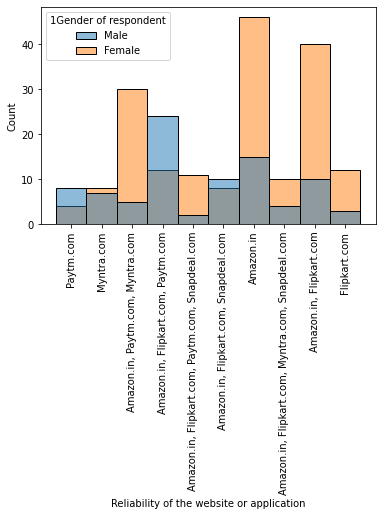

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

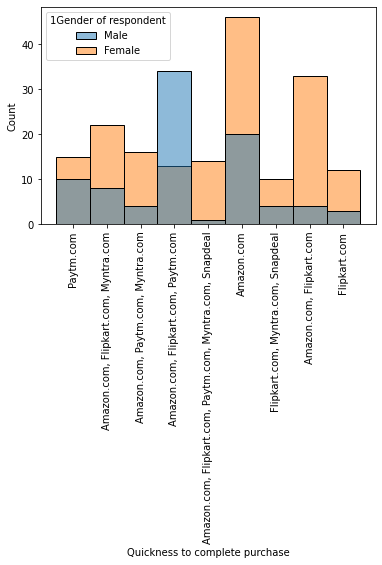

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

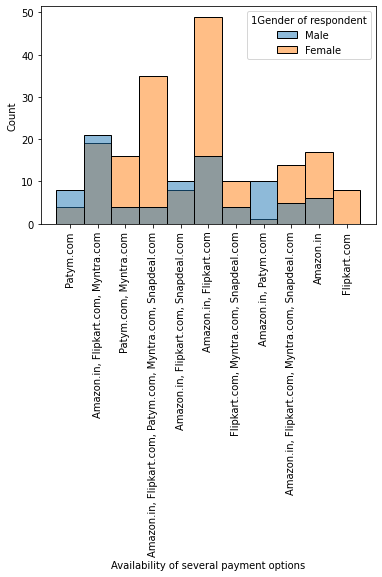

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

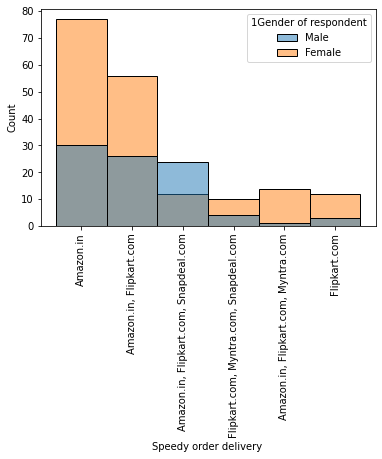

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

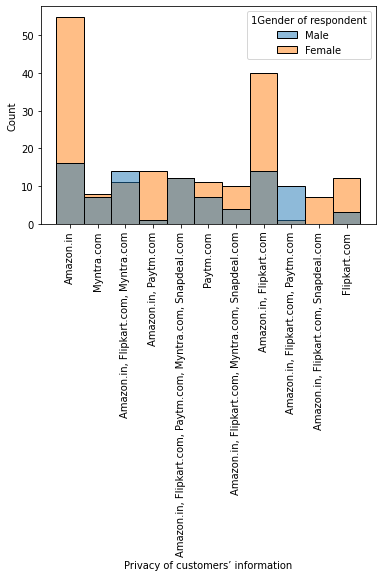

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

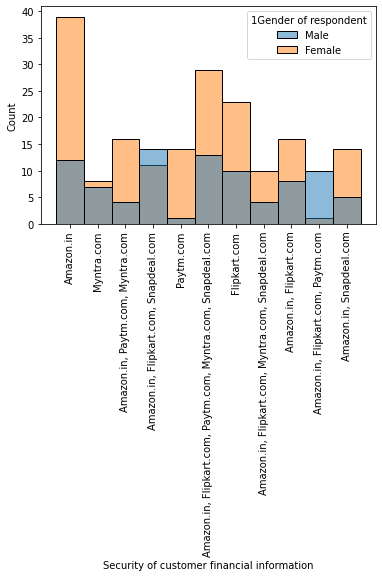

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

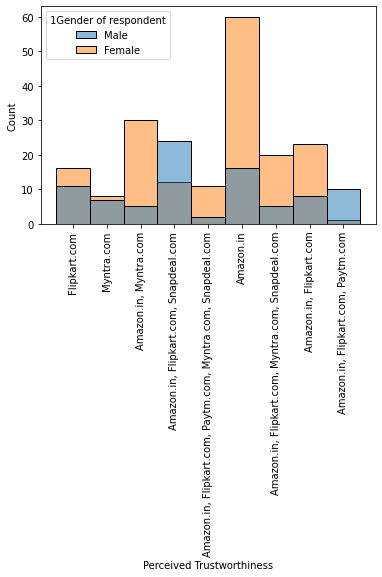

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

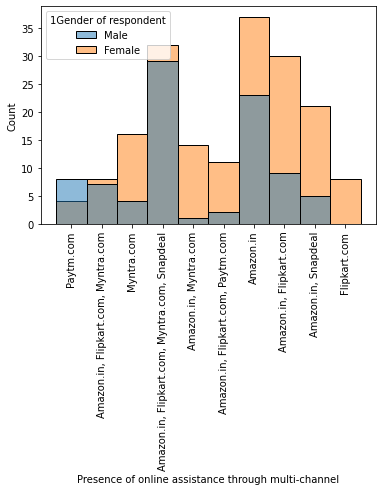

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

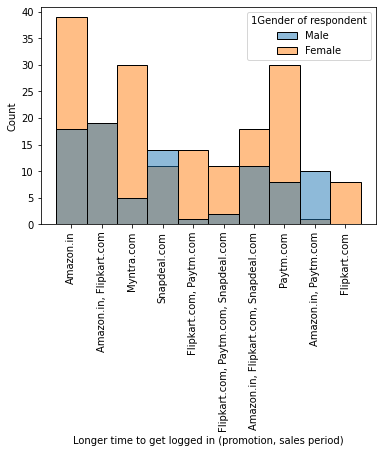

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

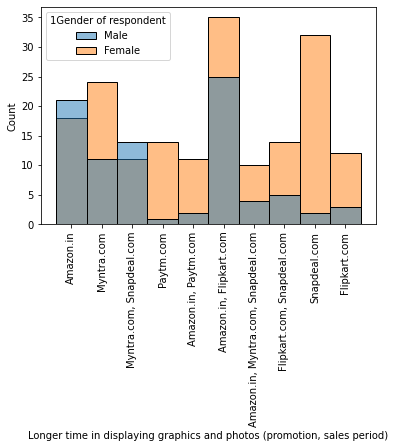

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

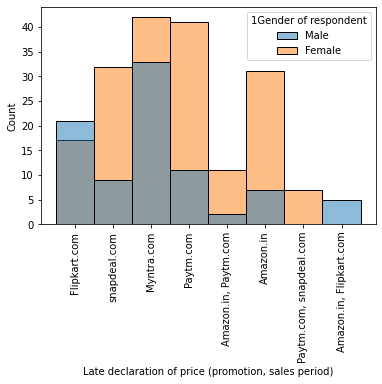

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

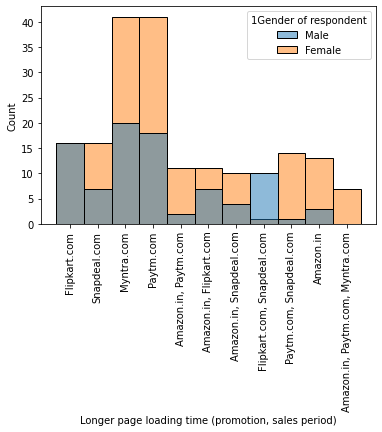

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

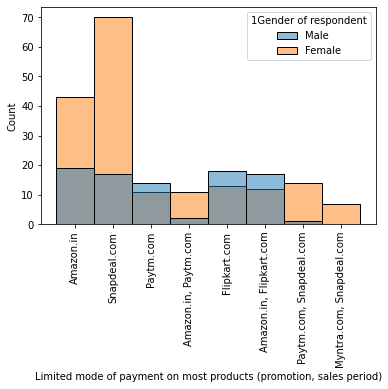

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

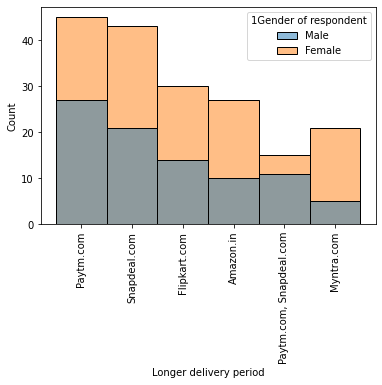

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

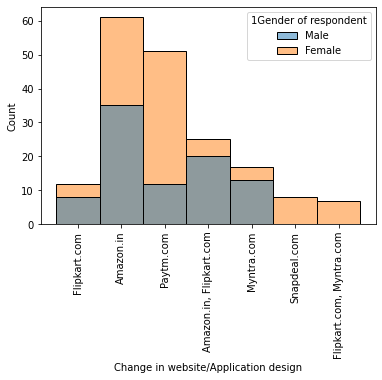

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

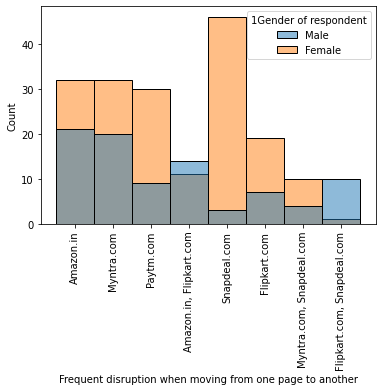

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

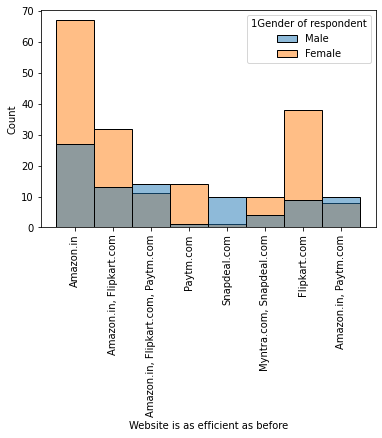

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

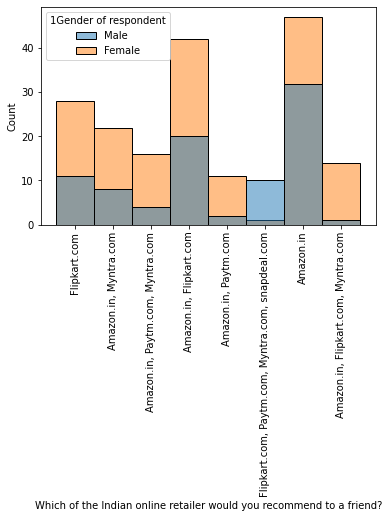

In [15]:
for i in df_1.columns:
    sns.histplot(df_1,x=i, hue = df_1['1Gender of respondent'])
    plt.xticks(rotation ='90')
    plt.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

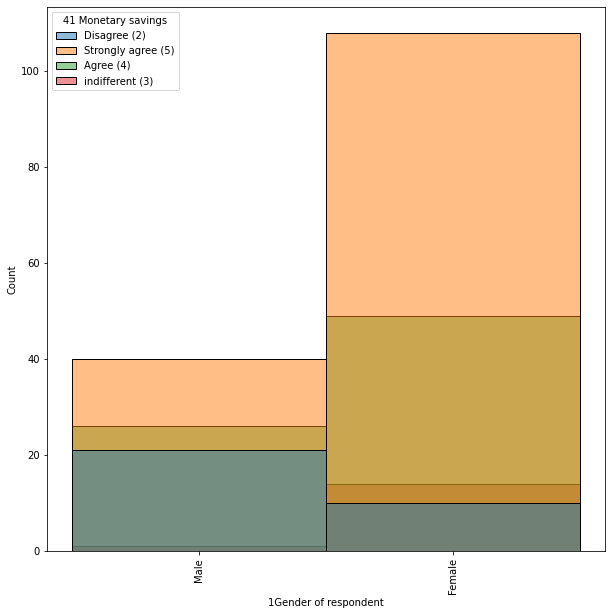

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

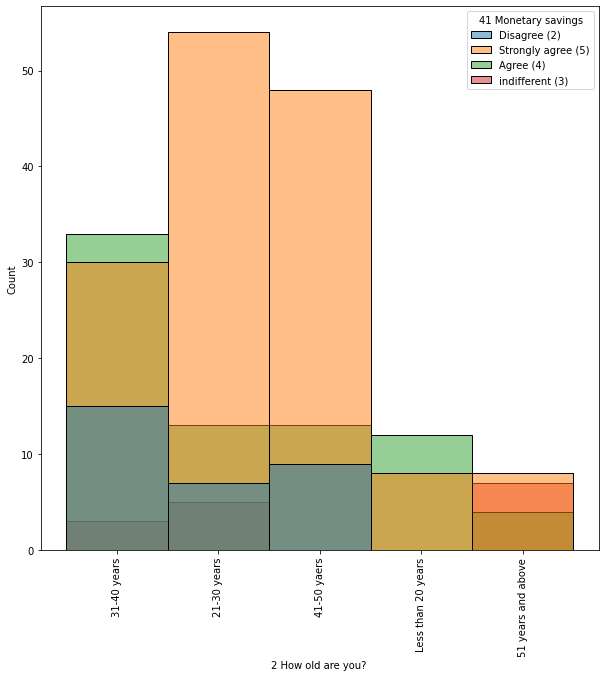

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

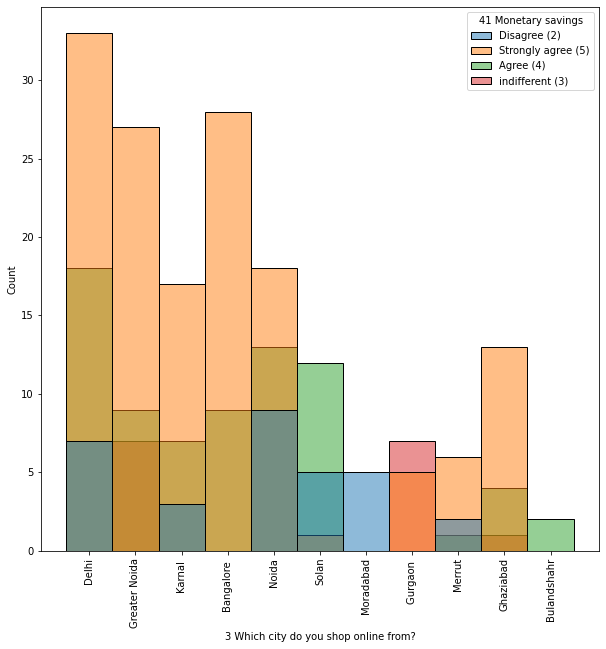

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

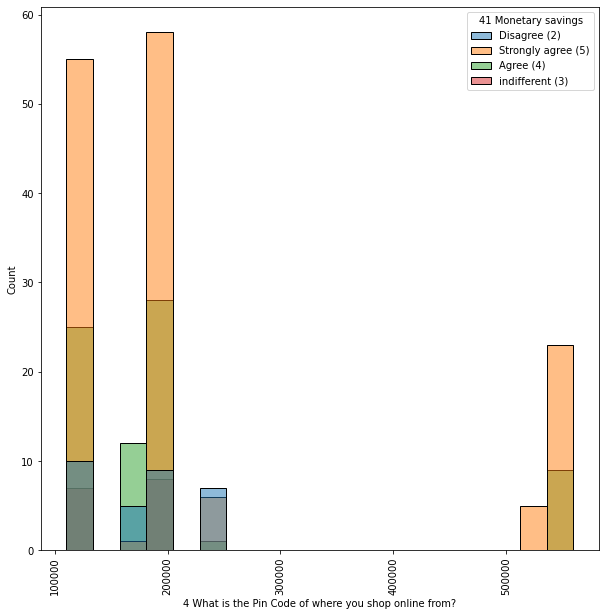

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

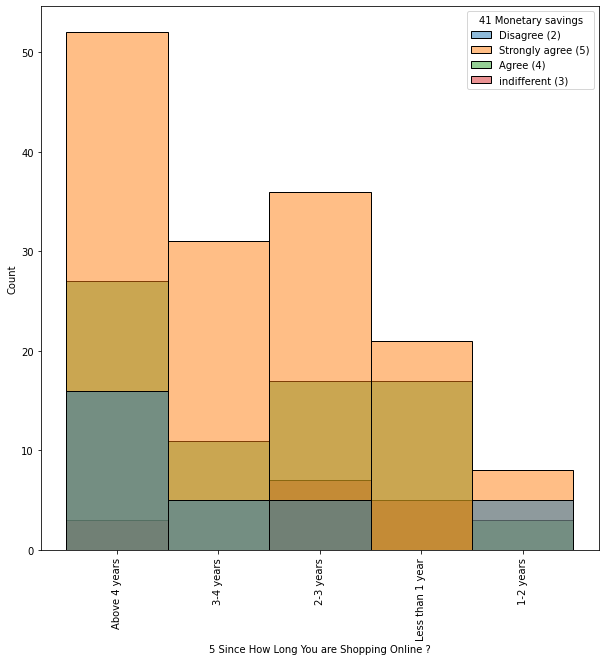

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

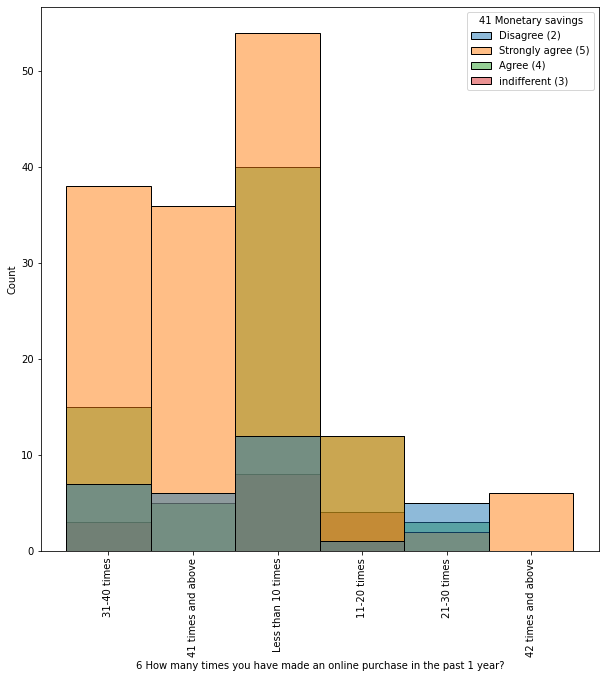

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

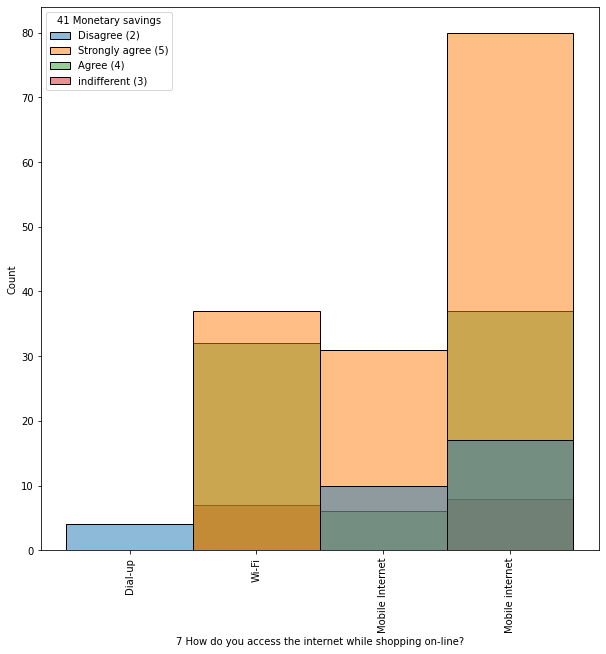

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

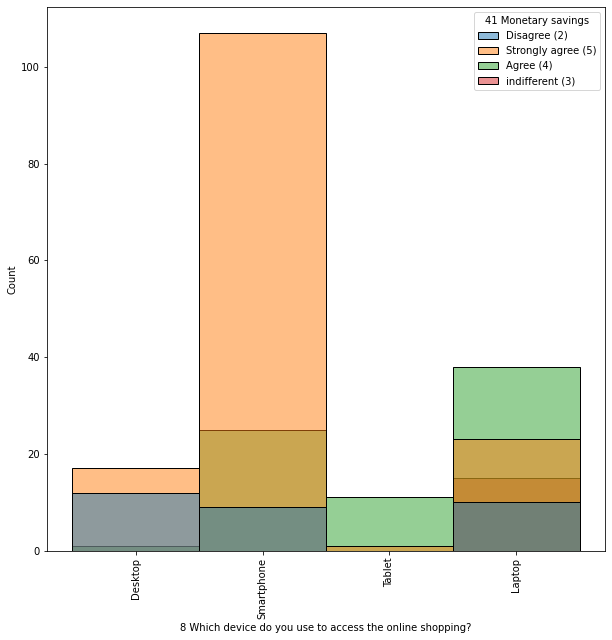

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

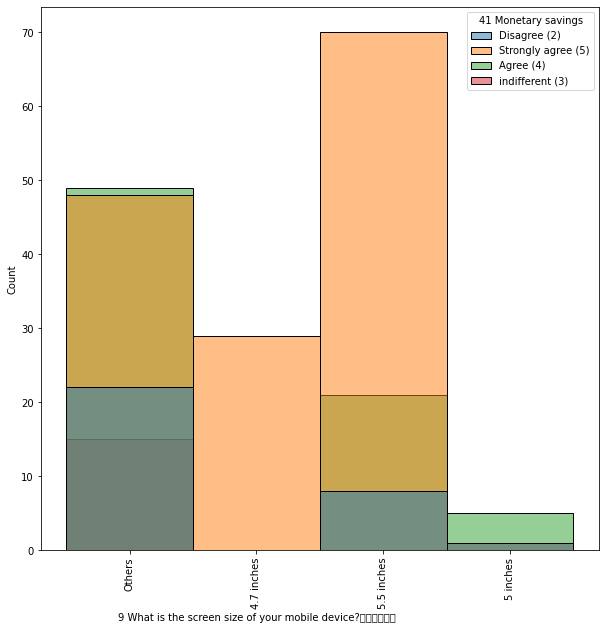

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

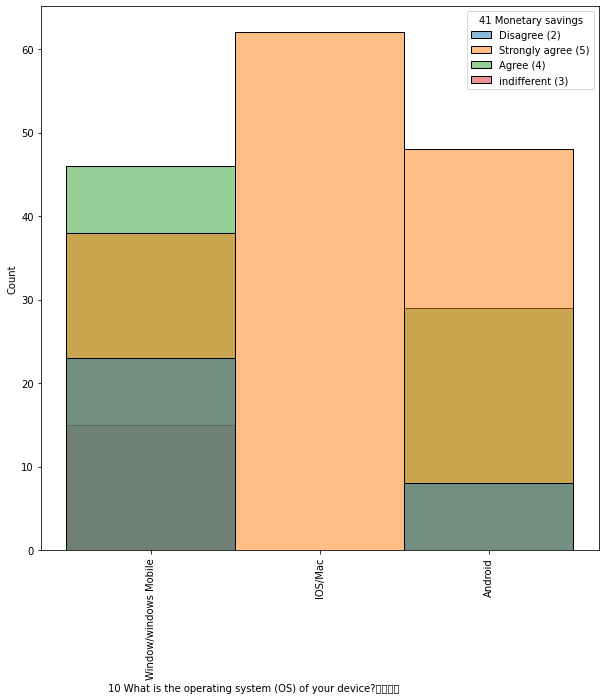

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

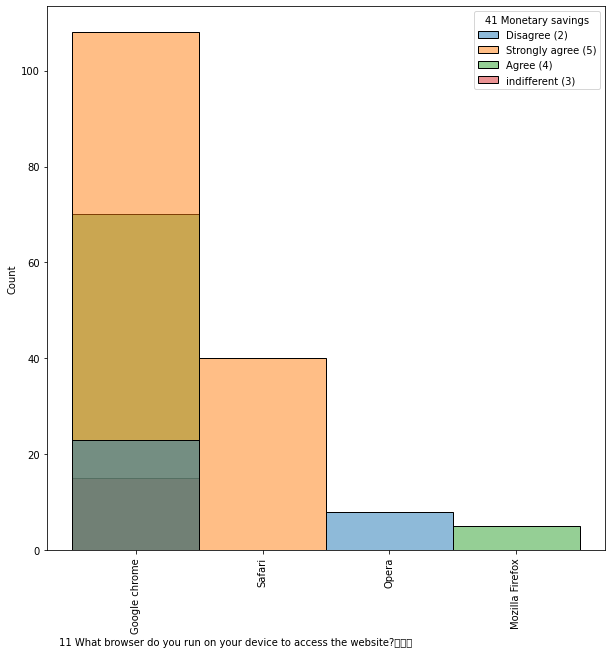

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

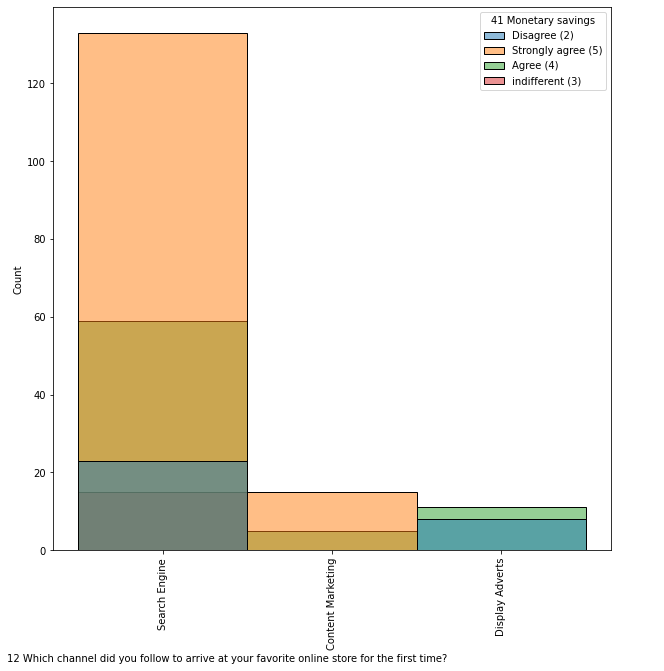

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

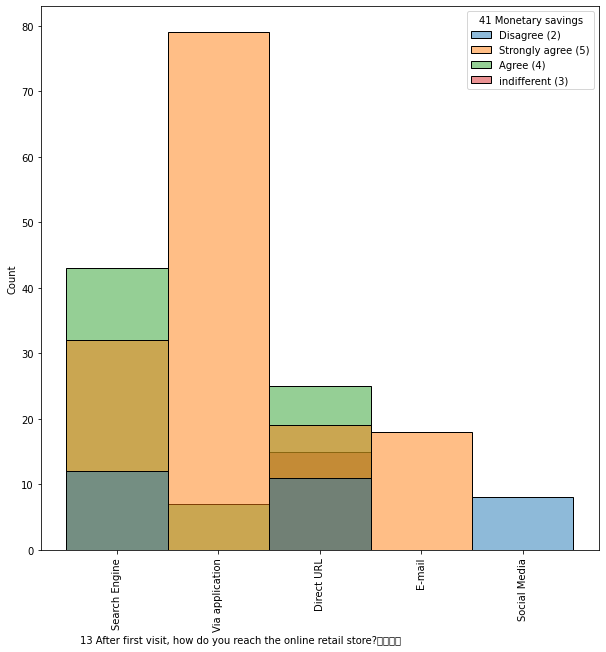

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

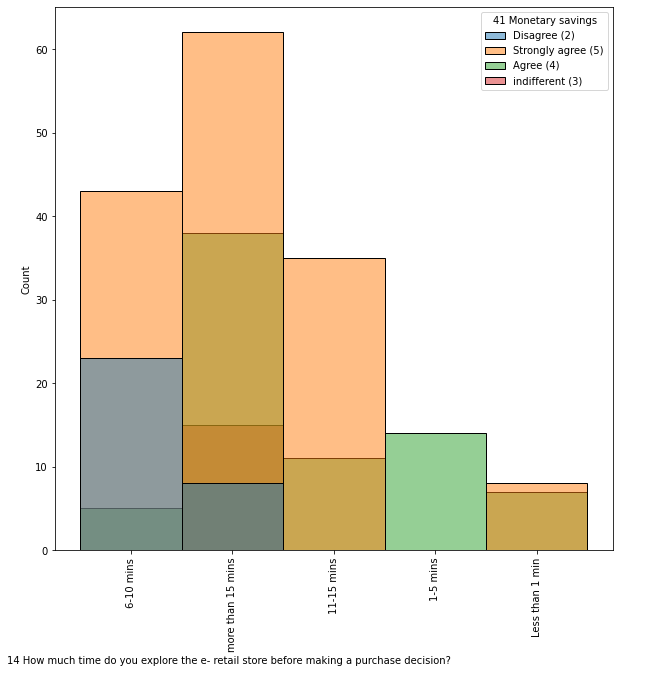

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

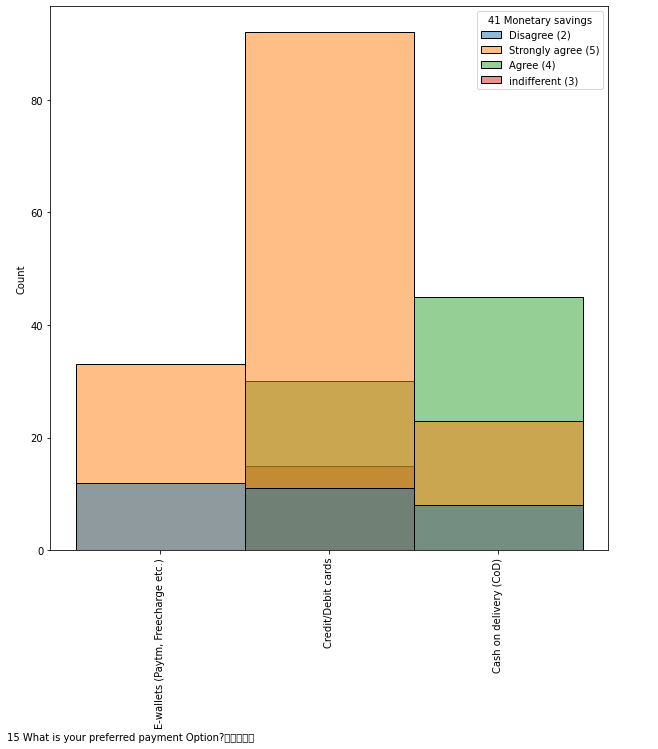

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

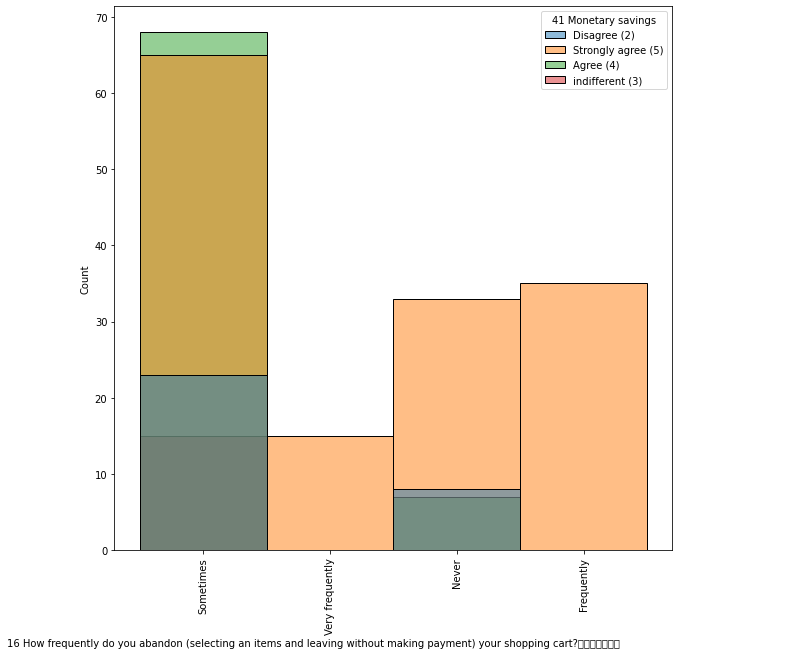

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

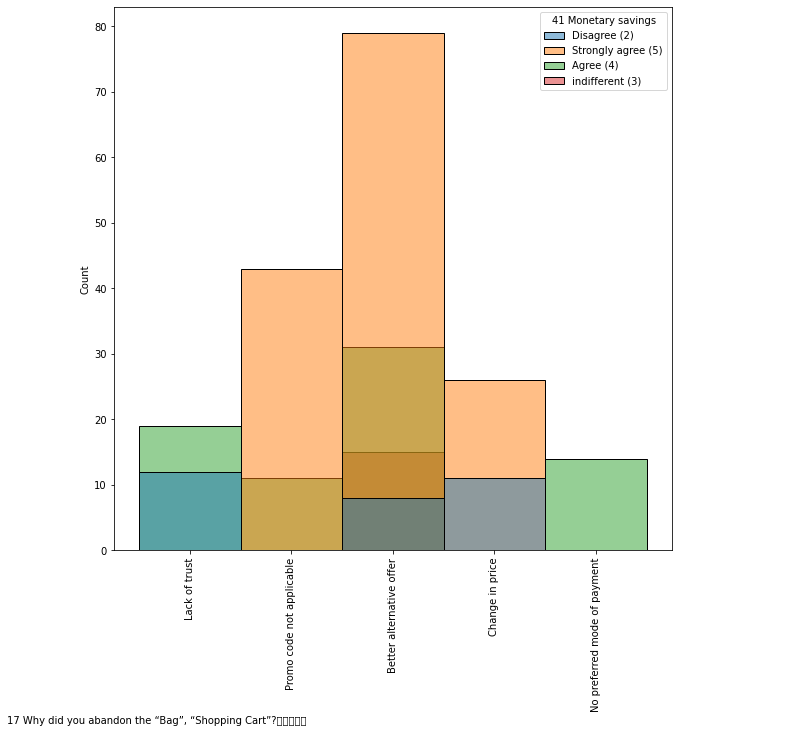

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

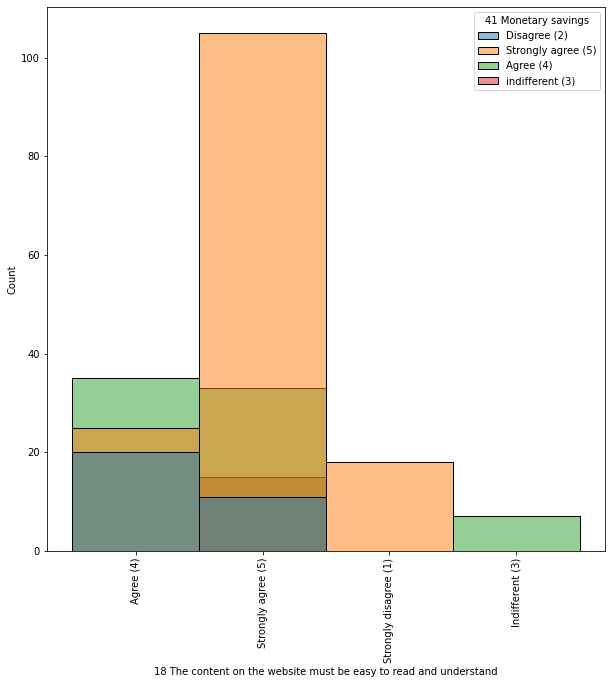

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

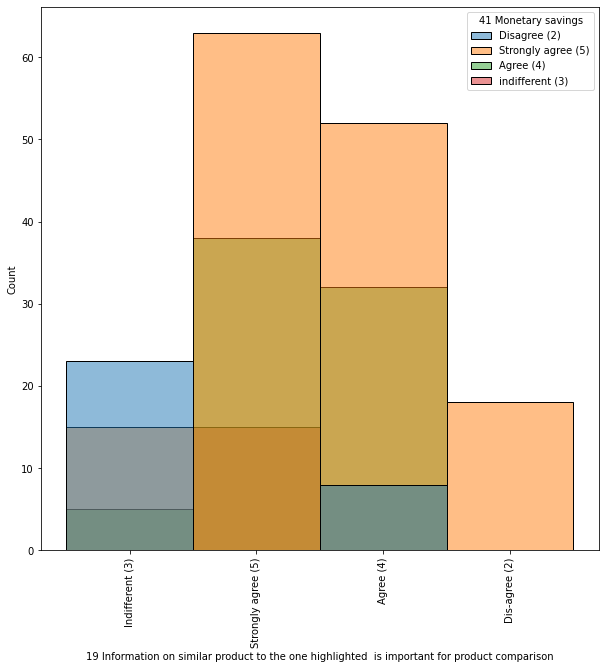

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

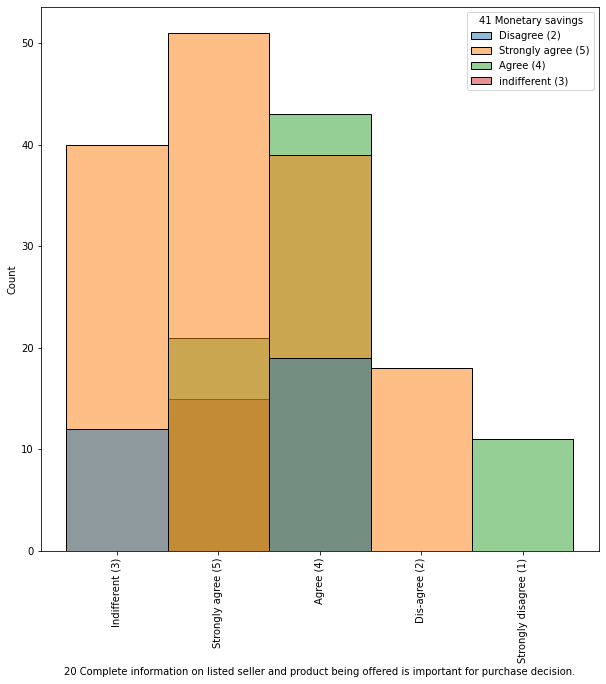

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

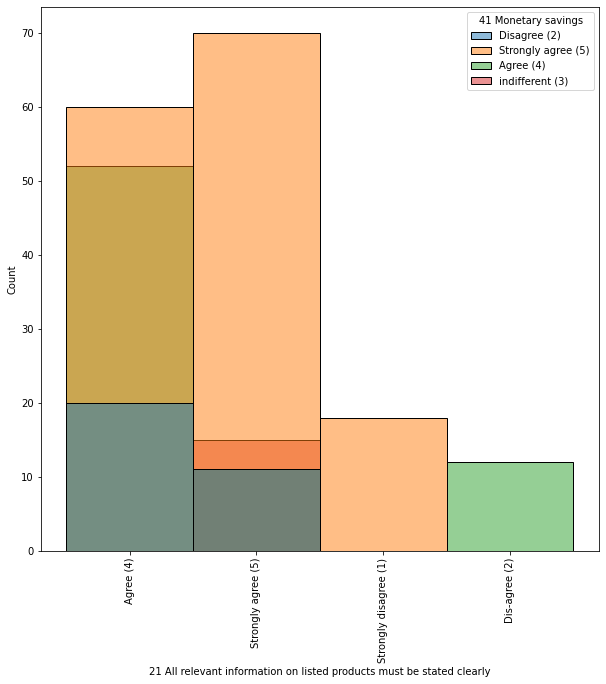

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

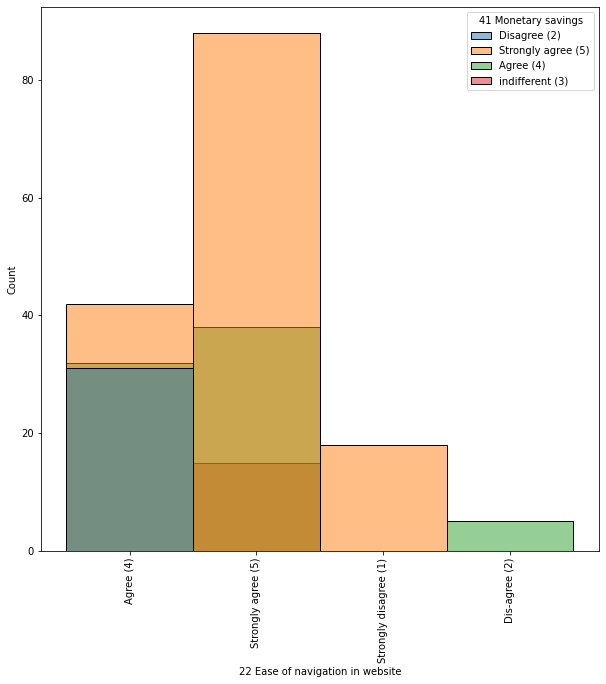

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

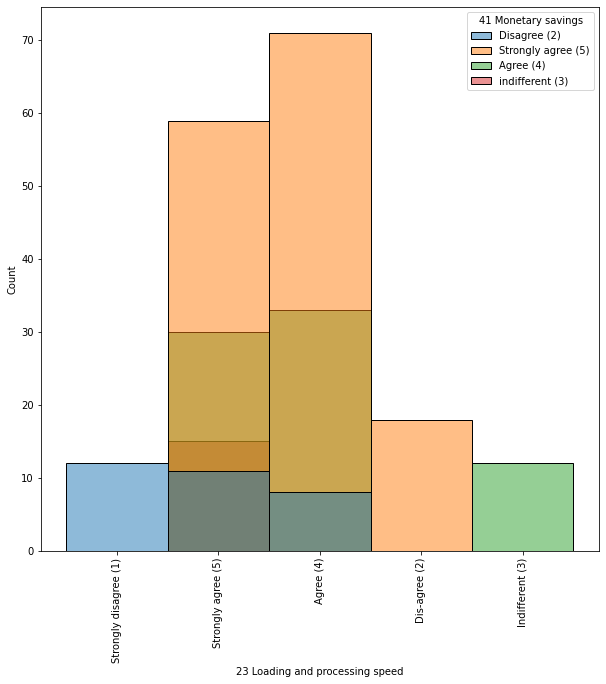

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

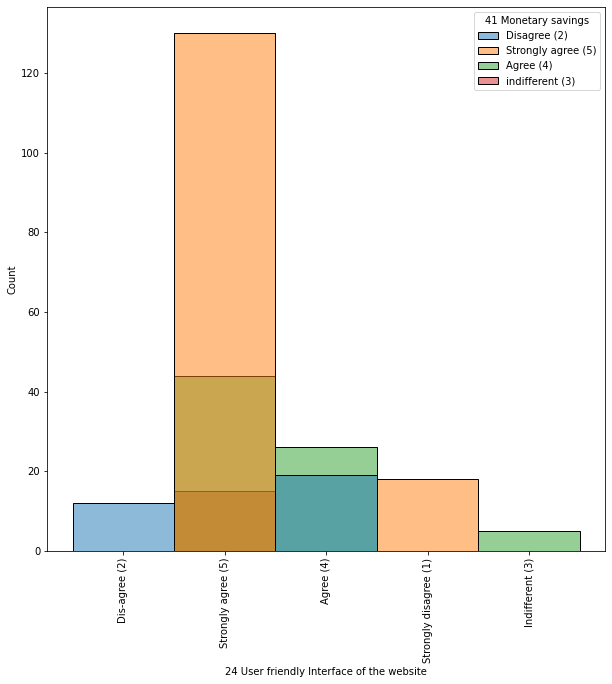

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

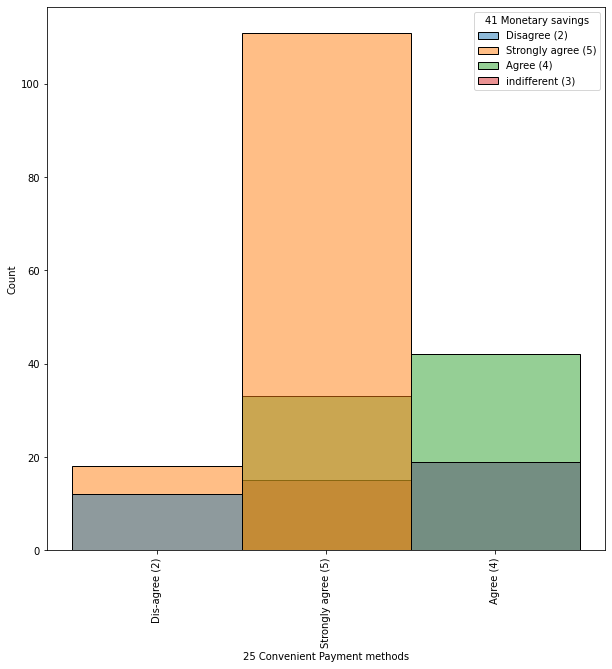

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

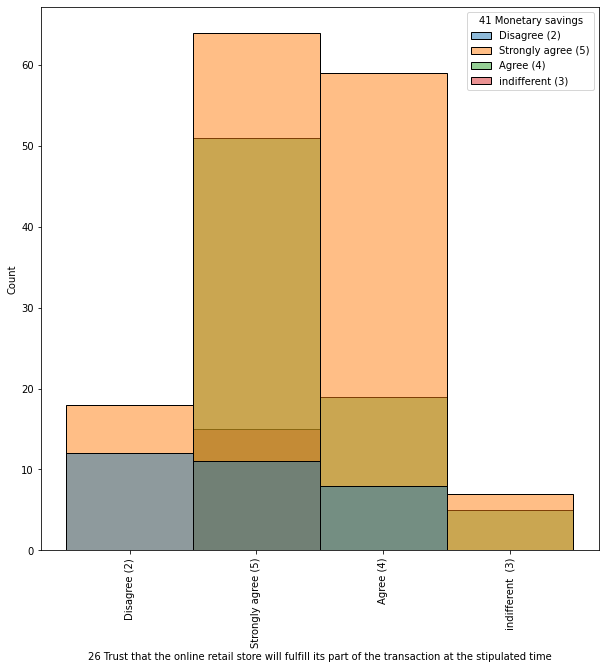

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

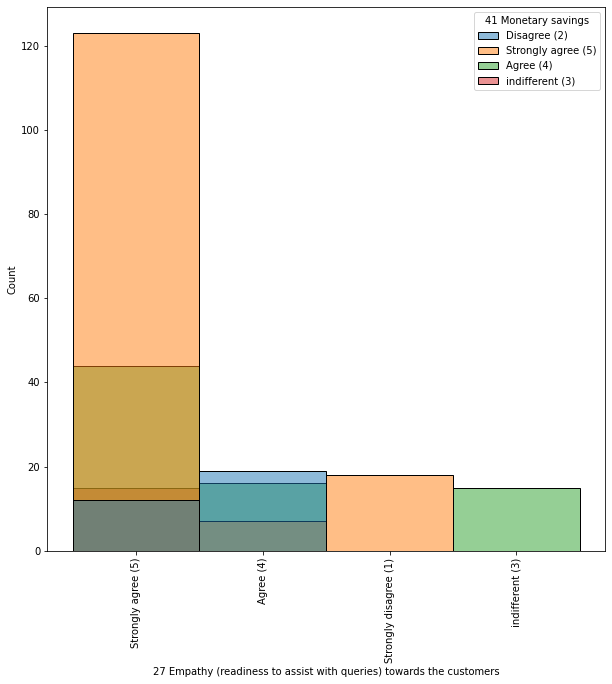

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

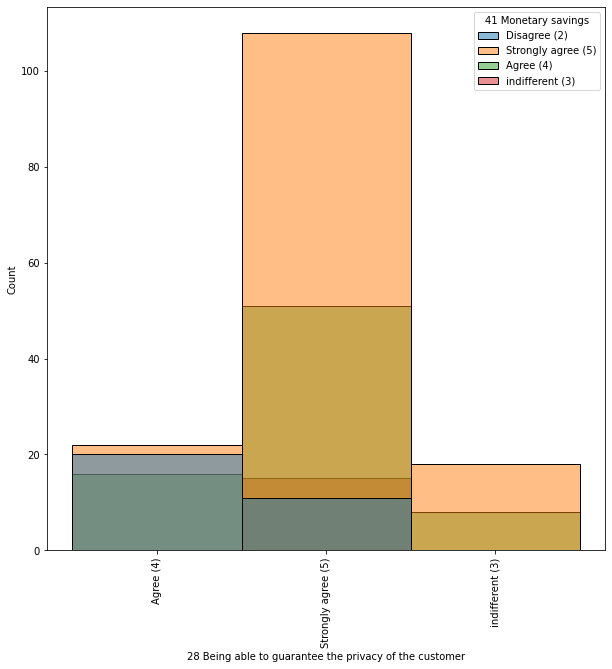

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

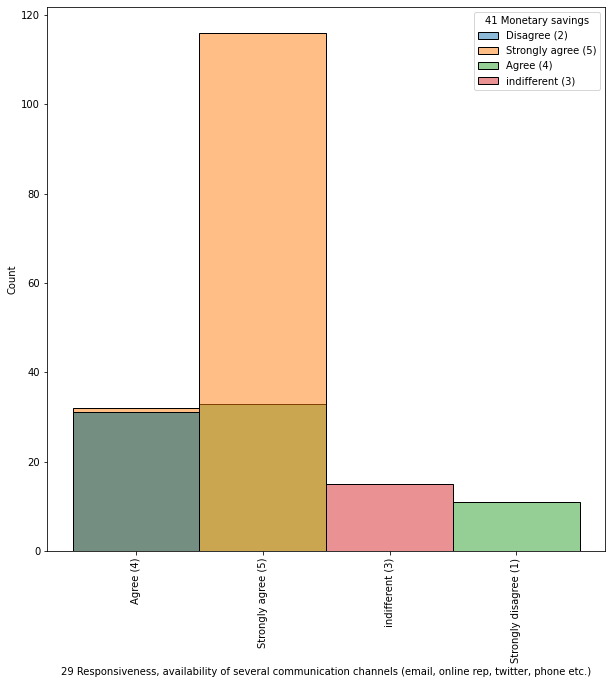

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

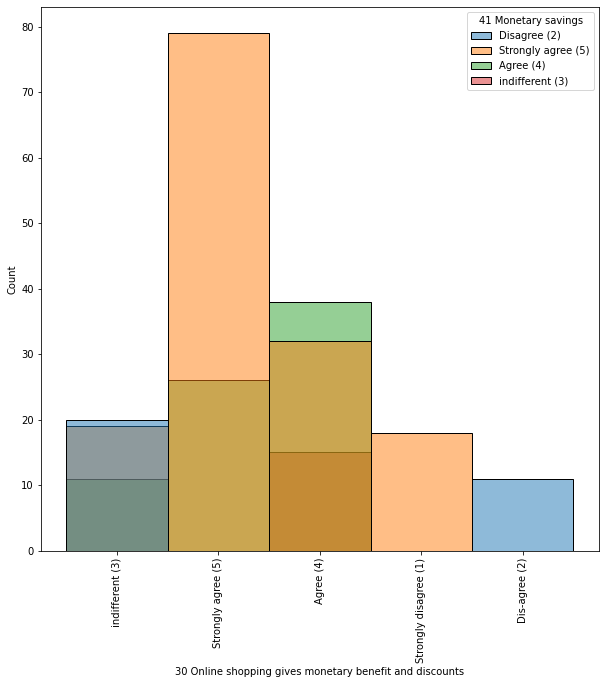

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

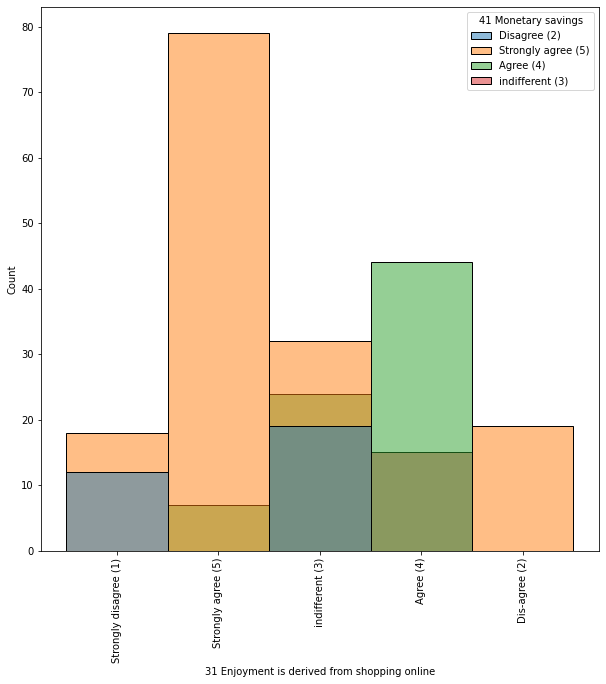

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

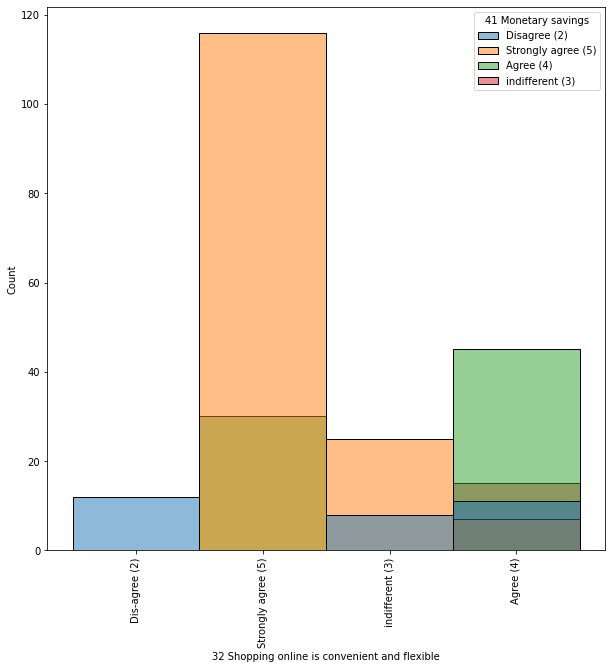

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

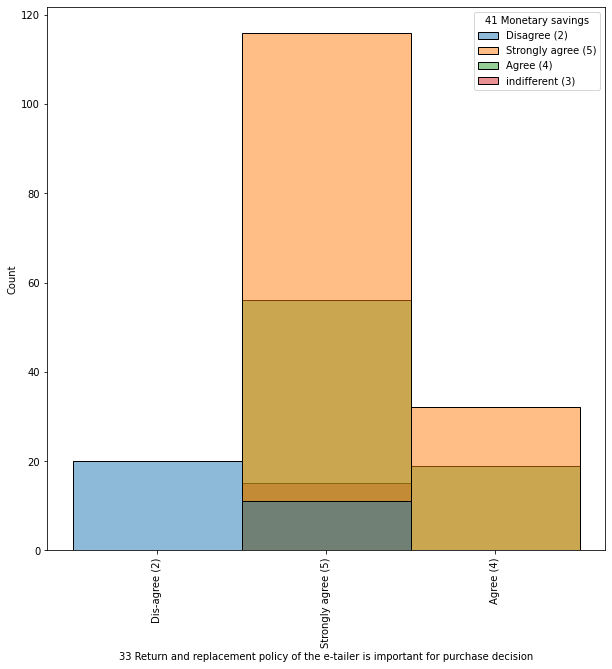

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

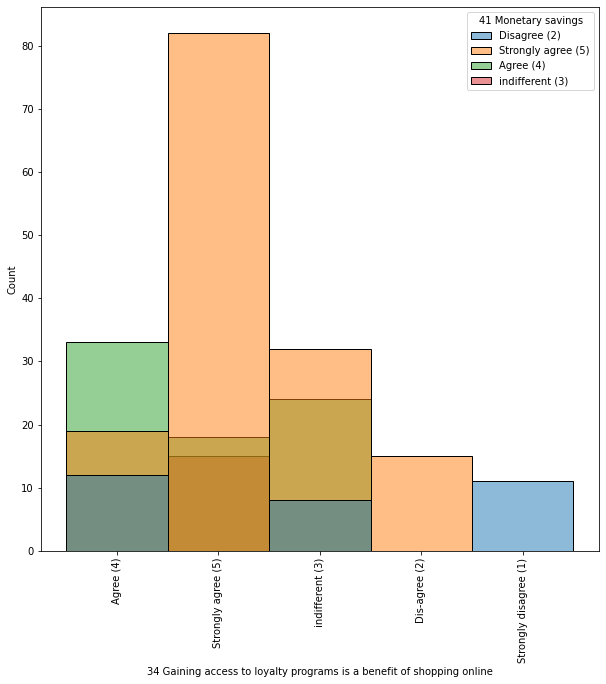

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

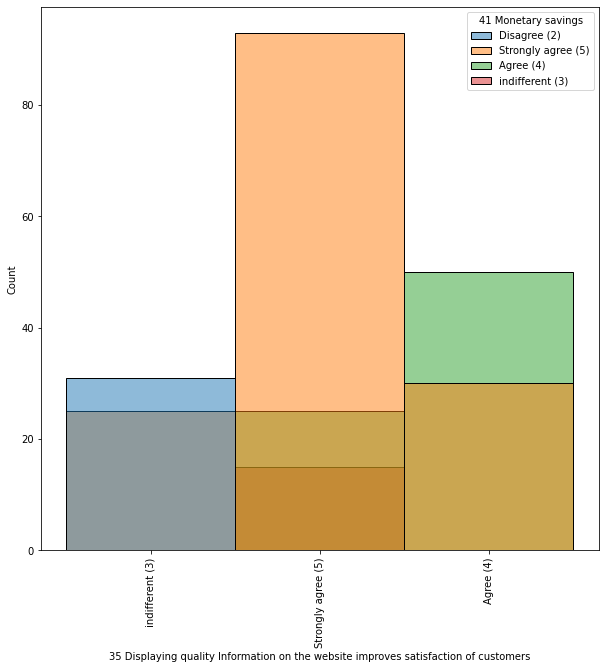

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

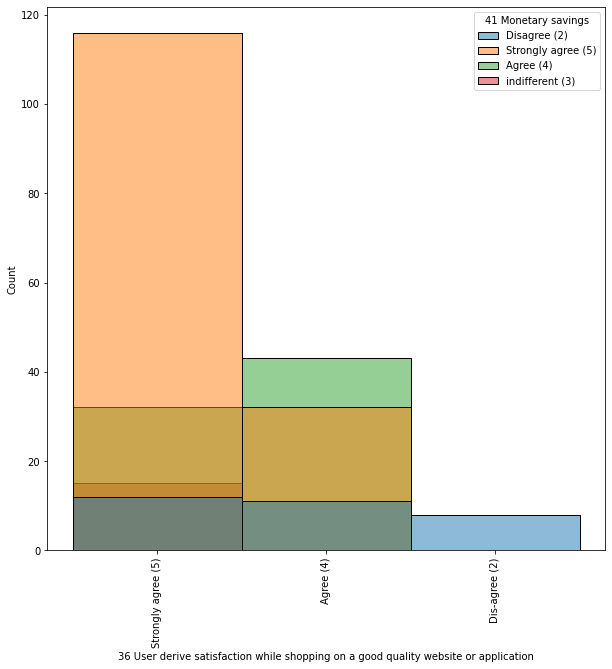

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

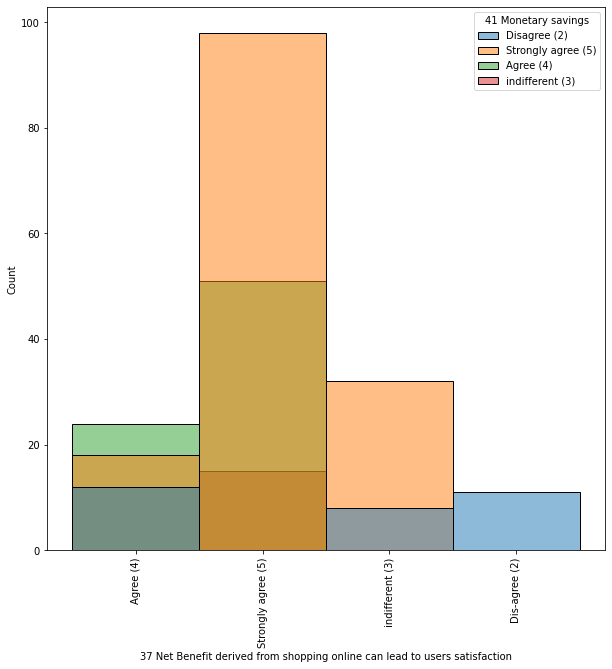

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

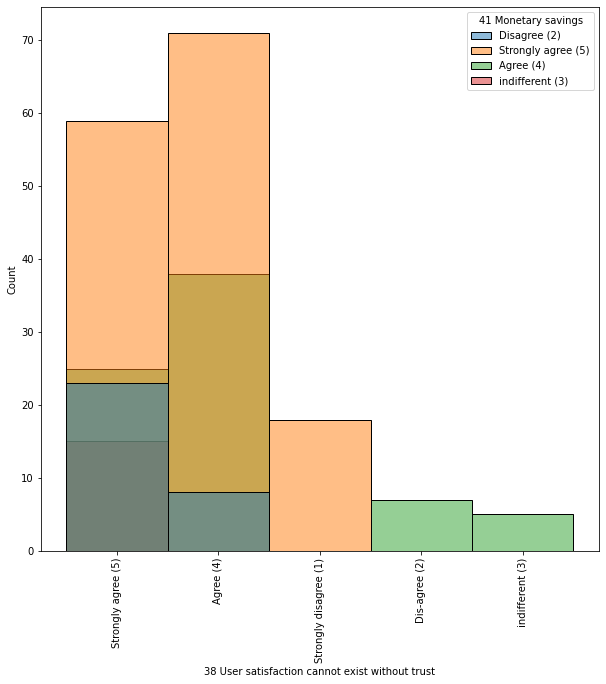

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

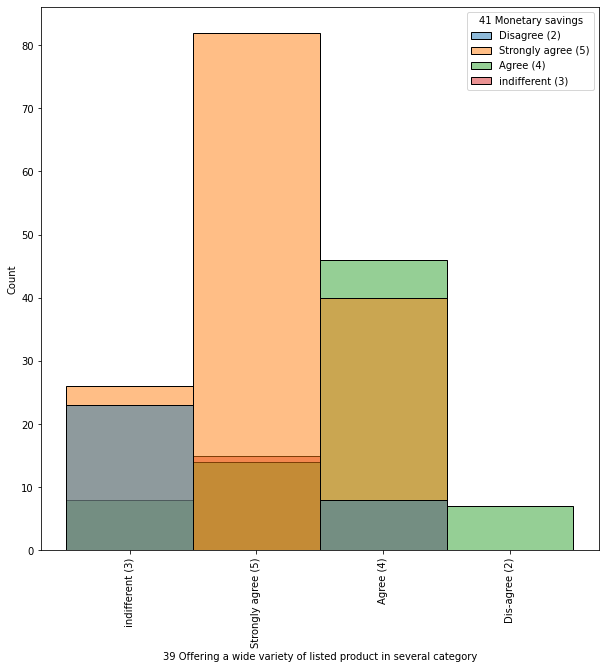

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

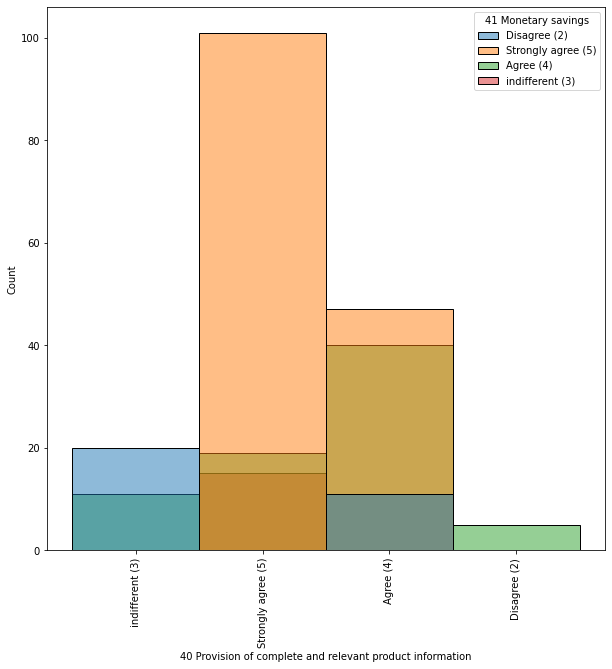

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

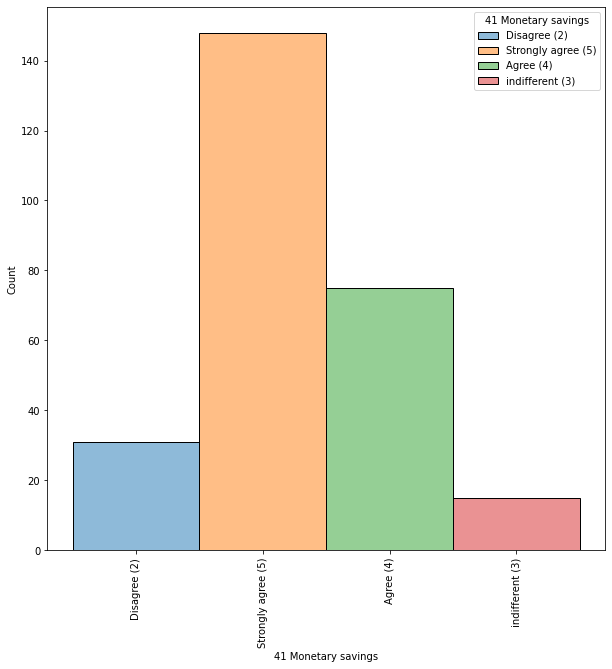

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

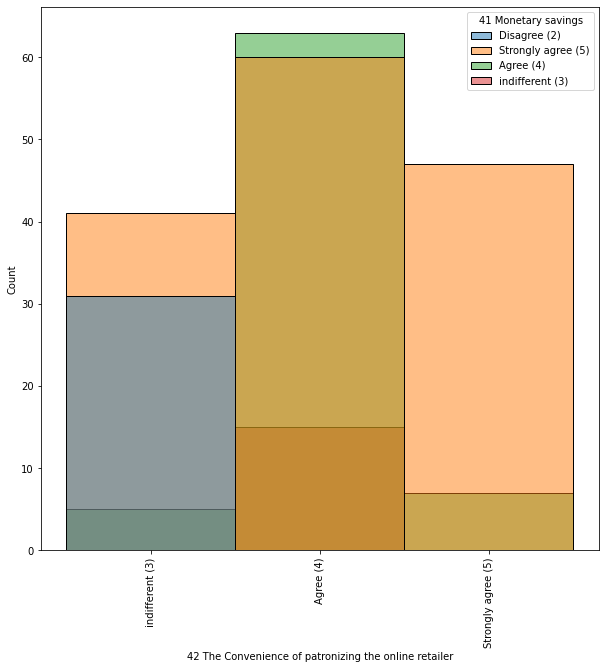

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

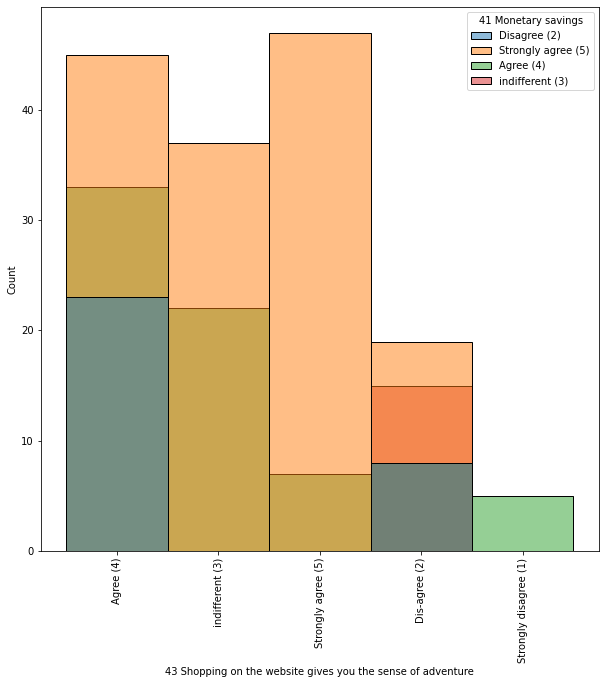

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

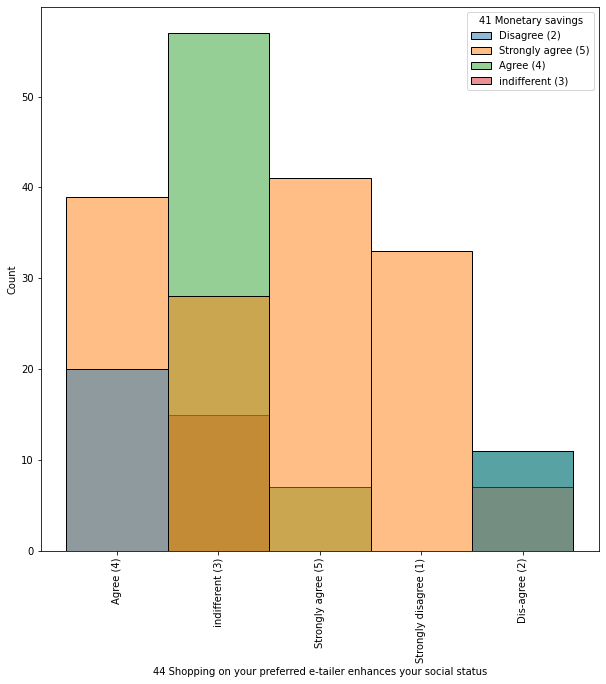

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

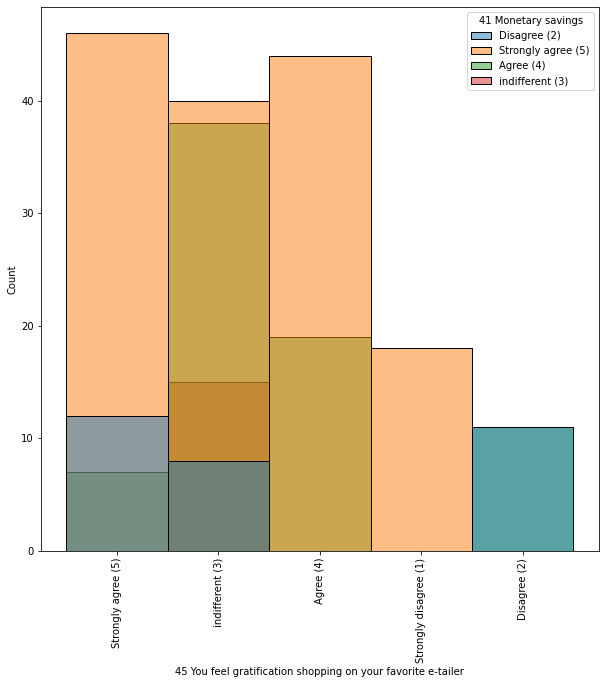

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

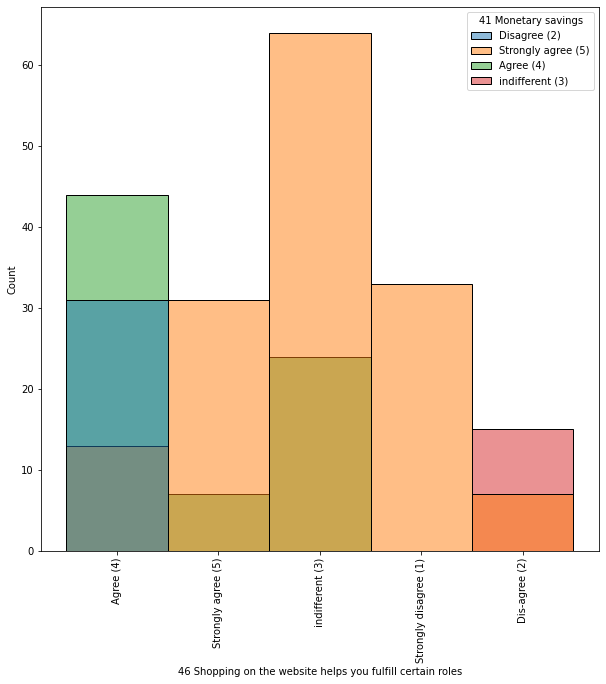

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

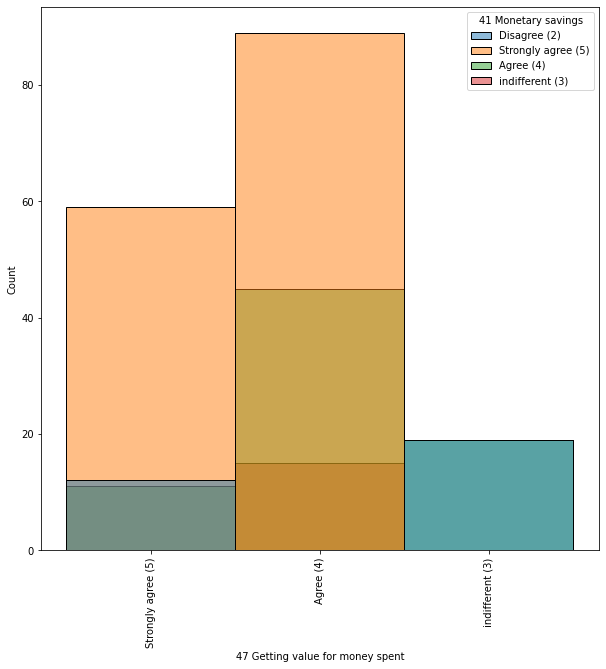

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

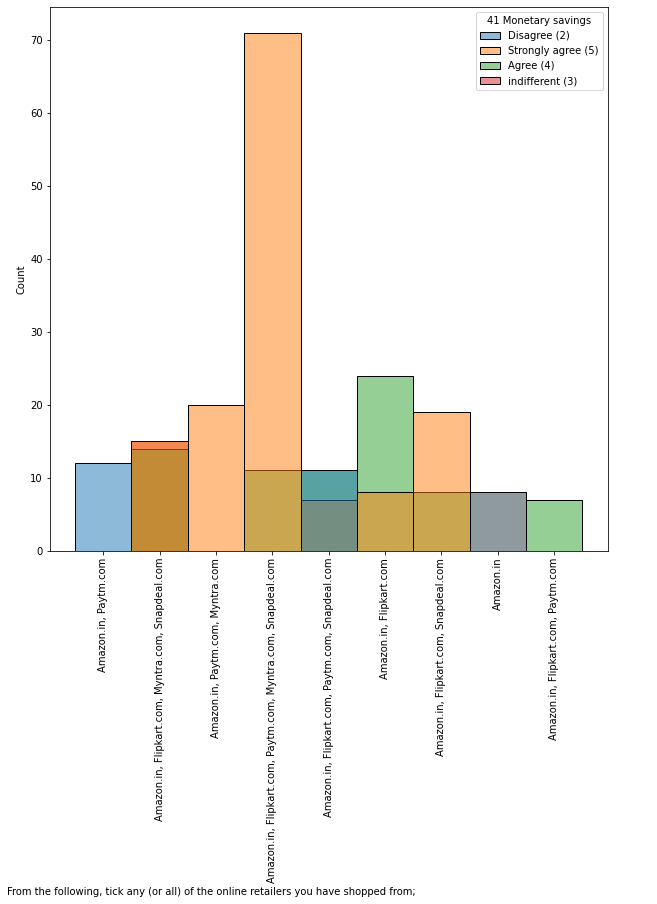

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

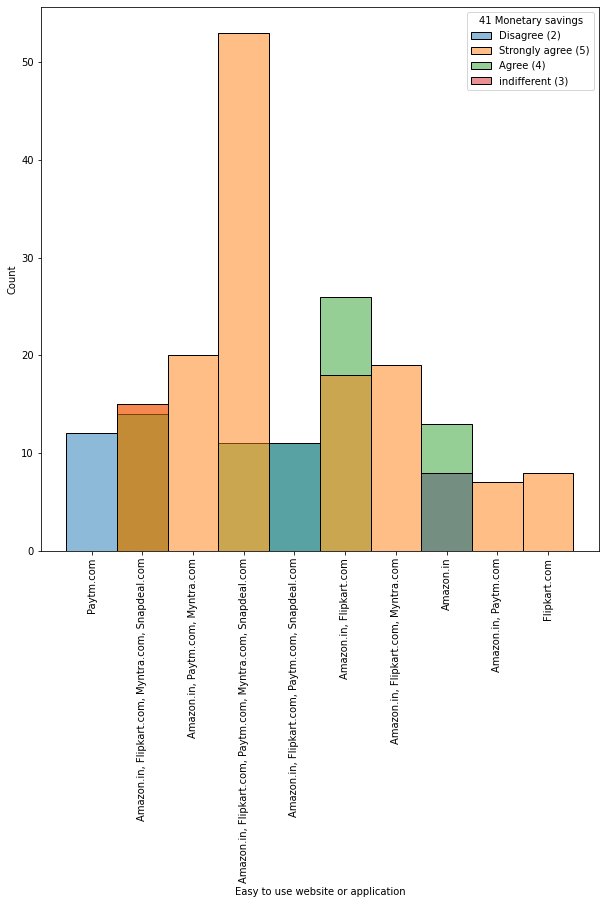

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

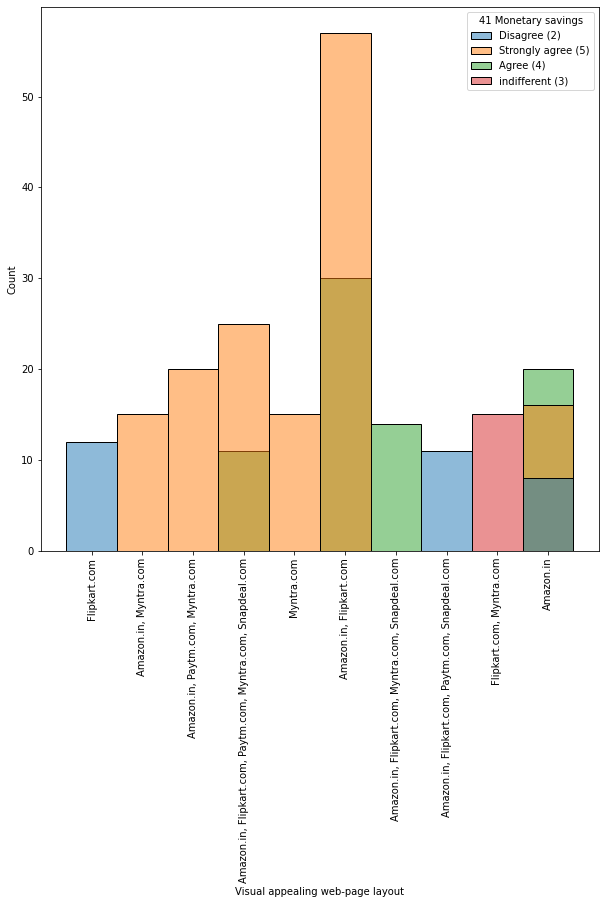

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

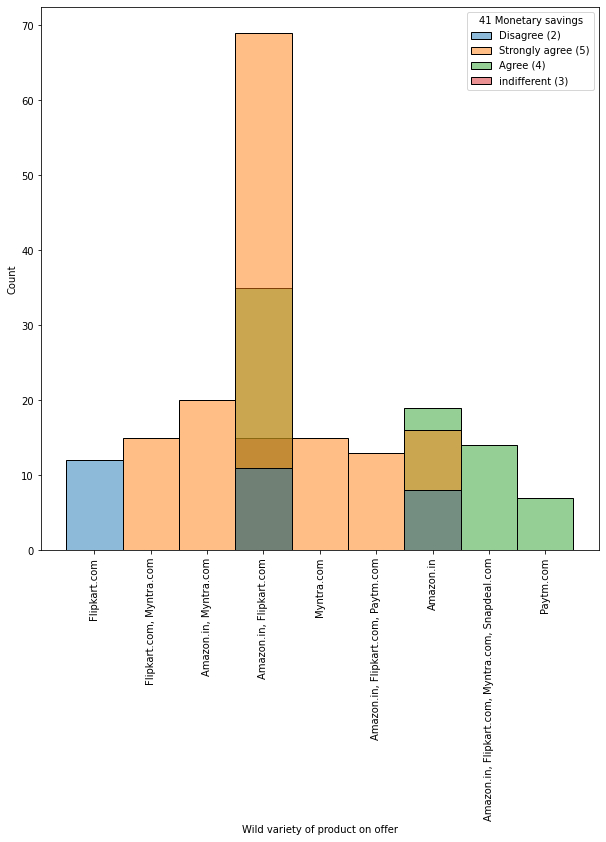

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

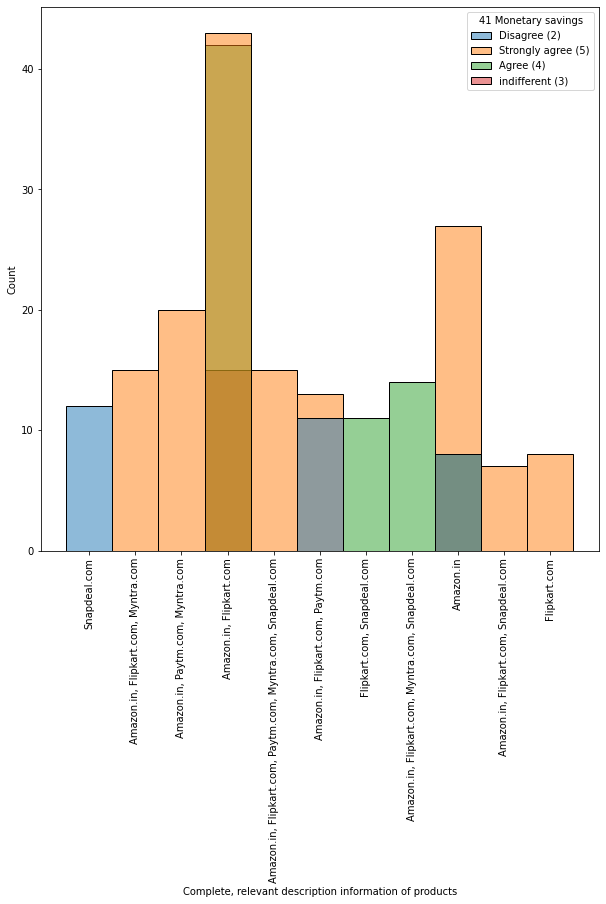

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

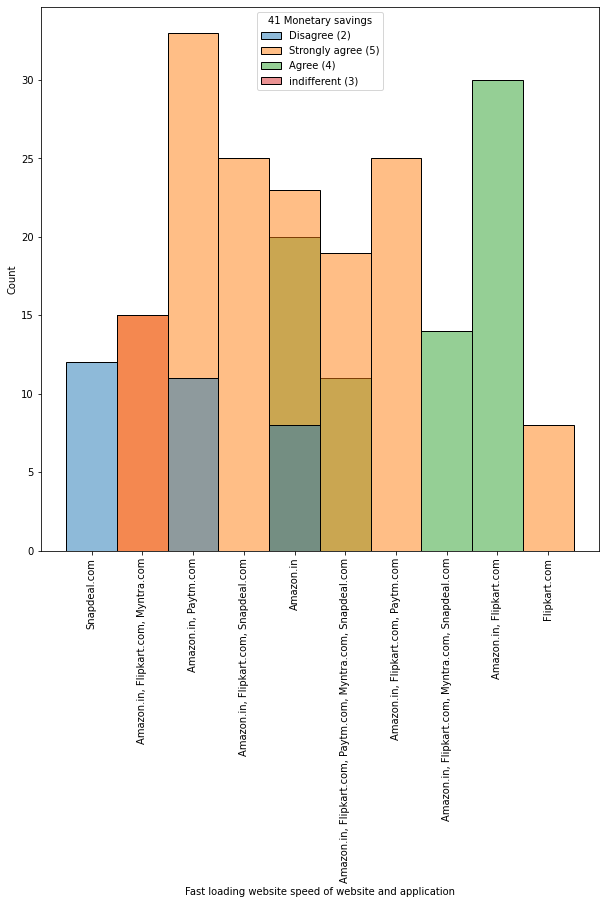

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

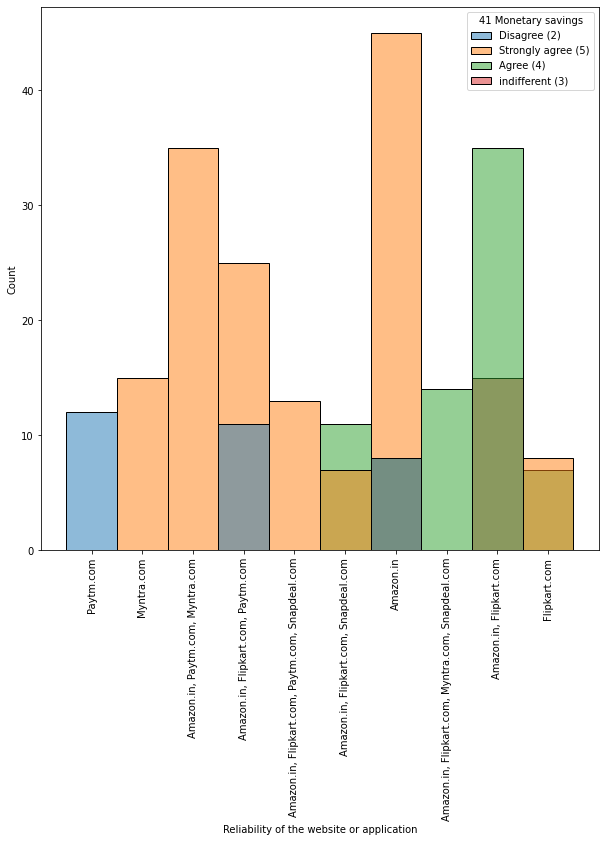

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

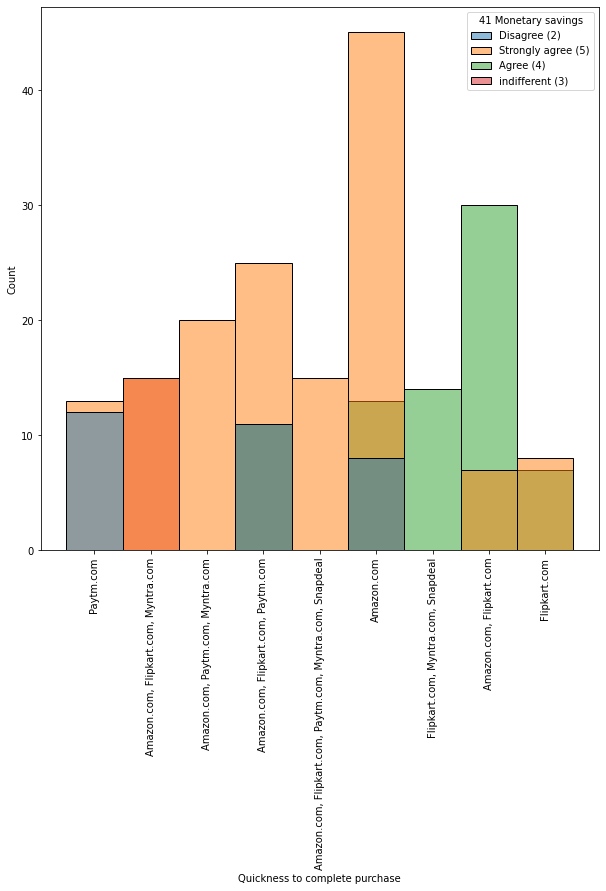

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

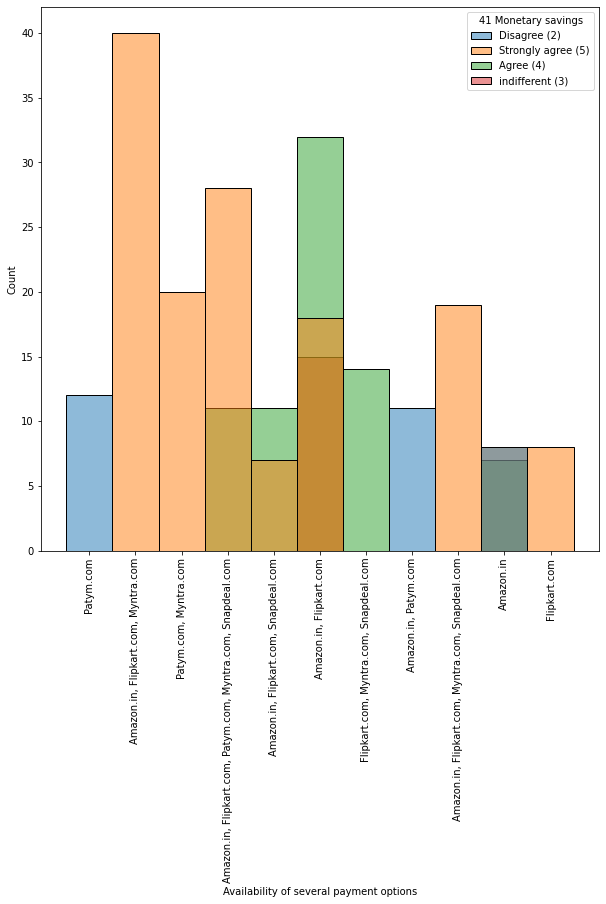

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

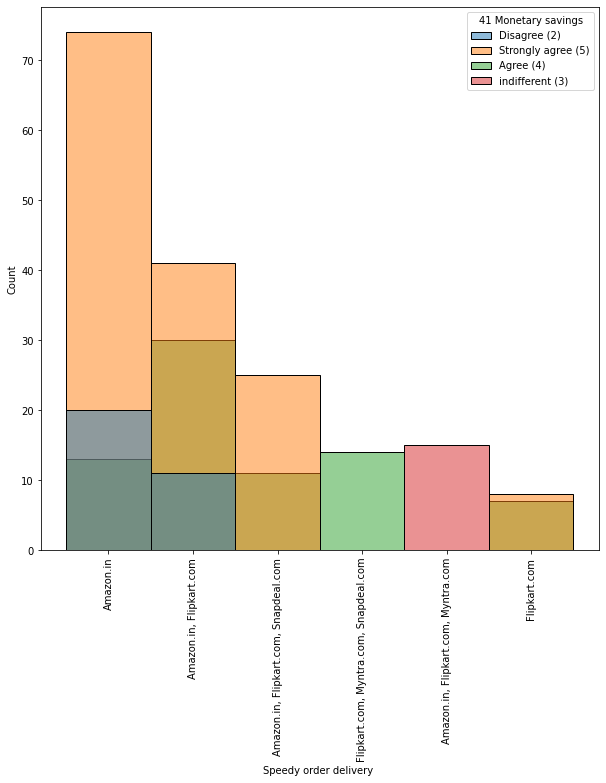

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

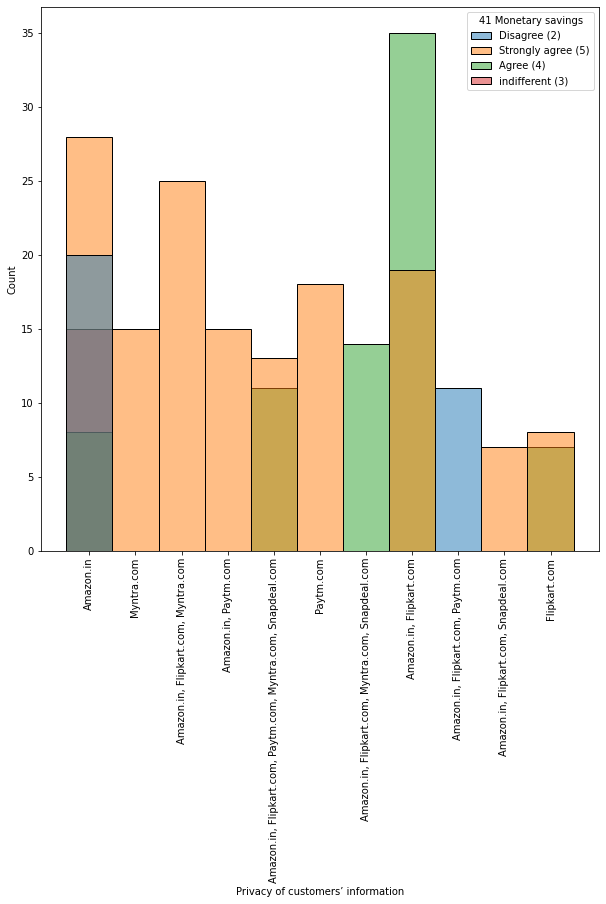

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

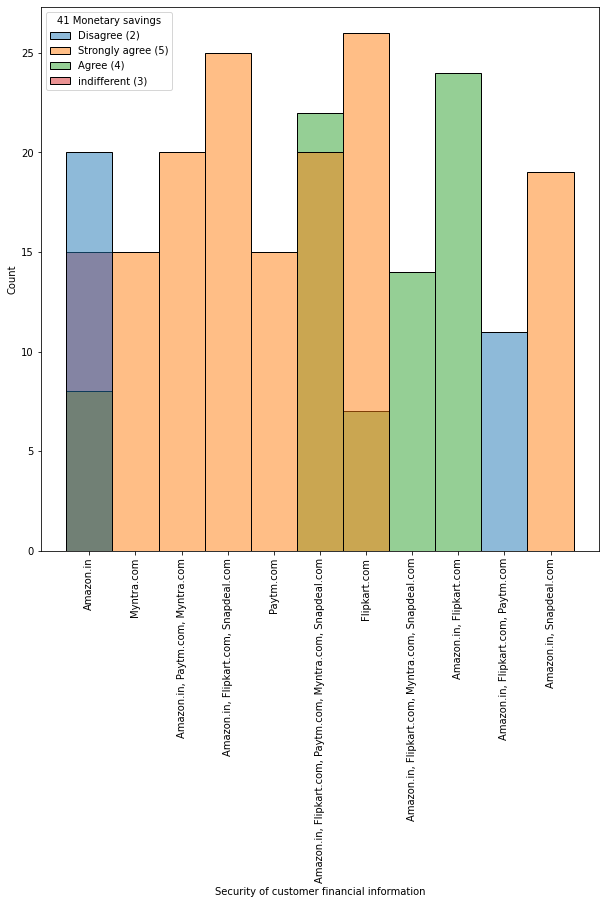

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

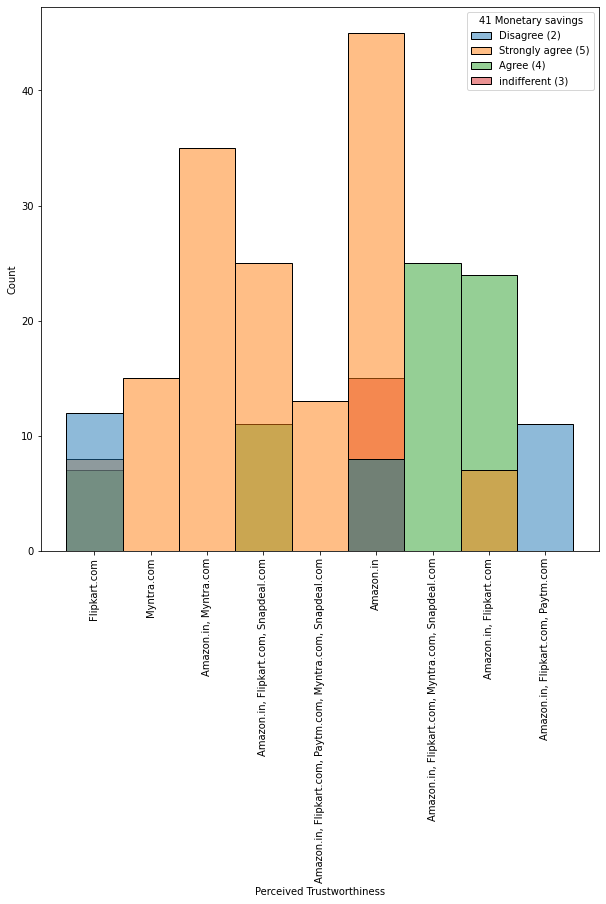

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

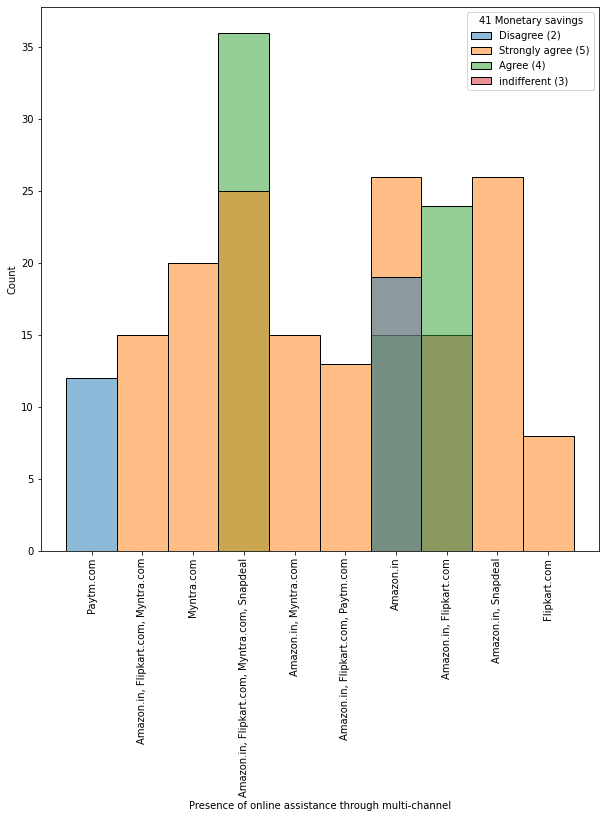

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

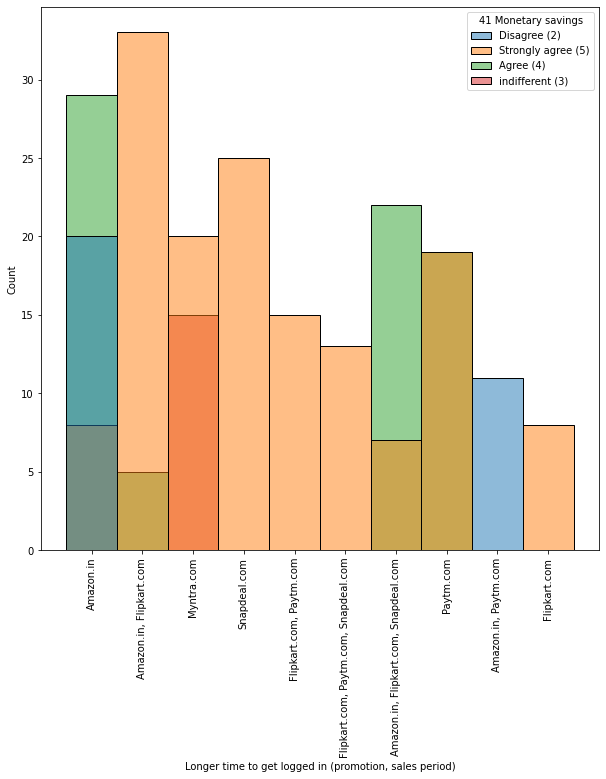

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

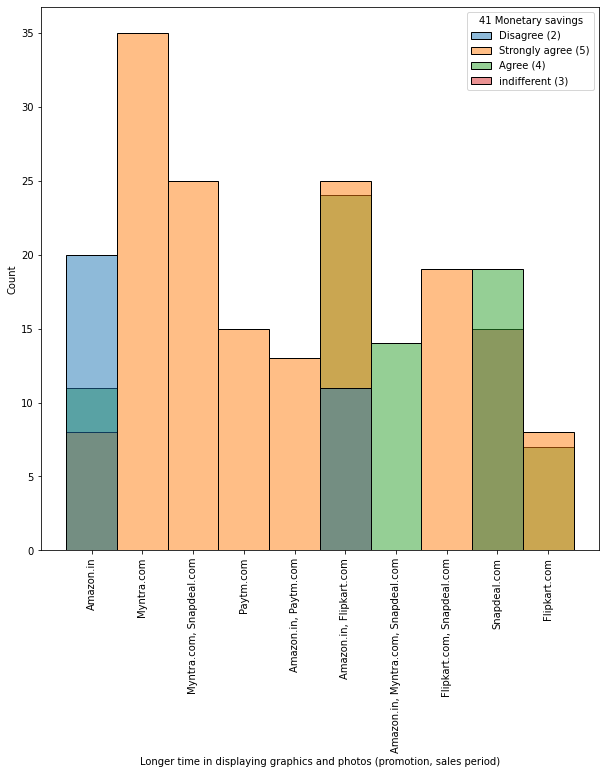

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

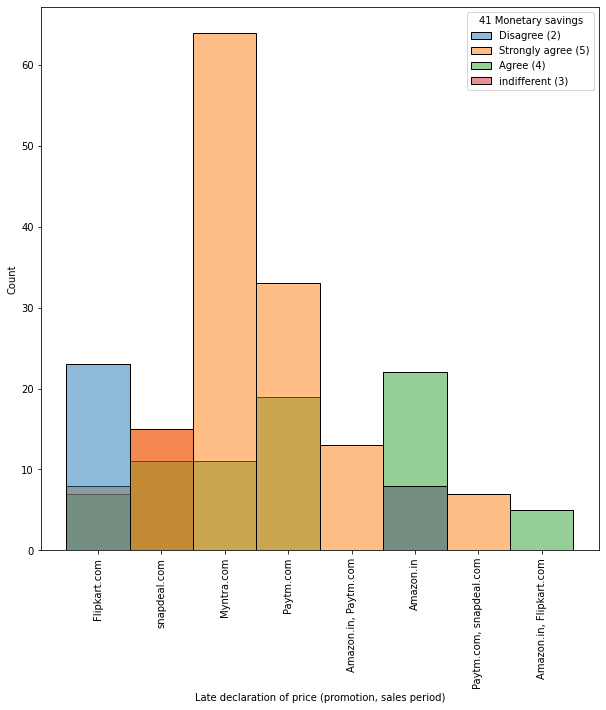

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

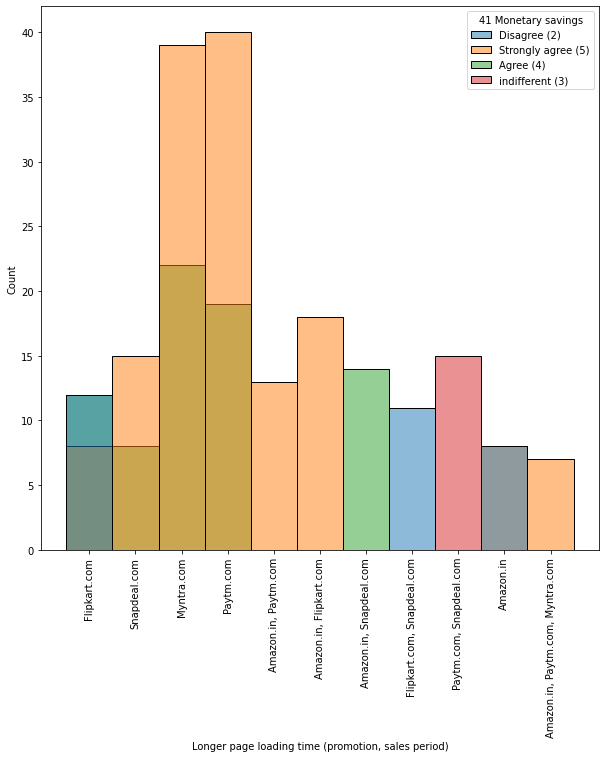

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

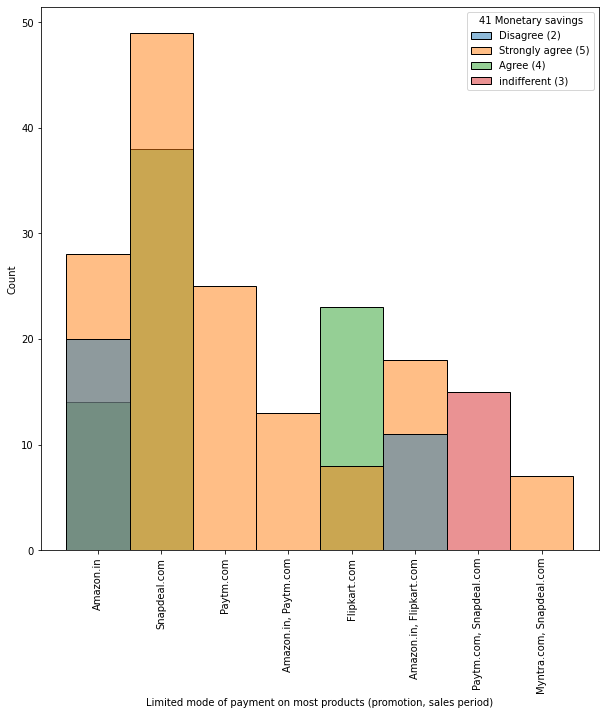

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

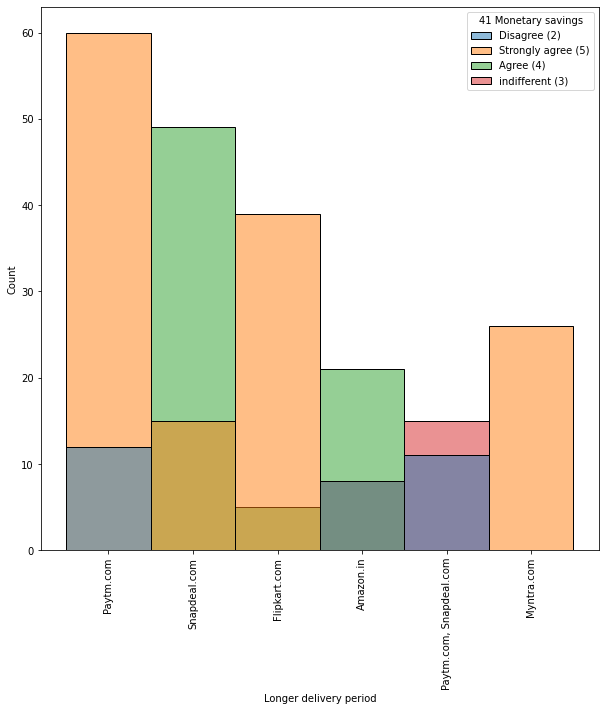

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

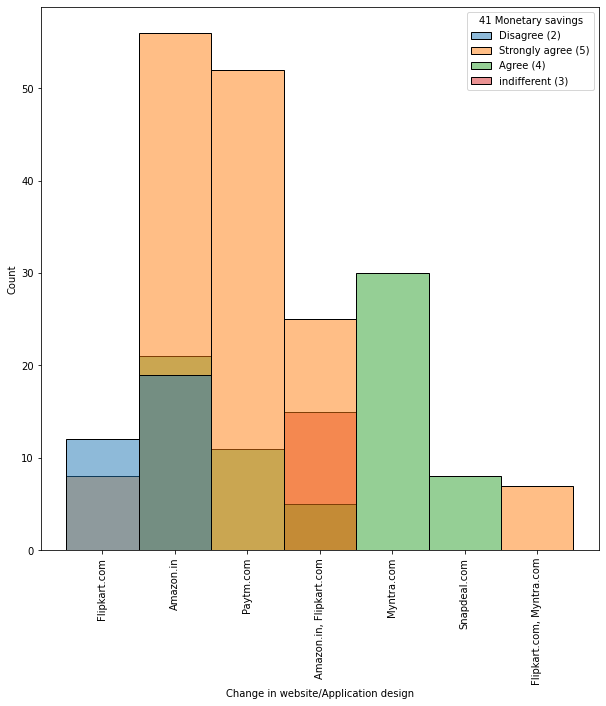

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

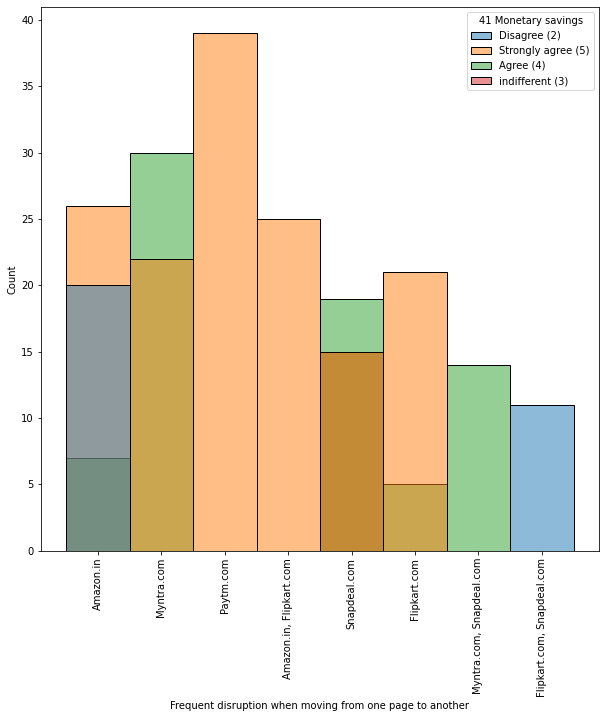

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

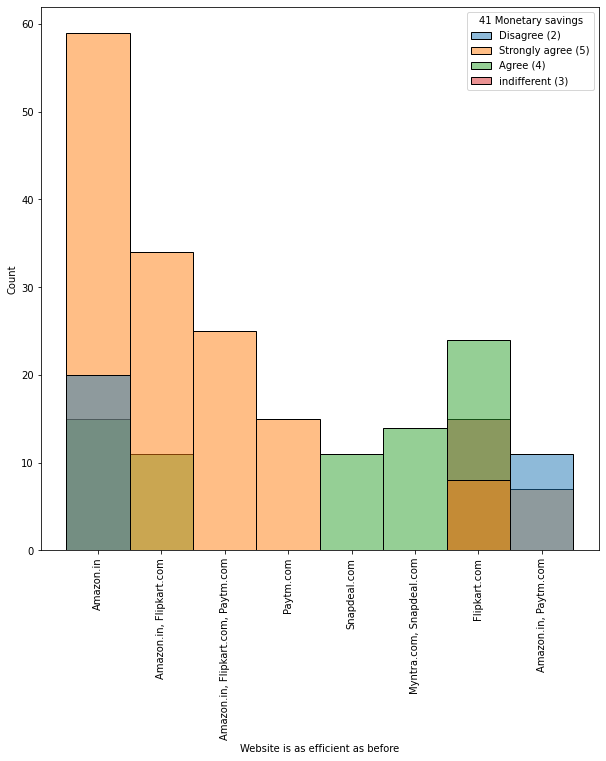

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

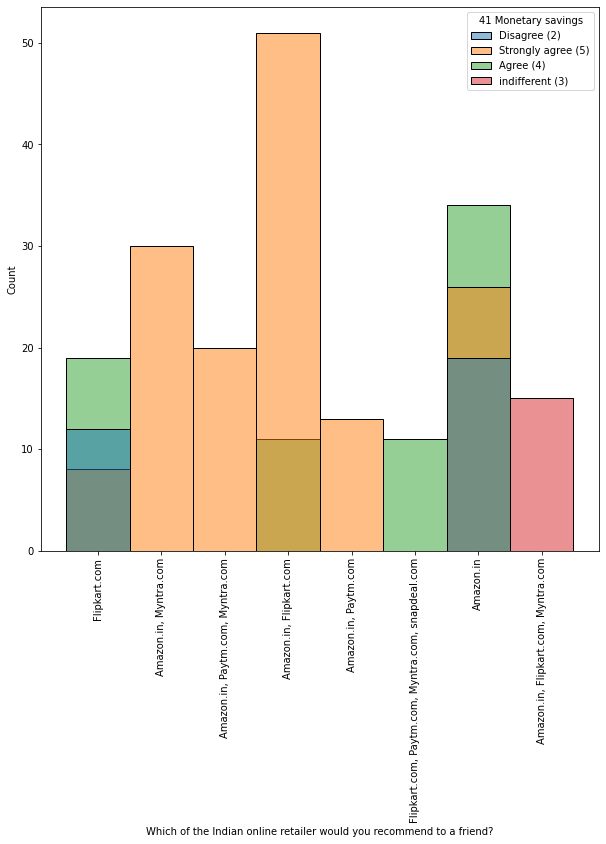

In [16]:
# Histogram with respect to Monetary Savings
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['41 Monetary savings'])
    plt.xticks(rotation ='90')
    plt.show()

Respondants strongly agree that 'Monetary savings' are important

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

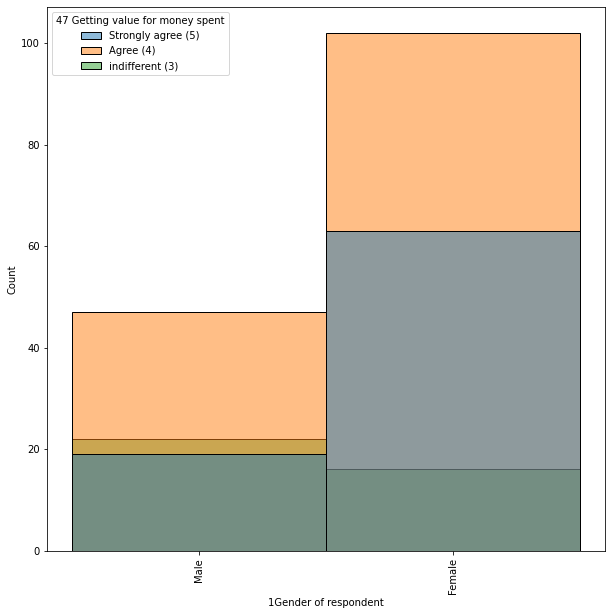

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

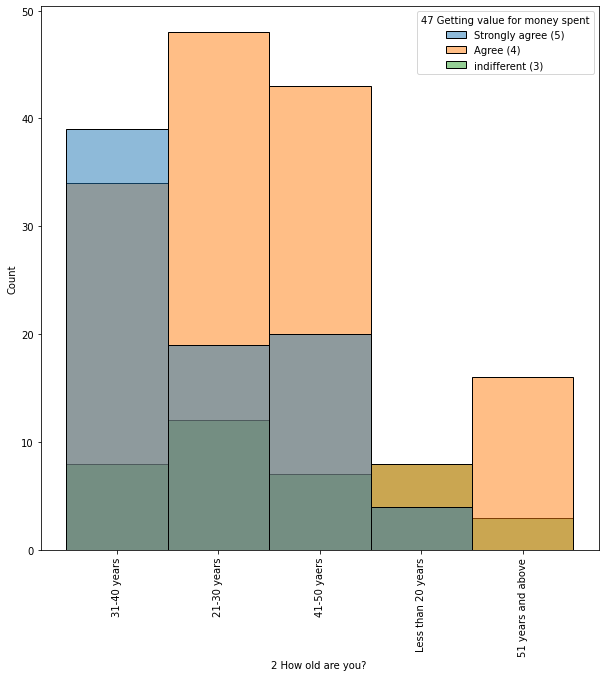

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

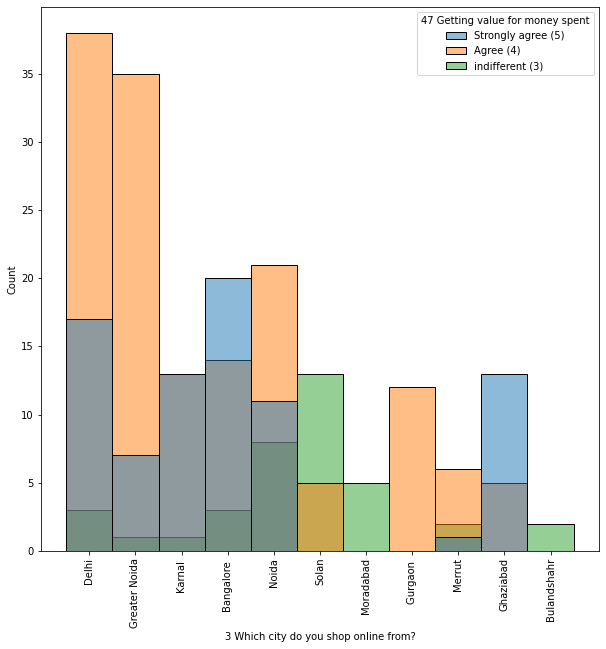

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

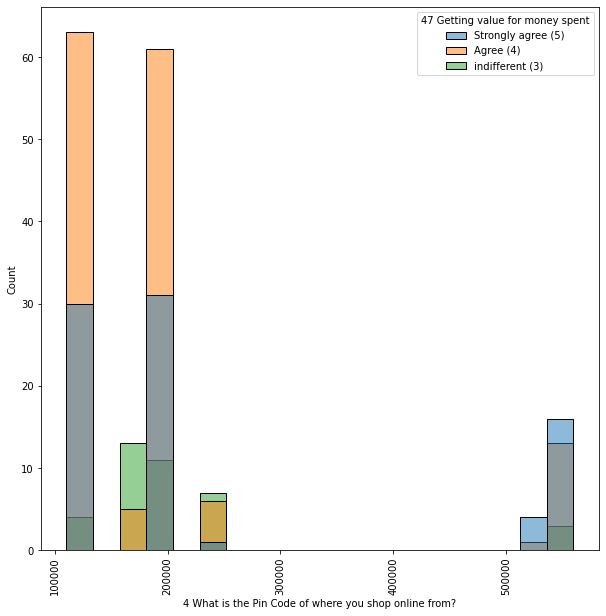

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

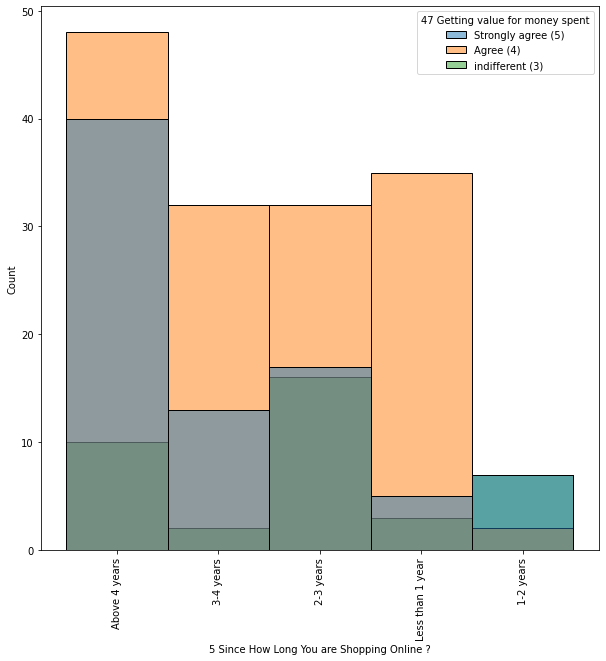

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

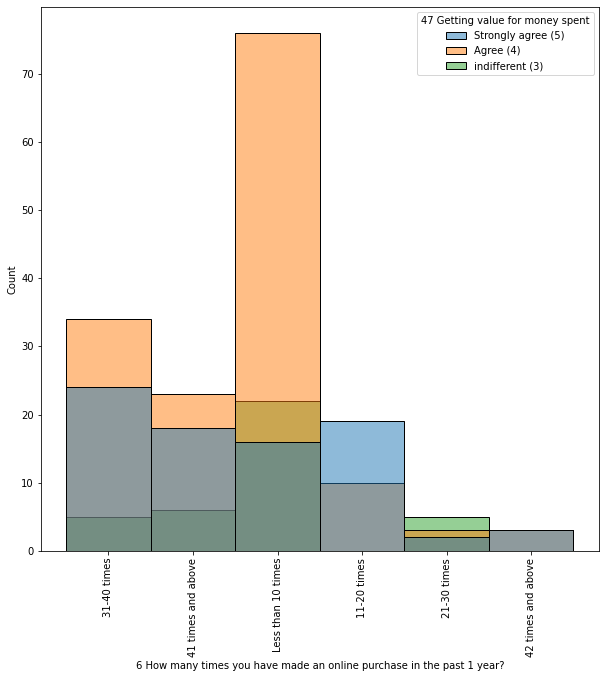

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

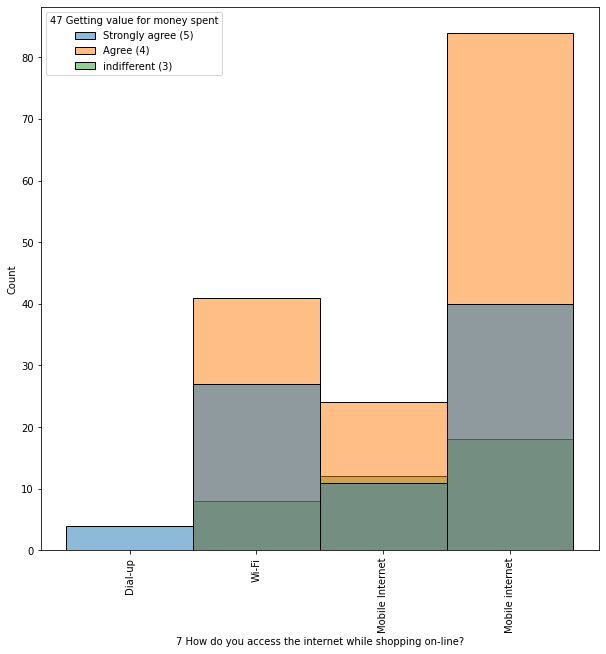

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

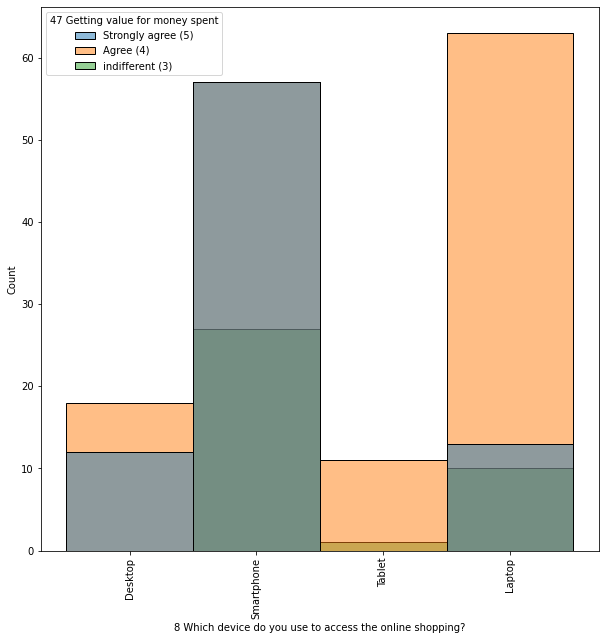

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

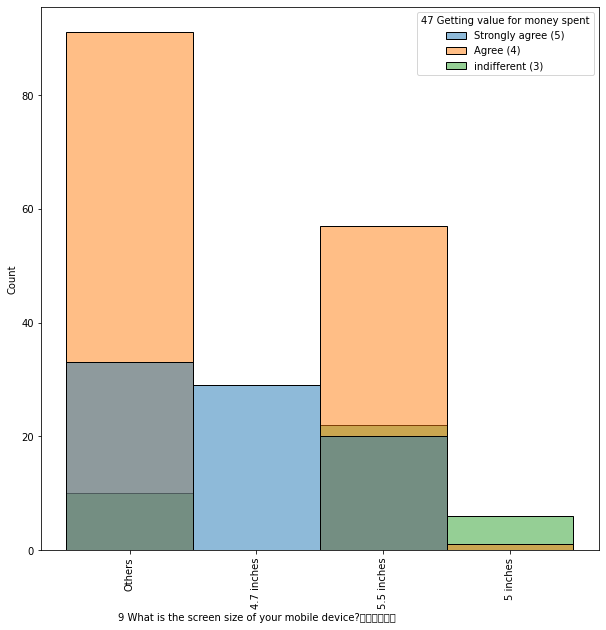

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

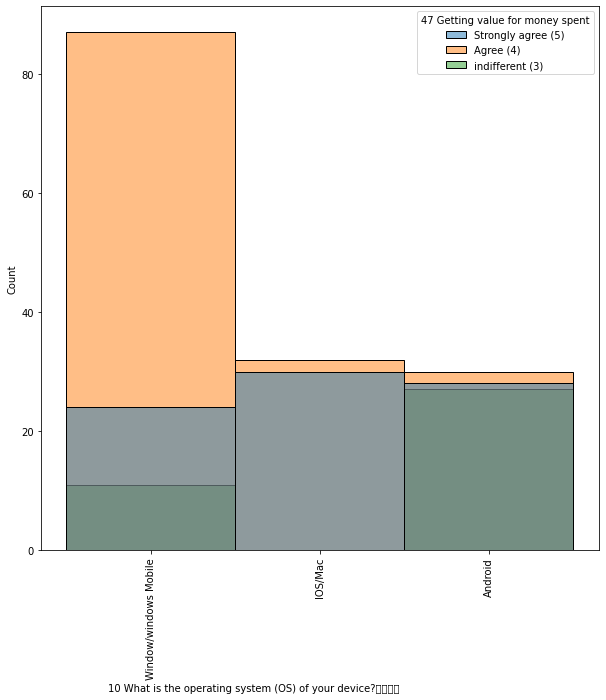

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

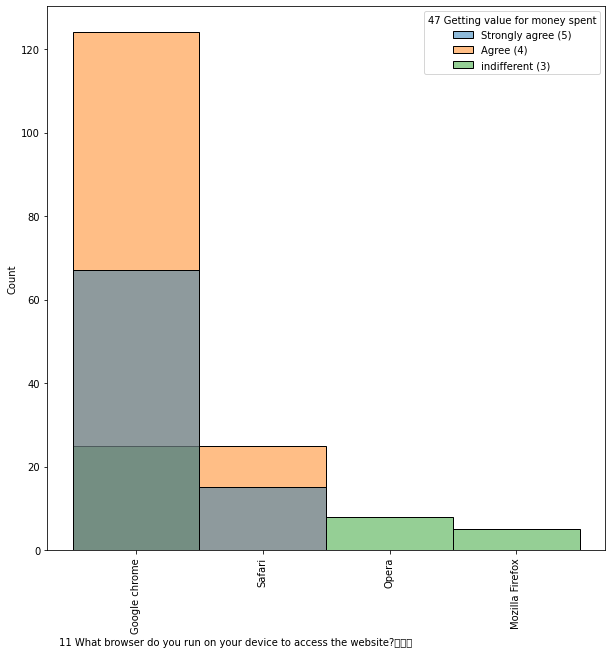

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

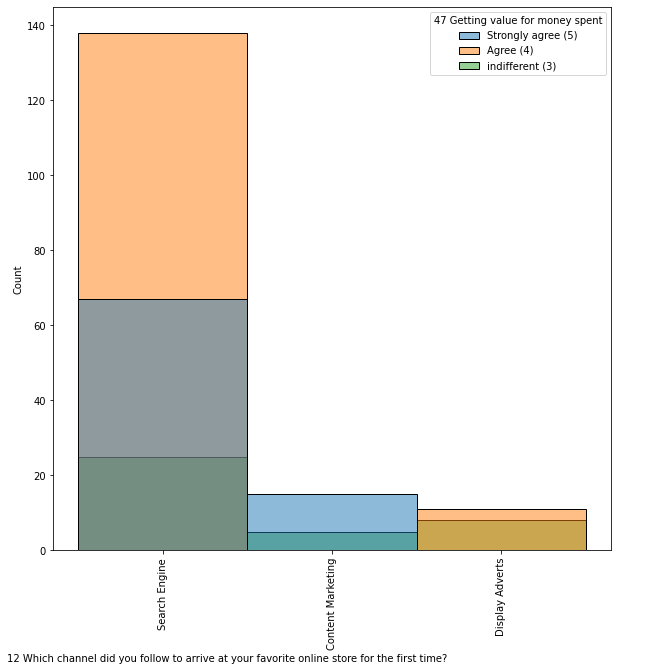

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

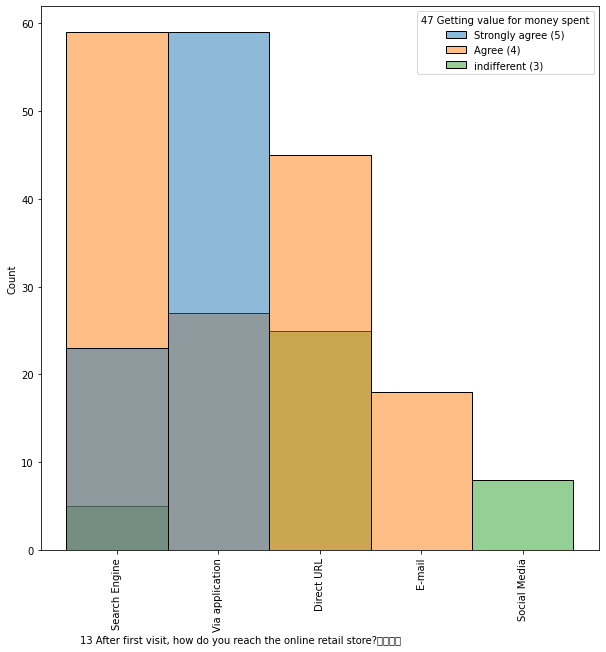

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

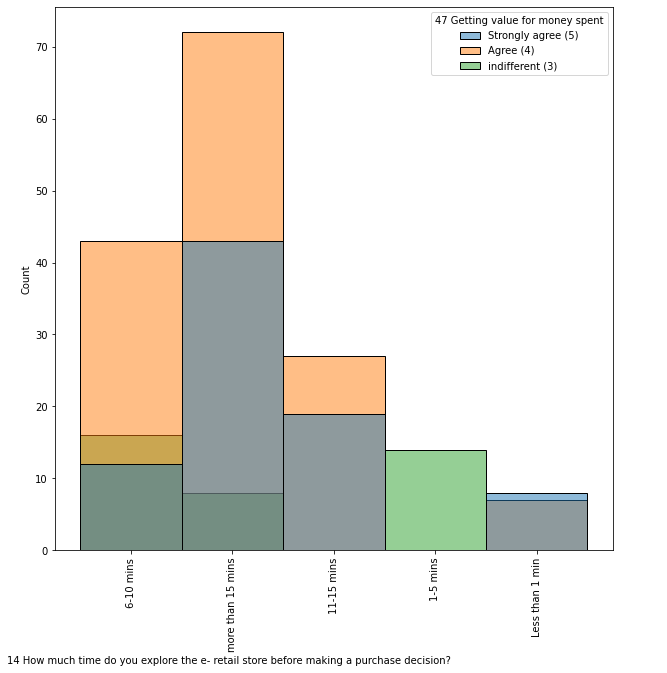

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

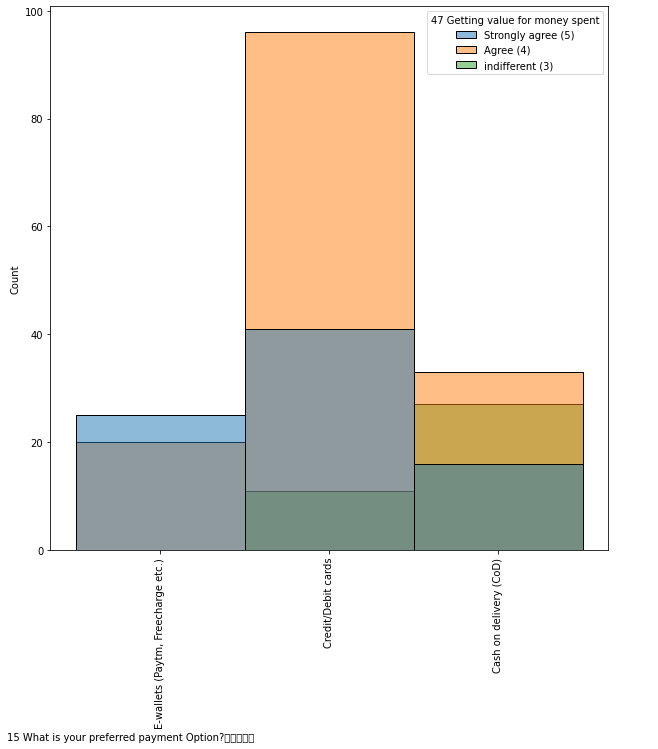

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

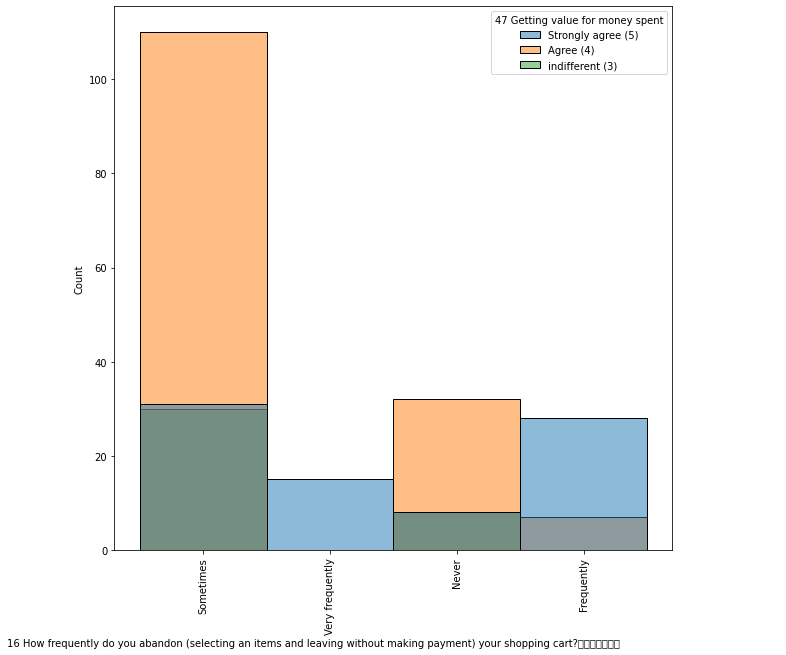

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

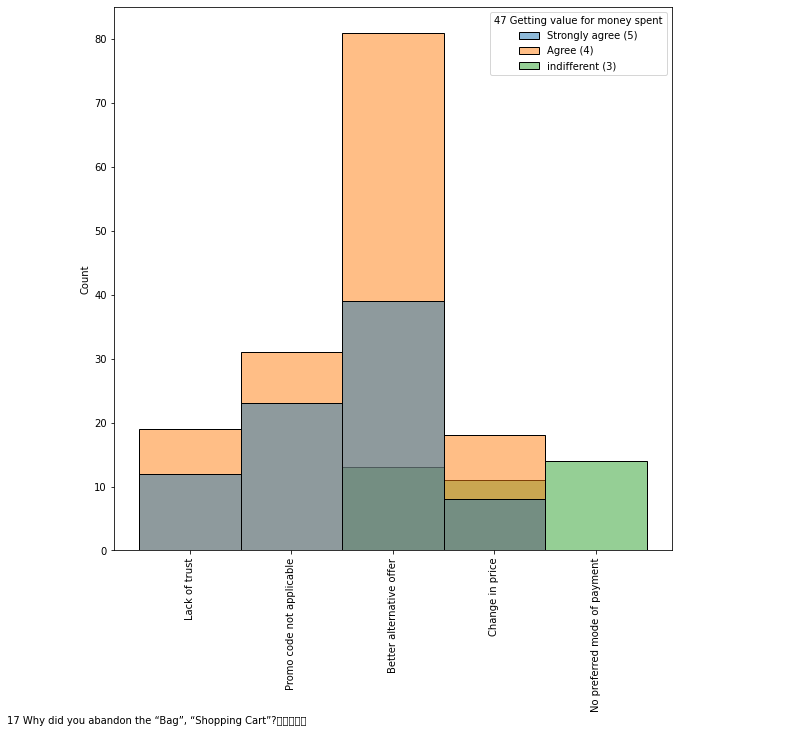

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

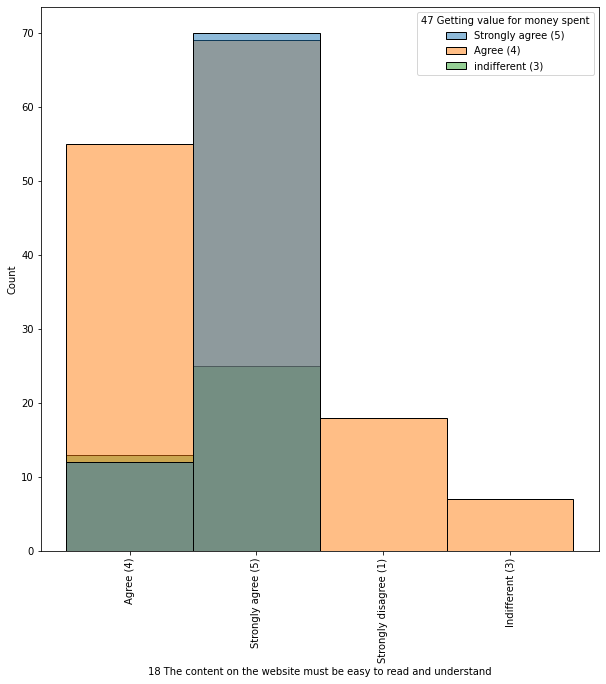

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

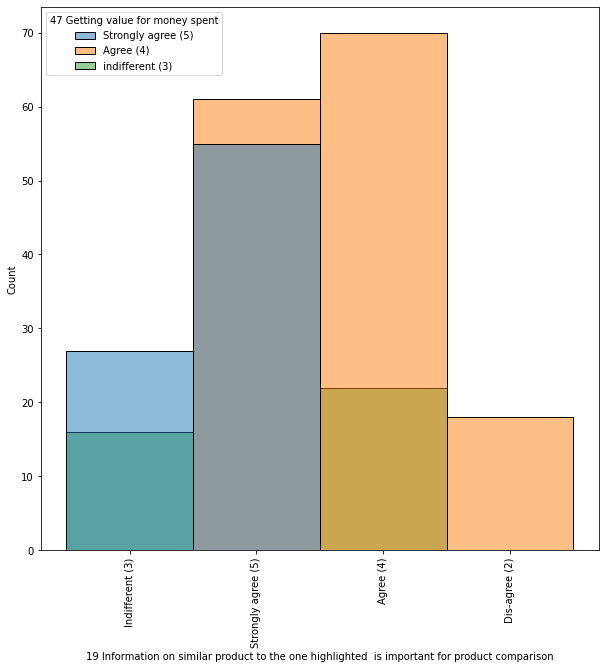

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

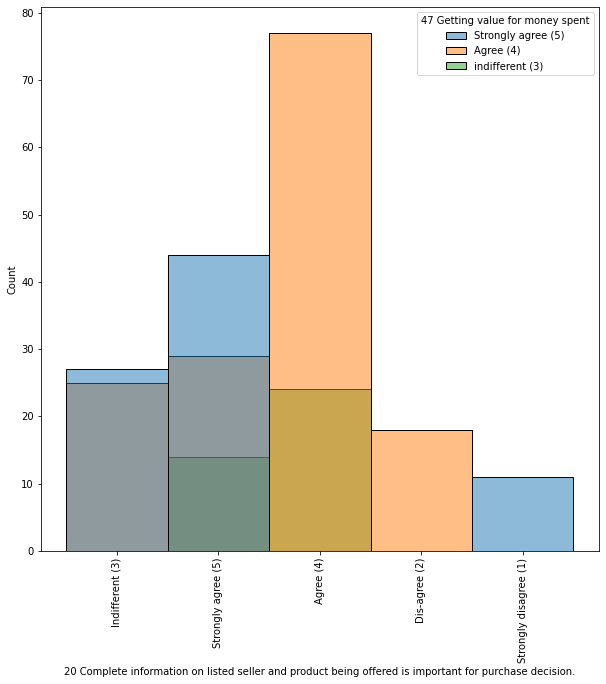

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

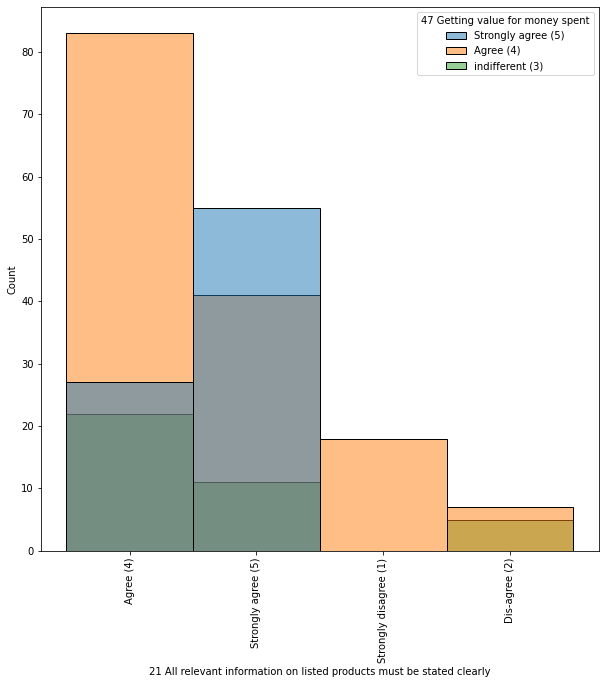

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

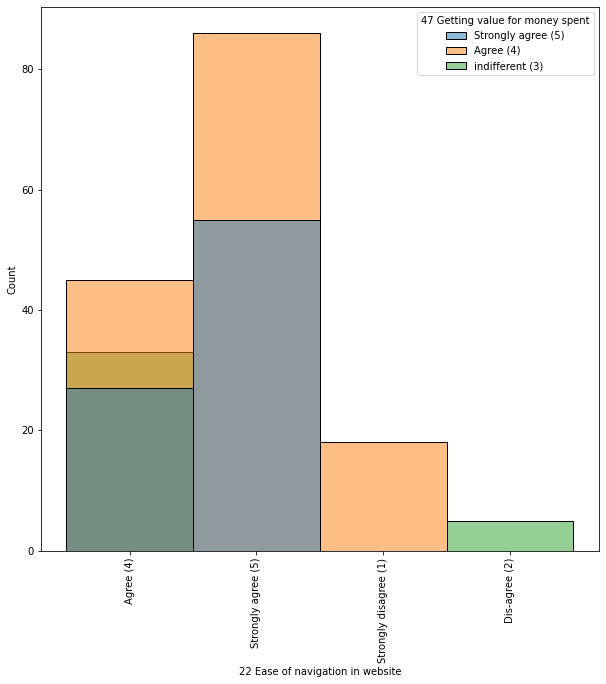

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

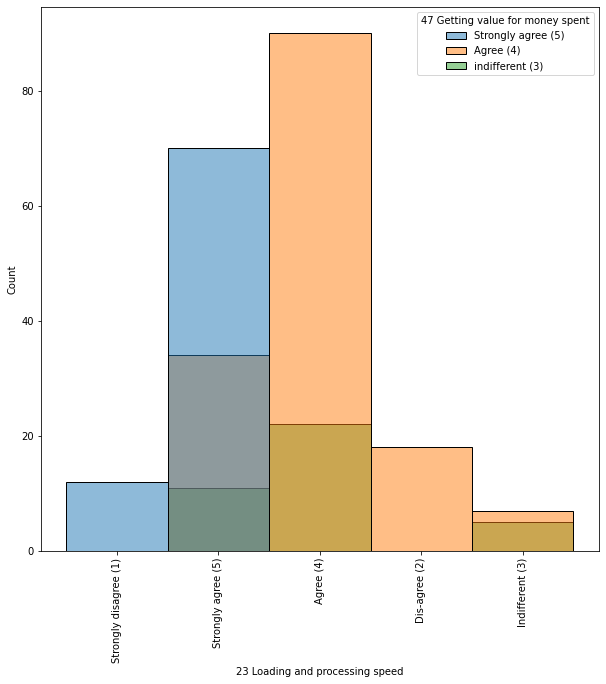

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

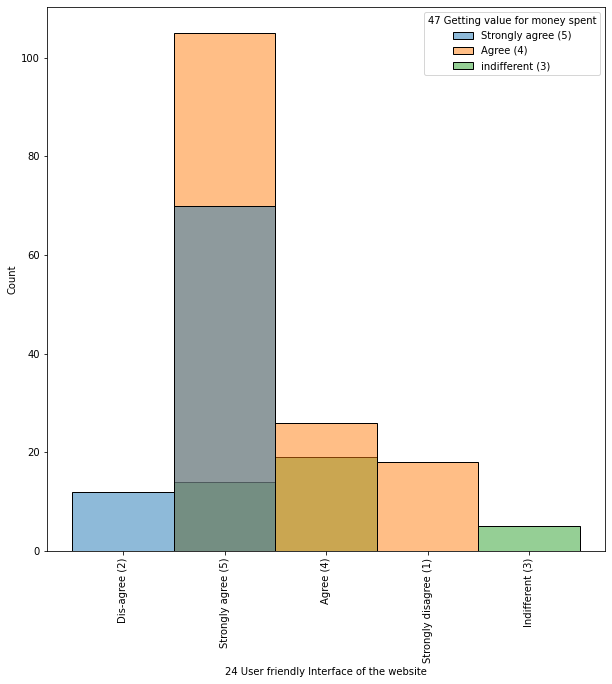

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

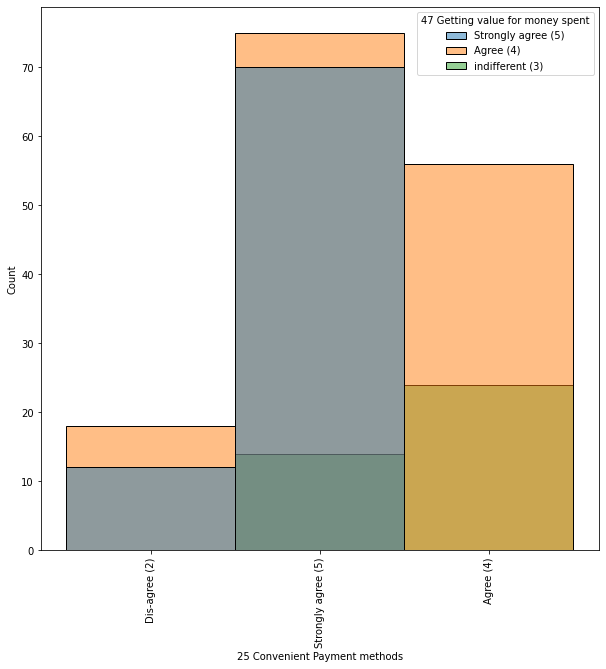

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

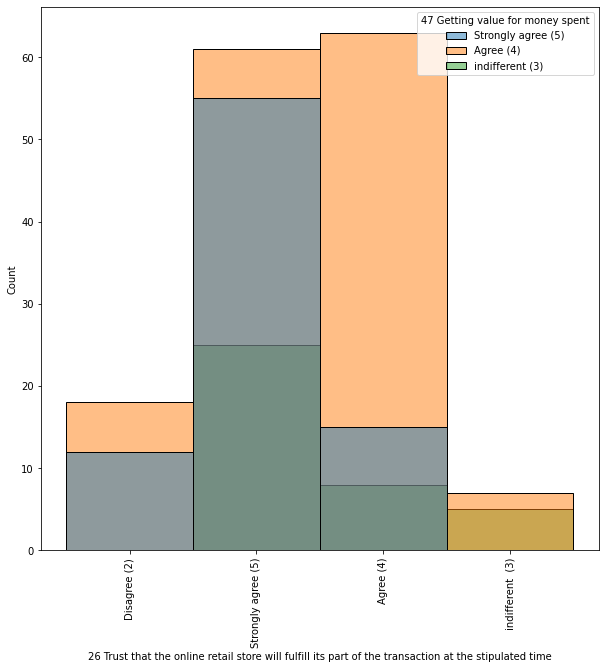

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

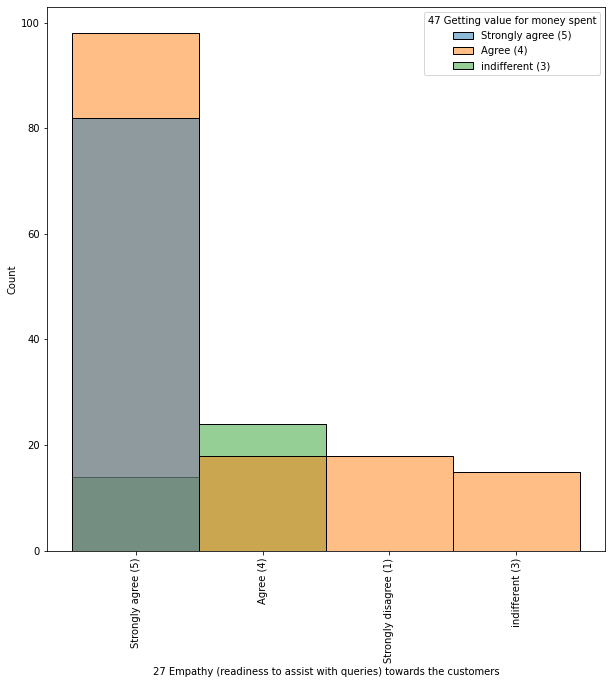

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

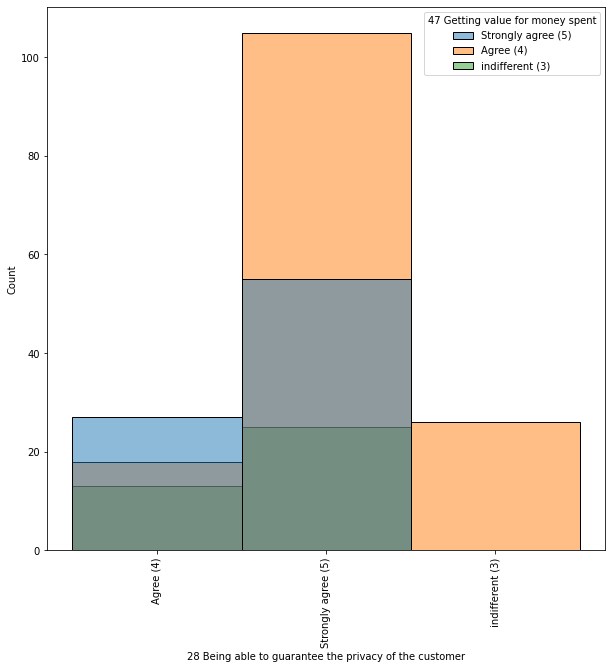

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

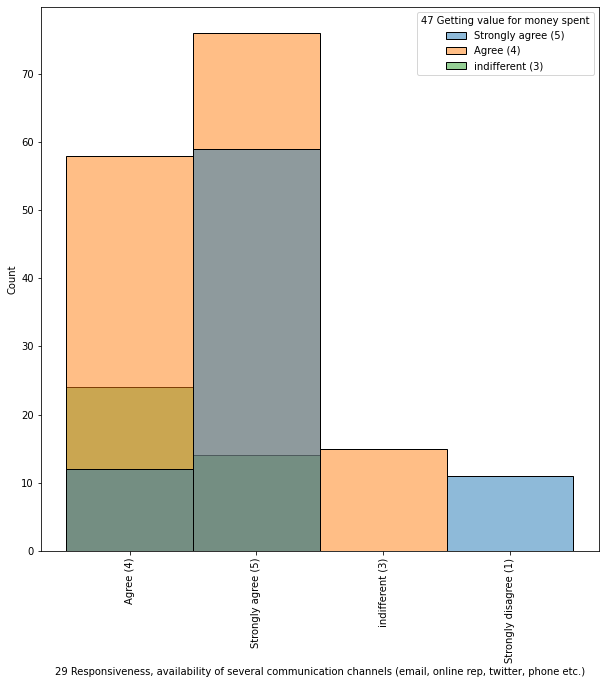

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

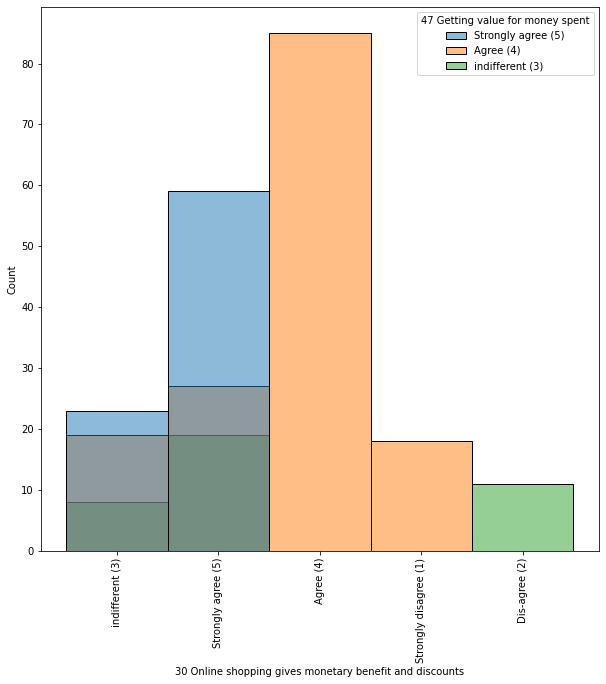

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

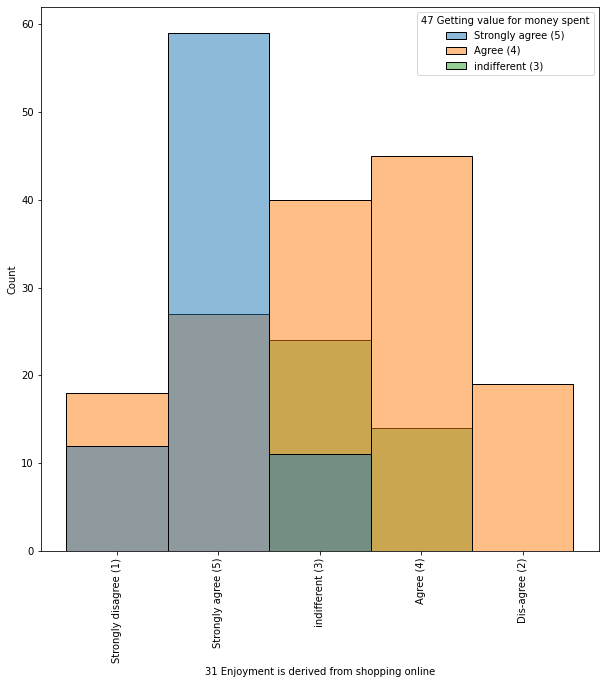

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

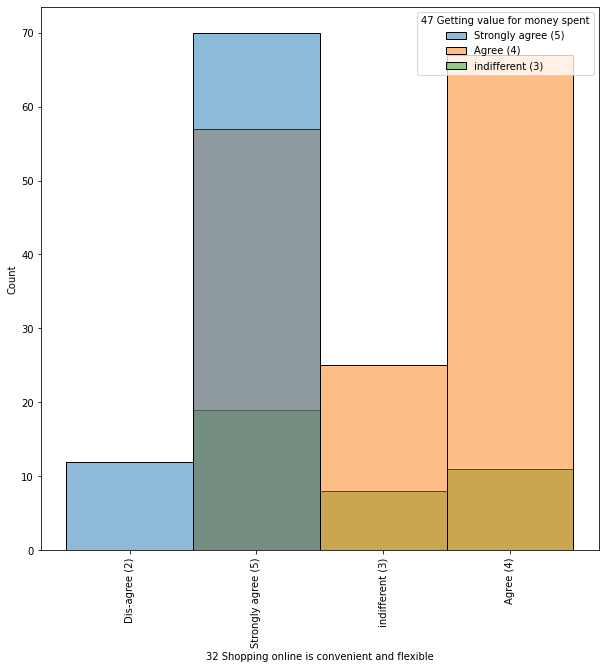

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

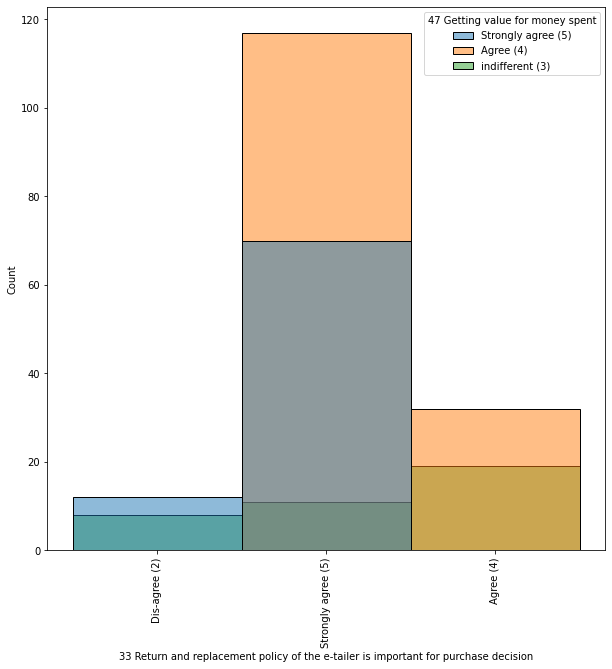

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

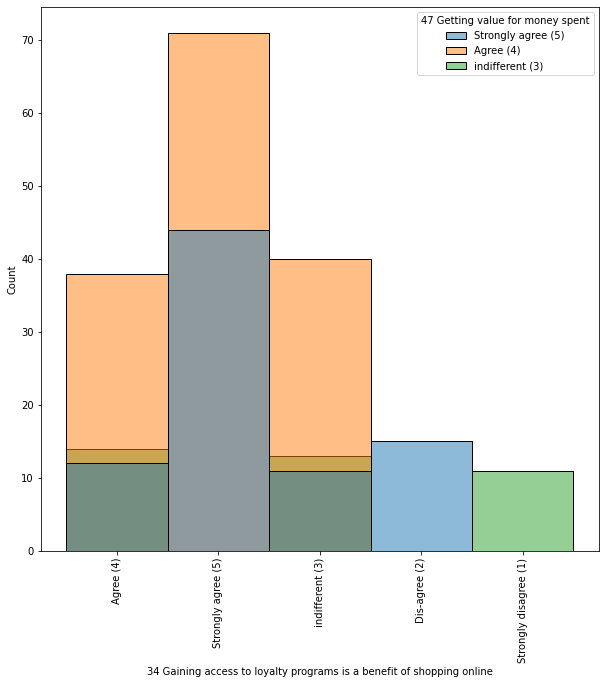

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

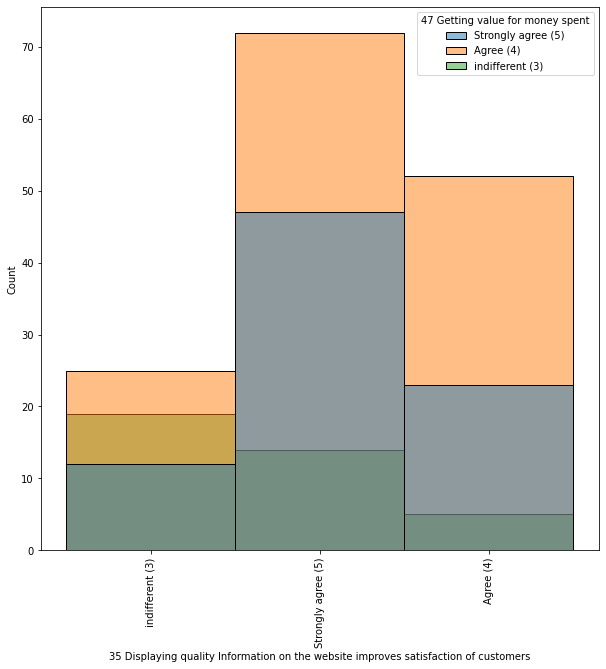

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

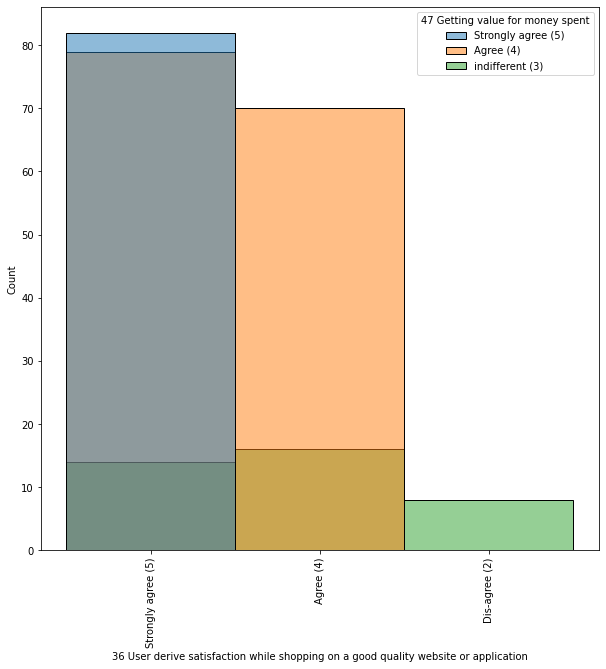

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

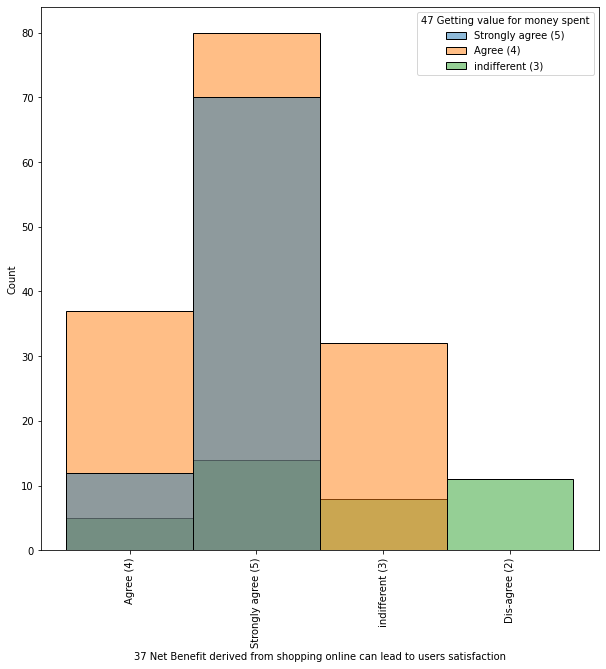

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

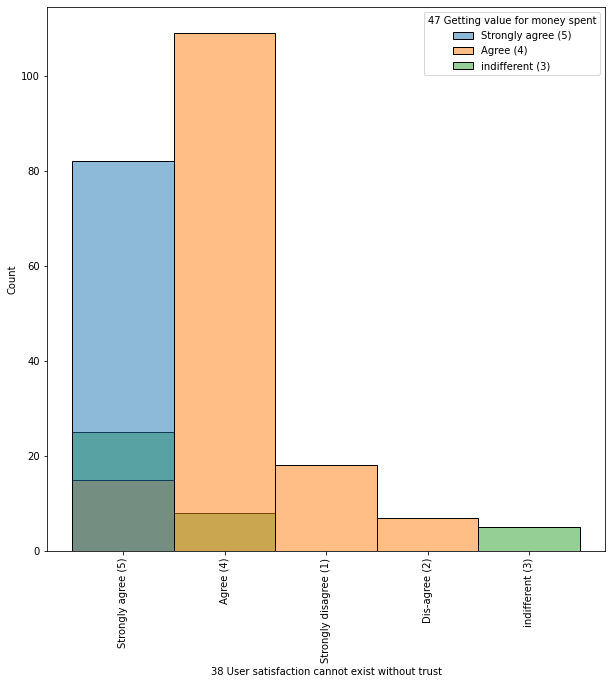

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

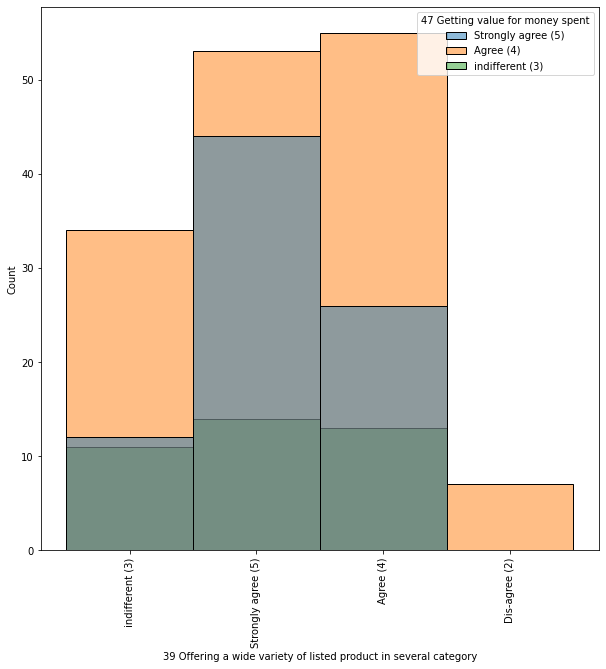

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

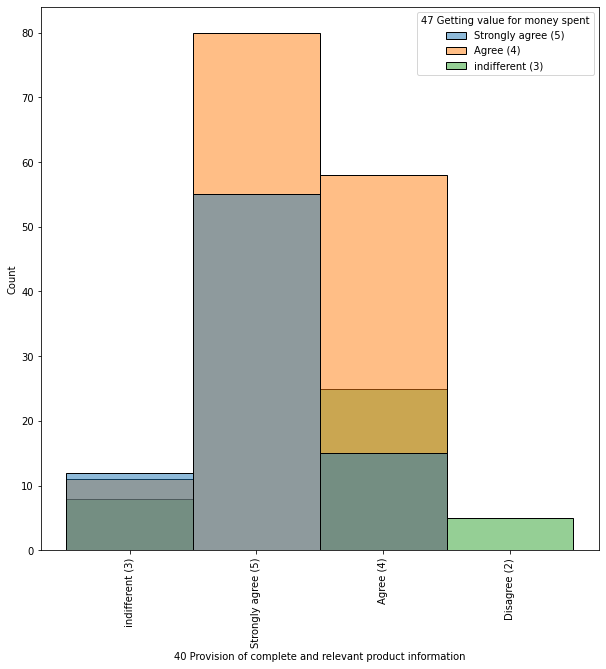

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

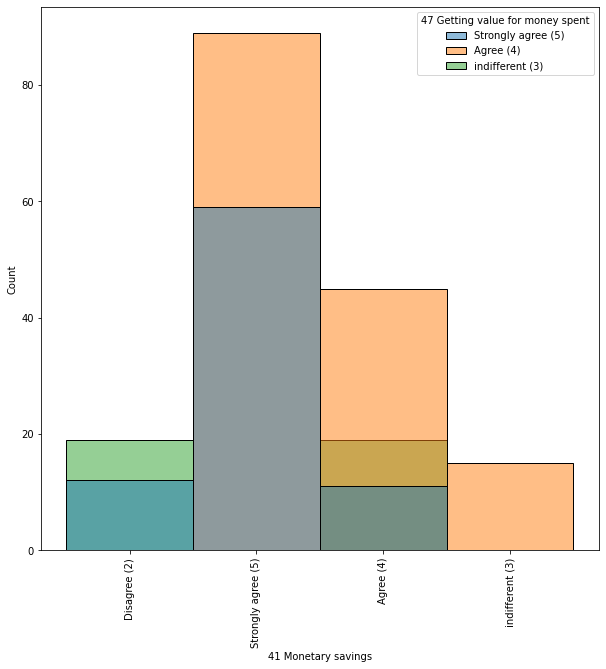

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

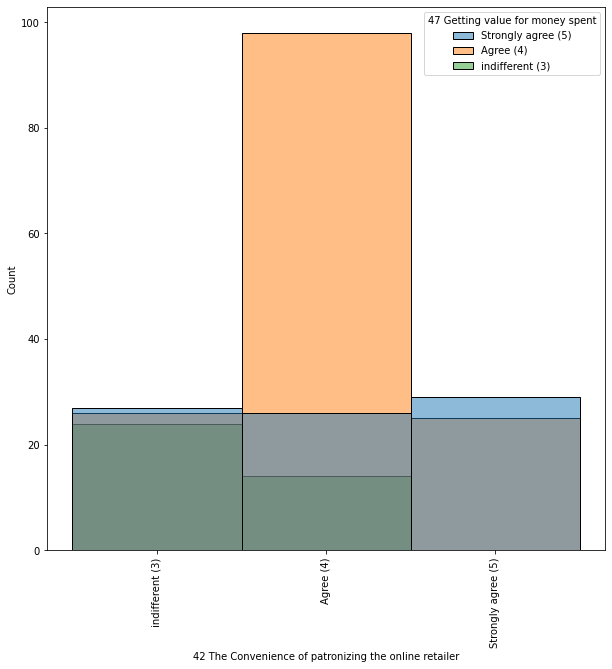

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

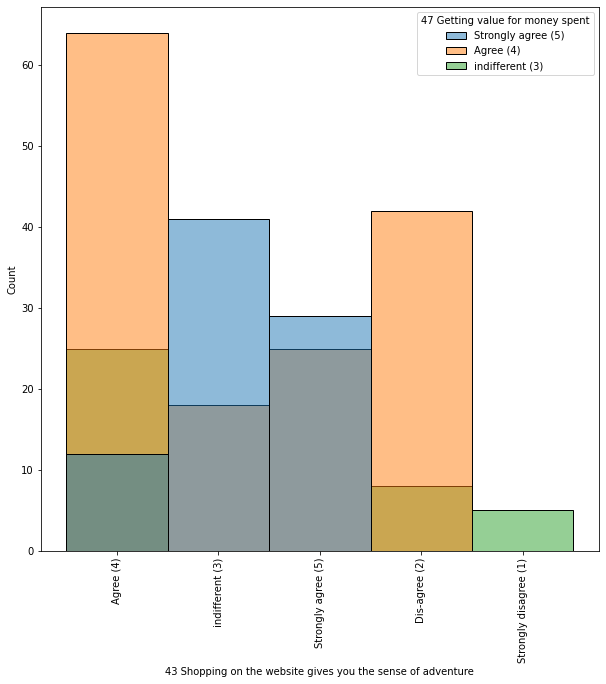

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

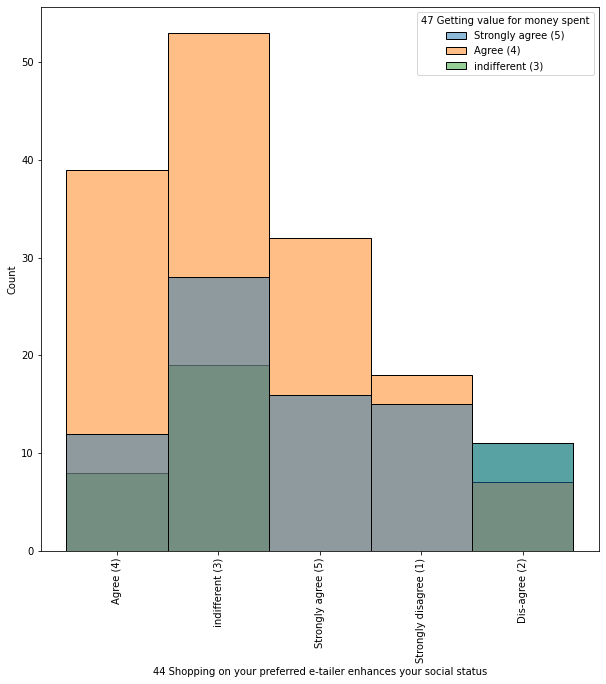

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

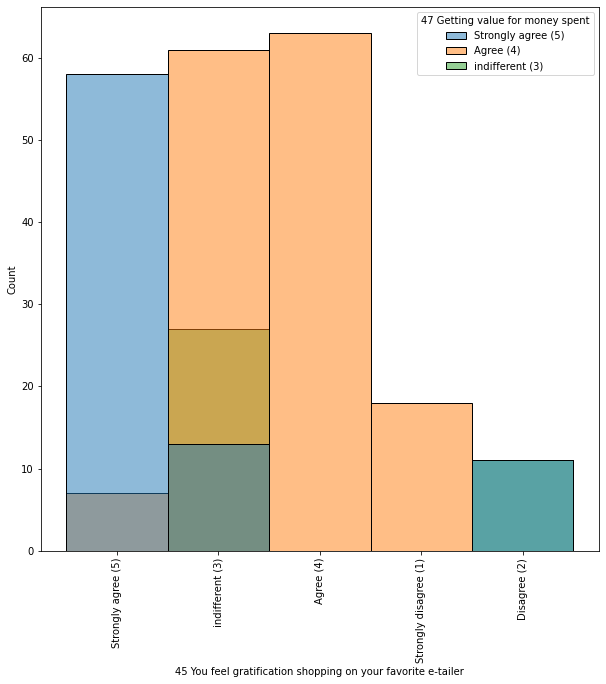

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

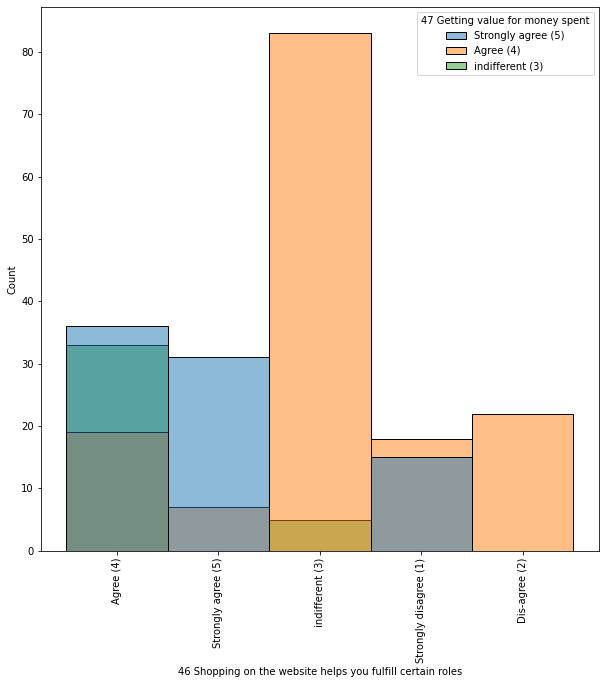

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

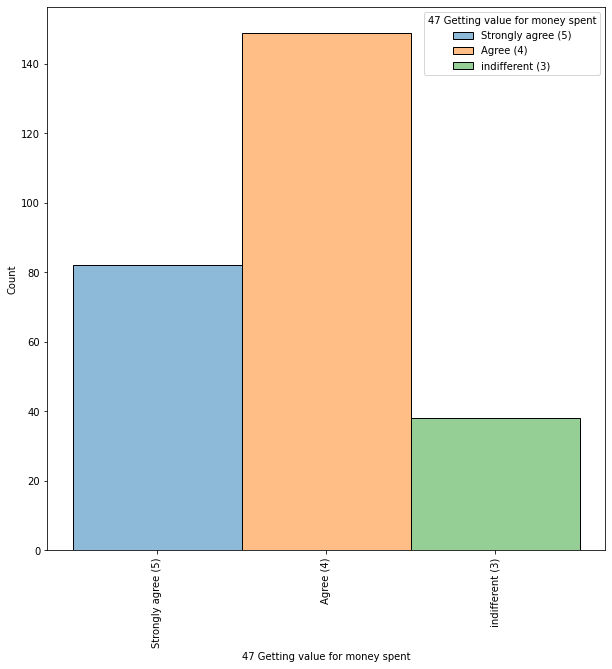

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

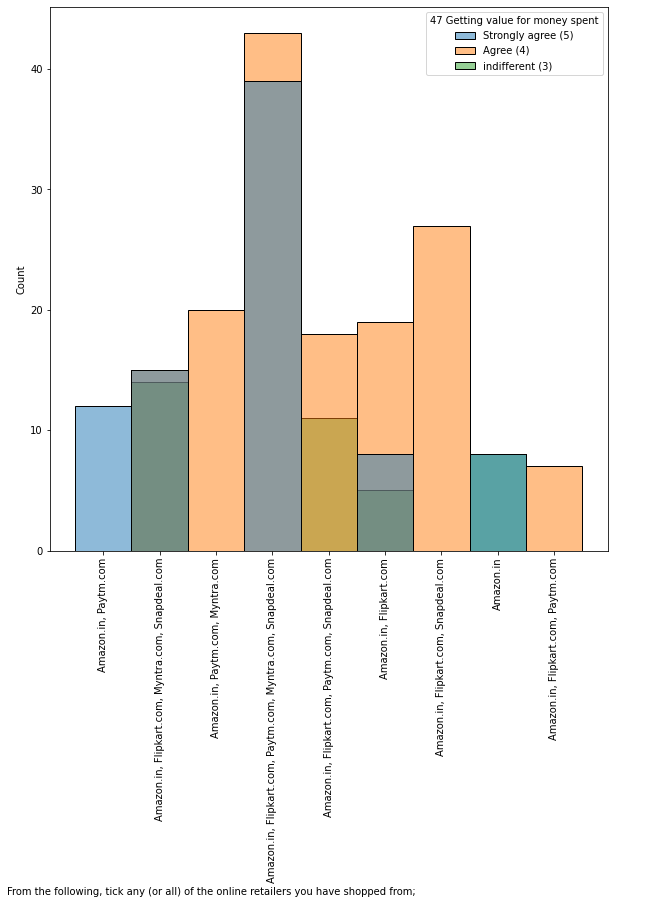

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

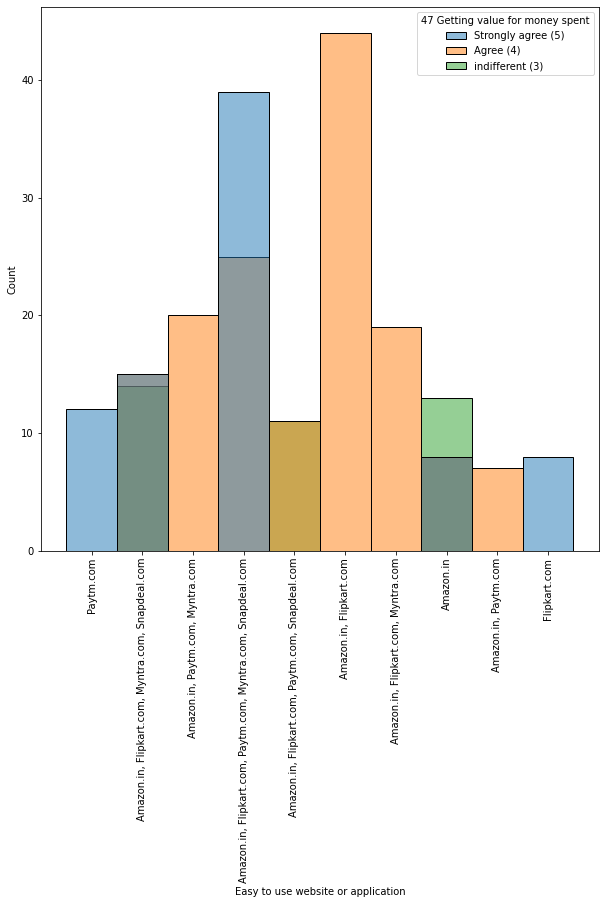

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

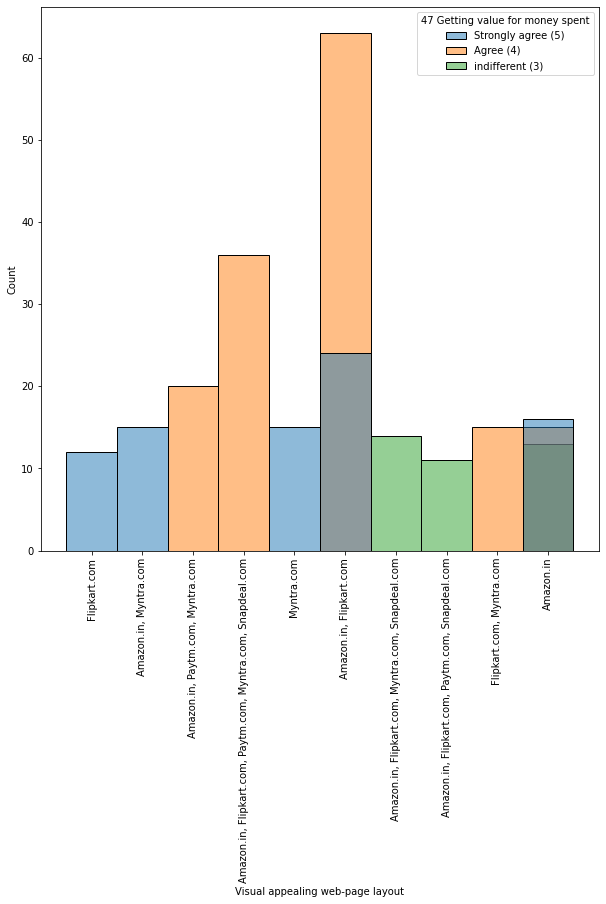

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

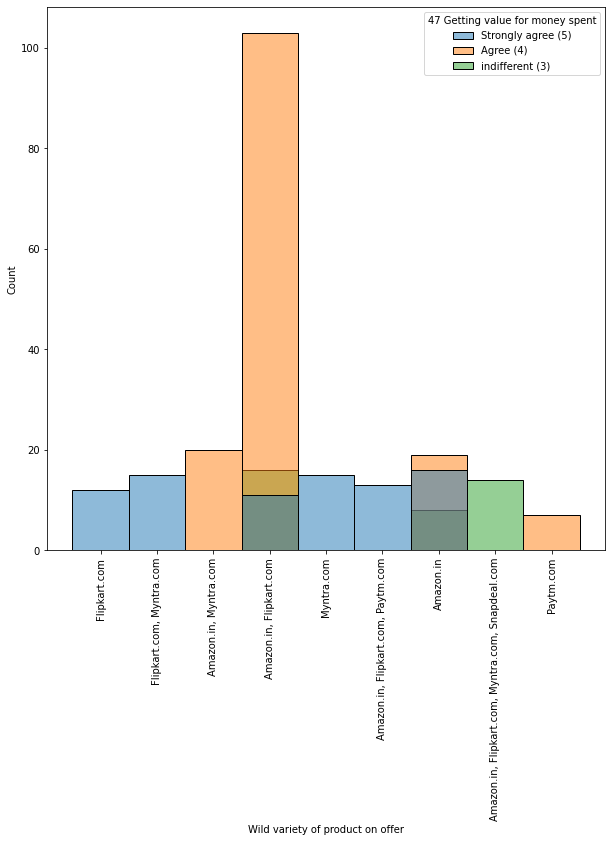

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

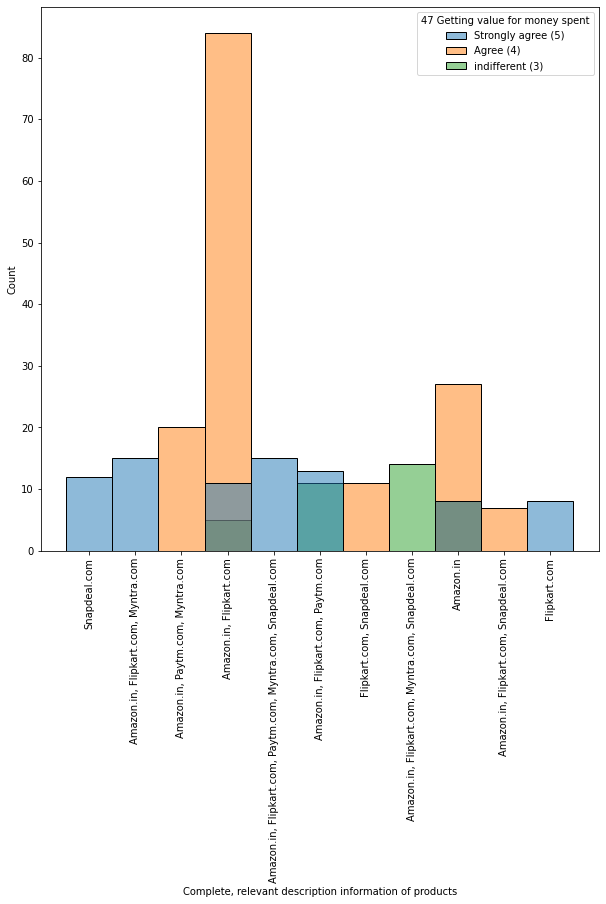

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

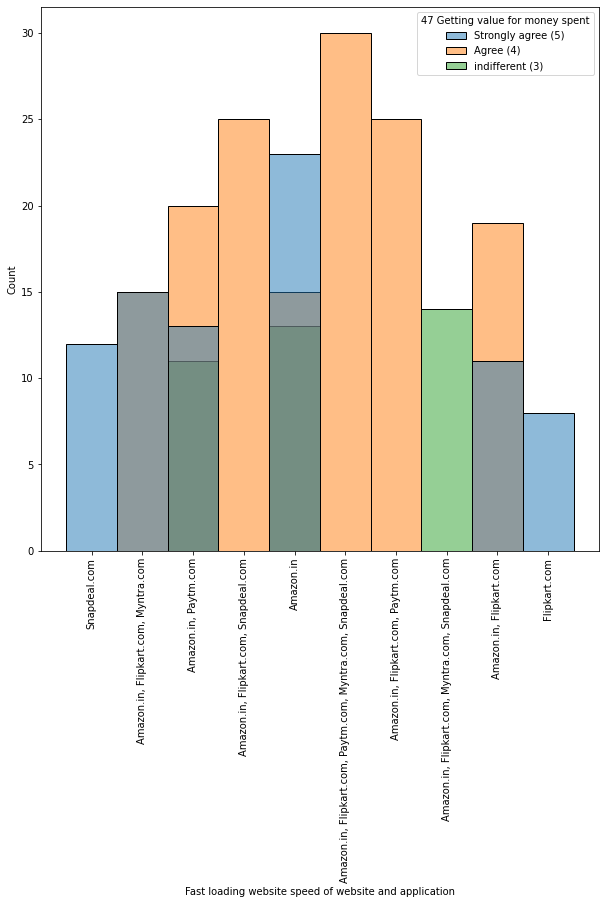

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

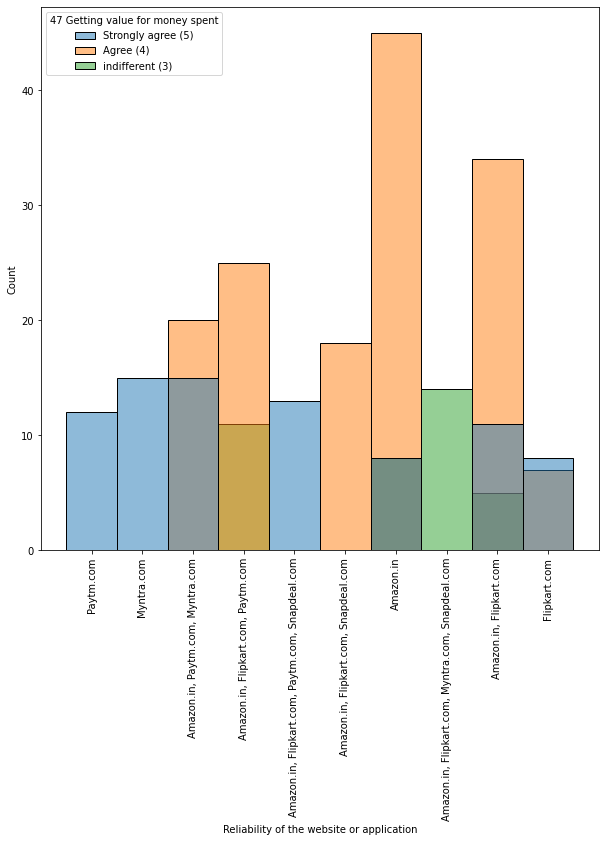

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

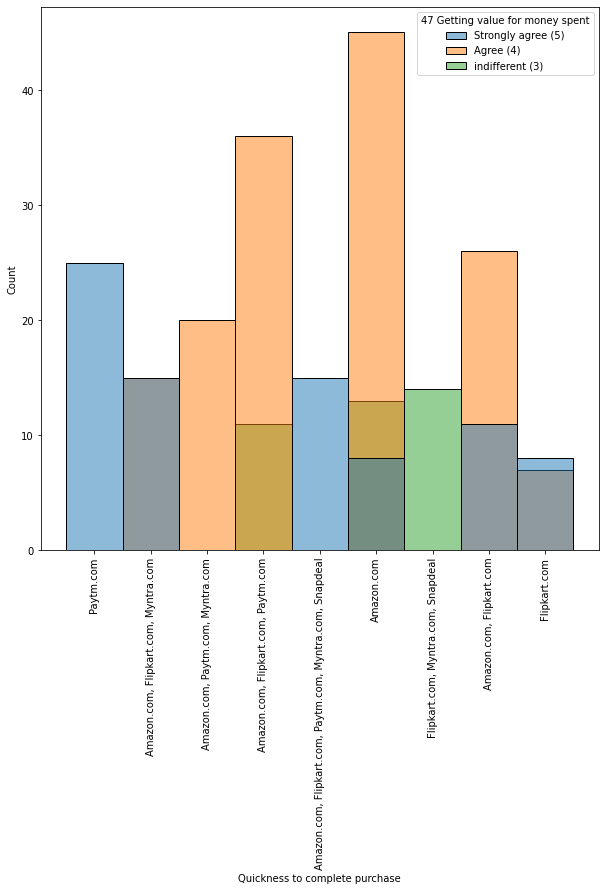

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

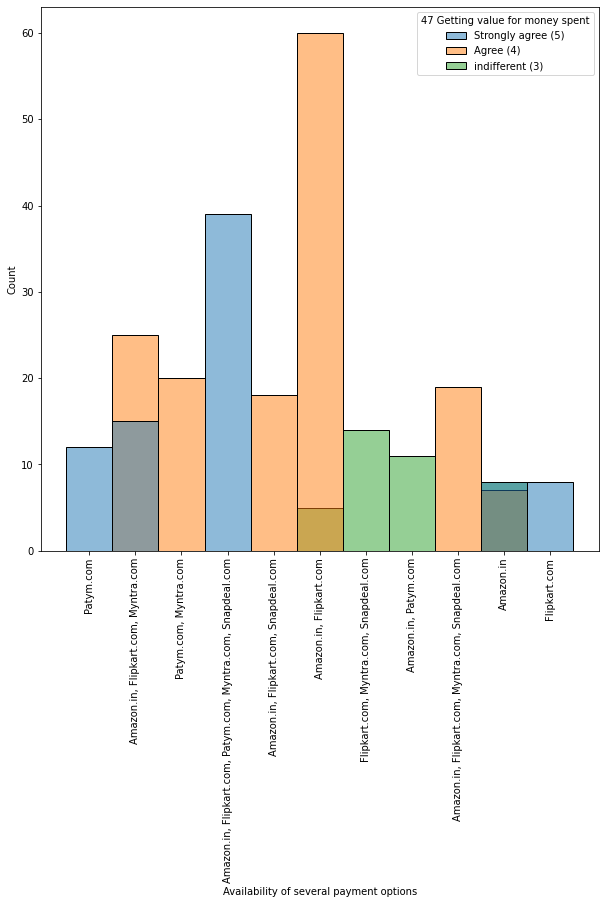

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

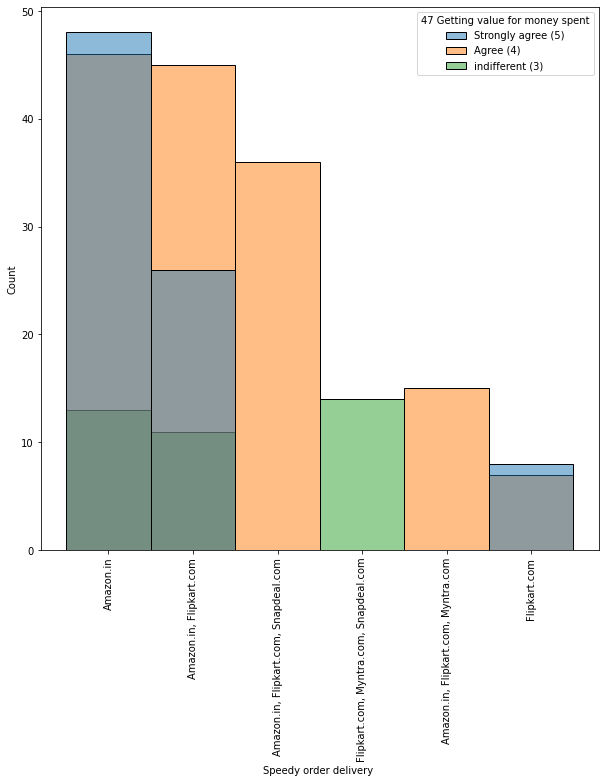

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

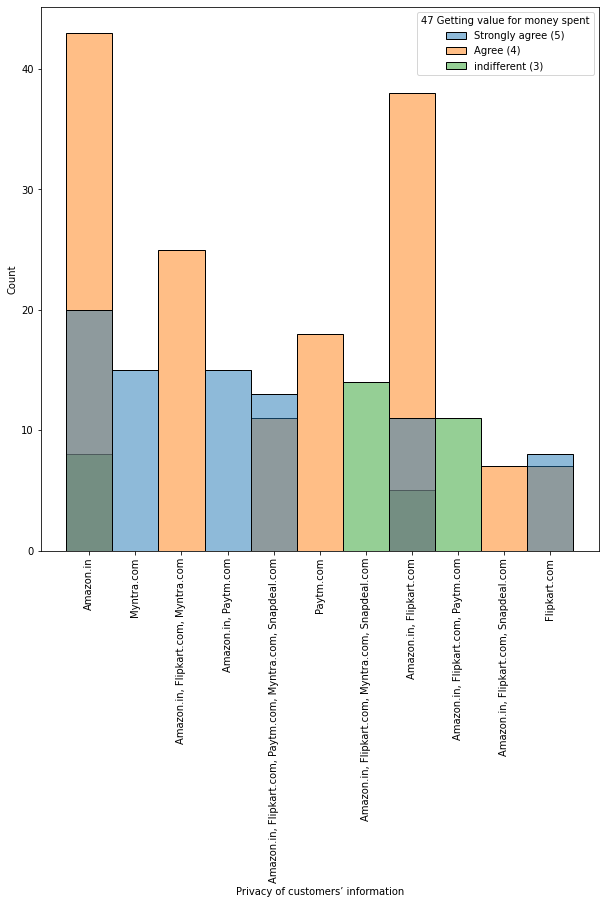

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

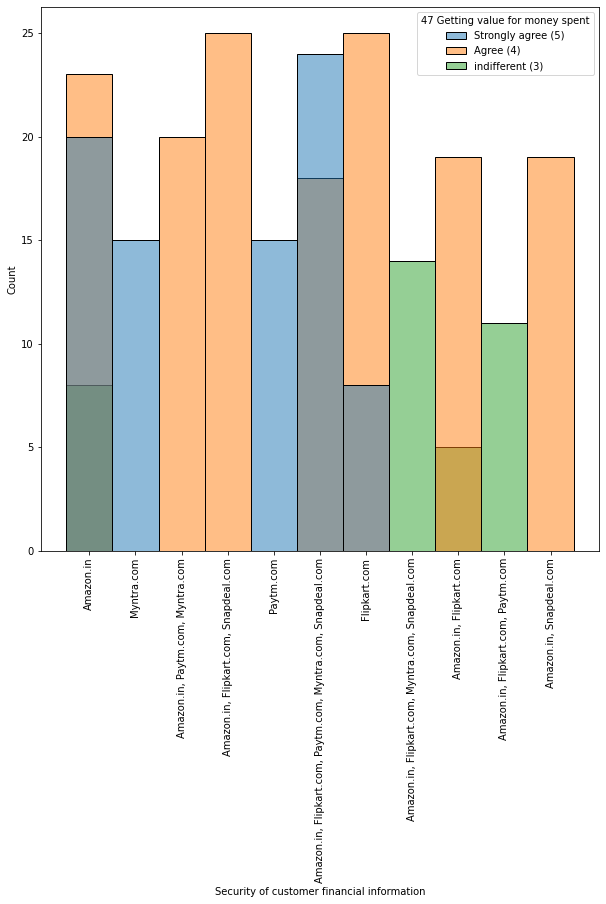

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

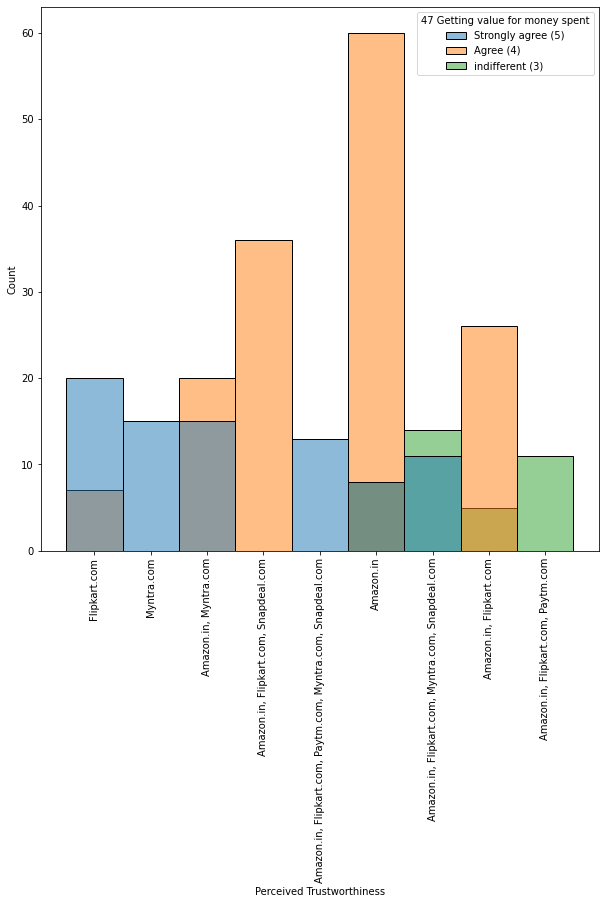

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

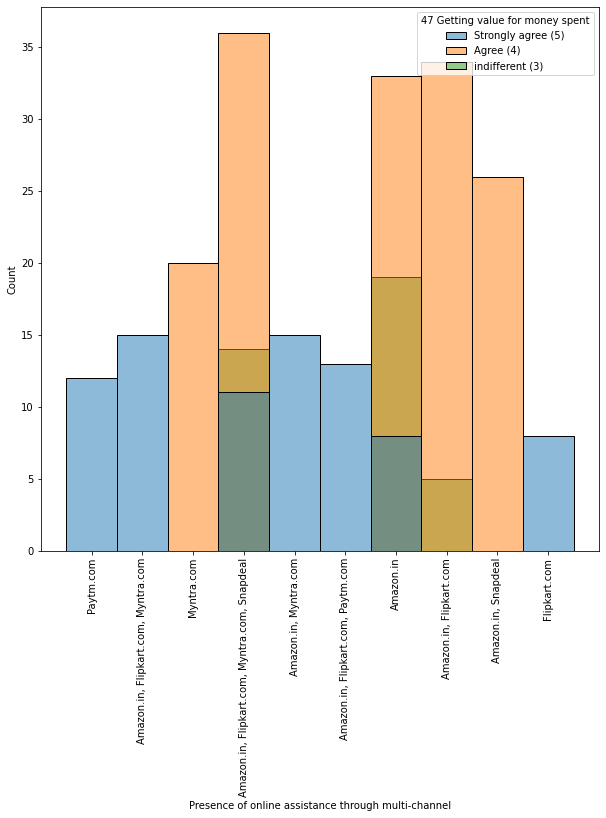

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

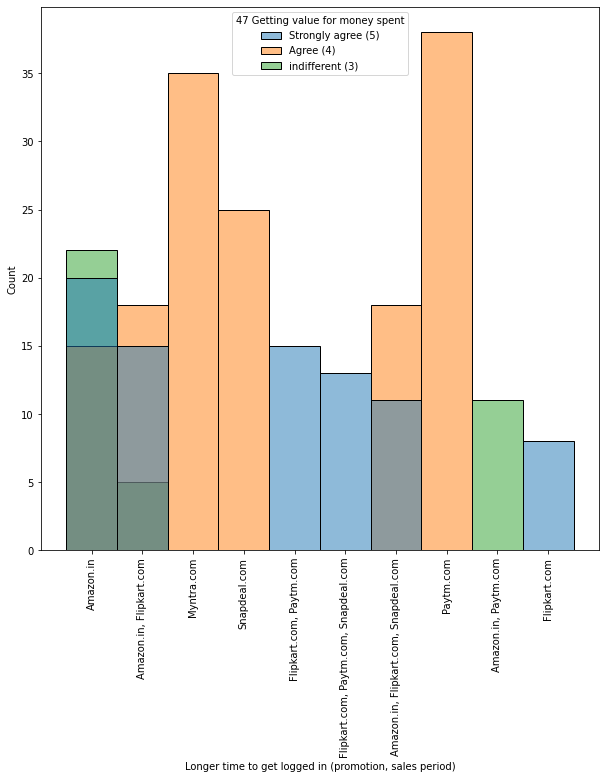

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

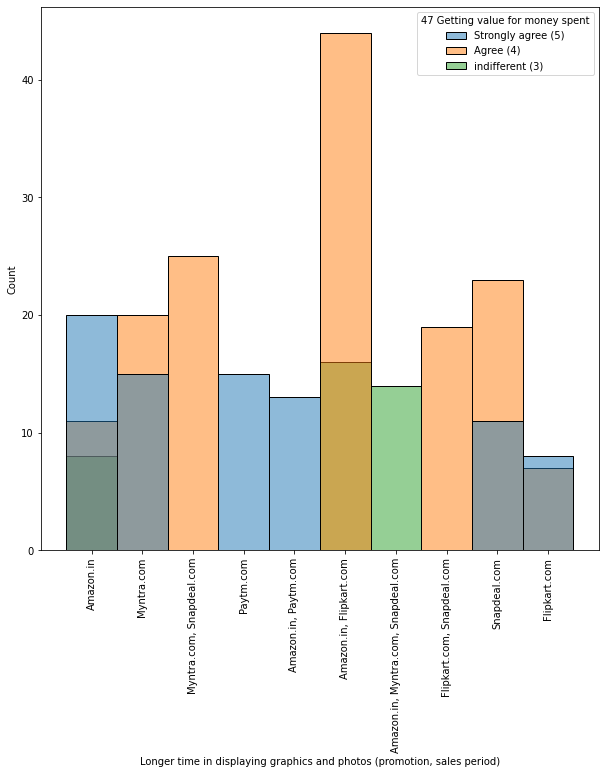

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

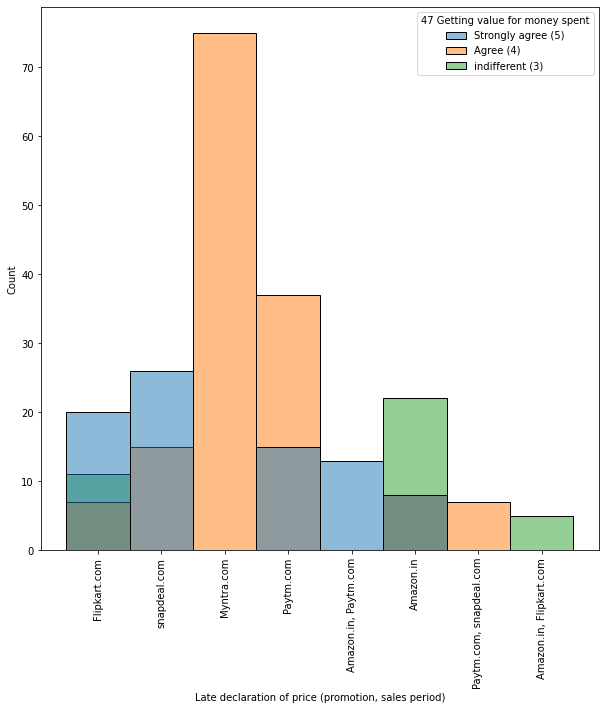

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

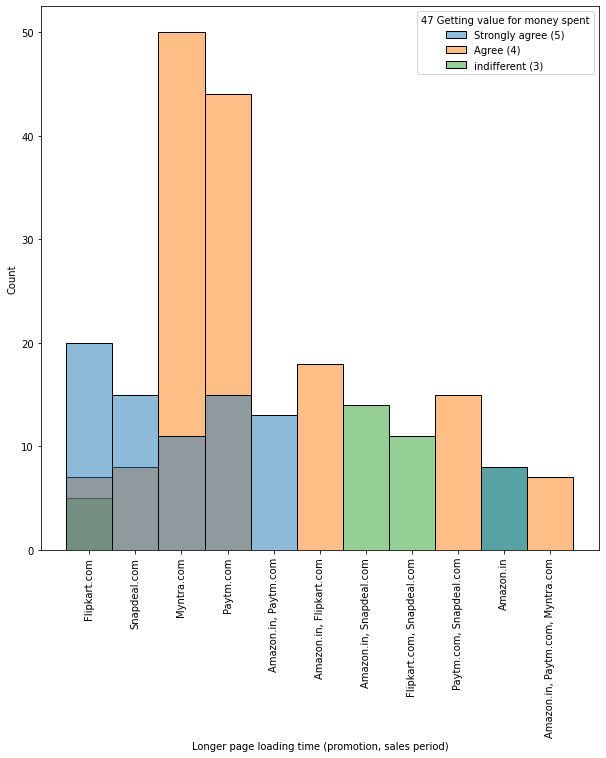

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

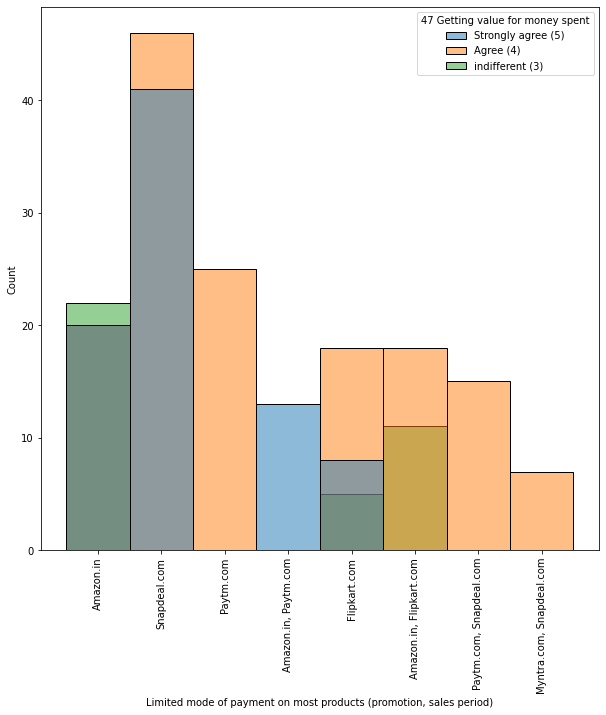

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

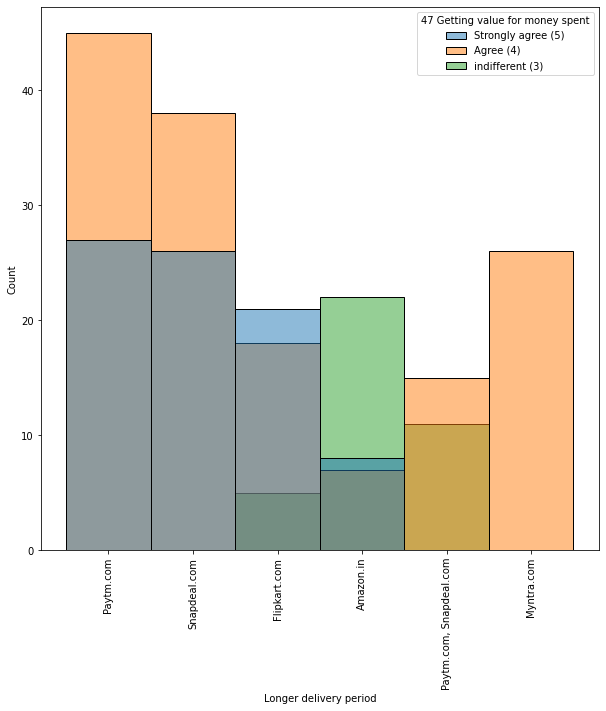

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

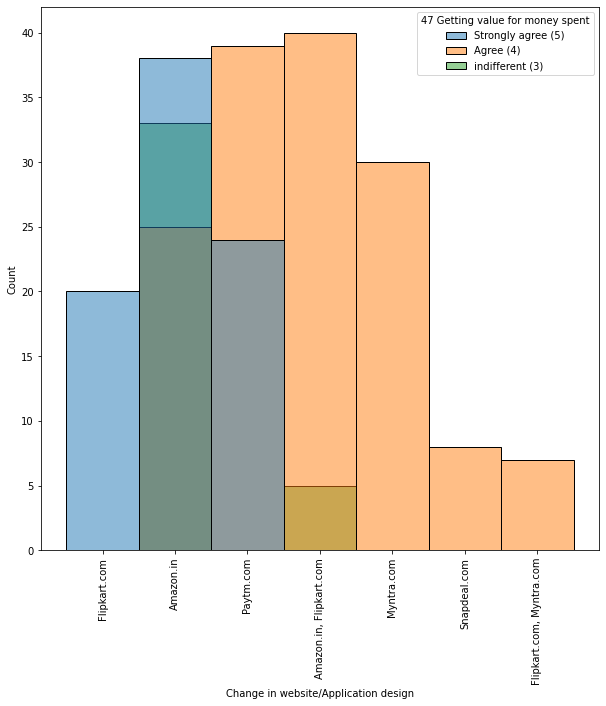

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

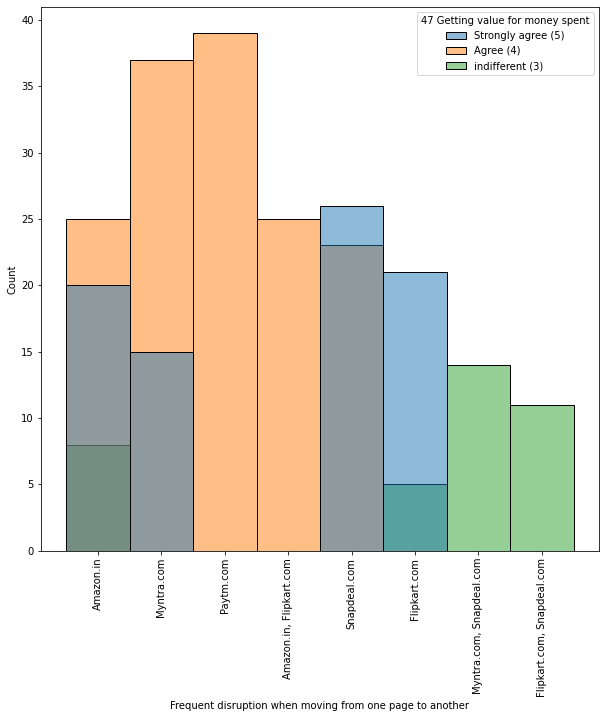

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

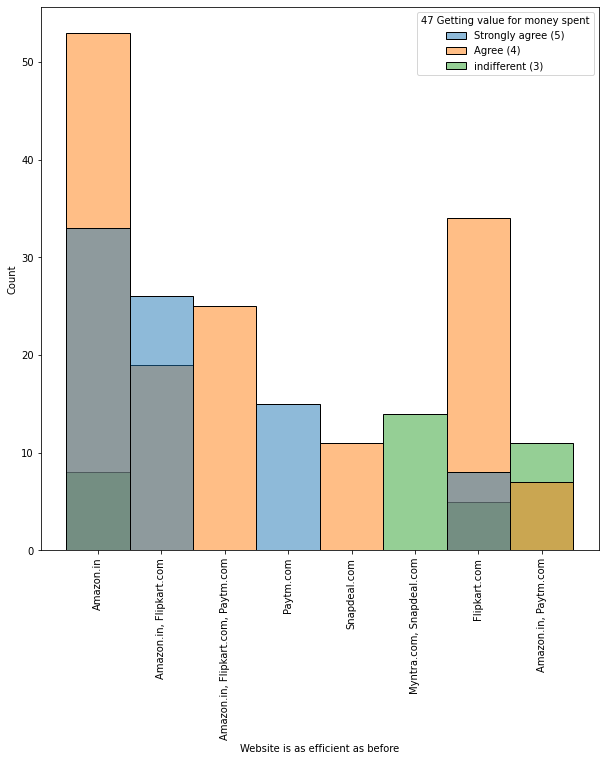

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

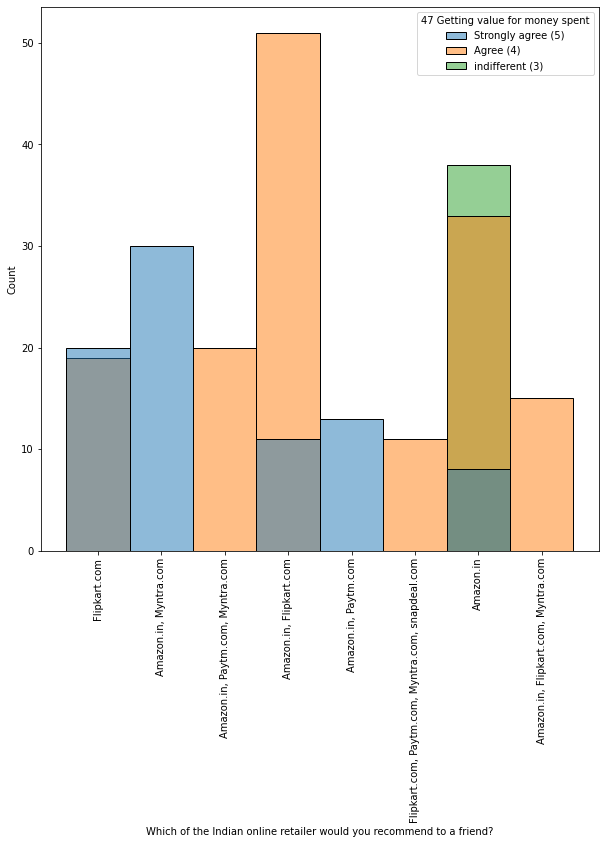

In [17]:
# Histogram with respect to value for money spent
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['47 Getting value for money spent'])
    plt.xticks(rotation ='90')
    plt.show()

Most repondent agree that 'Getting value for money spent' is important 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

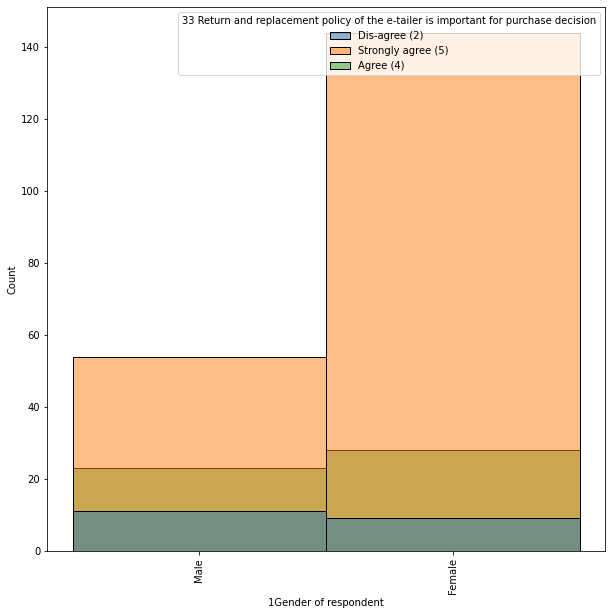

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

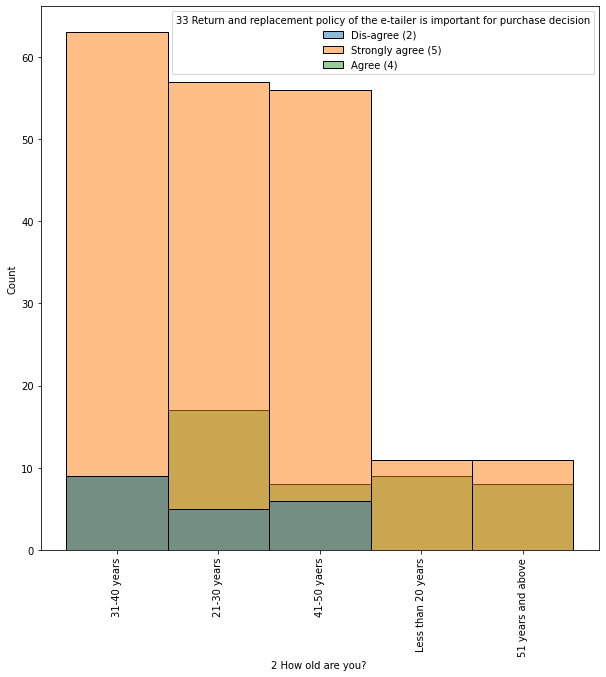

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

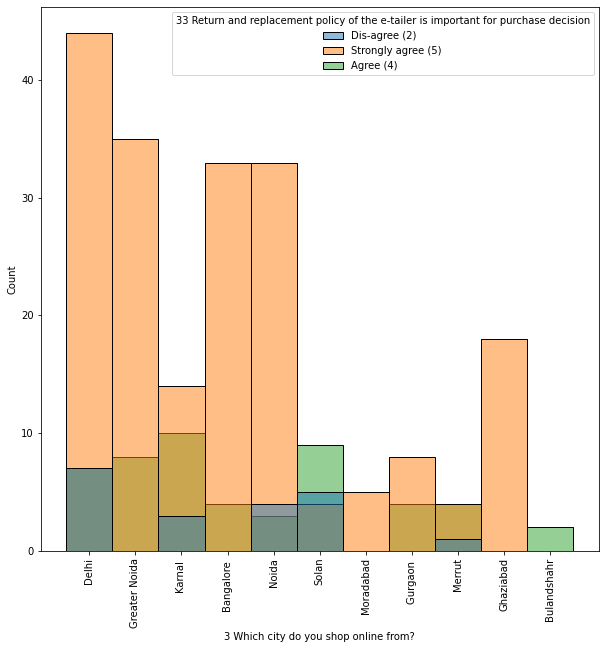

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

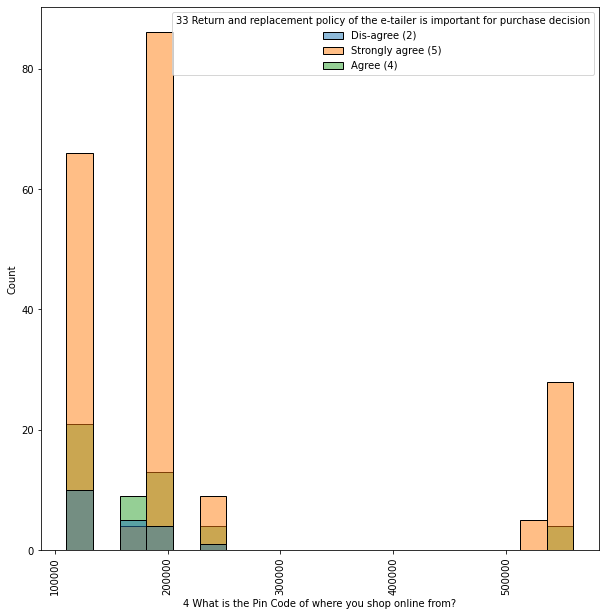

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

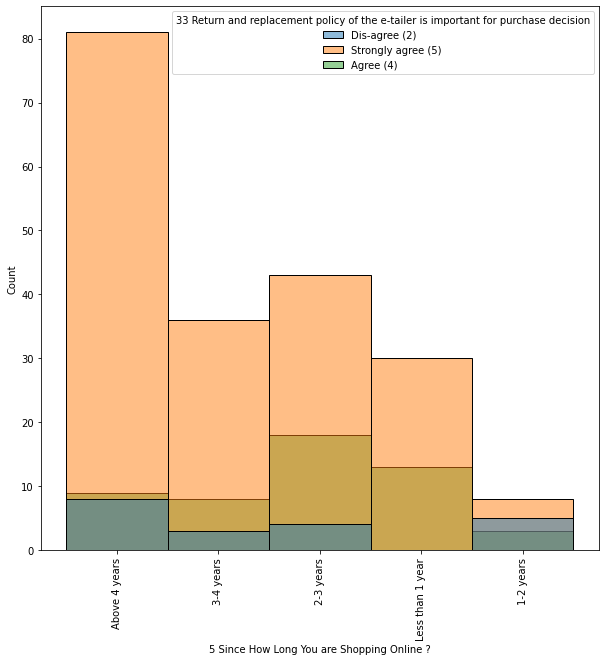

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

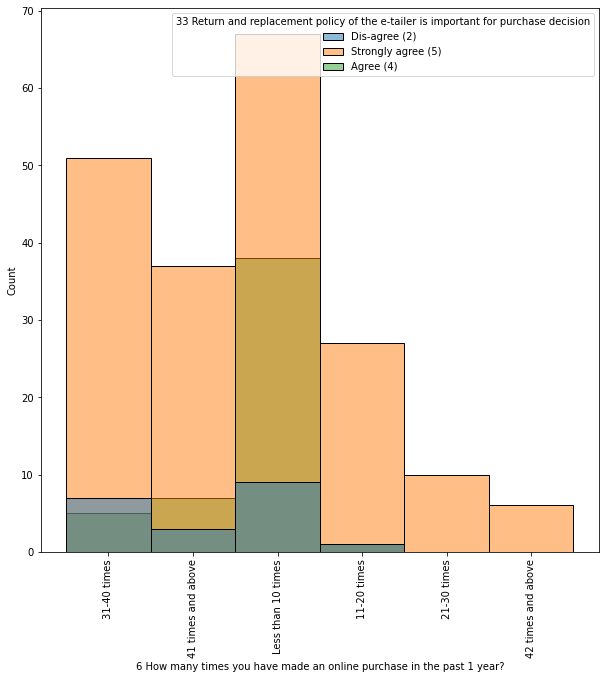

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

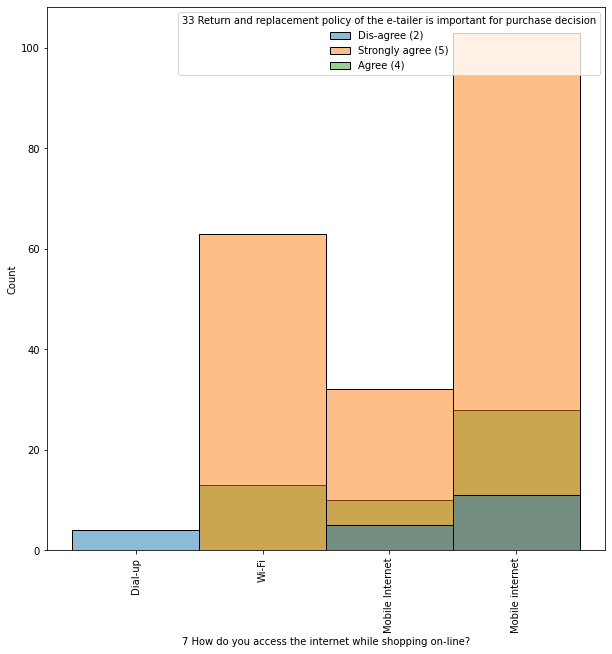

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

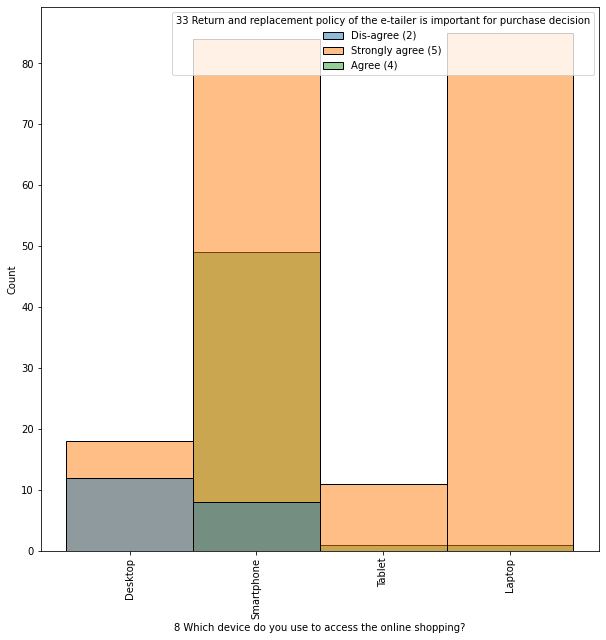

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

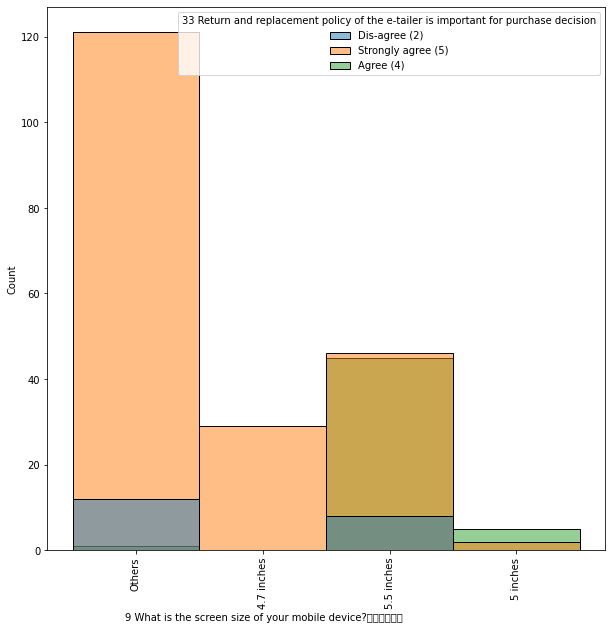

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

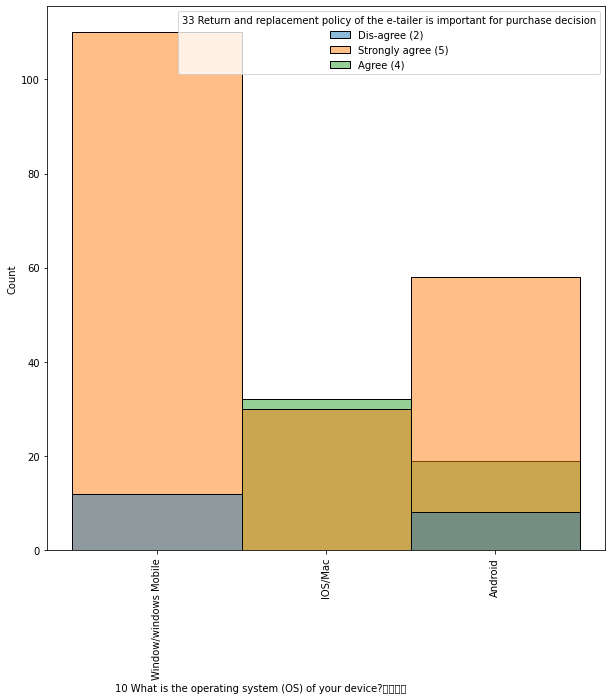

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

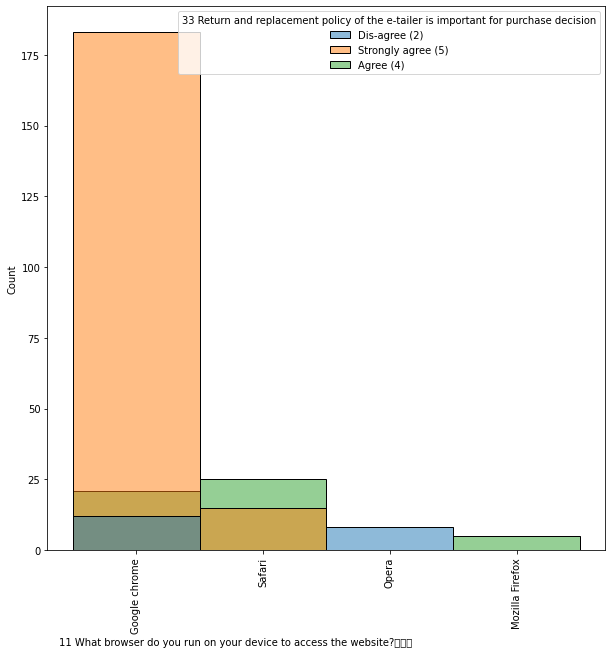

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

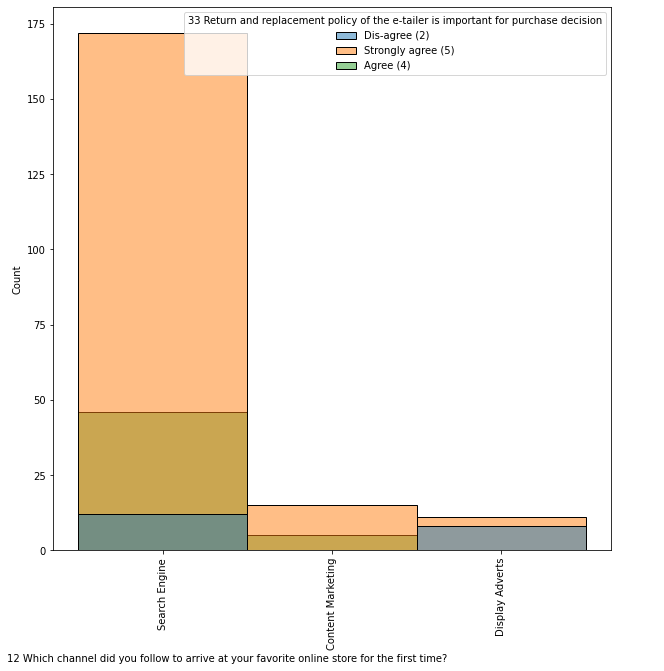

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

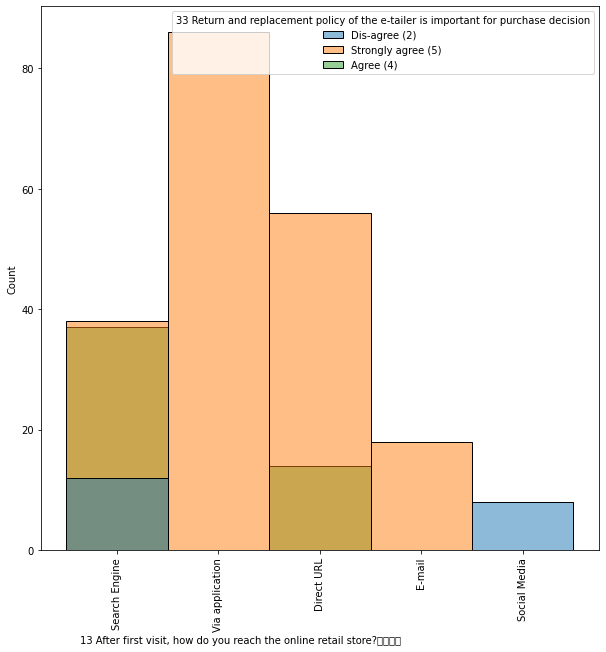

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

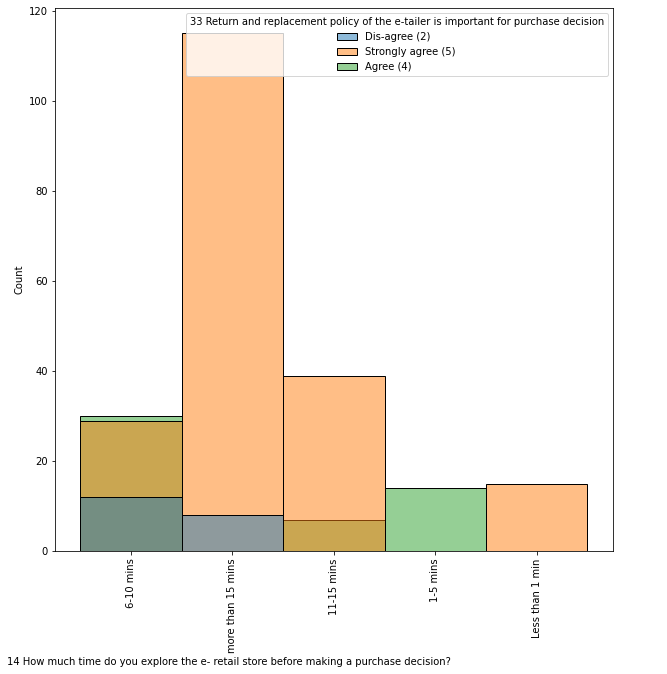

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

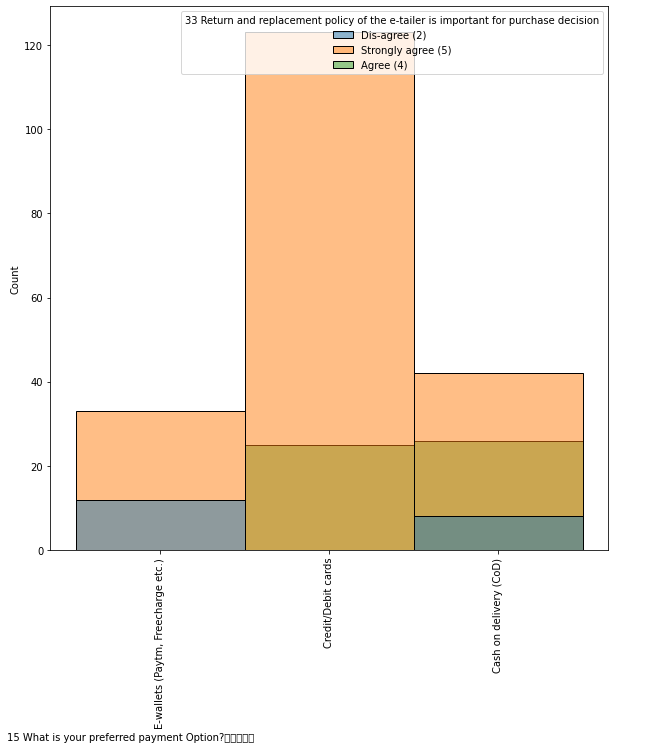

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

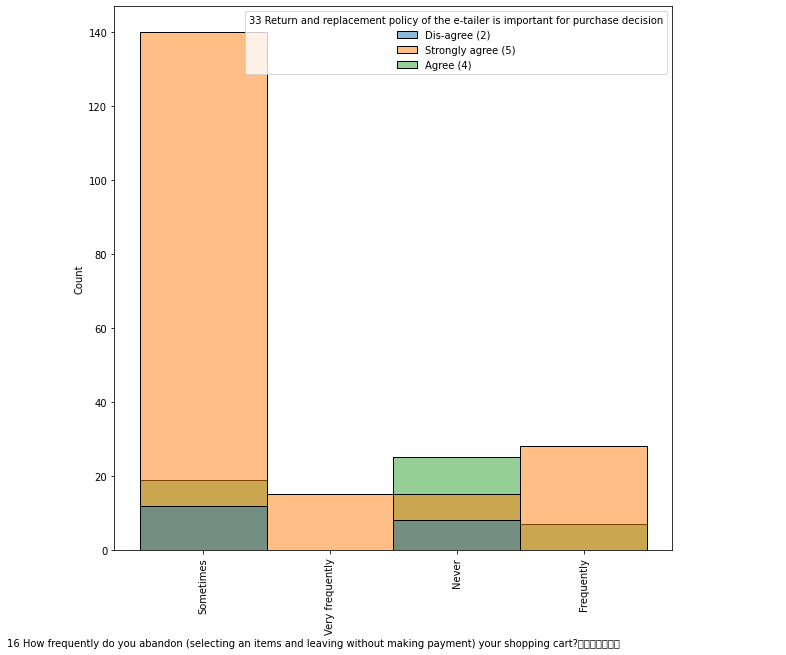

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

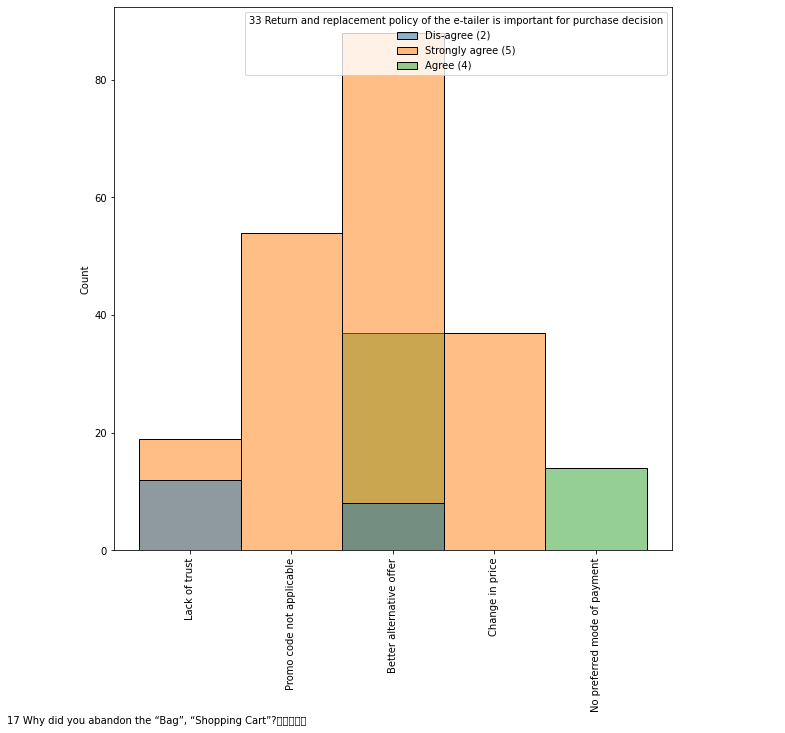

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

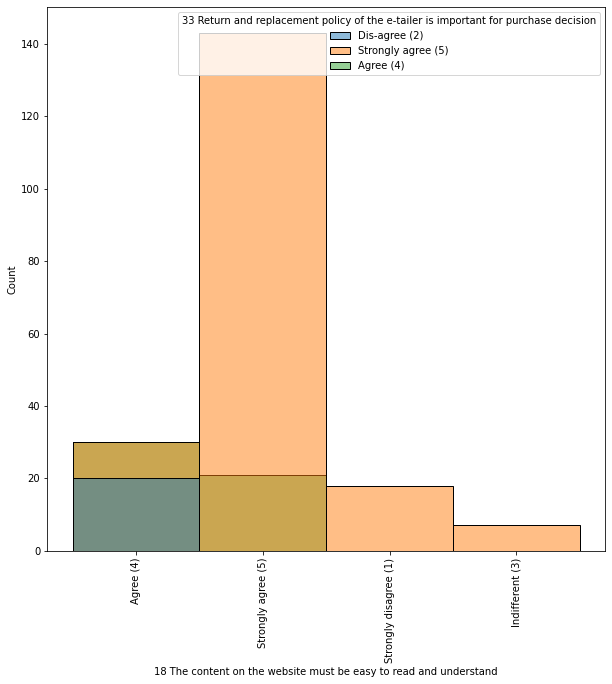

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

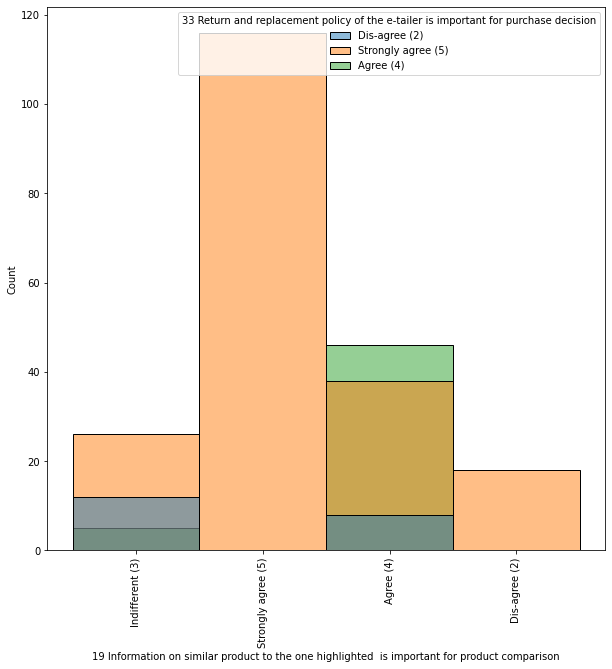

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

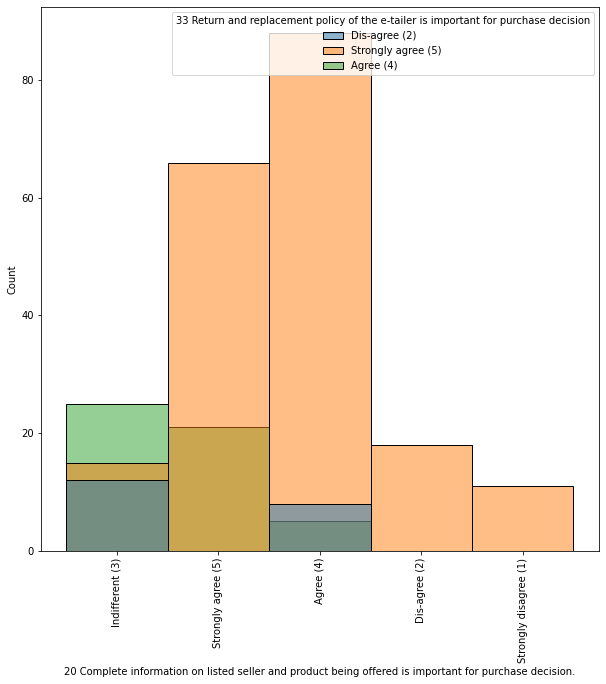

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

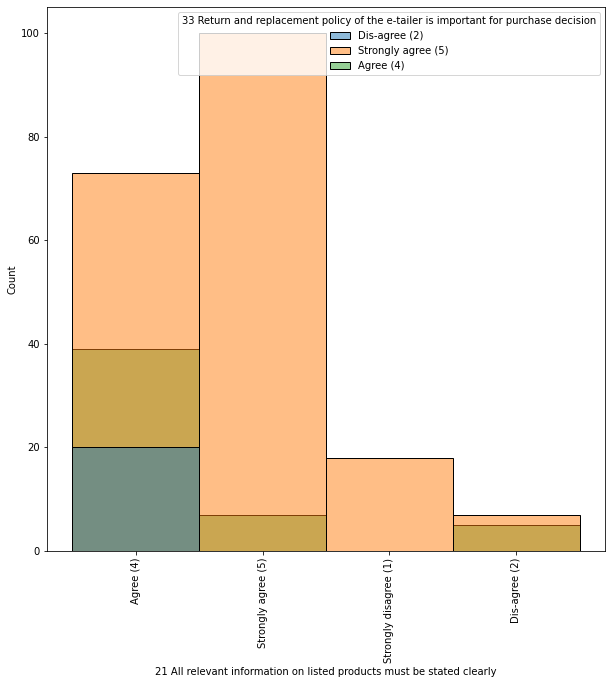

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

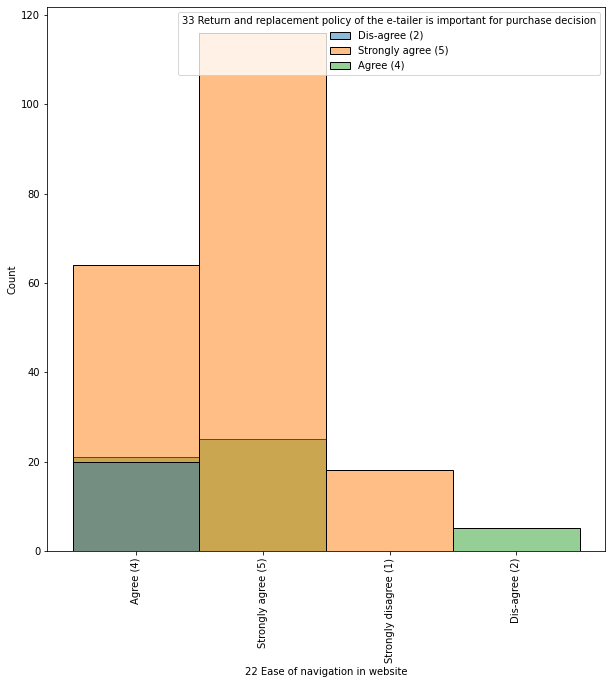

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

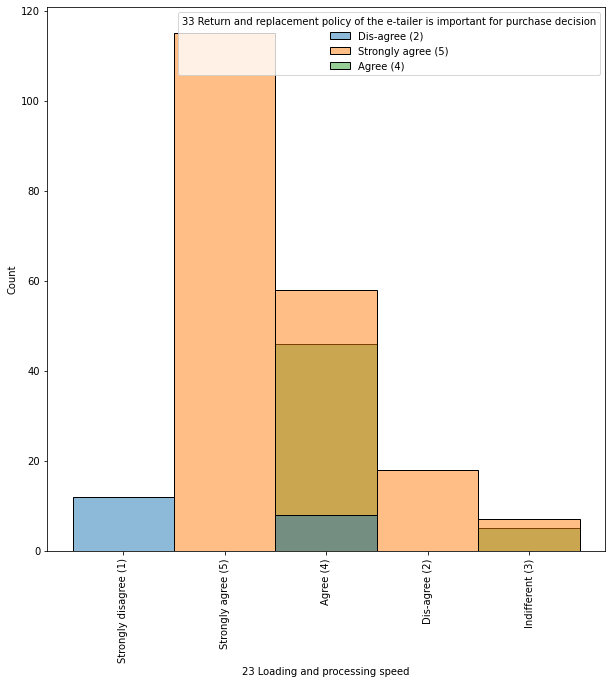

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

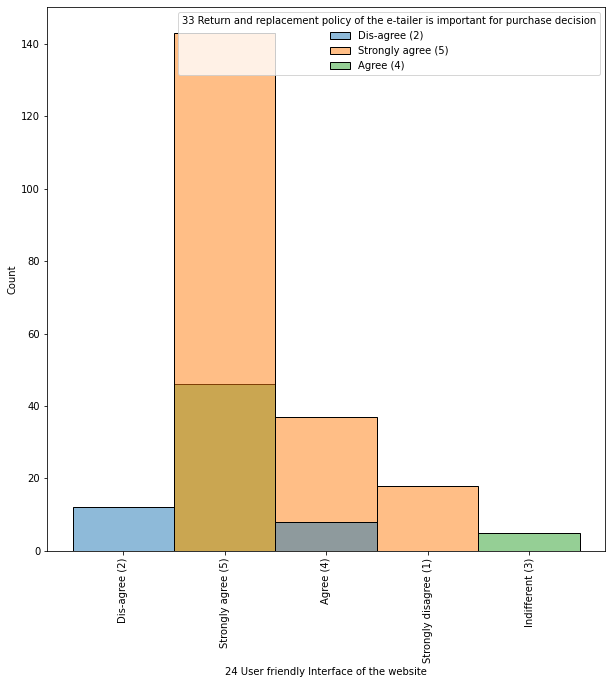

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

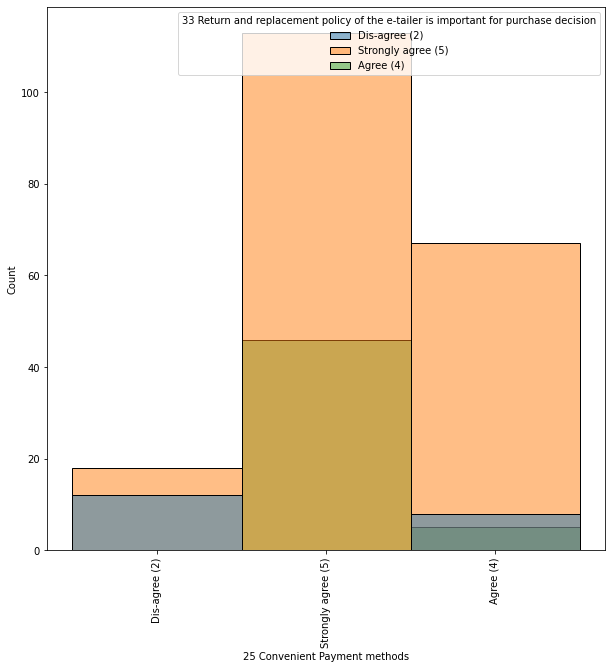

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

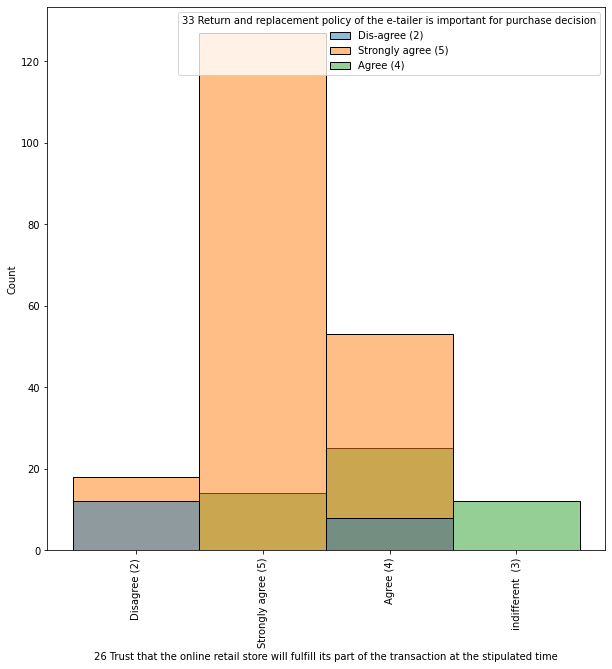

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

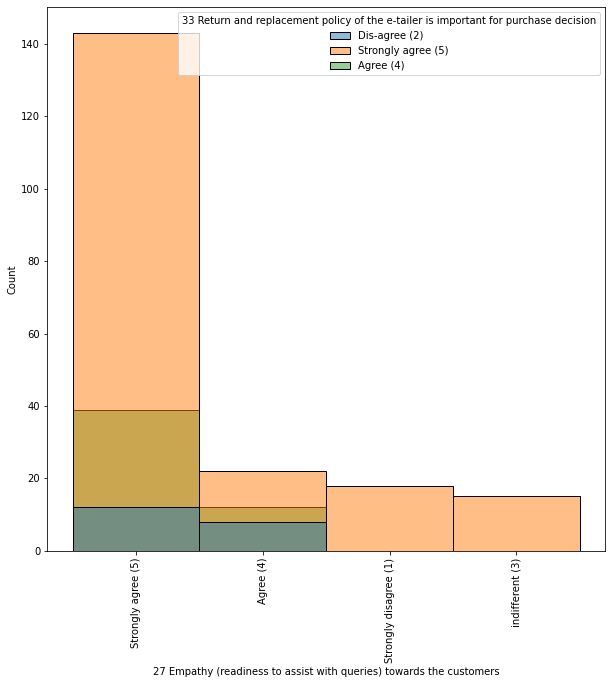

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

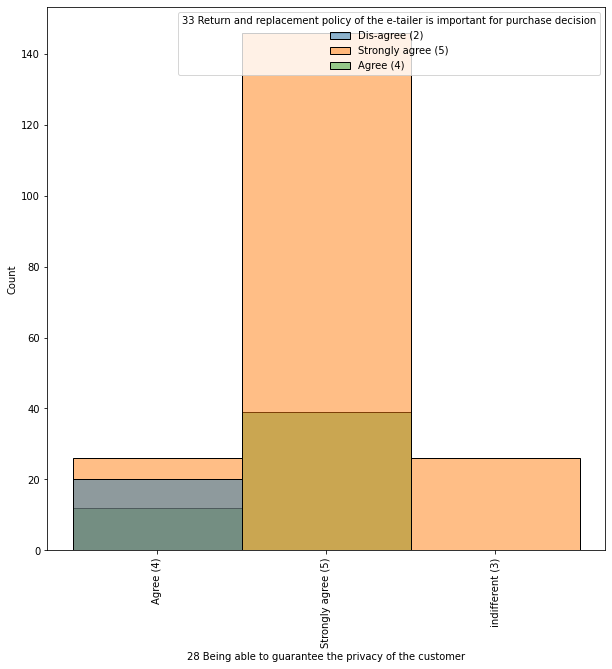

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

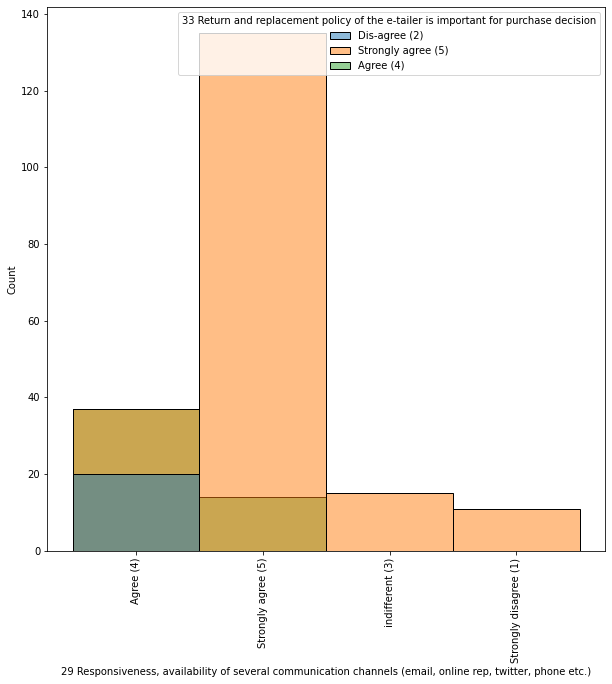

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

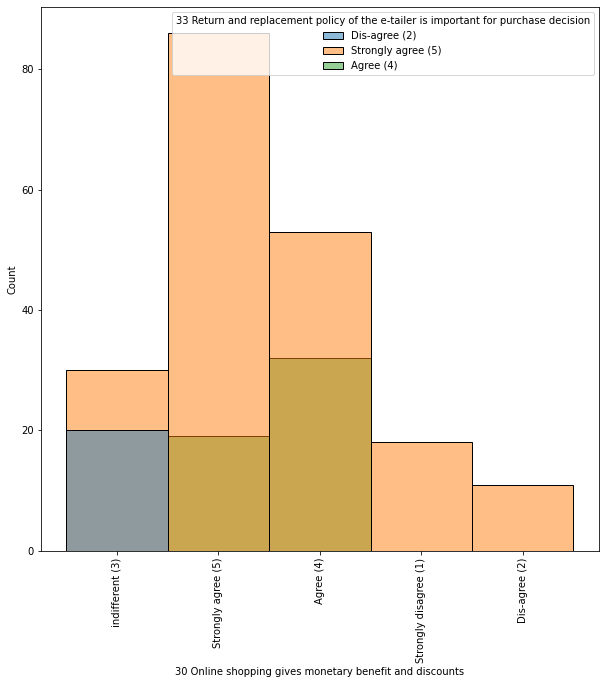

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

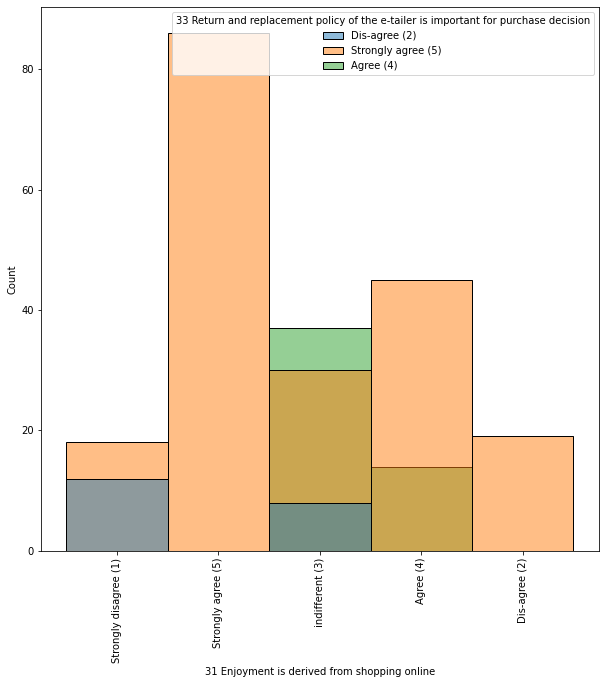

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

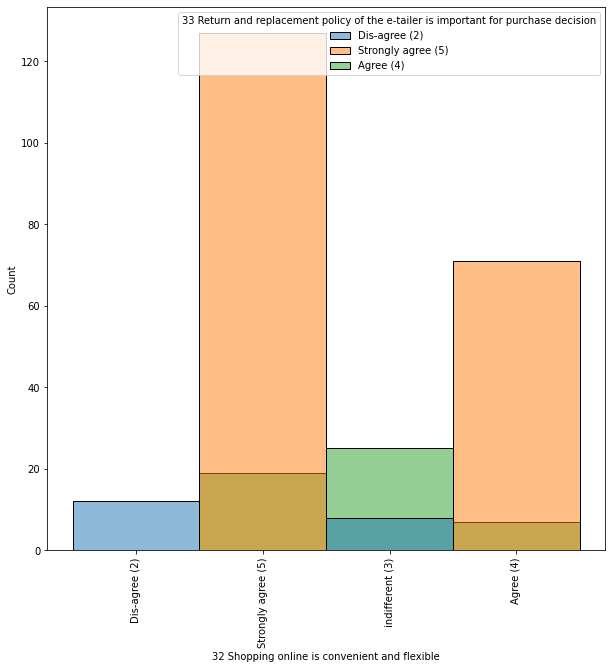

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

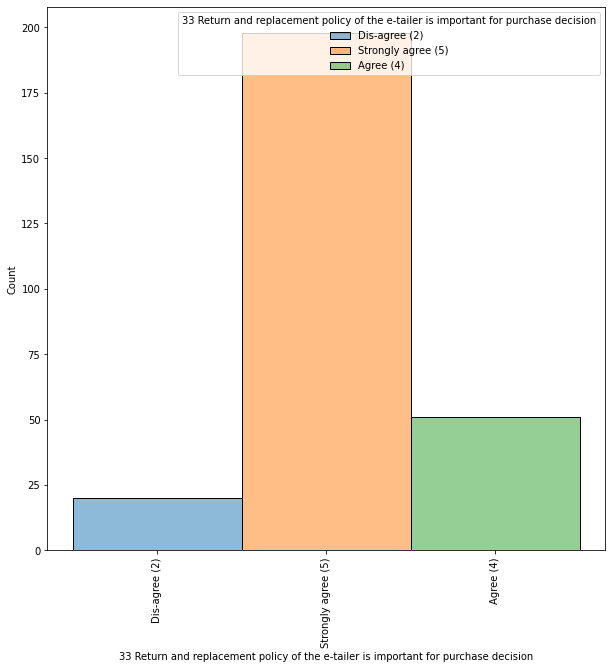

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

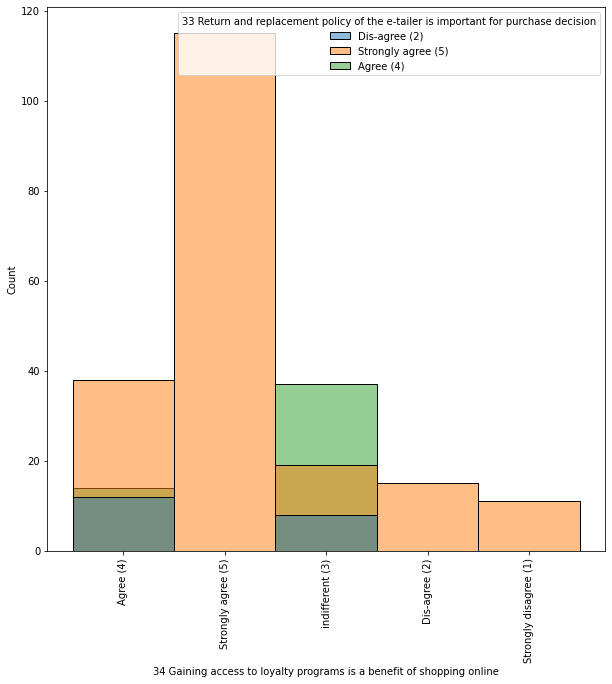

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

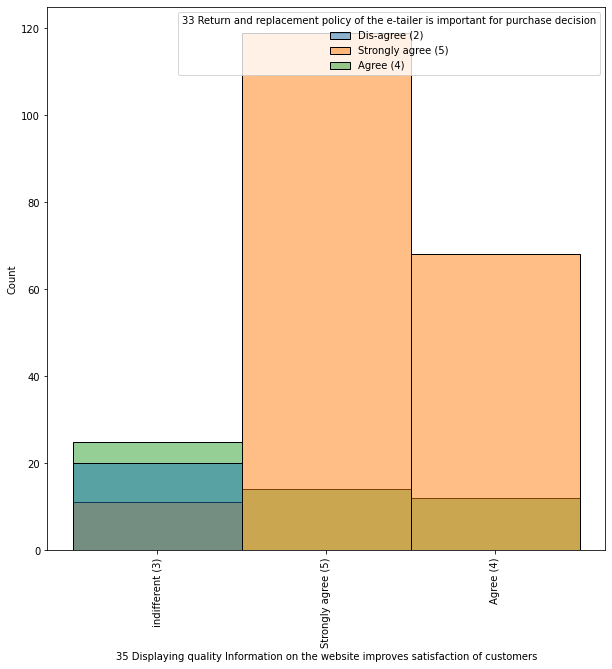

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

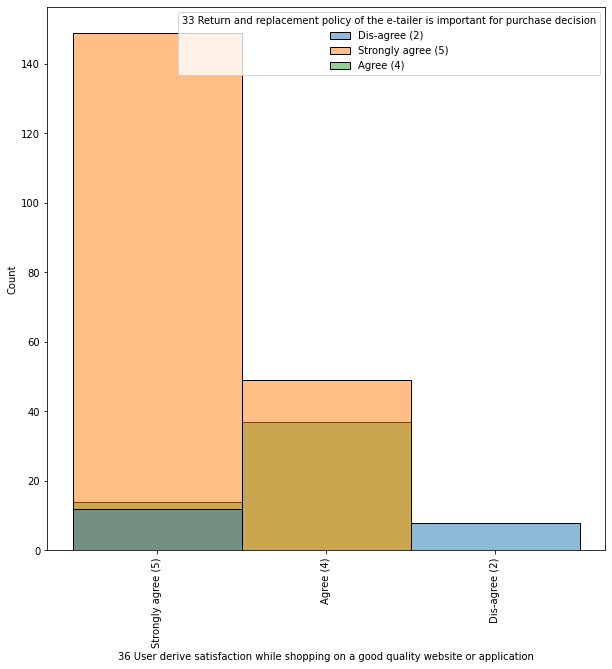

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

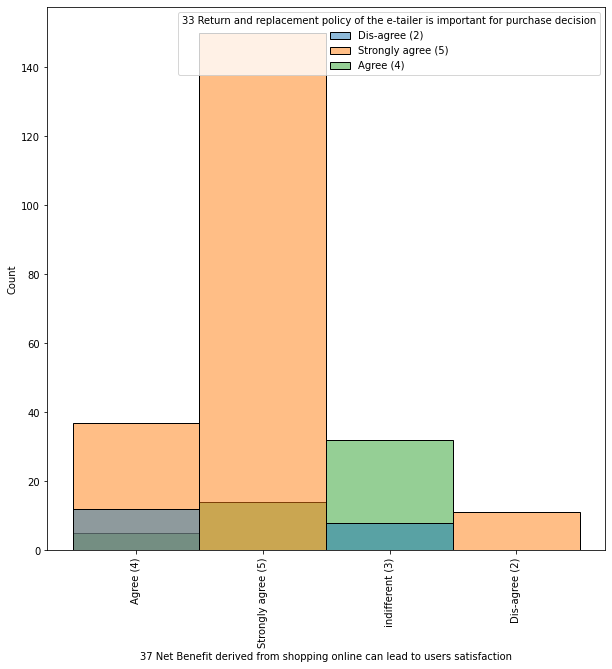

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

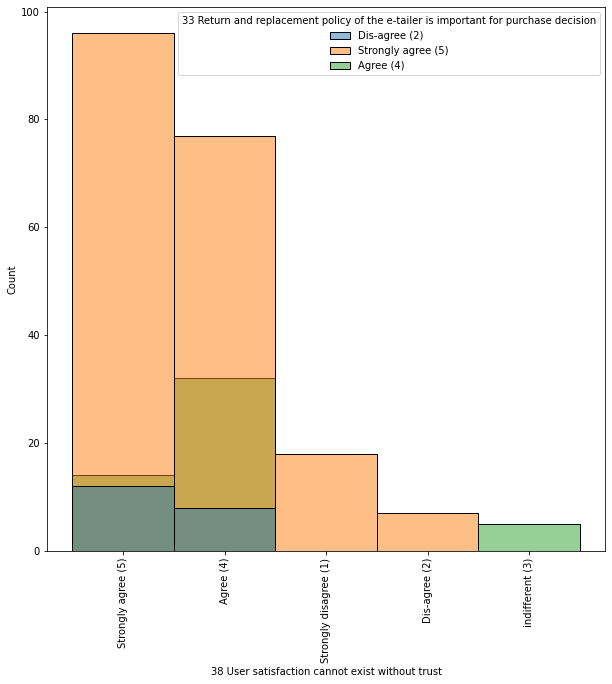

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

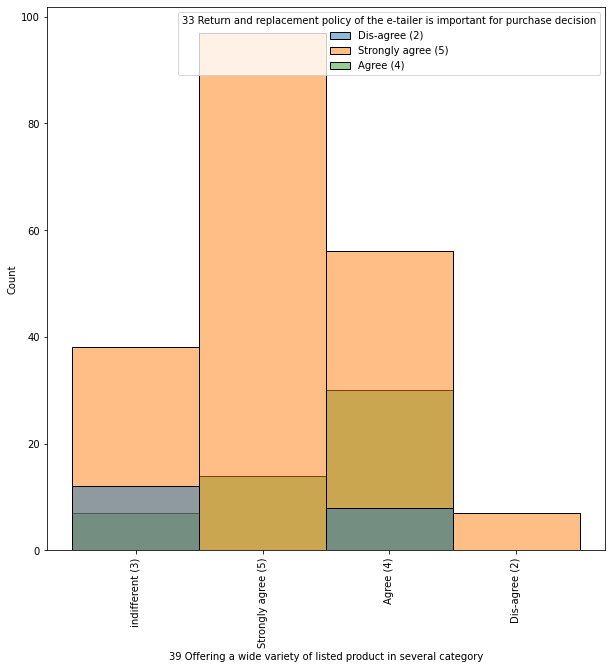

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

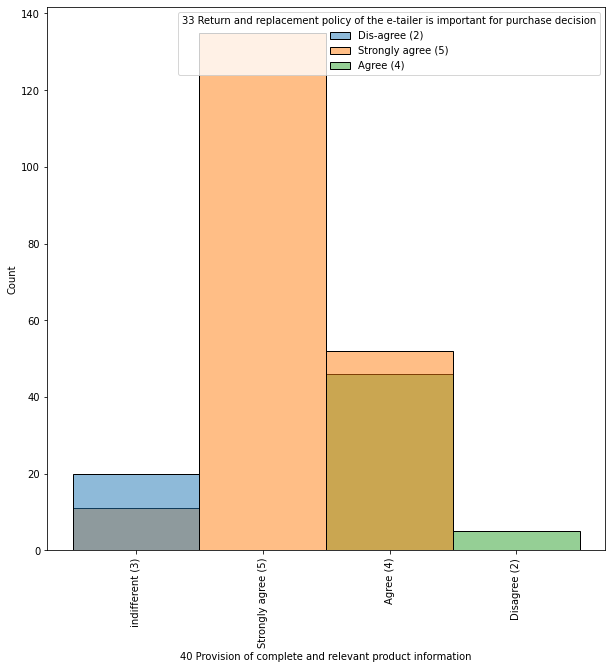

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

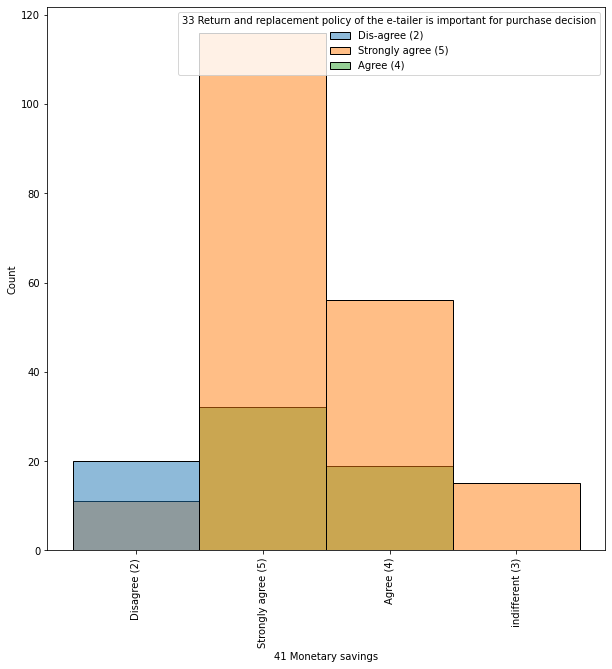

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

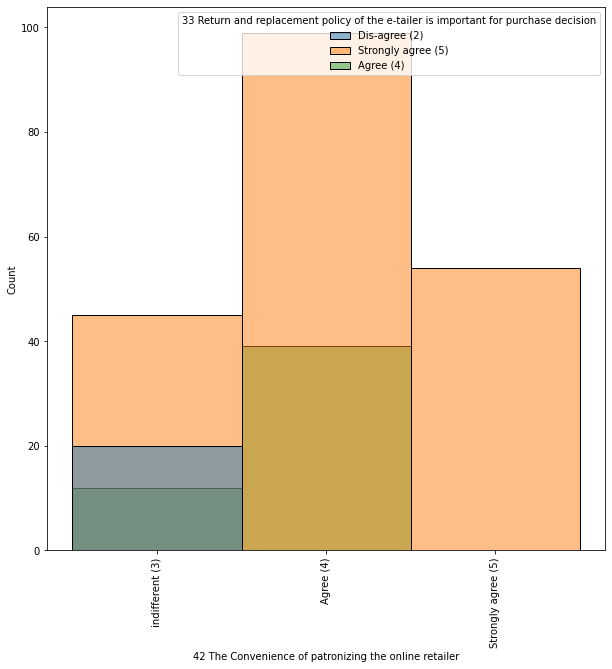

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

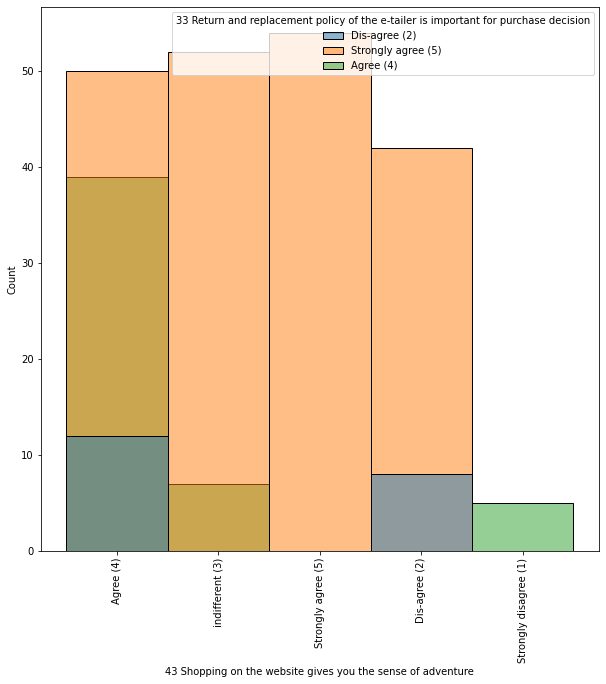

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

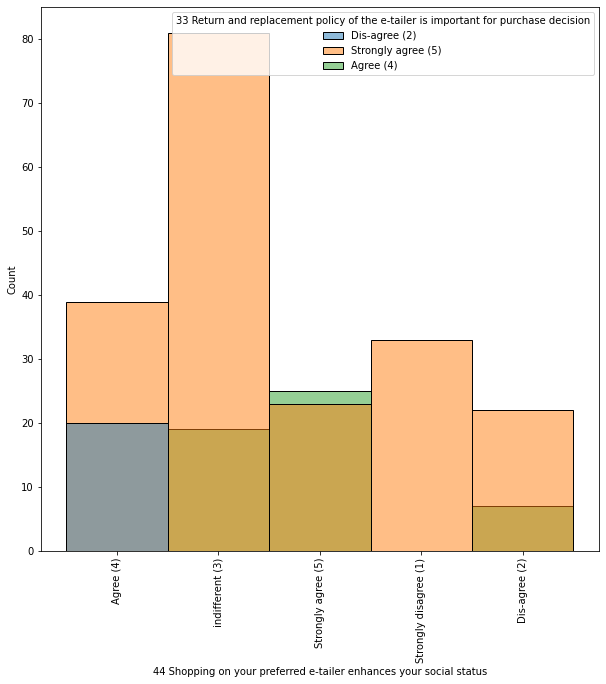

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

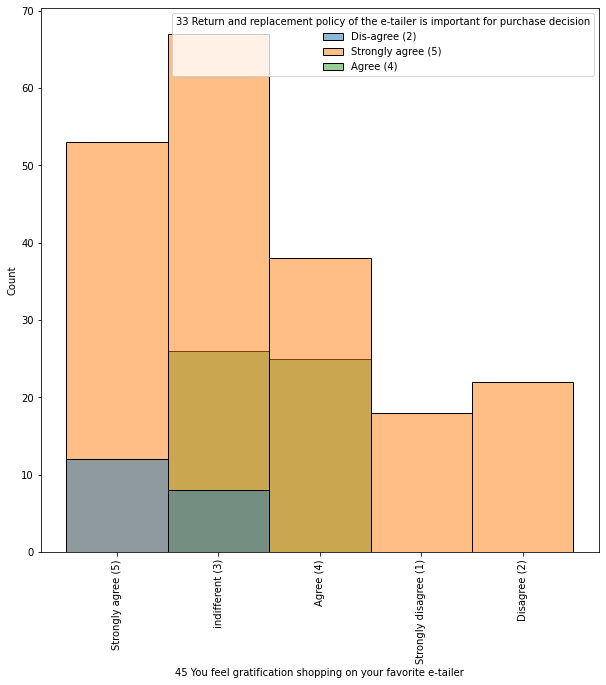

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

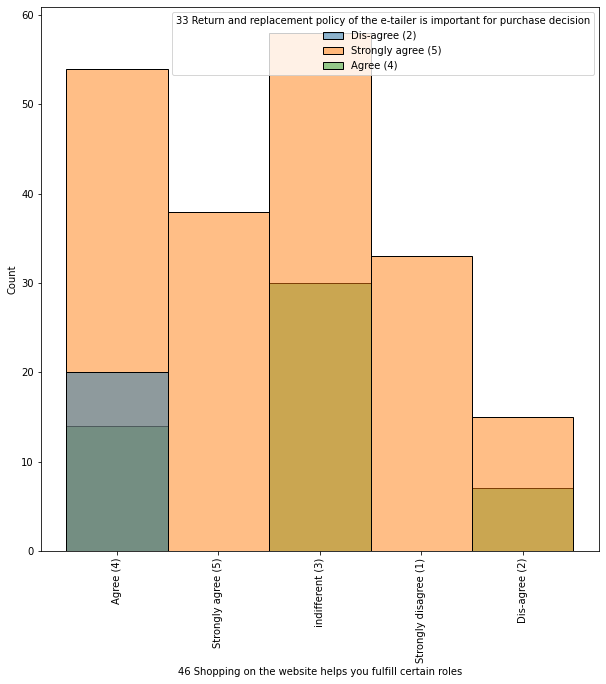

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

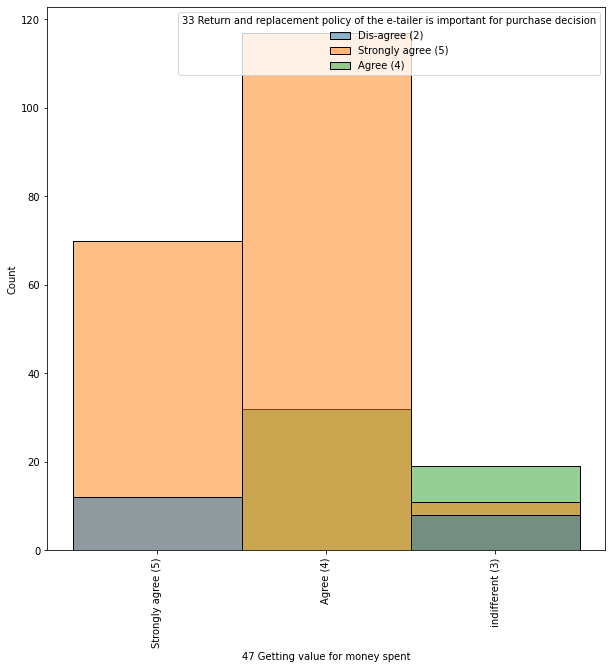

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

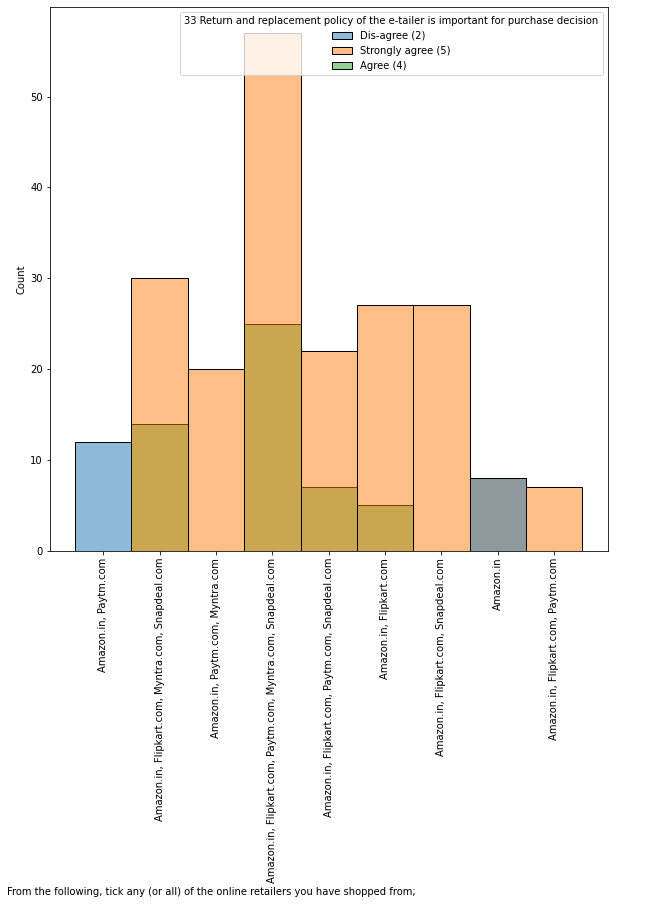

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

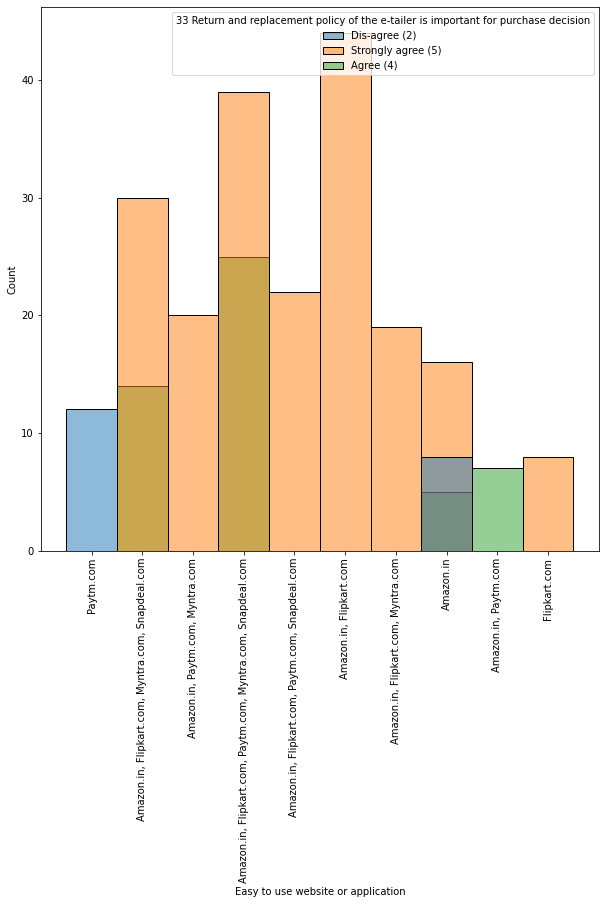

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

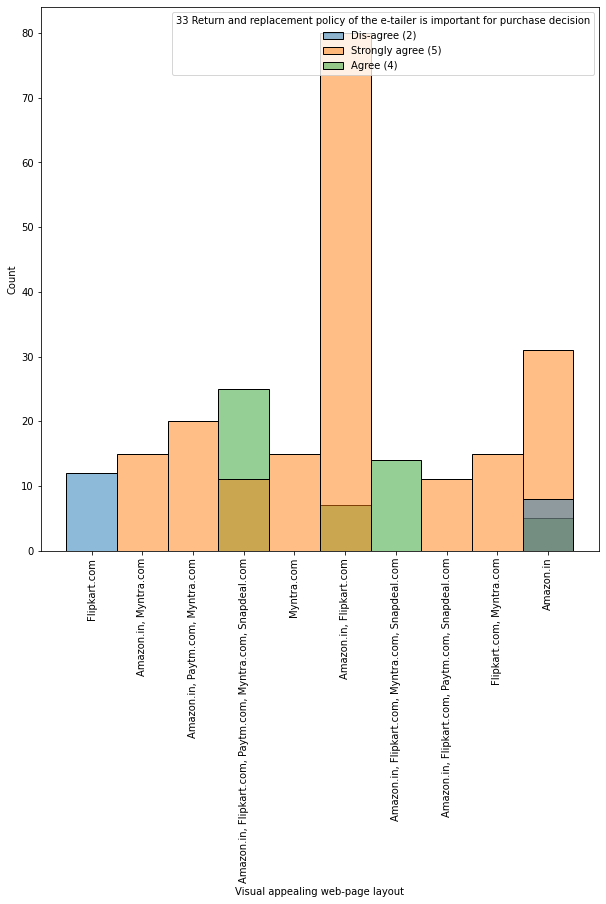

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

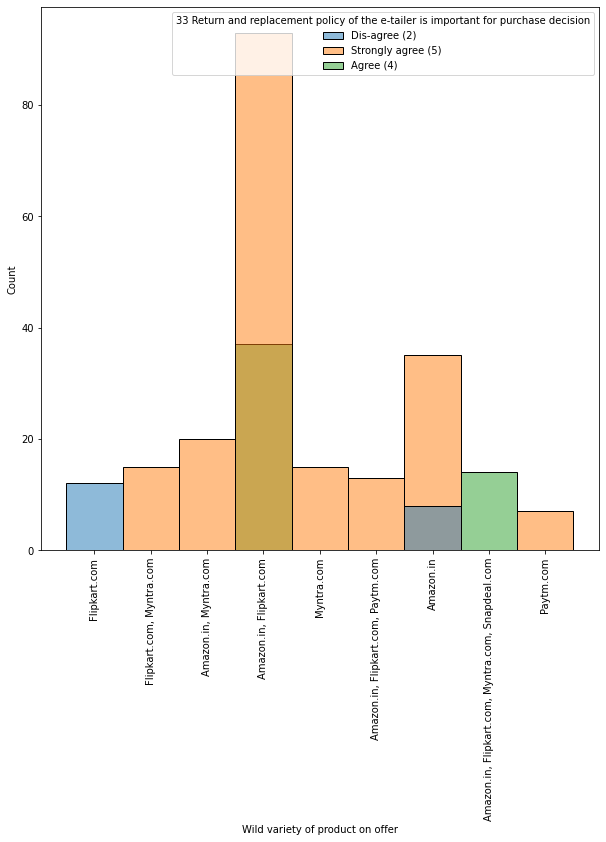

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

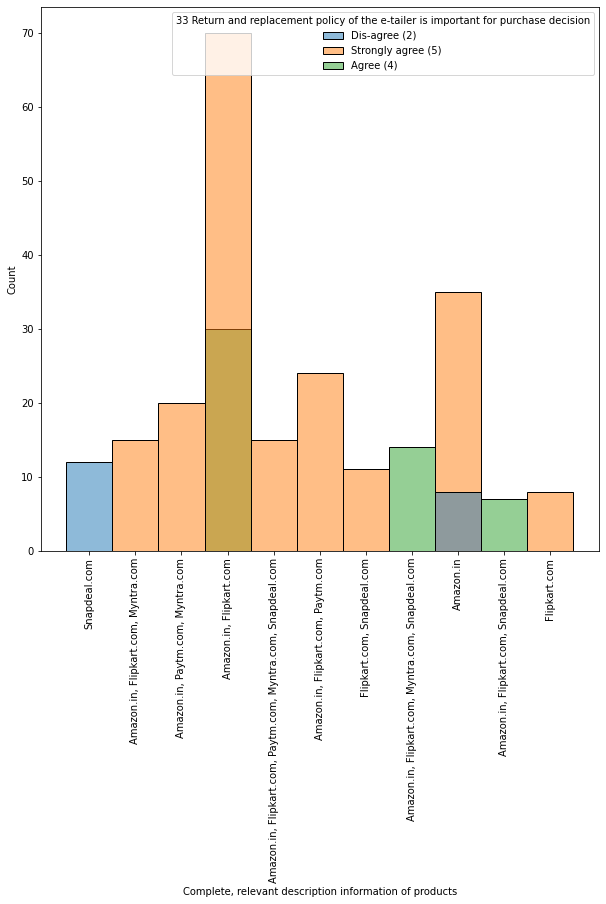

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

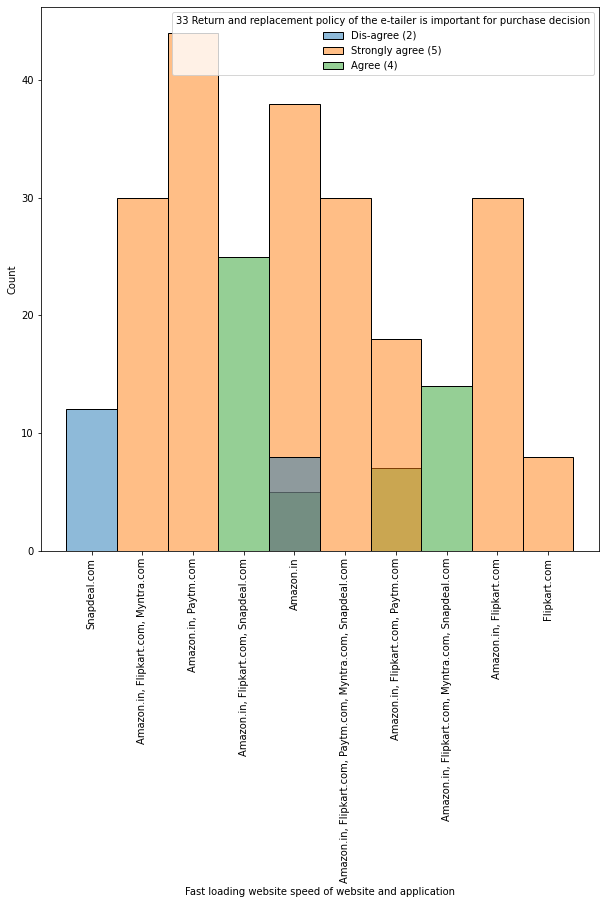

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

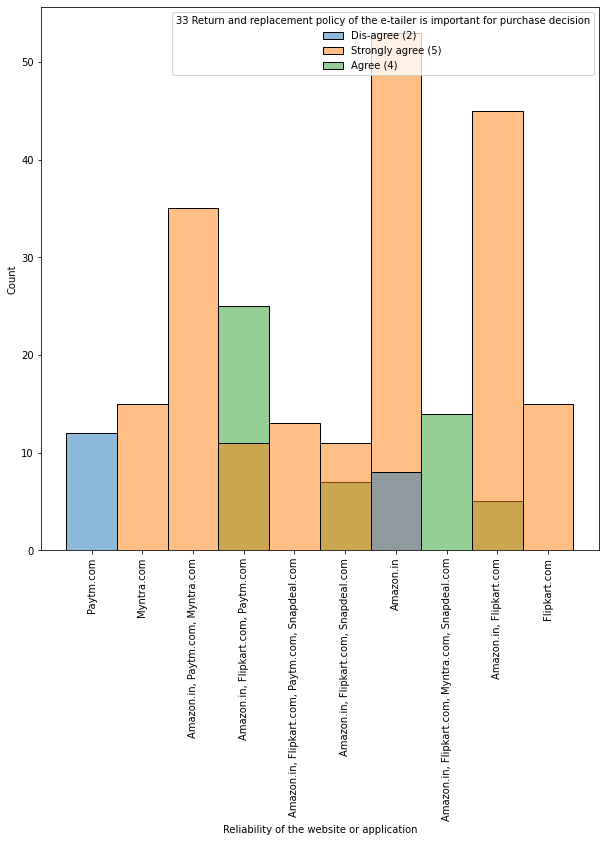

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

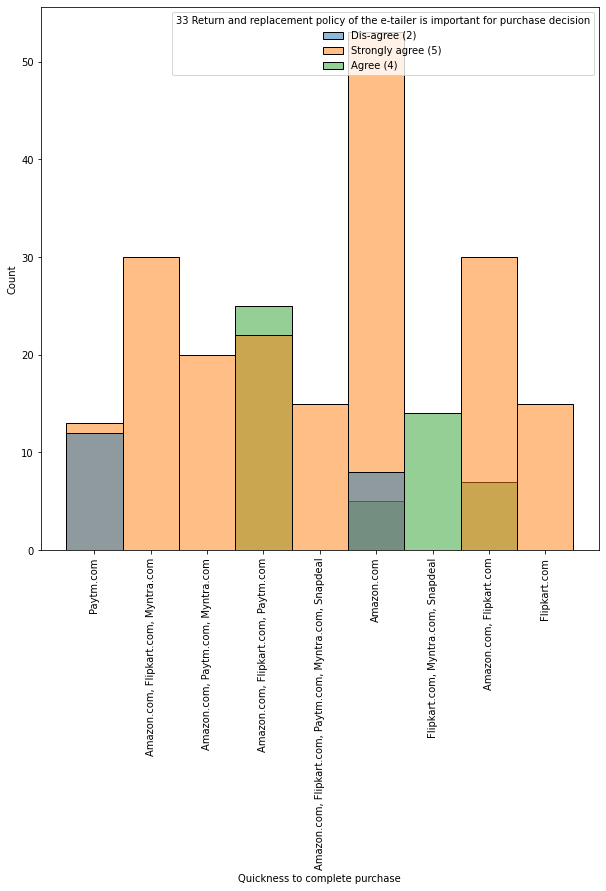

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

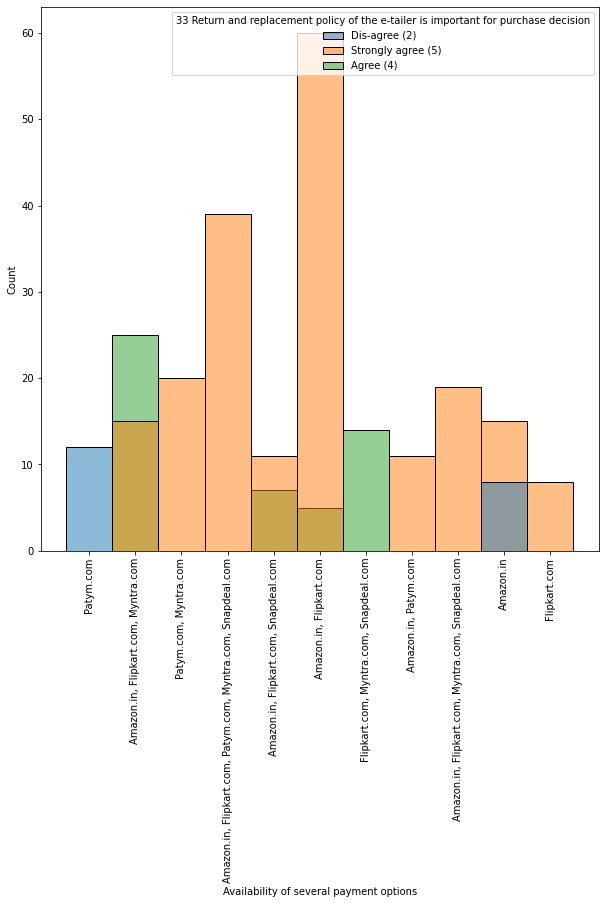

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

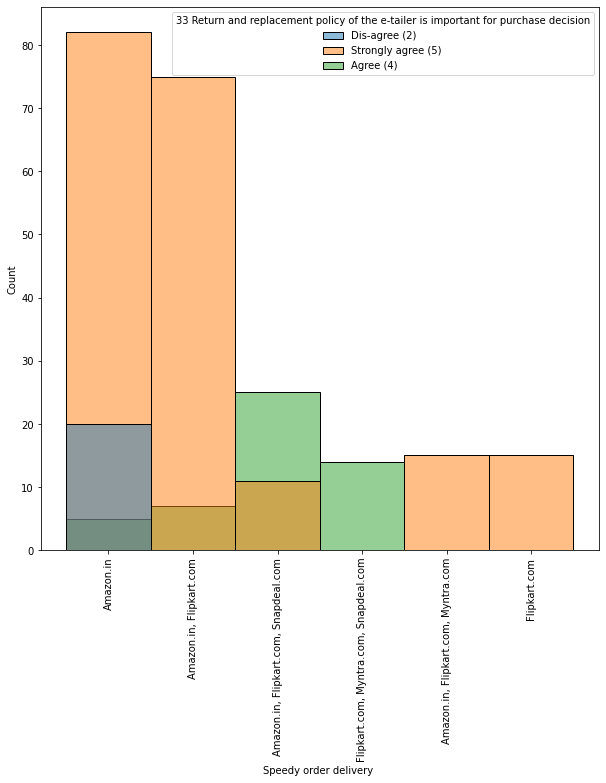

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

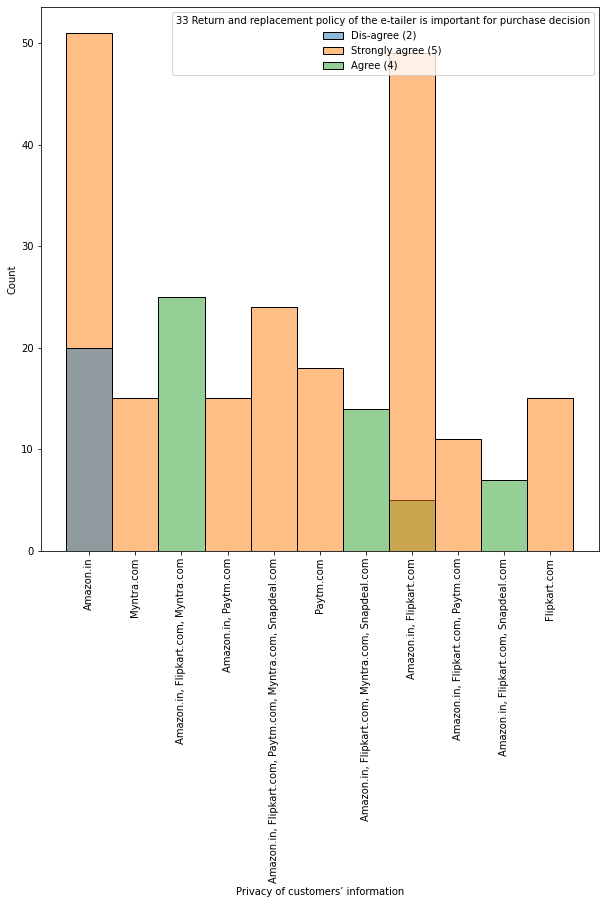

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

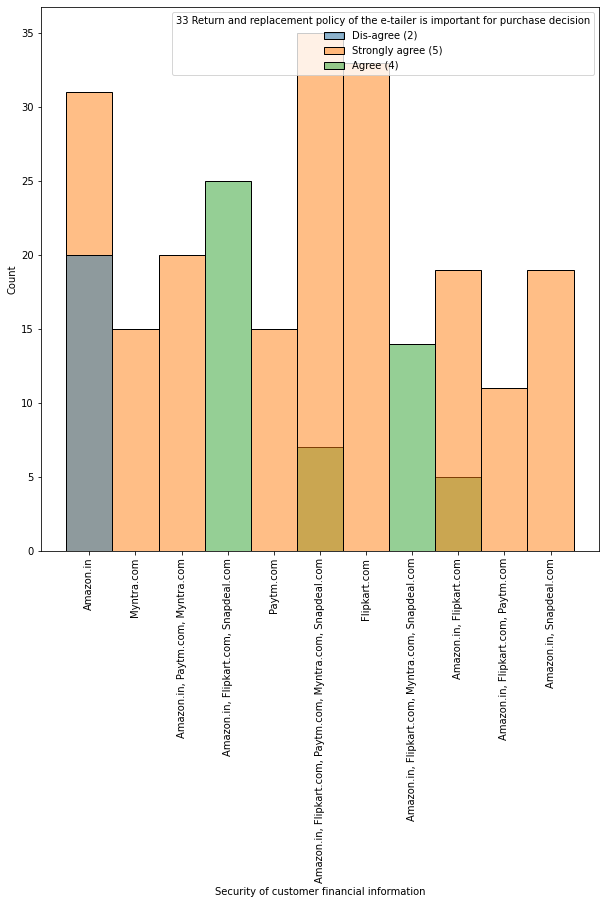

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

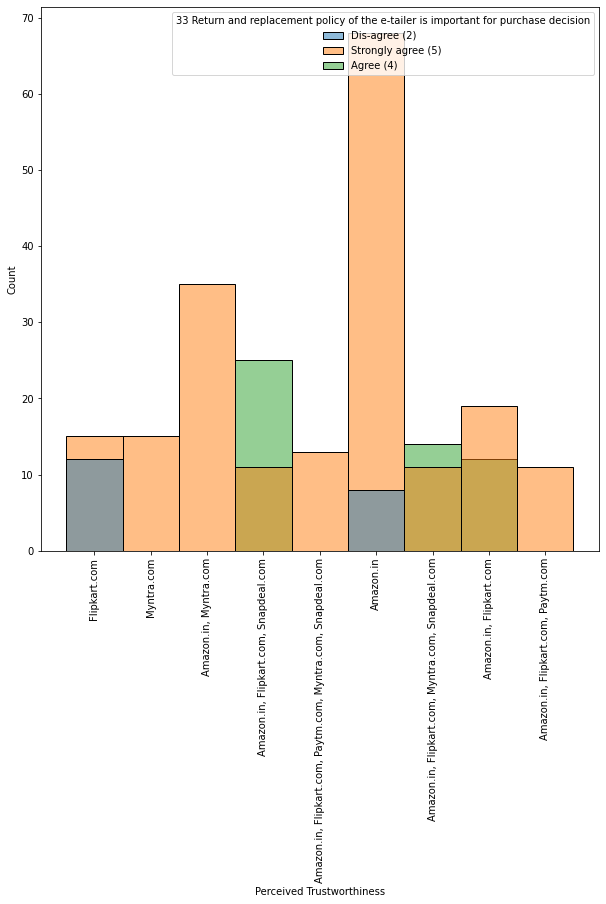

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

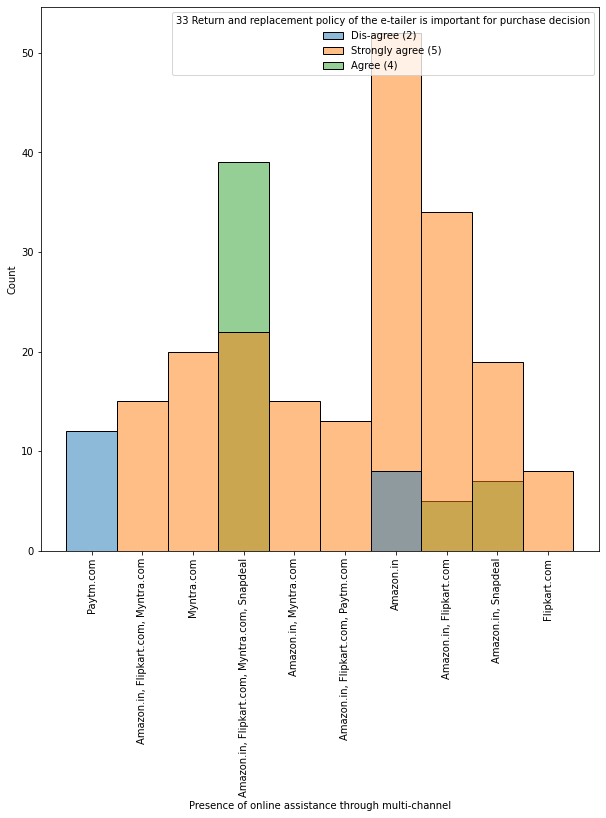

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

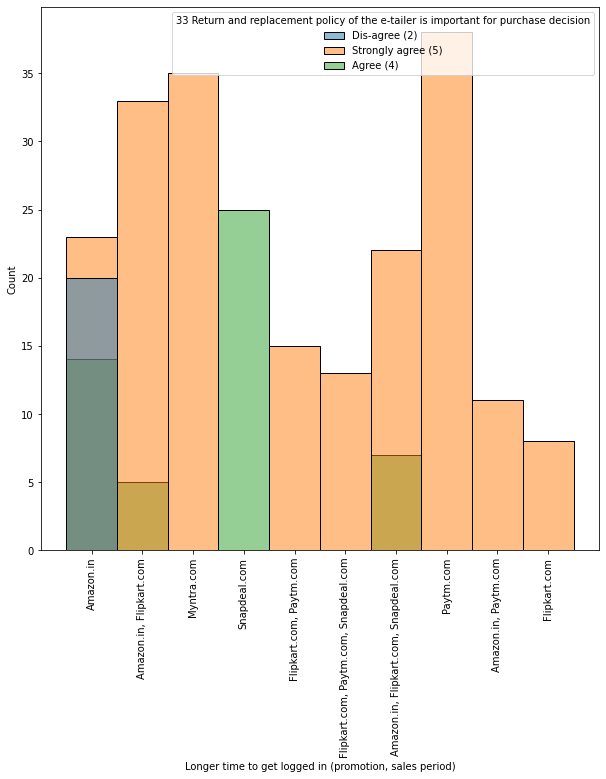

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

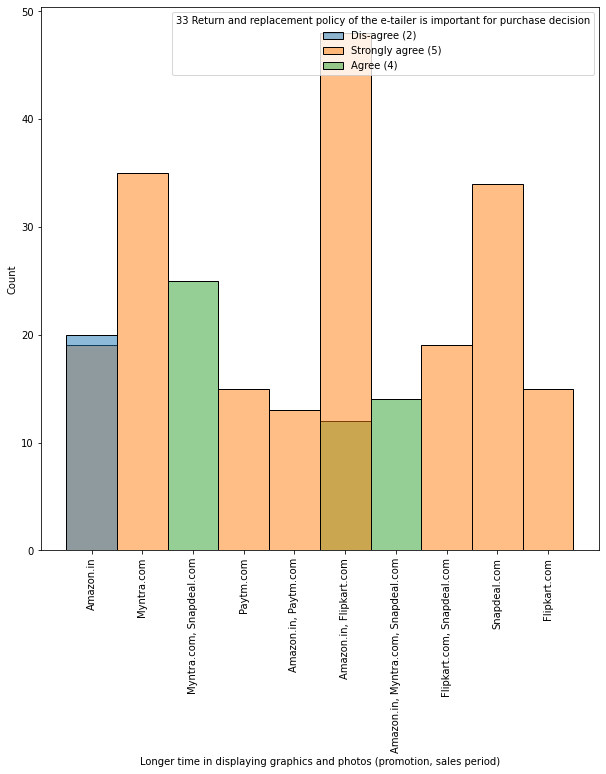

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

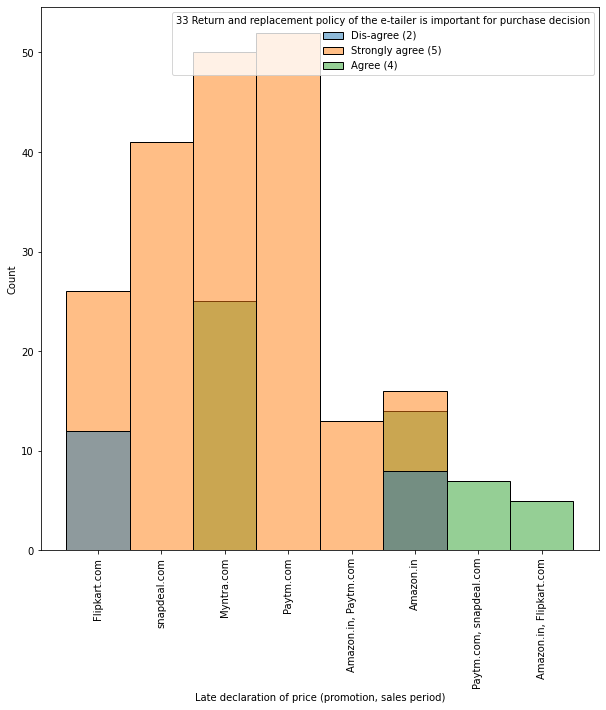

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

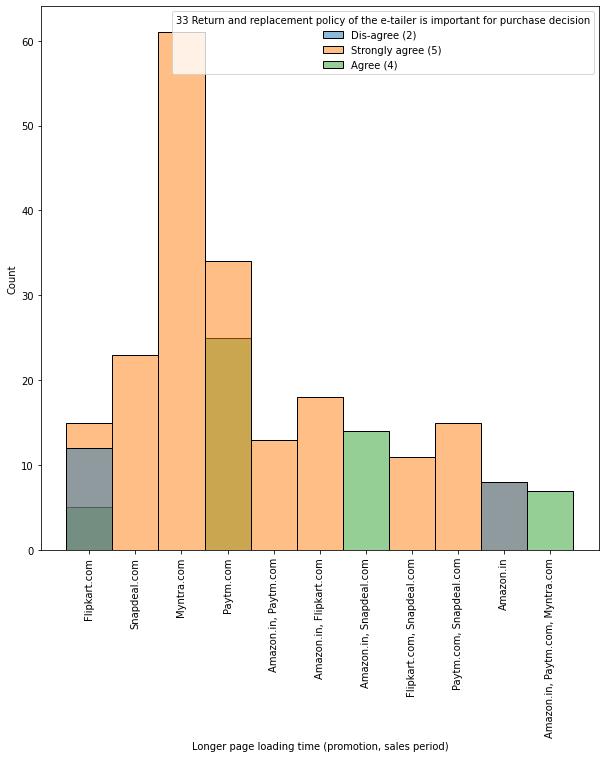

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

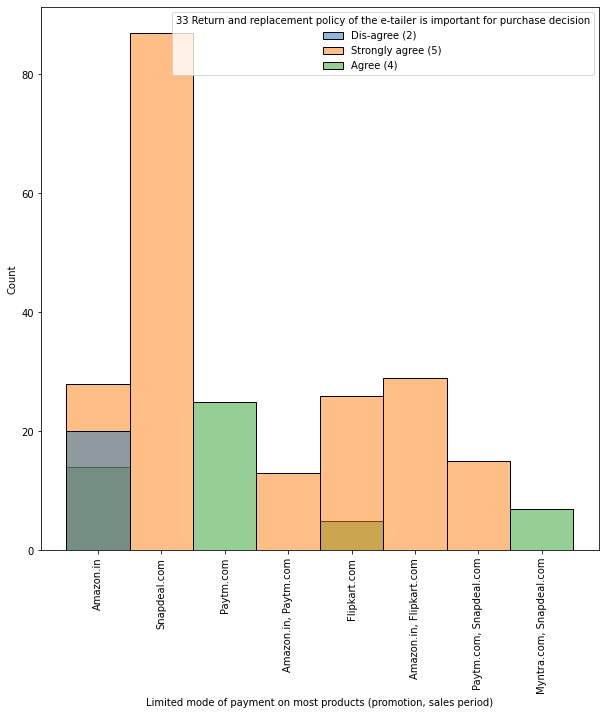

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

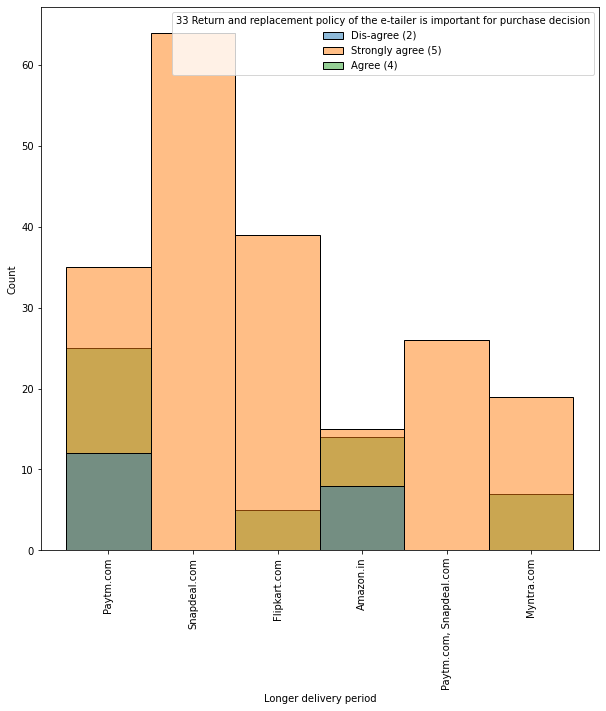

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

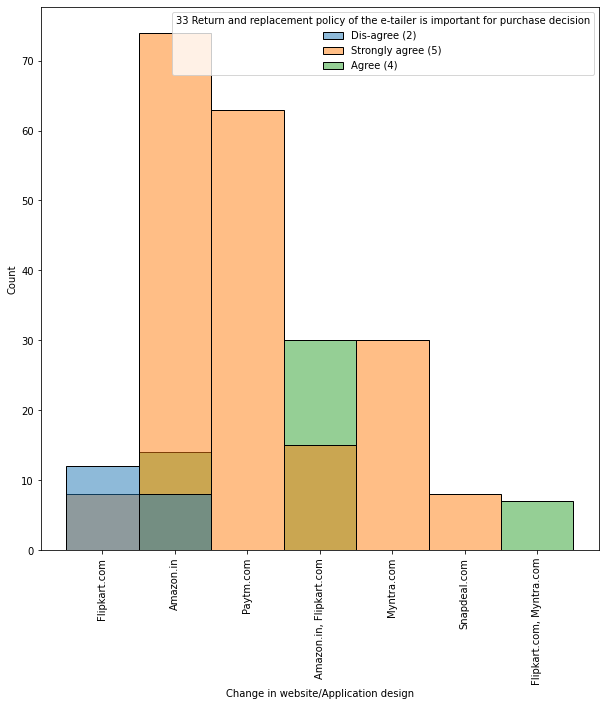

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

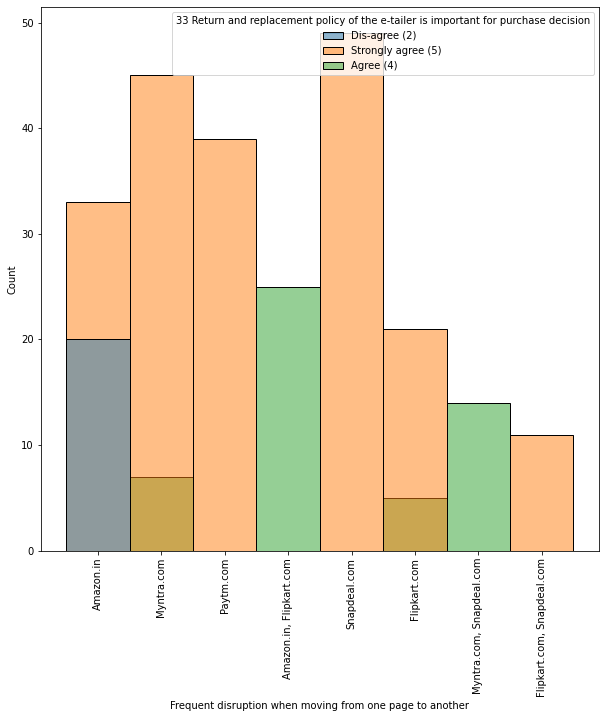

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

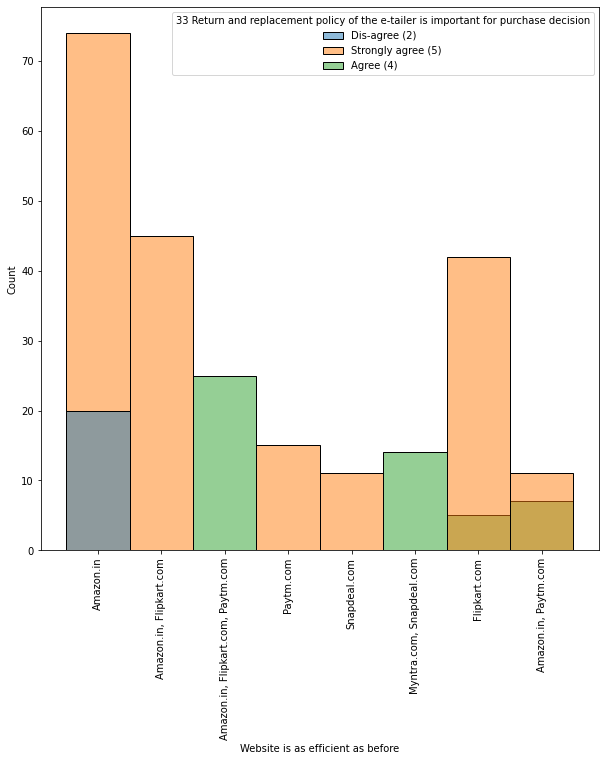

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

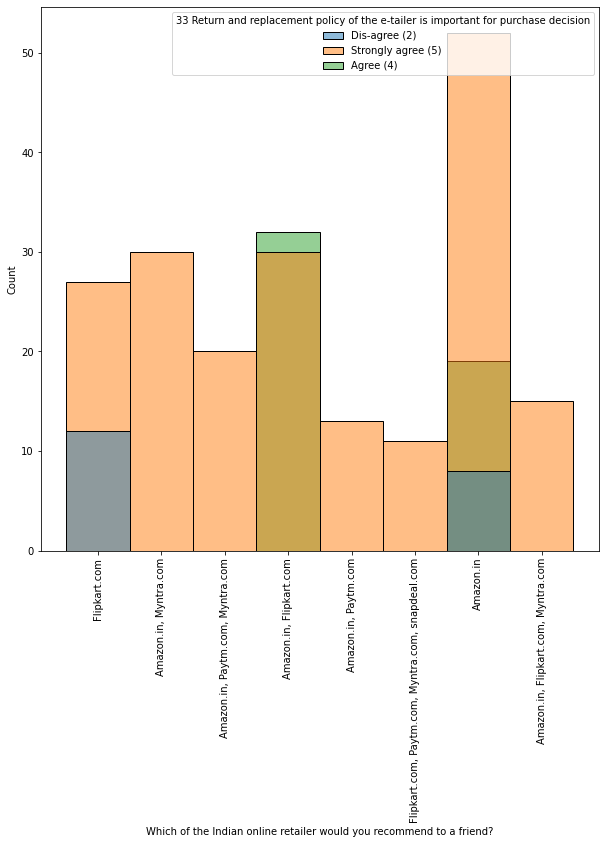

In [18]:
# Histogram with respect to value for money spent
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['33 Return and replacement policy of the e-tailer is important for purchase decision'])
    plt.xticks(rotation ='90')
    plt.show()

It can be estimated from above histogram that significant respondants strongly agree that return policy is important

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

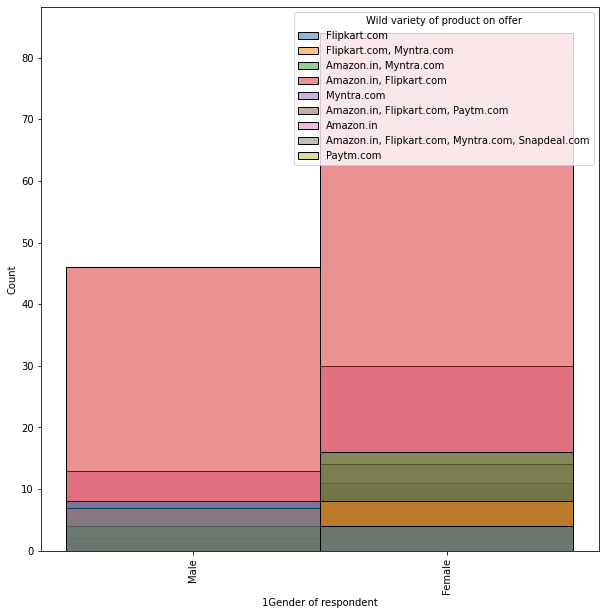

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

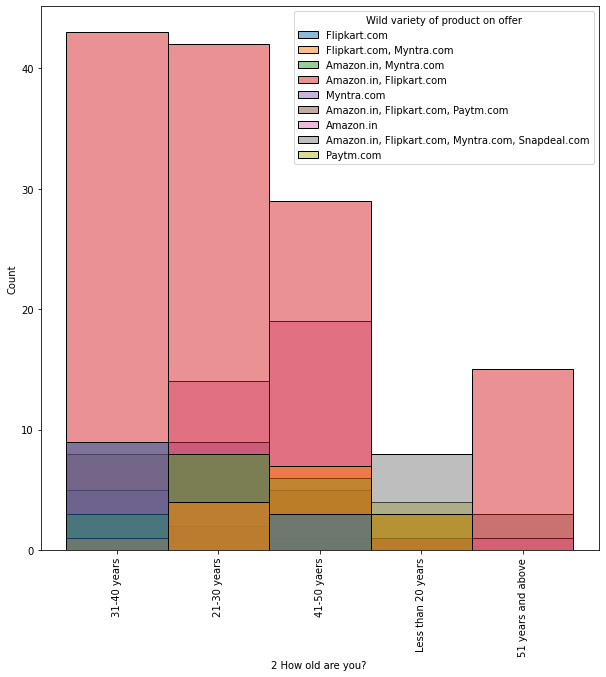

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

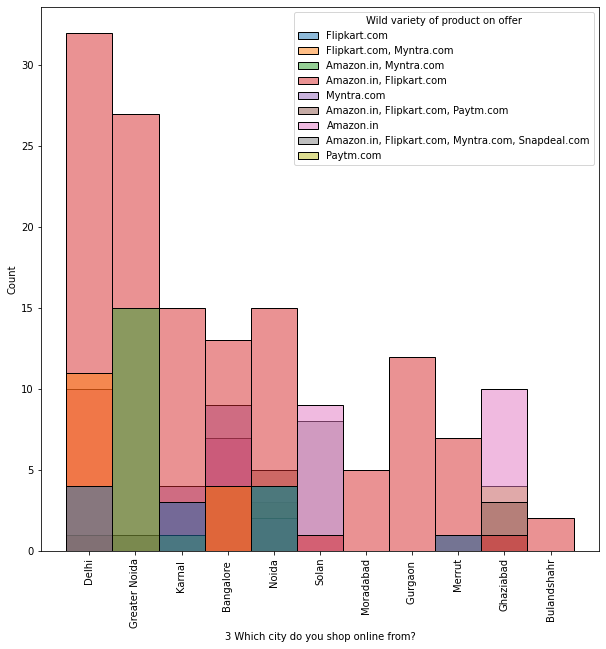

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

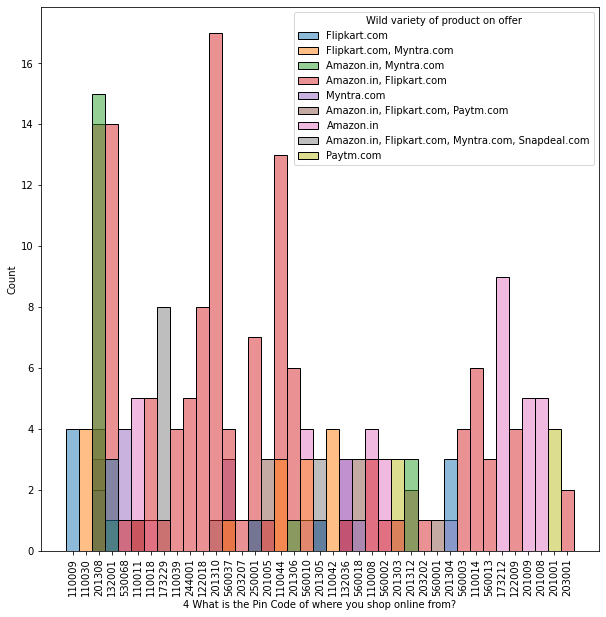

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

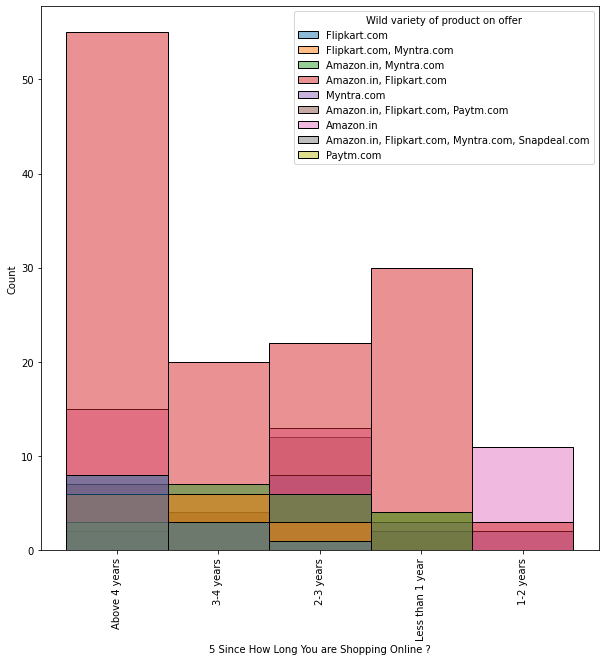

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

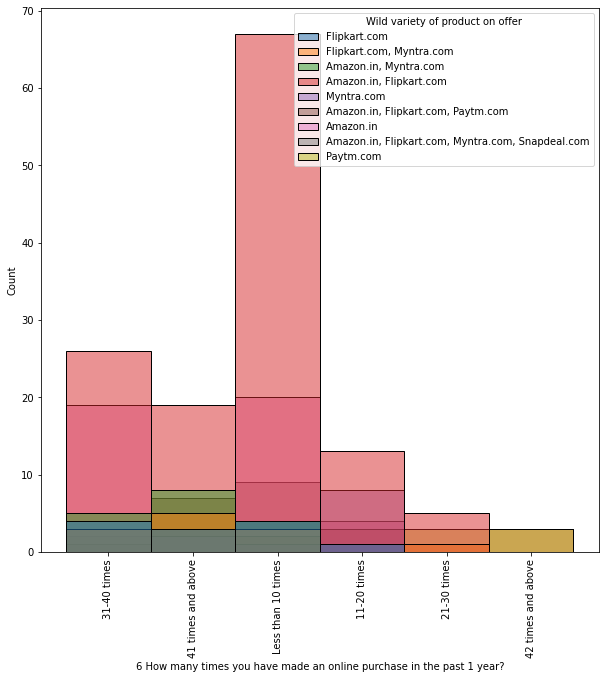

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

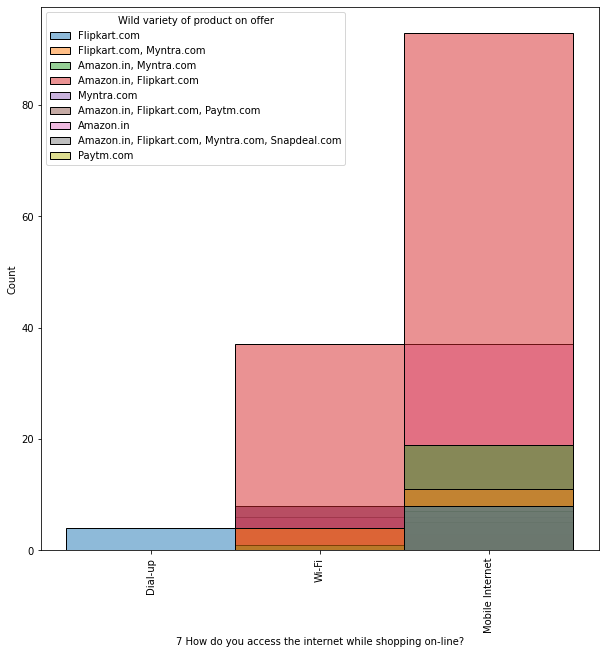

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

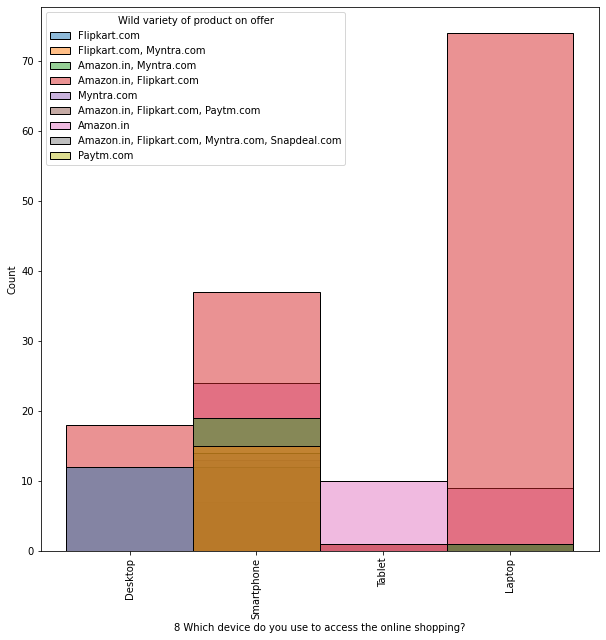

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

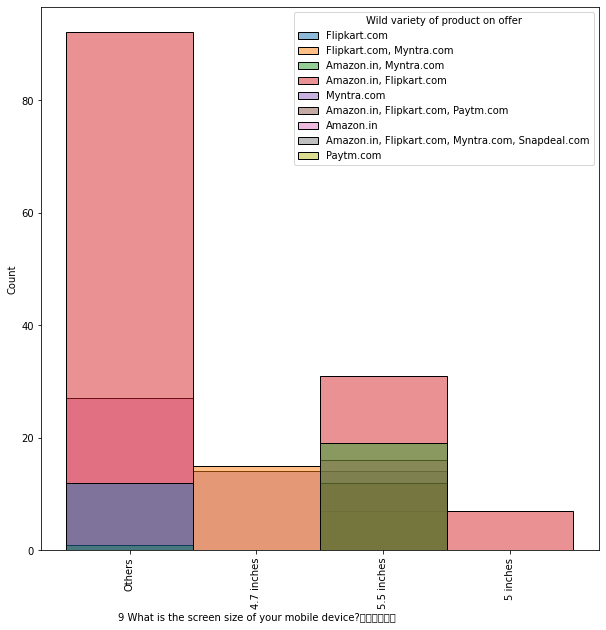

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

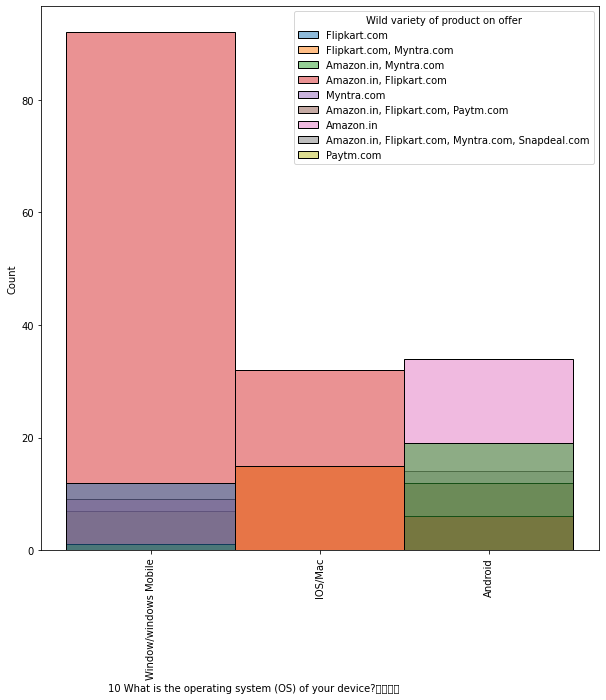

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

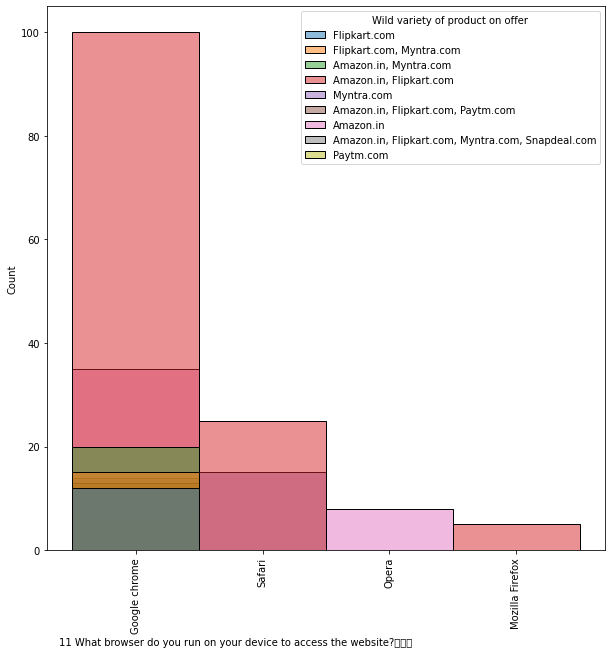

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

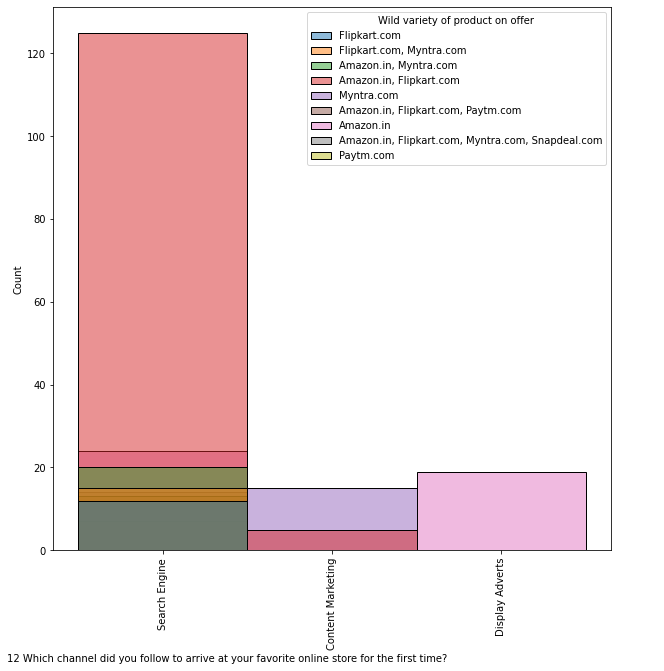

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

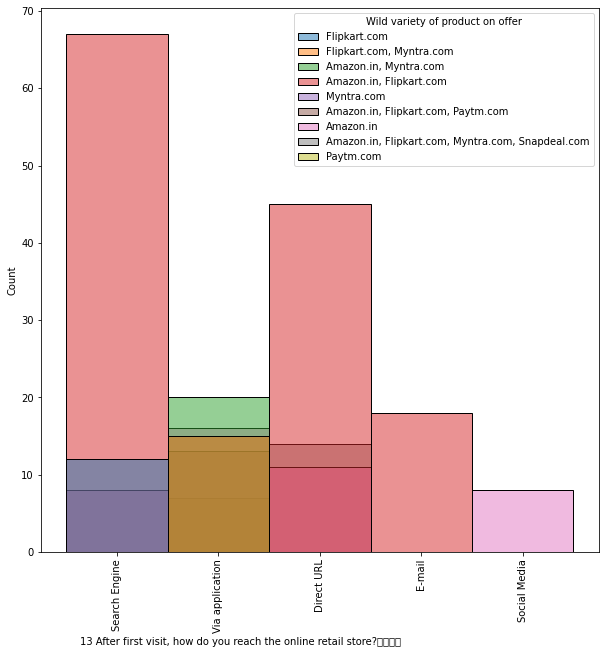

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

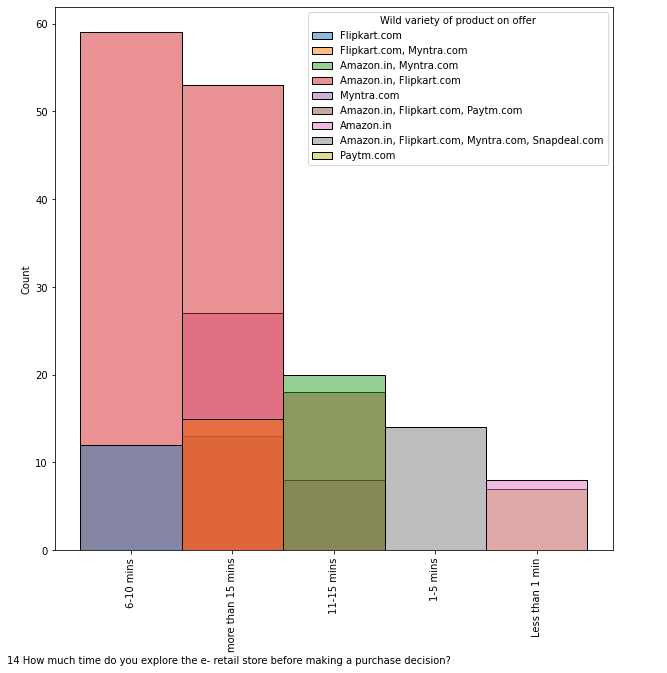

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

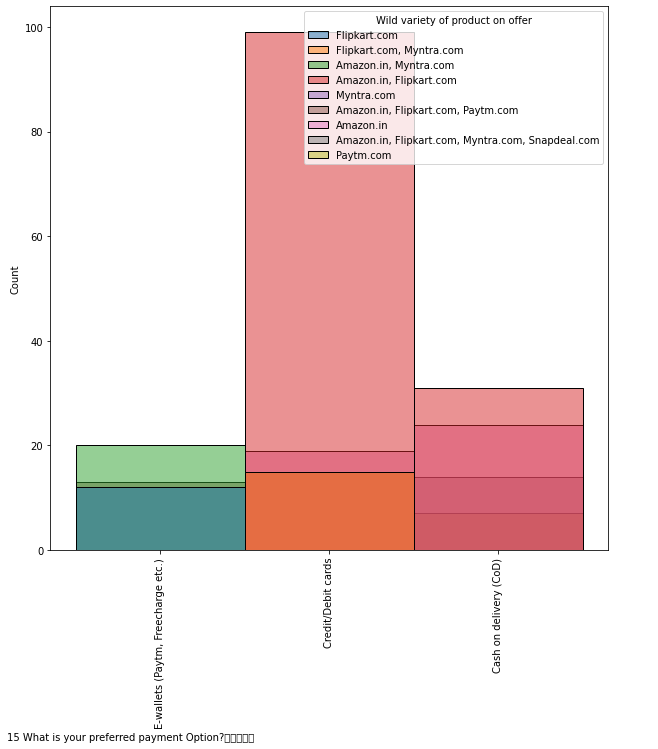

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

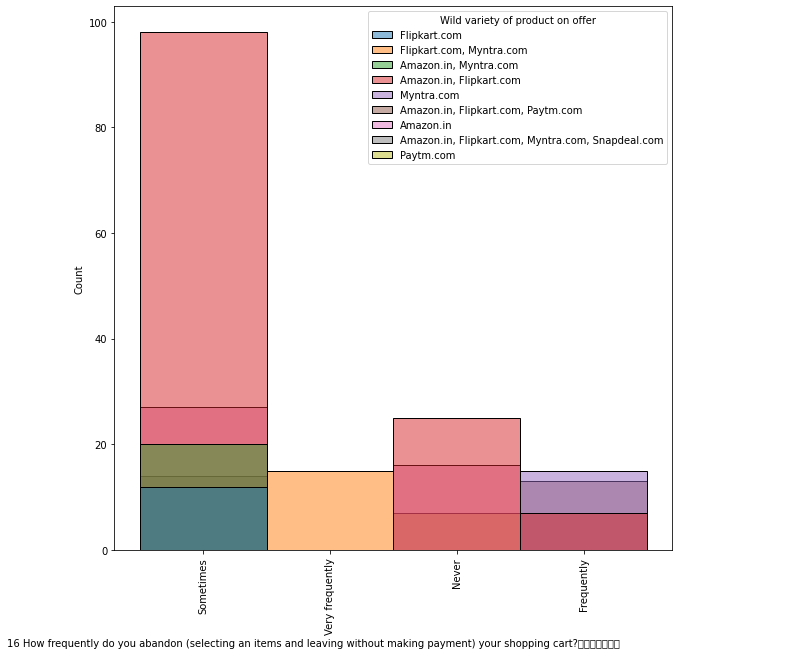

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

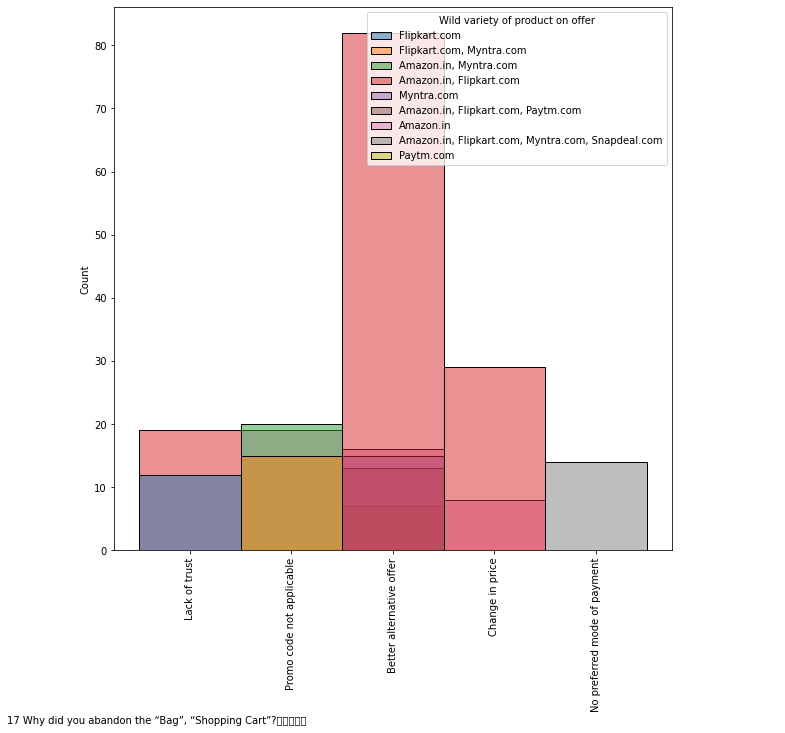

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

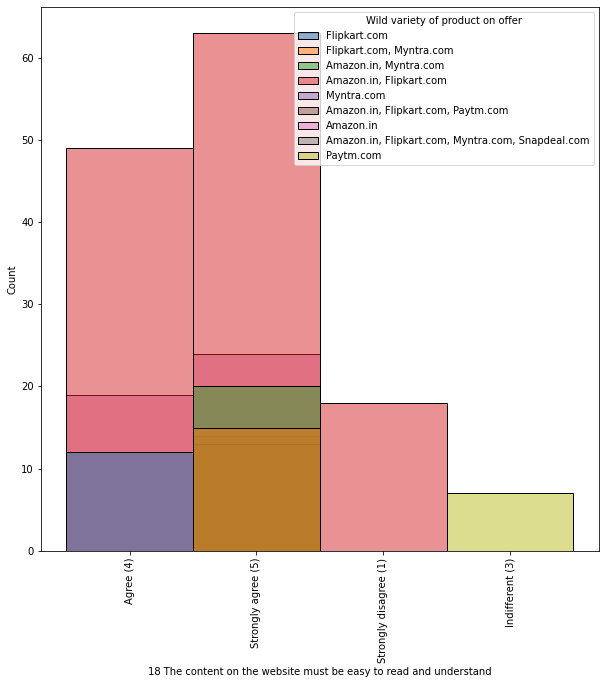

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

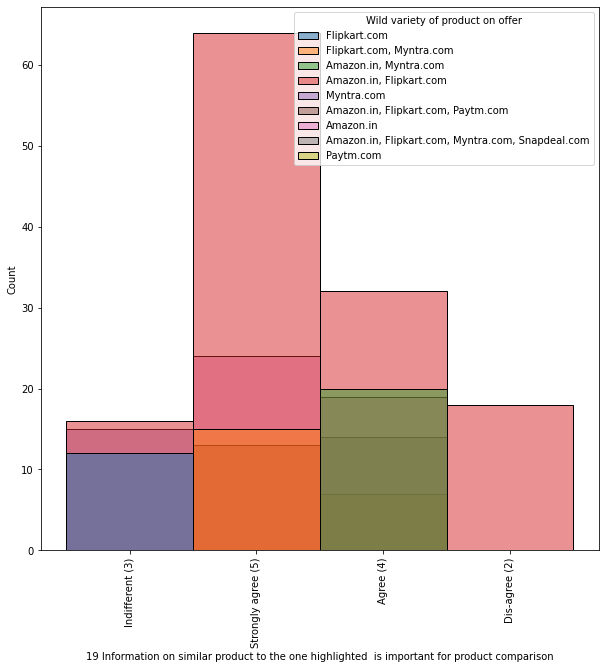

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

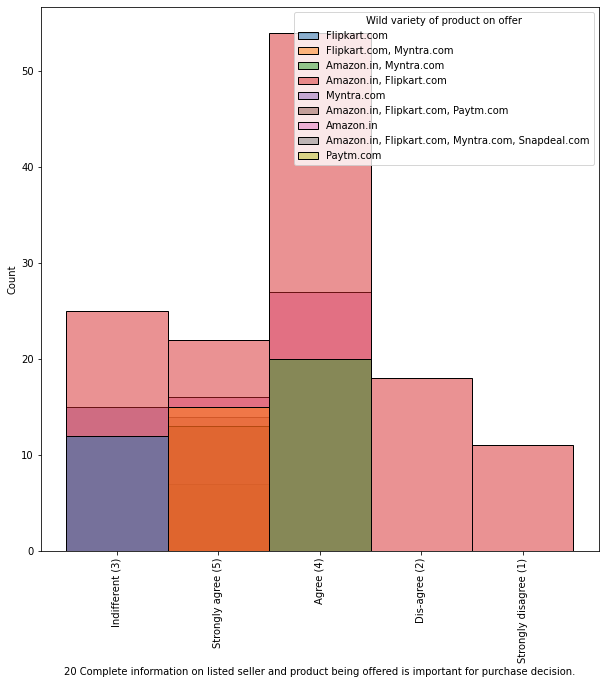

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

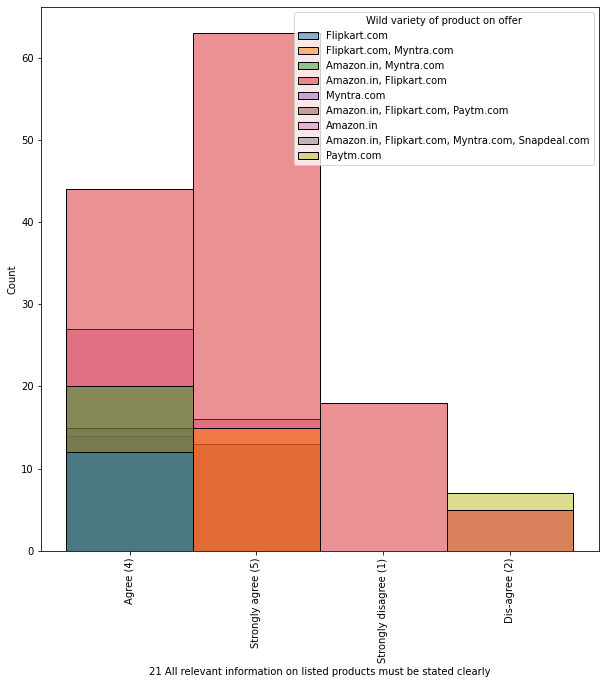

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

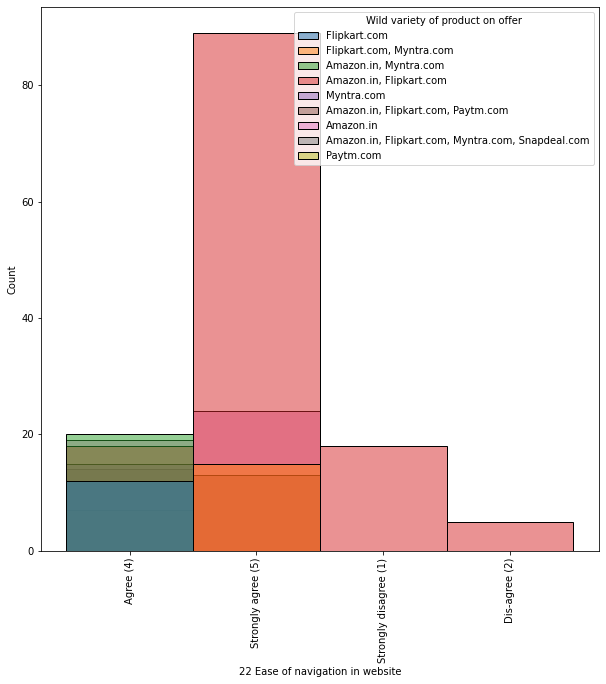

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

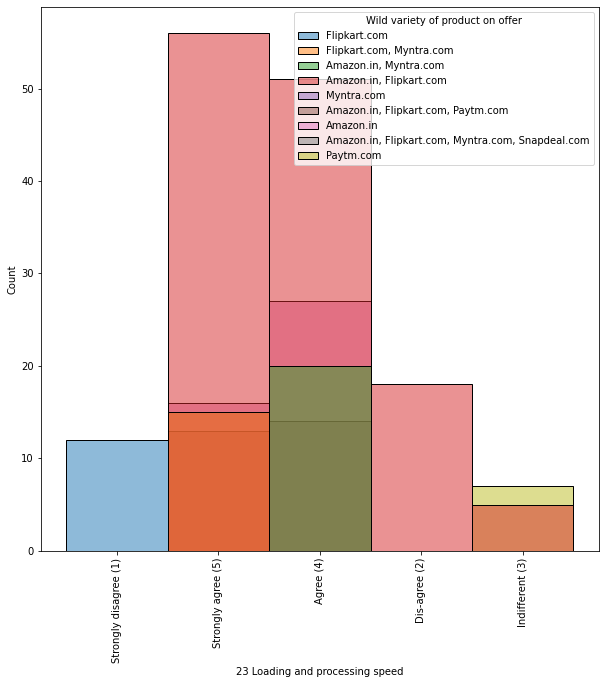

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

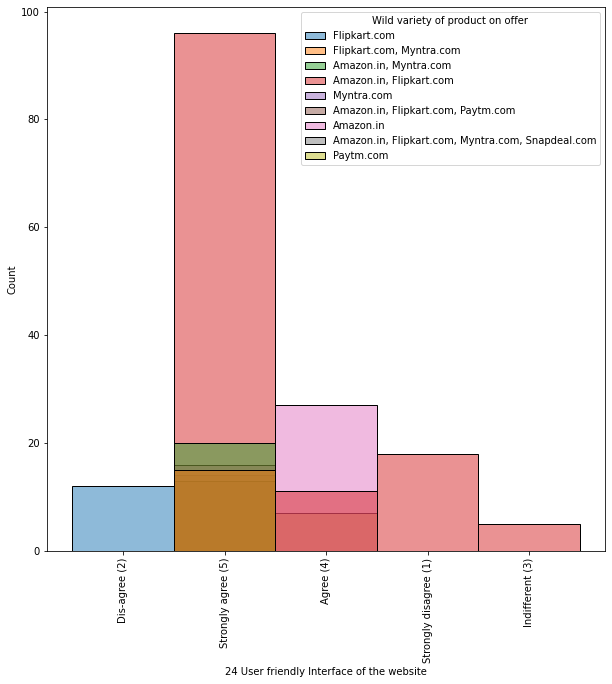

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

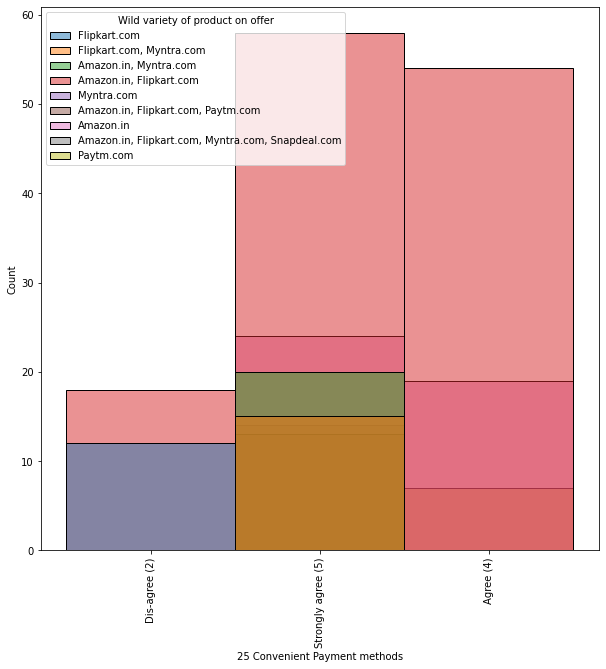

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

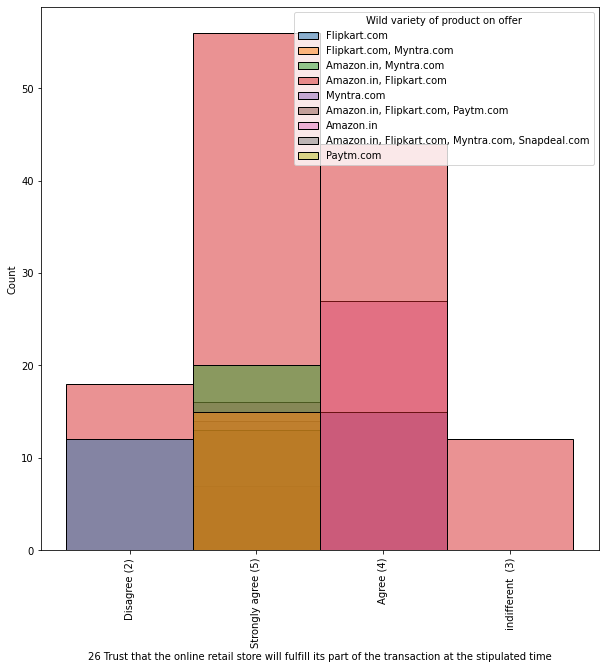

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

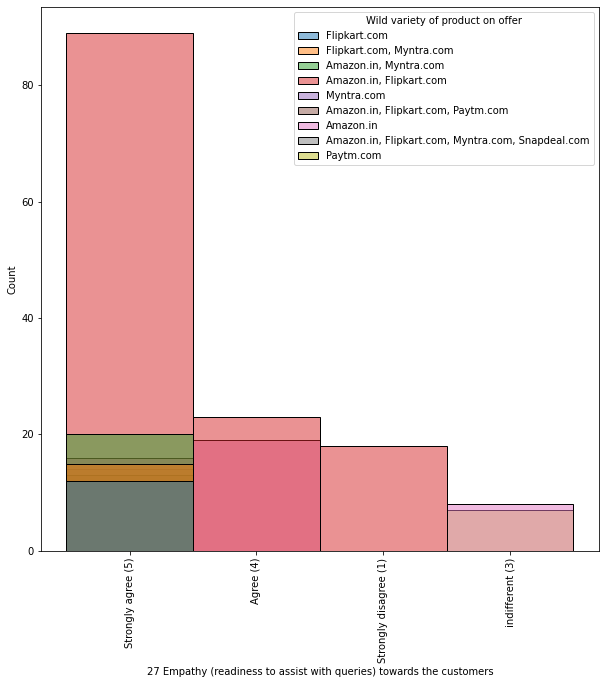

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

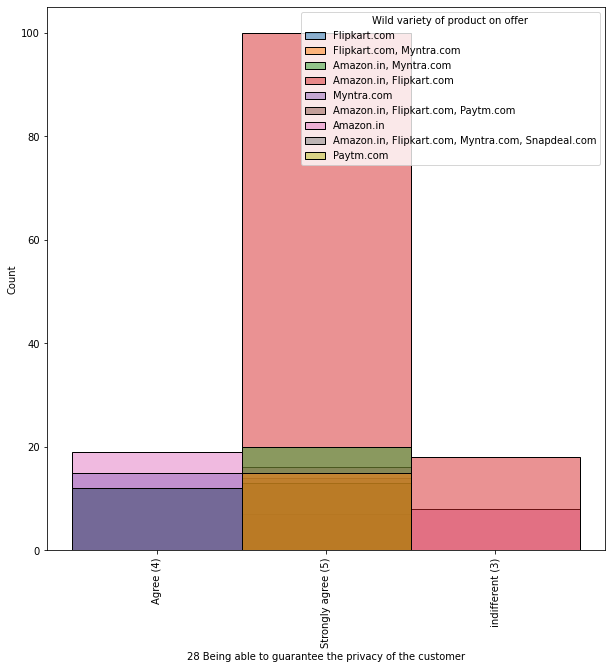

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

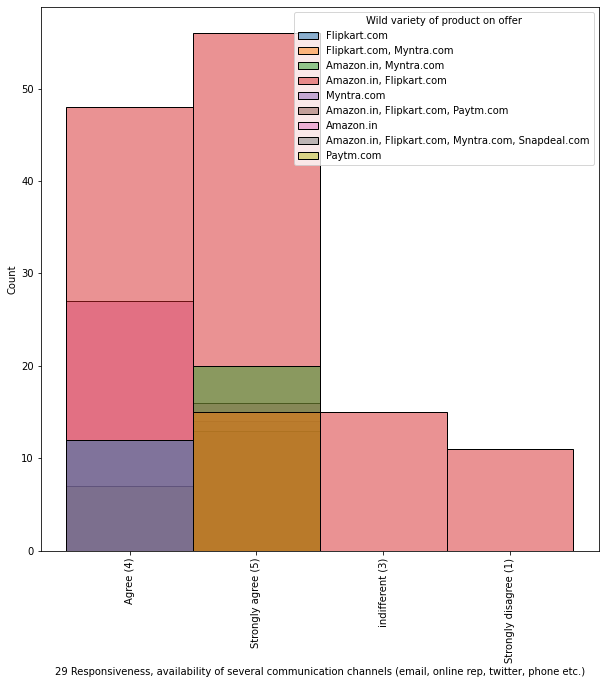

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

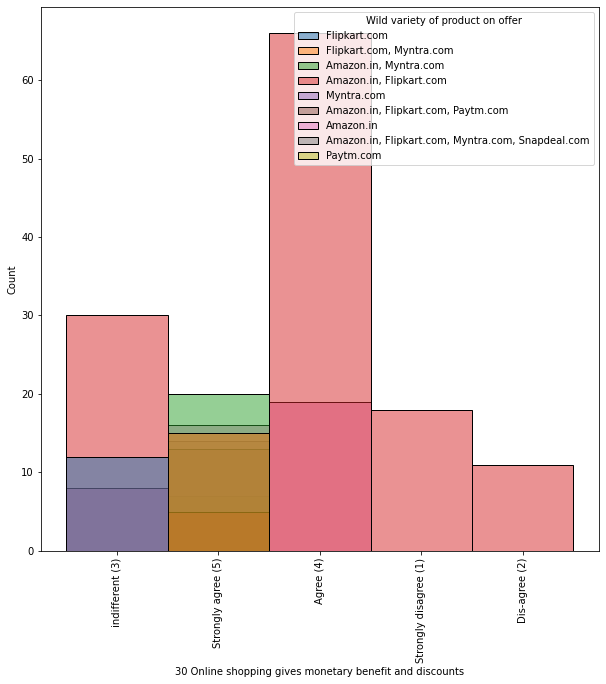

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

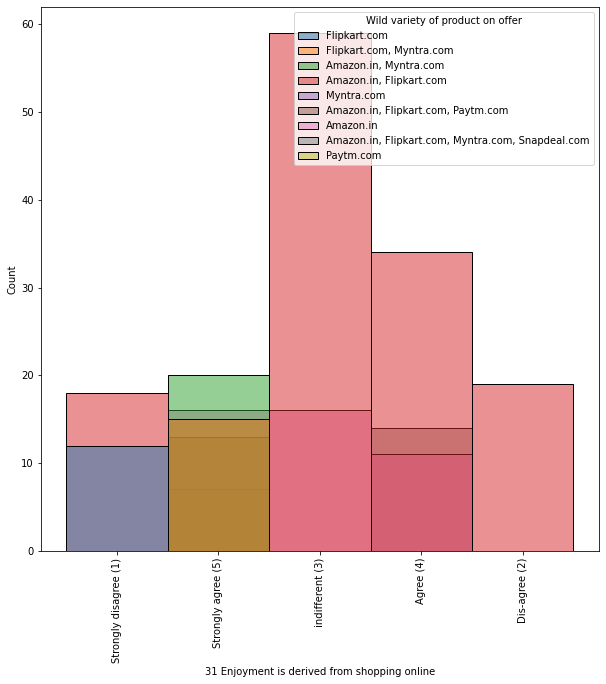

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

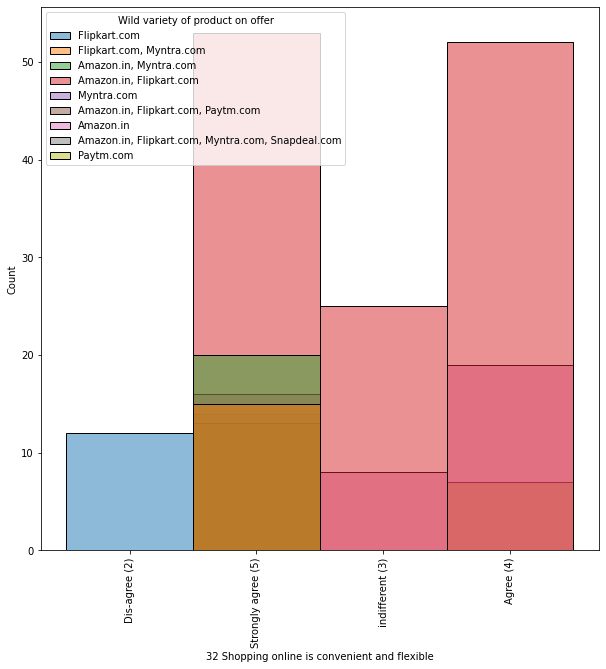

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

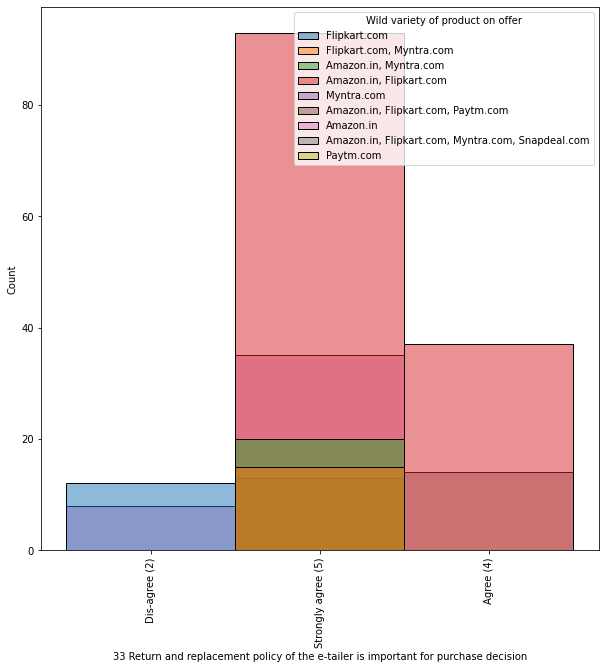

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

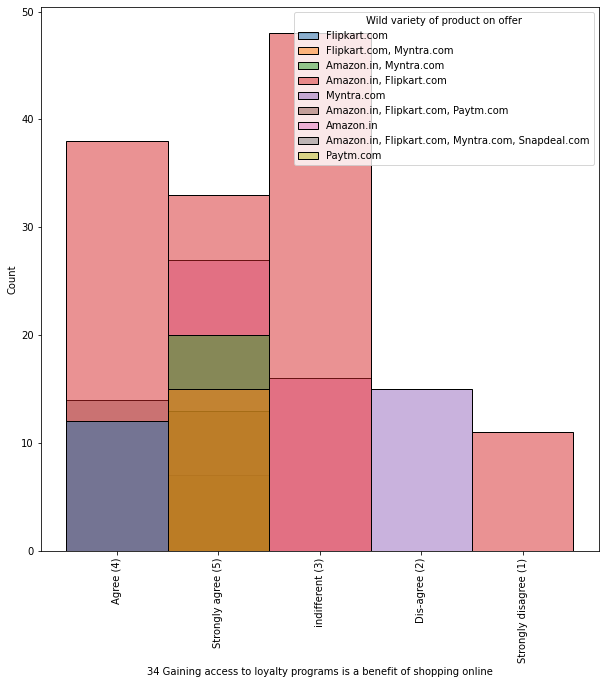

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

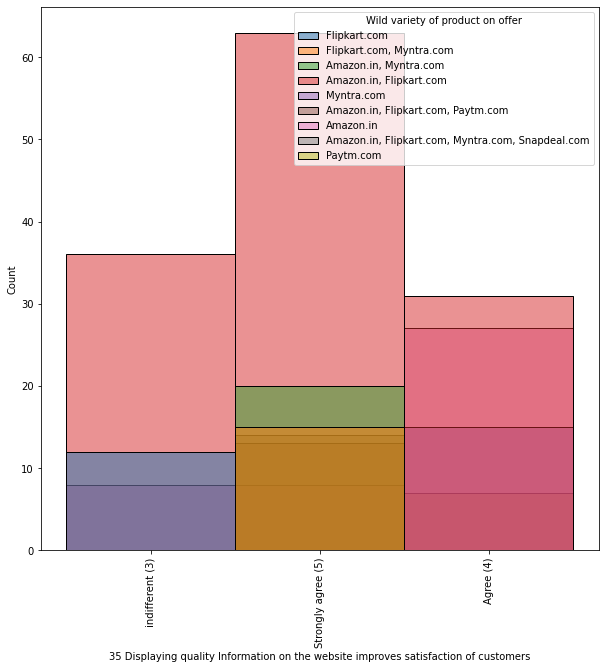

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

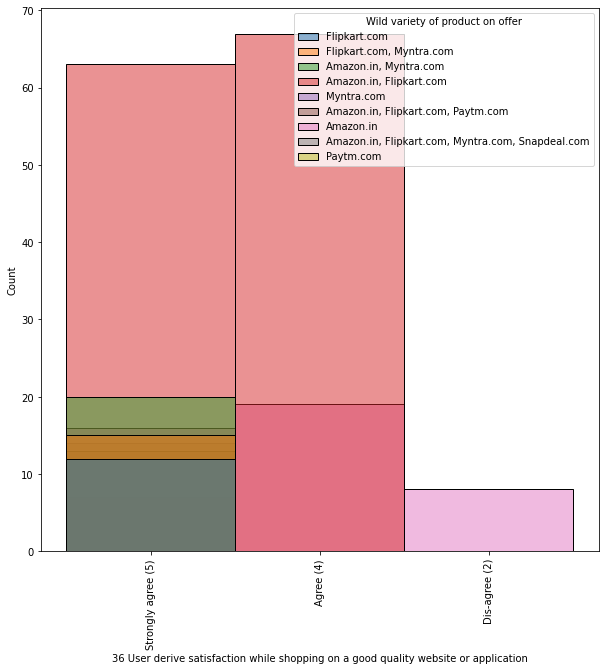

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

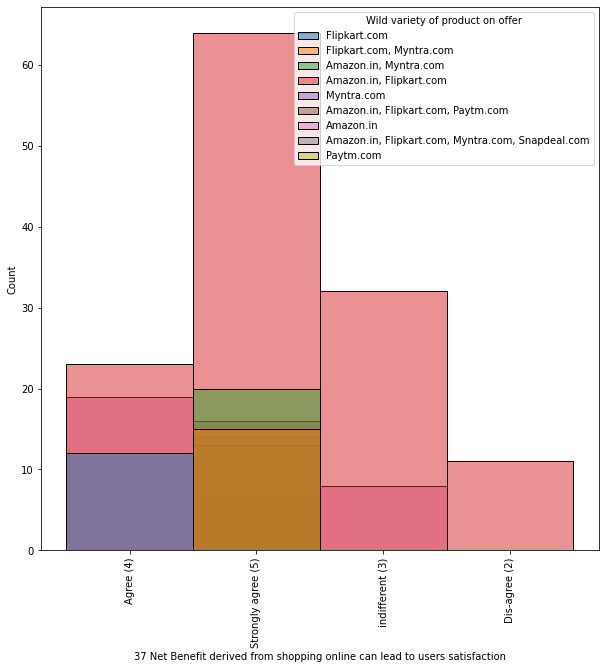

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

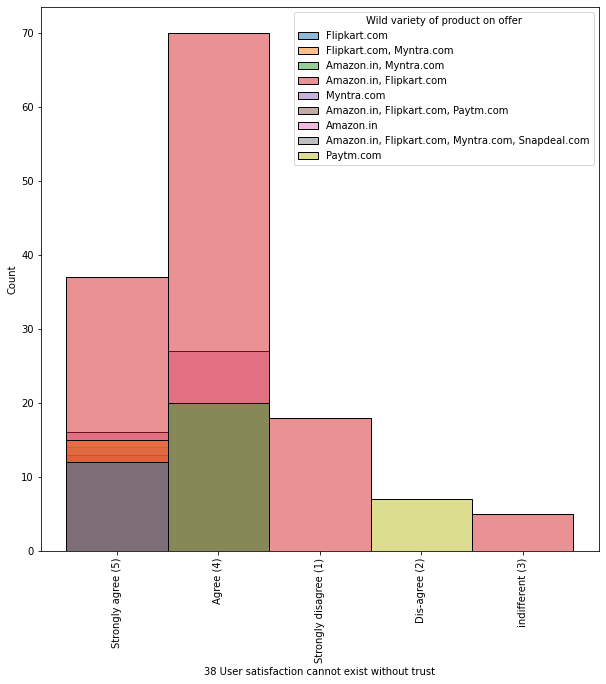

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

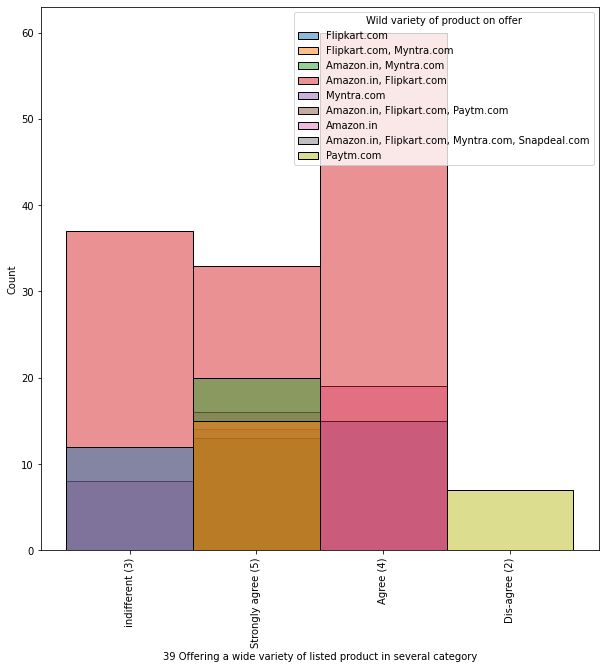

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

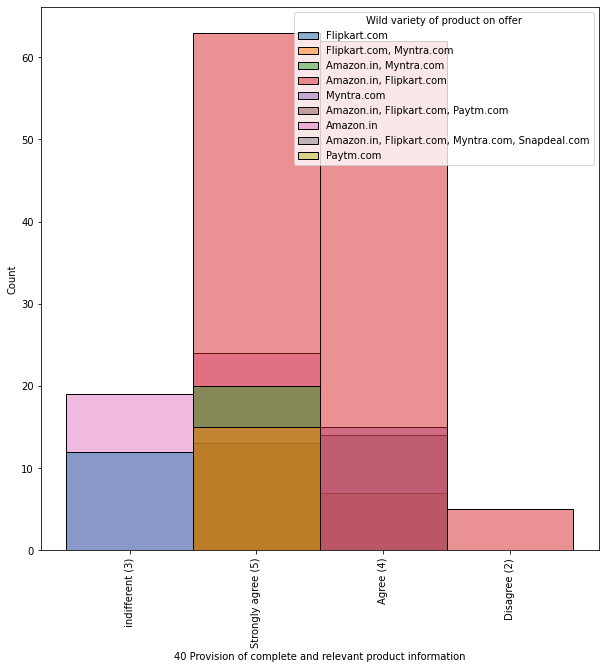

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

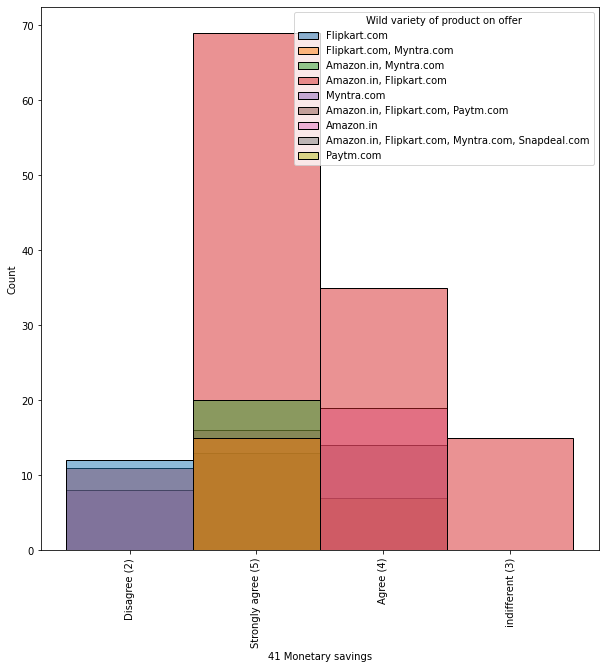

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

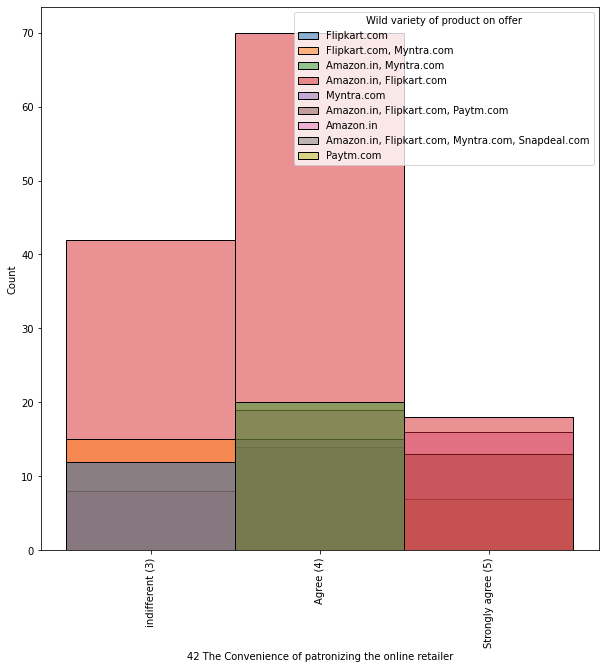

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

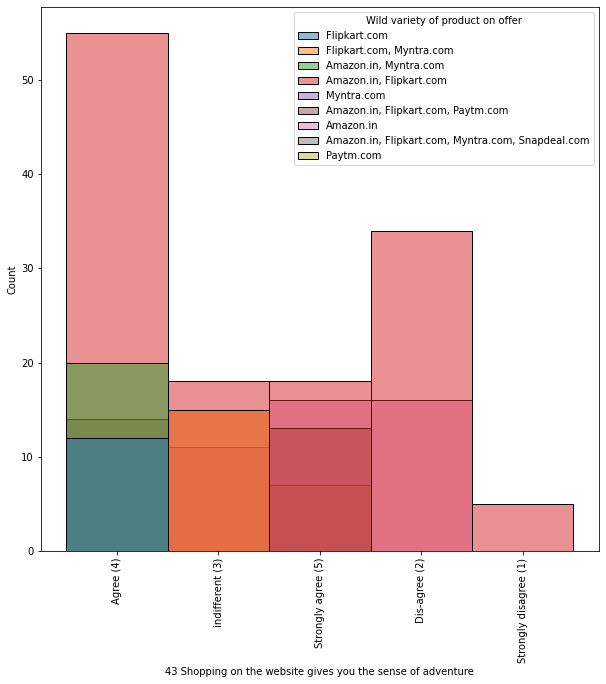

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

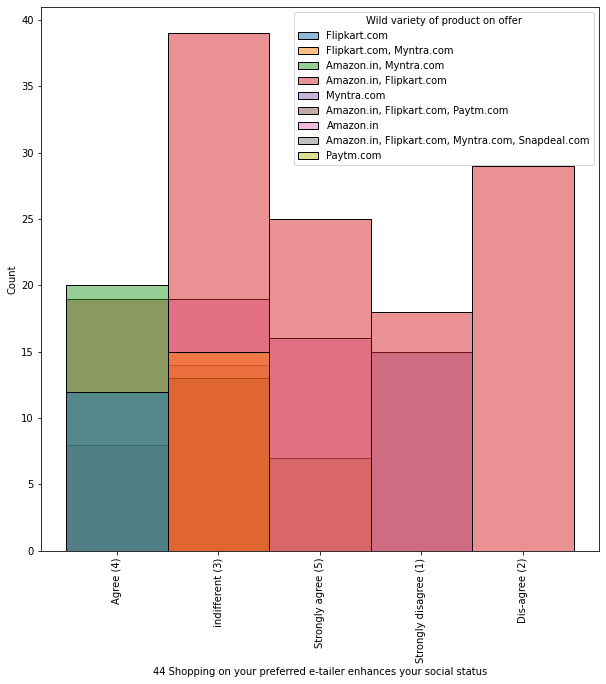

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

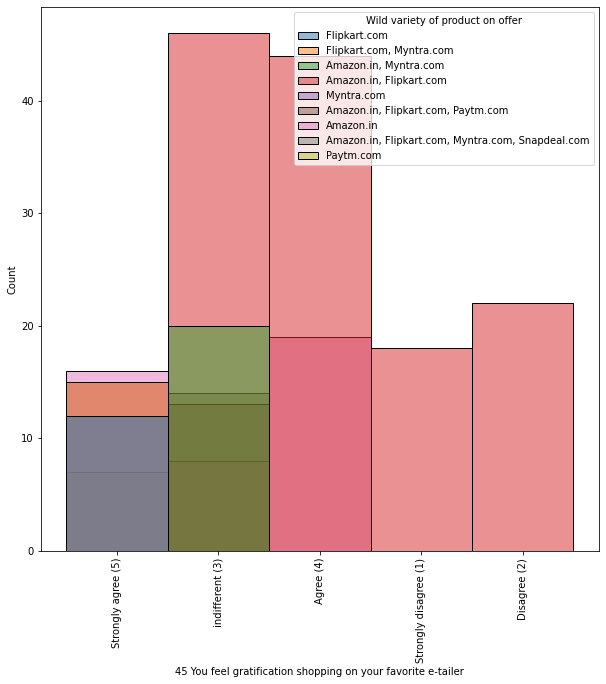

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

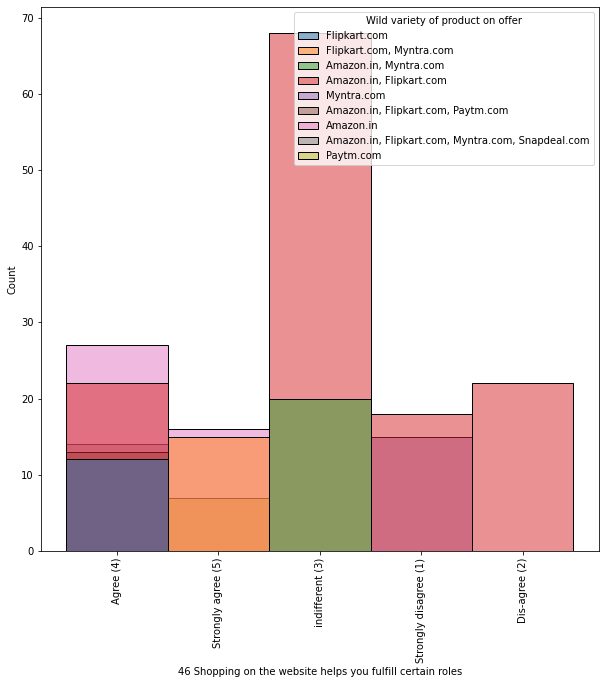

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

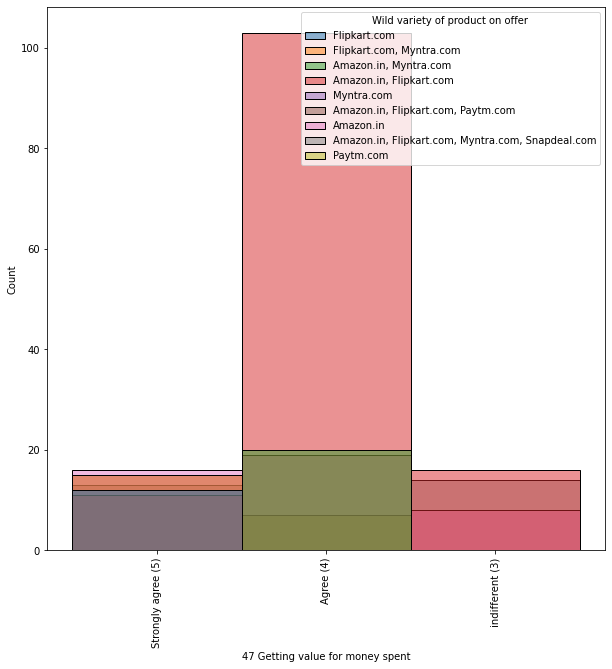

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

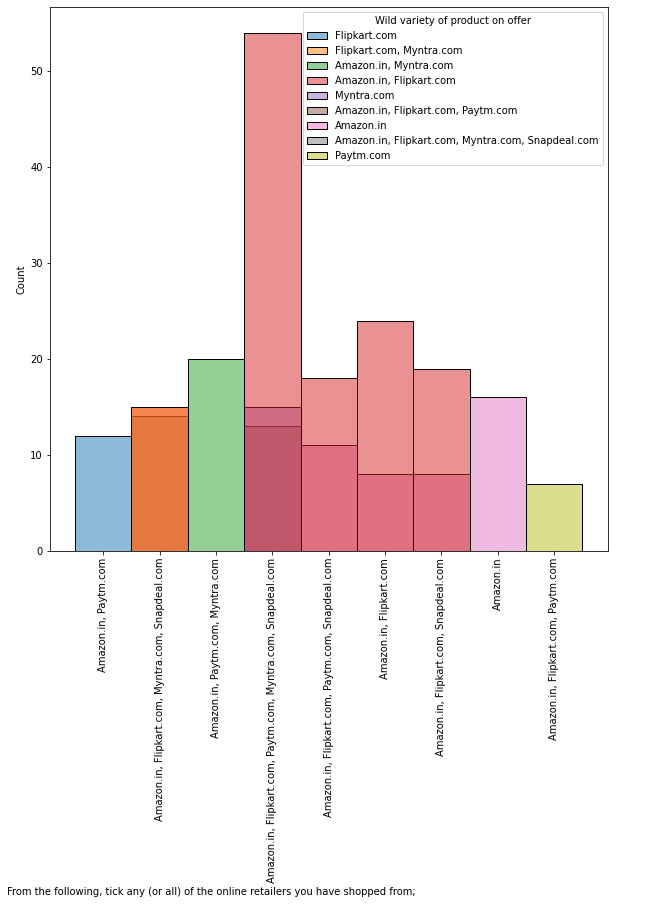

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

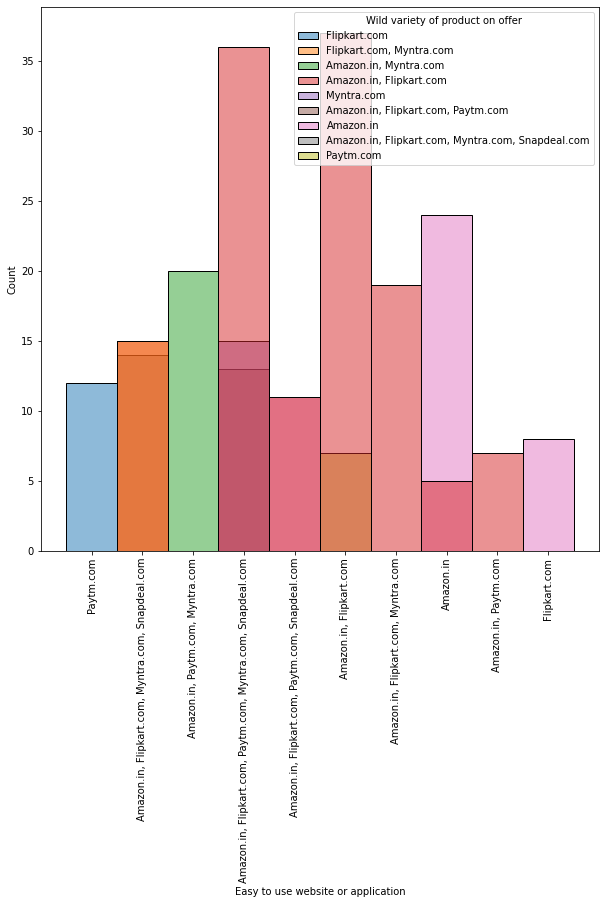

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

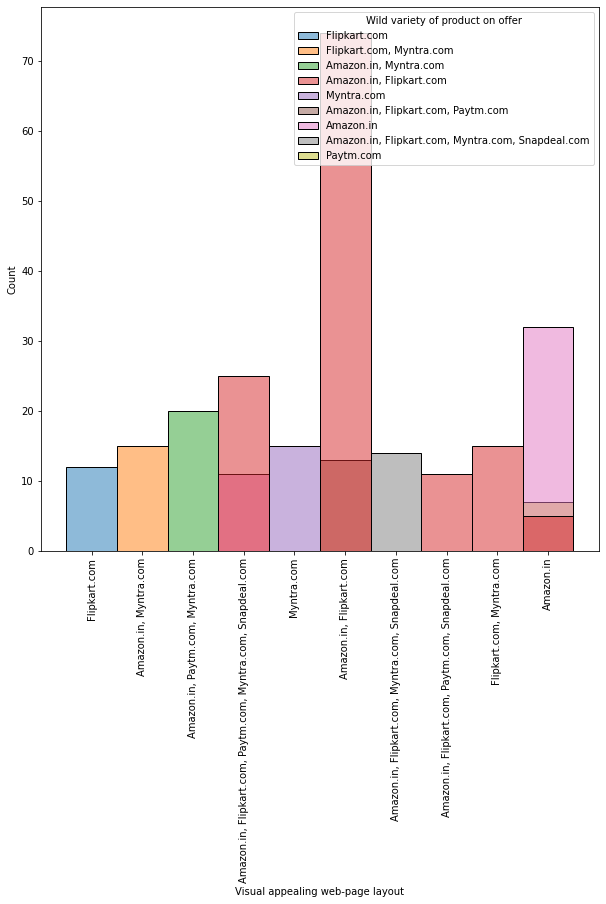

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

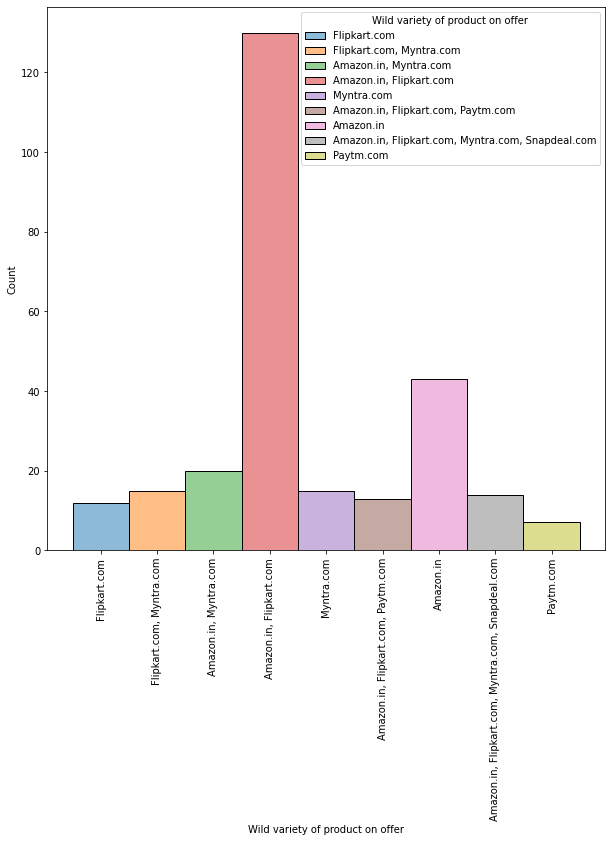

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

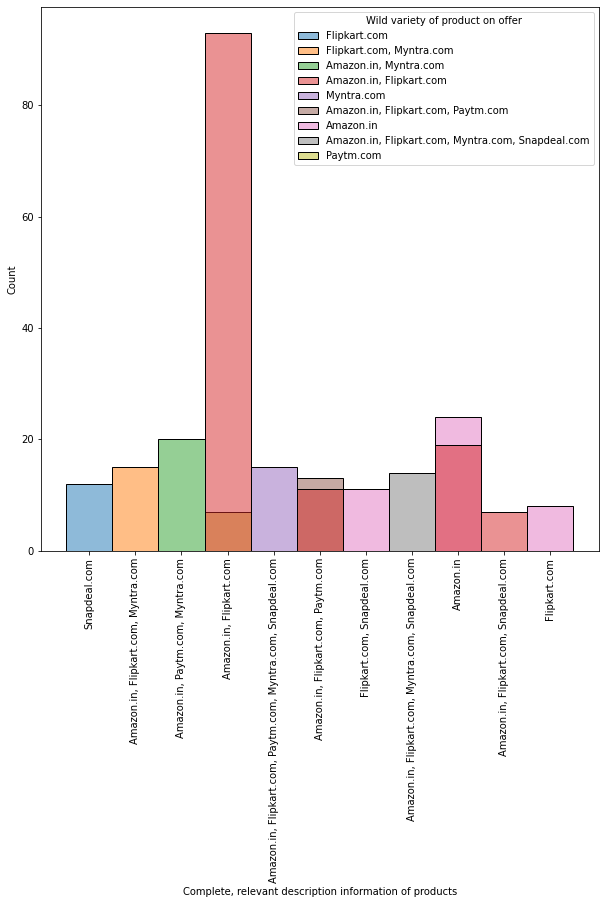

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

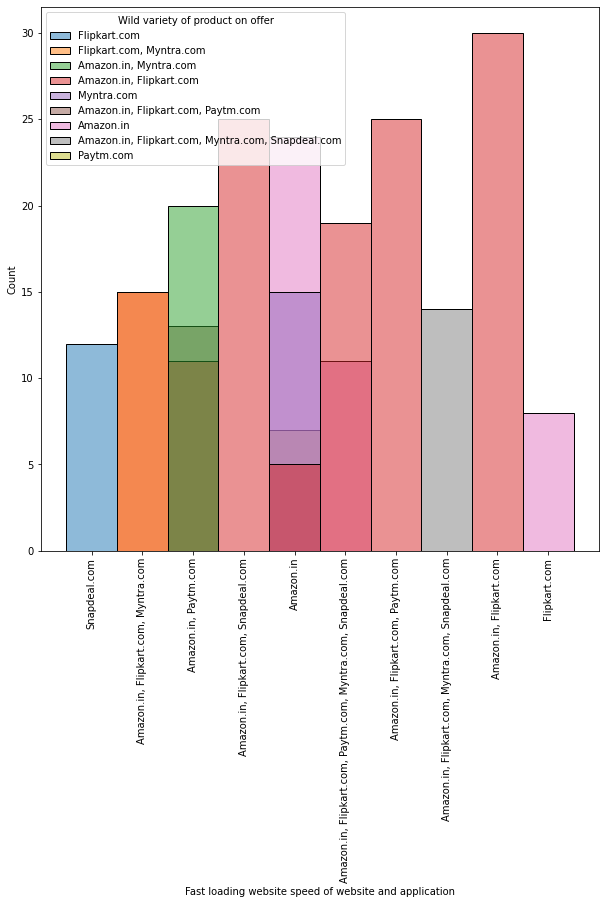

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

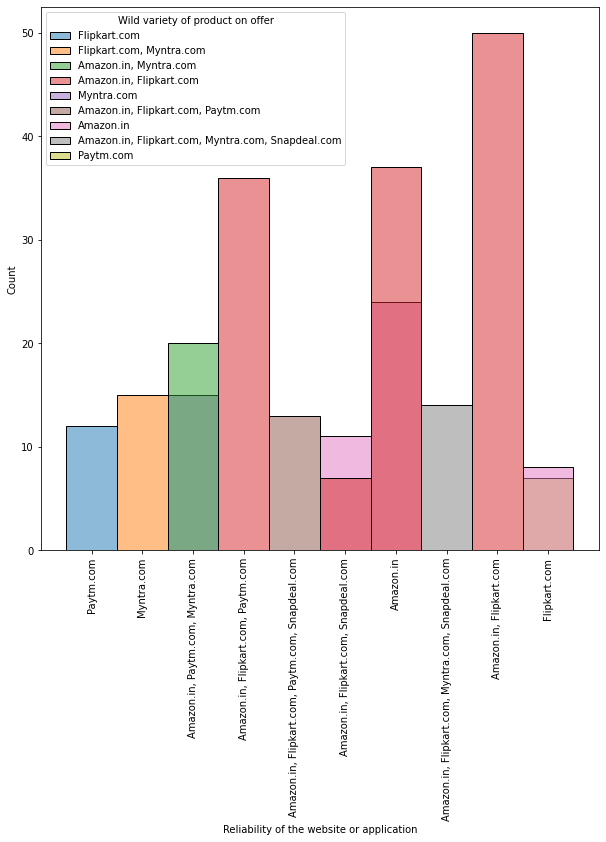

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

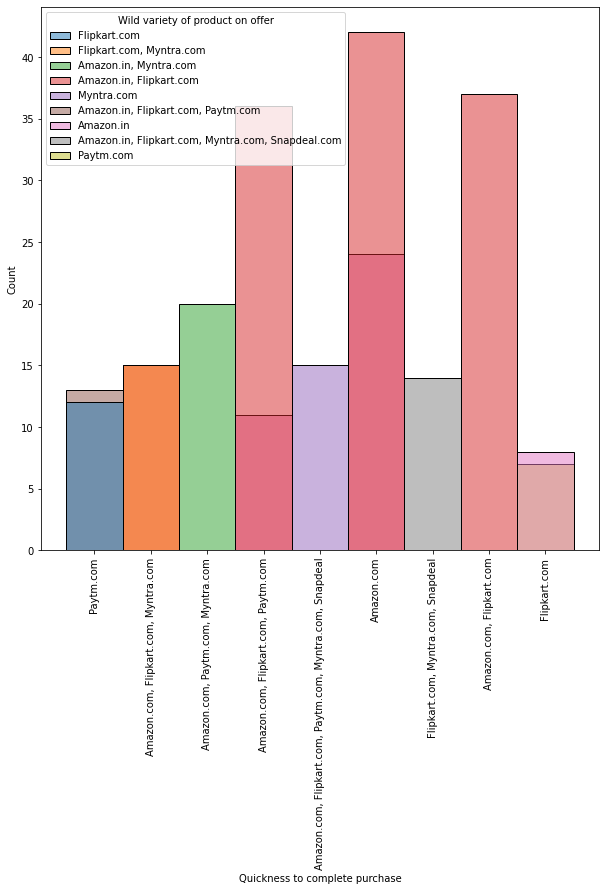

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

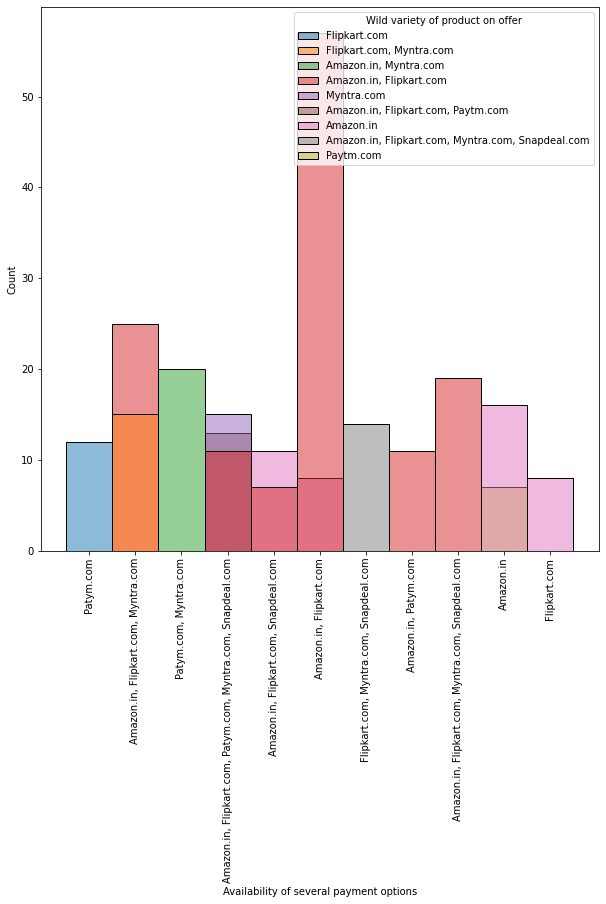

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

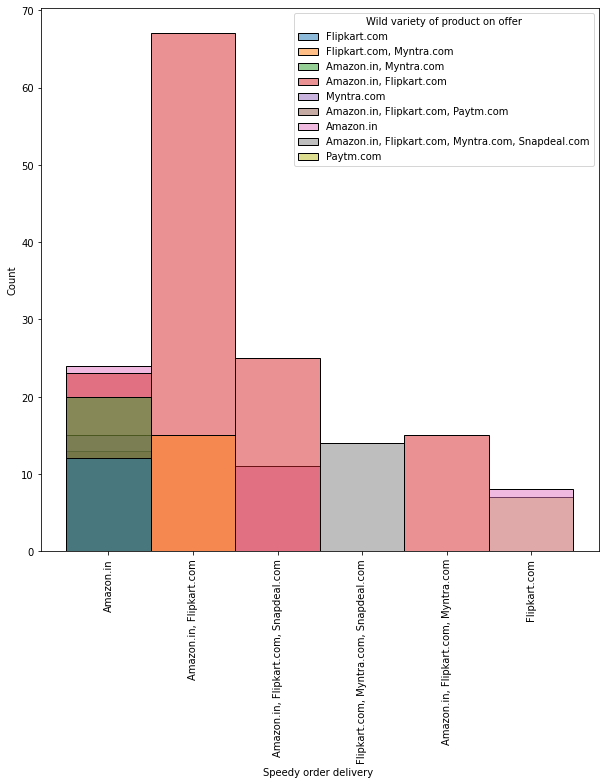

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

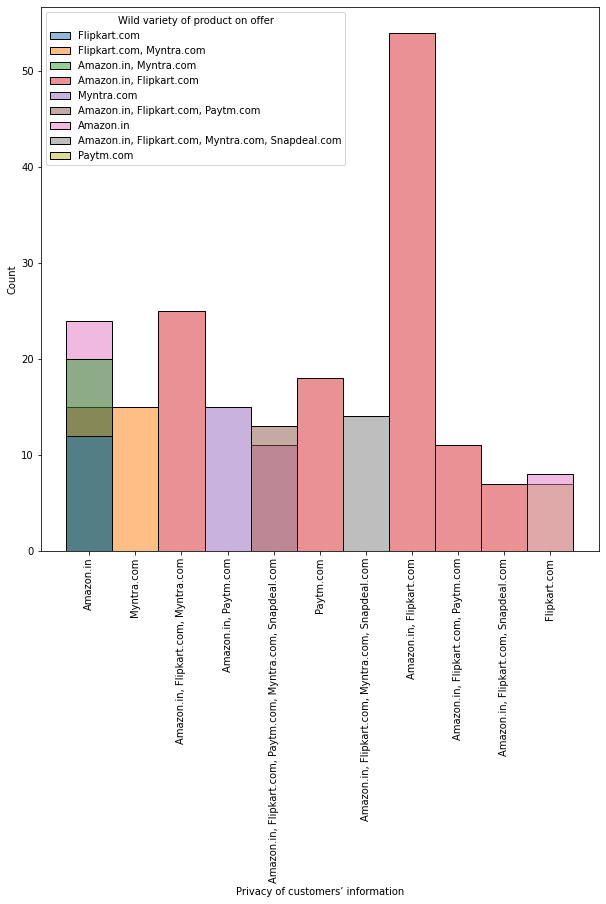

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

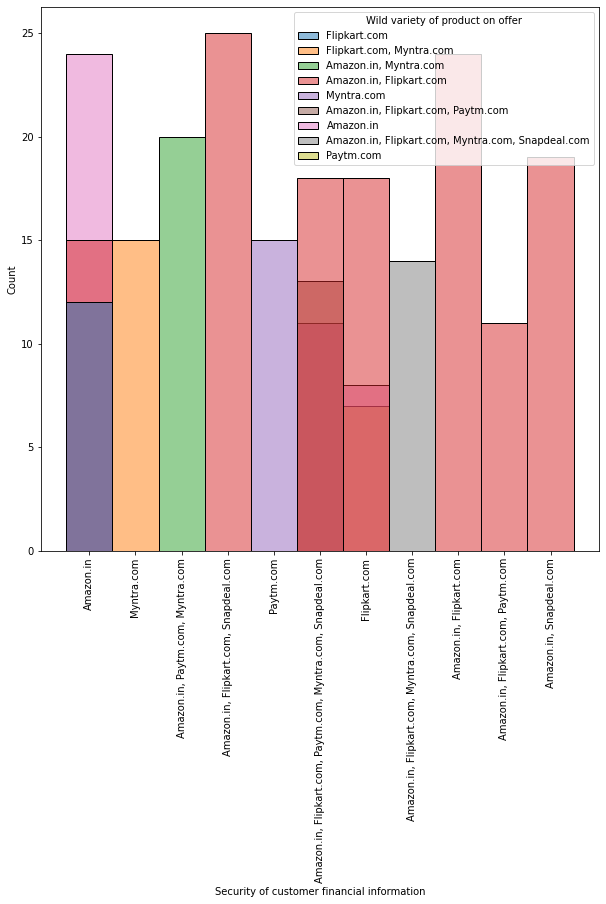

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

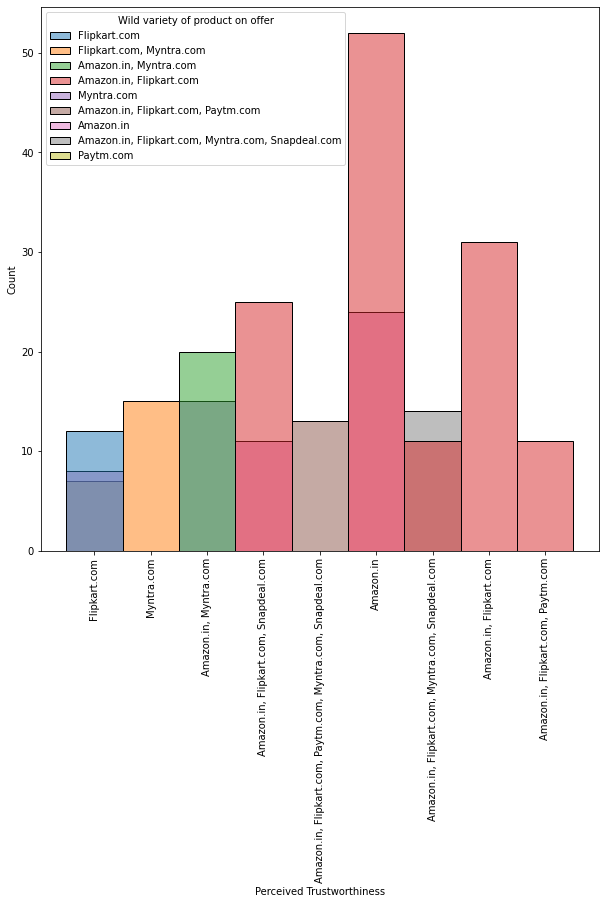

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

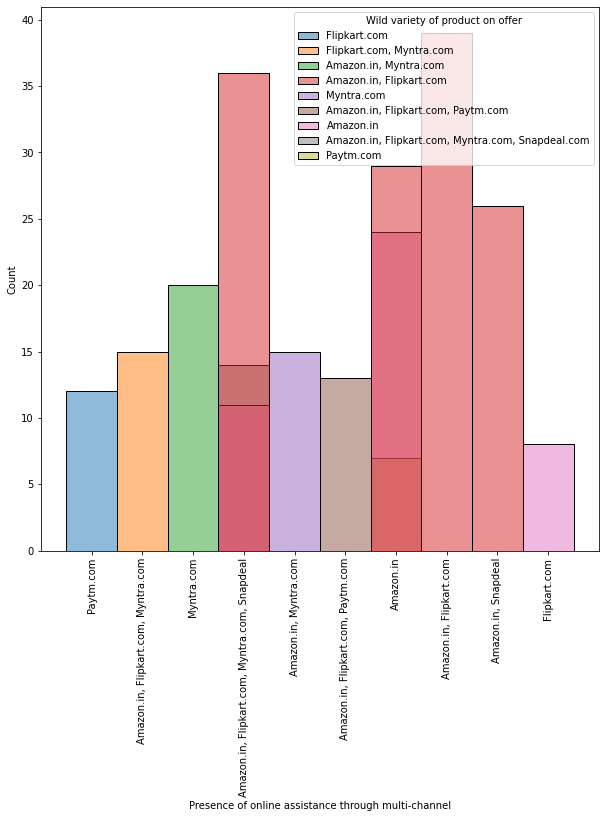

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

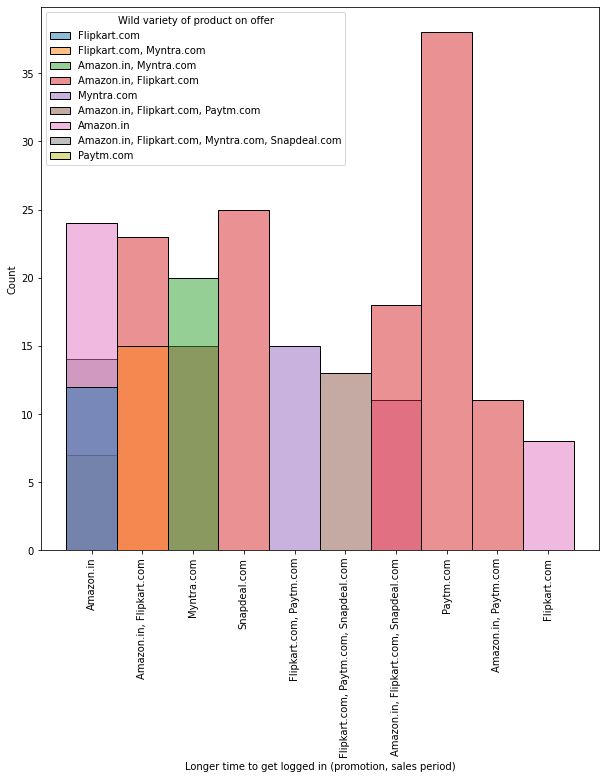

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

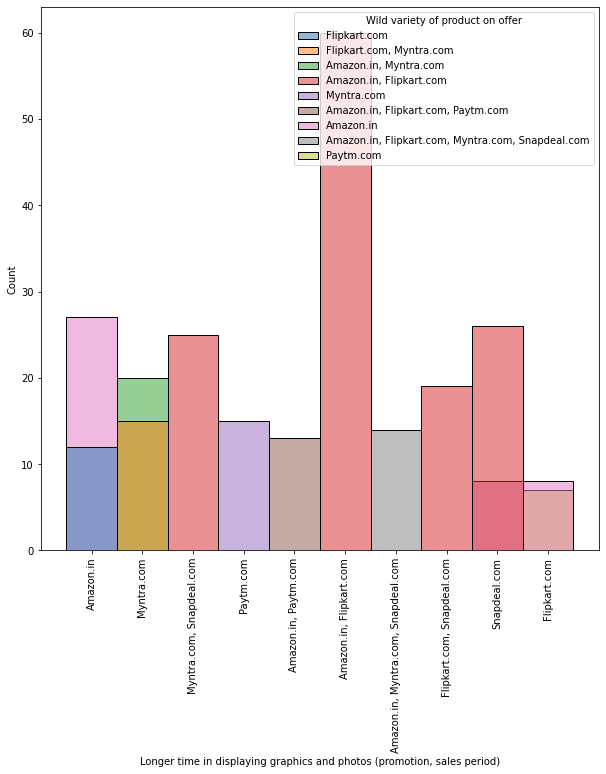

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

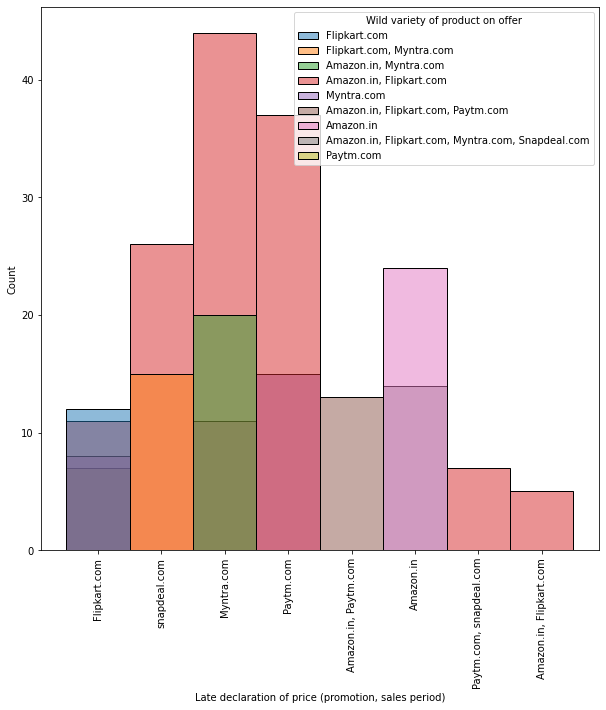

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

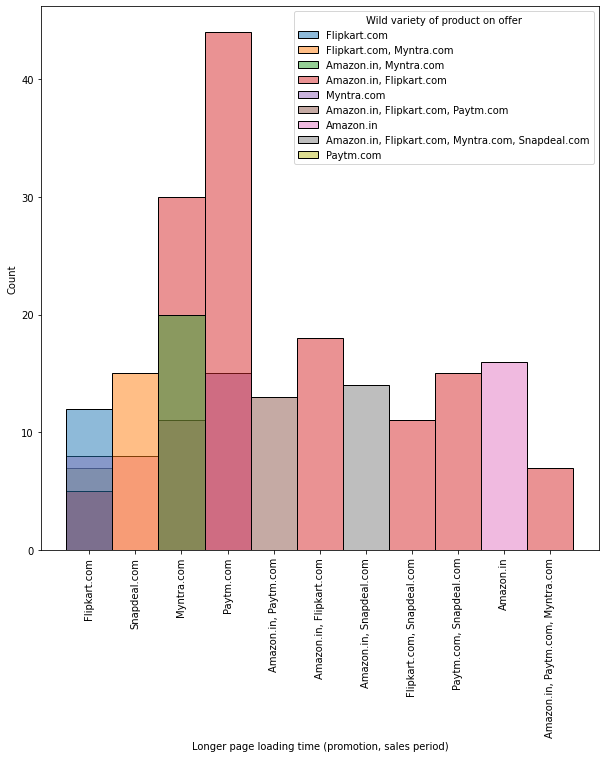

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

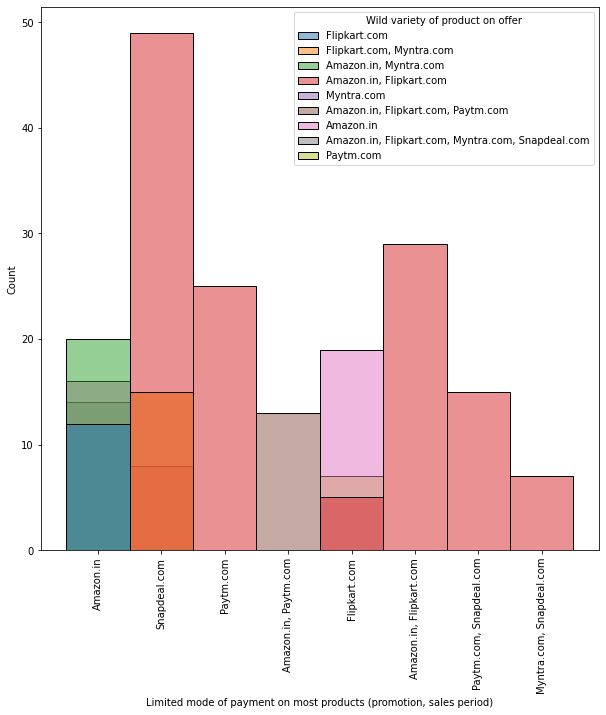

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

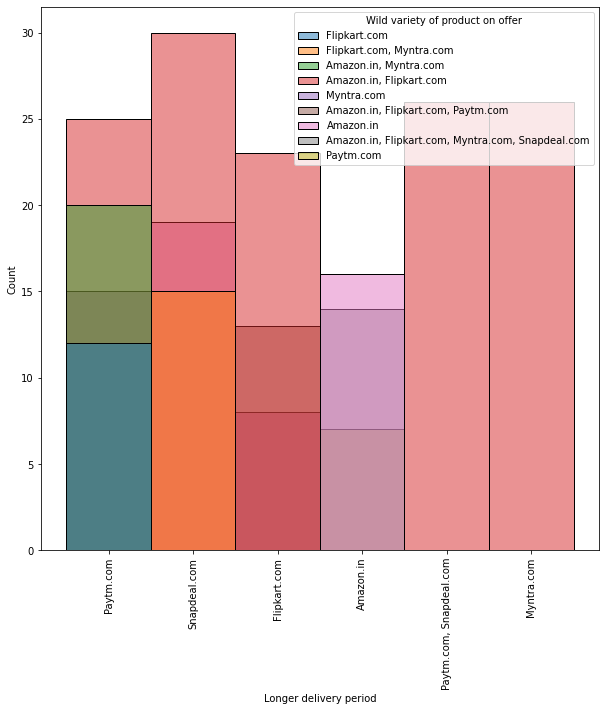

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

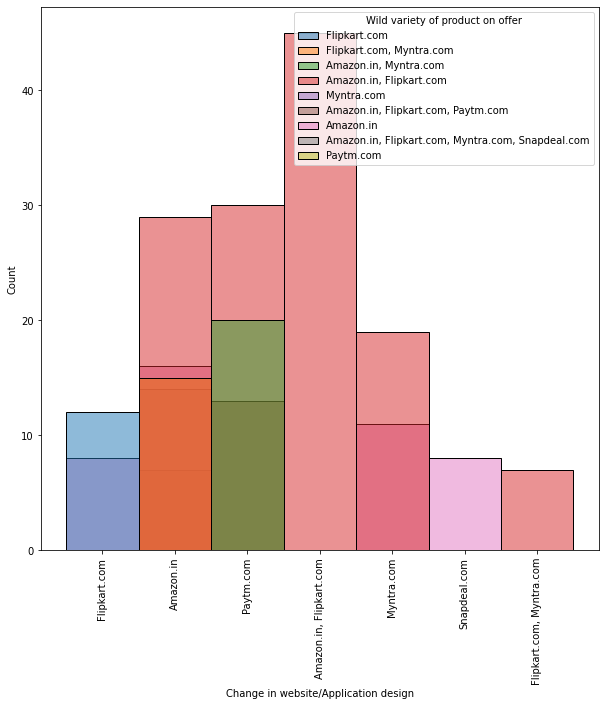

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

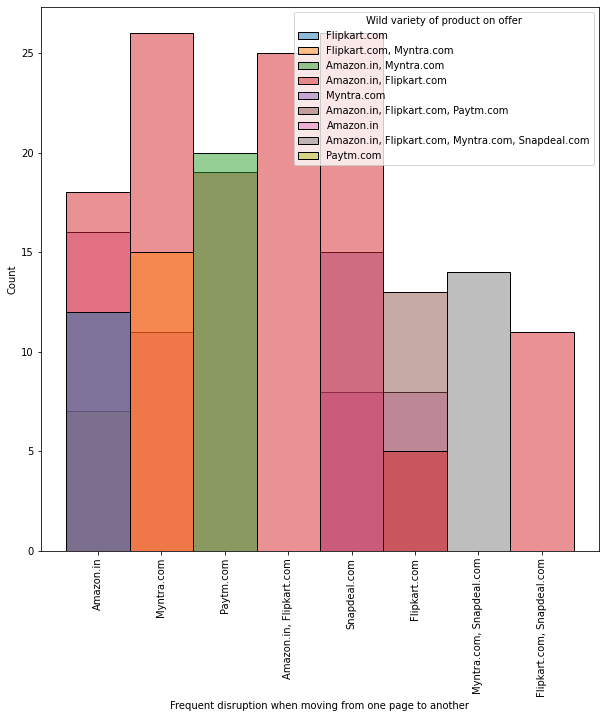

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

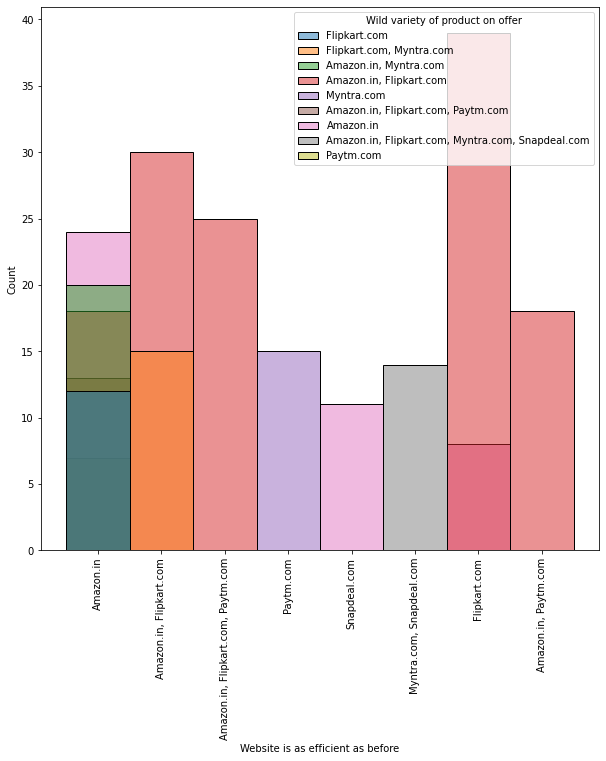

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

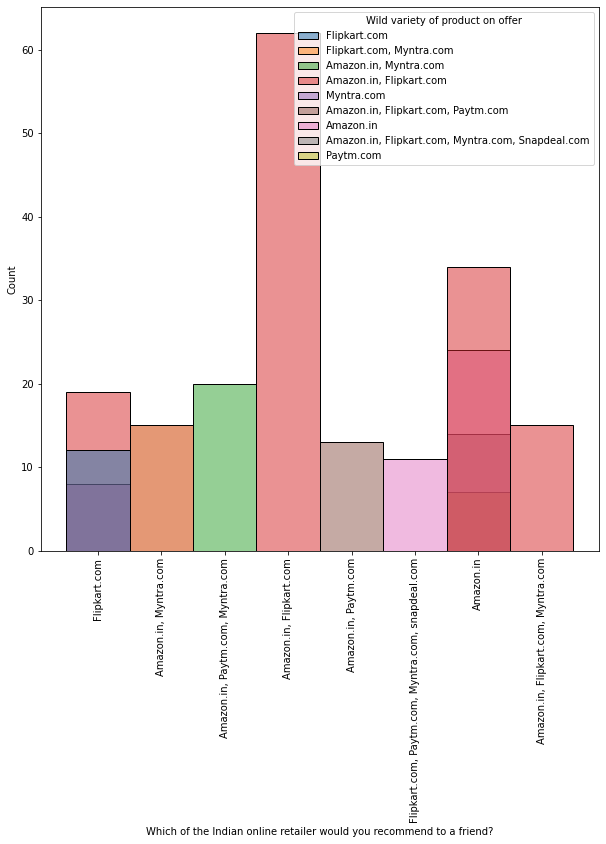

In [85]:
# Histogram with respect to 'Wild variety of product on offer'
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['Wild variety of product on offer'])
    plt.xticks(rotation ='90')
    plt.show()

It is seen that Amazon & Flipkart offer a wide range of products

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

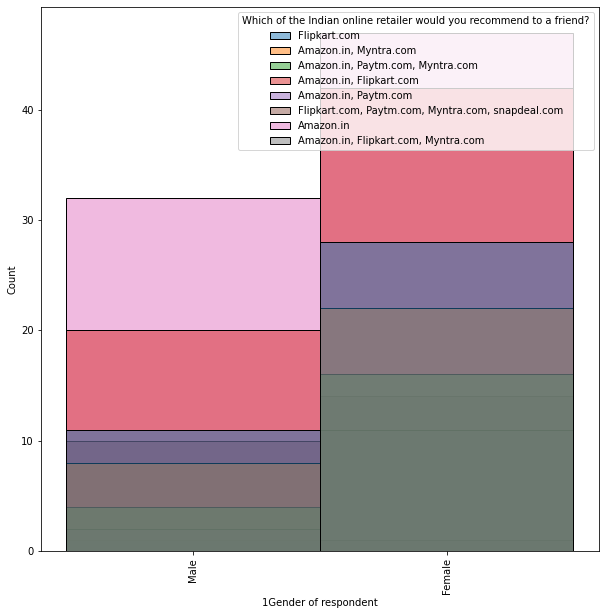

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

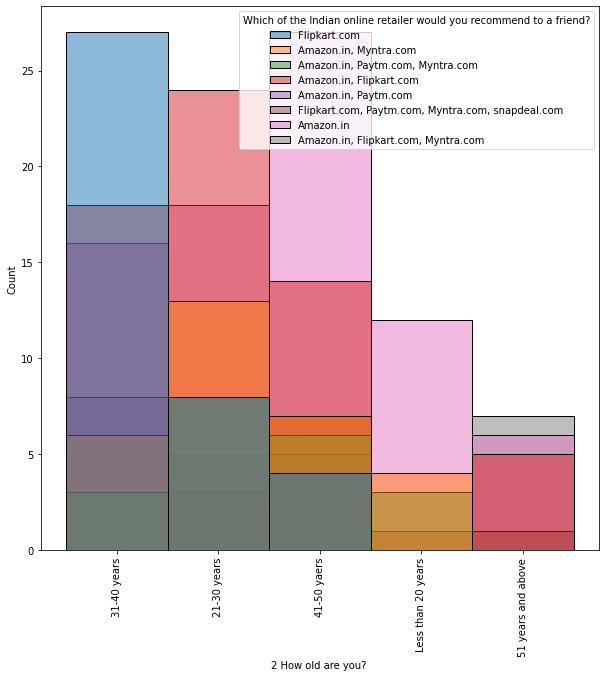

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

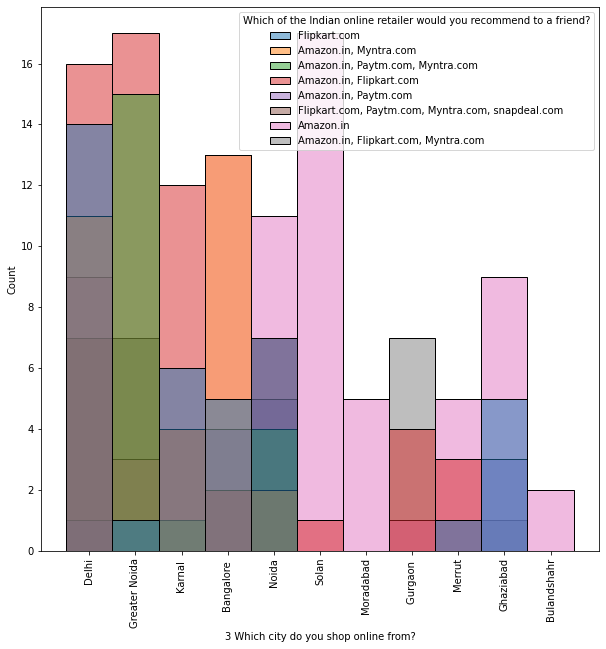

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

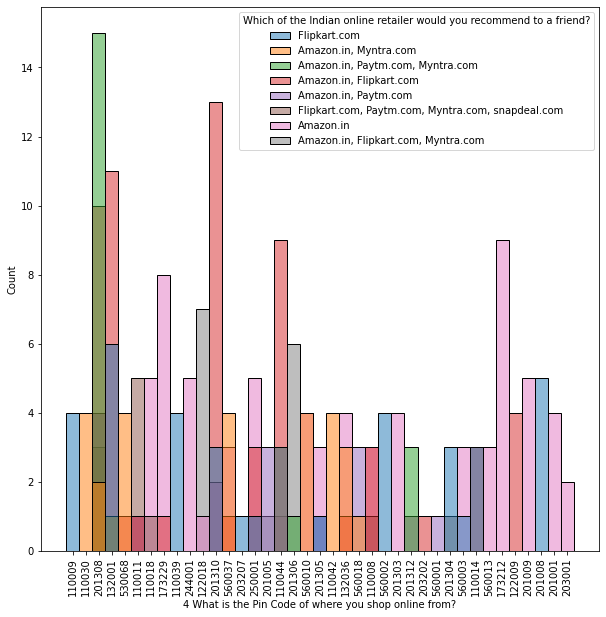

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

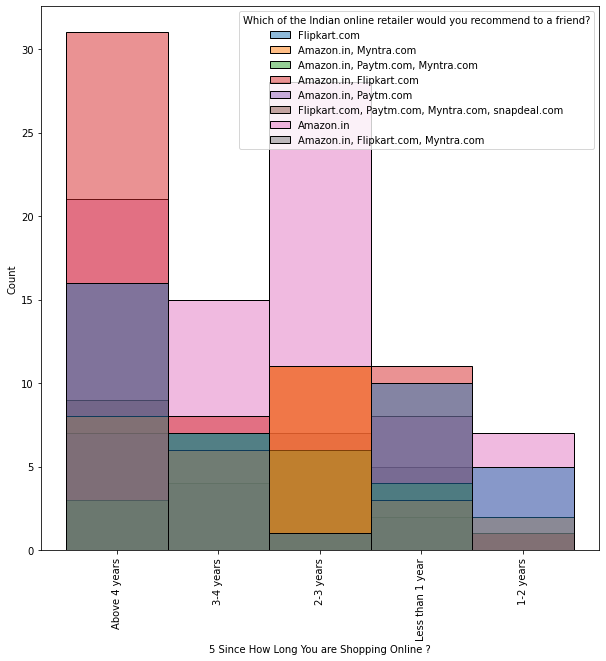

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

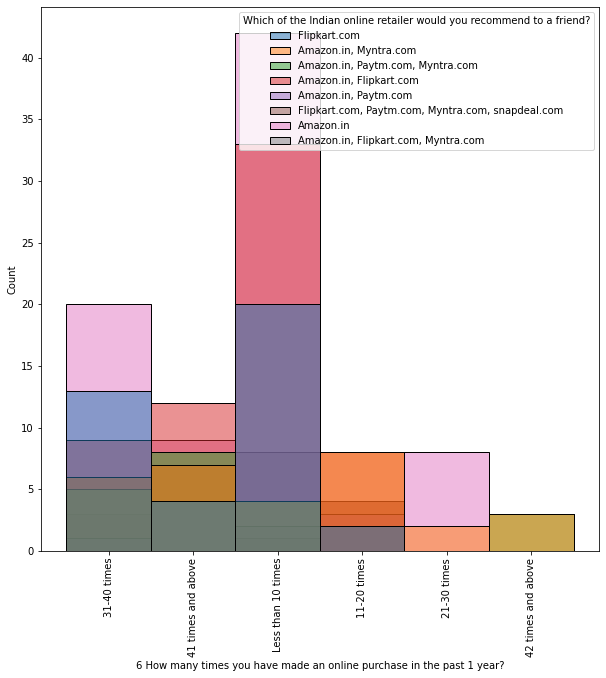

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

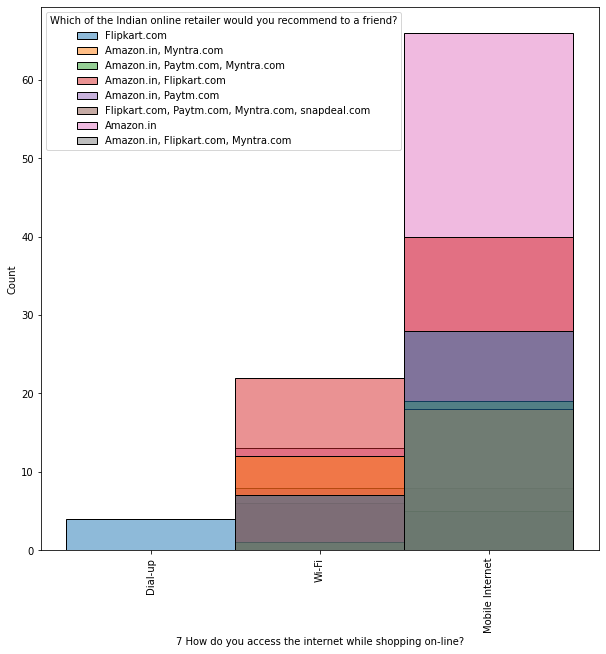

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

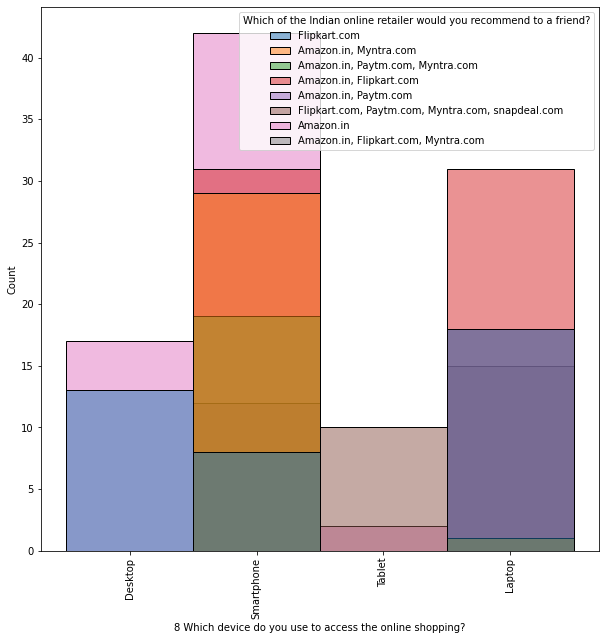

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

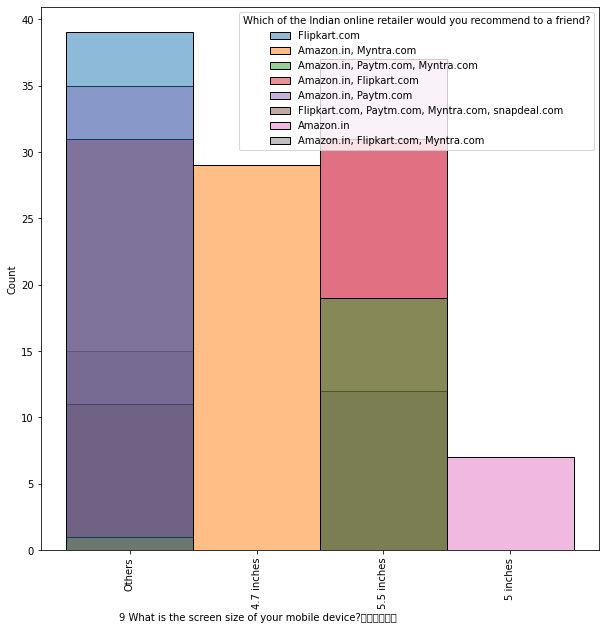

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

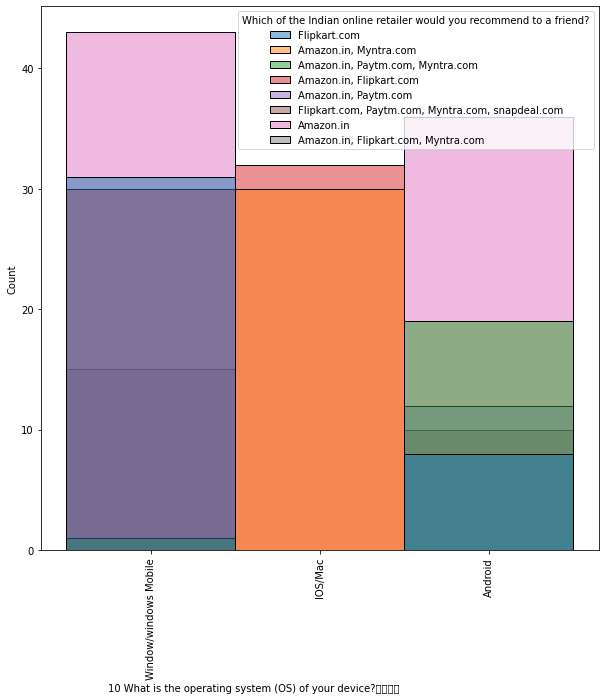

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

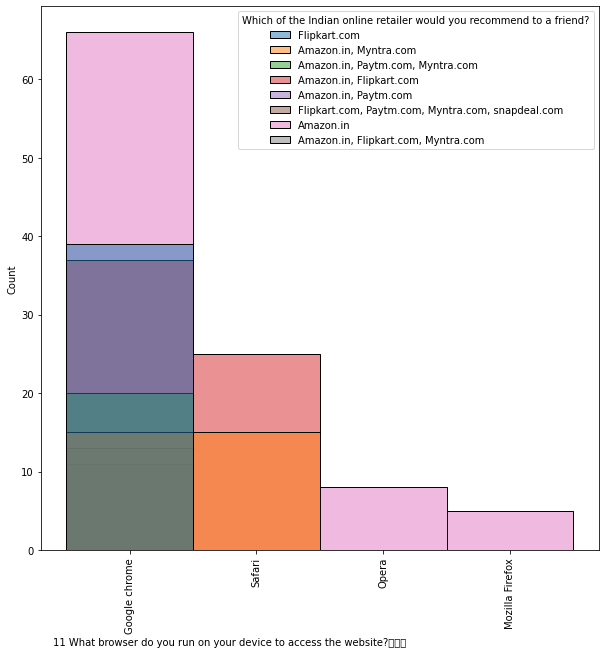

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

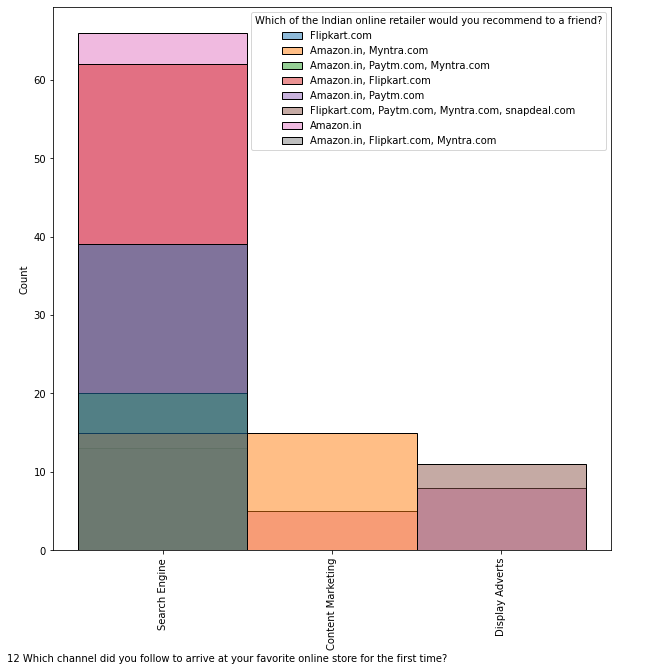

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

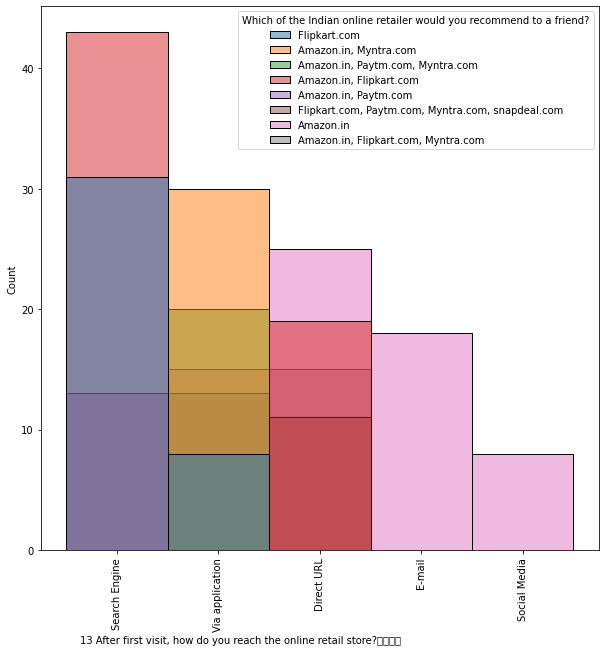

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

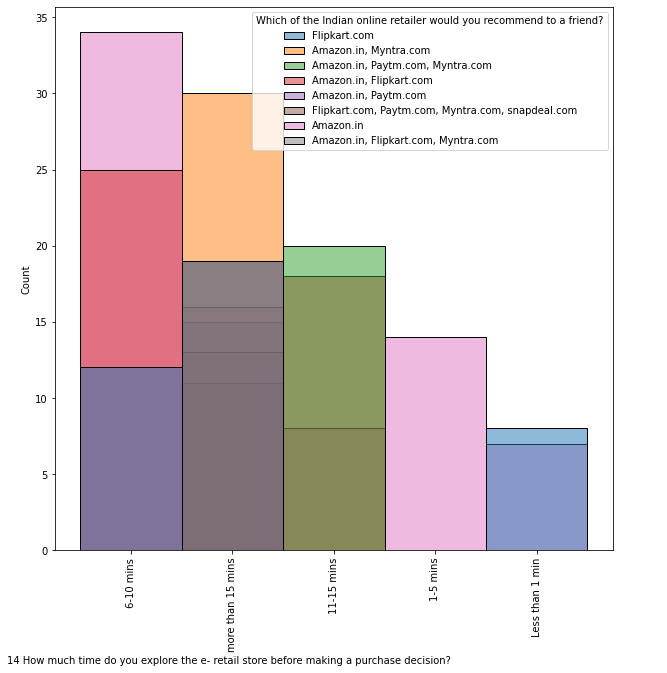

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

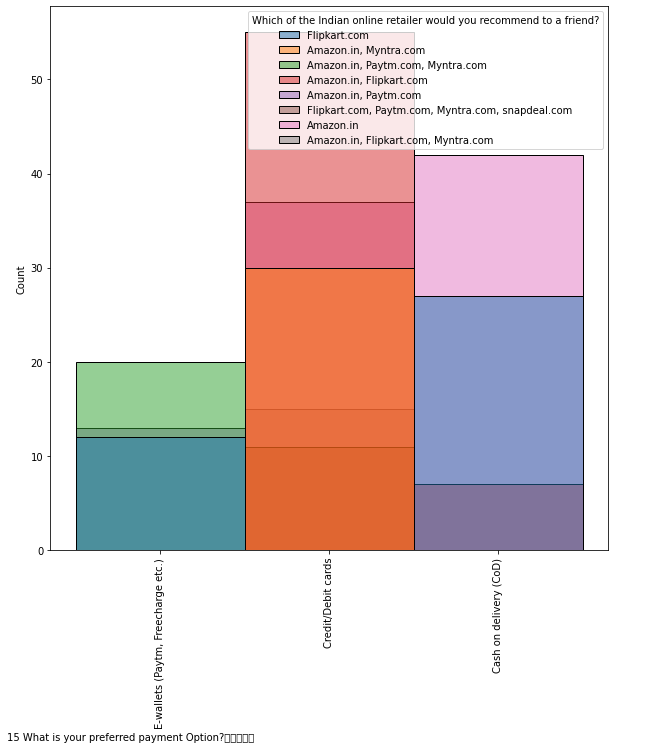

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

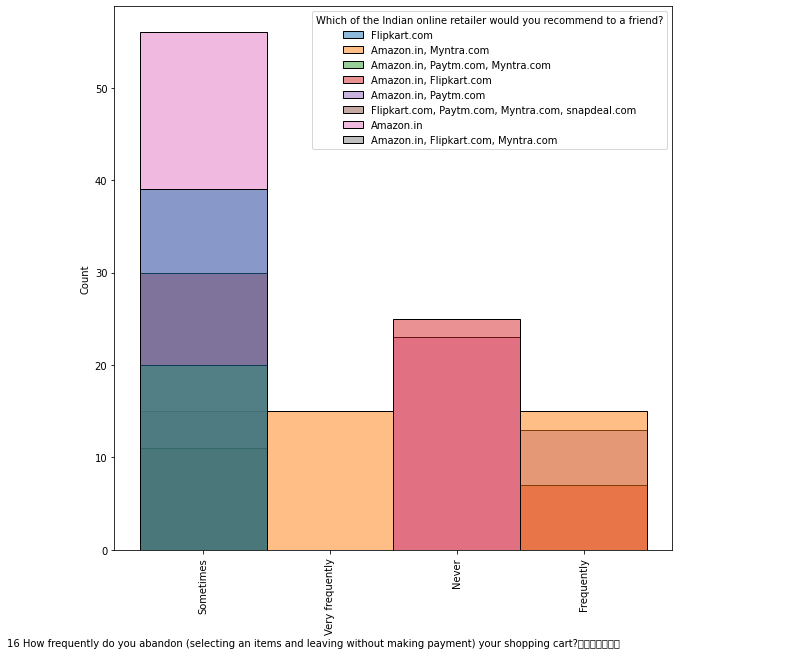

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

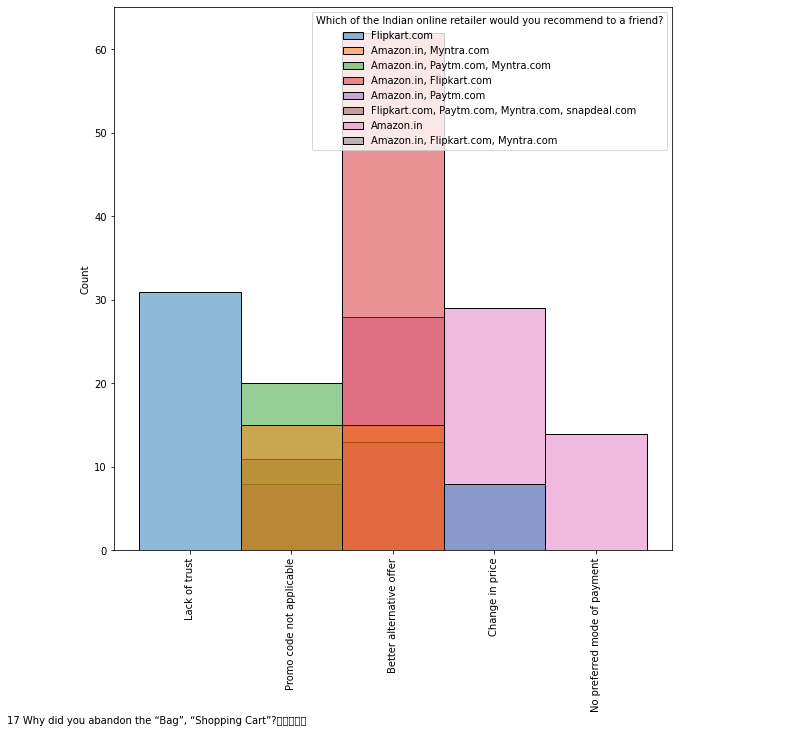

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

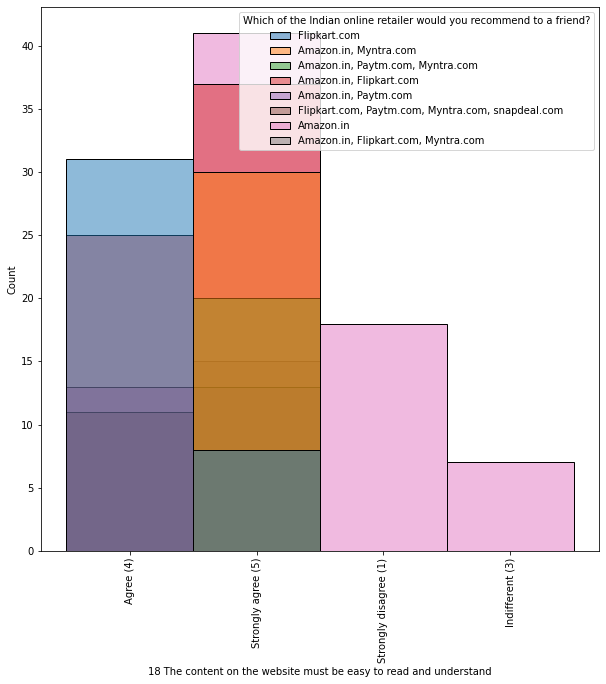

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

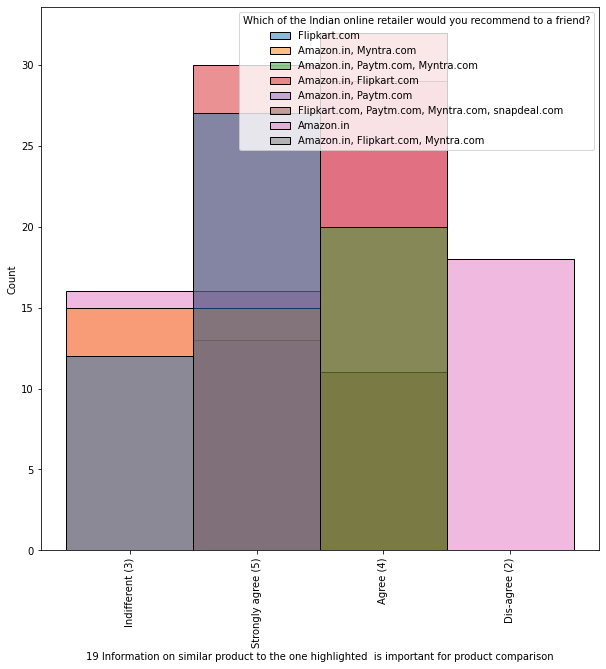

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

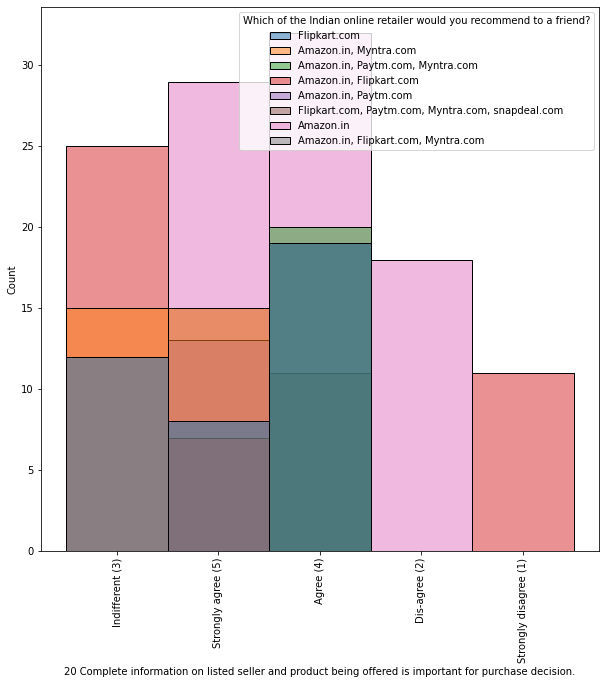

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

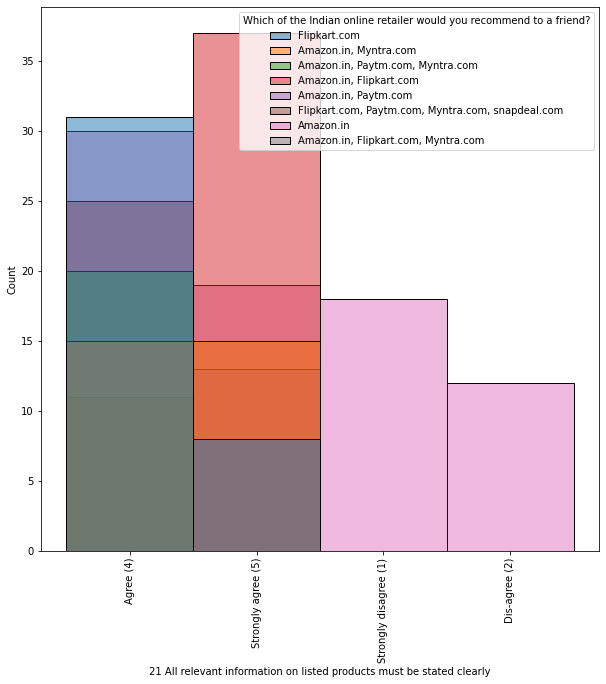

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

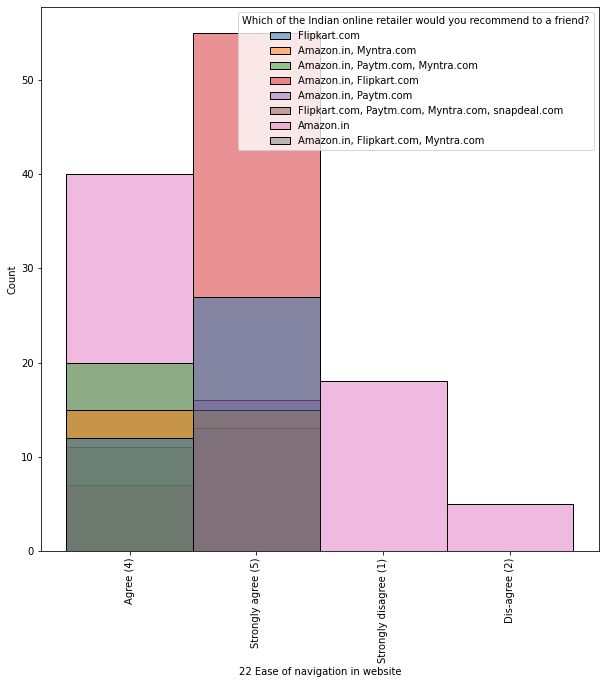

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

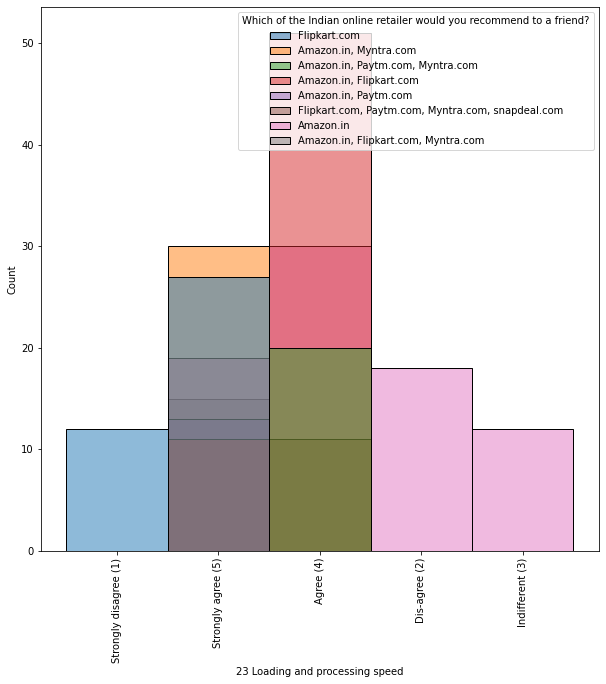

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

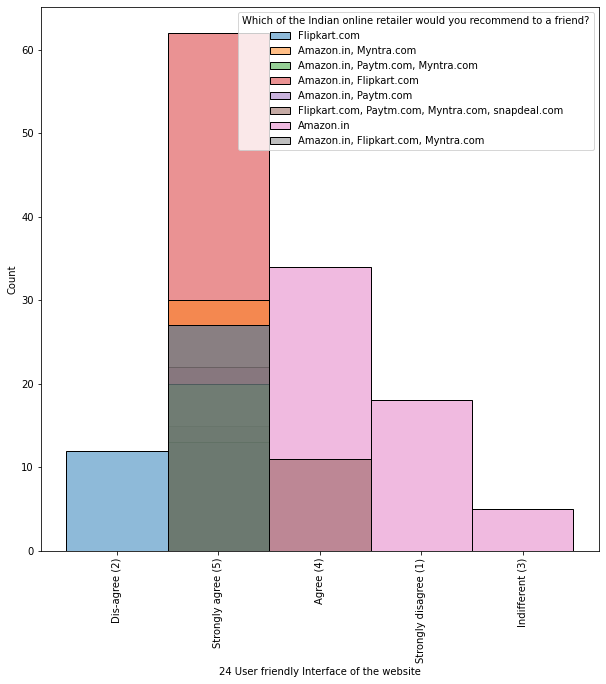

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

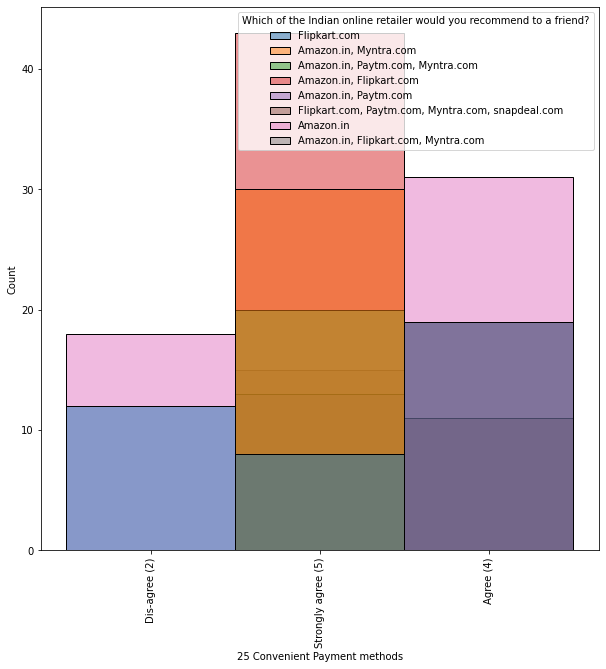

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

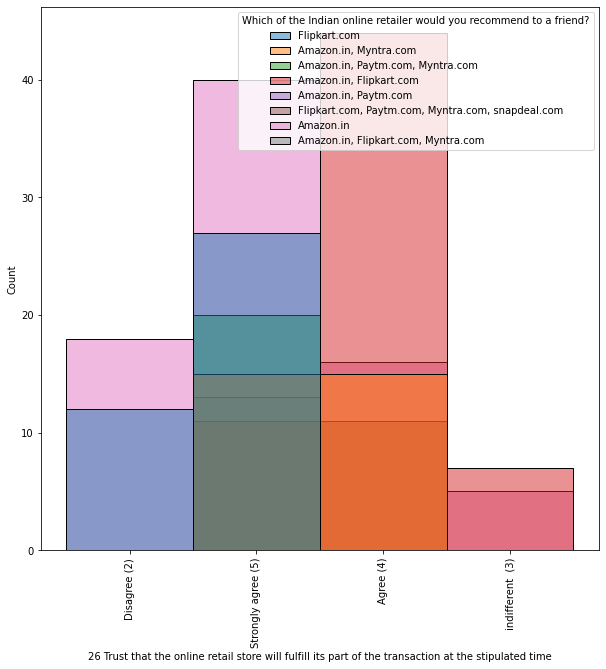

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

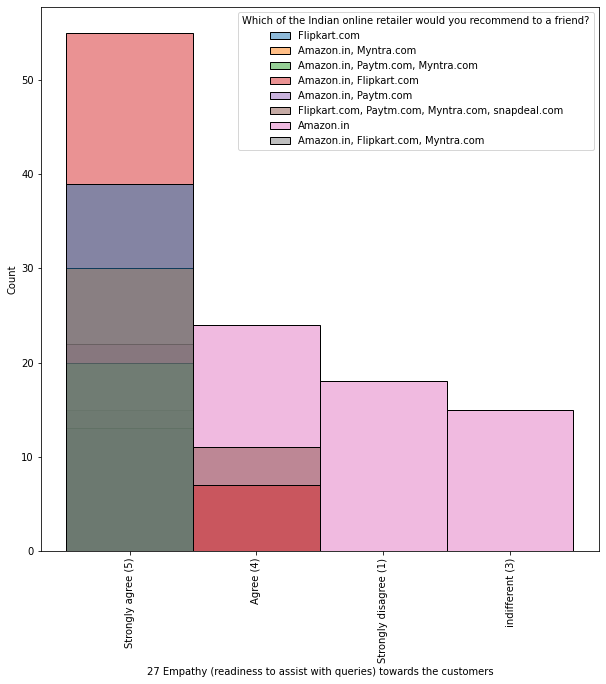

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

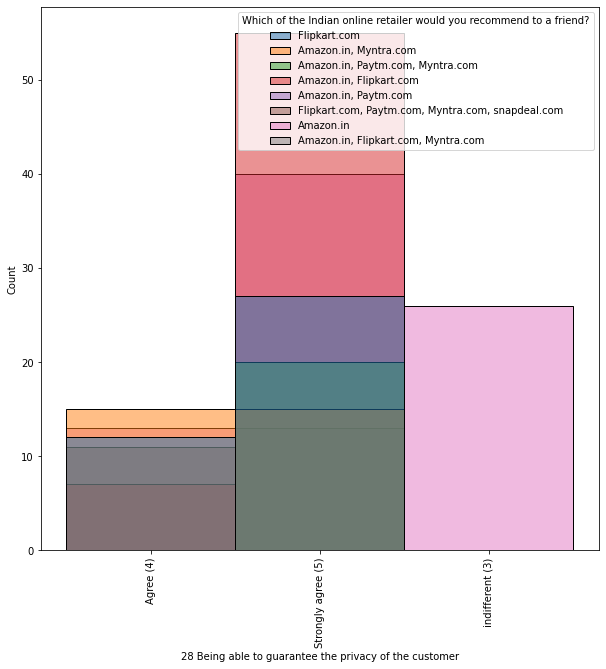

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

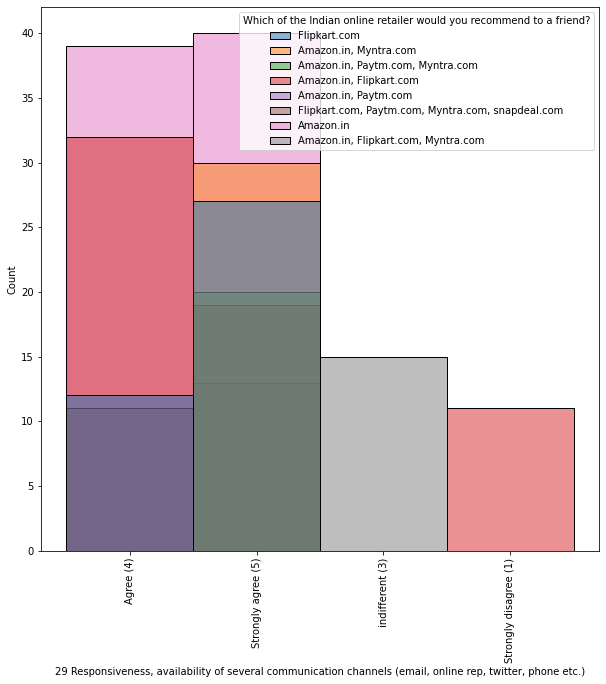

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

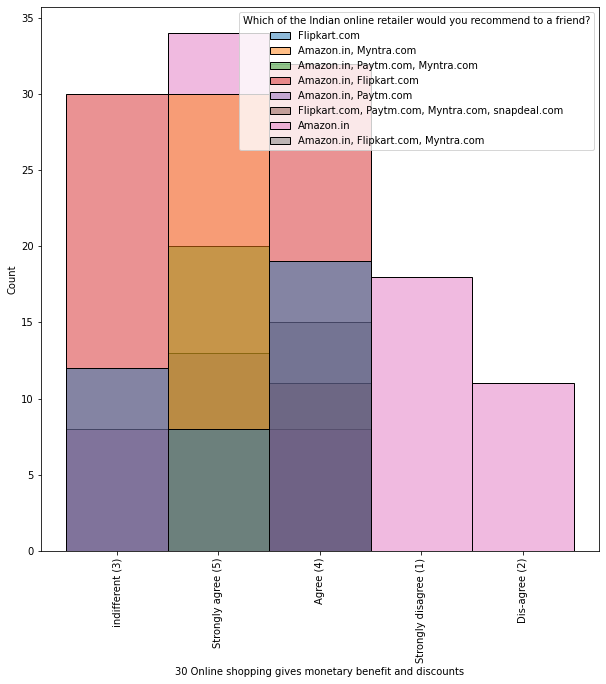

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

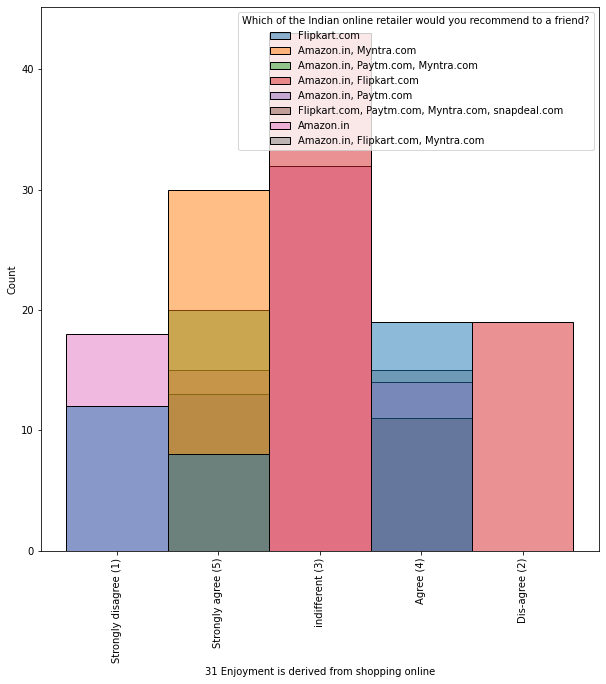

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

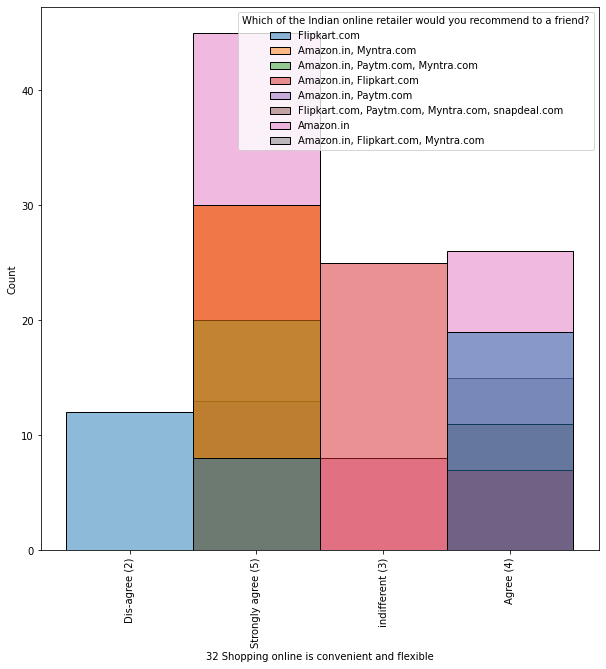

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

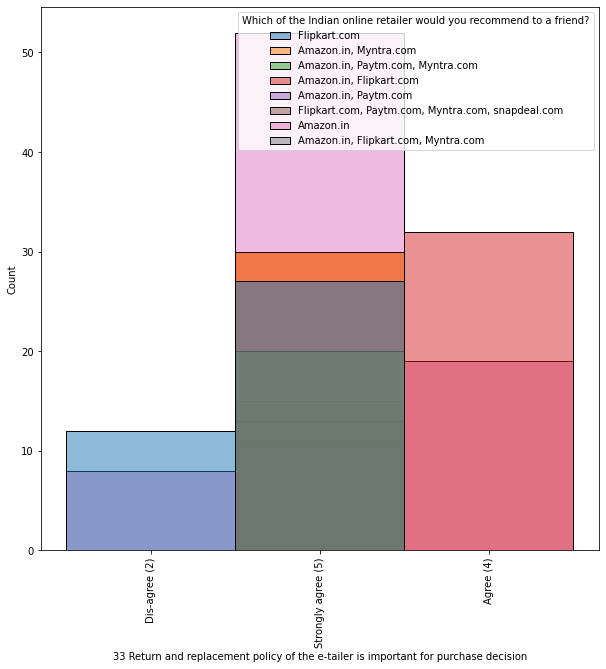

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

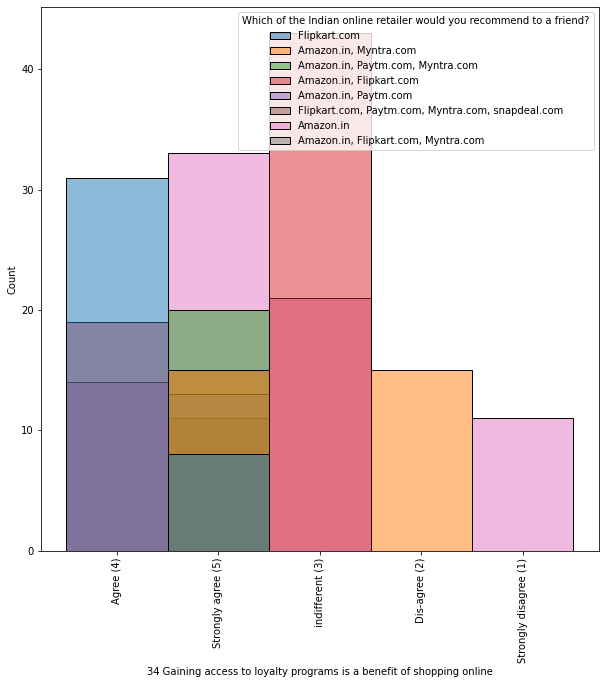

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

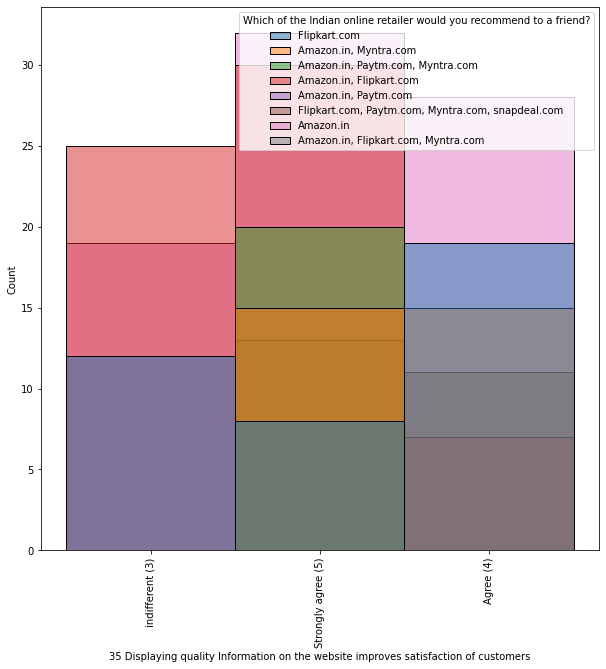

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

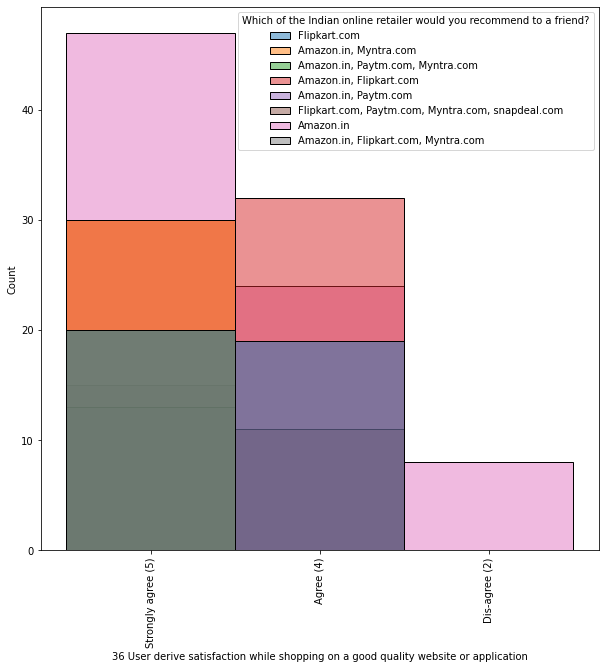

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

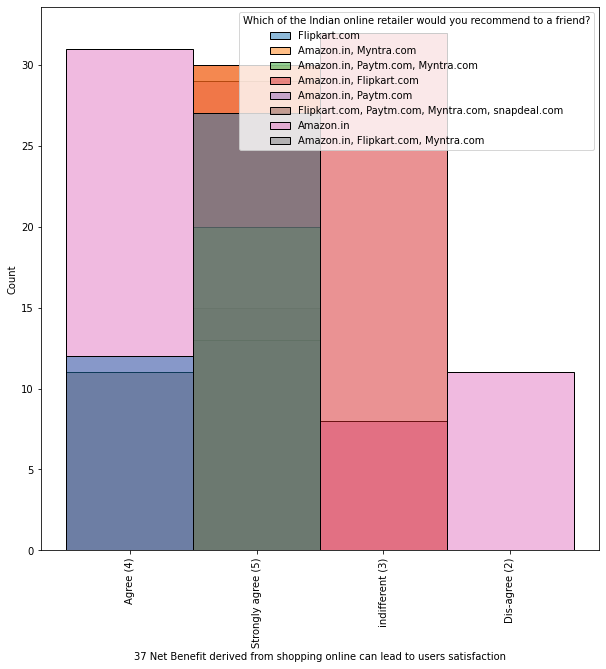

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

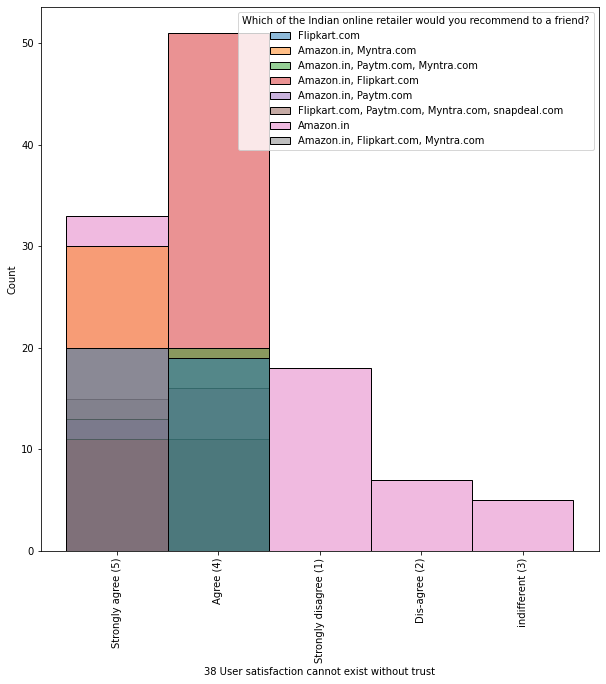

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

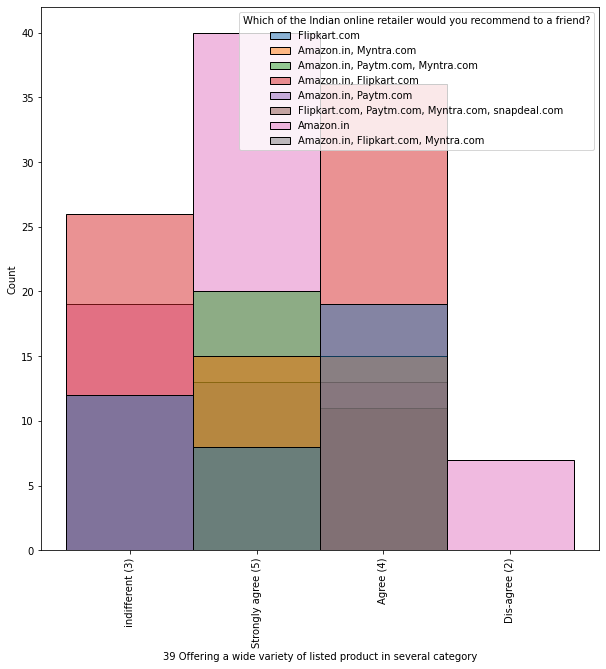

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

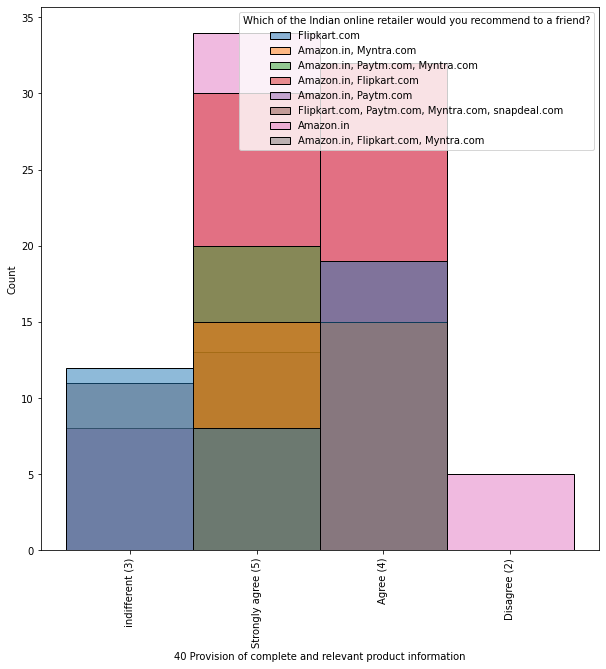

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

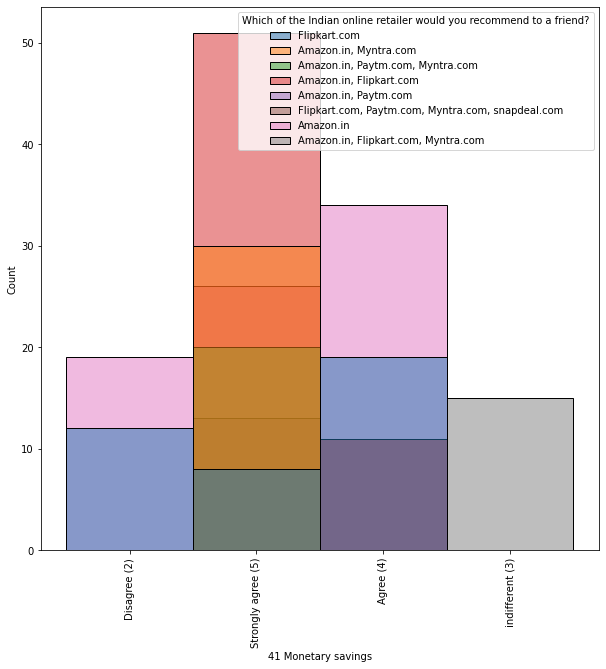

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

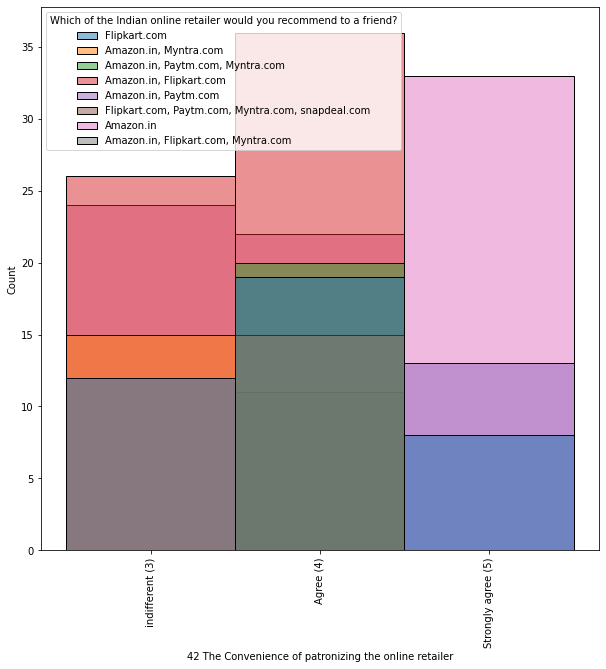

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

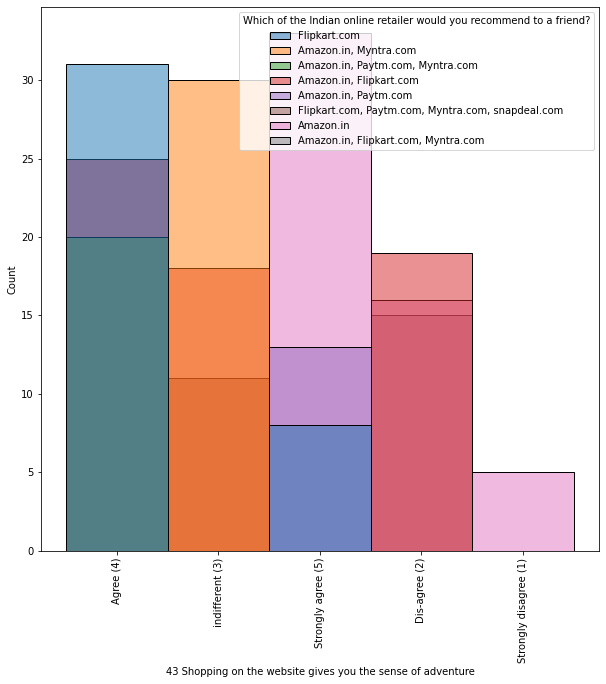

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

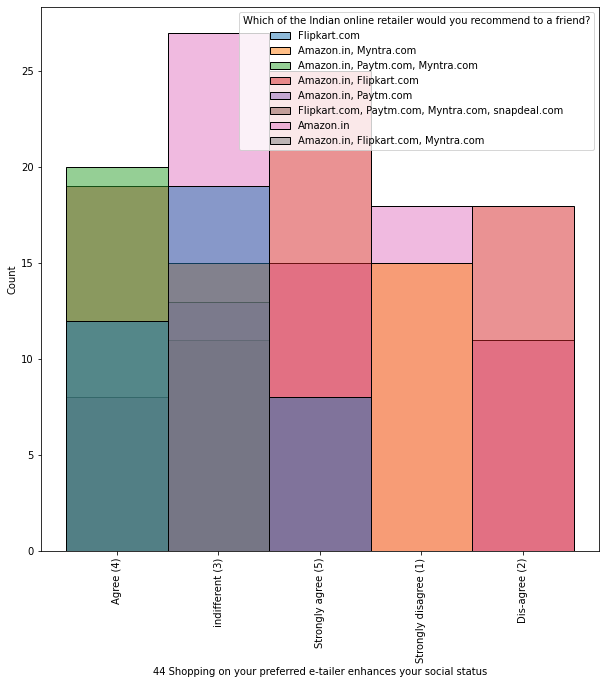

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

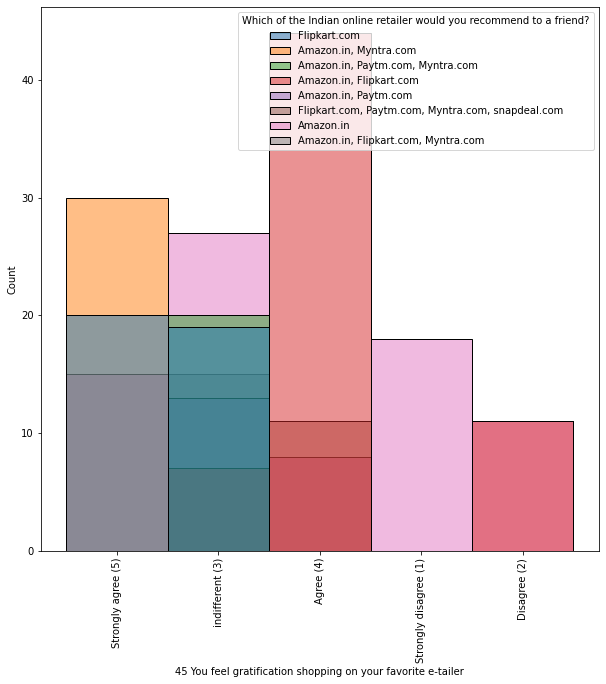

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

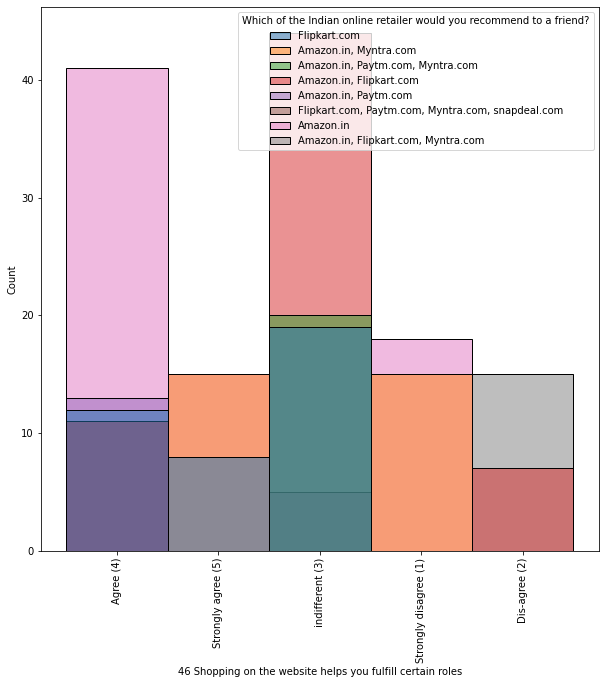

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

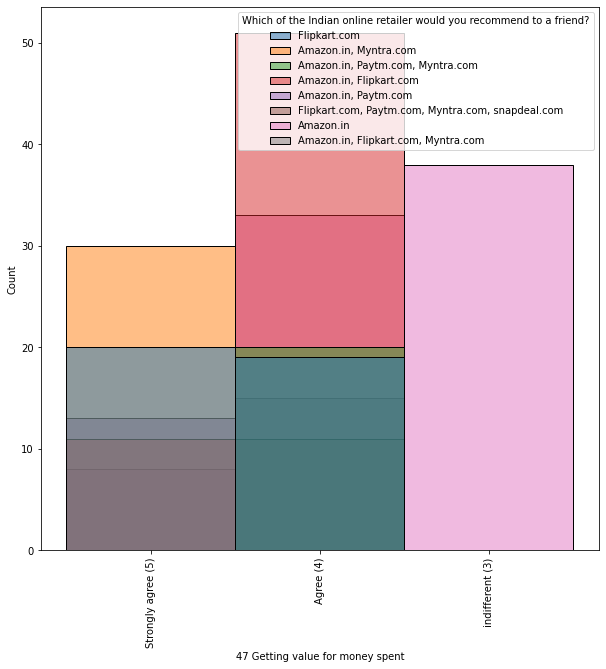

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

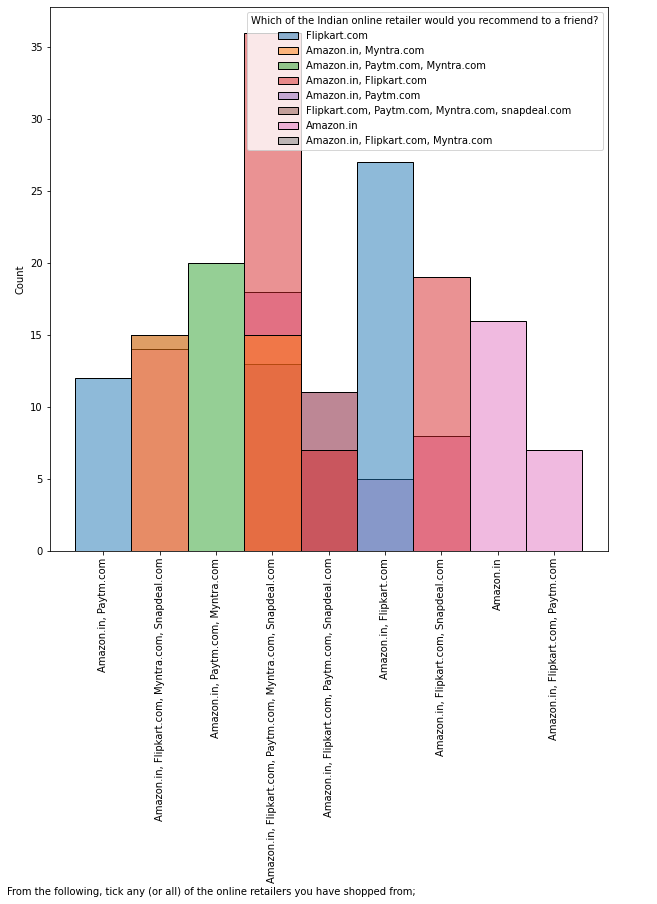

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

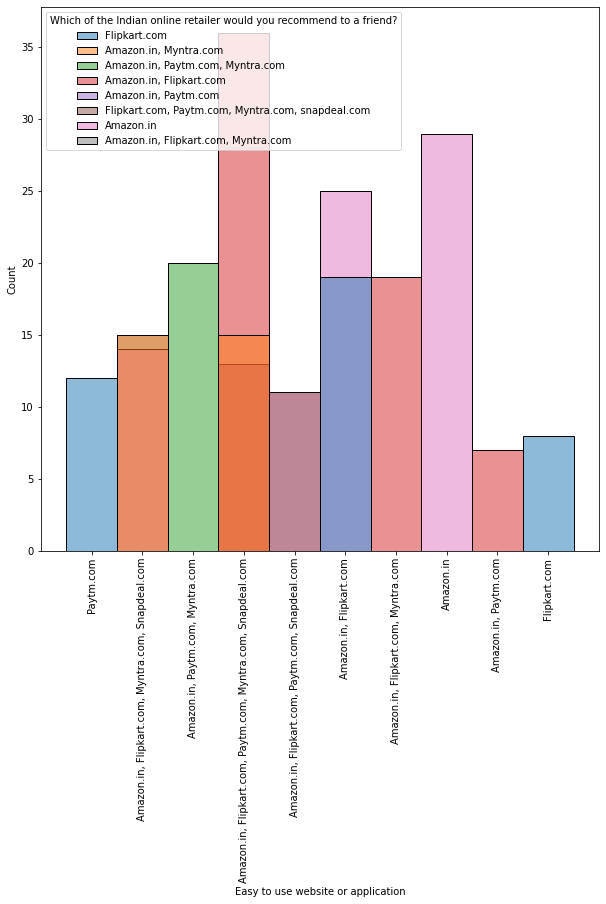

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

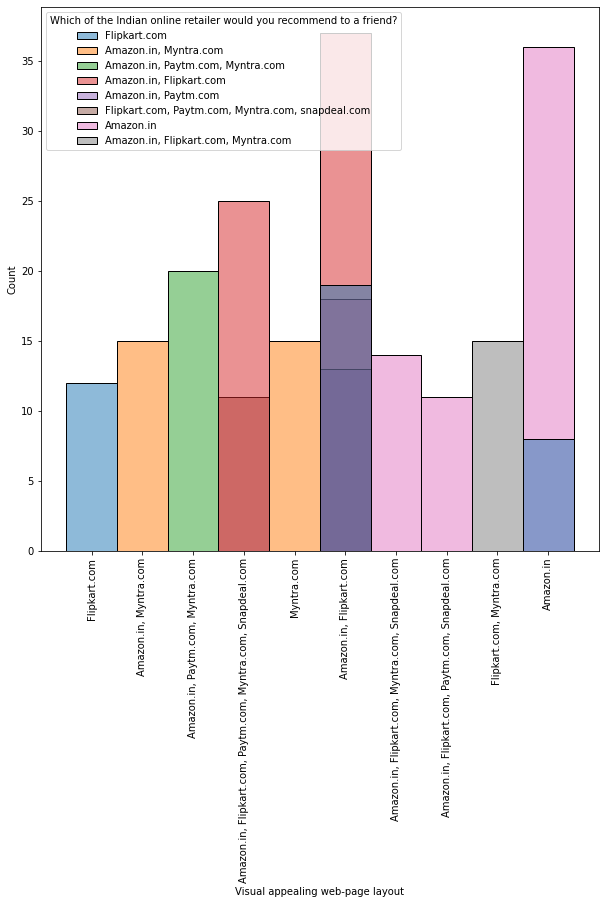

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

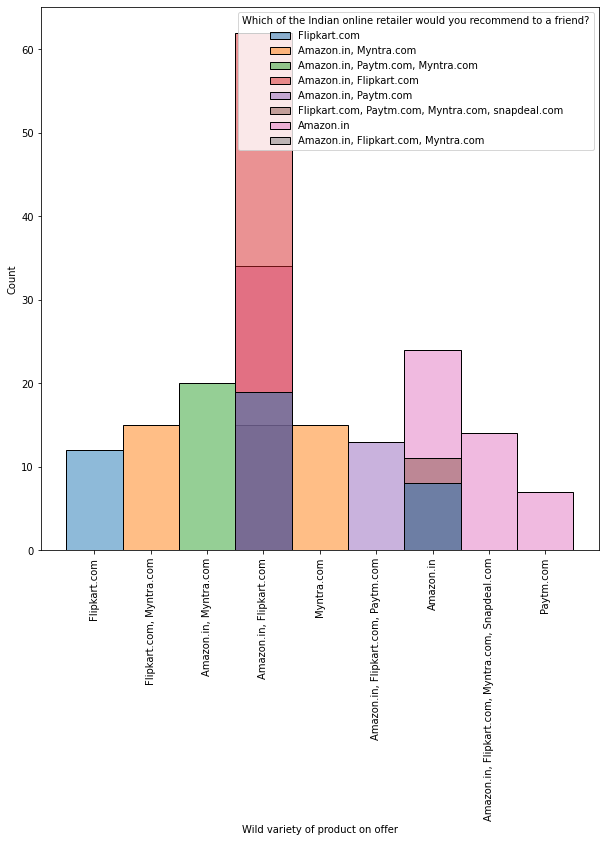

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

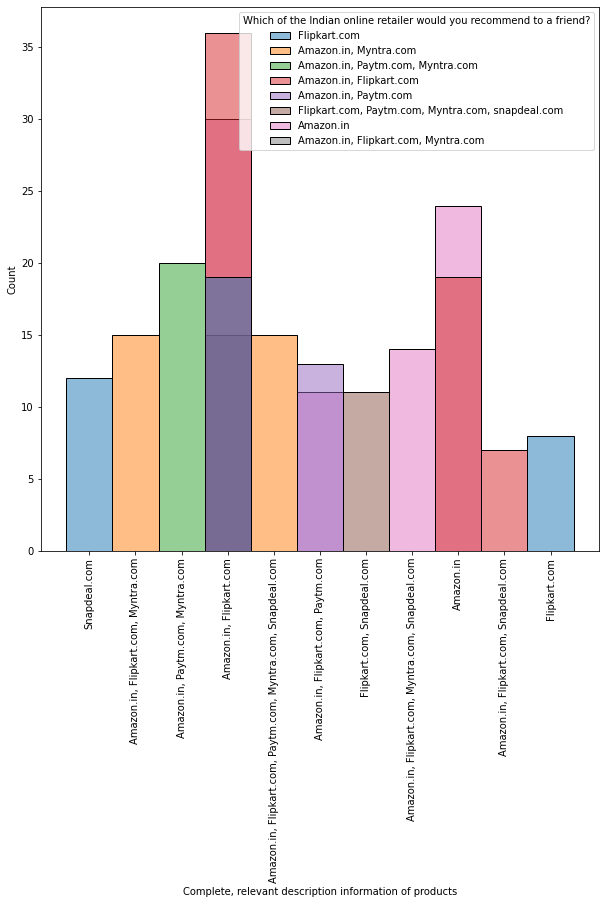

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

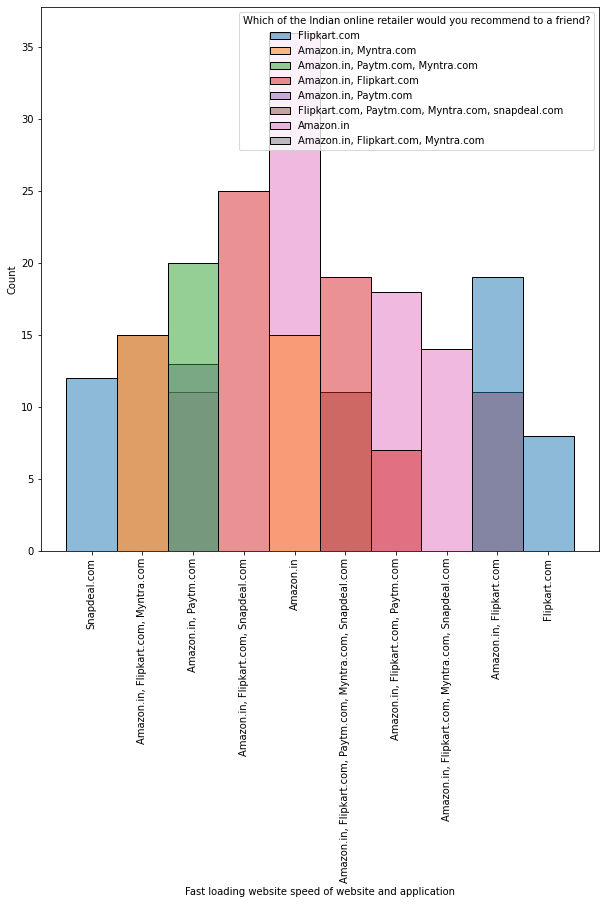

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

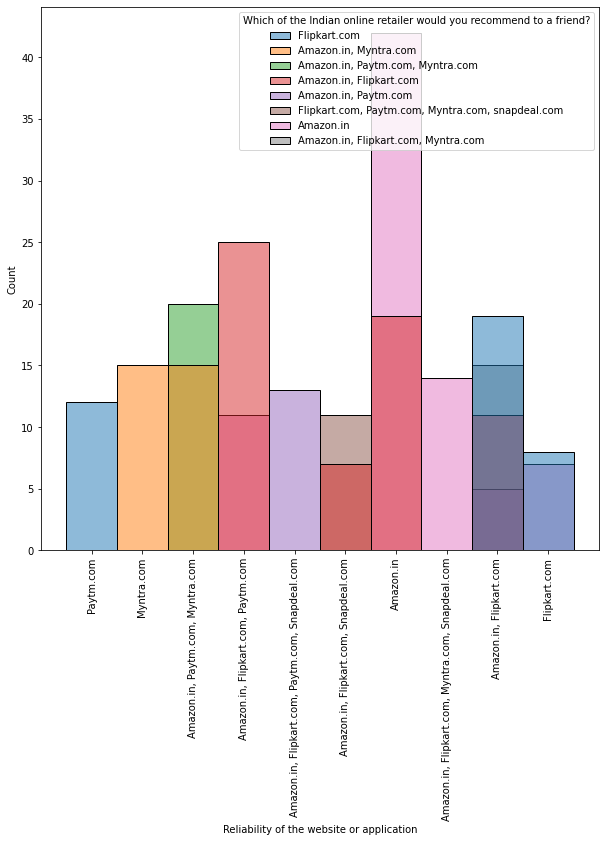

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

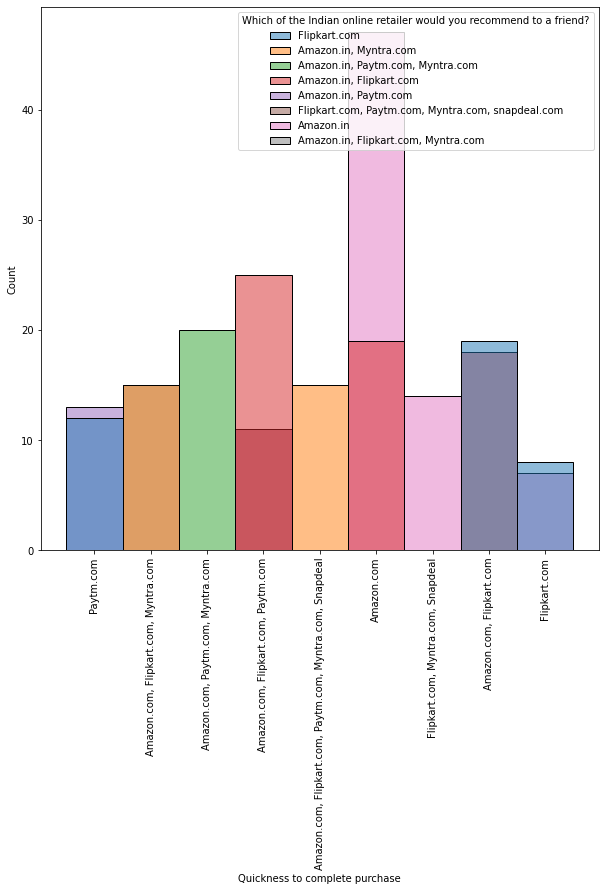

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

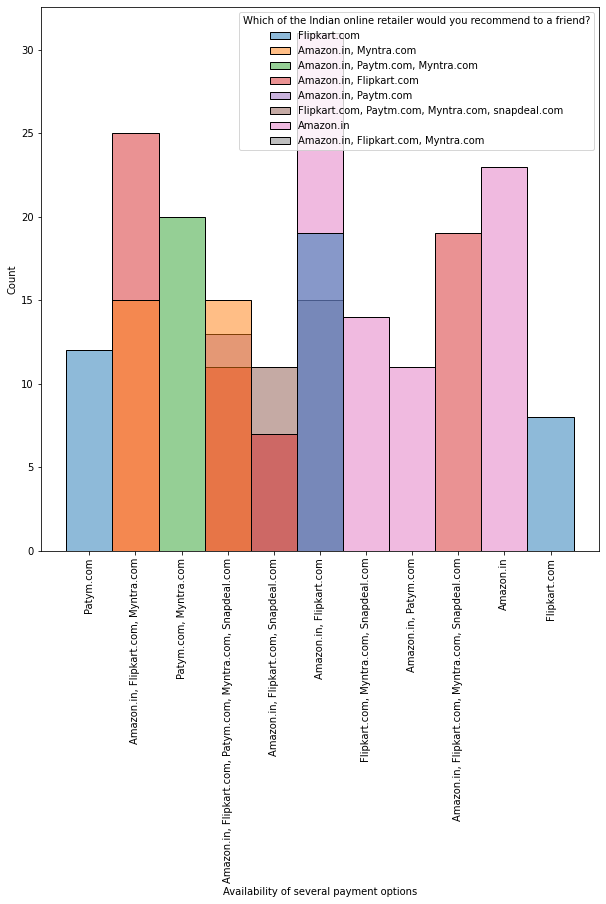

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

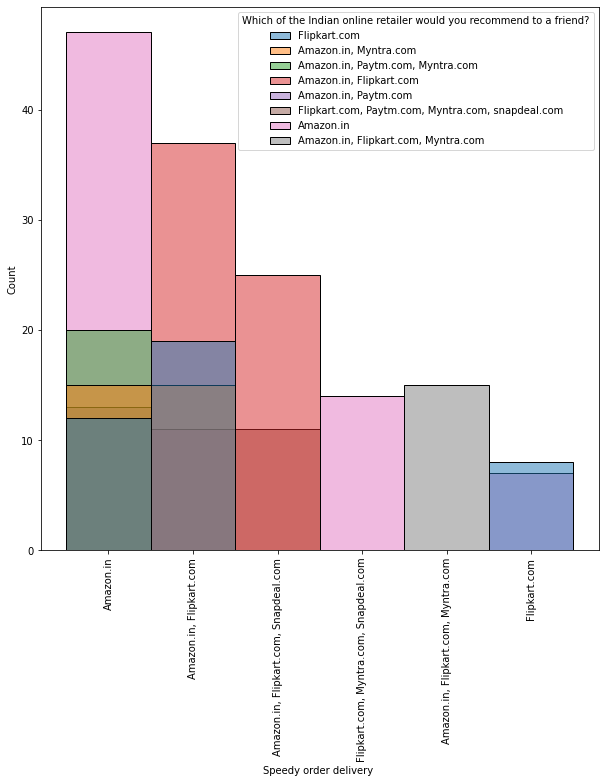

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

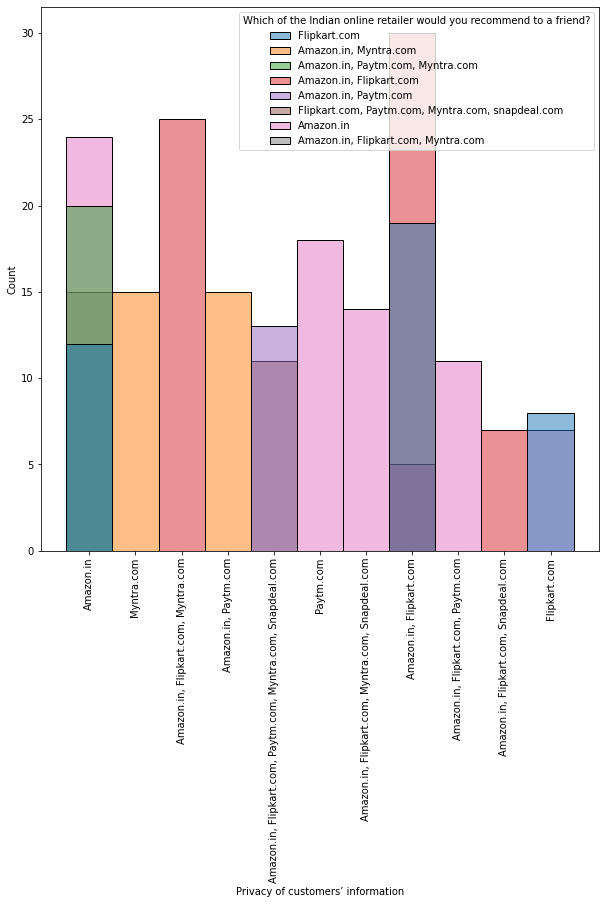

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

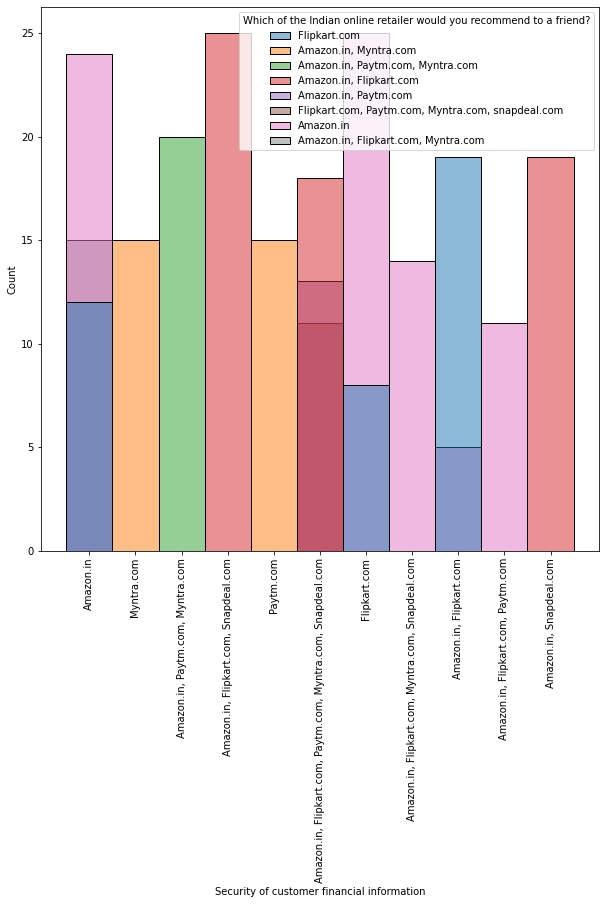

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

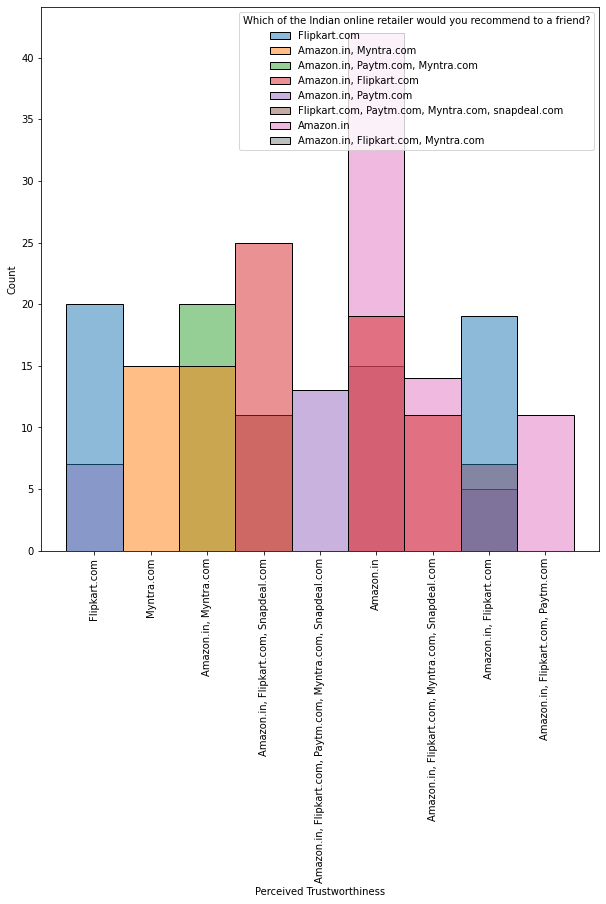

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

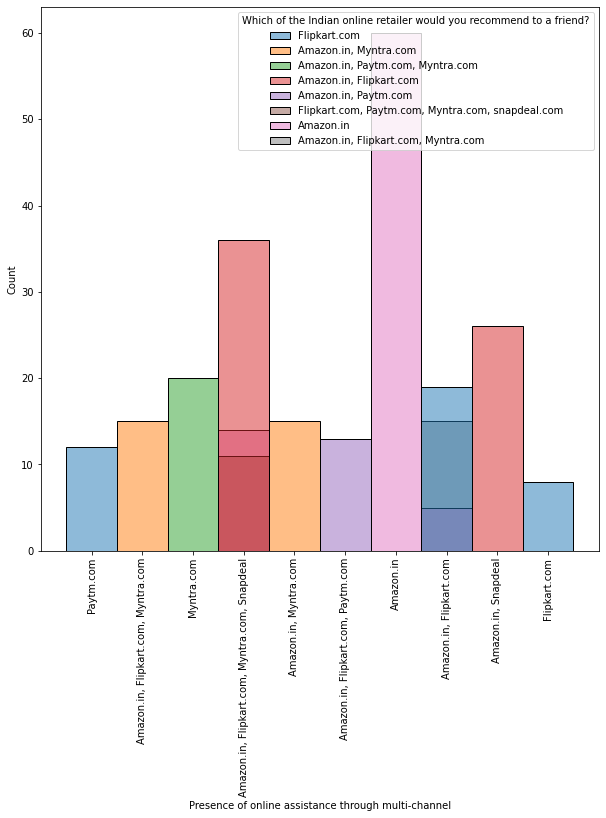

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

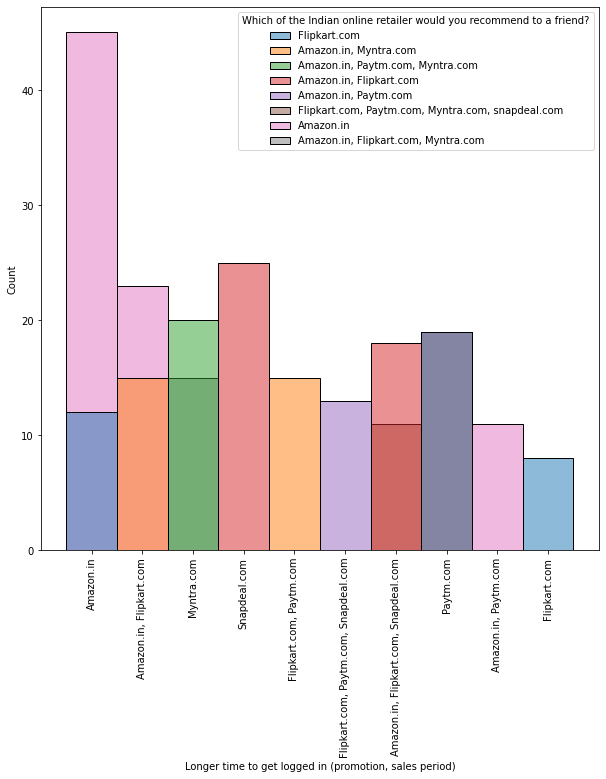

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

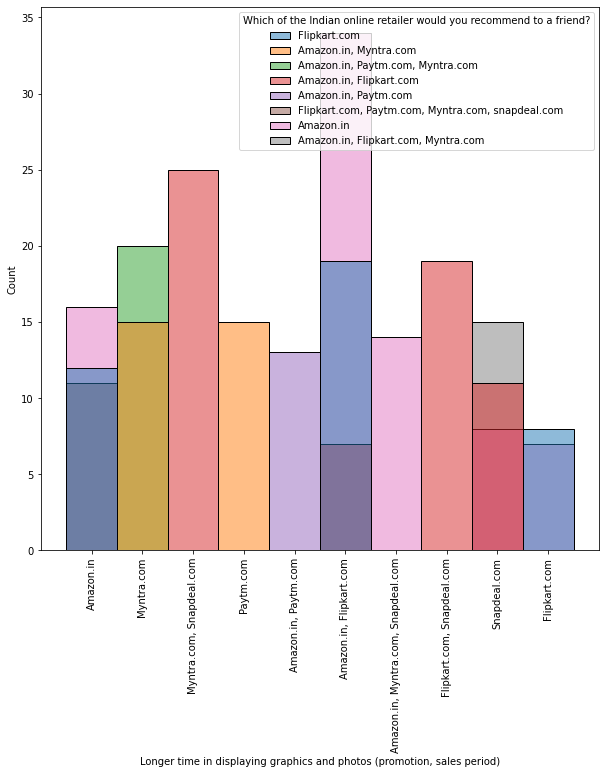

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

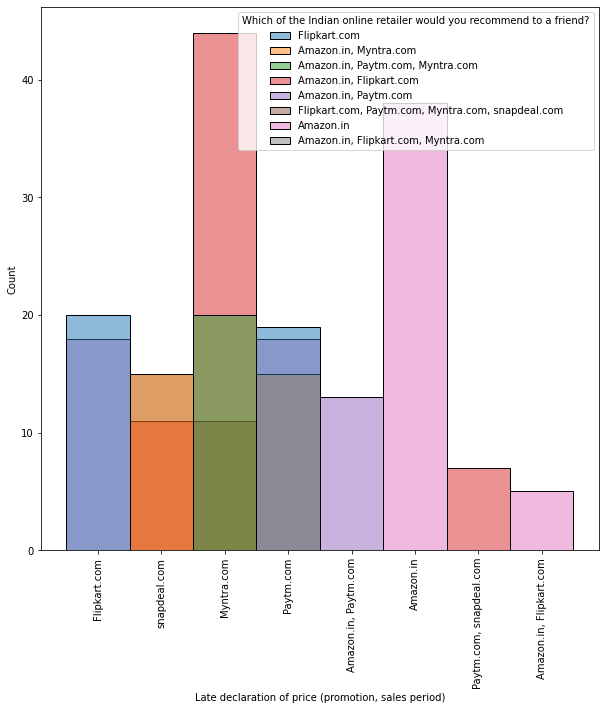

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

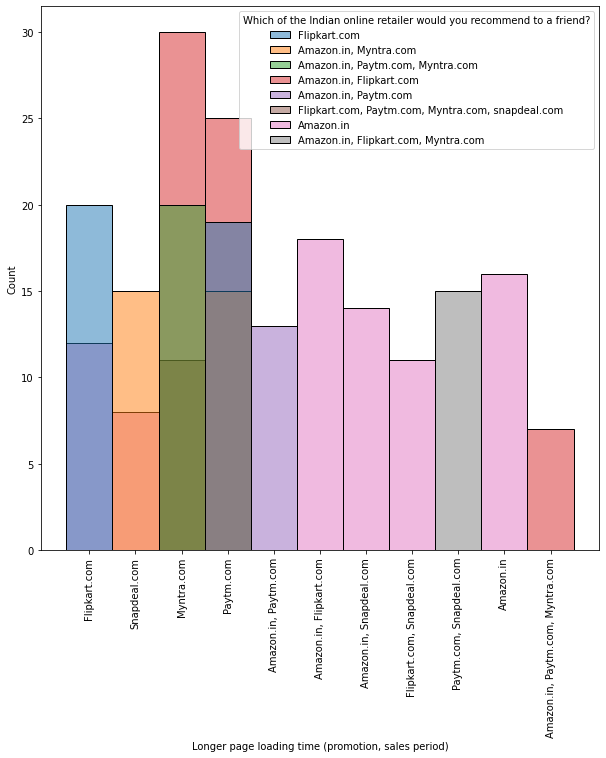

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

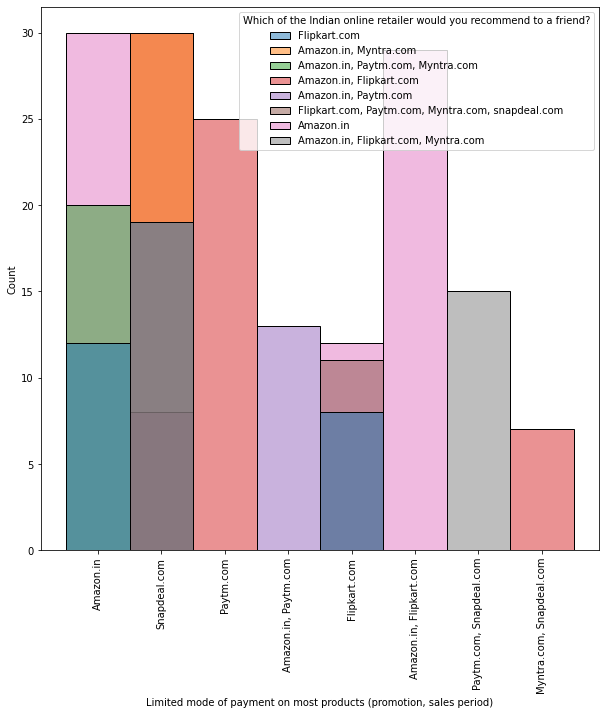

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

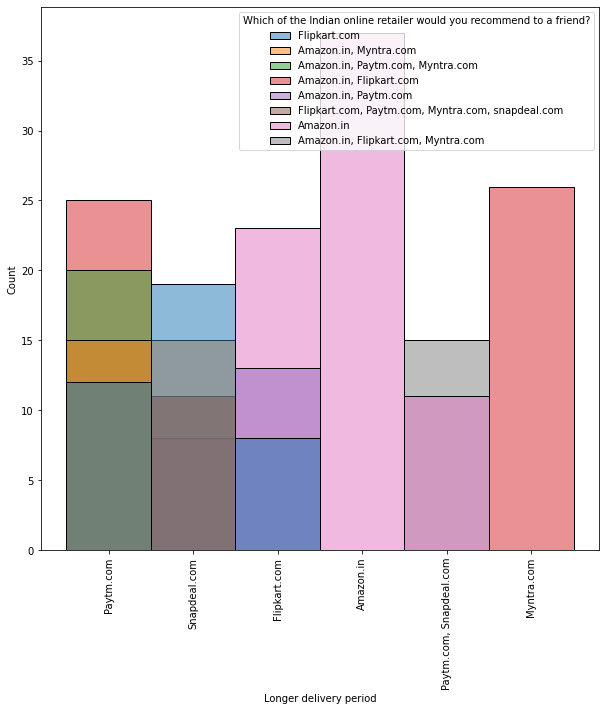

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

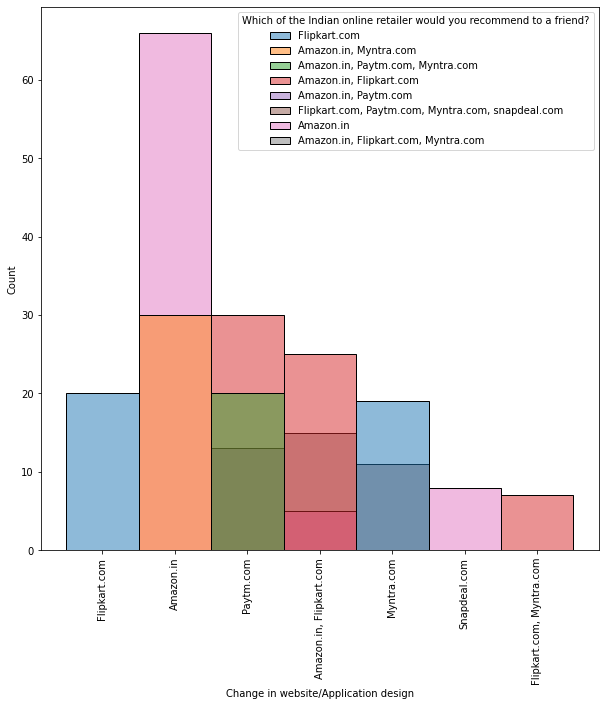

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

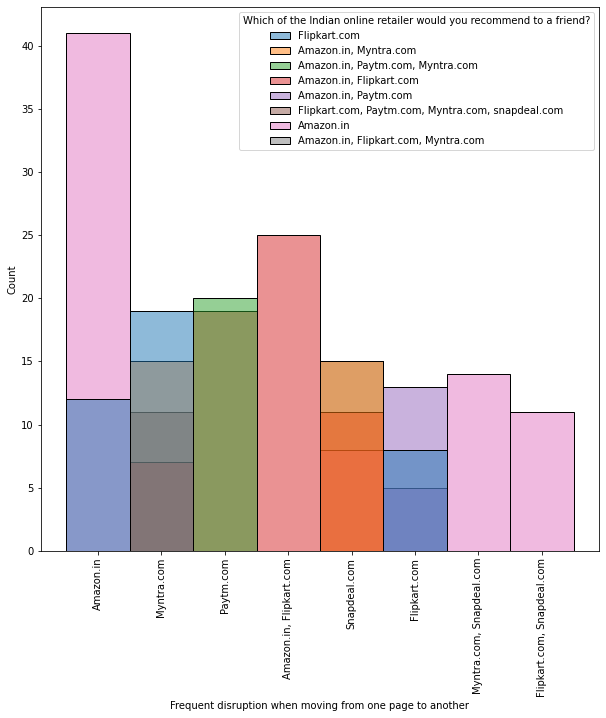

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

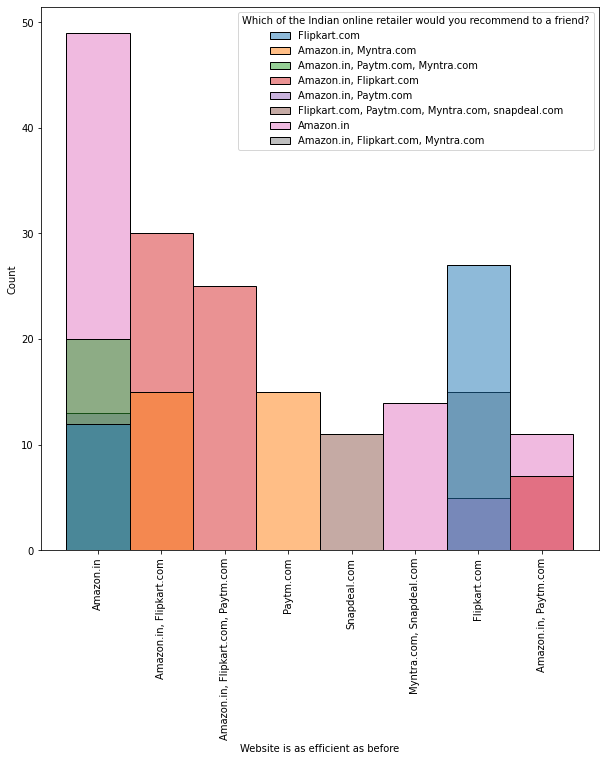

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

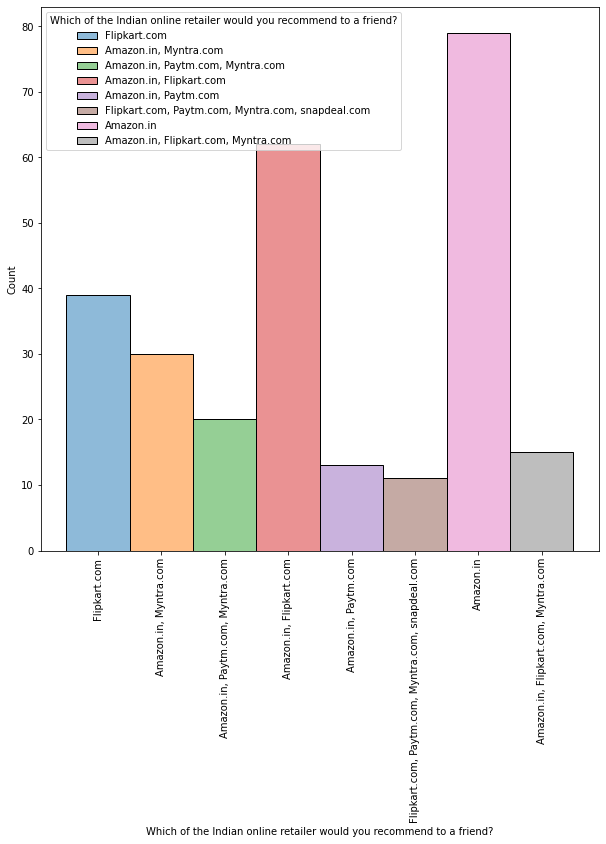

In [86]:
# Histogram with respect to ''Which of the Indian online retailer would you recommend to a friend?'
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['Which of the Indian online retailer would you recommend to a friend?'])
    plt.xticks(rotation ='90')
    plt.show()

It is seen that Amazon is the first choice of respondents, followed by Flipkart, paytm & Myntra.

### Summary:

Dataset details:

1. All features are Categorical/Nominal in nature.

2. Dataset does not have null values.

3. Females are more active shoppers.

4. Most repondent agree that 'Getting value for money spent' is important 

5. Respondants strongly agree that 'Monetary savings' are important

6. It can be estimated from above histogram that significant respondants strongly agree that return policy is important

7. It is seen that Amazon is the first choice of respondents, followed by Flipkart, paytm & Myntra.

8. It is seen that Amazon & Flipkart offer a wide range of products


Following Human errors are noted:

1. 2 How old are you? - Spelling mistake in (41-50 yaers)

2. 7 How do you access the internet while shopping on-line? - spelling mistake ('Mobile internet') internet has capital & small letter'i'.

3. Features 48 to 71 has multiple entries with separator

## Pre-Processing

Approach - First we will use clustering to filter data and that the predicted values can further used to evaluate the high impacting features, those features can be used to develop a precise model

In [19]:
# Replacing internet, converting pin code to string
df_1['7 How do you access the internet while shopping on-line?'] = df_1['7 How do you access the internet while shopping on-line?'].replace('Mobile internet','Mobile Internet')
df_1['4 What is the Pin Code of where you shop online from?']= df_1['4 What is the Pin Code of where you shop online from?'].astype(str)
list_1 = ['From the following, tick any (or all) of the online retailers you have shopped from;                                                                           ',
       'Easy to use website or application',
       'Visual appealing web-page layout', 'Wild variety of product on offer',
       'Complete, relevant description information of products',
       'Fast loading website speed of website and application',
       'Reliability of the website or application',
       'Quickness to complete purchase',
       'Availability of several payment options', 'Speedy order delivery ',
       'Privacy of customers’ information',
       'Security of customer financial information',
       'Perceived Trustworthiness',
       'Presence of online assistance through multi-channel',
       'Longer time to get logged in (promotion, sales period)',
       'Longer time in displaying graphics and photos (promotion, sales period)',
       'Late declaration of price (promotion, sales period)',
       'Longer page loading time (promotion, sales period)',
       'Limited mode of payment on most products (promotion, sales period)',
       'Longer delivery period', 'Change in website/Application design',
       'Frequent disruption when moving from one page to another',
       'Website is as efficient as before',
       'Which of the Indian online retailer would you recommend to a friend?']

# Spliting the features with mutiple values
df = pd.DataFrame()
for i in list_1:
    df_2= df_1[i].str.split(',', expand = True)
    df = pd.concat([df,df_2], axis =1, ignore_index = True)
    
# Replacing whitespace & NaN values    
df.replace(' ','', inplace = True)
df.replace(np.NaN,'None', inplace = True)
df.replace(' Paytm.com','Paytm.com',inplace =True)
df.replace(' Flipkart.com','Flipkart.com',inplace =True)
df.replace(' Myntra.com','Myntra.com',inplace =True)
df.replace(' Myntra.com','Snapdeal.com',inplace =True)

# dropping duplicate features
df_le = df_1.drop(['From the following, tick any (or all) of the online retailers you have shopped from;                                                                           ',
       'Easy to use website or application',
       'Visual appealing web-page layout', 'Wild variety of product on offer',
       'Complete, relevant description information of products',
       'Fast loading website speed of website and application',
       'Reliability of the website or application',
       'Quickness to complete purchase',
       'Availability of several payment options', 'Speedy order delivery ',
       'Privacy of customers’ information',
       'Security of customer financial information',
       'Perceived Trustworthiness',
       'Presence of online assistance through multi-channel',
       'Longer time to get logged in (promotion, sales period)',
       'Longer time in displaying graphics and photos (promotion, sales period)',
       'Late declaration of price (promotion, sales period)',
       'Longer page loading time (promotion, sales period)',
       'Limited mode of payment on most products (promotion, sales period)',
       'Longer delivery period', 'Change in website/Application design',
       'Frequent disruption when moving from one page to another',
       'Website is as efficient as before',
       'Which of the Indian online retailer would you recommend to a friend?'],axis = 1)


df_le = pd.concat([df_le,df], axis =1, ignore_index = True)
df_le

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,0,1,2,3,4,5,6,7,8,9,...,128,129,130,131,132,133,134,135,136,137
0,Male,31-40 years,Delhi,110009,Above 4 years,31-40 times,Dial-up,Desktop,Others,Window/windows Mobile,...,None,Amazon.in,None,Amazon.in,None,None,Flipkart.com,None,None,None
1,Female,21-30 years,Delhi,110030,Above 4 years,41 times and above,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,None,Myntra.com,None,Amazon.in,Flipkart.com,None,Amazon.in,Myntra.com,None,None
2,Female,21-30 years,Greater Noida,201308,3-4 years,41 times and above,Mobile Internet,Smartphone,5.5 inches,Android,...,None,Paytm.com,None,Amazon.in,None,None,Amazon.in,Paytm.com,Myntra.com,None
3,Male,21-30 years,Karnal,132001,3-4 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,IOS/Mac,...,Flipkart.com,Amazon.in,Flipkart.com,Amazon.in,Flipkart.com,Paytm.com,Amazon.in,Flipkart.com,None,None
4,Female,21-30 years,Bangalore,530068,2-3 years,11-20 times,Wi-Fi,Smartphone,4.7 inches,IOS/Mac,...,None,Snapdeal.com,None,Paytm.com,None,None,Amazon.in,Myntra.com,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,Female,21-30 years,Solan,173212,1-2 years,Less than 10 times,Mobile Internet,Smartphone,5.5 inches,Android,...,None,Amazon.in,None,Amazon.in,None,None,Amazon.in,None,None,None
265,Female,31-40 years,Ghaziabad,201008,1-2 years,31-40 times,Mobile Internet,Smartphone,Others,Android,...,None,Flipkart.com,None,Flipkart.com,None,None,Flipkart.com,None,None,None
266,Female,41-50 yaers,Bangalore,560010,2-3 years,Less than 10 times,Mobile Internet,Laptop,Others,Window/windows Mobile,...,None,Snapdeal.com,None,Amazon.in,None,None,Amazon.in,None,None,None
267,Female,Less than 20 years,Solan,173229,2-3 years,Less than 10 times,Wi-Fi,Smartphone,5.5 inches,Android,...,None,Myntra.com,Snapdeal.com,Myntra.com,Snapdeal.com,None,Amazon.in,None,None,None


We can see that post cleaning columns have become 138 from 71

In [20]:
# Label Encoding dataset
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
for i in df_le.columns:
    df_le[i]= le.fit_transform(df_le[i].astype(str))

In [21]:
df_le

,0,1,2,3,4,5,6,7,8,9,...,128,129,130,131,132,133,134,135,136,137
0,1,1,2,1,3,2,0,0,3,2,...,2,0,2,0,2,0,1,2,1,1
1,0,0,2,5,3,3,2,2,0,1,...,2,2,2,0,1,0,0,1,1,1
2,0,0,4,23,2,3,1,2,2,0,...,2,3,2,0,2,0,0,3,0,1
3,1,0,6,11,2,5,1,2,2,1,...,0,0,1,0,1,1,0,0,1,1
4,0,0,0,31,1,0,2,2,0,1,...,2,4,2,3,2,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
264,0,0,10,13,0,5,1,2,2,0,...,2,0,2,0,2,0,0,2,1,1
265,0,1,3,17,0,2,1,2,3,0,...,2,1,2,1,2,0,1,2,1,1
266,0,2,0,35,1,5,1,1,3,2,...,2,4,2,0,2,0,0,2,1,1
267,0,4,10,14,1,5,2,2,2,0,...,2,2,0,2,0,0,0,2,1,1


In [28]:
# defining the kmeans function with initialization as k-means++
from sklearn.decomposition import PCA
from collections import defaultdict
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
sc = StandardScaler()
X = sc.fit_transform(df_le)
pca = PCA(2)
X = pca.fit_transform(X)
# fitting the k means algorithm on scaled & reduced data
# k means using 5 clusters and k-means++ initialization
kmeans = KMeans(n_clusters = 2, init='k-means++')
kmeans.fit(X)
pred = kmeans.predict(X)
frame = pd.DataFrame(X)
frame['cluster'] = pred
print(frame['cluster'].value_counts())
# inertia on the fitted data
print(kmeans.inertia_)

<IPython.core.display.Javascript object>

0    201
1     68
Name: cluster, dtype: int64
5569.895235903401


It is seen that with scaling & dimensionality reduction, the intracluster gaps are high 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Text(0, 0.5, 'Inertia')

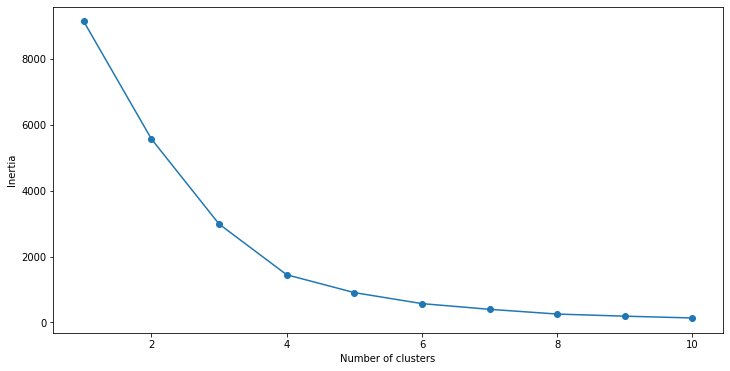

In [29]:
# fitting multiple k-means algorithms and storing the values in an empty list
SSE = []
for cluster in range(1,11):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++')
    kmeans.fit(X)
    SSE.append(kmeans.inertia_)

# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,11), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'], frame['SSE'], marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

With the above approach the curve does not show a typical elbow, second approach we can take is PFA

In [30]:
#Principal Feature Analysis PFA

class PFA(object):
    def __init__(self, n_features, q=None):
        self.q = q
        self.n_features = n_features

    def fit(self, X):
        if not self.q:
            self.q = X.shape[1]

        sc = StandardScaler()
        X = sc.fit_transform(df_le)

        pca = PCA(n_components=self.q).fit(X) # calculation Cov matrix is embeded in PCA
        A_q = pca.components_.T

        kmeans = KMeans(n_clusters=self.n_features).fit(A_q)
        clusters = kmeans.predict(A_q)
        cluster_centers = kmeans.cluster_centers_

        dists = defaultdict(list)
        for i, c in enumerate(clusters):
            dist = euclidean_distances([A_q[i, :]], [cluster_centers[c, :]])[0][0]
            dists[c].append((i, dist))

        self.indices_ = [sorted(f, key=lambda x: x[1])[0][0] for f in dists.values()]
        self.features_ = X[:, self.indices_]
        
# Usage
pfa = PFA(n_features=1)
pfa.fit(df_le)
# To get the transformed matrix
x = pfa.features_
print(x)
# To get the column indices of the kept features
column_indices = pfa.indices_
column_indices

[[-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-1.34108753]
 [-0.69688656]
 [-1.34108753]
 [-0.05268558]
 [-1.34108753]
 [-1.34108753]
 [-1.34108753]
 [-0.05268558]
 [ 1.23571637]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-1.34108753]
 [-0.05268558]
 [ 1.23571637]
 [-0.69688656]
 [-1.34108753]
 [-0.05268558]
 [-1.34108753]
 [-1.34108753]
 [-1.34108753]
 [-0.05268558]
 [ 1.23571637]
 [-0.05268558]
 [ 1.23571637]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-1.34108753]
 [-0.69688656]
 [-1.34108753]
 [-0.05268558]
 [-1.34108753]
 [-1.34108753]
 [-1.34108753]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-0.05268558]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-1.34108753]
 [-0.69688656]
 [-0.69688656]
 [-1.34108753]
 [-0.05268558]
 [-1.34108753]
 [-1.34108753]
 [-1.34108753]
 [-0.05268558]
 [ 1.23571637]
 [ 1.23571637]
 [-0.05268558]
 [-0.05268558]
 [-0.69688656]
 [-0.69688656]
 [-0.05268

[12]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Text(0, 0.5, 'Inertia')

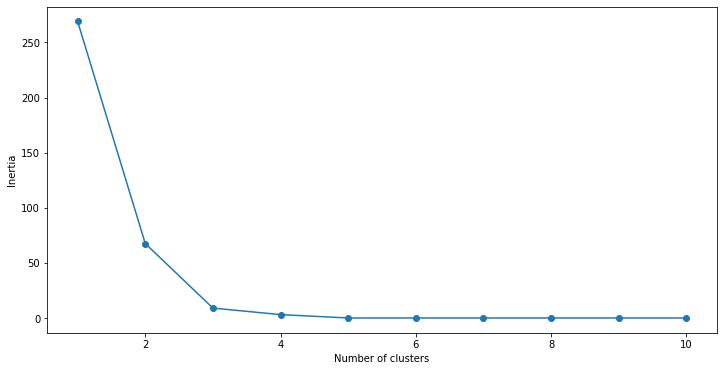

In [31]:
# fitting multiple k-means algorithms and storing the values in an empty list
SSE = []
for cluster in range(1,11):
    kmeans = KMeans(n_jobs = -1, n_clusters = cluster, init='k-means++')
    kmeans.fit(x)
    SSE.append(kmeans.inertia_)

# converting the results into a dataframe and plotting them
frame = pd.DataFrame({'Cluster':range(1,11), 'SSE':SSE})
plt.figure(figsize=(12,6))
plt.plot(frame['Cluster'], frame['SSE'], marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')

From the above elbow curve it can be seen that based on a single feature optimum number of clusters is 3

In [50]:
#Building Model for prediction
kmeans = KMeans( n_clusters = 3, init='k-means++')
kmeans.fit(x)
pred = kmeans.predict(x)
print(f'Intertia values {kmeans.inertia_}')
pred = pd.DataFrame(pred)
pred.columns = ['pred_values']
#we merge this dataframe with df
df = pd.concat([df_1,pred], axis = 1)

#Maping the clusters to Retained (R) and Non-Retained(NR)
df['pred_values']= df.pred_values.map({0:'R',1:'NR',2:'NR'})
df['pred_values'].value_counts()

Intertia values 8.979381821660583


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

NR    175
R      94
Name: pred_values, dtype: int64

In [52]:
# Performing chi-square test of dataset with predicted values.
c_value =[]
p_value = []
deg_of_f = []
for i in df.columns:
    nl = "\n"
    
    crosstab = pd.crosstab(df[f"{i}"], df['pred_values'])
    print(crosstab, nl)
    chi2, p, dof, expected = stats.chi2_contingency(crosstab)
    c_value.append(chi2)
    p_value.append(p)
    deg_of_f.append(dof)
    print(f"Chi2 value= {chi2}{nl}p-value= {p}{nl}Degrees of freedom= {dof}{nl}frequency={expected}{nl}")
    
    
    
# Creating a dataframe with chi2 values, p_value & dof of each feature post prediction
df_ch = pd.DataFrame({})
df_ch['name']= df.columns
df_ch['chi2_value'] = c_value
df_ch['p_value'] = p_value
df_ch['dof']= deg_of_f

<IPython.core.display.Javascript object>

pred_values             NR   R
1Gender of respondent         
Female                 107  74
Male                    68  20 

Chi2 value= 7.806496564517532
p-value= 0.005205873386044382
Degrees of freedom= 1
frequency=[[117.75092937  63.24907063]
 [ 57.24907063  30.75092937]]



<IPython.core.display.Javascript object>

pred_values          NR   R
2 How old are you?         
21-30 years          47  32
31-40 years          56  25
41-50 yaers          44  26
51 years and above   19   0
Less than 20 years    9  11 

Chi2 value= 15.561503197111307
p-value= 0.003667703393655019
Degrees of freedom= 4
frequency=[[51.39405204 27.60594796]
 [52.69516729 28.30483271]
 [45.53903346 24.46096654]
 [12.3605948   6.6394052 ]
 [13.01115242  6.98884758]]



<IPython.core.display.Javascript object>

pred_values                            NR   R
3 Which city do you shop online from?        
Bangalore                              17  20
Bulandshahr                             2   0
Delhi                                  43  15
Ghaziabad                               1  17
Greater Noida                          28  15
Gurgaon                                12   0
Karnal                                 19   8
Merrut                                  9   0
Moradabad                               5   0
Noida                                  26  14
Solan                                  13   5 

Chi2 value= 51.861988528440634
p-value= 1.2102423263589673e-07
Degrees of freedom= 10
frequency=[[24.07063197 12.92936803]
 [ 1.30111524  0.69888476]
 [37.73234201 20.26765799]
 [11.71003717  6.28996283]
 [27.9739777  15.0260223 ]
 [ 7.80669145  4.19330855]
 [17.56505576  9.43494424]
 [ 5.85501859  3.14498141]
 [ 3.2527881   1.7472119 ]
 [26.02230483 13.97769517]
 [11.71003717  6.28996283]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
4 What is the Pin Code of where you shop online...        
110008                                               4   3
110009                                               4   0
110011                                               6   1
110014                                               6   0
110018                                               6   0
110030                                               0   4
110039                                               4   0
110042                                               0   4
110044                                              13   3
122009                                               4   0
122018                                               8   0
132001                                              17   2
132036                                               2   6
173212                                               4   5
173229                                               9  

<IPython.core.display.Javascript object>

pred_values                                 NR   R
5 Since How Long You are Shopping Online ?        
1-2 years                                    4  12
2-3 years                                   40  25
3-4 years                                   27  20
Above 4 years                               74  24
Less than 1 year                            30  13 

Chi2 value= 17.974660884709817
p-value= 0.00124824950093875
Degrees of freedom= 4
frequency=[[10.40892193  5.59107807]
 [42.28624535 22.71375465]
 [30.57620818 16.42379182]
 [63.75464684 34.24535316]
 [27.9739777  15.0260223 ]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
6 How many times you have made an online purcha...        
11-20 times                                         18  11
21-30 times                                          5   5
31-40 times                                         38  25
41 times and above                                  25  22
42 times and above                                   0   6
Less than 10 times                                  89  25 

Chi2 value= 24.307109250594756
p-value= 0.00018950726842358666
Degrees of freedom= 5
frequency=[[18.866171   10.133829  ]
 [ 6.50557621  3.49442379]
 [40.98513011 22.01486989]
 [30.57620818 16.42379182]
 [ 3.90334572  2.09665428]
 [74.16356877 39.83643123]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
7 How do you access the internet while shopping...         
Dial-up                                               4   0
Mobile Internet                                     120  69
Wi-Fi                                                51  25 

Chi2 value= 2.4922833299053098
p-value= 0.28761236366705695
Degrees of freedom= 2
frequency=[[  2.60223048   1.39776952]
 [122.95539033  66.04460967]
 [ 49.44237918  26.55762082]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
8 Which device do you use to access the online ...        
Desktop                                             30   0
Laptop                                              83   3
Smartphone                                          50  91
Tablet                                              12   0 

Chi2 value= 114.31526545236517
p-value= 1.2927011667548818e-24
Degrees of freedom= 3
frequency=[[19.51672862 10.48327138]
 [55.94795539 30.05204461]
 [91.72862454 49.27137546]
 [ 7.80669145  4.19330855]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
9 What is the screen size of your mobile device...         
4.7 inches                                            0  29
5 inches                                              7   0
5.5 inches                                           45  54
Others                                              123  11 

Chi2 value= 116.61314690707832
p-value= 4.137787468552124e-25
Degrees of freedom= 3
frequency=[[18.866171   10.133829  ]
 [ 4.55390335  2.44609665]
 [64.40520446 34.59479554]
 [87.17472119 46.82527881]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
10 What is the operating system (OS) of your de...         
Android                                              30  55
IOS/Mac                                              32  30
Window/windows Mobile                               113   9 

Chi2 value= 78.83044778342044
p-value= 7.624050439260144e-18
Degrees of freedom= 2
frequency=[[55.29739777 29.70260223]
 [40.33457249 21.66542751]
 [79.36802974 42.63197026]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
11 What browser do you run on your device to ac...         
Google chrome                                       145  71
Mozilla Firefox                                       5   0
Opera                                                 0   8
Safari                                               25  15 

Chi2 value= 18.102915681639086
p-value= 0.00041886673138575496
Degrees of freedom= 3
frequency=[[140.5204461   75.4795539 ]
 [  3.2527881    1.7472119 ]
 [  5.20446097   2.79553903]
 [ 26.02230483  13.97769517]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
12 Which channel did you follow to arrive at yo...         
Content Marketing                                     5  15
Display Adverts                                      11   8
Search Engine                                       159  71 

Chi2 value= 16.22394638075299
p-value= 0.000299926476890358
Degrees of freedom= 2
frequency=[[ 13.01115242   6.98884758]
 [ 12.3605948    6.6394052 ]
 [149.62825279  80.37174721]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
13 After first visit, how do you reach the onli...        
Direct URL                                          70   0
E-mail                                              18   0
Search Engine                                       87   0
Social Media                                         0   8
Via application                                      0  86 

Chi2 value= 269.0
p-value= 5.240002319472924e-57
Degrees of freedom= 4
frequency=[[45.53903346 24.46096654]
 [11.71003717  6.28996283]
 [56.59851301 30.40148699]
 [ 5.20446097  2.79553903]
 [55.94795539 30.05204461]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
14 How much time do you explore the e- retail s...        
1-5 mins                                            14   0
11-15 mins                                          18  28
6-10 mins                                           71   0
Less than 1 min                                      0  15
more than 15 mins                                   72  51 

Chi2 value= 89.48234316528442
p-value= 1.6961464662865181e-18
Degrees of freedom= 4
frequency=[[ 9.10780669  4.89219331]
 [29.92565056 16.07434944]
 [46.18959108 24.81040892]
 [ 9.75836431  5.24163569]
 [80.01858736 42.98141264]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
15 What is your preferred payment Option?\t\t\t...         
Cash on delivery (CoD)                               45  31
Credit/Debit cards                                  118  30
E-wallets (Paytm, Freecharge etc.)                   12  33 

Chi2 value= 44.33259031852201
p-value= 2.3621111415746646e-10
Degrees of freedom= 2
frequency=[[49.44237918 26.55762082]
 [96.28252788 51.71747212]
 [29.27509294 15.72490706]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
16 How frequently do you abandon (selecting an ...         
Frequently                                            7  28
Never                                                25  23
Sometimes                                           143  28
Very frequently                                       0  15 

Chi2 value= 88.67211520378962
p-value= 4.2242139361254537e-19
Degrees of freedom= 3
frequency=[[ 22.76951673  12.23048327]
 [ 31.2267658   16.7732342 ]
 [111.24535316  59.75464684]
 [  9.75836431   5.24163569]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
17 Why did you abandon the “Bag”, “Shopping Car...        
Better alternative offer                            90  43
Change in price                                     29   8
Lack of trust                                       31   0
No preferred mode of payment                        14   0
Promo code not applicable                           11  43 

Chi2 value= 74.89096255407085
p-value= 2.1012581510298832e-15
Degrees of freedom= 4
frequency=[[86.52416357 46.47583643]
 [24.07063197 12.92936803]
 [20.16728625 10.83271375]
 [ 9.10780669  4.89219331]
 [35.13011152 18.86988848]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
18 The content on the website must be easy to r...        
Agree (4)                                           72   8
Indifferent (3)                                      0   7
Strongly agree (5)                                  85  79
Strongly disagree (1)                               18   0 

Chi2 value= 57.217071762176595
p-value= 2.309799278943441e-12
Degrees of freedom= 3
frequency=[[ 52.04460967  27.95539033]
 [  4.55390335   2.44609665]
 [106.69144981  57.30855019]
 [ 11.71003717   6.28996283]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
19 Information on similar product to the one hi...        
Agree (4)                                           57  35
Dis-agree (2)                                       18   0
Indifferent (3)                                     28  15
Strongly agree (5)                                  72  44 

Chi2 value= 10.512566754899217
p-value= 0.014675891474981497
Degrees of freedom= 3
frequency=[[59.85130112 32.14869888]
 [11.71003717  6.28996283]
 [27.9739777  15.0260223 ]
 [75.46468401 40.53531599]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
20 Complete information on listed seller and pr...        
Agree (4)                                           73  28
Dis-agree (2)                                       18   0
Indifferent (3)                                     37  15
Strongly agree (5)                                  36  51
Strongly disagree (1)                               11   0 

Chi2 value= 40.19782170275189
p-value= 3.9392537952641494e-08
Degrees of freedom= 4
frequency=[[65.7063197  35.2936803 ]
 [11.71003717  6.28996283]
 [33.82899628 18.17100372]
 [56.59851301 30.40148699]
 [ 7.15613383  3.84386617]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
21 All relevant information on listed products ...        
Agree (4)                                           89  43
Dis-agree (2)                                        5   7
Strongly agree (5)                                  63  44
Strongly disagree (1)                               18   0 

Chi2 value= 14.67799288800283
p-value= 0.0021135654455529864
Degrees of freedom= 3
frequency=[[85.87360595 46.12639405]
 [ 7.80669145  4.19330855]
 [69.60966543 37.39033457]
 [11.71003717  6.28996283]]



<IPython.core.display.Javascript object>

pred_values                       NR   R
22 Ease of navigation in website        
Agree (4)                         55  50
Dis-agree (2)                      5   0
Strongly agree (5)                97  44
Strongly disagree (1)             18   0 

Chi2 value= 20.64130129371803
p-value= 0.00012496704981714224
Degrees of freedom= 3
frequency=[[68.30855019 36.69144981]
 [ 3.2527881   1.7472119 ]
 [91.72862454 49.27137546]
 [11.71003717  6.28996283]]



<IPython.core.display.Javascript object>

pred_values                      NR   R
23 Loading and processing speed        
Agree (4)                        84  28
Dis-agree (2)                    18   0
Indifferent (3)                   5   7
Strongly agree (5)               56  59
Strongly disagree (1)            12   0 

Chi2 value= 37.41356182547024
p-value= 1.4803484859064742e-07
Degrees of freedom= 4
frequency=[[72.86245353 39.13754647]
 [11.71003717  6.28996283]
 [ 7.80669145  4.19330855]
 [74.81412639 40.18587361]
 [ 7.80669145  4.19330855]]



<IPython.core.display.Javascript object>

pred_values                                 NR   R
24 User friendly Interface of the website         
Agree (4)                                   30  15
Dis-agree (2)                               12   0
Indifferent (3)                              5   0
Strongly agree (5)                         110  79
Strongly disagree (1)                       18   0 

Chi2 value= 22.757778099419433
p-value= 0.00014154448283152678
Degrees of freedom= 4
frequency=[[ 29.27509294  15.72490706]
 [  7.80669145   4.19330855]
 [  3.2527881    1.7472119 ]
 [122.95539033  66.04460967]
 [ 11.71003717   6.28996283]]



<IPython.core.display.Javascript object>

pred_values                    NR   R
25 Convenient Payment methods        
Agree (4)                      65  15
Dis-agree (2)                  30   0
Strongly agree (5)             80  79 

Chi2 value= 40.54190502475579
p-value= 1.5719444002259485e-09
Degrees of freedom= 2
frequency=[[ 52.04460967  27.95539033]
 [ 19.51672862  10.48327138]
 [103.43866171  55.56133829]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
26 Trust that the online retail store will fulf...        
Agree (4)                                           63  23
Disagree (2)                                        30   0
Strongly agree (5)                                  70  71
indifferent  (3)                                    12   0 

Chi2 value= 39.83309059836259
p-value= 1.1559404406855818e-08
Degrees of freedom= 3
frequency=[[55.94795539 30.05204461]
 [19.51672862 10.48327138]
 [91.72862454 49.27137546]
 [ 7.80669145  4.19330855]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
27 Empathy (readiness to assist with queries) t...         
Agree (4)                                            34   8
Strongly agree (5)                                  115  79
Strongly disagree (1)                                18   0
indifferent (3)                                       8   7 

Chi2 value= 18.092430244130988
p-value= 0.00042095818713085663
Degrees of freedom= 3
frequency=[[ 27.32342007  14.67657993]
 [126.20817844  67.79182156]
 [ 11.71003717   6.28996283]
 [  9.75836431   5.24163569]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
28 Being able to guarantee the privacy of the c...         
Agree (4)                                            35  23
Strongly agree (5)                                  114  71
indifferent (3)                                      26   0 

Chi2 value= 15.491652826917683
p-value= 0.00043254403858466344
Degrees of freedom= 2
frequency=[[ 37.73234201  20.26765799]
 [120.35315985  64.64684015]
 [ 16.91449814   9.08550186]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
29 Responsiveness, availability of several comm...        
Agree (4)                                           79  15
Strongly agree (5)                                  70  79
Strongly disagree (1)                               11   0
indifferent (3)                                     15   0 

Chi2 value= 50.287329377292494
p-value= 6.939158027452265e-11
Degrees of freedom= 3
frequency=[[61.15241636 32.84758364]
 [96.9330855  52.0669145 ]
 [ 7.15613383  3.84386617]
 [ 9.75836431  5.24163569]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
30 Online shopping gives monetary benefit and d...        
Agree (4)                                           85   0
Dis-agree (2)                                       11   0
Strongly agree (5)                                  19  86
Strongly disagree (1)                               18   0
indifferent (3)                                     42   8 

Chi2 value= 170.9853549862498
p-value= 6.426599901930867e-36
Degrees of freedom= 4
frequency=[[55.29739777 29.70260223]
 [ 7.15613383  3.84386617]
 [68.30855019 36.69144981]
 [11.71003717  6.28996283]
 [32.52788104 17.47211896]]



<IPython.core.display.Javascript object>

pred_values                                   NR   R
31 Enjoyment is derived from shopping online        
Agree (4)                                     59   0
Dis-agree (2)                                 19   0
Strongly agree (5)                             0  86
Strongly disagree (1)                         30   0
indifferent (3)                               67   8 

Chi2 value= 237.56292117527866
p-value= 3.1063952885539985e-50
Degrees of freedom= 4
frequency=[[38.38289963 20.61710037]
 [12.3605948   6.6394052 ]
 [55.94795539 30.05204461]
 [19.51672862 10.48327138]
 [48.79182156 26.20817844]]



<IPython.core.display.Javascript object>

pred_values                                    NR   R
32 Shopping online is convenient and flexible        
Agree (4)                                      71   7
Dis-agree (2)                                  12   0
Strongly agree (5)                             67  79
indifferent (3)                                25   8 

Chi2 value= 54.838600272747755
p-value= 7.432688585836542e-12
Degrees of freedom= 3
frequency=[[50.74349442 27.25650558]
 [ 7.80669145  4.19330855]
 [94.98141264 51.01858736]
 [21.46840149 11.53159851]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
33 Return and replacement policy of the e-taile...         
Agree (4)                                            51   0
Dis-agree (2)                                        12   8
Strongly agree (5)                                  112  86 

Chi2 value= 33.89728703447853
p-value= 4.3581045505050366e-08
Degrees of freedom= 2
frequency=[[ 33.17843866  17.82156134]
 [ 13.01115242   6.98884758]
 [128.81040892  69.18959108]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
34 Gaining access to loyalty programs is a bene...        
Agree (4)                                           64   0
Dis-agree (2)                                        0  15
Strongly agree (5)                                  44  71
Strongly disagree (1)                               11   0
indifferent (3)                                     56   8 

Chi2 value= 118.71250482357605
p-value= 1.006072729471211e-24
Degrees of freedom= 4
frequency=[[41.63568773 22.36431227]
 [ 9.75836431  5.24163569]
 [74.81412639 40.18587361]
 [ 7.15613383  3.84386617]
 [41.63568773 22.36431227]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
35 Displaying quality Information on the websit...        
Agree (4)                                           50  30
Strongly agree (5)                                  77  56
indifferent (3)                                     48   8 

Chi2 value= 13.742963297301
p-value= 0.0010369395457865888
Degrees of freedom= 2
frequency=[[52.04460967 27.95539033]
 [86.52416357 46.47583643]
 [36.43122677 19.56877323]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
36 User derive satisfaction while shopping on a...        
Agree (4)                                           86   0
Dis-agree (2)                                        0   8
Strongly agree (5)                                  89  86 

Chi2 value= 76.60708849326966
p-value= 2.3172991180873416e-17
Degrees of freedom= 2
frequency=[[ 55.94795539  30.05204461]
 [  5.20446097   2.79553903]
 [113.84758364  61.15241636]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
37 Net Benefit derived from shopping online can...        
Agree (4)                                           54   0
Dis-agree (2)                                       11   0
Strongly agree (5)                                  78  86
indifferent (3)                                     32   8 

Chi2 value= 60.923903328638154
p-value= 3.7311020611674236e-13
Degrees of freedom= 3
frequency=[[ 35.13011152  18.86988848]
 [  7.15613383   3.84386617]
 [106.69144981  57.30855019]
 [ 26.02230483  13.97769517]]



<IPython.core.display.Javascript object>

pred_values                                      NR   R
38 User satisfaction cannot exist without trust        
Agree (4)                                        89  28
Dis-agree (2)                                     0   7
Strongly agree (5)                               63  59
Strongly disagree (1)                            18   0
indifferent (3)                                   5   0 

Chi2 value= 41.287813909533476
p-value= 2.343153730534899e-08
Degrees of freedom= 4
frequency=[[76.11524164 40.88475836]
 [ 4.55390335  2.44609665]
 [79.36802974 42.63197026]
 [11.71003717  6.28996283]
 [ 3.2527881   1.7472119 ]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
39 Offering a wide variety of listed product in...        
Agree (4)                                           71  23
Dis-agree (2)                                        0   7
Strongly agree (5)                                  47  64
indifferent (3)                                     57   0 

Chi2 value= 73.37703128013223
p-value= 8.070536544363368e-16
Degrees of freedom= 3
frequency=[[61.15241636 32.84758364]
 [ 4.55390335  2.44609665]
 [72.21189591 38.78810409]
 [37.08178439 19.91821561]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
40 Provision of complete and relevant product i...        
Agree (4)                                           76  22
Disagree (2)                                         5   0
Strongly agree (5)                                  71  64
indifferent (3)                                     23   8 

Chi2 value= 19.77918097553322
p-value= 0.0001886000871469295
Degrees of freedom= 3
frequency=[[63.75464684 34.24535316]
 [ 3.2527881   1.7472119 ]
 [87.82527881 47.17472119]
 [20.16728625 10.83271375]]



<IPython.core.display.Javascript object>

pred_values          NR   R
41 Monetary savings        
Agree (4)            68   7
Disagree (2)         23   8
Strongly agree (5)   69  79
indifferent (3)      15   0 

Chi2 value= 52.95850740657316
p-value= 1.8710881011471797e-11
Degrees of freedom= 3
frequency=[[48.79182156 26.20817844]
 [20.16728625 10.83271375]
 [96.28252788 51.71747212]
 [ 9.75836431  5.24163569]]



<IPython.core.display.Javascript object>

pred_values                                          NR   R
42 The Convenience of patronizing the online re...         
Agree (4)                                           103  35
Strongly agree (5)                                   18  36
indifferent (3)                                      54  23 

Chi2 value= 30.349205550187442
p-value= 2.568938749956147e-07
Degrees of freedom= 2
frequency=[[89.77695167 48.22304833]
 [35.13011152 18.86988848]
 [50.0929368  26.9070632 ]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
43 Shopping on the website gives you the sense ...        
Agree (4)                                           81  20
Dis-agree (2)                                       42   8
Strongly agree (5)                                  18  36
Strongly disagree (1)                                5   0
indifferent (3)                                     29  30 

Chi2 value= 51.233566092921684
p-value= 1.9949317553329686e-10
Degrees of freedom= 4
frequency=[[65.7063197  35.2936803 ]
 [32.52788104 17.47211896]
 [35.13011152 18.86988848]
 [ 3.2527881   1.7472119 ]
 [38.38289963 20.61710037]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
44 Shopping on your preferred e-tailer enhances...        
Agree (4)                                           31  28
Dis-agree (2)                                       29   0
Strongly agree (5)                                  25  23
Strongly disagree (1)                               18  15
indifferent (3)                                     72  28 

Chi2 value= 26.91902705409148
p-value= 2.0642449366228855e-05
Degrees of freedom= 4
frequency=[[38.38289963 20.61710037]
 [18.866171   10.133829  ]
 [31.2267658  16.7732342 ]
 [21.46840149 11.53159851]
 [65.05576208 34.94423792]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
45 You feel gratification shopping on your favo...        
Agree (4)                                           63   0
Disagree (2)                                        22   0
Strongly agree (5)                                  12  53
Strongly disagree (1)                               18   0
indifferent (3)                                     60  41 

Chi2 value= 118.81880890880764
p-value= 9.548343330087448e-25
Degrees of freedom= 4
frequency=[[40.98513011 22.01486989]
 [14.31226766  7.68773234]
 [42.28624535 22.71375465]
 [11.71003717  6.28996283]
 [65.7063197  35.2936803 ]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
46 Shopping on the website helps you fulfill ce...        
Agree (4)                                           67  21
Dis-agree (2)                                       22   0
Strongly agree (5)                                   0  38
Strongly disagree (1)                               18  15
indifferent (3)                                     68  20 

Chi2 value= 94.69576747720363
p-value= 1.3226740456413025e-19
Degrees of freedom= 4
frequency=[[57.24907063 30.75092937]
 [14.31226766  7.68773234]
 [24.72118959 13.27881041]
 [21.46840149 11.53159851]
 [57.24907063 30.75092937]]



<IPython.core.display.Javascript object>

pred_values                        NR   R
47 Getting value for money spent         
Agree (4)                         122  27
Strongly agree (5)                 23  59
indifferent (3)                    30   8 

Chi2 value= 71.17535223658696
p-value= 3.5032298933051716e-16
Degrees of freedom= 2
frequency=[[96.9330855  52.0669145 ]
 [53.34572491 28.65427509]
 [24.72118959 13.27881041]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
From the following, tick any (or all) of the on...        
Amazon.in                                            0  16
Amazon.in, Flipkart.com                             24   8
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   29  15
Amazon.in, Flipkart.com, Paytm.com                   0   7
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  54  28
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com    29   0
Amazon.in, Flipkart.com, Snapdeal.com               27   0
Amazon.in, Paytm.com                                12   0
Amazon.in, Paytm.com, Myntra.com                     0  20 

Chi2 value= 118.00793902775999
p-value= 8.543898003640152e-22
Degrees of freedom= 8
frequency=[[10.40892193  5.59107807]
 [20.81784387 11.18215613]
 [28.62453532 15.37546468]
 [ 4.55390335  2.44609665]
 [53.34572491 28.65427509]
 [18.866171   10.133829  ]
 [17.56505576  9.43494424]
 [ 7.80669145  4.19330855]
 [13.01115242  6.98884758]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Easy to use website or application                        
Amazon.in                                           13  16
Amazon.in, Flipkart.com                             37   7
Amazon.in, Flipkart.com, Myntra.com                 19   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   29  15
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  36  28
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com    22   0
Amazon.in, Paytm.com                                 7   0
Amazon.in, Paytm.com, Myntra.com                     0  20
Flipkart.com                                         0   8
Paytm.com                                           12   0 

Chi2 value= 98.78607278634792
p-value= 2.7688025767945517e-17
Degrees of freedom= 9
frequency=[[18.866171   10.133829  ]
 [28.62453532 15.37546468]
 [12.3605948   6.6394052 ]
 [28.62453532 15.37546468]
 [41.63568773 22.36431227]
 [14.31226766  7.68773234]
 [ 4.55390335  2.44609665]
 [13.01

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Visual appealing web-page layout                          
Amazon.in                                           13  31
Amazon.in, Flipkart.com                             74  13
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  36   0
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com    11   0
Amazon.in, Myntra.com                                0  15
Amazon.in, Paytm.com, Myntra.com                     0  20
Flipkart.com                                        12   0
Flipkart.com, Myntra.com                            15   0
Myntra.com                                           0  15 

Chi2 value= 180.07047687333457
p-value= 4.897941869980979e-34
Degrees of freedom= 9
frequency=[[28.62453532 15.37546468]
 [56.59851301 30.40148699]
 [ 9.10780669  4.89219331]
 [23.42007435 12.57992565]
 [ 7.15613383  3.84386617]
 [ 9.75836431  5.24163569]
 [13.01115242  6.98884758]
 [ 7.80

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Wild variety of product on offer                          
Amazon.in                                           19  24
Amazon.in, Flipkart.com                            130   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com                   0  13
Amazon.in, Myntra.com                                0  20
Flipkart.com                                        12   0
Flipkart.com, Myntra.com                             0  15
Myntra.com                                           0  15
Paytm.com                                            0   7 

Chi2 value= 222.3517834169789
p-value= 1.2262391959018158e-43
Degrees of freedom= 8
frequency=[[27.9739777  15.0260223 ]
 [84.57249071 45.42750929]
 [ 9.10780669  4.89219331]
 [ 8.45724907  4.54275093]
 [13.01115242  6.98884758]
 [ 7.80669145  4.19330855]
 [ 9.75836431  5.24163569]
 [ 9.75836431  5.24163569]
 [ 4.55390335  2.44609665]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Complete, relevant description information of p...        
Amazon.in                                           27  16
Amazon.in, Flipkart.com                             93   7
Amazon.in, Flipkart.com, Myntra.com                  0  15
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com                  11  13
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...   0  15
Amazon.in, Flipkart.com, Snapdeal.com                7   0
Amazon.in, Paytm.com, Myntra.com                     0  20
Flipkart.com                                         0   8
Flipkart.com, Snapdeal.com                          11   0
Snapdeal.com                                        12   0 

Chi2 value= 169.96068715864376
p-value= 2.826500384149341e-31
Degrees of freedom= 10
frequency=[[27.9739777  15.0260223 ]
 [65.05576208 34.94423792]
 [ 9.75836431  5.24163569]
 [ 9.10780669  4.89219331]
 [15.6133829   8.3866171 ]
 

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Fast loading website speed of website and appli...        
Amazon.in                                           13  38
Amazon.in, Flipkart.com                             30   0
Amazon.in, Flipkart.com, Myntra.com                 15  15
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com                  25   0
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  30   0
Amazon.in, Flipkart.com, Snapdeal.com               25   0
Amazon.in, Paytm.com                                11  33
Flipkart.com                                         0   8
Snapdeal.com                                        12   0 

Chi2 value= 157.10977144049107
p-value= 2.9582866617475573e-29
Degrees of freedom= 9
frequency=[[33.17843866 17.82156134]
 [19.51672862 10.48327138]
 [19.51672862 10.48327138]
 [ 9.10780669  4.89219331]
 [16.26394052  8.73605948]
 [19.51672862 10.48327138]
 [16.26394052  8.73605948]
 [28.6

<IPython.core.display.Javascript object>

pred_values                                        NR   R
Reliability of the website or application                
Amazon.in                                          45  16
Amazon.in, Flipkart.com                            50   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com  14   0
Amazon.in, Flipkart.com, Paytm.com                 36   0
Amazon.in, Flipkart.com, Paytm.com, Snapdeal.com    0  13
Amazon.in, Flipkart.com, Snapdeal.com              18   0
Amazon.in, Paytm.com, Myntra.com                    0  35
Flipkart.com                                        0  15
Myntra.com                                          0  15
Paytm.com                                          12   0 

Chi2 value= 217.07920673675818
p-value= 8.607237465704776e-42
Degrees of freedom= 9
frequency=[[39.68401487 21.31598513]
 [32.52788104 17.47211896]
 [ 9.10780669  4.89219331]
 [23.42007435 12.57992565]
 [ 8.45724907  4.54275093]
 [11.71003717  6.28996283]
 [22.76951673 12.23048327]
 [ 9.75836431  5.24

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Quickness to complete purchase                            
Amazon.com                                          50  16
Amazon.com, Flipkart.com                            37   0
Amazon.com, Flipkart.com, Myntra.com                15  15
Amazon.com, Flipkart.com, Paytm.com                 47   0
Amazon.com, Flipkart.com, Paytm.com, Myntra.com...   0  15
Amazon.com, Paytm.com, Myntra.com                    0  20
Flipkart.com                                         0  15
Flipkart.com, Myntra.com, Snapdeal                  14   0
Paytm.com                                           12  13 

Chi2 value= 155.2405367596942
p-value= 1.5798308609059361e-29
Degrees of freedom= 8
frequency=[[42.93680297 23.06319703]
 [24.07063197 12.92936803]
 [19.51672862 10.48327138]
 [30.57620818 16.42379182]
 [ 9.75836431  5.24163569]
 [13.01115242  6.98884758]
 [ 9.75836431  5.24163569]
 [ 9.10780669  4.89219331]
 [16.26394052  8.73605948]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Availability of several payment options                   
Amazon.in                                            0  23
Amazon.in, Flipkart.com                             65   0
Amazon.in, Flipkart.com, Myntra.com                 25  15
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   19   0
Amazon.in, Flipkart.com, Patym.com, Myntra.com,...  11  28
Amazon.in, Flipkart.com, Snapdeal.com               18   0
Amazon.in, Patym.com                                11   0
Flipkart.com                                         0   8
Flipkart.com, Myntra.com, Snapdeal.com              14   0
Patym.com                                           12   0
Patym.com, Myntra.com                                0  20 

Chi2 value= 193.02123197724262
p-value= 4.594583430725236e-36
Degrees of freedom= 10
frequency=[[14.96282528  8.03717472]
 [42.28624535 22.71375465]
 [26.02230483 13.97769517]
 [12.3605948   6.6394052 ]
 [25.37174721 13.62825279]
 

<IPython.core.display.Javascript object>

pred_values                             NR   R
Speedy order delivery                         
Amazon.in                               43  64
Amazon.in, Flipkart.com                 67  15
Amazon.in, Flipkart.com, Myntra.com     15   0
Amazon.in, Flipkart.com, Snapdeal.com   36   0
Flipkart.com                             0  15
Flipkart.com, Myntra.com, Snapdeal.com  14   0 

Chi2 value= 101.9506781295663
p-value= 2.0502708442049648e-20
Degrees of freedom= 5
frequency=[[69.60966543 37.39033457]
 [53.34572491 28.65427509]
 [ 9.75836431  5.24163569]
 [23.42007435 12.57992565]
 [ 9.75836431  5.24163569]
 [ 9.10780669  4.89219331]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Privacy of customers’ information                         
Amazon.in                                           35  36
Amazon.in, Flipkart.com                             54   0
Amazon.in, Flipkart.com, Myntra.com                 25   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com                  11   0
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  11  13
Amazon.in, Flipkart.com, Snapdeal.com                7   0
Amazon.in, Paytm.com                                 0  15
Flipkart.com                                         0  15
Myntra.com                                           0  15
Paytm.com                                           18   0 

Chi2 value= 164.7262057094339
p-value= 3.421559007315646e-30
Degrees of freedom= 10
frequency=[[46.18959108 24.81040892]
 [35.13011152 18.86988848]
 [16.26394052  8.73605948]
 [ 9.10780669  4.89219331]
 [ 7.15613383  3.84386617]
 [

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Security of customer financial information                
Amazon.in                                           35  16
Amazon.in, Flipkart.com                             24   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   14   0
Amazon.in, Flipkart.com, Paytm.com                  11   0
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...  29  13
Amazon.in, Flipkart.com, Snapdeal.com               25   0
Amazon.in, Paytm.com, Myntra.com                     0  20
Amazon.in, Snapdeal.com                             19   0
Flipkart.com                                        18  15
Myntra.com                                           0  15
Paytm.com                                            0  15 

Chi2 value= 145.2235366951423
p-value= 3.574183939545593e-26
Degrees of freedom= 10
frequency=[[33.17843866 17.82156134]
 [15.6133829   8.3866171 ]
 [ 9.10780669  4.89219331]
 [ 7.15613383  3.84386617]
 [27.32342007 14.67657993]
 [

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Perceived Trustworthiness                                 
Amazon.in                                           60  16
Amazon.in, Flipkart.com                             31   0
Amazon.in, Flipkart.com, Myntra.com, Snapdeal.com   25   0
Amazon.in, Flipkart.com, Paytm.com                  11   0
Amazon.in, Flipkart.com, Paytm.com, Myntra.com,...   0  13
Amazon.in, Flipkart.com, Snapdeal.com               36   0
Amazon.in, Myntra.com                                0  35
Flipkart.com                                        12  15
Myntra.com                                           0  15 

Chi2 value= 184.11000906521625
p-value= 1.4100644602459303e-35
Degrees of freedom= 8
frequency=[[49.44237918 26.55762082]
 [20.16728625 10.83271375]
 [16.26394052  8.73605948]
 [ 7.15613383  3.84386617]
 [ 8.45724907  4.54275093]
 [23.42007435 12.57992565]
 [22.76951673 12.23048327]
 [17.56505576  9.43494424]
 [ 9.75836431  5.24163569]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Presence of online assistance through multi-cha...        
Amazon.in                                           37  23
Amazon.in, Flipkart.com                             39   0
Amazon.in, Flipkart.com, Myntra.com                  0  15
Amazon.in, Flipkart.com, Myntra.com, Snapdeal       61   0
Amazon.in, Flipkart.com, Paytm.com                   0  13
Amazon.in, Myntra.com                                0  15
Amazon.in, Snapdeal                                 26   0
Flipkart.com                                         0   8
Myntra.com                                           0  20
Paytm.com                                           12   0 

Chi2 value= 206.6097152988855
p-value= 1.3610318210845114e-39
Degrees of freedom= 9
frequency=[[39.03345725 20.96654275]
 [25.37174721 13.62825279]
 [ 9.75836431  5.24163569]
 [39.68401487 21.31598513]
 [ 8.45724907  4.54275093]
 [ 9.75836431  5.24163569]
 [16.91449814  9.08550186]
 [ 5.20

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Longer time to get logged in (promotion, sales ...        
Amazon.in                                           34  23
Amazon.in, Flipkart.com                             23  15
Amazon.in, Flipkart.com, Snapdeal.com               29   0
Amazon.in, Paytm.com                                11   0
Flipkart.com                                         0   8
Flipkart.com, Paytm.com                              0  15
Flipkart.com, Paytm.com, Snapdeal.com                0  13
Myntra.com                                          15  20
Paytm.com                                           38   0
Snapdeal.com                                        25   0 

Chi2 value= 131.0096660343869
p-value= 7.351743434466434e-24
Degrees of freedom= 9
frequency=[[37.08178439 19.91821561]
 [24.72118959 13.27881041]
 [18.866171   10.133829  ]
 [ 7.15613383  3.84386617]
 [ 5.20446097  2.79553903]
 [ 9.75836431  5.24163569]
 [ 8.45724907  4.54275093]
 [22.769

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Longer time in displaying graphics and photos (...        
Amazon.in                                           23  16
Amazon.in, Flipkart.com                             60   0
Amazon.in, Myntra.com, Snapdeal.com                 14   0
Amazon.in, Paytm.com                                 0  13
Flipkart.com                                         0  15
Flipkart.com, Snapdeal.com                          19   0
Myntra.com                                           0  35
Myntra.com, Snapdeal.com                            25   0
Paytm.com                                            0  15
Snapdeal.com                                        34   0 

Chi2 value= 227.49294988699248
p-value= 5.547823335239805e-44
Degrees of freedom= 9
frequency=[[25.37174721 13.62825279]
 [39.03345725 20.96654275]
 [ 9.10780669  4.89219331]
 [ 8.45724907  4.54275093]
 [ 9.75836431  5.24163569]
 [12.3605948   6.6394052 ]
 [22.76951673 12.23048327]
 [16.26

<IPython.core.display.Javascript object>

pred_values                                         NR   R
Late declaration of price (promotion, sales per...        
Amazon.in                                           22  16
Amazon.in, Flipkart.com                              5   0
Amazon.in, Paytm.com                                 0  13
Flipkart.com                                        23  15
Myntra.com                                          55  20
Paytm.com                                           37  15
Paytm.com, snapdeal.com                              7   0
snapdeal.com                                        26  15 

Chi2 value= 35.00764643985918
p-value= 1.1147483154733283e-05
Degrees of freedom= 7
frequency=[[24.72118959 13.27881041]
 [ 3.2527881   1.7472119 ]
 [ 8.45724907  4.54275093]
 [24.72118959 13.27881041]
 [48.79182156 26.20817844]
 [33.82899628 18.17100372]
 [ 4.55390335  2.44609665]
 [26.67286245 14.32713755]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Longer page loading time (promotion, sales period)        
Amazon.in                                            0  16
Amazon.in, Flipkart.com                             18   0
Amazon.in, Paytm.com                                 0  13
Amazon.in, Paytm.com, Myntra.com                     7   0
Amazon.in, Snapdeal.com                             14   0
Flipkart.com                                        17  15
Flipkart.com, Snapdeal.com                          11   0
Myntra.com                                          41  20
Paytm.com                                           44  15
Paytm.com, Snapdeal.com                             15   0
Snapdeal.com                                         8  15 

Chi2 value= 102.65677543060907
p-value= 1.5998450097615657e-17
Degrees of freedom= 10
frequency=[[10.40892193  5.59107807]
 [11.71003717  6.28996283]
 [ 8.45724907  4.54275093]
 [ 4.55390335  2.44609665]
 [ 9.10780669  4.89219331]


<IPython.core.display.Javascript object>

pred_values                                         NR   R
Limited mode of payment on most products (promo...        
Amazon.in                                           26  36
Amazon.in, Flipkart.com                             29   0
Amazon.in, Paytm.com                                 0  13
Flipkart.com                                        16  15
Myntra.com, Snapdeal.com                             7   0
Paytm.com                                           25   0
Paytm.com, Snapdeal.com                             15   0
Snapdeal.com                                        57  30 

Chi2 value= 82.07599987828422
p-value= 5.19297377577449e-15
Degrees of freedom= 7
frequency=[[40.33457249 21.66542751]
 [18.866171   10.133829  ]
 [ 8.45724907  4.54275093]
 [20.16728625 10.83271375]
 [ 4.55390335  2.44609665]
 [16.26394052  8.73605948]
 [ 9.75836431  5.24163569]
 [56.59851301 30.40148699]]



<IPython.core.display.Javascript object>

pred_values              NR   R
Longer delivery period         
Amazon.in                14  23
Flipkart.com             23  21
Myntra.com               26   0
Paytm.com                37  35
Paytm.com, Snapdeal.com  26   0
Snapdeal.com             49  15 

Chi2 value= 52.79473874926668
p-value= 3.706036289454498e-10
Degrees of freedom= 5
frequency=[[24.07063197 12.92936803]
 [28.62453532 15.37546468]
 [16.91449814  9.08550186]
 [46.8401487  25.1598513 ]
 [16.91449814  9.08550186]
 [41.63568773 22.36431227]]



<IPython.core.display.Javascript object>

pred_values                           NR   R
Change in website/Application design        
Amazon.in                             43  53
Amazon.in, Flipkart.com               45   0
Flipkart.com                          12   8
Flipkart.com, Myntra.com               7   0
Myntra.com                            30   0
Paytm.com                             30  33
Snapdeal.com                           8   0 

Chi2 value= 74.33409008177739
p-value= 5.262626375841722e-14
Degrees of freedom= 6
frequency=[[62.4535316  33.5464684 ]
 [29.27509294 15.72490706]
 [13.01115242  6.98884758]
 [ 4.55390335  2.44609665]
 [19.51672862 10.48327138]
 [40.98513011 22.01486989]
 [ 5.20446097  2.79553903]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Frequent disruption when moving from one page t...        
Amazon.in                                           30  23
Amazon.in, Flipkart.com                             25   0
Flipkart.com                                         5  21
Flipkart.com, Snapdeal.com                          11   0
Myntra.com                                          37  15
Myntra.com, Snapdeal.com                            14   0
Paytm.com                                           19  20
Snapdeal.com                                        34  15 

Chi2 value= 58.37380328395801
p-value= 3.185386819320472e-10
Degrees of freedom= 7
frequency=[[34.4795539  18.5204461 ]
 [16.26394052  8.73605948]
 [16.91449814  9.08550186]
 [ 7.15613383  3.84386617]
 [33.82899628 18.17100372]
 [ 9.10780669  4.89219331]
 [25.37174721 13.62825279]
 [31.87732342 17.12267658]]



<IPython.core.display.Javascript object>

pred_values                         NR   R
Website is as efficient as before         
Amazon.in                           38  56
Amazon.in, Flipkart.com             30  15
Amazon.in, Flipkart.com, Paytm.com  25   0
Amazon.in, Paytm.com                18   0
Flipkart.com                        39   8
Myntra.com, Snapdeal.com            14   0
Paytm.com                            0  15
Snapdeal.com                        11   0 

Chi2 value= 96.22834378839812
p-value= 6.4723383168012885e-18
Degrees of freedom= 7
frequency=[[61.15241636 32.84758364]
 [29.27509294 15.72490706]
 [16.26394052  8.73605948]
 [11.71003717  6.28996283]
 [30.57620818 16.42379182]
 [ 9.10780669  4.89219331]
 [ 9.75836431  5.24163569]
 [ 7.15613383  3.84386617]]



<IPython.core.display.Javascript object>

pred_values                                         NR   R
Which of the Indian online retailer would you r...        
Amazon.in                                           56  23
Amazon.in, Flipkart.com                             62   0
Amazon.in, Flipkart.com, Myntra.com                 15   0
Amazon.in, Myntra.com                                0  30
Amazon.in, Paytm.com                                 0  13
Amazon.in, Paytm.com, Myntra.com                     0  20
Flipkart.com                                        31   8
Flipkart.com, Paytm.com, Myntra.com, snapdeal.com   11   0 

Chi2 value= 169.3099798056329
p-value= 3.5093112263161643e-33
Degrees of freedom= 7
frequency=[[51.39405204 27.60594796]
 [40.33457249 21.66542751]
 [ 9.75836431  5.24163569]
 [19.51672862 10.48327138]
 [ 8.45724907  4.54275093]
 [13.01115242  6.98884758]
 [25.37174721 13.62825279]
 [ 7.15613383  3.84386617]]



<IPython.core.display.Javascript object>

pred_values   NR   R
pred_values         
NR           175   0
R              0  94 

Chi2 value= 264.61913813527224
p-value= 1.6892257968406853e-59
Degrees of freedom= 1
frequency=[[113.84758364  61.15241636]
 [ 61.15241636  32.84758364]]



<IPython.core.display.Javascript object>

In [53]:
df_ch['p_value'].sort_values(axis=0, ascending=True) # Chi sq values

71    1.689226e-59
12    5.240002e-57
30    3.106395e-50
62    5.547823e-44
50    1.226239e-43
          ...     
20    2.113565e-03
1     3.667703e-03
0     5.205873e-03
18    1.467589e-02
6     2.876124e-01
Name: p_value, Length: 72, dtype: float64

In [82]:
df_ch[df_ch['chi2_value']>100]['name'].sort_values(axis=0, ascending=False) # Selecting chi square values above 100

71                                          pred_values
50                     Wild variety of product on offer
70    Which of the Indian online retailer would you ...
49                     Visual appealing web-page layout
56                               Speedy order delivery 
58           Security of customer financial information
53            Reliability of the website or application
54                       Quickness to complete purchase
57                    Privacy of customers’ information
60    Presence of online assistance through multi-ch...
59                            Perceived Trustworthiness
61    Longer time to get logged in (promotion, sales...
62    Longer time in displaying graphics and photos ...
64    Longer page loading time (promotion, sales per...
47    From the following, tick any (or all) of the o...
52    Fast loading website speed of website and appl...
51    Complete, relevant description information of ...
55              Availability of several payment 

Key features are identified above & analysing them further

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

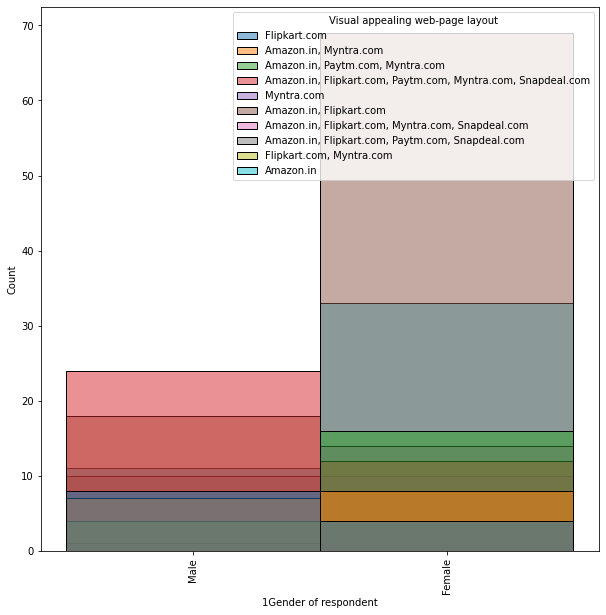

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

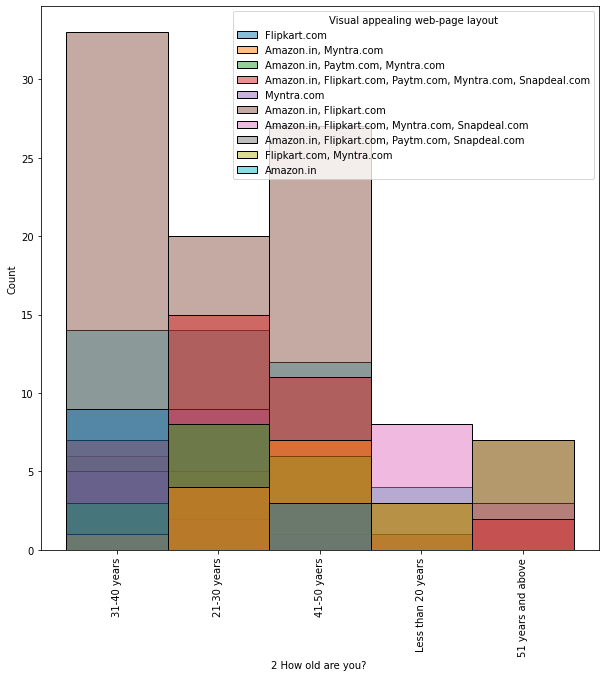

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

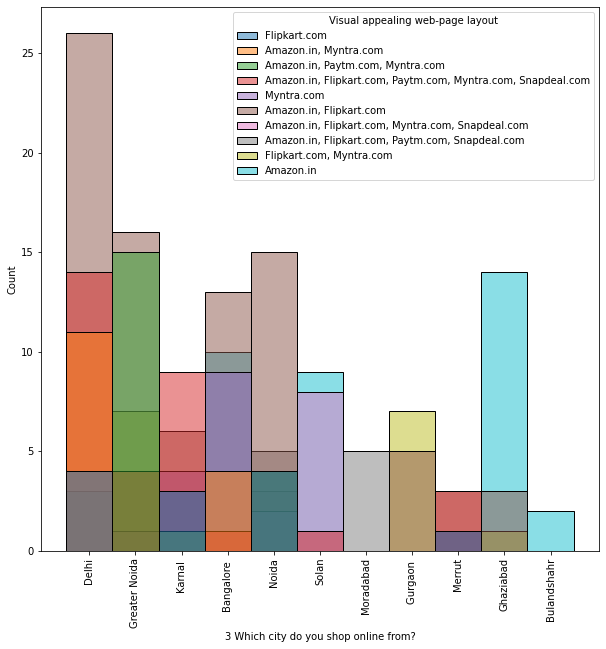

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

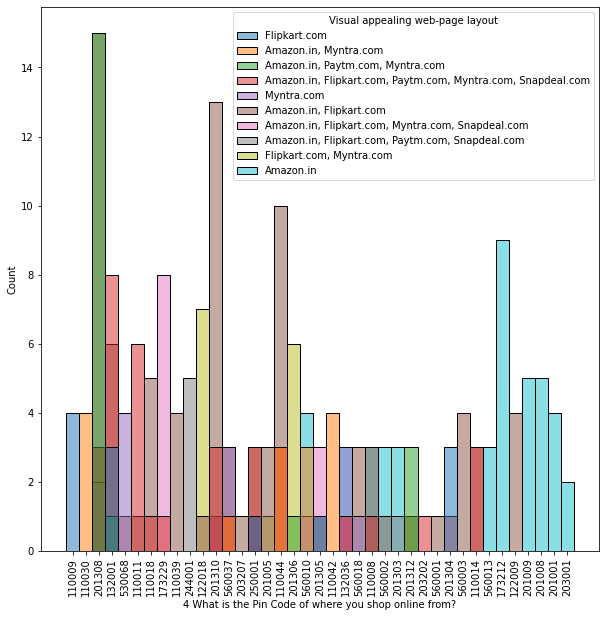

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

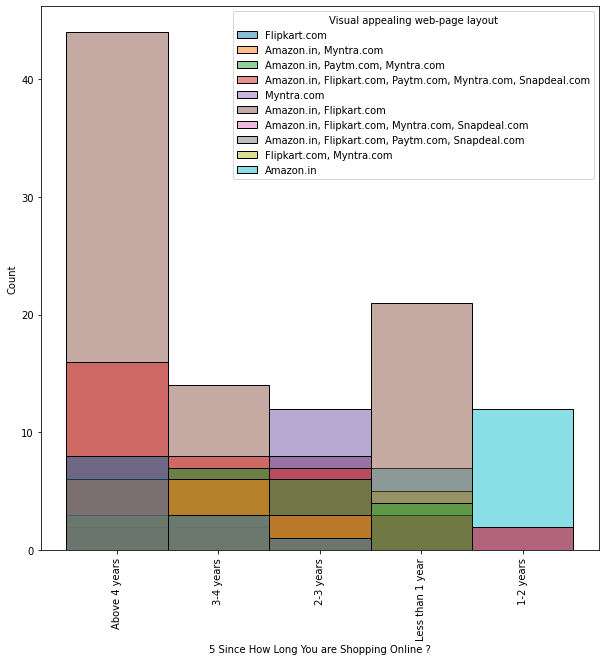

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

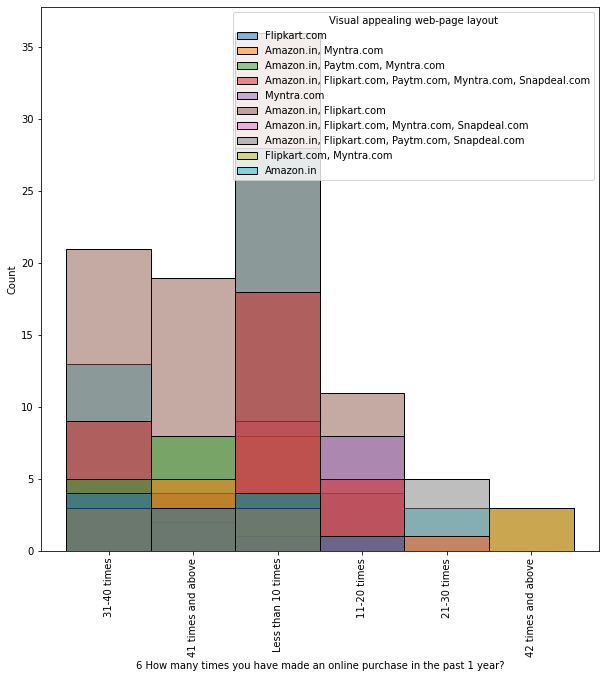

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

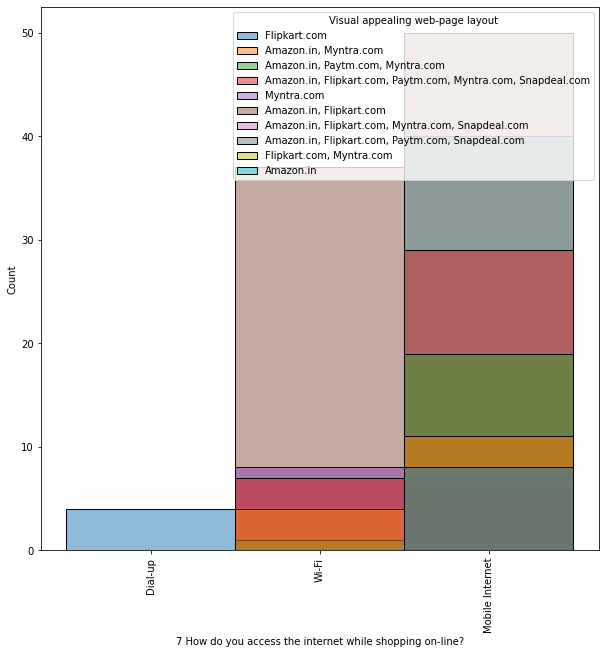

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

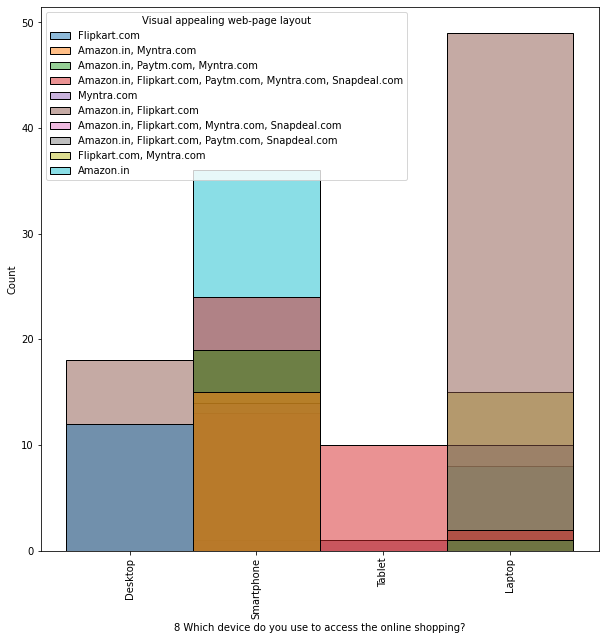

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

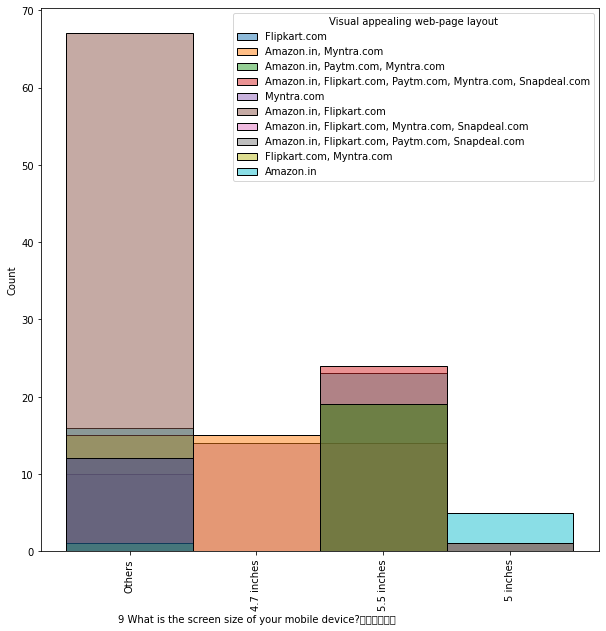

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

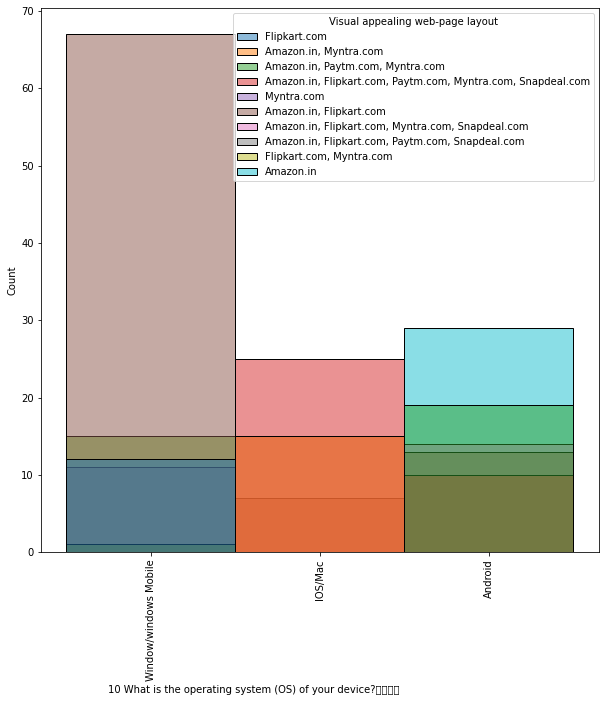

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

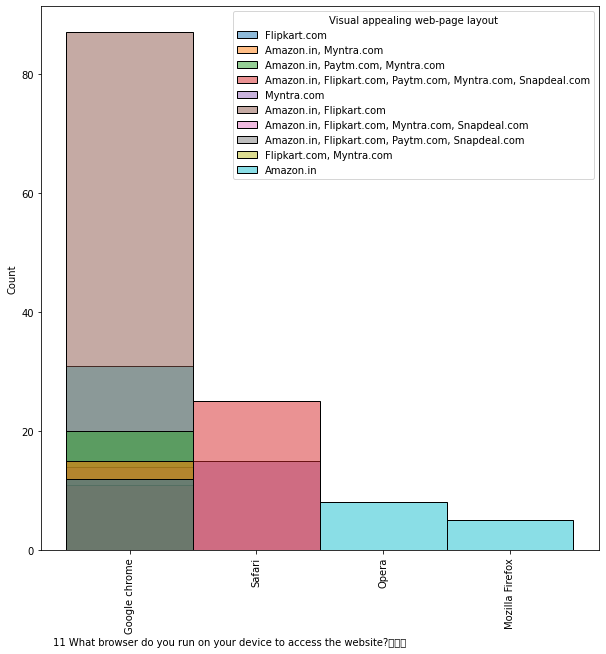

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

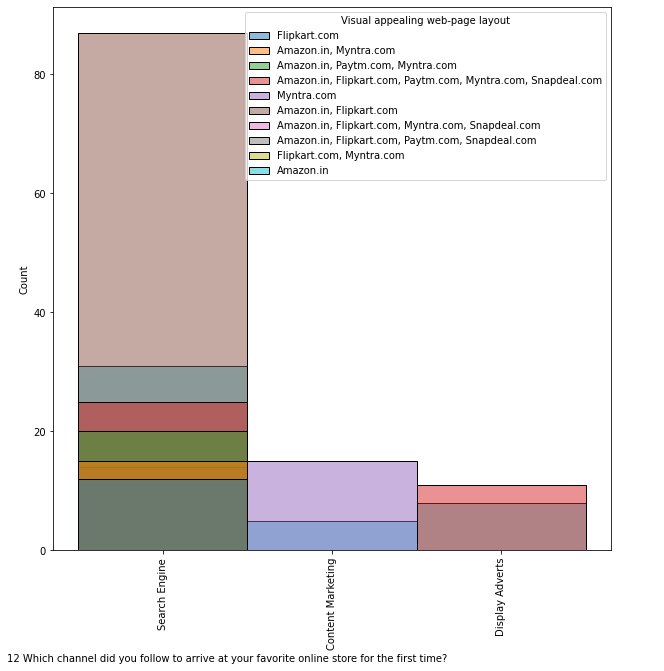

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

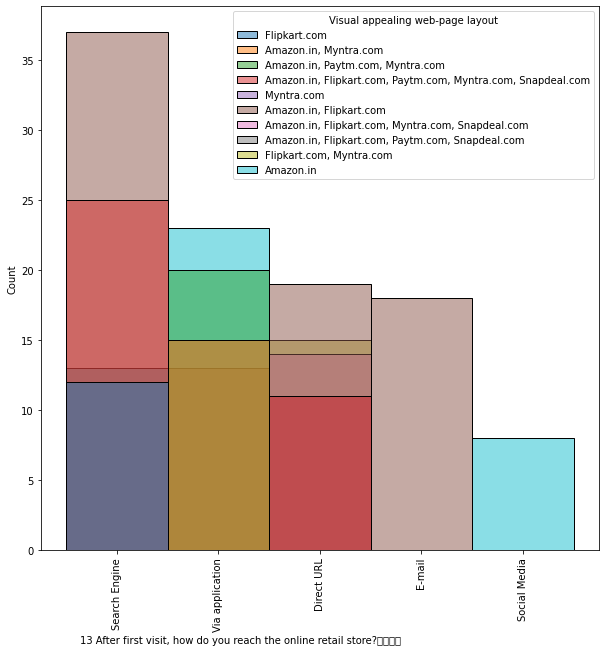

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

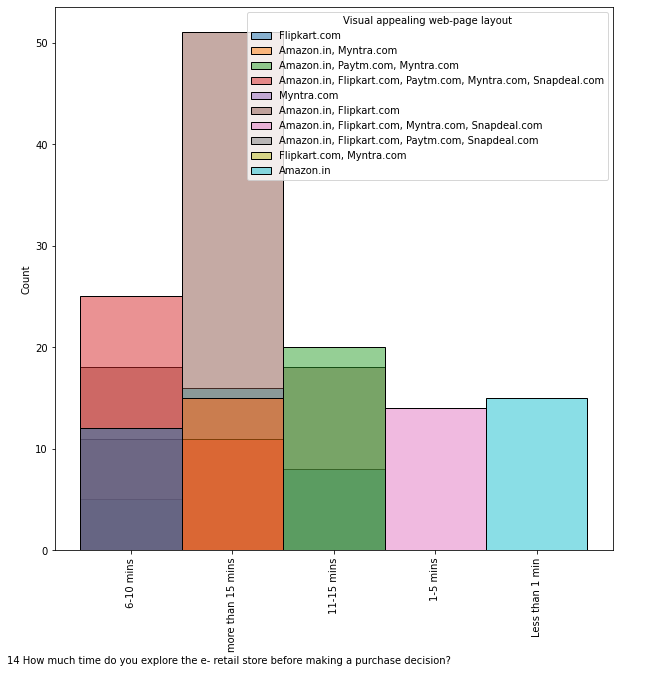

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

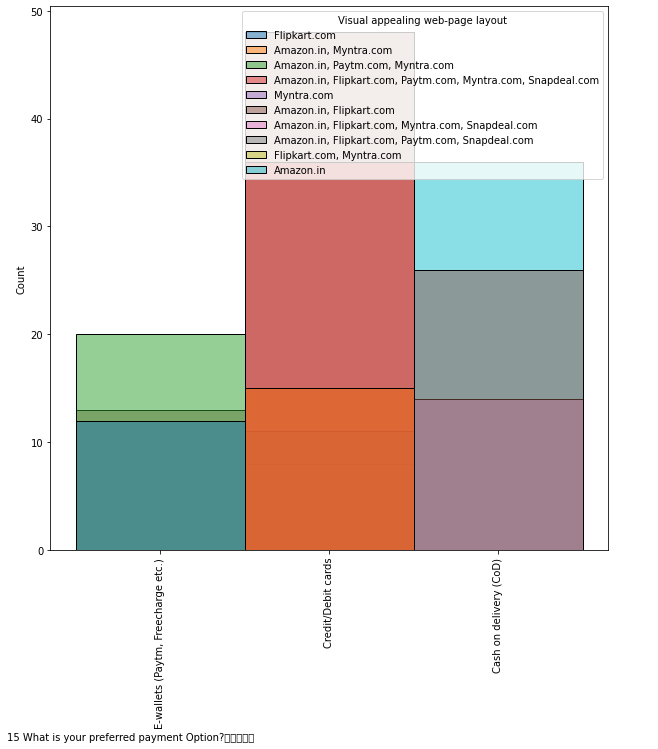

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

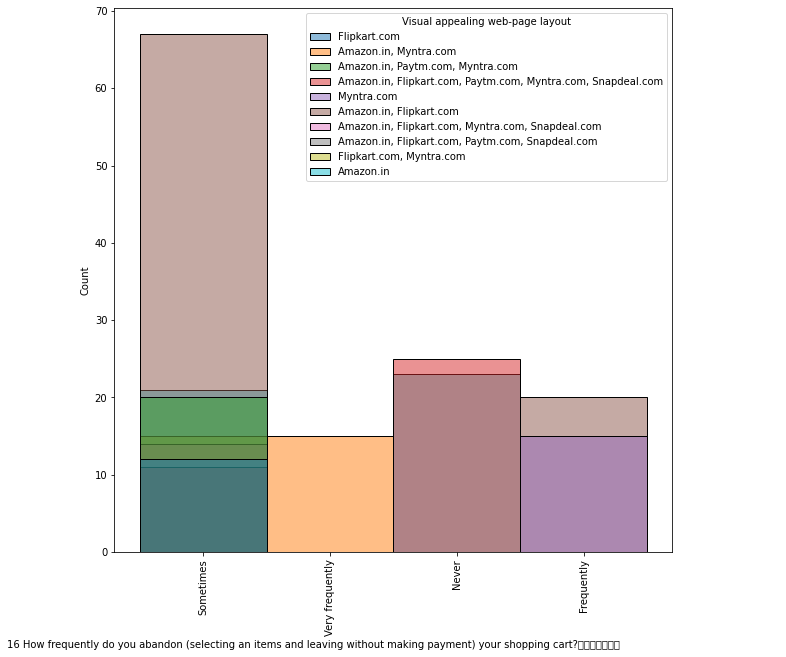

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

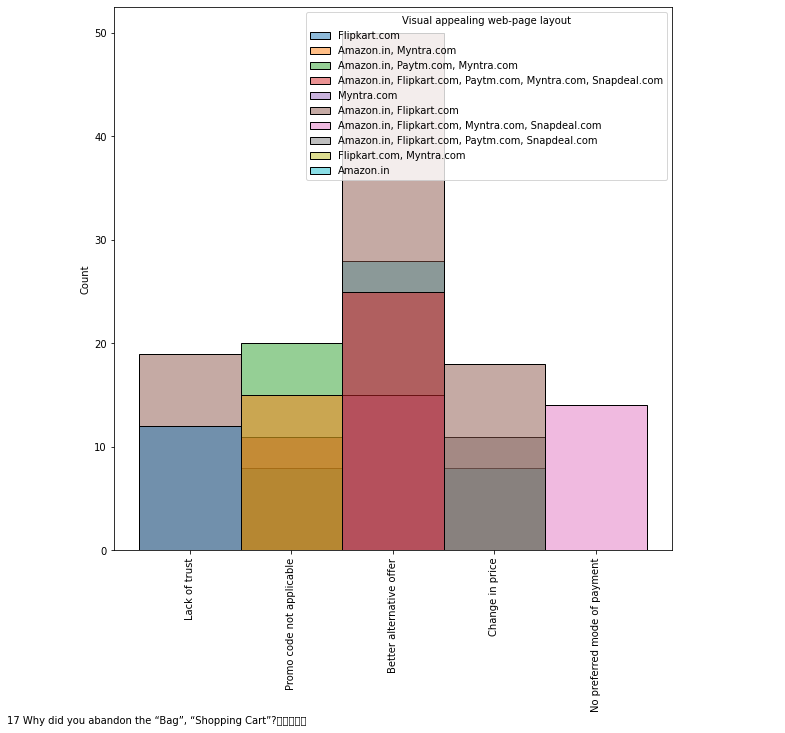

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

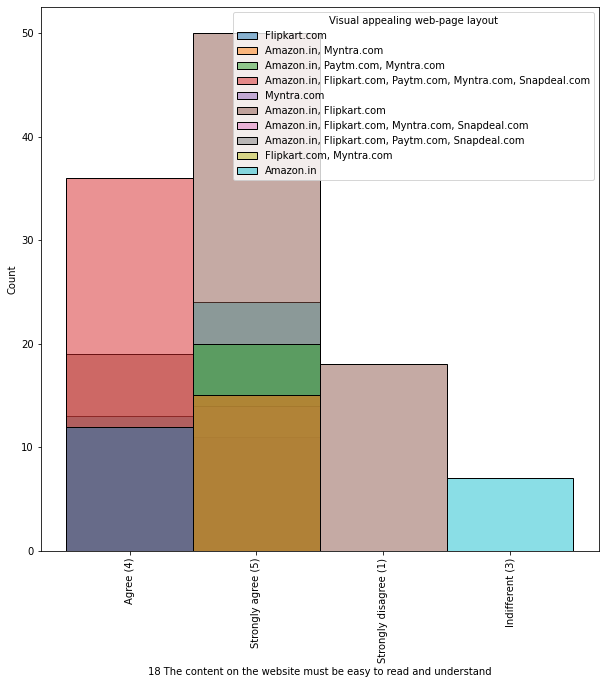

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

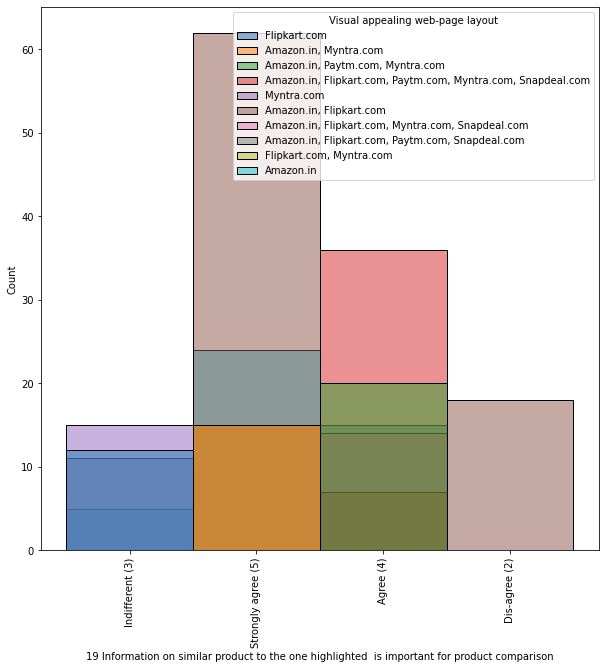

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

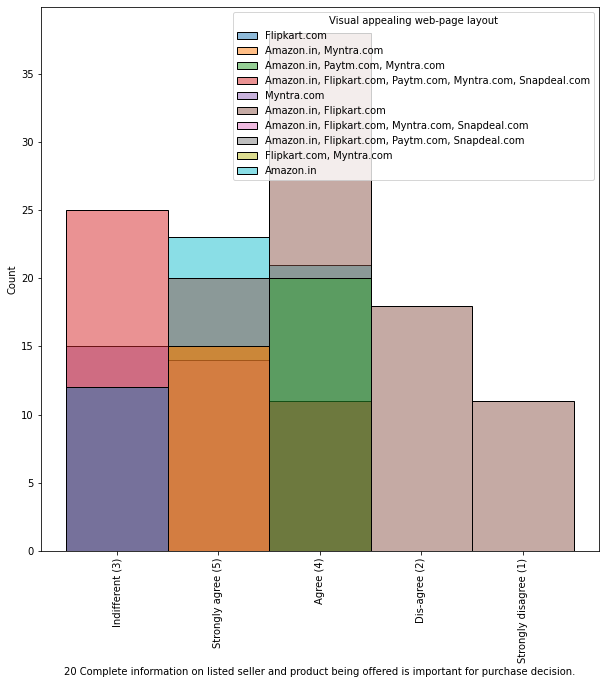

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

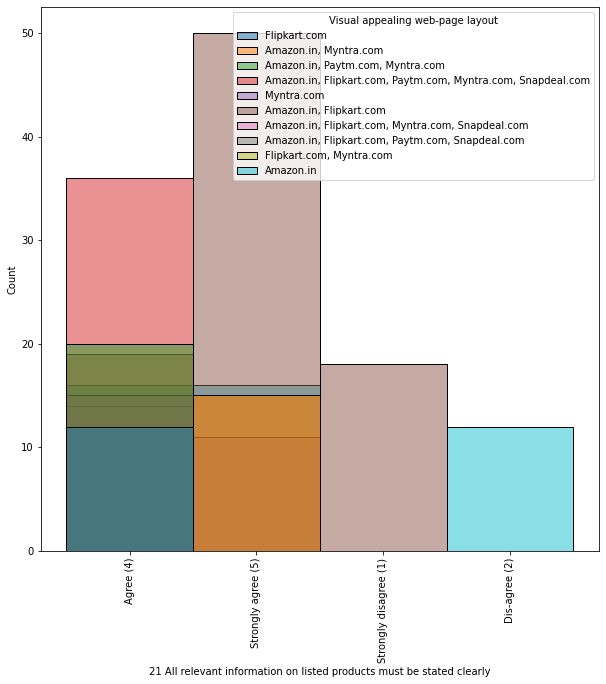

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

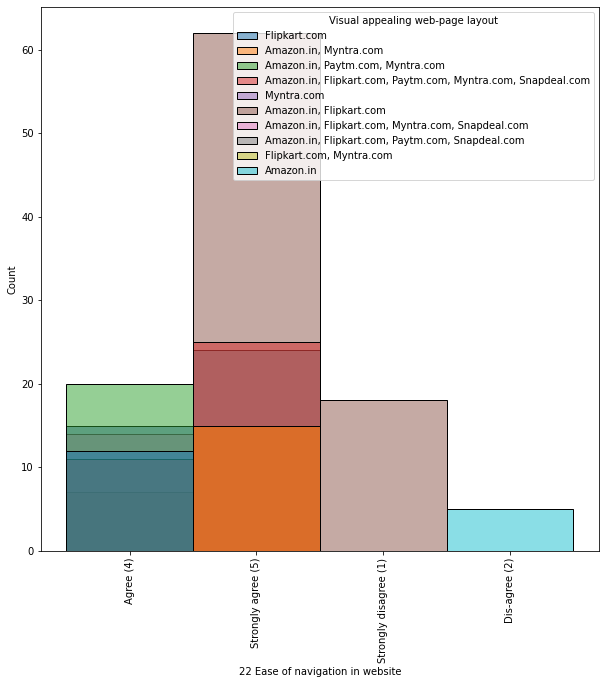

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

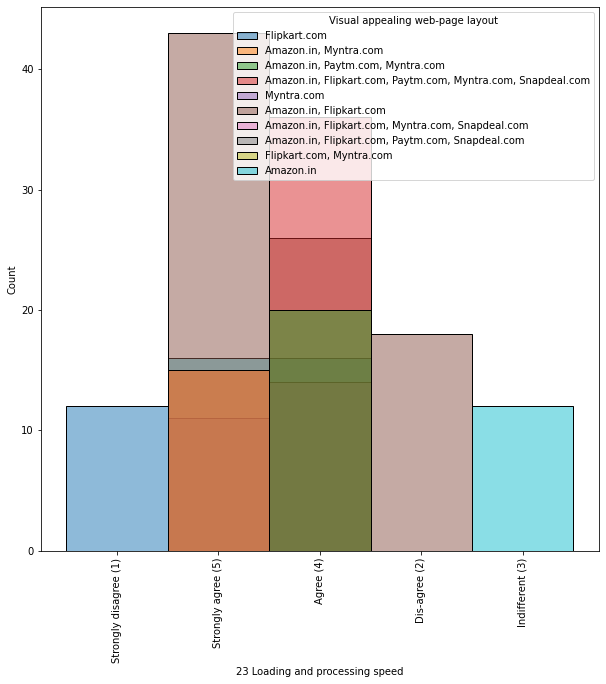

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

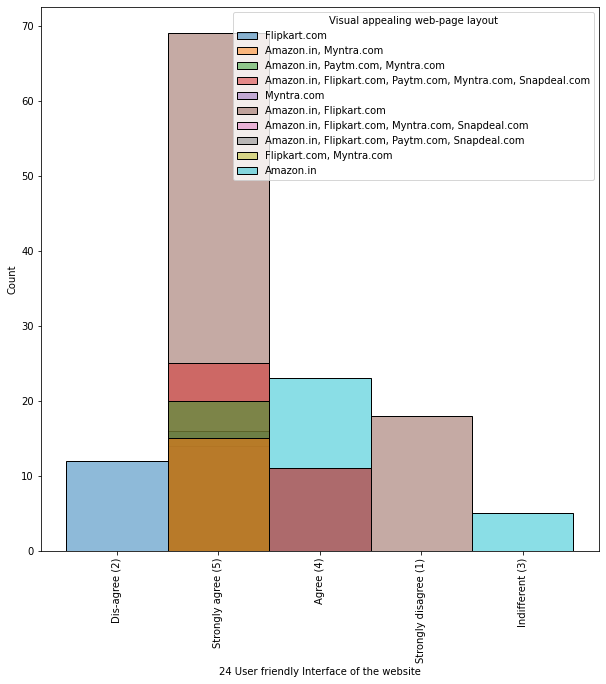

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

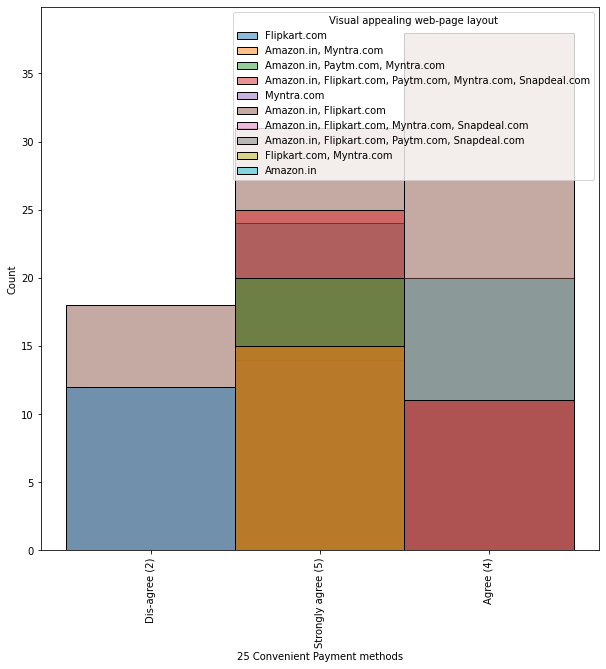

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

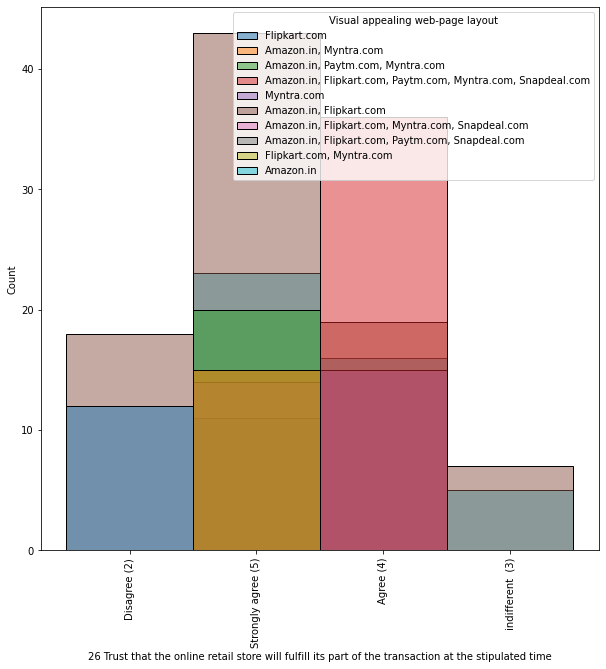

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

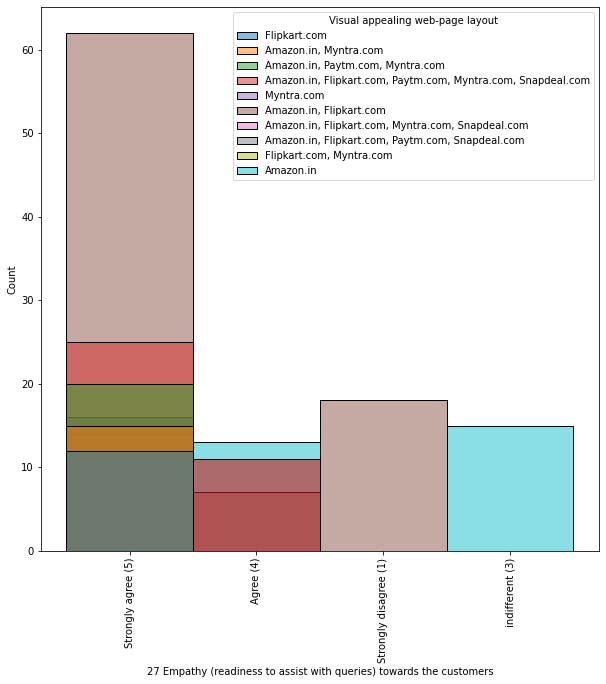

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

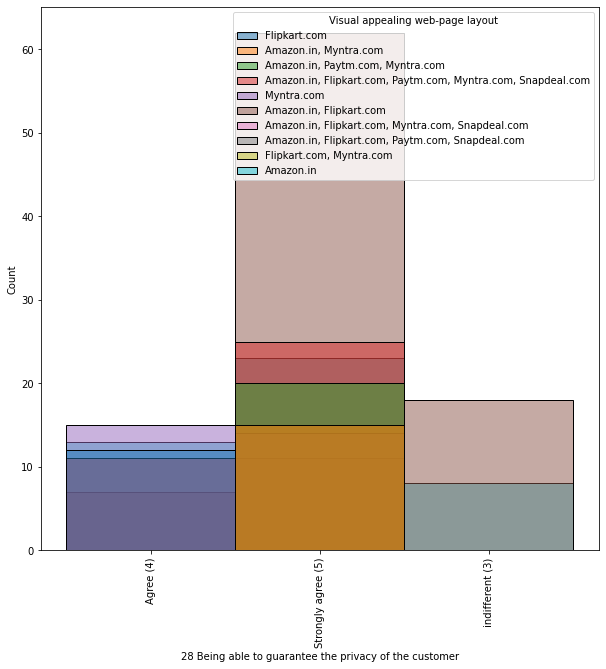

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

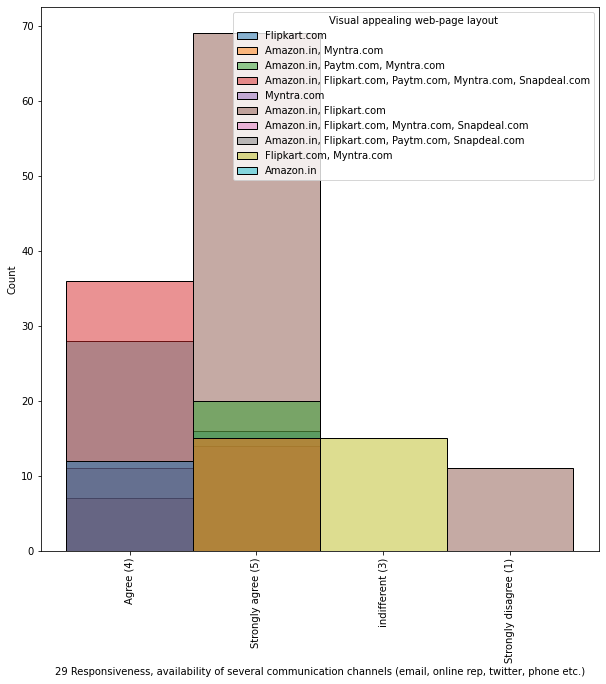

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

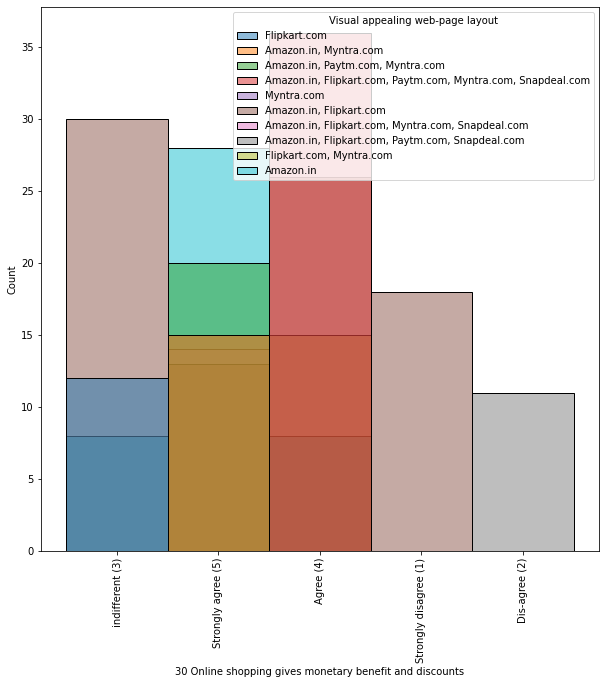

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

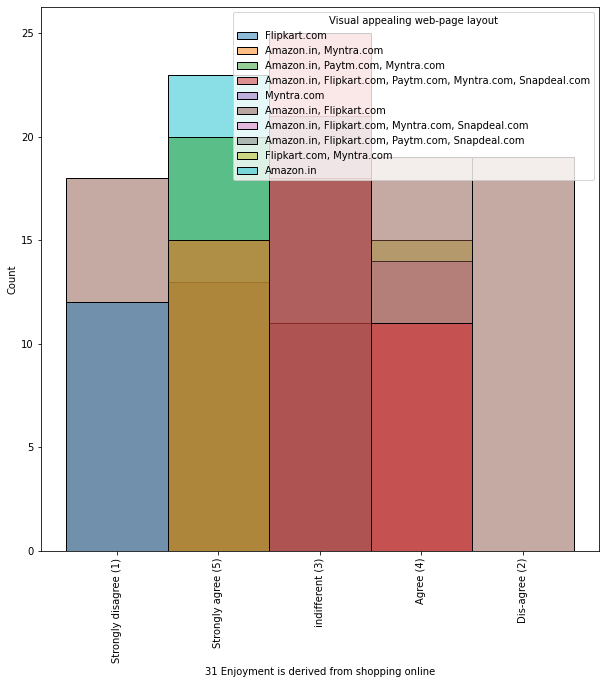

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

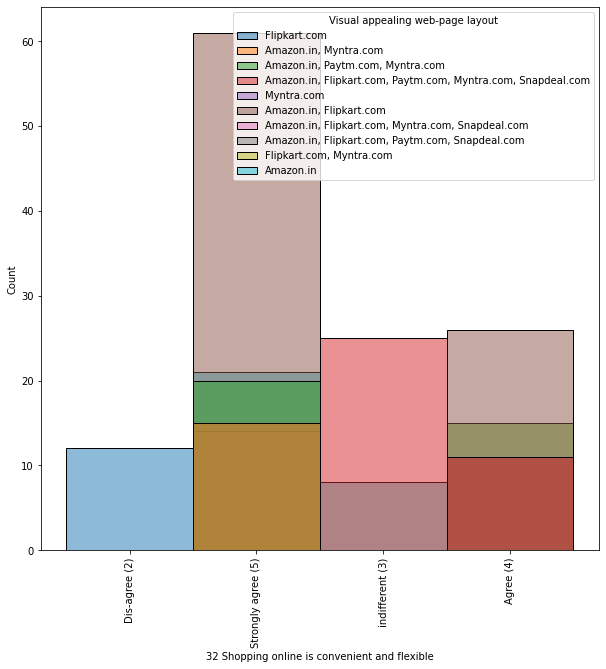

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

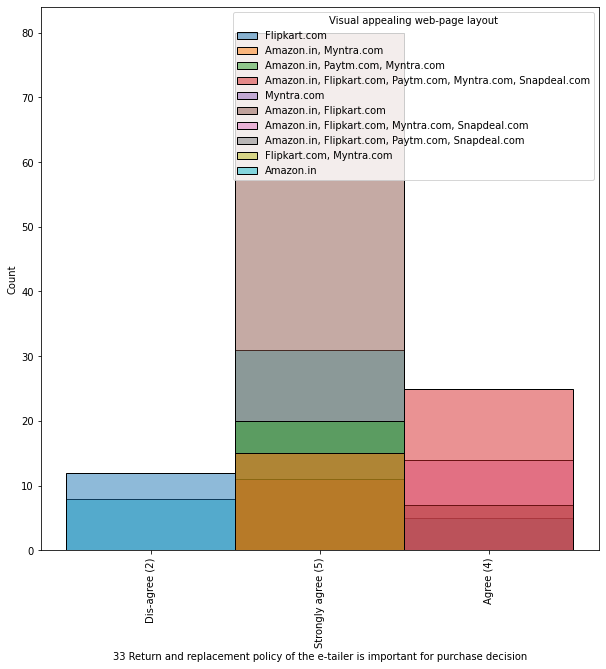

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

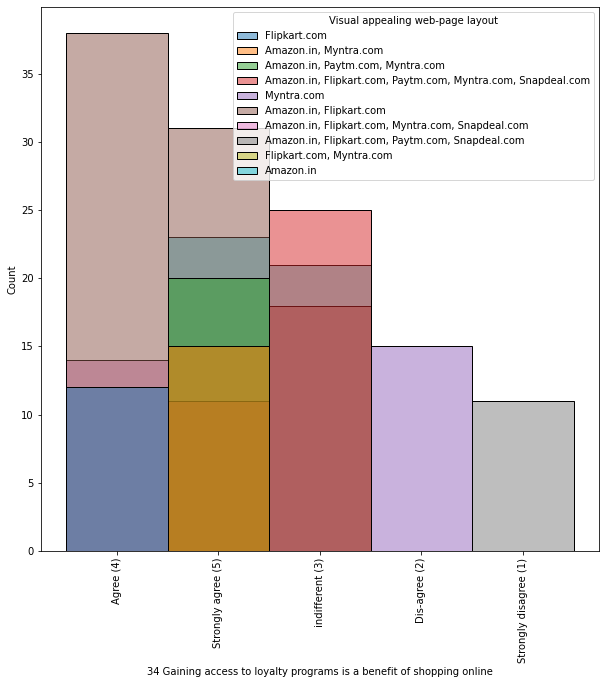

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

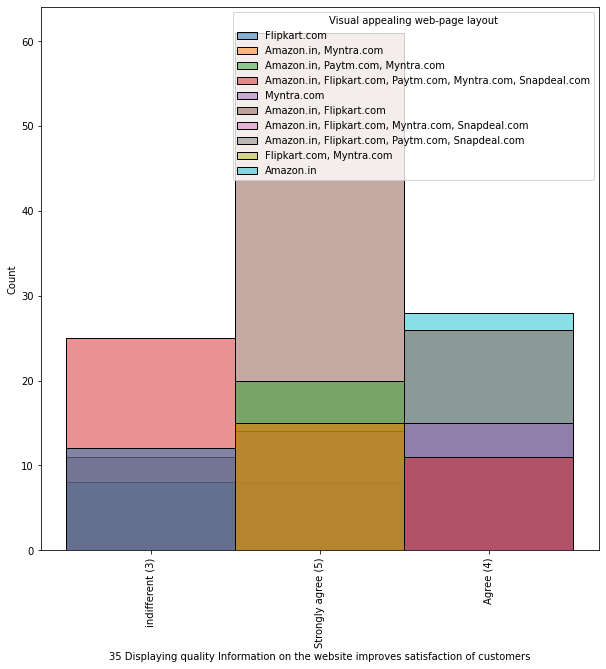

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

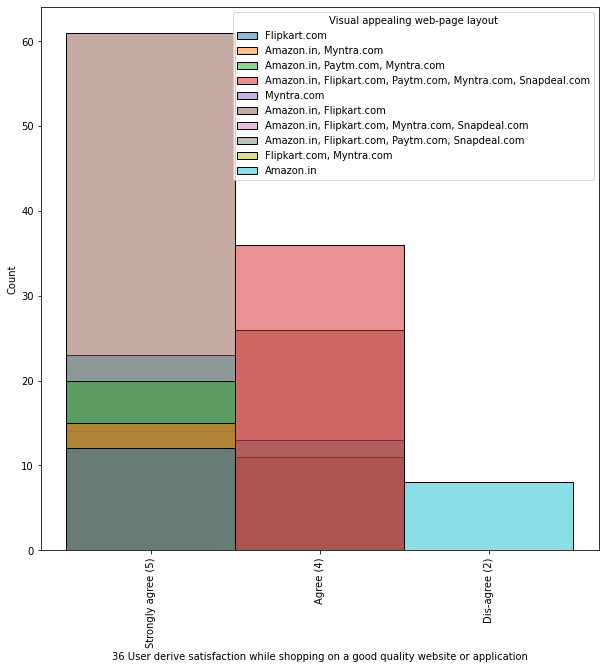

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

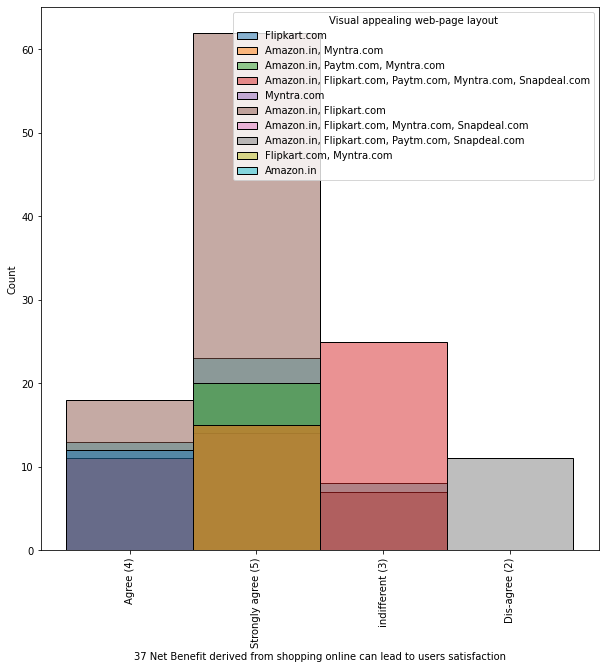

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

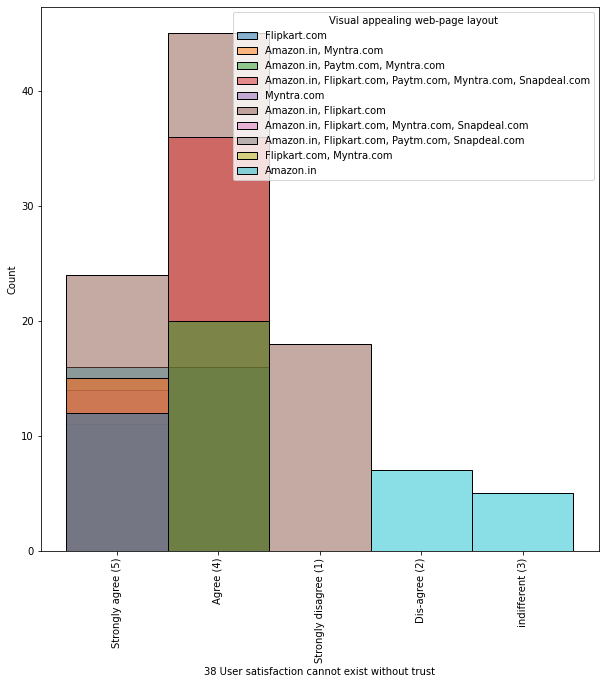

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

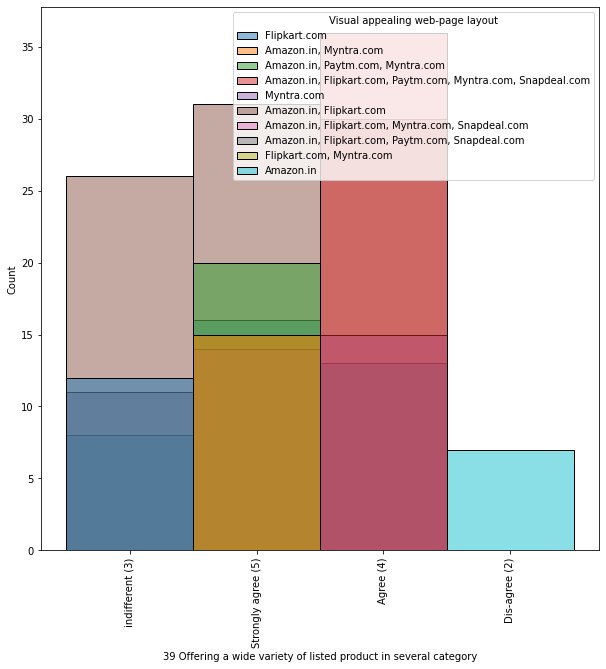

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

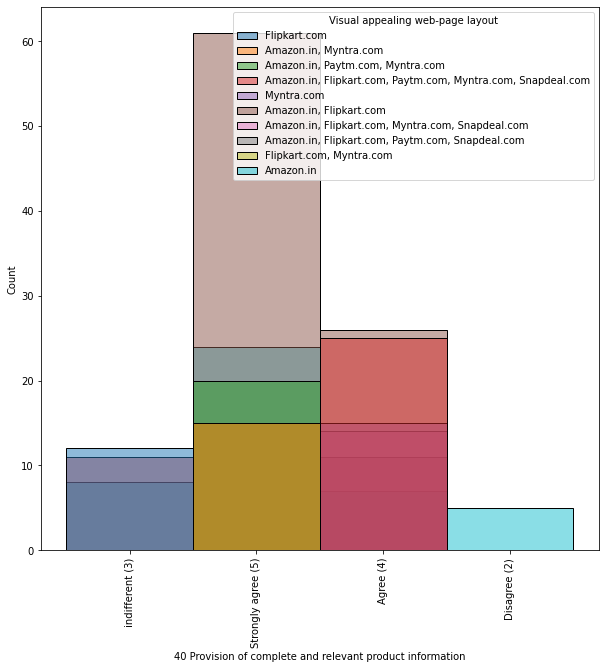

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

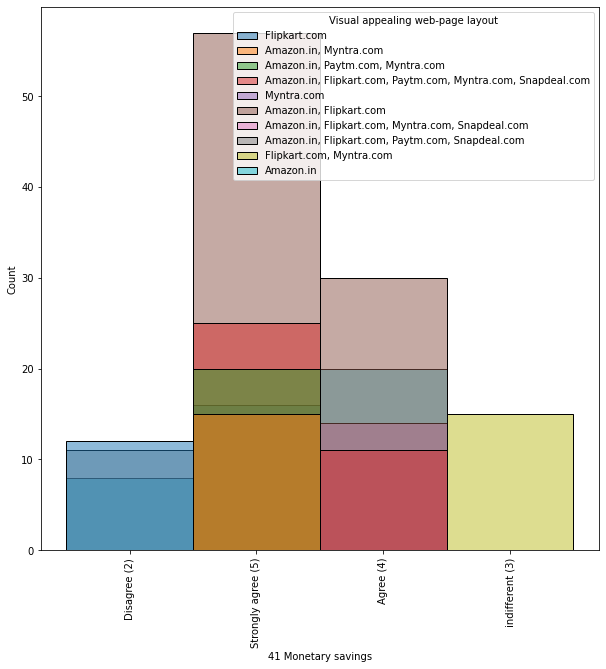

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

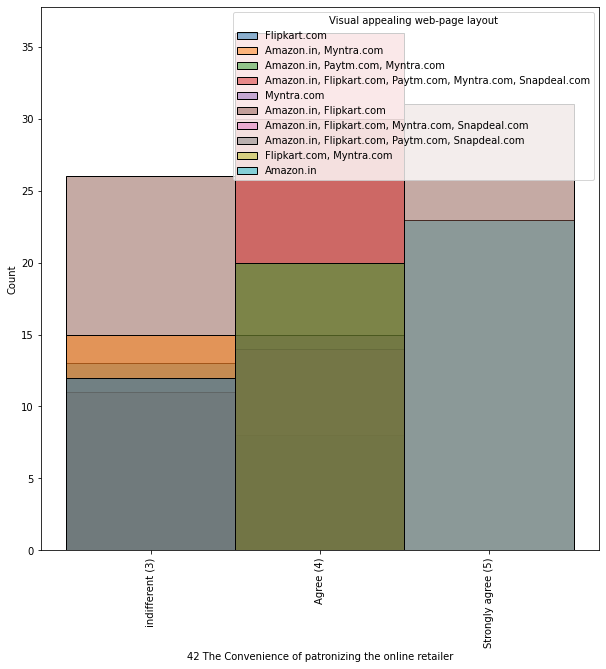

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

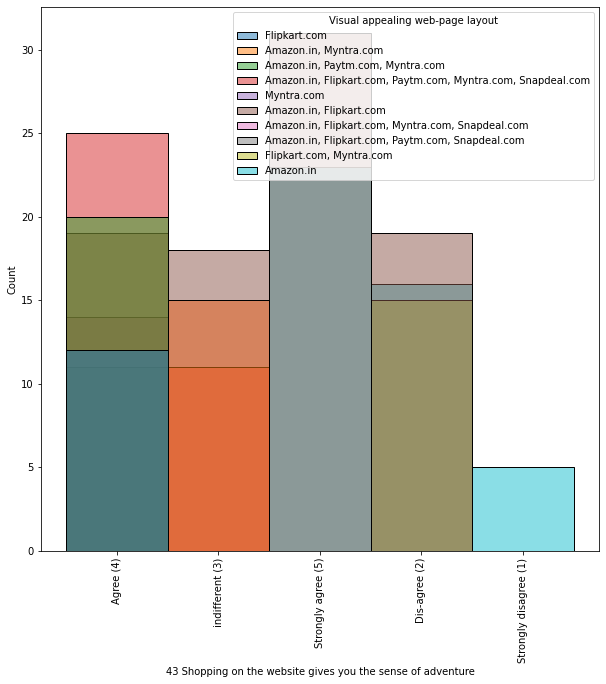

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

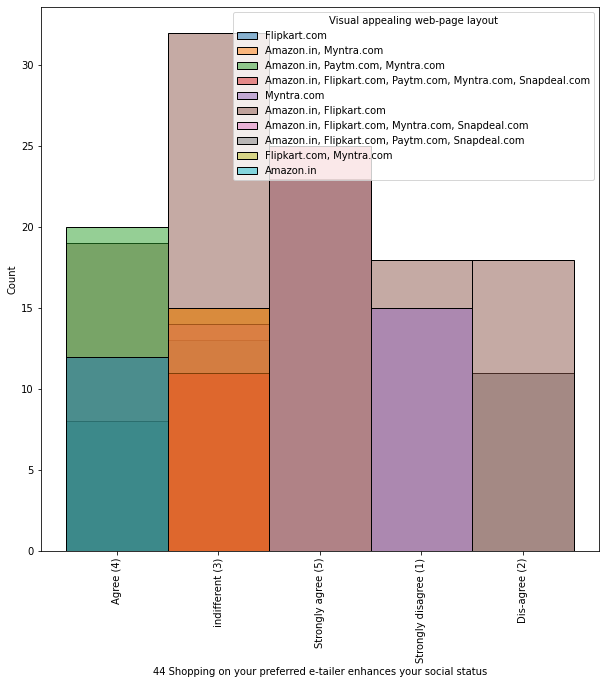

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

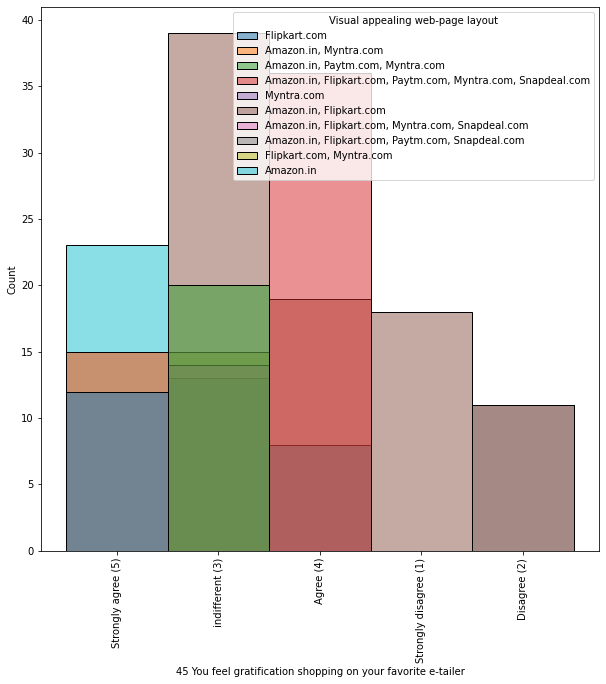

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

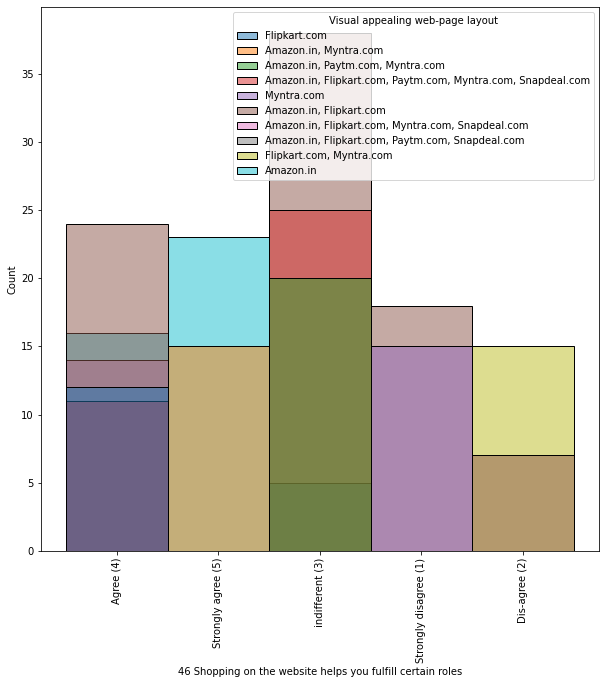

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

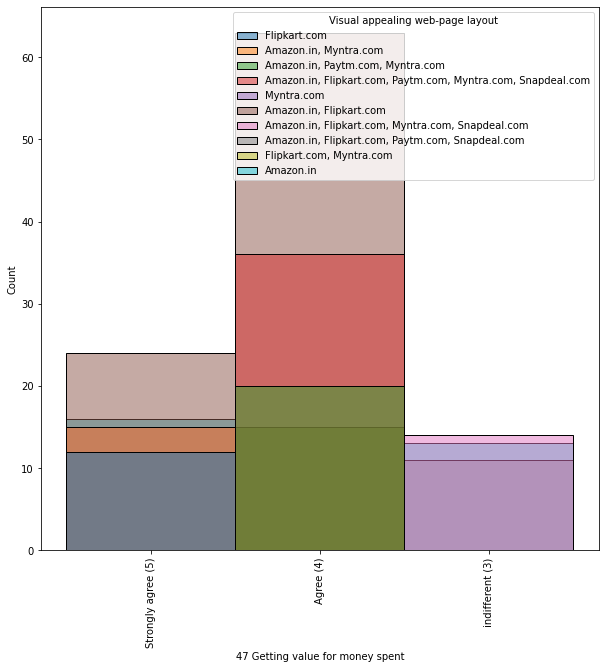

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

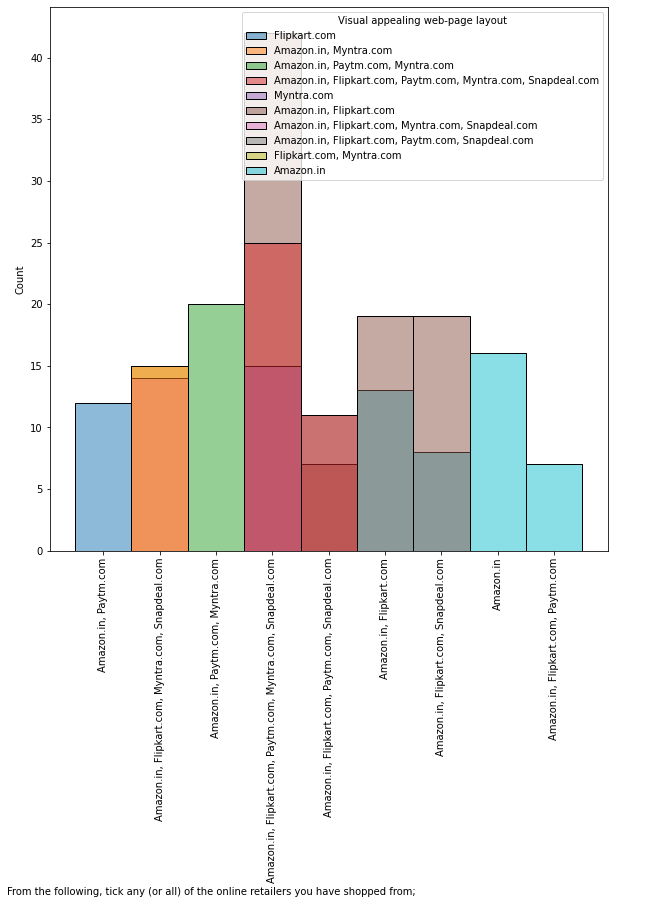

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

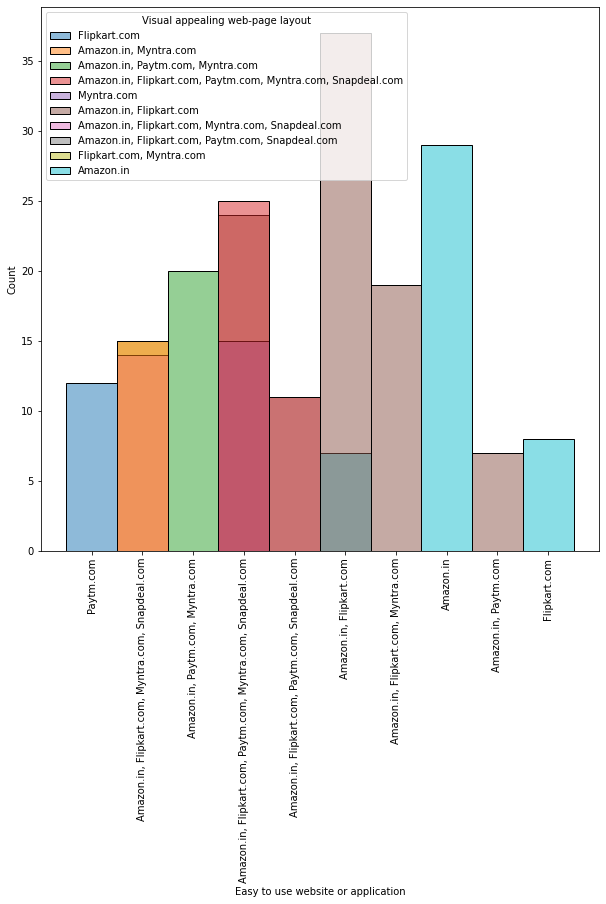

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

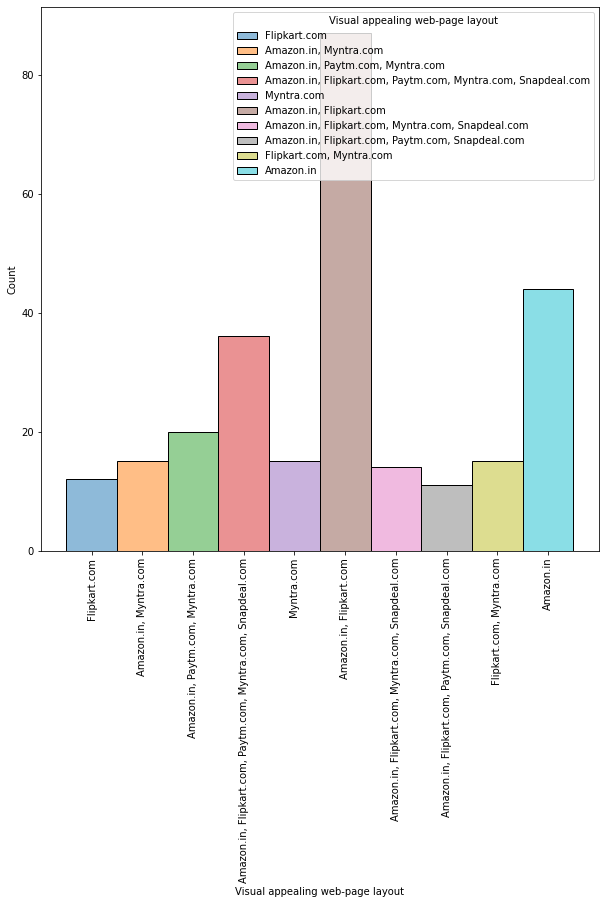

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

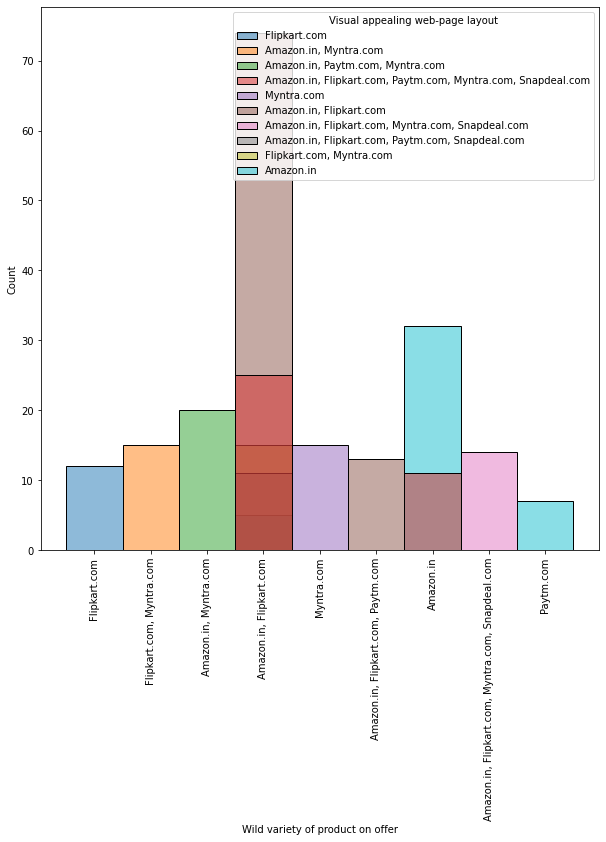

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

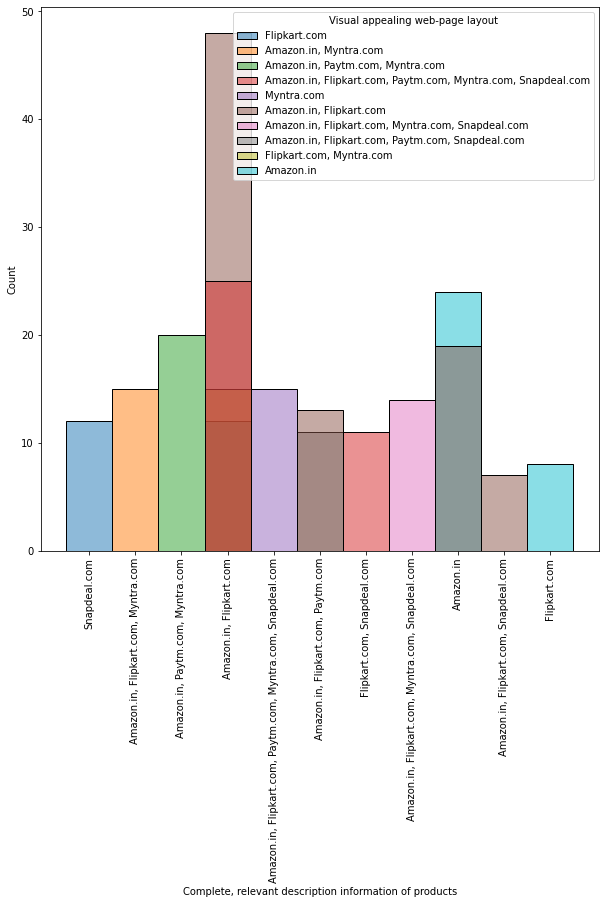

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

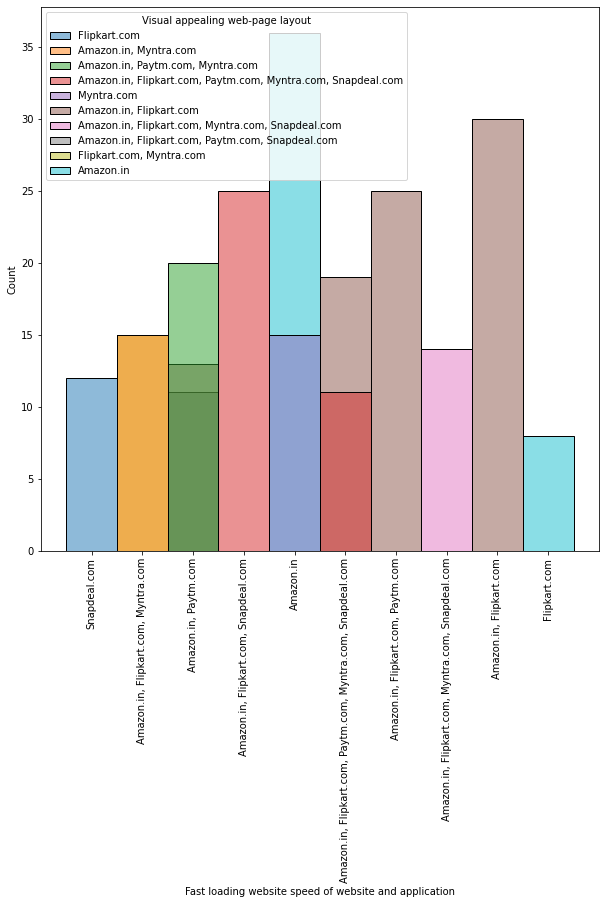

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

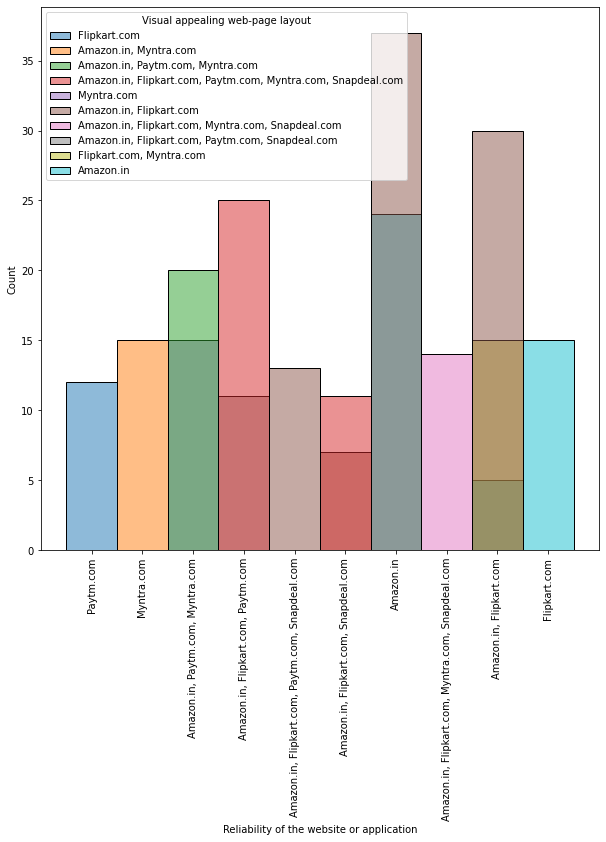

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

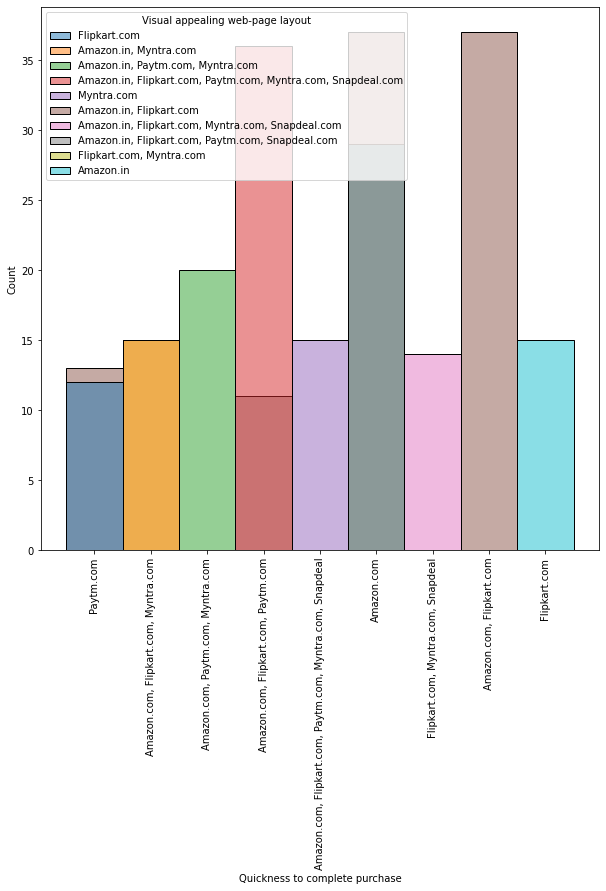

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

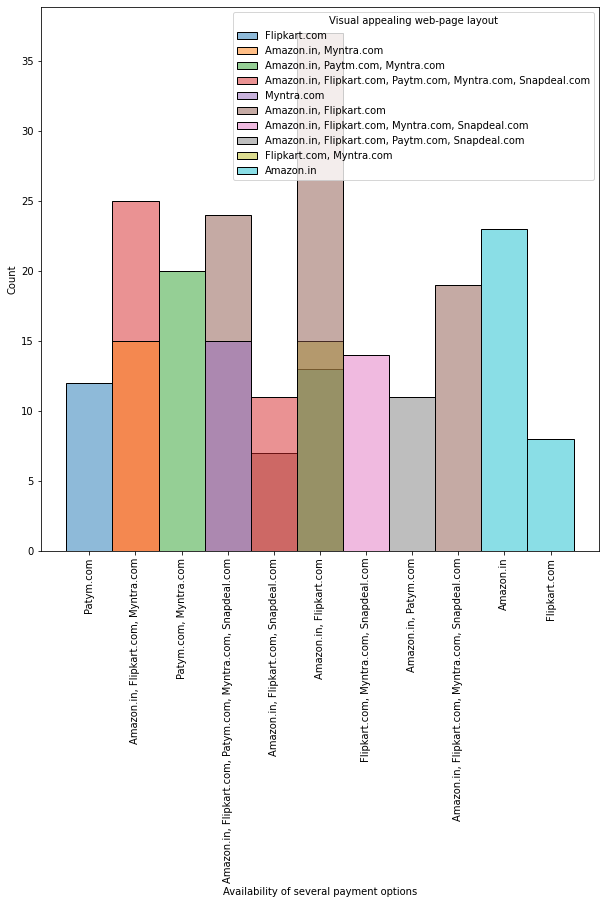

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

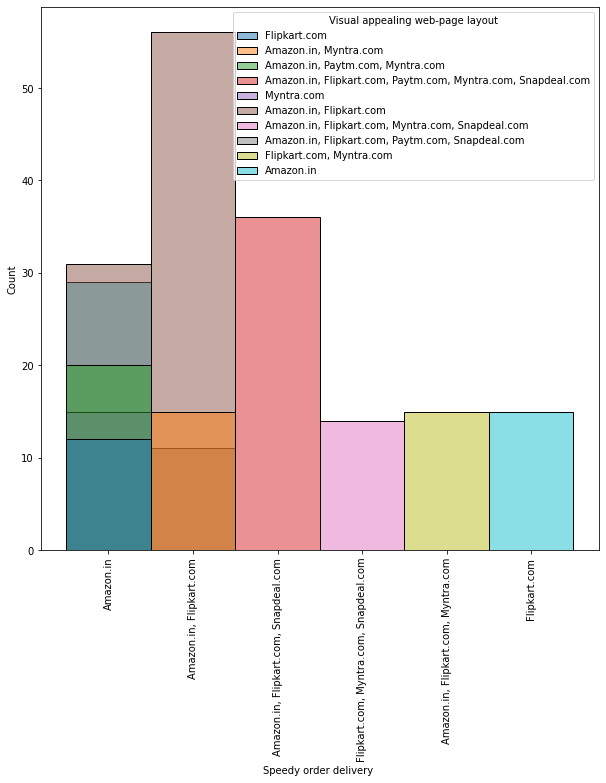

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

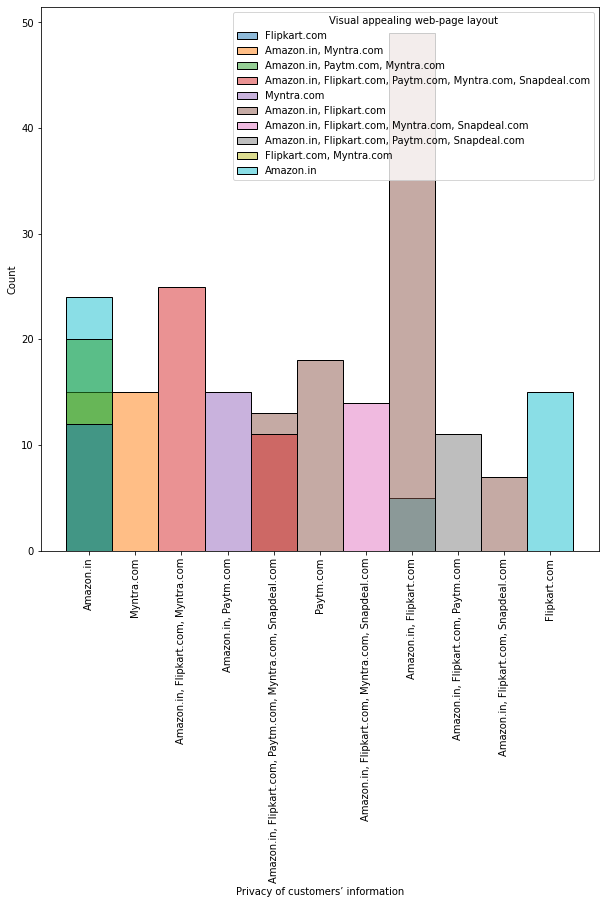

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

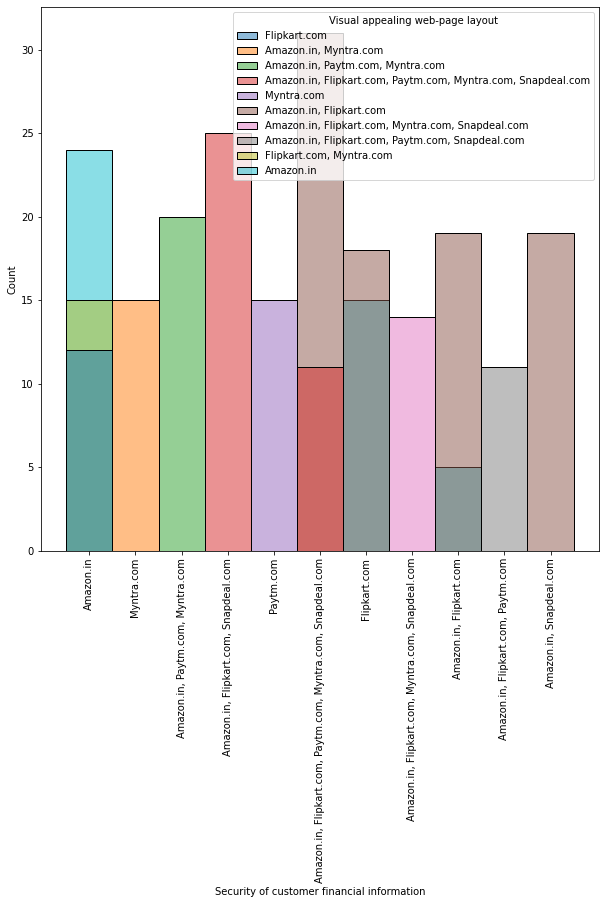

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

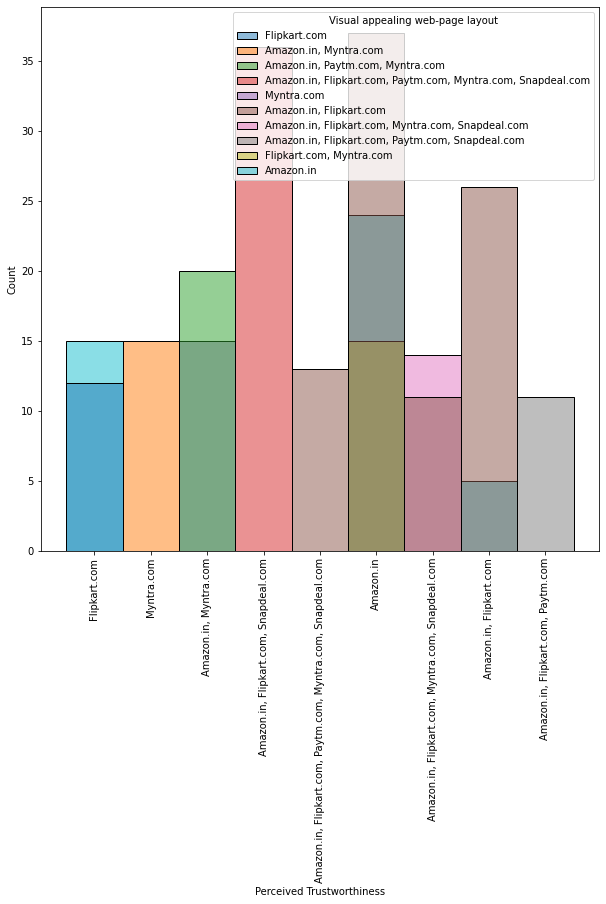

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

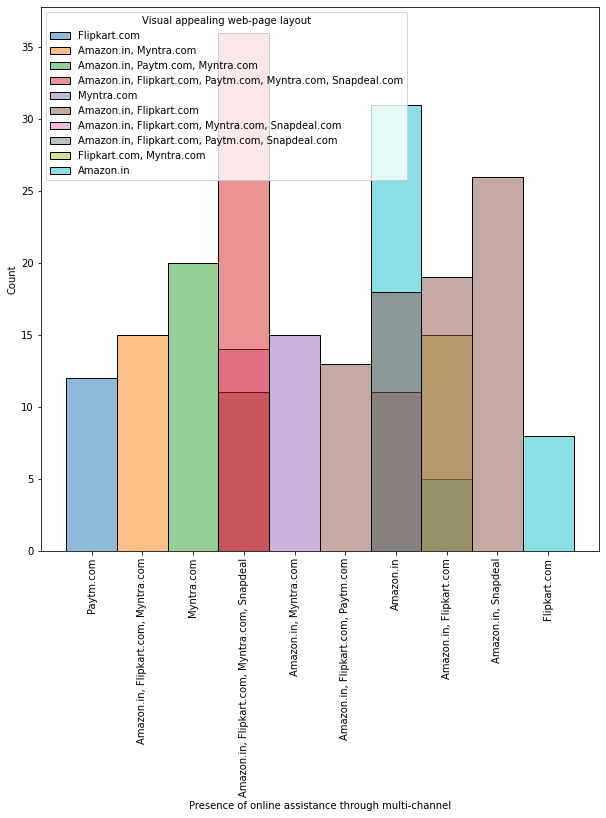

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

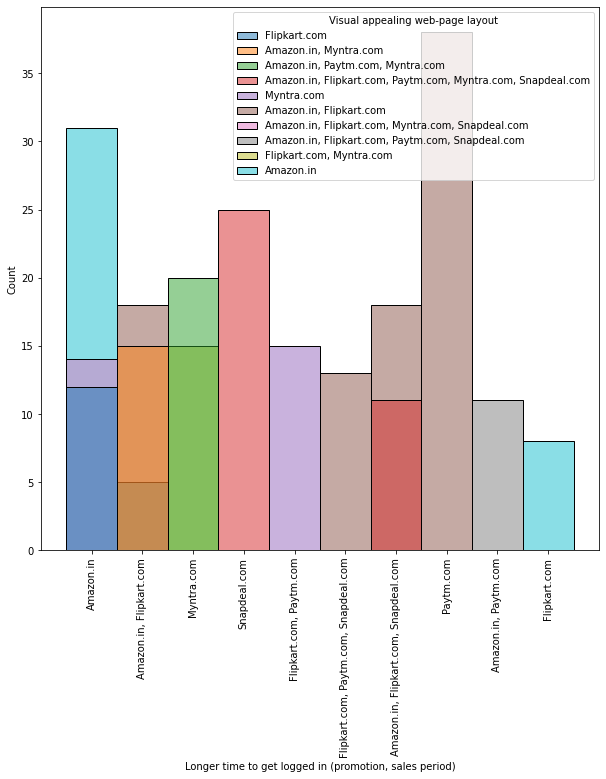

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

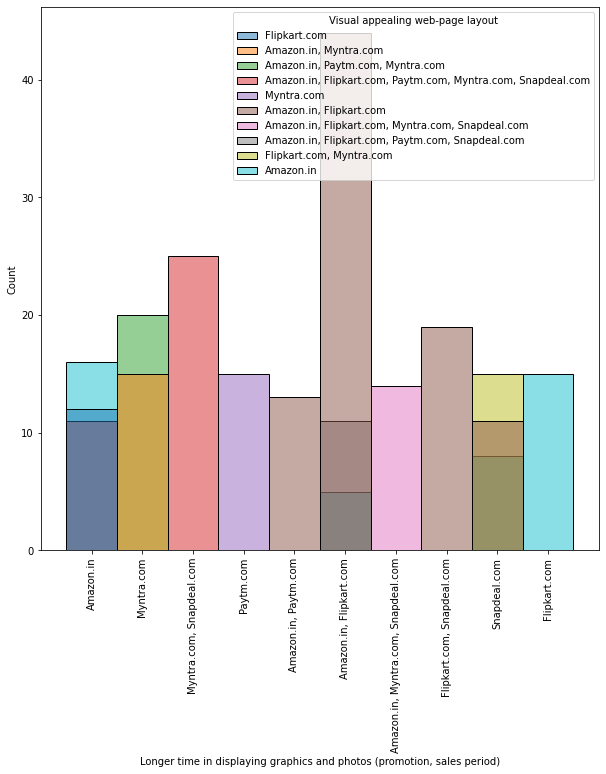

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

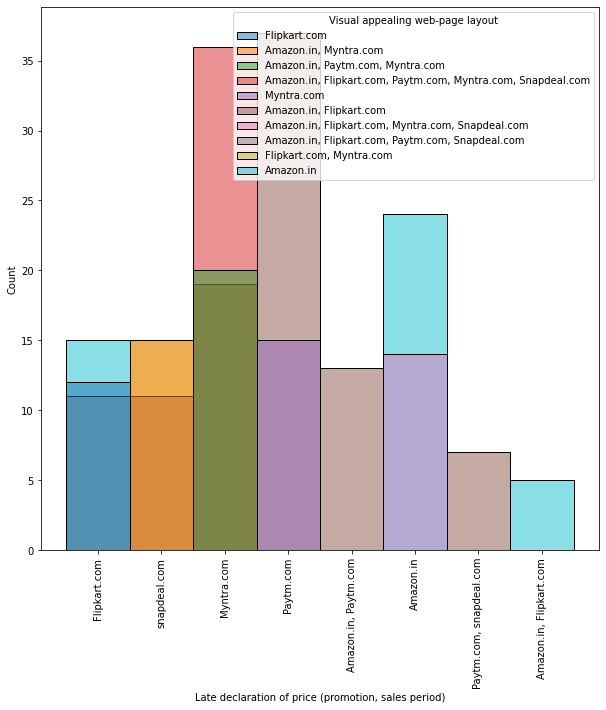

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

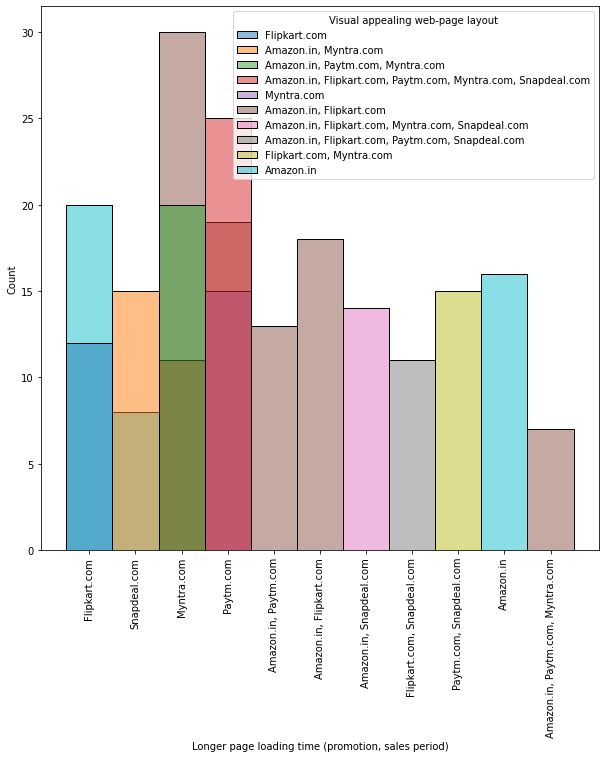

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

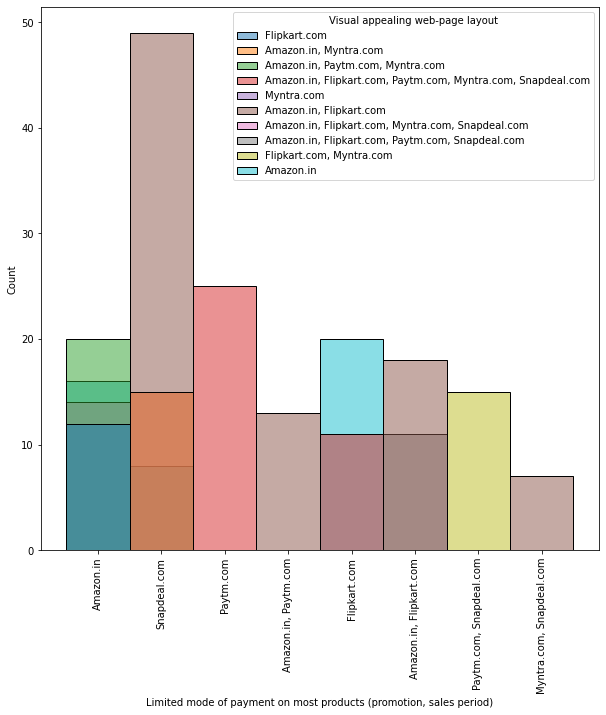

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

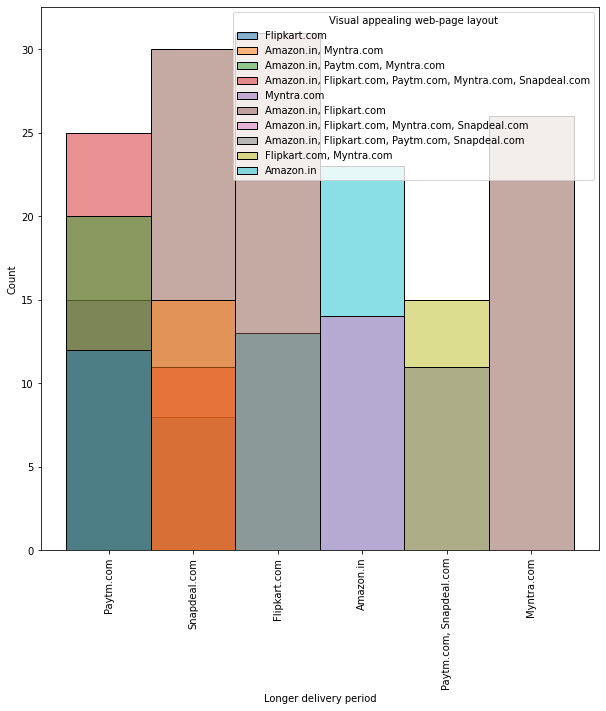

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

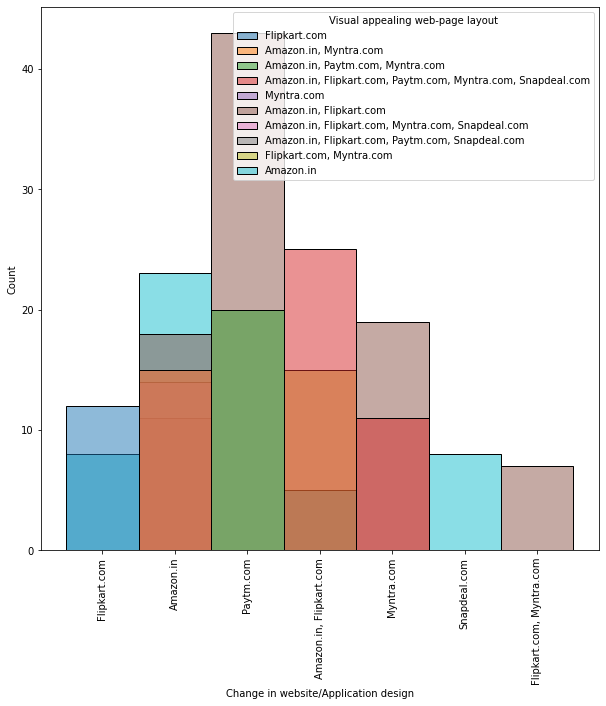

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

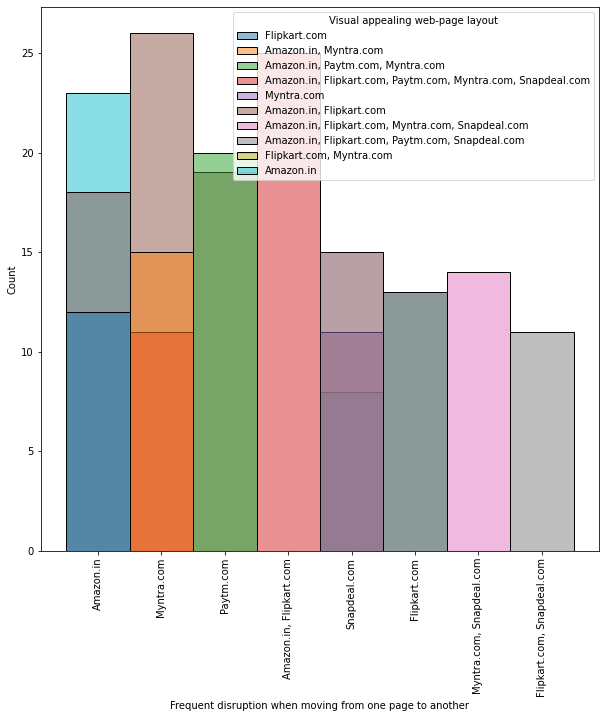

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

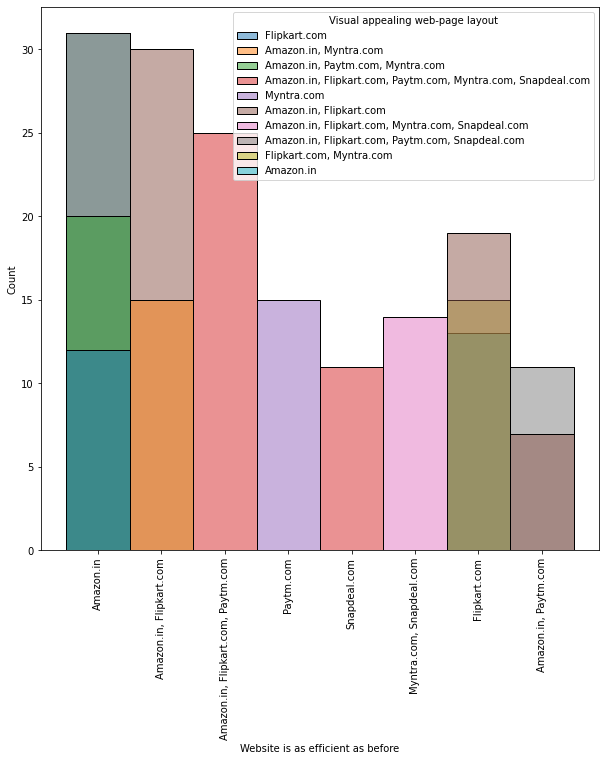

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

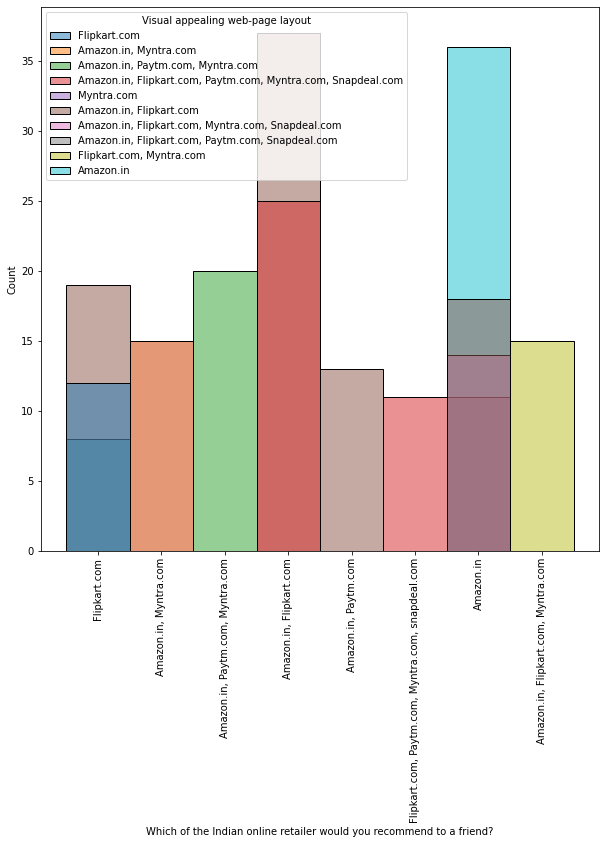

In [88]:
# Histogram with respect to 'Visual appealing web-page layout'
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['Visual appealing web-page layout'])
    plt.xticks(rotation ='90')
    plt.show()

It is seen from above graphs that Amazon, Flipkart, Myntra, and snapdeal has most visually appealing web-pages 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

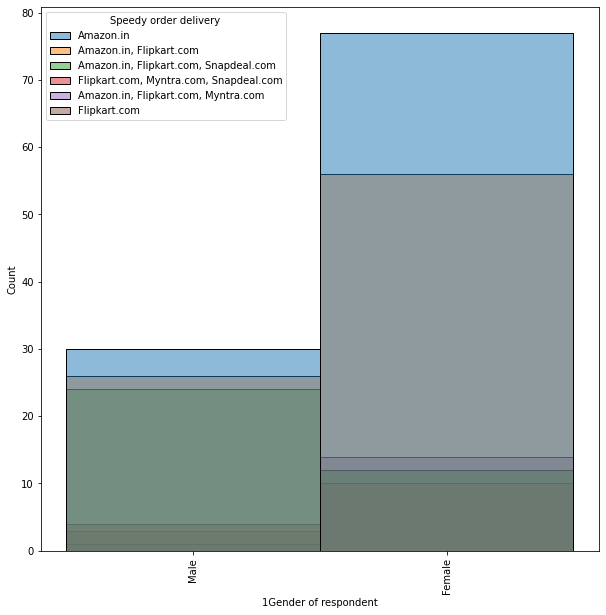

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

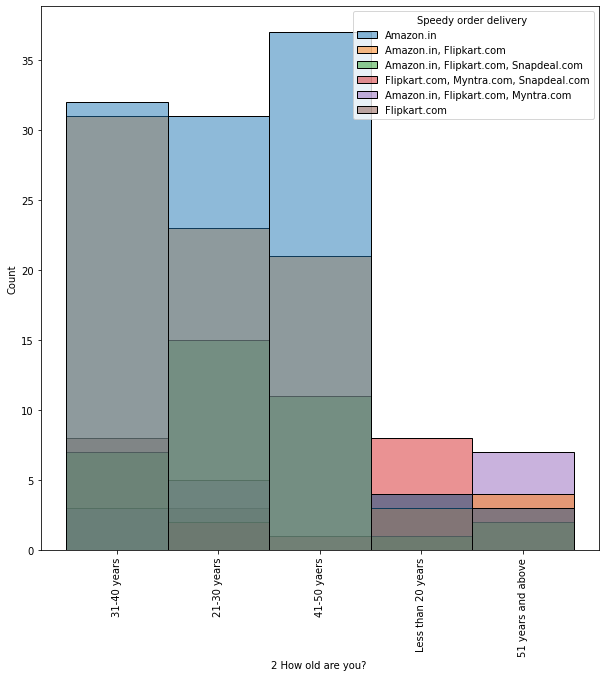

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

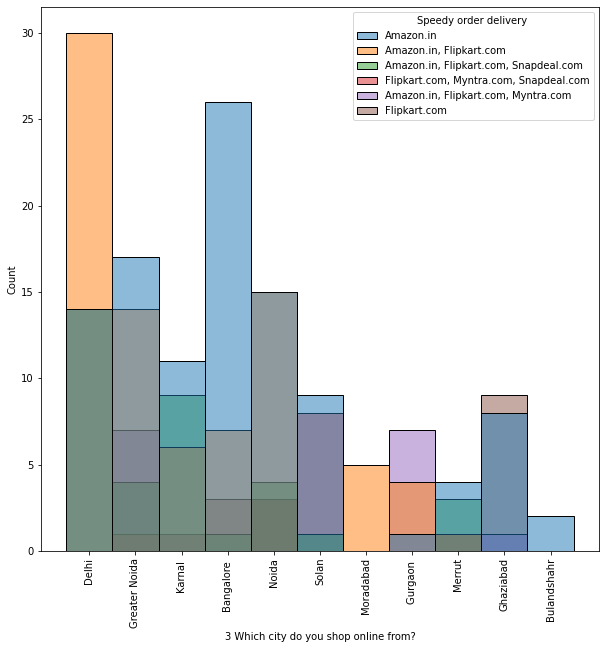

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

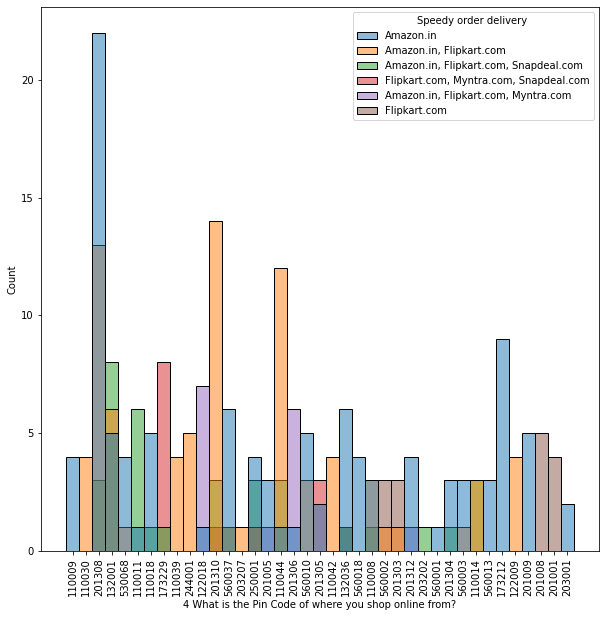

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

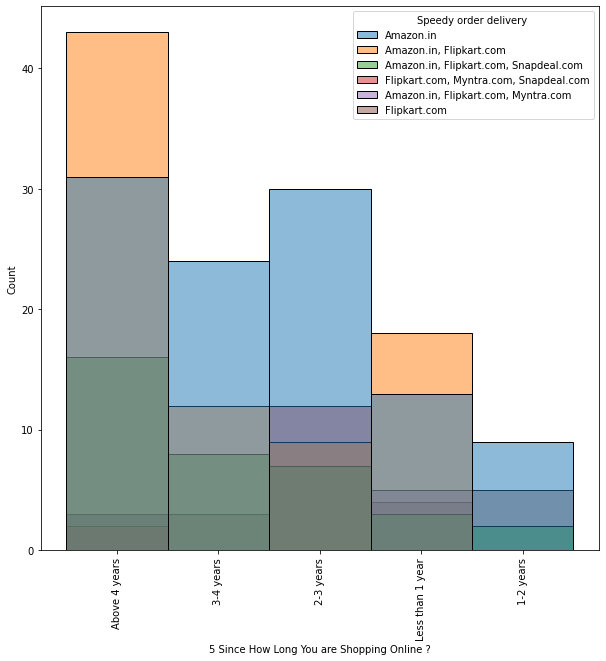

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

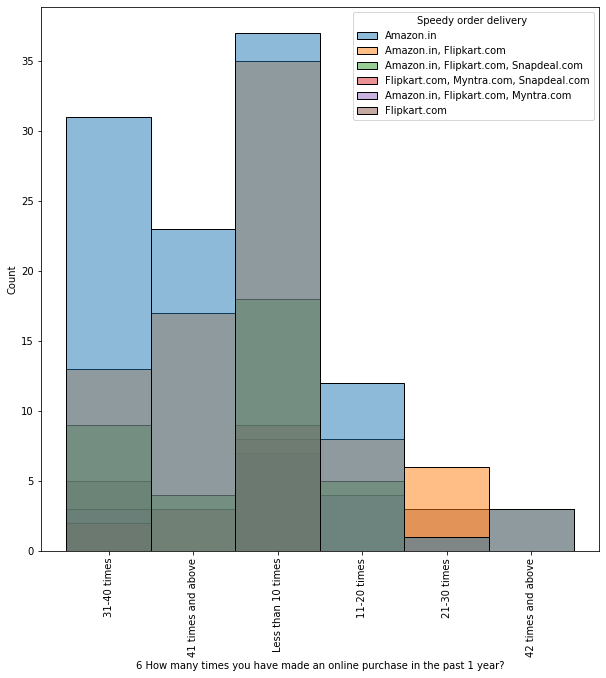

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

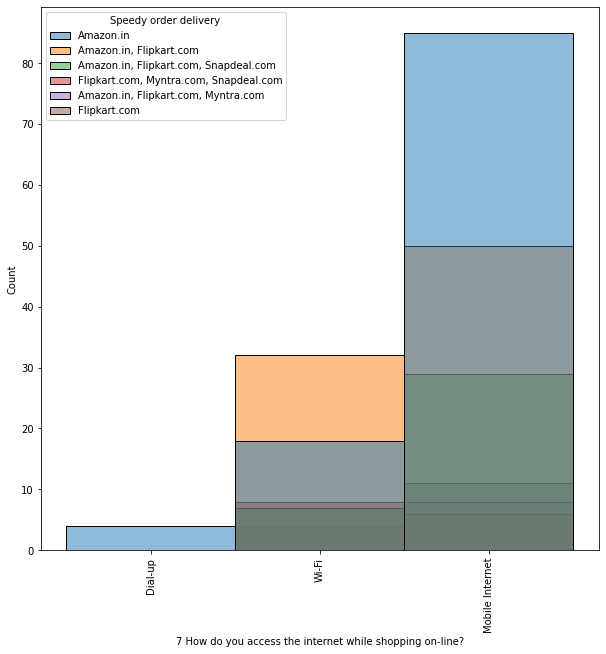

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

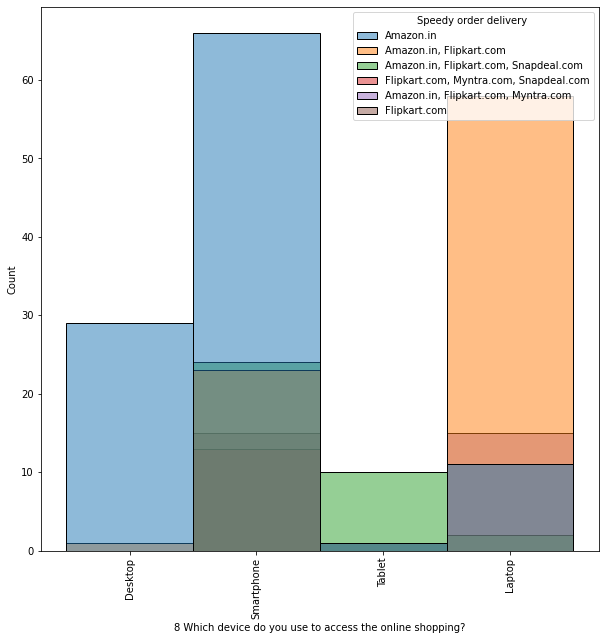

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

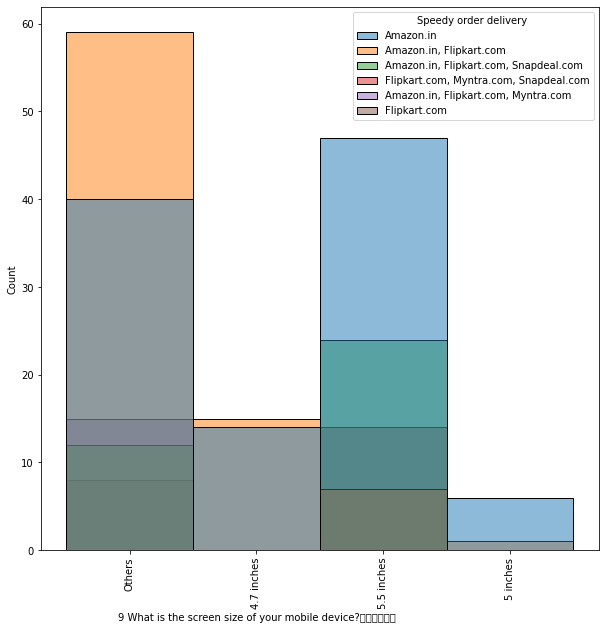

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

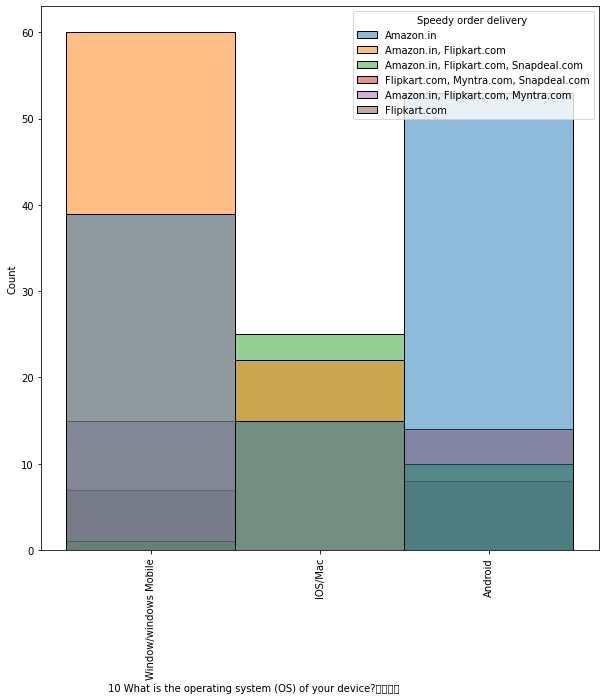

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

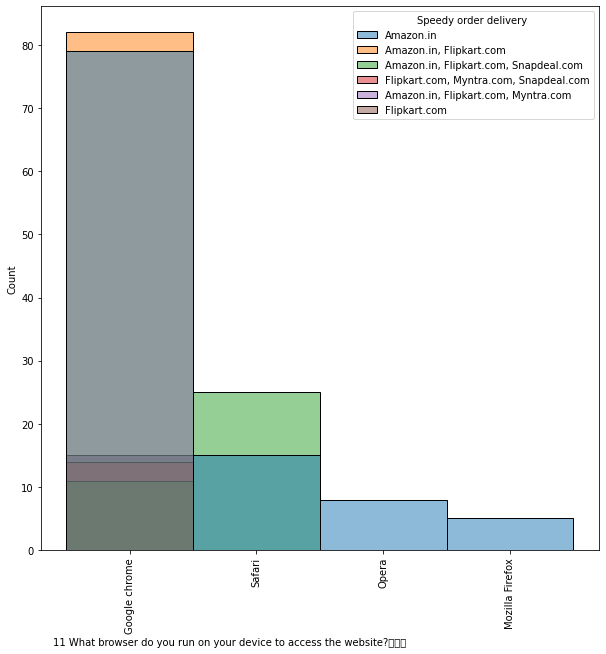

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

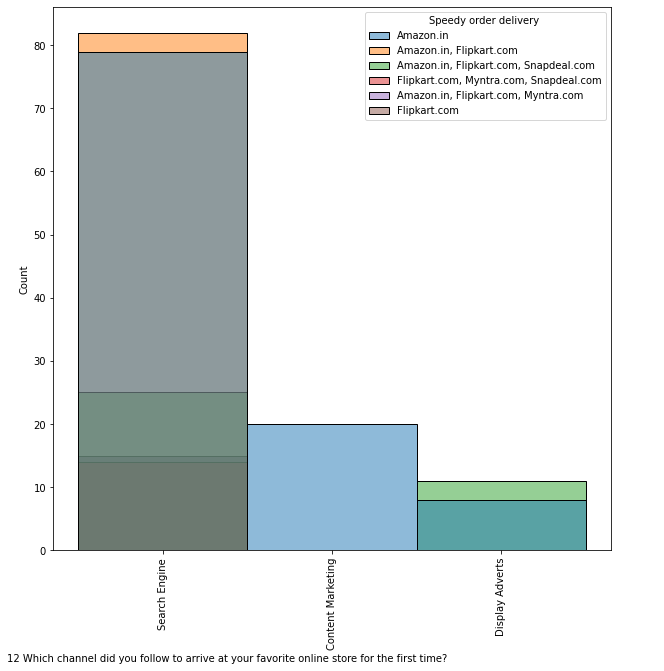

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

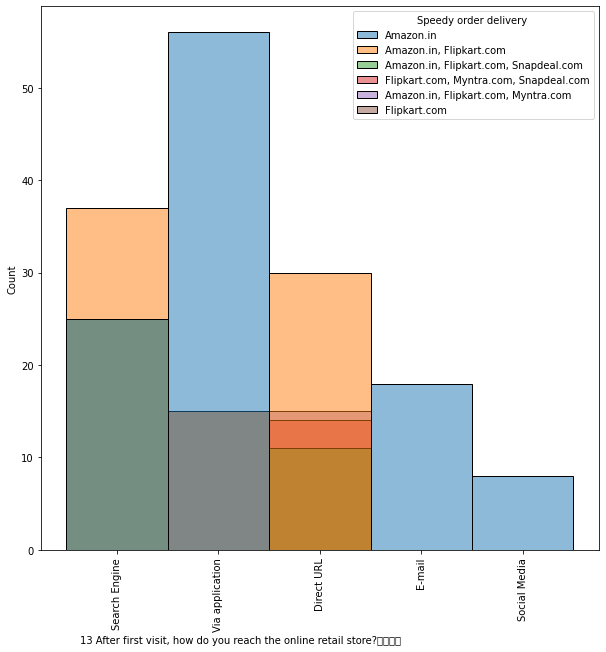

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

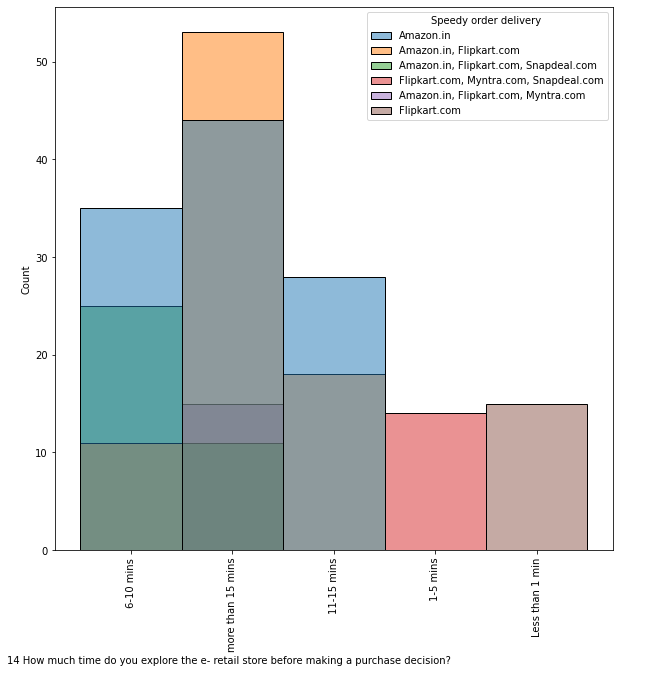

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

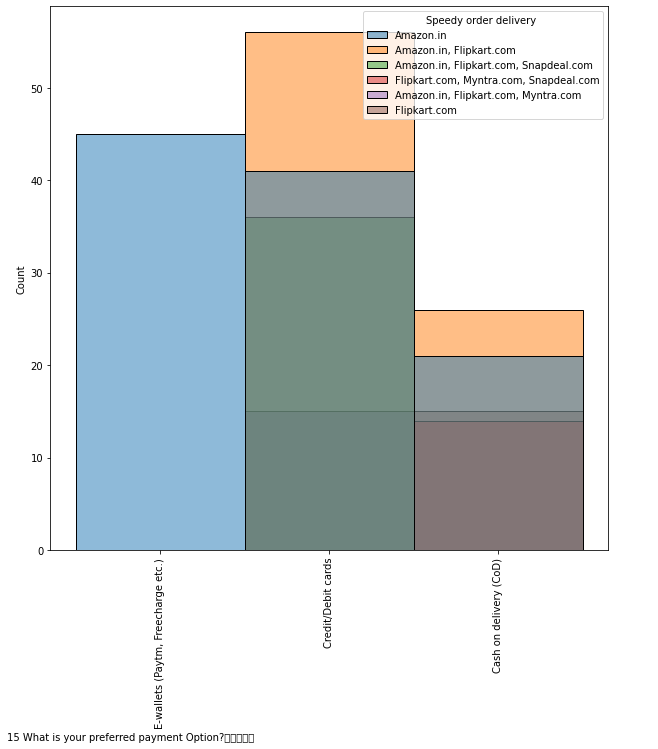

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

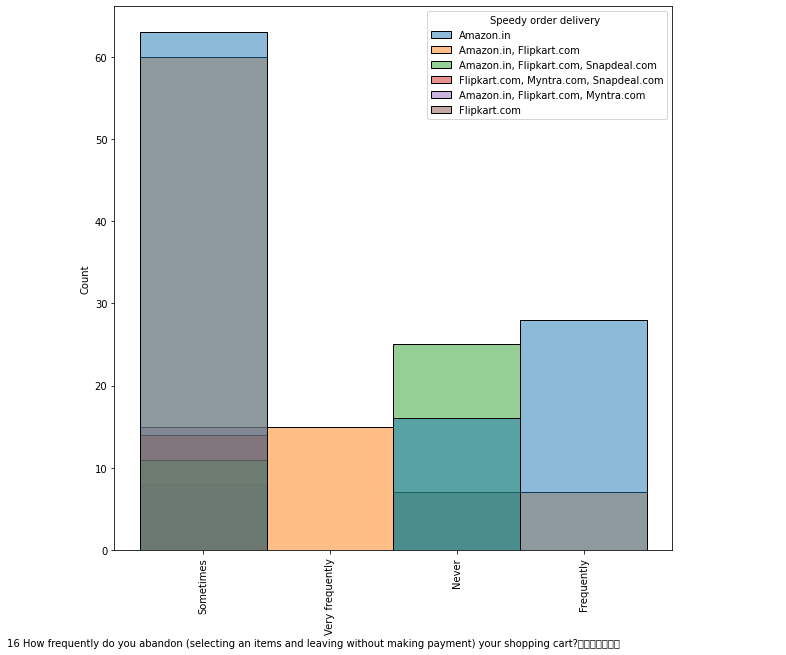

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

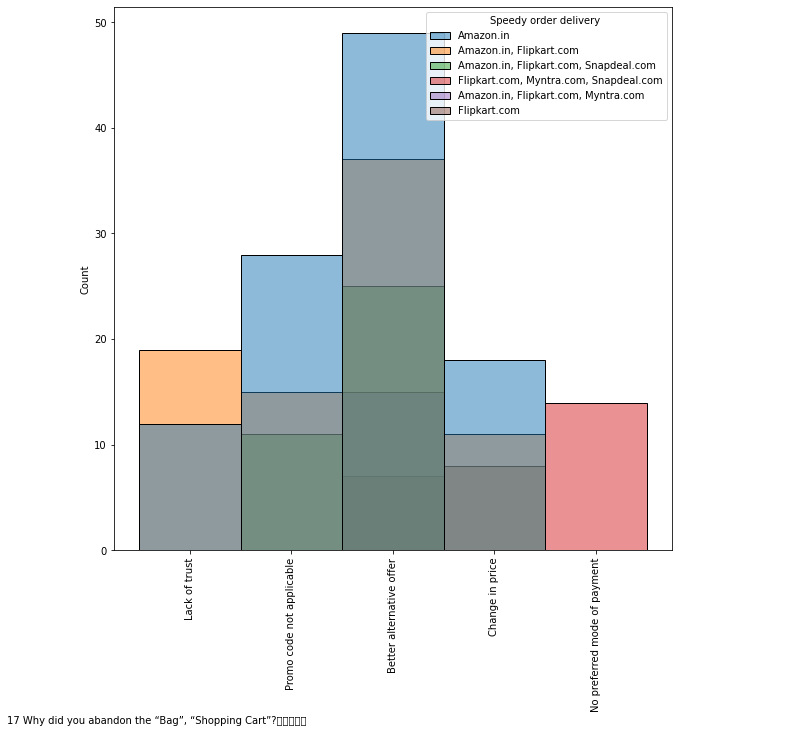

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

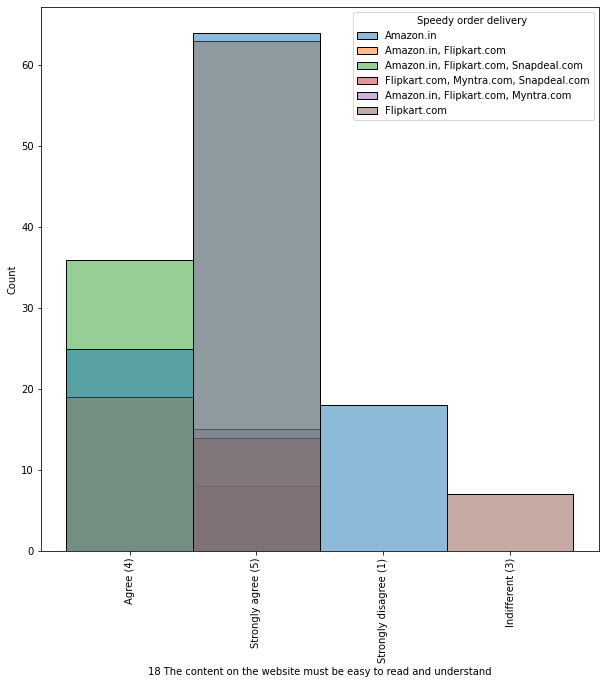

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

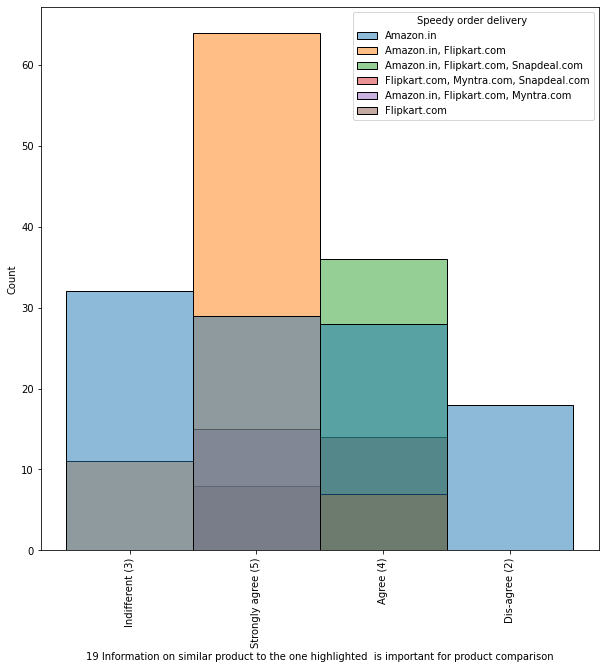

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

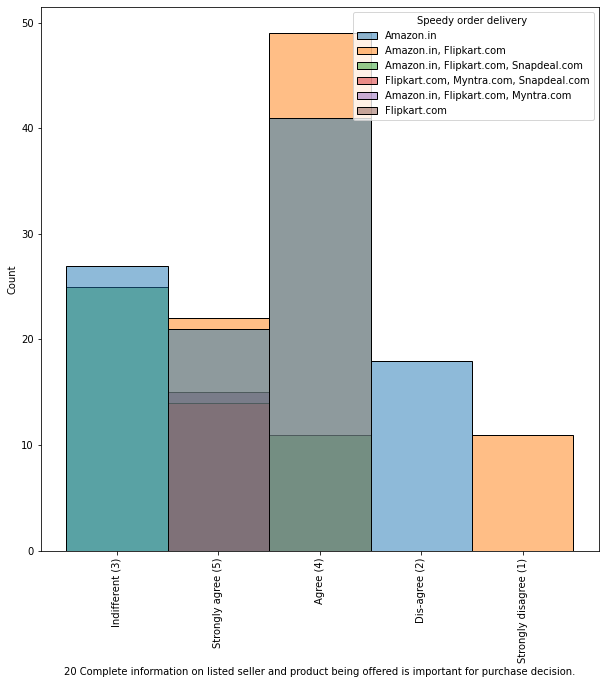

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

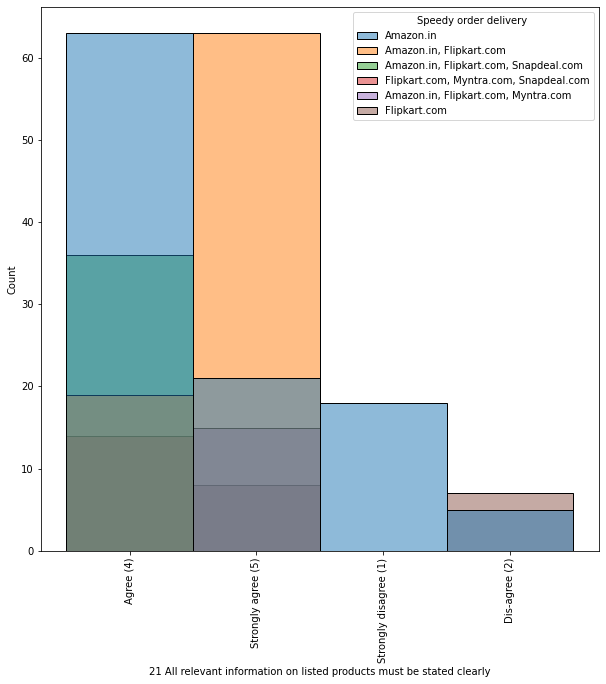

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

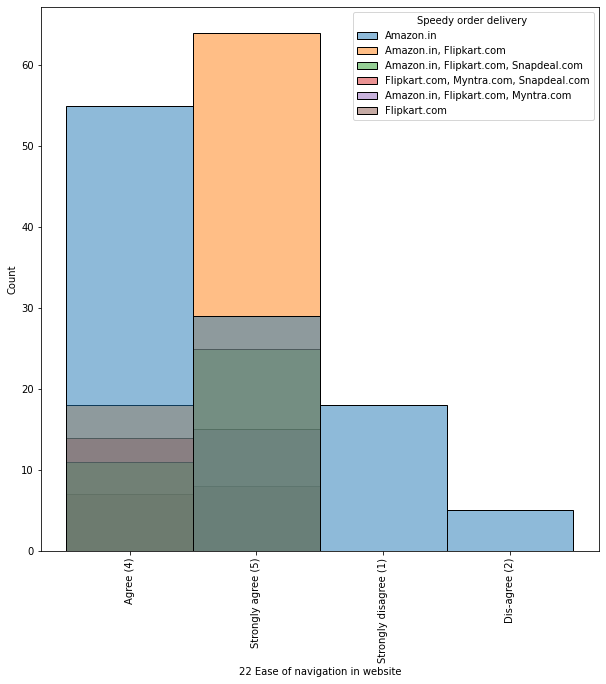

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

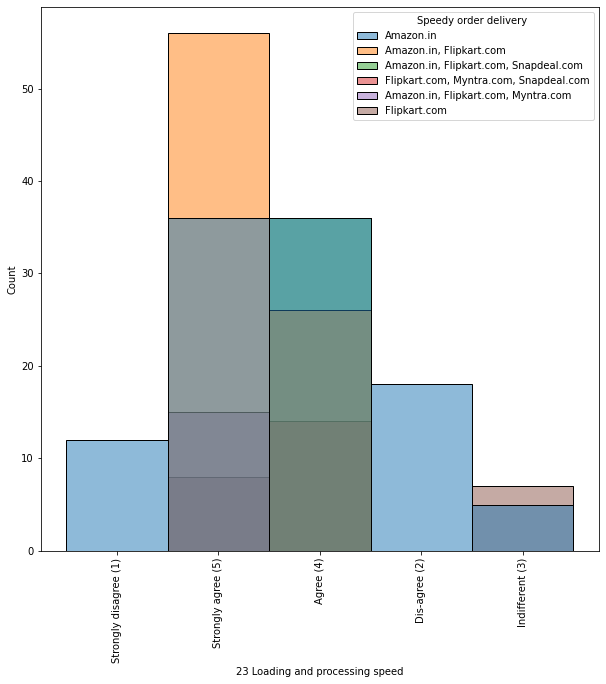

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

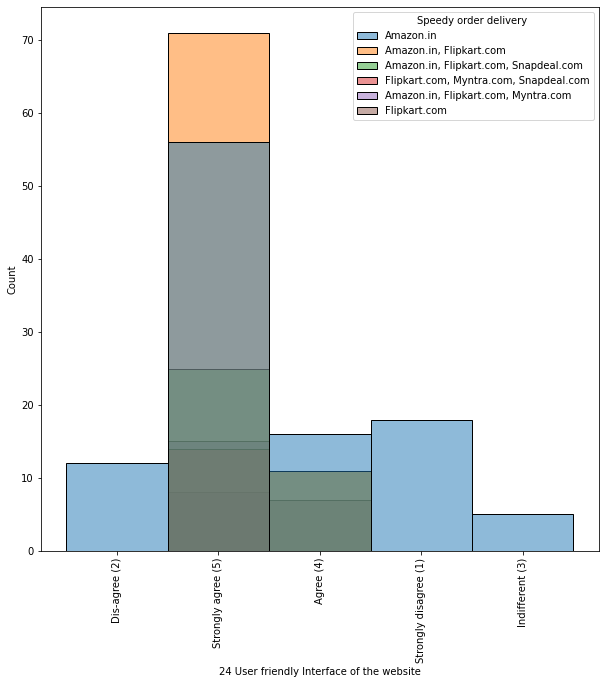

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

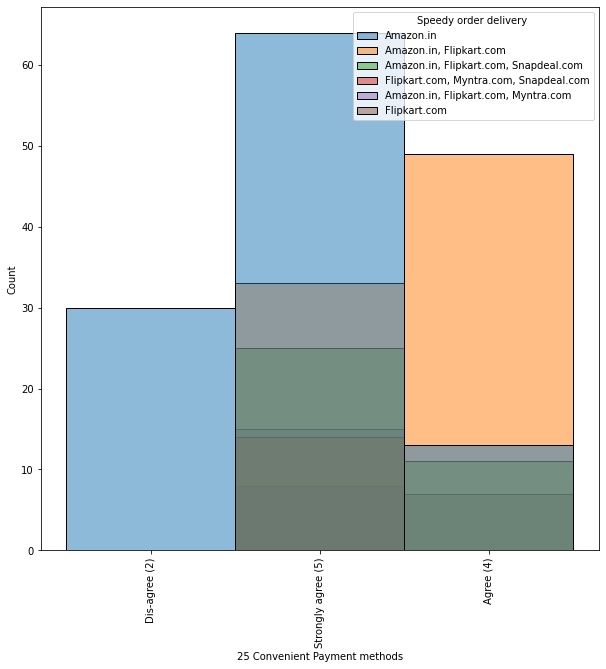

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

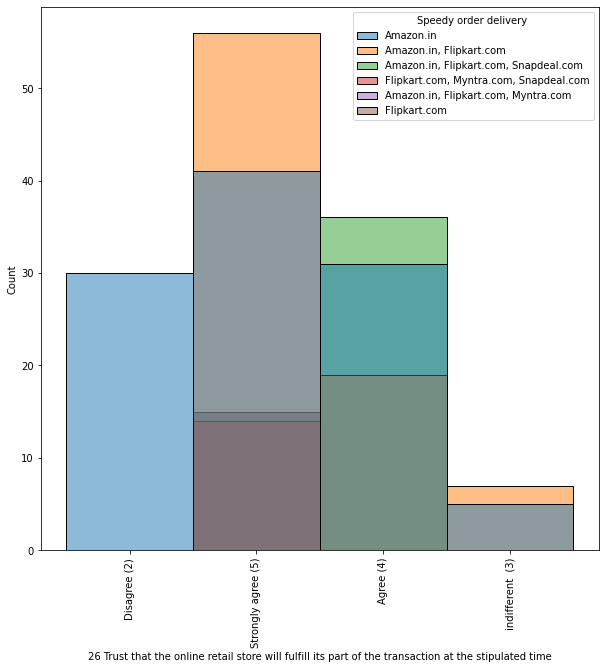

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

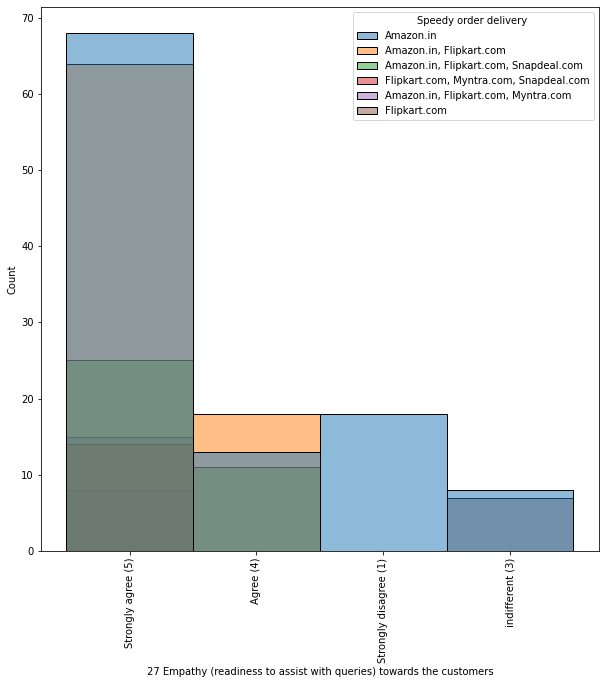

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

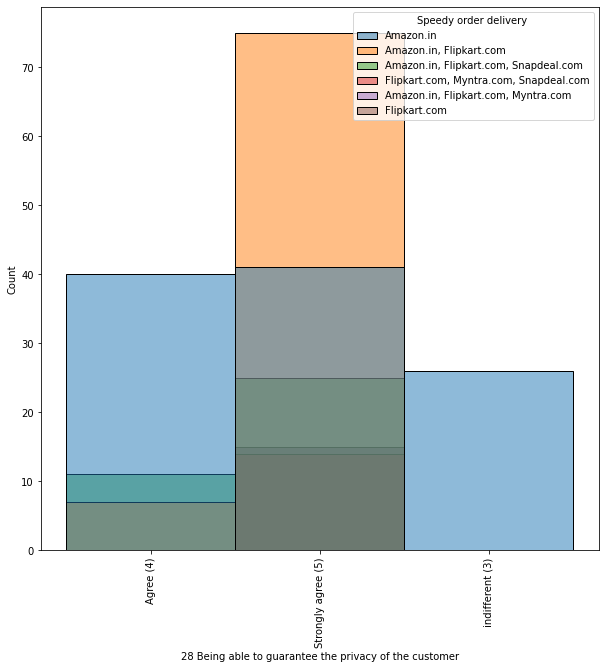

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

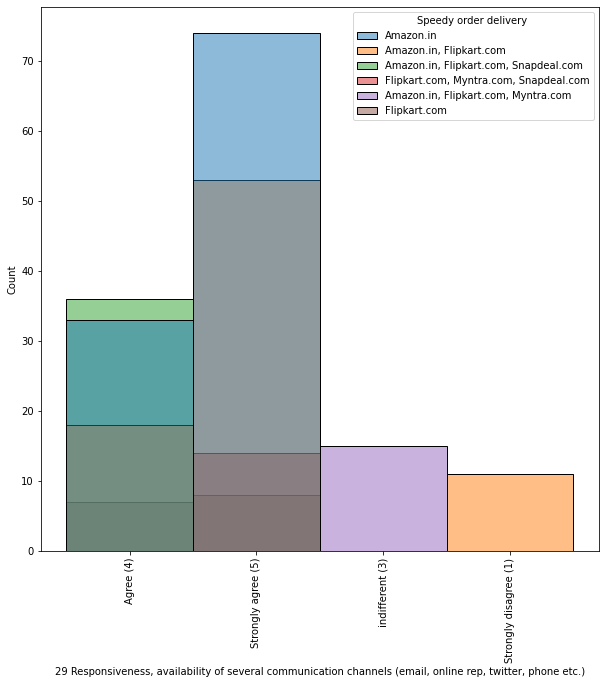

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

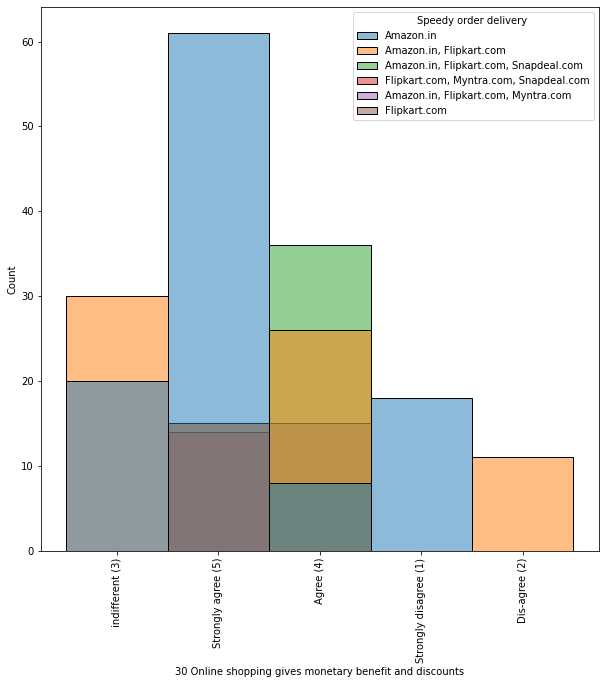

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

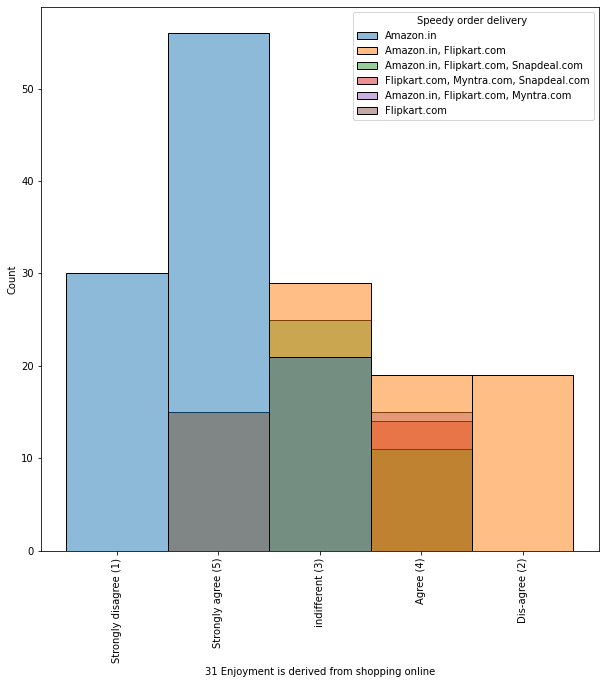

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

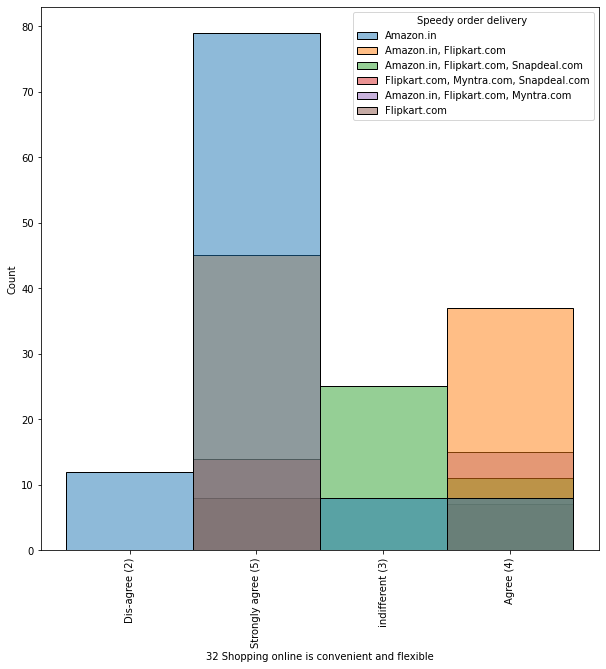

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

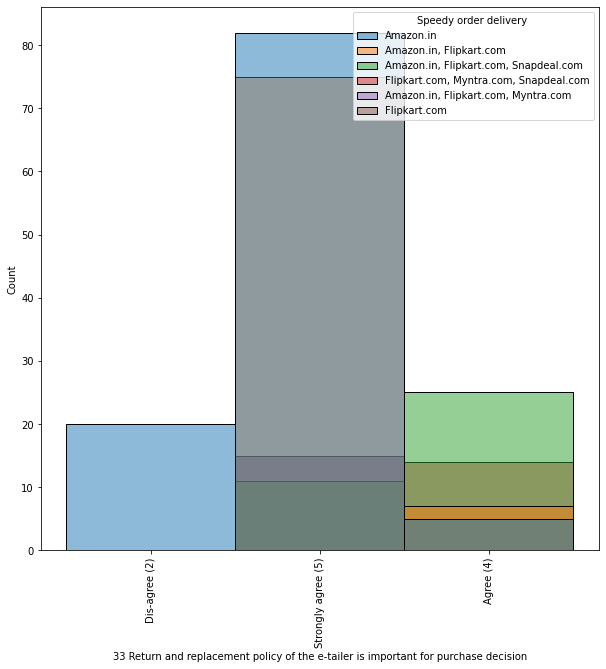

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

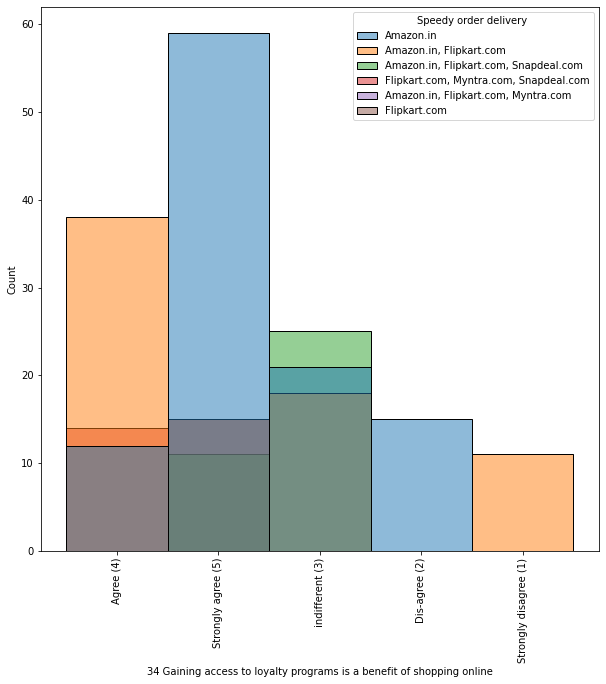

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

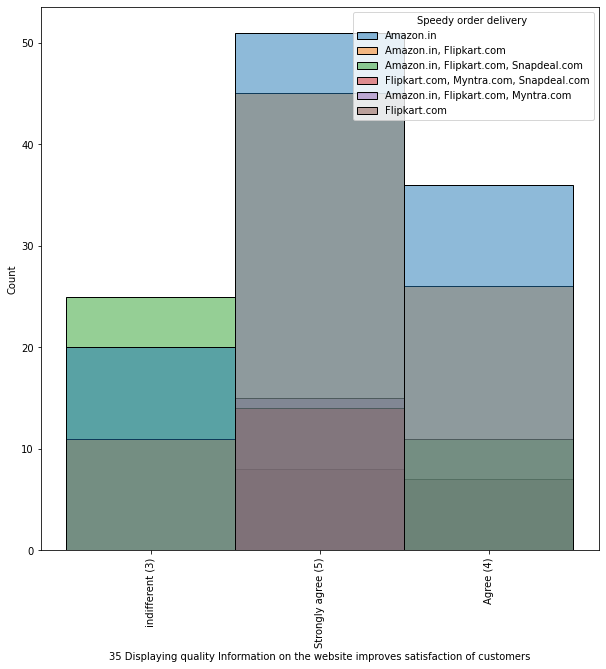

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

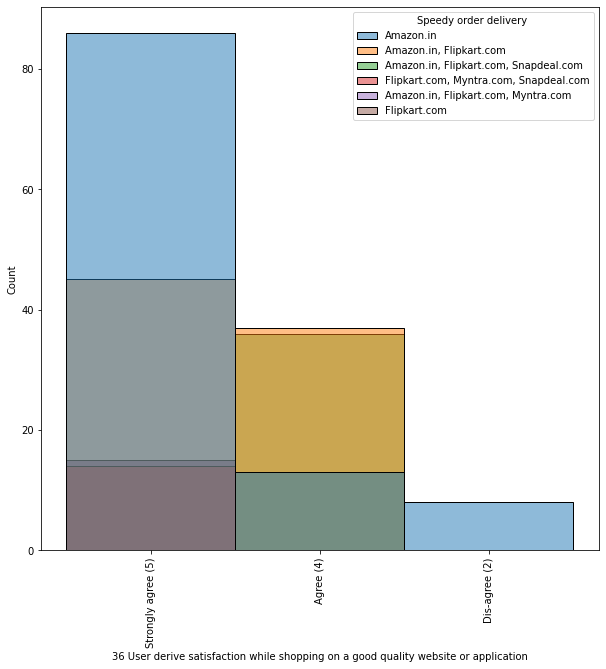

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

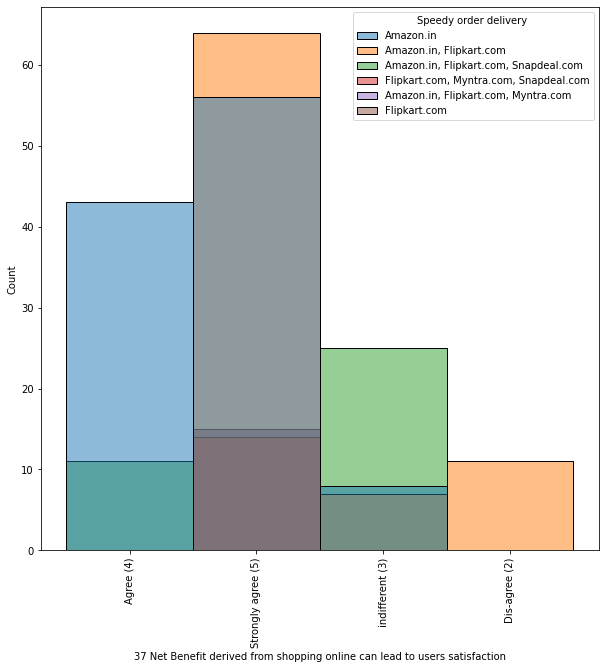

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

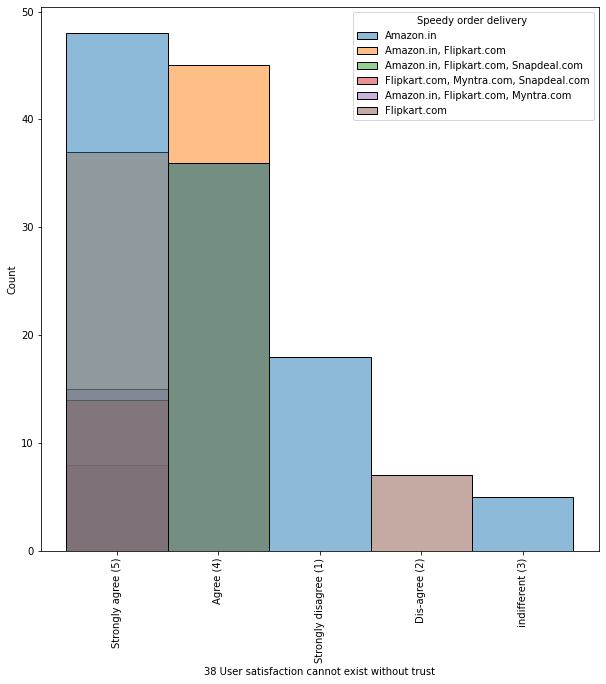

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

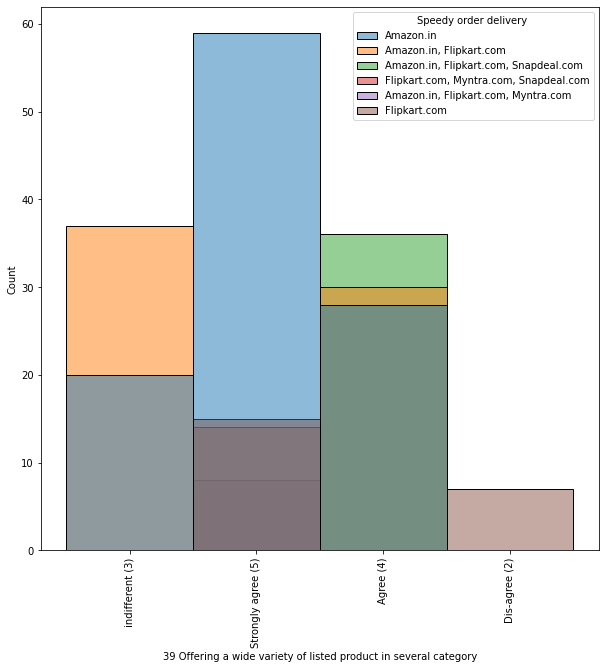

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

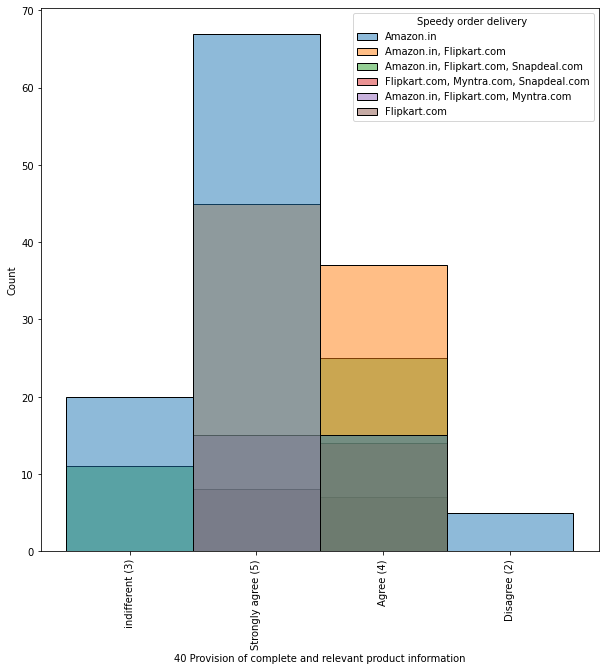

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

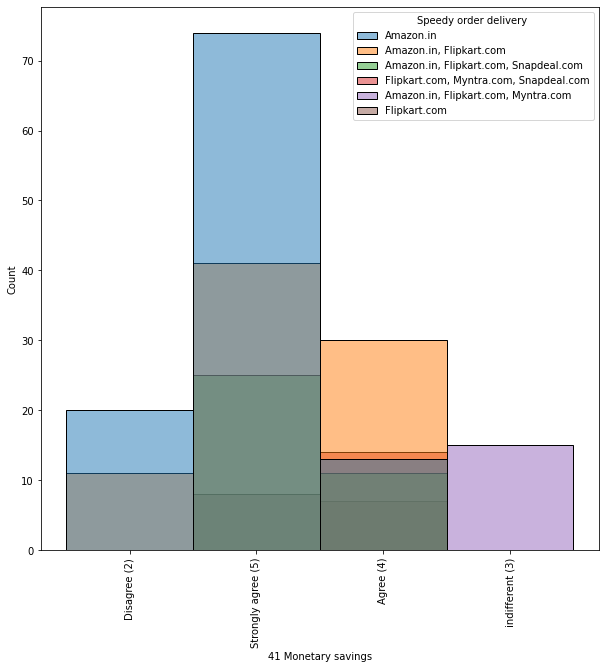

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

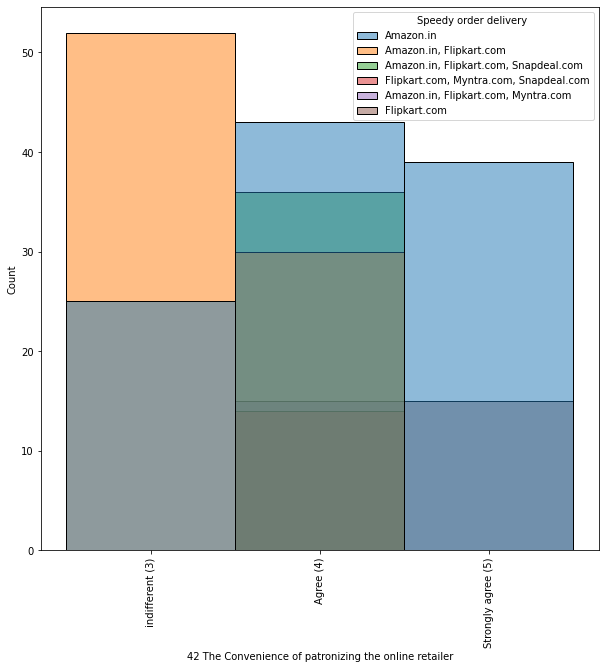

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

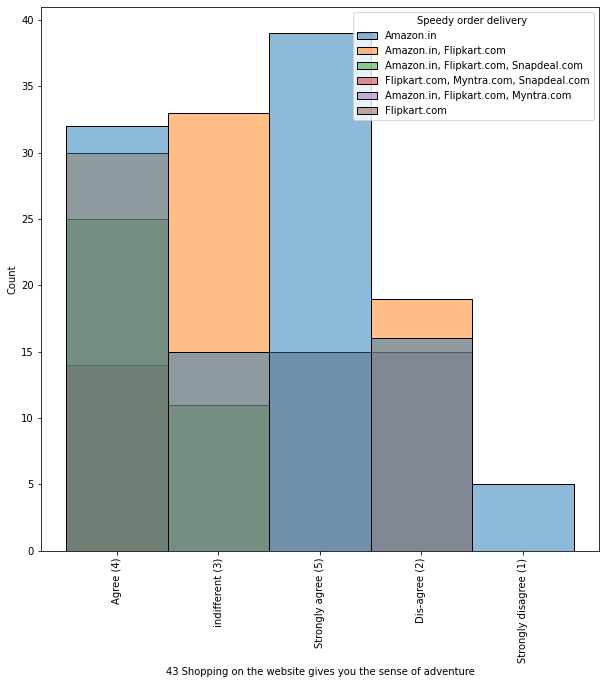

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

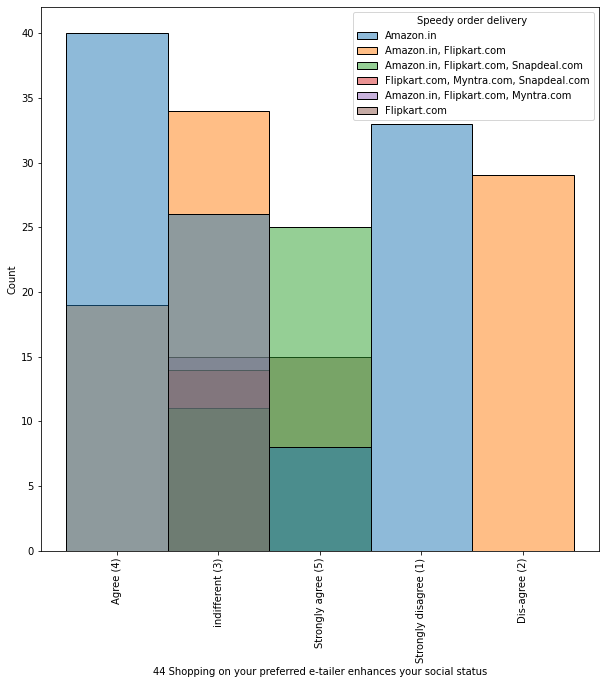

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

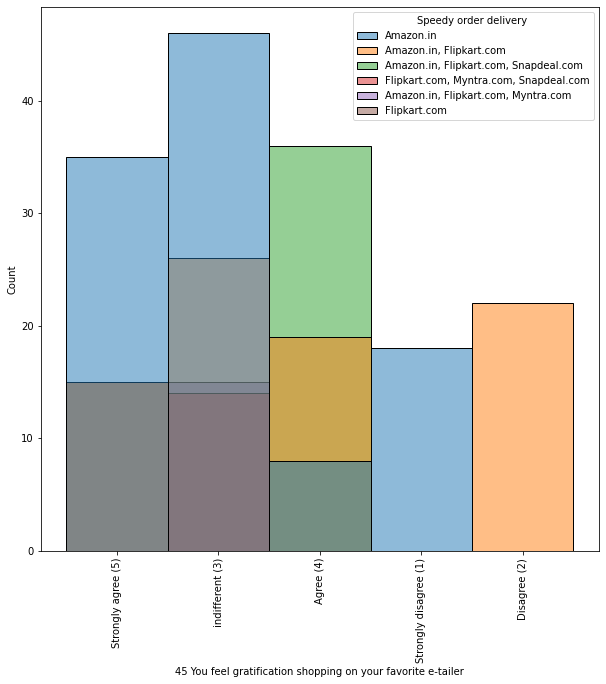

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

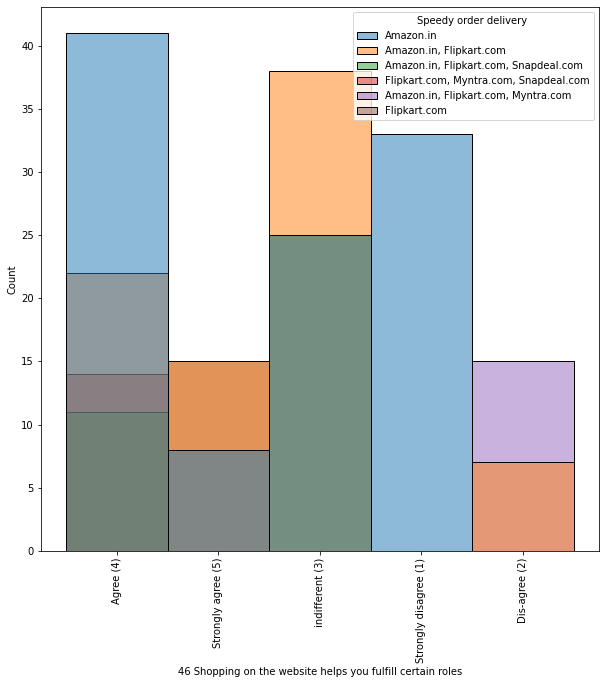

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

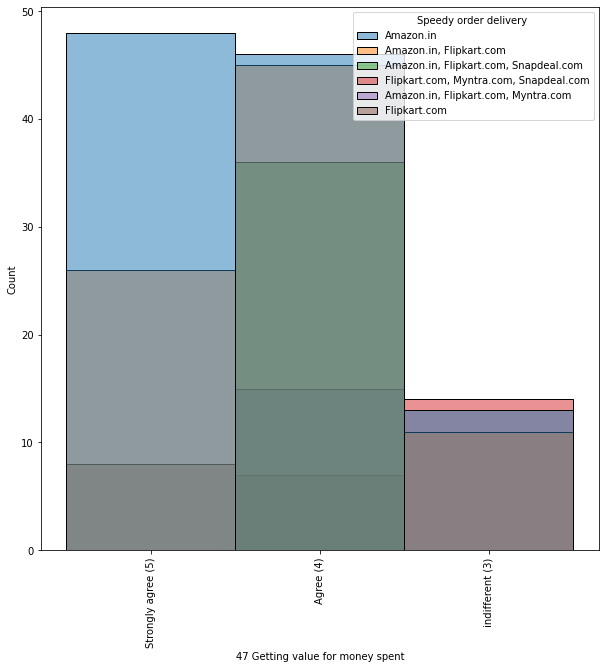

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

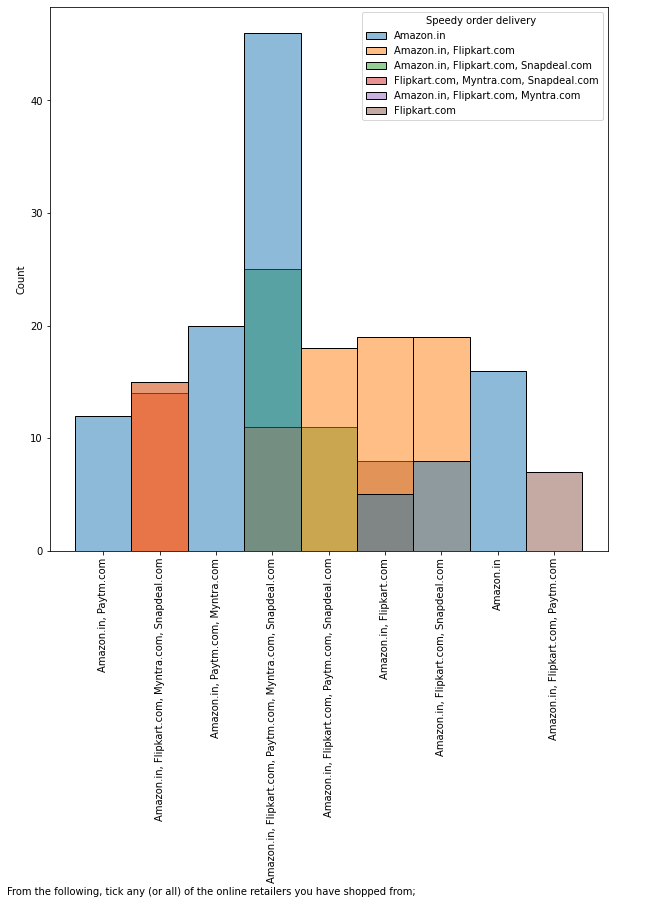

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

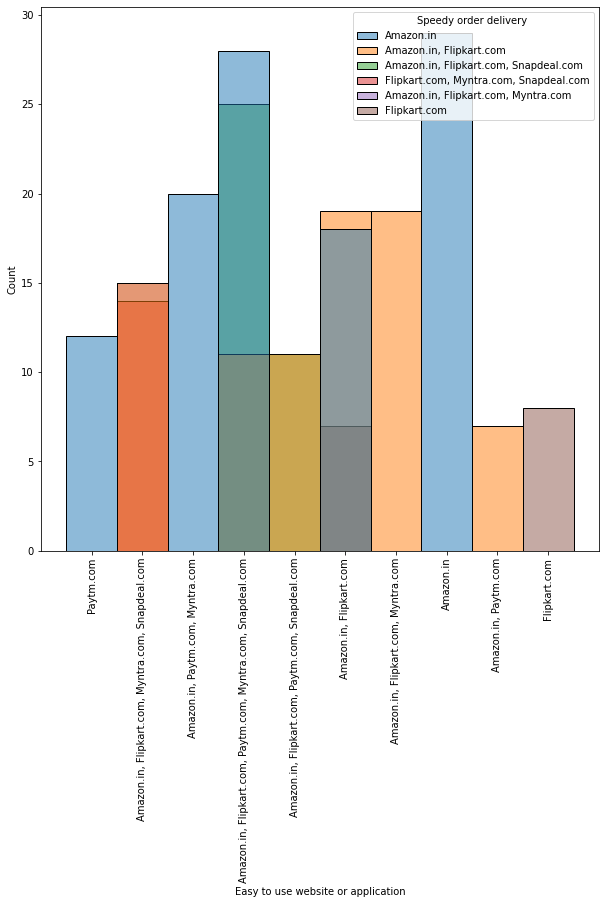

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

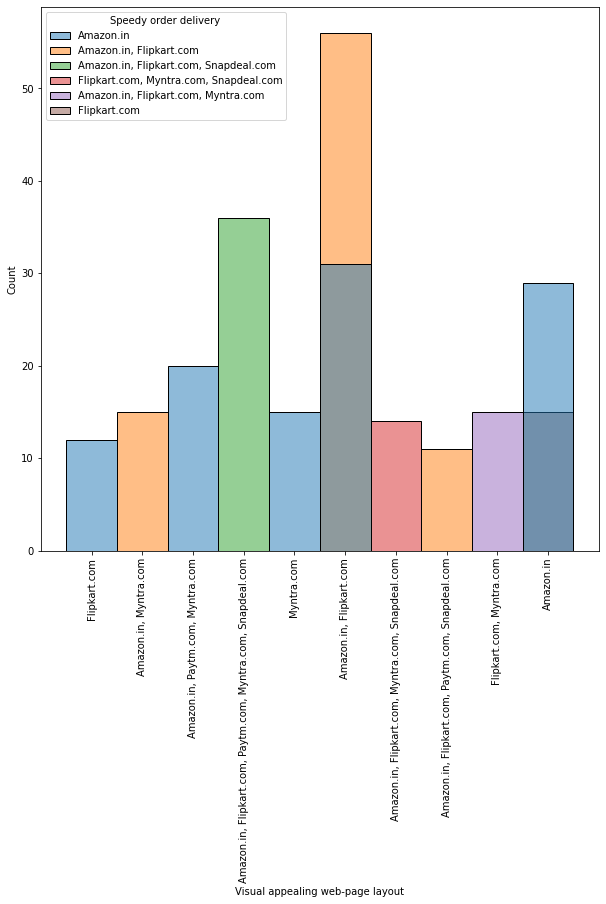

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

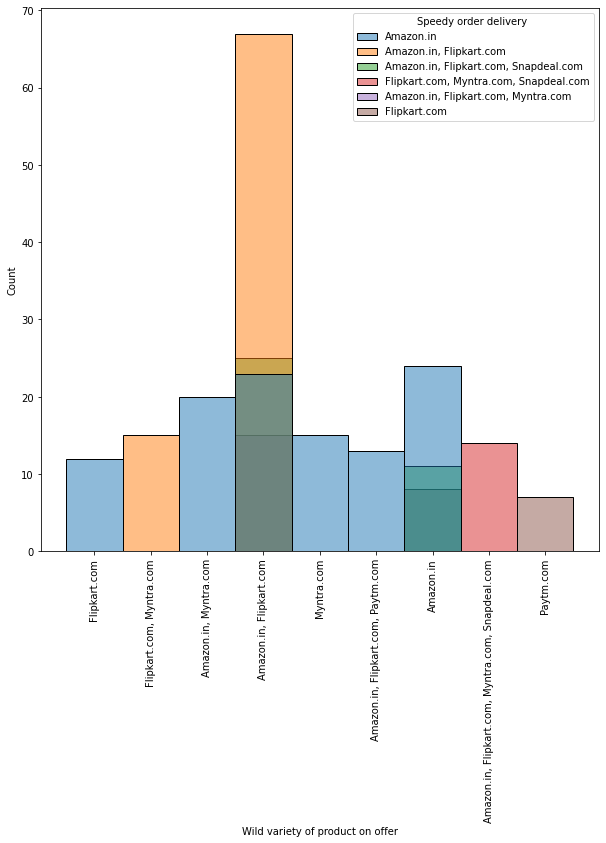

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

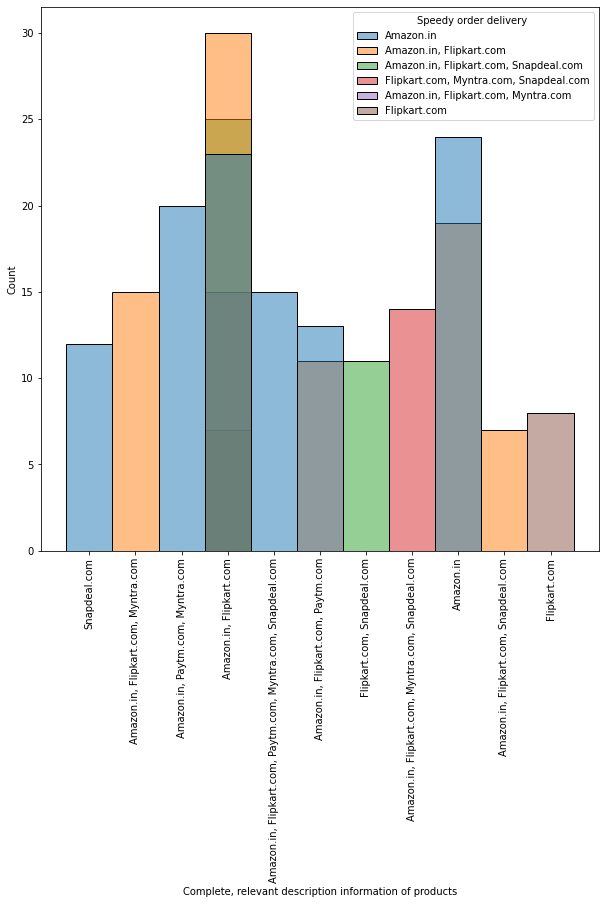

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

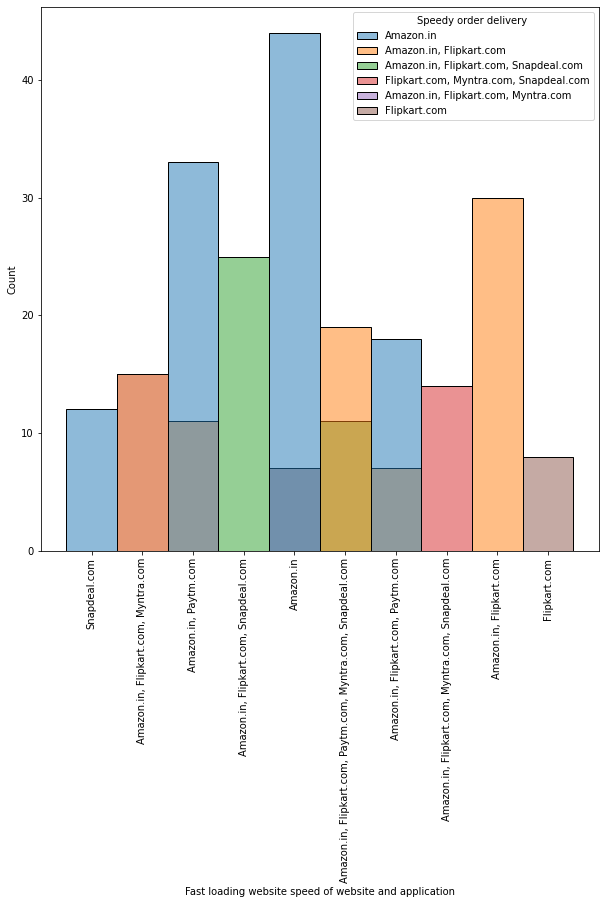

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

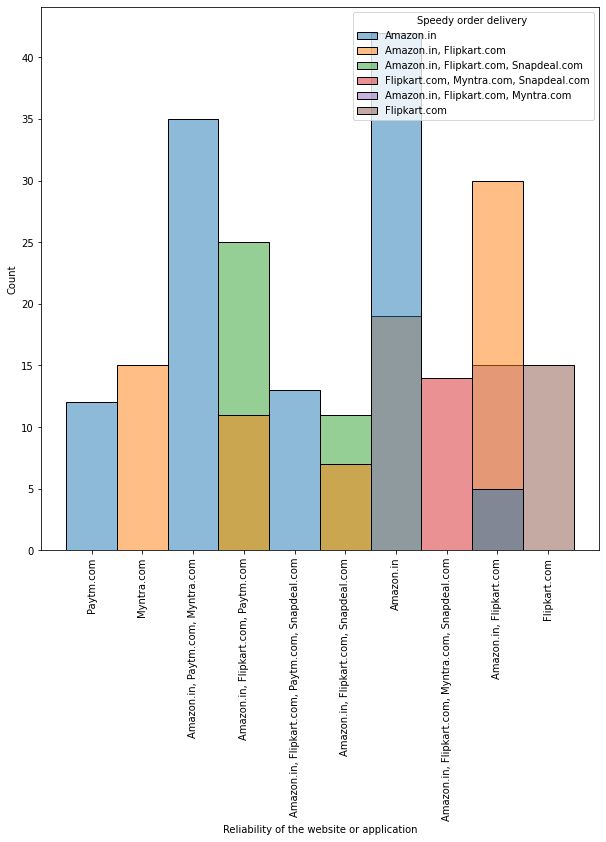

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

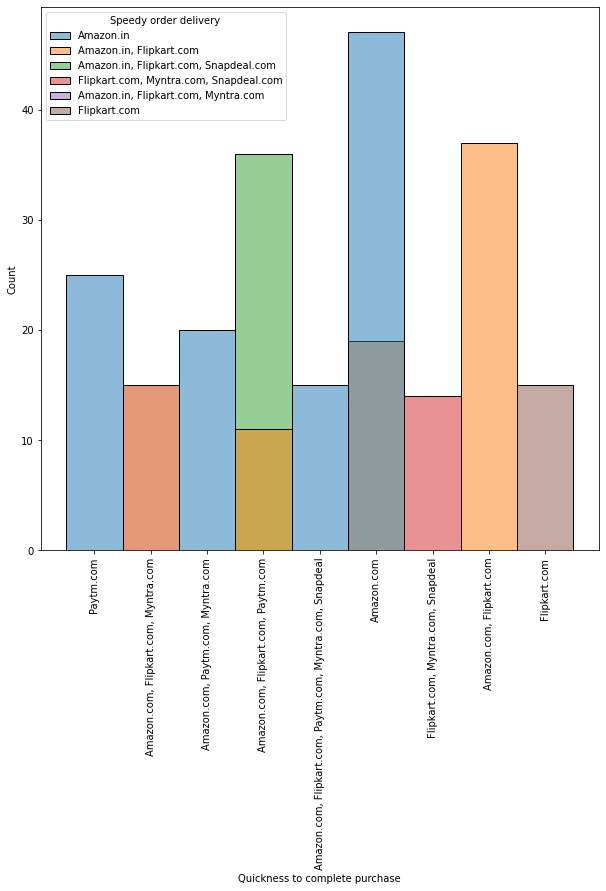

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

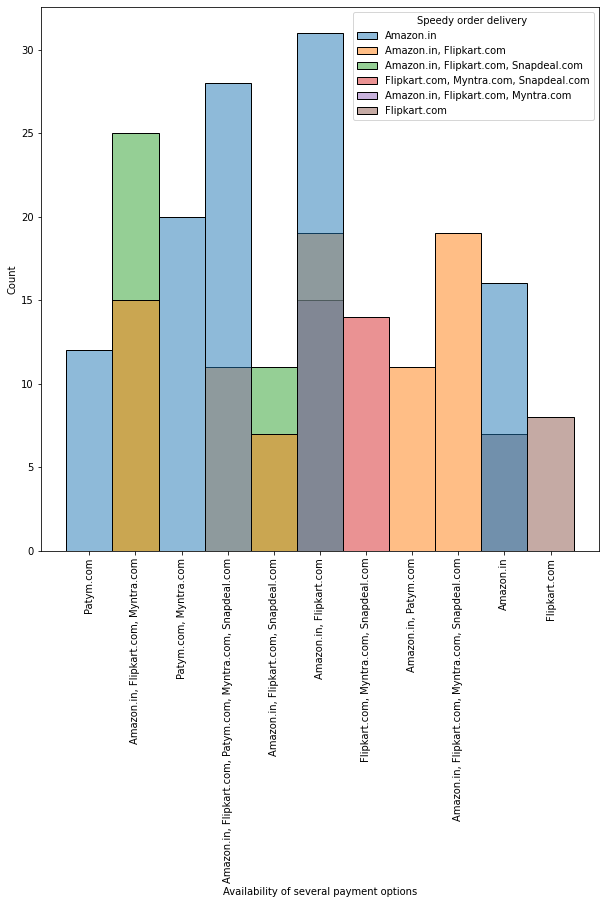

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

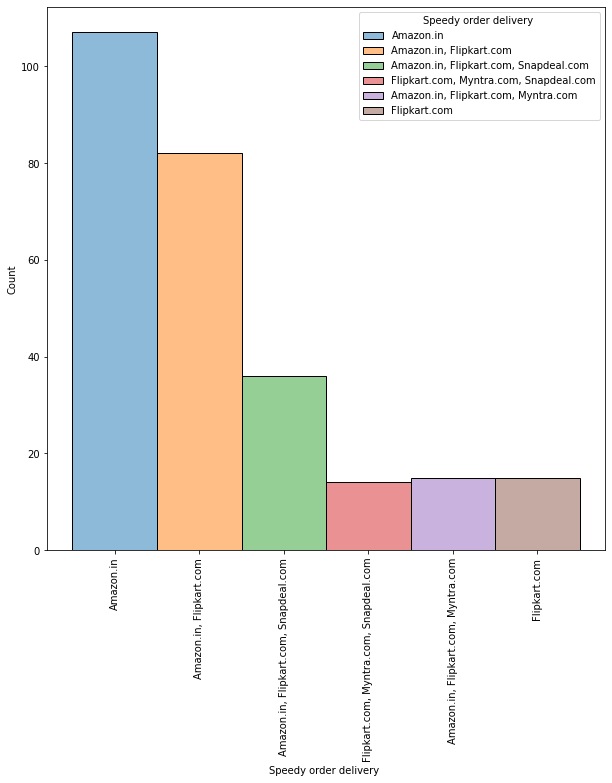

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

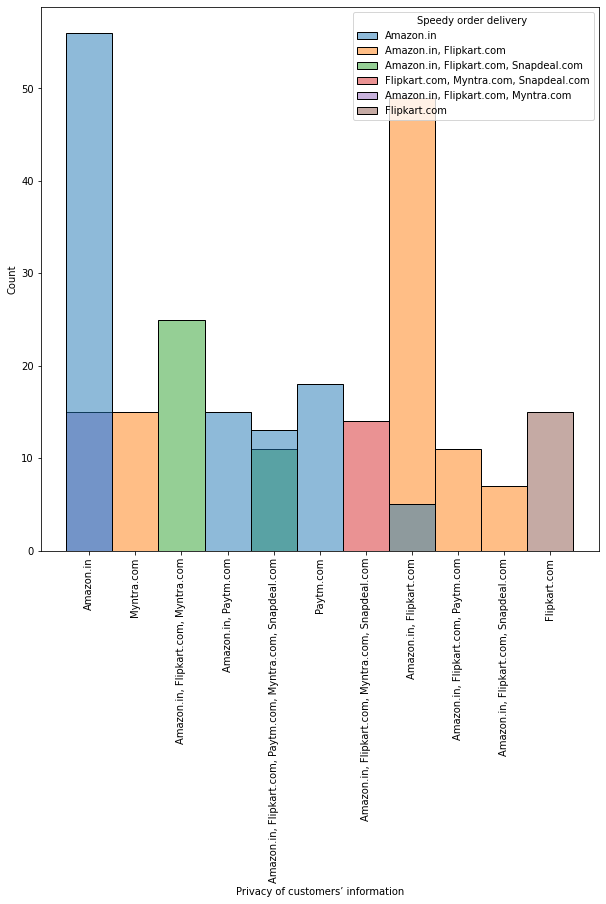

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

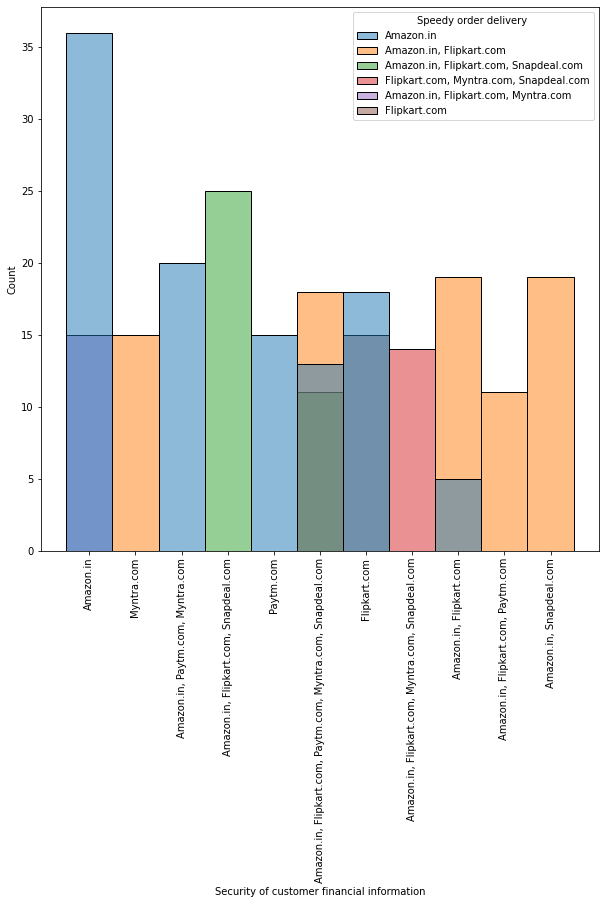

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

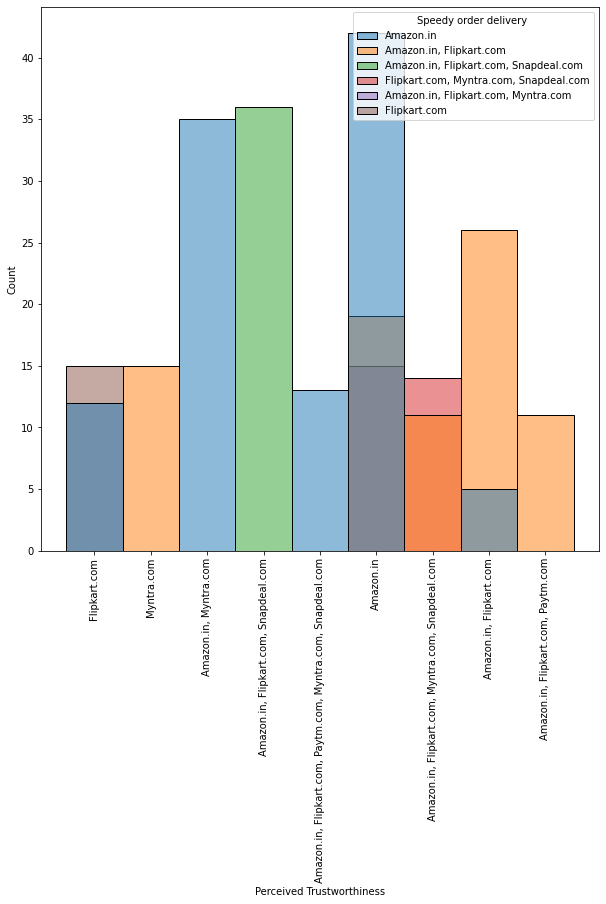

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

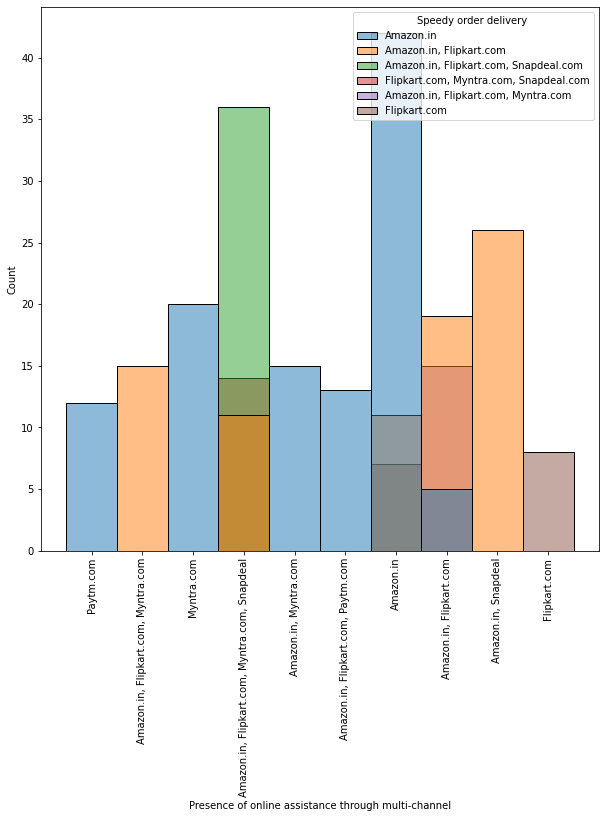

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

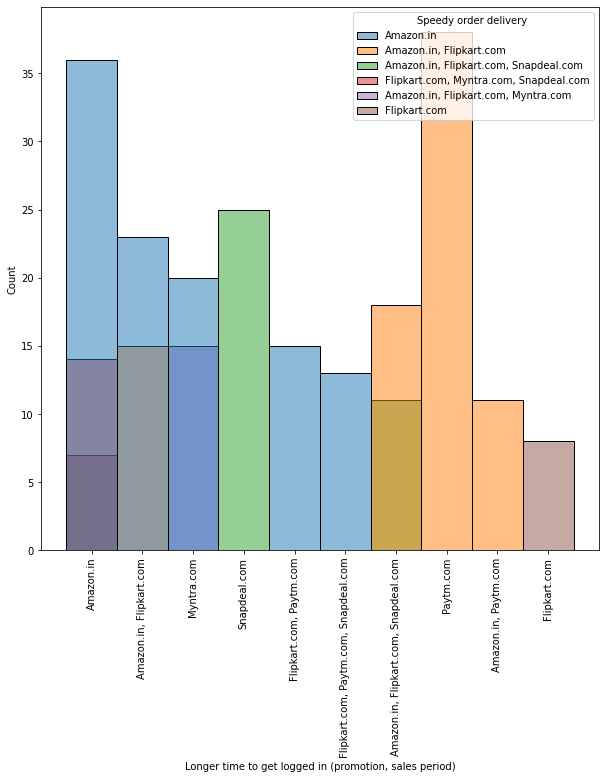

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

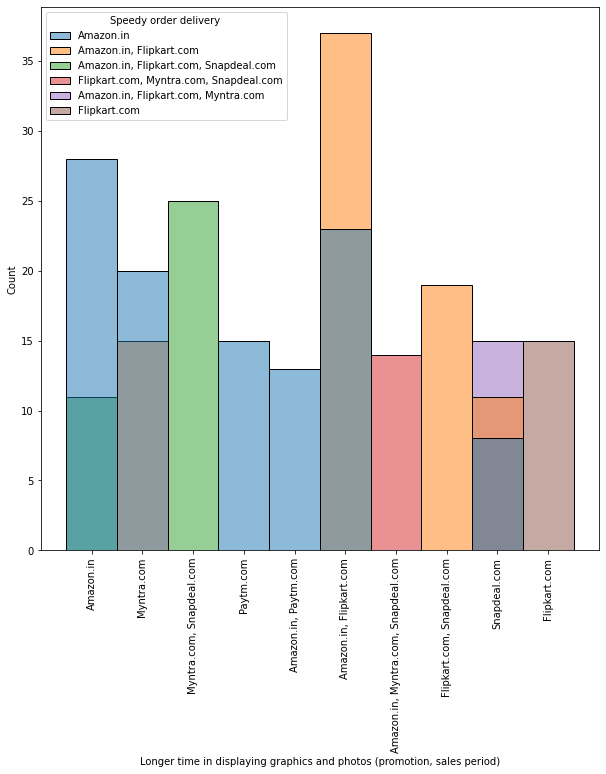

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

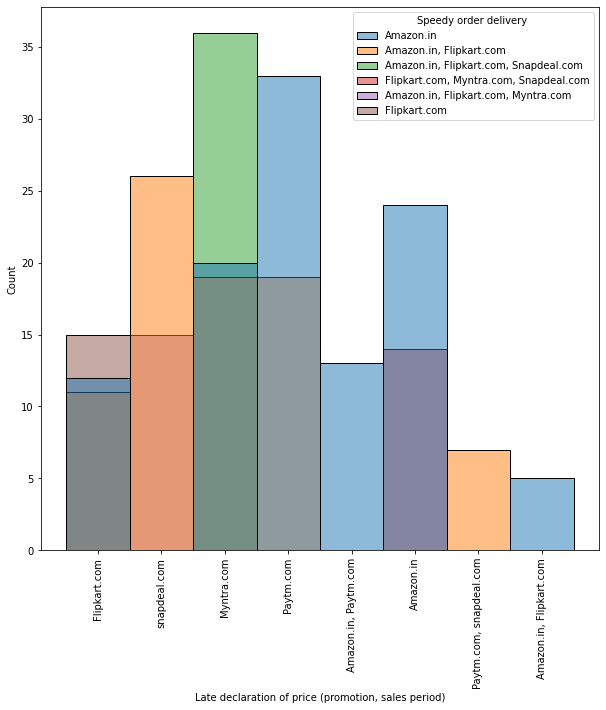

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

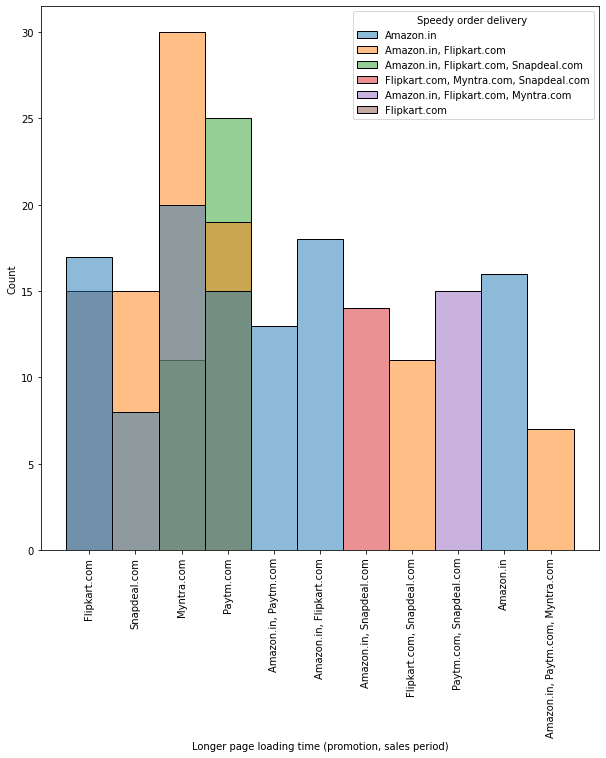

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

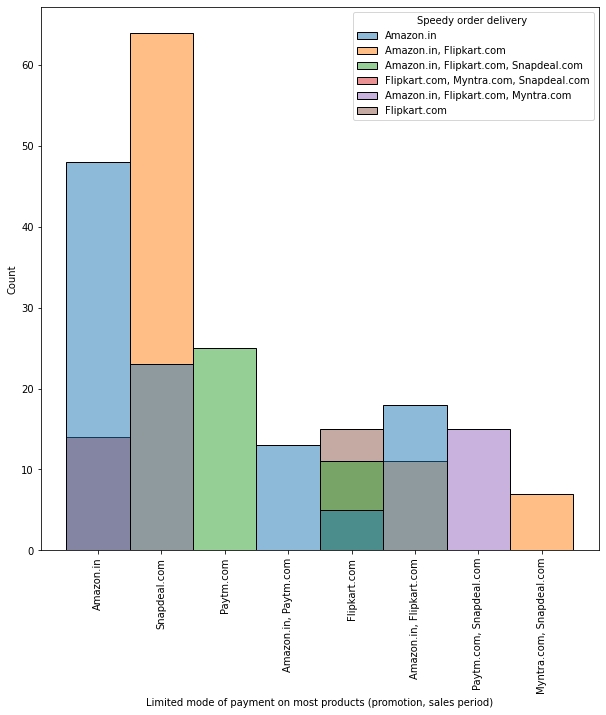

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

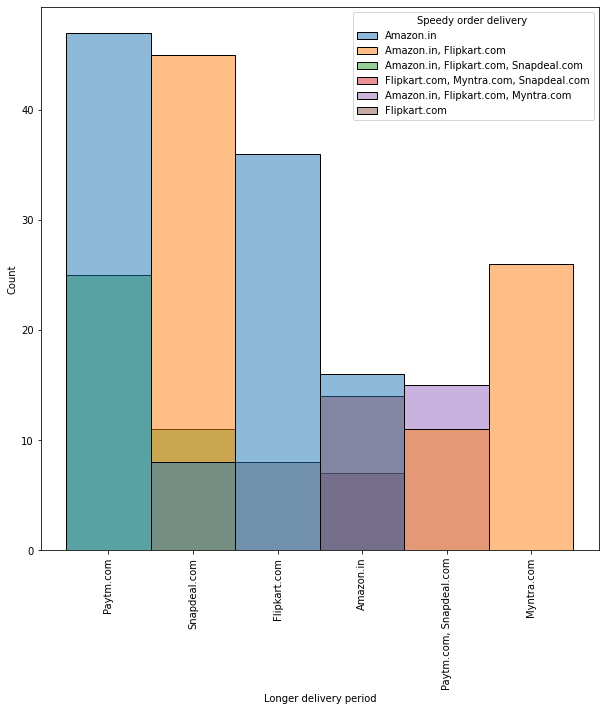

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

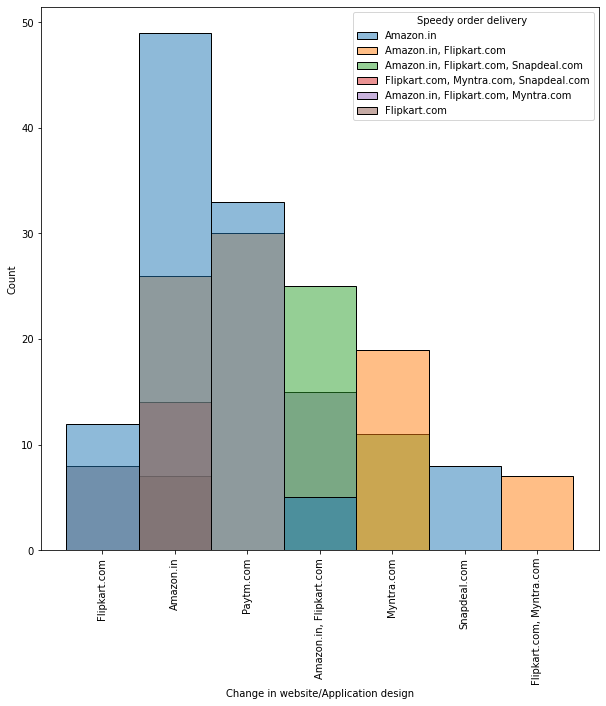

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

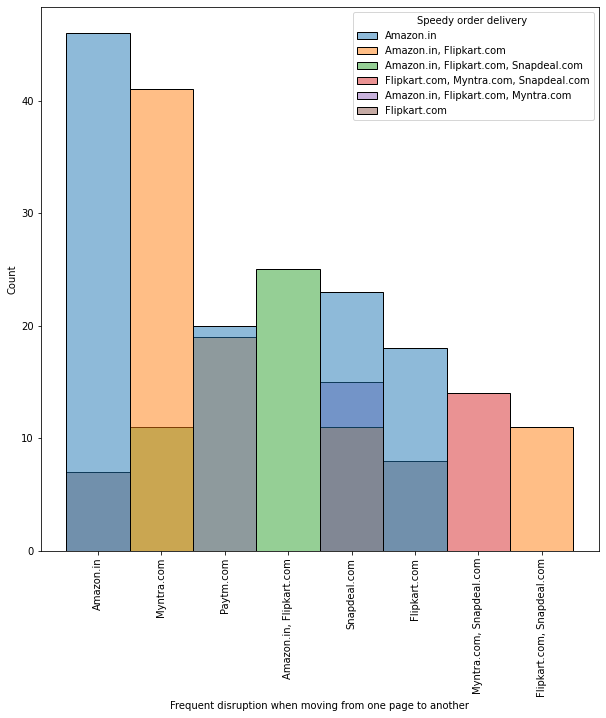

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

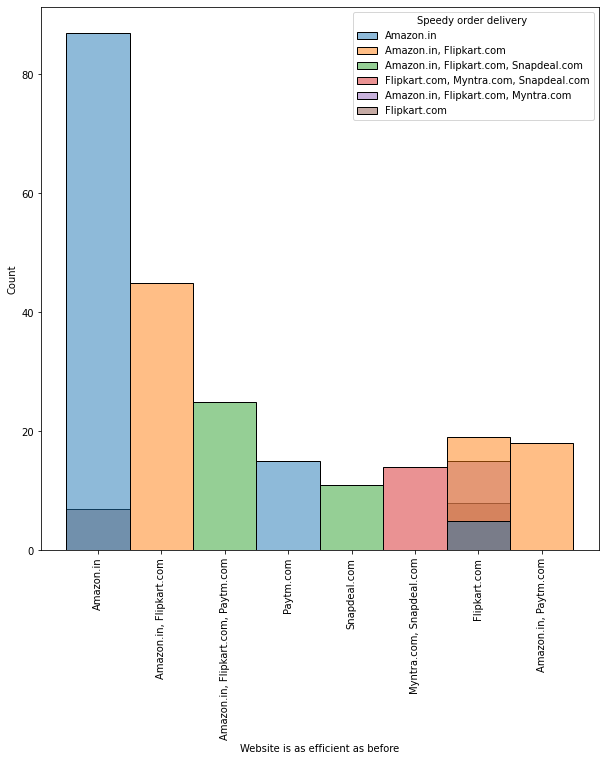

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

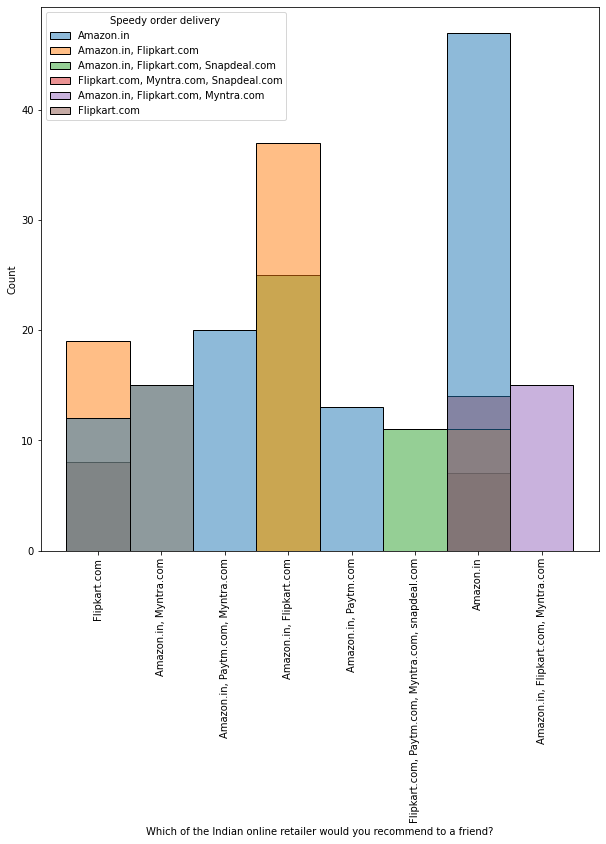

In [90]:
# Histogram with respect to 'Speedy order delivery'
for i in df_1.columns:
    plt.figure(figsize=(10,10))
    sns.histplot(df_1,x=i, hue = df_1['Speedy order delivery '])
    plt.xticks(rotation ='90')
    plt.show()

It is noted that the Amazon is the prefered retailer in terms of speed delivery followed by Flipkat and myntra.com.

# Conclusion: Based on the above filtering approach we are able to identify features impacting the customer retention for an e-retailer. From the anylsis we have seen that Amazon is the prefered choice for all respondents in each segment, followed by Flipkart etc.
# Analysis is close to the market conditions, Hence we can conclude adapted is suitable to develop a precise model.